# Import and data loading

In [ ]:
!pip install tensorflow==2.4.1
!pip install pytorch_lightning
!pip install transformers

import os
os.environ['CUDA_LAUNCH_BLOCKING'] = '1'
import json, time, math, random, re 
import torch
import numpy as np
import pytorch_lightning as pl
import pandas as pd

import torch
from torch import nn
import torch.nn.functional as F
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from pytorch_lightning.callbacks.early_stopping import EarlyStopping
from torch.optim.lr_scheduler import ReduceLROnPlateau
import transformers
from collections import Counter, defaultdict
import itertools
import seaborn as sns
sns.set()

def set_seed(SEED=1234):
    random.seed(SEED)
    np.random.seed(SEED)
    torch.manual_seed(SEED)
    torch.backends.cudnn.deterministic = True

set_seed()

main_path = '/content/drive/MyDrive/Sapienza/NLP_2/'
data_path = main_path + 'data/'

def load_data(dataset_name):
    with open(f'{data_path}{dataset_name}', 'r') as file:
        return json.load(file)

# Laptops
laptop_train_list = load_data('laptops_train.json')
laptop_valid_list = load_data('laptops_dev.json')
laptop_valid_list.pop(266)

# Restaurants
rest_train_list = load_data('restaurants_train.json')
rest_valid_list = load_data('restaurants_dev.json')

# Merged 
merged_train_list = laptop_train_list + rest_train_list
merged_valid_list = laptop_valid_list + rest_valid_list

     |████████████████████████████████| 394.3 MB 12 kB/s 
     |████████████████████████████████| 2.9 MB 61.4 MB/s 
     |████████████████████████████████| 462 kB 81.4 MB/s 
     |████████████████████████████████| 3.8 MB 82.3 MB/s 
  Attempting uninstall: grpcio
    Found existing installation: grpcio 1.40.0
    Uninstalling grpcio-1.40.0:
      Successfully uninstalled grpcio-1.40.0
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.6.0
    Uninstalling tensorflow-estimator-2.6.0:
      Successfully uninstalled tensorflow-estimator-2.6.0
  Attempting uninstall: h5py
    Found existing installation: h5py 3.1.0
    Uninstalling h5py-3.1.0:
      Successfully uninstalled h5py-3.1.0
  Attempting uninstall: gast
    Found existing installation: gast 0.4.0
    Uninstalling gast-0.4.0:
      Successfully uninstalled gast-0.4.0
  Attempting uninstall: tensorflow
    Found existing installation: tensorflow 2.6.0
    Uninstalling tensorflow-2.6.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Looking at categories from rest

In [ ]:
categories = []
for i in range(len(rest_train_list)):
    categories += [c[0] for c in rest_train_list[i]['categories']]

categories = Counter(categories)
categories

Counter({'ambience': 355,
         'anecdotes/miscellaneous': 941,
         'food': 1008,
         'price': 268,
         'service': 478})

# Dataset

In [ ]:
categories, cat_setims = [], []
for i in range(len(rest_train_list)):
    categories += [f'{c[0]}' for c in rest_train_list[i]['categories']]
    cat_setims += [f'{c[1]}' for c in rest_train_list[i]['categories']]

categ_freq = Counter(categories)
categ_sentim_freq = Counter(cat_setims)
total = sum(v for v in categ_freq.values())
total = sum(v for v in categ_freq.values())
counter_categ_weights = {c:(categ_freq[c]/total) for c in categ_freq}


class ABSADataset(Dataset):
    '''
    Class for getting dataset for dataloader
    '''
    punct_chars = {',',"'",'"',':',';', '','[',']'} # Used for punctuation seperation. It is explained below
    sentiments = ['positive', 'negative', 'neutral', 'conflict']
    categories = ['anecdotes/miscellaneous', 'service', 'food', 'ambience', 'price']
    mixed_categories = [f'{c[0]}-{c[1]}' for c in itertools.product(categories, sentiments)] 
    categ_weights = [counter_categ_weights[c]  for c in categories]
    counter_categ_sentim_weights = 1 / np.array([categ_sentim_freq[c]  for c in sentiments])
    counter_categ_sentim_weights = counter_categ_sentim_weights / np.sum(counter_categ_sentim_weights)
    tags = ['B', 'I', 'E', 'S']
    
    tag_to_id = dict(zip(['[PAD]', 'O'] + tags, range(len(tags) + 2))) 
    id_to_tag = dict(zip(range(len(tags) + 2), ['[PAD]', 'O'] + tags))
    sentiment_to_id = dict(zip(['[PAD]', 'O'] + sentiments, range(len(sentiments) + 2))) 
    id_to_sentiment = dict(zip(range(len(sentiments) + 2), ['[PAD]', 'O'] + sentiments))
    categories_to_id = dict(zip(categories, range(len(categories))))
    no_pad_sentiment_to_id = dict(zip(sentiments, range(len(sentiments) + 1)))
    mixed_categories_to_id = dict(zip(mixed_categories, range(len(mixed_categories))))
    id_to_mixed_categories = dict(zip(range(len(mixed_categories)), mixed_categories))


    def __init__(self, data_list, tokenizer, 
                 # mode can be: 'collapsed' - for baseline, 'join' - cascade model: seperation of classes, 
                 # 'join-binary' - for cascade model with 2 classifiers 
                 mode='collapsed', 
                 add_prefix_space=False, # userd in RoBerta
                 max_sen_length=None, # an option to limit length of sentences
                 include_categories=False, # a flag to be set when we need categories in dataset 
                 add_aspect_positions=False,
                 test=False,
                 mask_tokens=None, # Augmentation by masking tokens in sequence
                 shuffle_aspect=False # Augmentation by randomly shuffle aspect tokens
                 ):
        self.data = data_list
        self.tokenizer = tokenizer
        self.add_prefix_space = add_prefix_space 
        self.mode = mode
        self.max_sen_length = max_sen_length
        self.include_categories = include_categories
        self.add_aspect_positions = add_aspect_positions
        self.test = test
        self.mask_tokens = mask_tokens
        self.shuffle_aspect = shuffle_aspect

        if mode == 'collapsed':
            self.no_interest_classes = { self.class_to_id['O'], 0}
        else:
            self.no_interest_classes = { self.tag_to_id['O'], 0}

    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, idx):
        '''
        We first replace target aspects by mask token and then tokenize. After that we
        find mask tokens in tokenized sequence and replace with appropriate sequence of tags
        '''
        item = self.data[idx]
        # There is some problem (or feature :)) with punctuation tokens in RoBerta
        # for example `",` - is one token so we need to split so no problem occurs when aspect is closed in ""
        text = self.split_punctuation(item['text'])

        original_text = text
        targets = []
        target_sequence = []

        if not self.test:
            # Sorting targets by occurence position
            targets = sorted(item['targets'], key=lambda x: x[0][0])

            mask_token_len = len(self.tokenizer.mask_token)
            shift = 0
            # Masking target aspects with mask token
            for target in targets:
                pos_from, pos_to = target[0]
                text = text[:pos_from + shift] + self.tokenizer.mask_token + text[pos_to + shift:]
                # Storing shift since text length changes afte each replacement
                shift += mask_token_len - (pos_to - pos_from)

            token_ids = self.tokenizer.encode(text)
            original_token_ids = []
            aspect_positions = []
            for i in range(len(token_ids)):
                if token_ids[i] == self.tokenizer.mask_token_id:
                    target = targets.pop(0)
                    aspect = target[1]
                    sent = target[2]
                    # Augmentation via shuffling with 50% probability if the flag is set to true 
                    if self.shuffle_aspect: # and random.randint(0, 1) == 0:
                        aspect = self.shuffle_str(aspect)
                    # Tokenization of target aspects
                    if self.add_prefix_space:
                        aspect_token_ids = self.tokenizer.encode(aspect, add_prefix_space=True, add_special_tokens=False)
                    else:
                        aspect_token_ids = self.tokenizer.encode(aspect, add_special_tokens=False)
                    # Adding to original sequence of tokens - used to check length
                    original_token_ids += aspect_token_ids
                    
                    # Adding tokens to target tag sequence considering the length of aspect
                    # for 1-word aspect we insert 'S' for 2-word aspect we ad ['B', 'E'] and
                    # for N-word --> ['B', 'I' ... 'I', 'E']
                    if len(aspect_token_ids) == 1:
                        target_sequence.append(f'S-{sent}')
                    elif len(aspect_token_ids) == 2:
                        target_sequence += [f'B-{sent}', f'E-{sent}']
                    else:
                        target_sequence += [f'B-{sent}'] + [f'I-{sent}']*(len(aspect_token_ids) - 2) + [f'E-{sent}']
                    # Storing aspect positions for the case when we merge aspects embeddings in one by attention
                    aspect_positions.append([len(target_sequence) - len(aspect_token_ids), len(target_sequence)])
                else:
                    original_token_ids.append(token_ids[i])
                    # Adding tags telling that it is non-aspect token
                    target_sequence.append('O')


            assert len(target_sequence) == len(original_token_ids) 
        else:
            original_token_ids = self.tokenizer.encode(text)

        if self.mask_tokens is not None:
            # Augmenatation via randomly masking tokens
            original_token_ids = self.augment(original_token_ids)

        # Transforming tags to ids
        if self.mode == 'collapsed':
            target_sequence = [self.class_to_id[t] for t in target_sequence]
            # Tokenization of original text
            text_tokens = original_token_ids

            rtrn = [original_token_ids, target_sequence] 
        elif self.mode == 'joint':
            # Joint case
            aspect_seq, sentim_seq = [], []
            # Splitting sequence to two: aspects, sentiments
            for t in target_sequence:
                t = t.split('-')
                if t[0] == 'O':
                    t.append('O')
                aspect_seq.append(t[0])
                sentim_seq.append(t[1])
            # Convering sequence of classes to ids for aspect and sentiment sequence 
            aspect_seq = [self.tag_to_id[t] for t in aspect_seq]
            sentim_seq = [self.sentiment_to_id[t] for t in sentim_seq]
            
            rtrn = [original_token_ids, aspect_seq, sentim_seq]
        elif self.mode == 'joint-binary':
            # Joint case
            aspect_seq, sentim_seq = [], []
            # Splitting sequence to two: aspects, sentiments
            for t in target_sequence:
                t = t.split('-')
                if t[0] == 'O':
                    t.append('O')
                aspect_seq.append(t[0])
                sentim_seq.append(t[1])
            # Convering sequence of classes to ids for aspect and sentiment sequence 
            aspect_seq = [self.tag_to_id[t] for t in aspect_seq]
            pos_seq = [1 if t in {'positive', 'conflict'} else 0 for t in sentim_seq]
            neg_seq = [1 if t in {'negative', 'conflict'} else 0 for t in sentim_seq]
            # Not used
            neut_seq = [2 if t == 'neutral' else 1 for t in sentim_seq]
            
            rtrn = [original_token_ids, aspect_seq, pos_seq, neg_seq, neut_seq]
        
        seq_for_mask = target_sequence if self.mode == 'collapsed' else aspect_seq
        target_mask = [0 if ts in self.no_interest_classes else 1 for ts in seq_for_mask]
        
        rtrn = rtrn + [target_mask]
        # Restricting by max length
        rtrn = [r[:self.max_sen_length] for r in rtrn] 

        if self.include_categories:
            if not self.test:
                categories = np.zeros(len(self.categories))
                cat_ids = [self.categories_to_id[c[0]] for c in item['categories']]
                categories[cat_ids] = 1
                cat_sentim = np.zeros(len(self.categories))
                cat_sentim[cat_ids] = [self.no_pad_sentiment_to_id[c[1]] for c in item['categories']]
                rtrn += [categories, cat_sentim]
            else:
                rtrn += [None, None]
        
        if self.add_aspect_positions:
            rtrn += [aspect_positions]
        
        return  rtrn

    def augment(self, tokens):
        ''' Function replace some tokens by <mask> tokens with probability specified in self.mask_tokens variable'''
        len_tokens = len(tokens)
        for i in np.random.randint(0, len_tokens, int(len_tokens * self.mask_tokens)):
            tokens[i] = self.tokenizer.mask_token_id
        return tokens

    def shuffle_str(self, s):
        '''Function splits string by space and shuffle words'''
        words = s.split()
        random.shuffle(words)
        return ' '.join(words)

    @staticmethod
    def split_punctuation(text):
        ''' This function split punctuation chars when they occur together in the text.
        It turned out that RoBerta tokenizer treat them like one token. For example ", - will be one token
        '''
        i = 0
        while True:
            if text[i] in ABSADataset.punct_chars and text[i+1] in ABSADataset.punct_chars:
                text = text[:i + 1] + ' ' + text[i + 1:]
            i = i + 1
            if i == len(text) - 1:
                break
        return text

    @staticmethod
    def get_collapsed_classes():
        '''
        Function initialize some varaibales for collapsed case 
        '''
        tags = ABSADataset.tags
        sentiments = ABSADataset.sentiments
        ABSADataset.token_classes = ['[PAD]'] + [f'{tag}-{sent}' for tag in tags for sent in sentiments] + ['O']
        ABSADataset.class_to_id = dict(zip(ABSADataset.token_classes, range(0, len(ABSADataset.token_classes))))
        ABSADataset.id_to_class = dict(zip(range(0, len(ABSADataset.token_classes)), ABSADataset.token_classes))

    @staticmethod
    def one_sentence_targets(*args):
        '''
        Function decode predictions to required format. It does it for one sentence
        '''
        results = []
        if len(args) == 4:
            # Join case
            tokenizer, aspect_preds, sentim_preds, sentence_tokens = args
            aspect_preds = [ABSADataset.id_to_tag[tag_id] for tag_id in aspect_preds]
            sentim_preds = [ABSADataset.id_to_sentiment[sentim_id] for sentim_id in sentim_preds]
            pred_classes = [f'{aspect_preds[i]}-{sentim_preds[i]}' if aspect_preds[i] != 'O' else 'O'  for i in range(len(aspect_preds))]
        elif len(args) == 3:
            # Collapsed case
            tokenizer, pred_classes, sentence_tokens = args
            pred_classes = [ABSADataset.id_to_class[term_id] for term_id in pred_classes]
        else:
            # Joint-binary case
            tokenizer, aspect_preds, pos, neg, sentence_tokens = args
            aspect_preds = [ABSADataset.id_to_tag[tag_id] for tag_id in aspect_preds]
            pred_classes = []
            # Since we have 2 classes of prediction for semtiment, we buld 2 other clases basde on that information
            # Simply, if predictions are pos=1 and neg=1 we consider them as conflict
            # if predictions are pos=0 and neg=0 we consider them as neutral
            for i in range(len(aspect_preds)):
                sentim = ''
                if pos[i] == 1 and neg[i] == 1:
                    sentim = 'conflict'
                elif pos[i] == 1:
                    sentim = 'positive'
                elif neg[i] == 1:
                    sentim = 'negative'
                else:
                    sentim = 'neutral'
                pred_classes.append(f'{aspect_preds[i]}-{sentim}' if aspect_preds[i] != 'O' else 'O')

        no_interest_classes = { 'O', '[PAD]' }
        results = []
        token_ids,  sentim_tags = [], []
        
        for i in range(len(pred_classes)):
            token_id = sentence_tokens[i]
            term = pred_classes[i]
            if term not in no_interest_classes:
                # If predicted class for aspcet is in B, I, E we build words from them 
                token_ids.append(token_id)
                # Splitting semtiment and aspect tag
                sentim_tags.append(term.split('-')[1])
                if term[0] in {'S', 'E'}:
                    # Condition indicated that we at the end of aspect sequence so we can decode to text
                    aspect = tokenizer.decode(token_ids, skip_special_tokens=True)
                    aspect = aspect.strip()
                    # Calculating sentiment frequce amid one aspect
                    sentim_counter = Counter(sentim_tags)
                    # Sorting by frequcne and taking the most frequent sentiment
                    sentiment = sorted(sentim_counter.items(), key=lambda item: item[1], reverse=True)[0][0]
                    results.append((aspect, sentiment)) #, token_ids, tokenizer.convert_ids_to_tokens(token_ids)))
                    token_ids,  sentim_tags = [], []
            
        return results

    @staticmethod
    def targets(*args):
        '''
        Function decode full list of predictions by calling `one_sentence_targets`
        '''
        if len(args) == 4:
            tokenizer, aspect_preds, sentim_preds, sentence_tokens = args
            arg_func = lambda i: (tokenizer, aspect_preds[i], sentim_preds[i], sentence_tokens[i])
        elif len(args) == 3:
            tokenizer, pred_classes, sentence_tokens = args
            arg_func = lambda i: (tokenizer, pred_classes[i], sentence_tokens[i])
        else:
            tokenizer, aspect_preds, pos, neg, sentence_tokens = args
            arg_func = lambda i: (tokenizer, aspect_preds[i], pos[i], neg[i], sentence_tokens[i])

        targets = []
        for i in range(len(sentence_tokens)):
            targets.append({'targets': ABSADataset.one_sentence_targets(*arg_func(i))})

        return targets

    @staticmethod
    def categ_targets(categ_preds, sentim_preds):
        '''
        Function decode categories prediction in required format
        '''
        categories = np.array(ABSADataset.categories)
        sentiments = np.array(ABSADataset.sentiments)
        results = []
        for i in range(len(categ_preds)):
            # Getting indecies that predicted as 1
            indecies = np.array(categ_preds[i]) == 1
            sentim_preds[i] = np.array(sentim_preds[i])
            # Extracting categories by indecies we obtained
            pred_categories = categories[indecies].tolist()
            # Extracting sentiments by indecies we obtained
            pred_sentiments = sentiments[sentim_preds[i][indecies]].tolist()
            results.append([[c, s] for c, s in zip(pred_categories, pred_sentiments)])
            
        return results

    @staticmethod
    def merged_targets_and_categs(targets, categories):
        '''
        Function merged a+b task targets with c+d
        '''
        for i in range(len(targets)):
            targets[i]['categories'] = categories[i]

        return targets

    @staticmethod
    def extract_aspects_from_targets(targets):
        results = []
        for target in targets:
            results.append({'targets' : [t[0] for t in target['targets']]})

        return results

    @staticmethod
    def length_dist(dataset, bins=20):
        '''
        Function plot histogrma of sentences lengths 
        '''
        lengths = []
        for i in range(len(dataset)):
            lengths.append(len(dataset[i][0]))

        return lengths, pd.DataFrame(lengths, columns=['sentence length']).hist(bins=bins)


ABSADataset.get_collapsed_classes()

## Hyphens problem
In this section, we shows problem with BERT tokenizer 

In [ ]:
laptop_valid_list[-21]

{'targets': [[[18, 26], 'programs', 'neutral'],
  [[92, 102], 'Garageband', 'neutral'],
  [[123, 134], 'Photo Booth', 'neutral'],
  [[136, 142], 'iPhoto', 'neutral'],
  [[176, 182], 'iMovie', 'neutral'],
  [[145, 158], 'video-editing', 'neutral'],
  [[162, 174], 'movie-making', 'neutral'],
  [[105, 121], 'photo management', 'neutral'],
  [[85, 90], 'music', 'neutral'],
  [[53, 58], 'Pages', 'neutral'],
  [[60, 67], 'Numbers', 'neutral'],
  [[69, 76], 'Keynote', 'neutral'],
  [[31, 51], 'school or office use', 'neutral']],
 'text': 'There are several programs for school or office use (Pages, Numbers, Keynote, etc.), music (Garageband), photo management (Photo Booth, iPhoto), video-editing or movie-making (iMovie), etc.'}

In [ ]:
text = '(Photo Booth, iPhoto), video-editing or movie-making'
pre_trained_model_name = 'bert-base-cased'
tokenizer = transformers.BertTokenizer.from_pretrained(pre_trained_model_name)
print(text)
tokenizer.decode(tokenizer.encode(text))

(Photo Booth, iPhoto), video-editing or movie-making


'[CLS] ( Photo Booth, iPhoto ), video - editing or movie - making [SEP]'

In [ ]:
text = '(Photo Booth, iPhoto), video-editing or movie-making'
pre_trained_model_name = 'roberta-base'
tokenizer = transformers.RobertaTokenizer.from_pretrained(pre_trained_model_name)
print(text)
tokenizer.decode(tokenizer.encode(text))

(Photo Booth, iPhoto), video-editing or movie-making


'<s>(Photo Booth, iPhoto), video-editing or movie-making</s>'

## ABSA_TFIDF Dataset 

In [ ]:
class ABSA_TFIDF(ABSADataset):
    '''
    Class for making Dataset for multi-task problem where we additionaly predict vector of TF of sentiments.
    It worth noting that there are functions for IDF but we do not use IDFs after checking that with TF it works better
    '''
    def calc_idfs(self):
        '''
        Function calculates IDFs for the whole dataset
        '''
        D = defaultdict(int)
        sentiments = []
        for data in self.data:
            sent_sentims = [target[2] for target in data['targets']]
            sentiments += sent_sentims
            for sentim in set(sent_sentims):
                D[sentim] += 1

        self.idfs = {}
        for sentim in D:
            self.idfs[sentim] = math.log(len(self) / D[sentim])

        # Normalization
        max_idf = max(self.idfs.values())
        for sentim in D:
            self.idfs[sentim] /= max_idf
        
    def save_idfs(self, file_name):
        np.save(file_name, self.idfs) 

    def load_idfs(self, file_name):
        self.idfs = np.load(file_name, allow_pickle='TRUE').item()
        return self.idfs

    def __getitem__(self, idx):
        # Getting parent item from ABSADataset
        res = super().__getitem__(idx)
        score_vec = None
        if not self.test:
            # Calculating sentiment occurences in the sentence
            tf = Counter([target[2] for target in self.data[idx]['targets']])
            total = sum(tf.values())
            for sentim in tf:
                # Calculating term frequencies
                tf[sentim] = tf[sentim] / total 
            
            score_vec =  [tf[sentim] if sentim in tf else 0.0 for sentim in self.sentiments]
        # Adding new data to original item
        res.append(score_vec)
        return res

## Dataset for Sequence-to-sequence model

In [ ]:
class ABSA_AUTOREG(ABSADataset):
    '''
    Dataset for sequence-to-sequence model
    '''
    insert_template = '[ %s | %s ]'
    re_parse = r'\[\s(.+?)\s[|]\s(.+?)\s\]'
    
    def __getitem__(self, idx):
        item = self.data[idx] 
        text = item['text']
        # Sorting targets by occurence position
        targets = sorted(item['targets'], key=lambda x: x[0][0])

        shift = 0
        for target in targets:
            pos_from, pos_to = target[0]
            aspect = target[1]
            sentiment = target[2]
            # Calculating the insertion size for shifting positions
            insert_size = len(self.insert_template % ('', sentiment))
            # Inserting additional staff from `insert_template`
            text = text[:pos_from + shift] + self.insert_template % (aspect, sentiment) + text[pos_to + shift:]
            # Increasing poistional shift
            shift += insert_size

        return item['text'], text

    @staticmethod
    def targets(sentences):
        '''
        Method parse generated sentences via regualr expressions to extract targets in required format
        '''
        self = ABSA_AUTOREG
        results = []
        for sentence in sentences:
            matches = re.findall(self.re_parse, sentence)
            sen_targets = []
            for m in matches:
                sen_targets.append((m[0], m[1]))
            results.append({'targets': sen_targets})

        return results

class ABSA_AUTOREG_MULTI(ABSADataset):
    '''
    Dataset for sequence-to-sequence model
    '''
    insert_template = '[ %s | %s ]'
    re_parse = r'\[\s(.+?)\s[|]\s(.+?)\s\]'
    mask_token = '<mask>'

    def __init__(self, *args, **kwargs):
        # [Option] This option tells if we want to have random sentence in extra task, 
        # so in batch there will be original task sentences and random sentences for the extra task 
        self.check_and_set('random_seq_2', kwargs, False)
        # [Option] Mask aspects
        self.check_and_set('predict_aspect', kwargs, True)  
        # [Option] Mask context sentiment
        self.check_and_set('predict_sentiment', kwargs, False)

        # [Option] Mask context - keep aspect and its sentiment and predict context based on that information
        self.check_and_set('predict_context', kwargs, False) 
        # Context type: single - one <mask> per words between aspects (for example: <mask> [specs|negative] <mask> [nvidia 900|positive] <mask>)
        # multiple - masking each word in input context
        self.check_and_set('context_type', kwargs, 'single')
        
        super().__init__(*args, **kwargs)

    def check_and_set(self, name, kwargs, def_value):
        if name in kwargs:
            setattr(self, name, kwargs[name])
            del kwargs[name]
        else:
            setattr(self, name, def_value)

    def __getitem__(self, idx):
        '''
        Aside from original problem item, method can return from 1 to 3 more extra tasks: 
        aspect prediction, sentiment prediction, context prediction. 
        '''
        # List with results
        res = []
        res += self.make_sequence(idx)

        if self.predict_aspect:
            if self.random_seq_2:
                # Generate random index
                idx_2 = random.randint(0, len(self) - 1)
                # Constructing extra task for aspects prediction and adding it to the result list
                res += self.make_sequence(idx_2, replace='aspect')
            else:
                 # Constructing extra task for aspects prediction and adding it to the result list
                _, masked_text = self.make_sequence(idx, replace='aspect')
                res.append(masked_text)

        if self.predict_sentiment:
            if self.random_seq_2:
                idx_2 = random.randint(0, len(self) - 1)
                # Constructing extra task for sentiment prediction and adding it to the result list
                res += self.make_sequence(idx_2, replace='sentiment')
            else:
                # Constructing extra task for sentiment prediction and adding it to the result list
                _, masked_text = self.make_sequence(idx, replace='sentiment')
                res.append(masked_text)

        if self.predict_context:
            if self.context_type == 'single':
                res.append(self.context_problem_input(idx))
            else:
                res.append(self.context_problem_poly_mask(res[1]))
        
        return res

    def make_sequence(self, idx, replace=None):
        '''
        Method returns input and target text for a model.
        If replace is specified we mask either aspect or sentiment with mask tokens.
        '''
        item = self.data[idx] 
        text = item['text']
        # Sorting targets by occurence position
        targets = sorted(item['targets'], key=lambda x: x[0][0])

        shift = 0
        for target in targets:
            pos_from, pos_to = target[0]
            aspect = target[1]
            sentiment = target[2]
            if replace == 'aspect':
                original_len = len(aspect)
                aspect = self.mask_aspect(aspect)
            elif replace == 'sentiment':
                original_len = len(aspect)
                sentiment = self.mask_aspect(sentiment)
            # Calculating the insertion size for shifting positions
            if replace == None:
                insert_size = len(self.insert_template % ('', sentiment))
            else:
                insert_size = len(self.insert_template % (aspect, sentiment)) - original_len
            # Inserting additional staff from `insert_template`
            text = text[:pos_from + shift] + self.insert_template % (aspect, sentiment) + text[pos_to + shift:]
            # Increasing poistional shift
            shift += insert_size

        return [item['text'], text]

    def context_problem_input(self, idx):
        item = self.data[idx] 
        text = item['text']
        # Sorting targets by occurence position
        targets = sorted(item['targets'], key=lambda x: x[0][0])
        if len(targets):
            input = self.mask_token + ' '
            for target in targets:
                aspect = target[1]
                sentiment = target[2]
                insert_text = self.insert_template % (aspect, sentiment)
                input += insert_text + ' <mask> '
            input = input[:-1]
            return input
        else:
            return text

    def context_problem_poly_mask(self, text):
        words = text.split()
        mask_flag = True
        for i in range(len(words)):
            char_set = {words[i][k] for k in range(min(len(words[i]), 2))}
            if  '[' in char_set:
                mask_flag = False
            elif ']' in char_set:
                 mask_flag = True
                 continue
            if mask_flag:
                words[i] = self.mask_token

        return ' '.join(words)

    def mask_aspect(self, aspect):
        if hasattr(self, 'single_mask') and self.single_mask == True:
            return '<mask>'
        else:
            aspect_len = len(aspect.split())
            return ' '.join([self.mask_token] * aspect_len)

# Some useful parent classes and function

In [ ]:
import gc

class BaseClass:
    '''
    Base class with some useful functions
    '''
    def __init__(self):
        self.sentences = []
        self.predictions = []

    def reset_f1_data(self):
        self.sentences = []
        self.predictions = []

    def collect_for_f1(self, sen_data, preds_data):
        self.sentences += sen_data.cpu().numpy().tolist()
        self.predictions += preds_data.cpu().numpy().tolist()

    def log_f1(self, args=None):
        # Transorming prediction to required format
        if args is None:
            targets = ABSADataset.targets(self.tokenizer, self.predictions, self.sentences)
        else:
            targets = ABSADataset.targets(self.tokenizer, *args)
        # F1 score
        scores, precision, recall, f1 = evaluate_sentiment(self.ds_for_f1, targets)
        aspect_f1 = evaluate_extraction(self.ds_for_f1, targets, is_print=True)

        self.log("f1", f1, on_epoch=True, prog_bar=True, logger=True)
        self.log('macro_f1', scores["ALL"]["Macro_f1"], on_epoch=True, prog_bar=True, logger=True)
        self.log("aspect_f1", aspect_f1, on_epoch=True, prog_bar=True, logger=True)

    def configure_optimizers(self):
        '''
        Function looks for hyper-parameters for optimizer in NParams and set them.
        It also adds scheduler if the 'scheduler' flag is set to True
        '''
        opt_params = {}
        for param_name in ['lr', 'eps', 'weight_decay']:
            if hasattr(self.NParams, param_name):
                opt_params[param_name] = getattr(self.NParams, param_name)

        print(opt_params)
        optimizer = transformers.AdamW(self.parameters(), **opt_params)
        
        if self.NParams.scheduler:
            scheduler = transformers.get_linear_schedule_with_warmup(optimizer, 
                                                    num_warmup_steps = self.NParams.num_warmup_steps if hasattr(self.NParams, 'num_warmup_steps') else 0, 
                                                    num_training_steps = self.NParams.num_training_steps)
            lr_schedulers = {'scheduler': scheduler}
            return [optimizer], [lr_schedulers]
        else:
            return [optimizer]
        

class MultiTaskLossWrapper(nn.Module):
    '''
    This is impelementation of multi task loss with learnable weights from https://arxiv.org/pdf/1705.07115.pdf
    The code from https://towardsdatascience.com/multi-task-learning-with-pytorch-and-fastai-6d10dc7ce855
    remade by me to be more flexible
    '''
    def __init__(self, num_losses, fixed=False):
        super().__init__()
        self.log_vars = nn.Parameter(torch.zeros((num_losses)))
        if fixed:
            self.log_vars.requires_grad = False

    def forward(self, losses):
        total_loss = 0
        for i, loss in enumerate(losses):
            precision = torch.exp(-self.log_vars[i])
            total_loss += precision*loss + self.log_vars[i]

        return total_loss

def accuracy_logits(y_true, y_pred, one_when_empty=True):
    y_true = y_true.flatten()
    y_pred = y_pred.flatten()
    if y_true.shape[0] == 0:
        return torch.tensor(1.0) if one_when_empty else 0
    
    acc = (y_true == y_pred).float().sum() / y_true.shape[0]
    return acc

def class_weights(dataloader, element_index, padding_index=None, increase_weights=None, increase_coef=None):
    '''
    Function calculates weights for classes found in dataset
    '''
    res = []
    for batch in dataloader:
        if padding_index is None:
            res.append(torch.flatten(batch[element_index]).cpu().numpy())
        else:
            select = batch[padding_index] == 1
            res.append(torch.flatten(batch[element_index][select]).cpu().numpy())
    
    weights = 1 / np.bincount(np.concatenate(res))
    if increase_weights is not None:
        weights[increase_weights] *= increase_coef
    weights = weights / np.sum(weights)
    return torch.tensor(weights).float()

def print_params(NParams):
    print('====== HYPER PARAMETERS ======')
    for k in dir(NParams):
        if k[:2] != '__':
            print(k, getattr(NParams, k))
    
    print('====== =============== ======')

def choose_best(def_model, train_dataloader, valid_dataloader,
                NParams, num_runs=5, es_metric='val_loss', eval_score=None, hp_sets=None, 
                collect_metrics=[], trainer_args={}, earstop_args={}):
    '''
    Function run traininer for different set of hyper-parameters and returns
    the best model, trainer and score
    '''
    # Remove logs
    !rm -R lightning_logs/
    best_model = None
    best_trainer = None
    best_score = 0
    ave_score = []
    metric_hist = defaultdict(list)
    remove_model = False
    
    if hp_sets is None:
        hp_sets = [NParams]


    for params in hp_sets:  
        print_params(params)
        for i in range(num_runs):
            model = def_model(params)
            trainer = pl.Trainer(gpus=-1, callbacks=[EarlyStopping(monitor=es_metric, **earstop_args)], **trainer_args)
            trainer.fit(model, train_dataloader, valid_dataloader)

            # Collecting some metrics
            for metric_name in collect_metrics:
                metric_hist[metric_name].append(trainer.callback_metrics[metric_name].item())
            
            if str(type(eval_score)) != "<class 'function'>":
                # Take score from trainer metrics
                score = trainer.callback_metrics[eval_score]
            else:
                # Take score from callback function we defined
                score = eval_score(model, trainer)
            # Collect scores to get average
            ave_score.append(score.item() if type(score) == 'torch.Tensor' else score)

            # Storing the best model and score
            if score > best_score:
                del  best_model, best_trainer
                best_model, best_trainer, best_score = model, trainer, score
            else:
                del model, trainer
            
            # Clean memory
            gc.collect()

    return best_model, best_trainer, best_score, ave_score, metric_hist


#
#             EVALUATION FUNCTIONS TAKEN FROM GITHUB OF THE HOMEWORK
#

import logging

logging.basicConfig(format='%(levelname)s: %(message)s', level=logging.INFO)

import argparse
import requests
import time
import json

from requests.exceptions import ConnectionError
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
from tqdm import tqdm
from typing import Tuple, List, Any, Dict


def evaluate_extraction(samples, predictions_b, is_print=True):
    scores = {"tp": 0, "fp": 0, "fn": 0}
    for i, (label, pred) in enumerate(zip (samples, predictions_b)):
        pred_terms = {term_pred[0] for term_pred in pred["targets"]}
        gt_terms = {term_gt[1] for term_gt in label["targets"]}

        scores["tp"] += len(pred_terms & gt_terms)
        scores["fp"] += len(pred_terms - gt_terms)
        scores["fn"] += len(gt_terms - pred_terms)

        #if len(pred_terms - gt_terms) != 0 or len(gt_terms - pred_terms) != 0:
        #    print(i)

    precision = 100 * scores["tp"] / (scores["tp"] + scores["fp"] + 0.000000001)
    recall = 100 * scores["tp"] / (scores["tp"] + scores["fn"] + 0.000000001)
     
    f1 = 0 if precision + recall == 0 else 2 * precision * recall / (precision + recall)

    if is_print:
        print(f"Aspect Extraction Evaluation")

        print(
            "\tAspects\t TP: {};\tFP: {};\tFN: {}".format(
                scores["tp"],
                scores["fp"],
                scores["fn"]))
        print(
            "\t\tprecision: {:.2f};\trecall: {:.2f};\tf1: {:.2f}".format(
                precision,
                recall,
                f1))
    return f1

def evaluate_sentiment(samples, predictions_b, mode="Aspect Sentiment", is_print=True):
    scores = {}
    if mode == 'Category Extraction':
        sentiment_types = ["anecdotes/miscellaneous", "price", "food", "ambience", "service"]
    else:
        sentiment_types = ["positive", "negative", "neutral", "conflict"]
    scores = {sent: {"tp": 0, "fp": 0, "fn": 0} for sent in sentiment_types + ["ALL"]}
    for label, pred in zip(samples, predictions_b):
        for sentiment in sentiment_types:
            if mode == "Aspect Sentiment":
                pred_sent = {(term_pred[0], term_pred[1]) for term_pred in pred["targets"] if
                                    term_pred[1] == sentiment}
                gt_sent = {(term_pred[1], term_pred[2]) for term_pred in label["targets"] if
                                    term_pred[2] == sentiment}
            elif mode == 'Category Extraction' and "categories" in label:
                pred_sent = {(term_pred[0]) for term_pred in pred["categories"] if
                                term_pred[0] == sentiment}
                gt_sent = {(term_pred[0]) for term_pred in label["categories"] if
                                term_pred[0] == sentiment}
            elif "categories" in label:
                pred_sent = {(term_pred[0], term_pred[1]) for term_pred in pred["categories"] if
                                term_pred[1] == sentiment}
                gt_sent = {(term_pred[0], term_pred[1]) for term_pred in label["categories"] if
                                term_pred[1] == sentiment}
            else:
                continue
            scores[sentiment]["tp"] += len(pred_sent & gt_sent)
            scores[sentiment]["fp"] += len(pred_sent - gt_sent)
            scores[sentiment]["fn"] += len(gt_sent - pred_sent)

    # Compute per sentiment Precision / Recall / F1
    for sent_type in scores.keys():
        if scores[sent_type]["tp"]:
            scores[sent_type]["p"] = 100 * scores[sent_type]["tp"] / (scores[sent_type]["fp"] + scores[sent_type]["tp"] + 0.000000001)
            scores[sent_type]["r"] = 100 * scores[sent_type]["tp"] / (scores[sent_type]["fn"] + scores[sent_type]["tp"] + 0.000000001)
        else:
            scores[sent_type]["p"], scores[sent_type]["r"] = 0, 0

        if not scores[sent_type]["p"] + scores[sent_type]["r"] == 0:
            scores[sent_type]["f1"] = 2 * scores[sent_type]["p"] * scores[sent_type]["r"] / (
                    scores[sent_type]["p"] + scores[sent_type]["r"] + 0.000000001)
        else:
            scores[sent_type]["f1"] = 0

    # Compute micro F1 Scores
    tp = sum([scores[sent_type]["tp"] for sent_type in sentiment_types])
    fp = sum([scores[sent_type]["fp"] for sent_type in sentiment_types])
    fn = sum([scores[sent_type]["fn"] for sent_type in sentiment_types])

    if tp:
        precision = 100 * tp / (tp + fp)
        recall = 100 * tp / (tp + fn)
        f1 = 2 * precision * recall / (precision + recall + 0.000000001)

    else:
        precision, recall, f1 = 0, 0, 0

    scores["ALL"]["p"] = precision
    scores["ALL"]["r"] = recall
    scores["ALL"]["f1"] = f1
    scores["ALL"]["tp"] = tp
    scores["ALL"]["fp"] = fp
    scores["ALL"]["fn"] = fn

    # Compute Macro F1 Scores
    scores["ALL"]["Macro_f1"] = sum([scores[ent_type]["f1"] for ent_type in sentiment_types])/len(sentiment_types)
    scores["ALL"]["Macro_p"] = sum([scores[ent_type]["p"] for ent_type in sentiment_types])/len(sentiment_types)
    scores["ALL"]["Macro_r"] = sum([scores[ent_type]["r"] for ent_type in sentiment_types])/len(sentiment_types)

    if is_print:
        print(f"{mode} Evaluation\n")

        print(
            "\tALL\t TP: {};\tFP: {};\tFN: {}".format(
                scores["ALL"]["tp"],
                scores["ALL"]["fp"],
                scores["ALL"]["fn"]))
        print(
            "\t\t(m avg): precision: {:.2f};\trecall: {:.2f};\tf1: {:.2f} (micro)".format(
                precision,
                recall,
                f1))
        print(
            "\t\t(M avg): precision: {:.2f};\trecall: {:.2f};\tf1: {:.2f} (Macro)\n".format(
                scores["ALL"]["Macro_p"],
                scores["ALL"]["Macro_r"],
                scores["ALL"]["Macro_f1"]))

        for sent_type in sentiment_types:
            print("\t{}: \tTP: {};\tFP: {};\tFN: {};\tprecision: {:.2f};\trecall: {:.2f};\tf1: {:.2f};\t{}".format(
                sent_type,
                scores[sent_type]["tp"],
                scores[sent_type]["fp"],
                scores[sent_type]["fn"],
                scores[sent_type]["p"],
                scores[sent_type]["r"],
                scores[sent_type]["f1"],
                scores[sent_type]["tp"] +
                scores[sent_type][
                    "fp"]))

    return scores, precision, recall, f1

# Model for C+D task 

In [ ]:
class CategoryModel(pl.LightningModule):
    '''
    Model for category extraction and polarity indentification
    '''
    def __init__(self, NParams, encoder, cat_weights=None, cat_sentim_weights=None):
        super().__init__()
        self.NParams = NParams
        self.encoder = encoder 
        self.fine_tune(NParams.fine_tune)
        self.cat_weights = cat_weights

        input_dim = encoder.config.hidden_size

        cat_dim = NParams.categ_transform_dim #input_dim // 4
        # Inititazain 5 classifiers for each category class
        self.cat_transf_1 = nn.Sequential(
            nn.Linear(input_dim, cat_dim),
            nn.Linear(cat_dim, 1)
        )
        self.cat_transf_2 = nn.Sequential(
            nn.Linear(input_dim, cat_dim),
            nn.Linear(cat_dim, 1)
        )
        self.cat_transf_3 = nn.Sequential(
            nn.Linear(input_dim, cat_dim),
            nn.Linear(cat_dim, 1)
        )
        self.cat_transf_4 = nn.Sequential(
            nn.Linear(input_dim, cat_dim),
            nn.Linear(cat_dim, 1)
        )
        self.cat_transf_5 = nn.Sequential(
            nn.Linear(input_dim, cat_dim),
            nn.Linear(cat_dim, 1)
        )
        self.cat_transforms = [self.cat_transf_1, self.cat_transf_2, self.cat_transf_3, self.cat_transf_4, self.cat_transf_5]
        # Loss for category prediction
        self.cat_loss = nn.BCEWithLogitsLoss()
        # Sentiment classifier and its loss
        self.sentim_classifier =  nn.Linear(cat_dim, NParams.num_categories)  
        self.cat_sentim_loss = nn.CrossEntropyLoss(weight=cat_sentim_weights)
        
        self.sigmoid = nn.Sigmoid()
        # Variables for collecting predictions
        self.reset_collections()

    def reset_collections(self):
        '''Method resets lists that are used in prediction'''
        self.categ_predictions = []
        self.categ_sentim_predictions = []
        self.sentences = []

    def fine_tune(self, requires_grad):
        for param in self.encoder.parameters():
            param.requires_grad = requires_grad

    def layers(self, text_tokens, attention_mask):
        input = self.encoder(text_tokens, attention_mask=attention_mask)[0]
        # Extracting staring token
        cls_token = input[:, 0, :]
        cat_preds = []
        cat_sentim = []
        for cat_trans in self.cat_transforms:
            # Binary prediction for each classifier
            cat_preds.append(cat_trans(cls_token))
            # Obtaining shared layer ouputs for sentiment classification
            shared_layer = cat_trans[0](cls_token)
            # Sentiment classification based on shared layer
            cat_sentim.append(self.sentim_classifier(shared_layer))

        # Stacking predictions
        cat_preds = torch.stack(cat_preds, dim=1)
        cat_sentim = torch.stack(cat_sentim, dim=1)

        preds = [cat_preds.squeeze(), cat_sentim]  
        
        return preds

    def forward(self, text_tokens, attention_mask):
        return self.layers(text_tokens, attention_mask)

    def training_step(self, batch, batch_idx):
        text_tokens, attention_mask, target_sequence, _, categories, cat_sentim = batch
        
        preds = self.layers(text_tokens, attention_mask)
        cat_preds, cat_sentim_preds = preds
        # Loss for categories classification
        cat_loss = self.cat_loss(cat_preds, categories)
        # Loss for category sentiments classification
        cat_sentim_loss = self.cat_sentim_loss(torch.swapaxes(cat_sentim_preds, 1, 2), cat_sentim)
        # Adding two losses together
        loss = cat_loss + cat_sentim_loss
        self.log('train_loss', loss, on_epoch=True, prog_bar=True, logger=True)
        return loss

    def validation_step(self, batch, batch_idx):
        text_tokens, attention_mask, target_sequence, _, categories, cat_sentim = batch
        
        preds = self.layers(text_tokens, attention_mask)
        cat_preds, cat_sentim_preds = preds
        cat_loss = self.cat_loss(cat_preds, categories)
        cat_sentim_loss = self.cat_sentim_loss(torch.swapaxes(cat_sentim_preds, 1, 2), cat_sentim)
        loss = cat_loss + cat_sentim_loss
        
        # Logging category and sentiment accuracies metrics
        cat_acc = accuracy_logits(categories, self.binary_predict(cat_preds))
        cat_sentim_acc = accuracy_logits(cat_sentim, torch.argmax(cat_sentim_preds, dim=2))
        self.log('cat_acc', cat_acc,  on_epoch=True, prog_bar=True, logger=True)
        self.log('cat_sentim_acc', cat_sentim_acc,  on_epoch=True, prog_bar=True, logger=True)
        
        # Making test step where we collect data for F1 score 
        self.test_step(batch, batch_idx)

        return loss

    def validation_epoch_end(self, outs):
        loss = torch.stack(outs).mean()
        self.log("val_loss", loss, on_epoch=True, prog_bar=True, logger=True)
        
        # Calculating F1 score and logging it
        targets = [{} for i in range(len(org_ds_dict['valid']))]
        categories = ABSADataset.categ_targets(self.categ_predictions, self.categ_sentim_predictions)
        if len(targets) == len(categories):
            targets = ABSADataset.merged_targets_and_categs(targets, categories)
            scores, precision, recall, f1 = evaluate_sentiment(org_ds_dict['valid'], targets, mode='')
            self.log('macro_f1', scores["ALL"]["Macro_f1"], on_epoch=True, prog_bar=True, logger=True)
        self.reset_collections()

    def binary_predict(self, preds):
        # Predictining categories by applying sigmoid and thresholding by class weights
        return (self.sigmoid(preds) >= self.cat_weights.unsqueeze(0)).float()

    def configure_optimizers(self):        
        if self.NParams.fine_tune:
            optimizer = transformers.AdamW(self.parameters(), 
                  lr = 2e-5, 
                  eps = 1e-8 
                )
            # Create the learning rate scheduler.
            scheduler = transformers.get_linear_schedule_with_warmup(optimizer, 
                                                num_warmup_steps = 0, # Default value in run_glue.py
                                                num_training_steps = self.NParams.sh_total_steps)
        else:
            optimizer = torch.optim.Adam(self.parameters())
            scheduler = ReduceLROnPlateau(optimizer)
                
        lr_schedulers = {'scheduler': scheduler, 'monitor': 'val_loss'}
        return [optimizer], [lr_schedulers]

    def test_step(self, batch, batch_idx):
        text_tokens, attention_mask, _, _, _, _ = batch
        cat_preds, cat_sentim_preds = self.forward(text_tokens, attention_mask)
        # Collecting predicted classes
        self.categ_predictions += self.binary_predict(cat_preds).cpu().numpy().tolist()
        self.categ_sentim_predictions += torch.argmax(cat_sentim_preds, dim=2).cpu().numpy().tolist()
        self.sentences += batch[0].cpu().numpy().tolist()
        return None


class PadCollatorCategory:
    '''
    Collator for loader which produces padded tensors
    '''

    def __init__(self, sent_pad_token_id, target_pad_id, tokenizer):
        self.sent_pad_token_id = sent_pad_token_id
        self.target_pad_id = target_pad_id
        self.tokenizer = tokenizer
    
    def __call__(self, batch):
        sentences = [torch.tensor(b[0]) for b in batch]
        target_sequence = [torch.tensor(b[1]) for b in batch]
        target_mask = [torch.tensor(b[2]) for b in batch]

        text_tokens = torch.nn.utils.rnn.pad_sequence(sentences, batch_first=True, padding_value=self.sent_pad_token_id)
        target_sequence = torch.nn.utils.rnn.pad_sequence(target_sequence, batch_first=True, padding_value=self.target_pad_id)
        target_mask = torch.nn.utils.rnn.pad_sequence(target_mask, batch_first=True, padding_value=self.target_pad_id)
        attention_mask = (text_tokens != self.sent_pad_token_id).float()

        categories, cat_sentim = None, None
        if batch[0][3] is not None:
            categories = torch.stack([torch.tensor(b[3]) for b in batch]).float()
            cat_sentim = torch.stack([torch.tensor(b[4]) for b in batch]).long()
        
        return text_tokens, attention_mask, target_sequence, target_mask, categories, cat_sentim

set_seed()
with_categories = True
MAX_LENGTH = None
pre_trained_model_name = 'roberta-base'
encoder_model = transformers.RobertaModel.from_pretrained(pre_trained_model_name)
tokenizer = transformers.RobertaTokenizer.from_pretrained(pre_trained_model_name)

org_ds_dict = { 'train': rest_train_list, 'valid': rest_valid_list}

collate = PadCollatorCategory(tokenizer.pad_token_id, ABSADataset.tag_to_id['[PAD]'], tokenizer)
train_dataset = ABSADataset(org_ds_dict['train'], tokenizer, add_prefix_space=True, include_categories=with_categories)
valid_dataset = ABSADataset(org_ds_dict['valid'], tokenizer, add_prefix_space=True, include_categories=with_categories)
train_dataloader = DataLoader(train_dataset, collate_fn=collate, batch_size=25, shuffle=True)
valid_dataloader = DataLoader(valid_dataset, collate_fn=collate, batch_size=16)


class NParams:
    fine_tune = True
    num_classes = len(train_dataset.token_classes)
    num_categories = len(train_dataset.no_pad_sentiment_to_id.keys())
    categ_transform_dim = 196*2
    sh_total_steps = len(train_dataloader) * 10


def define_model(NParams):
    set_seed()
    return CategoryModel(NParams, encoder_model, 
                    cat_weights=torch.tensor(ABSADataset.categ_weights).to('cuda'),
                    cat_sentim_weights=torch.tensor(ABSADataset.counter_categ_sentim_weights).float())

best_model, best_trainer, best_score, ave_score, metric_hist = choose_best(define_model, train_dataloader, valid_dataloader,
                NParams, num_runs=1, es_metric='macro_f1', eval_score='macro_f1', hp_sets=None,
                trainer_args={'max_epochs': 10},
                earstop_args={'mode':'max', 'patience': 10}
                )


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
categ_transform_dim 392
fine_tune True
num_categories 4
num_classes 18
sh_total_steps 1000
====== =============== ======



  | Name              | Type              | Params
--------------------------------------------------------
0 | encoder           | RobertaModel      | 124 M 
1 | cat_transf_1      | Sequential        | 301 K 
2 | cat_transf_2      | Sequential        | 301 K 
3 | cat_transf_3      | Sequential        | 301 K 
4 | cat_transf_4      | Sequential        | 301 K 
5 | cat_transf_5      | Sequential        | 301 K 
6 | cat_loss          | BCEWithLogitsLoss | 0     
7 | sentim_classifier | Linear            | 1.6 K 
8 | cat_sentim_loss   | CrossEntropyLoss  | 0     
9 | sigmoid           | Sigmoid           | 0     
--------------------------------------------------------
126 M     Trainable params
0         Non-trainable params
126 M     Total params
504.626   Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/data_loading.py:106: UserWarning: The dataloader, val dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  f"The dataloader, {name}, does not have many workers which may be a bottleneck."
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/data_loading.py:106: UserWarning: The dataloader, train dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  f"The dataloader, {name}, does not have many workers which may be a bottleneck."


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

 Evaluation

	ALL	 TP: 333;	FP: 880;	FN: 330
		(m avg): precision: 27.45;	recall: 50.23;	f1: 35.50 (micro)
		(M avg): precision: 31.77;	recall: 46.91;	f1: 32.13 (Macro)

	positive: 	TP: 231;	FP: 625;	FN: 145;	precision: 26.99;	recall: 61.44;	f1: 37.50;	856
	negative: 	TP: 38;	FP: 29;	FN: 129;	precision: 56.72;	recall: 22.75;	f1: 32.48;	67
	neutral: 	TP: 49;	FP: 101;	FN: 40;	precision: 32.67;	recall: 55.06;	f1: 41.00;	150
	conflict: 	TP: 15;	FP: 125;	FN: 16;	precision: 10.71;	recall: 48.39;	f1: 17.54;	140


Validating: 0it [00:00, ?it/s]

 Evaluation

	ALL	 TP: 408;	FP: 442;	FN: 255
		(m avg): precision: 48.00;	recall: 61.54;	f1: 53.93 (micro)
		(M avg): precision: 44.61;	recall: 57.73;	f1: 47.28 (Macro)

	positive: 	TP: 269;	FP: 261;	FN: 107;	precision: 50.75;	recall: 71.54;	f1: 59.38;	530
	negative: 	TP: 70;	FP: 40;	FN: 97;	precision: 63.64;	recall: 41.92;	f1: 50.54;	110
	neutral: 	TP: 50;	FP: 62;	FN: 39;	precision: 44.64;	recall: 56.18;	f1: 49.75;	112
	conflict: 	TP: 19;	FP: 79;	FN: 12;	precision: 19.39;	recall: 61.29;	f1: 29.46;	98


Validating: 0it [00:00, ?it/s]

 Evaluation

	ALL	 TP: 470;	FP: 317;	FN: 193
		(m avg): precision: 59.72;	recall: 70.89;	f1: 64.83 (micro)
		(M avg): precision: 51.74;	recall: 67.34;	f1: 57.06 (Macro)

	positive: 	TP: 284;	FP: 145;	FN: 92;	precision: 66.20;	recall: 75.53;	f1: 70.56;	429
	negative: 	TP: 117;	FP: 66;	FN: 50;	precision: 63.93;	recall: 70.06;	f1: 66.86;	183
	neutral: 	TP: 47;	FP: 49;	FN: 42;	precision: 48.96;	recall: 52.81;	f1: 50.81;	96
	conflict: 	TP: 22;	FP: 57;	FN: 9;	precision: 27.85;	recall: 70.97;	f1: 40.00;	79


Validating: 0it [00:00, ?it/s]

 Evaluation

	ALL	 TP: 472;	FP: 290;	FN: 191
		(m avg): precision: 61.94;	recall: 71.19;	f1: 66.25 (micro)
		(M avg): precision: 54.83;	recall: 65.30;	f1: 57.17 (Macro)

	positive: 	TP: 298;	FP: 135;	FN: 78;	precision: 68.82;	recall: 79.26;	f1: 73.67;	433
	negative: 	TP: 110;	FP: 65;	FN: 57;	precision: 62.86;	recall: 65.87;	f1: 64.33;	175
	neutral: 	TP: 43;	FP: 25;	FN: 46;	precision: 63.24;	recall: 48.31;	f1: 54.78;	68
	conflict: 	TP: 21;	FP: 65;	FN: 10;	precision: 24.42;	recall: 67.74;	f1: 35.90;	86


Validating: 0it [00:00, ?it/s]

 Evaluation

	ALL	 TP: 474;	FP: 315;	FN: 189
		(m avg): precision: 60.08;	recall: 71.49;	f1: 65.29 (micro)
		(M avg): precision: 52.21;	recall: 66.32;	f1: 57.22 (Macro)

	positive: 	TP: 283;	FP: 146;	FN: 93;	precision: 65.97;	recall: 75.27;	f1: 70.31;	429
	negative: 	TP: 123;	FP: 72;	FN: 44;	precision: 63.08;	recall: 73.65;	f1: 67.96;	195
	neutral: 	TP: 49;	FP: 41;	FN: 40;	precision: 54.44;	recall: 55.06;	f1: 54.75;	90
	conflict: 	TP: 19;	FP: 56;	FN: 12;	precision: 25.33;	recall: 61.29;	f1: 35.85;	75


Validating: 0it [00:00, ?it/s]

 Evaluation

	ALL	 TP: 485;	FP: 259;	FN: 178
		(m avg): precision: 65.19;	recall: 73.15;	f1: 68.94 (micro)
		(M avg): precision: 57.89;	recall: 65.10;	f1: 60.57 (Macro)

	positive: 	TP: 300;	FP: 124;	FN: 76;	precision: 70.75;	recall: 79.79;	f1: 75.00;	424
	negative: 	TP: 124;	FP: 79;	FN: 43;	precision: 61.08;	recall: 74.25;	f1: 67.03;	203
	neutral: 	TP: 43;	FP: 27;	FN: 46;	precision: 61.43;	recall: 48.31;	f1: 54.09;	70
	conflict: 	TP: 18;	FP: 29;	FN: 13;	precision: 38.30;	recall: 58.06;	f1: 46.15;	47


Validating: 0it [00:00, ?it/s]

 Evaluation

	ALL	 TP: 480;	FP: 232;	FN: 183
		(m avg): precision: 67.42;	recall: 72.40;	f1: 69.82 (micro)
		(M avg): precision: 57.64;	recall: 63.73;	f1: 60.36 (Macro)

	positive: 	TP: 298;	FP: 106;	FN: 78;	precision: 73.76;	recall: 79.26;	f1: 76.41;	404
	negative: 	TP: 119;	FP: 52;	FN: 48;	precision: 69.59;	recall: 71.26;	f1: 70.41;	171
	neutral: 	TP: 47;	FP: 47;	FN: 42;	precision: 50.00;	recall: 52.81;	f1: 51.37;	94
	conflict: 	TP: 16;	FP: 27;	FN: 15;	precision: 37.21;	recall: 51.61;	f1: 43.24;	43


Validating: 0it [00:00, ?it/s]

 Evaluation

	ALL	 TP: 483;	FP: 244;	FN: 180
		(m avg): precision: 66.44;	recall: 72.85;	f1: 69.50 (micro)
		(M avg): precision: 59.76;	recall: 64.76;	f1: 62.13 (Macro)

	positive: 	TP: 299;	FP: 113;	FN: 77;	precision: 72.57;	recall: 79.52;	f1: 75.89;	412
	negative: 	TP: 116;	FP: 67;	FN: 51;	precision: 63.39;	recall: 69.46;	f1: 66.29;	183
	neutral: 	TP: 52;	FP: 49;	FN: 37;	precision: 51.49;	recall: 58.43;	f1: 54.74;	101
	conflict: 	TP: 16;	FP: 15;	FN: 15;	precision: 51.61;	recall: 51.61;	f1: 51.61;	31


Validating: 0it [00:00, ?it/s]

 Evaluation

	ALL	 TP: 487;	FP: 248;	FN: 176
		(m avg): precision: 66.26;	recall: 73.45;	f1: 69.67 (micro)
		(M avg): precision: 59.17;	recall: 61.87;	f1: 60.22 (Macro)

	positive: 	TP: 322;	FP: 143;	FN: 54;	precision: 69.25;	recall: 85.64;	f1: 76.58;	465
	negative: 	TP: 105;	FP: 50;	FN: 62;	precision: 67.74;	recall: 62.87;	f1: 65.22;	155
	neutral: 	TP: 45;	FP: 36;	FN: 44;	precision: 55.56;	recall: 50.56;	f1: 52.94;	81
	conflict: 	TP: 15;	FP: 19;	FN: 16;	precision: 44.12;	recall: 48.39;	f1: 46.15;	34


Validating: 0it [00:00, ?it/s]

 Evaluation

	ALL	 TP: 500;	FP: 234;	FN: 163
		(m avg): precision: 68.12;	recall: 75.41;	f1: 71.58 (micro)
		(M avg): precision: 61.54;	recall: 66.06;	f1: 63.53 (Macro)

	positive: 	TP: 306;	FP: 112;	FN: 70;	precision: 73.21;	recall: 81.38;	f1: 77.08;	418
	negative: 	TP: 131;	FP: 73;	FN: 36;	precision: 64.22;	recall: 78.44;	f1: 70.62;	204
	neutral: 	TP: 47;	FP: 33;	FN: 42;	precision: 58.75;	recall: 52.81;	f1: 55.62;	80
	conflict: 	TP: 16;	FP: 16;	FN: 15;	precision: 50.00;	recall: 51.61;	f1: 50.79;	32


In [ ]:
# Save model
last_saved = f"{main_path}category-62.ckpt"
torch.save(best_model.state_dict(), last_saved)

# Cascade Model

In [ ]:
class PositionalEncoding(nn.Module):
    '''
    This class is taken from: https://pytorch.org/tutorials/beginner/transformer_tutorial.html
    '''
    def __init__(self, d_model, dropout=0.1, max_len=5000):
        super(PositionalEncoding, self).__init__()
        self.dropout = nn.Dropout(p=dropout)

        pe = torch.zeros(max_len, d_model)
        position = torch.arange(0, max_len, dtype=torch.float).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2).float() * (-math.log(10000.0) / d_model))
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        pe = pe.unsqueeze(0).transpose(0, 1)
        self.register_buffer('pe', pe)

    def forward(self, x):
        x = x + self.pe[:x.size(0), :]
        return self.dropout(x)


class TransformerLayerQKV(nn.Module):
    ''' 
    This class is implemenation of transformer layer but with an option to 
    feed different query, key, value 
    '''

    def __init__(self, input_dim, num_heads, head_dropout=0.1, ffn_dropout=0.1):
        super().__init__()
        self.multi_head = nn.MultiheadAttention(
                            input_dim, 
                            num_heads,
                            head_dropout,
                            batch_first=True)
        
        self.layer_norm = nn.LayerNorm(input_dim)
        self.layer_norm_ffn = nn.LayerNorm(input_dim)
        
        self.ffn = nn.Sequential(
            nn.Linear(input_dim, input_dim),
            nn.ReLU(),
            nn.Dropout(ffn_dropout),

            nn.Linear(input_dim, input_dim),
        )

    def forward(self, x, q, k, v, padding_mask):
        output = self.multi_head_res_block(x, q, k, v, padding_mask)
        output = output + self.layer_norm_ffn(self.ffn(output))
        return output

    def multi_head_res_block(self, input, q, k, v, padding_mask):
        output = self.multi_head(q, k, v, key_padding_mask=padding_mask) # attn mask should float to not cause any problems
        output = input + output[0]
        output = self.layer_norm(output)
        return output


class CascadeModel(BaseClass, pl.LightningModule):
    def __init__(self, NParams, encoder, aspect_weights=None, sentim_weights=None, tokenizer=None,
                 ds_for_f1=None):
        pl.LightningModule.__init__(self)
        BaseClass.__init__(self)

        self.encoder = encoder 
        self.tokenizer = tokenizer
        self.train_mode = 'all' # ['all', 'aspect', 'sentiment'] - wheather to train all together or separetely
        self.NParams = NParams
        self.fine_tune(NParams.fine_tune)
        self.ds_for_f1 = ds_for_f1

        input_dim = encoder.config.hidden_size

        # Sentiment attributes
        self.apects_embeds = nn.Embedding(NParams.num_aspects, input_dim)
        # This initialization is take from the same source as positional encodings
        self.apects_embeds.weight.data.uniform_(-0.1, 0.1)
    
        self.pos_encoder = PositionalEncoding(input_dim, NParams.pos_encoder_dropout)

        self.multi_head_1 = nn.MultiheadAttention(
            input_dim, 
            NParams.num_multi_heads,
            NParams.multi_head_dropout,
            batch_first=True)
        self.layer_norm_1 = nn.LayerNorm(input_dim)

        # From the paper, recommended number of transformer layers are 2. We tried an option to have 3 just to check
        self.trf_layer = TransformerLayerQKV(input_dim, NParams.num_multi_heads, 
                                             NParams.multi_head_dropout, NParams.dropout)
        self.trf_layer_2 = TransformerLayerQKV(input_dim, NParams.num_multi_heads, 
                                             NParams.multi_head_dropout, NParams.dropout)
        self.trf_layer_3 = TransformerLayerQKV(input_dim, NParams.num_multi_heads, 
                                             NParams.multi_head_dropout, NParams.dropout)
        
        self.transformers_layers =  [self.trf_layer, self.trf_layer_2, self.trf_layer_3]

        self.aspect_classifier = nn.Sequential(
            nn.Linear(input_dim, NParams.num_aspects),
        )

        self.sentiment_classifier = nn.Sequential(
            nn.Linear(input_dim, NParams.num_sentiments),
        )
        
        self.aspect_loss = nn.CrossEntropyLoss(weight=aspect_weights)
        self.sentim_loss = nn.CrossEntropyLoss(weight=sentim_weights)
        
        # Variables to collect predictions
        self.val_sentences = []
        self.aspect_predictions = []
        self.sentiment_predictions = []

    def fine_tune(self, requires_grad):
        for param in self.encoder.parameters():
            param.requires_grad = requires_grad

    def aspect_branch(self, text_tokens, attention_mask):
        '''
        In aspect branch we predict aspects tags B, I, E, S, O.
        We also return shared layer output for sentiment branch
        '''
        input = self.encoder(text_tokens, attention_mask=attention_mask)
        hidden_outs = input[2]
        output = input[0]
        output = self.aspect_classifier(output)
        
        return output, hidden_outs[self.NParams.layer_to_share]

    def multi_head_res_block(self, input, multi_head, layer_norm, q, k, v, padding_mask):
        '''
        This is multi head attention layer for the first layer of decoder (sentiment branch)
        It goes separetly because in inputs, as shown in the paper, are K=V=Q
        '''
        output = multi_head(q, k, v, key_padding_mask=padding_mask) # attn mask should float to not cause any problems
        out_mask = output[1]
        output = input + output[0]
        output = layer_norm(output)
        
        return output, out_mask


    def sentim_branch(self, shared_layer, aspects, attention_mask):
        # Prepare embeddings for transformer layers
        input = self.apects_embeds(aspects) * math.sqrt(self.encoder.config.hidden_size)
        input = self.pos_encoder(input)
        
        padding_mask = attention_mask.float()
        
        # First layer has the same params as original transformer layer
        query, _ = self.multi_head_res_block(input, self.multi_head_1, self.layer_norm_1,
                                             input, input, input, padding_mask)

        # Shared layer outputs are goes like K and V as shown in the paper
        output = self.trf_layer(query, query, shared_layer, shared_layer, padding_mask)
        output = self.trf_layer_2(output, output, shared_layer, shared_layer, padding_mask)

        output = self.sentiment_classifier(output)

        return output


    def layers(self, text_tokens, attention_mask, aspects=None, return_aspec_hidden=False):
        # Calling aspect branch
        aspect_preds, shared_layer = self.aspect_branch(text_tokens, attention_mask)
        if aspects is None:
            aspects = torch.argmax(aspect_preds, dim=2)

        # Calling sentiments branch
        sentim_preds = self.sentim_branch(shared_layer, aspects, attention_mask)
        return aspect_preds, sentim_preds

    def forward(self, text_tokens, attention_mask):
        return self.layers(text_tokens, attention_mask)

    def calc_loss(self, aspects, aspect_preds, sentiments, sentim_preds):
        '''
        Method take predictions from two branches and calculate losses, then, add  them together.
        There is an option to train separately each loss by specifing `self.train_mode`
        '''
        overal_loss = 0
        if self.train_mode == 'all':
            for_loss = [(aspects, aspect_preds, self.aspect_loss), (sentiments, sentim_preds, self.sentim_loss)]
        elif self.train_mode == 'aspect':
            for_loss = [(aspects, aspect_preds, self.aspect_loss)]
        elif self.train_mode == 'sentim':
            for_loss = [(sentiments, sentim_preds, self.sentim_loss)]

        for truth, preds, loss in for_loss:
            preds = torch.swapaxes(preds, 1, 2)
            overal_loss += loss(preds, truth)

        return overal_loss

    def training_step(self, batch, batch_idx):
        text_tokens, attention_mask, aspects, sentiments, _ = batch
        aspect_preds, sentim_preds = self.layers(text_tokens, attention_mask, aspects)
        loss = self.calc_loss(aspects, aspect_preds, sentiments, sentim_preds)
        
        self.log('train_loss', loss, on_epoch=True, prog_bar=True, logger=True)
        return loss

    def validation_step(self, batch, batch_idx):
        text_tokens, attention_mask, aspects, sentiments, target_mask = batch
        aspect_preds, sentim_preds = self.layers(text_tokens, attention_mask)
        loss = self.calc_loss(aspects, aspect_preds, sentiments, sentim_preds)
        # Collection prediction in order to use them in `validation_epoch_end` to calculate F1
        self.collect_preds(aspect_preds, sentim_preds, text_tokens)

        aspect_acc = accuracy_logits(aspects, torch.argmax(aspect_preds, dim=2))
        sentim_acc = accuracy_logits(sentiments, torch.argmax(sentim_preds, dim=2))
        aspect_acc_mask = accuracy_logits(aspects[target_mask == 1], torch.argmax(aspect_preds, dim=2)[target_mask == 1])
        sentim_acc_mask = accuracy_logits(sentiments[target_mask == 1], torch.argmax(sentim_preds, dim=2)[target_mask == 1])

        self.log('aspect_acc', aspect_acc,  on_epoch=True, prog_bar=True, logger=True)
        self.log('aspect_acc_mask', aspect_acc_mask,  on_epoch=True, prog_bar=True, logger=True)
        self.log('sentim_acc', sentim_acc,  on_epoch=True, prog_bar=True, logger=True)
        self.log('sentim_acc_mask', sentim_acc_mask,  on_epoch=True, prog_bar=True, logger=True)
        
        return loss

    def validation_epoch_end(self, outs):
        loss = torch.stack(outs).mean()
        self.log("val_loss", loss, on_epoch=True, prog_bar=True, logger=True)

        if len(self.aspect_predictions):
            # Showing f1 scores 
            self.log_f1([self.aspect_predictions, self.sentiment_predictions, self.val_sentences])
        
            self.val_sentences = []
            self.aspect_predictions = []
            self.sentiment_predictions = []

    def collect_preds(self, aspect_preds, sentim_preds, text_tokens):
        '''
        Methods collect predictions in class variables
        '''
        aspect_preds = torch.argmax(aspect_preds, dim=2).cpu().numpy().tolist()
        sentim_preds = torch.argmax(sentim_preds, dim=2).cpu().numpy().tolist()
        self.aspect_predictions += aspect_preds
        self.sentiment_predictions += sentim_preds
        self.val_sentences += text_tokens.cpu().numpy().tolist()

    
    def test_step(self, batch, batch_idx):
        text_tokens, attention_mask, _, _, _ = batch
        aspect_preds, sentim_preds = self.forward(text_tokens, attention_mask)
        self.collect_preds(aspect_preds, sentim_preds, text_tokens)
        return None

    def aspect_f1(self, targets):
        aspect_f1 = evaluate_extraction(self.ds_for_f1, targets, is_print=False)
        return aspect_f1
    

class PadCollatorForCascade:
    '''
    Collator for loader which produces padded tensors
    '''

    def __init__(self, sent_pad_token_id, target_pad_id, tokenizer):
        self.sent_pad_token_id = sent_pad_token_id
        self.target_pad_id = target_pad_id
        self.tokenizer = tokenizer
    
    def __call__(self, batch):
        sentences = [torch.tensor(b[0]) for b in batch]
        aspects = [torch.tensor(b[1]) for b in batch]
        sentiments = [torch.tensor(b[2]) for b in batch]
        target_mask = [torch.tensor(b[3]) for b in batch]

        text_tokens = torch.nn.utils.rnn.pad_sequence(sentences, batch_first=True, padding_value=self.sent_pad_token_id)
        aspects = torch.nn.utils.rnn.pad_sequence(aspects, batch_first=True, padding_value=self.target_pad_id)
        sentiments = torch.nn.utils.rnn.pad_sequence(sentiments, batch_first=True, padding_value=self.target_pad_id)
        target_mask = torch.nn.utils.rnn.pad_sequence(target_mask, batch_first=True, padding_value=self.target_pad_id)
        attention_mask = (text_tokens != self.sent_pad_token_id).float()

        return text_tokens, attention_mask, aspects, sentiments, target_mask


pre_trained_model_name = 'roberta-base'
config = transformers.RobertaConfig.from_pretrained(pre_trained_model_name, output_hidden_states=True)
encoder_model = transformers.RobertaModel.from_pretrained(pre_trained_model_name, config=config)
tokenizer = transformers.RobertaTokenizer.from_pretrained('roberta-base')

org_ds_dict = { 'train': merged_train_list, 'valid': merged_valid_list}

collate = PadCollatorForCascade(tokenizer.pad_token_id, 0, tokenizer)
train_dataset = ABSADataset(org_ds_dict['train'], tokenizer, mode='joint', max_sen_length=None, 
                            #mask_tokens=0.2 # Augmentation with masking tokens
                            add_prefix_space=True
                            )
valid_dataset = ABSADataset(org_ds_dict['valid'], tokenizer, mode='joint', add_prefix_space=True)
train_dataloader = DataLoader(train_dataset, collate_fn=collate, batch_size=32, shuffle=True)
valid_dataloader = DataLoader(valid_dataset, collate_fn=collate, batch_size=32)
aspect_weights = None 
sentim_weights = None 

hp_set = [] # Set to collect hyper-parameters classes
dropouts = [0.0, 0.1, 0.2]
aspect_dropouts = [0.1, 0.2, 0.3]
trf_layers = [2]
shared_layers = [9]
'''
for _drp_, _trl_, _shl_, _asp_drp_ in itertools.product(dropouts, trf_layers, shared_layers, aspect_dropouts):
    class NParams:
        # Training params
        lr = 3e-5
        eps = 1e-6
        scheduler = False
        num_training_steps = len(train_dataloader) * 15
        # Other
        pos_encoder_dropout = 0.1
        num_aspects = len(ABSADataset.tags) + 2
        num_sentiments = len(ABSADataset.sentiments) + 2

        multi_head_dropout = 0.1
        num_multi_heads = 12

        layer_to_share = 9

        fine_tune = True
        dropout = _drp_ # Dropout in FFN in transformer
        


    def define_model(NParams):
        config = transformers.RobertaConfig.from_pretrained(pre_trained_model_name, 
                                                            output_hidden_states=True, 
                                                            hidden_dropout_prob=_asp_drp_
                                                            )
        encoder_model = transformers.RobertaModel.from_pretrained(pre_trained_model_name, config=config)
        model = CascadeModel(NParams, encoder_model, aspect_weights, sentim_weights, 
                            tokenizer=tokenizer, ds_for_f1=org_ds_dict['valid'])
        # Training first only aspect branch
        model.train_mode = 'aspect'
        return model

    model = define_model(NParams)
    trainer = pl.Trainer(gpus=-1, max_epochs=3)
    trainer.fit(model, train_dataloader, valid_dataloader)

    # Training all branches together
    model.train_mode = 'all'
    define_model = lambda x: model

    best_model, best_trainer, best_score, ave_score, metric_hist = choose_best(define_model, train_dataloader, valid_dataloader,
                    NParams, num_runs=1, es_metric='macro_f1', eval_score='macro_f1', 
                    hp_sets=None, collect_metrics=['train_loss', 'val_loss', 'f1', 'macro_f1'],
                    earstop_args={'mode': 'max', 'patience': 8}
                    )
'''

Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.layer_norm.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.decoder.weight', 'lm_head.bias', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


"\nfor _drp_, _trl_, _shl_, _asp_drp_ in itertools.product(dropouts, trf_layers, shared_layers, aspect_dropouts):\n    class NParams:\n        # Training params\n        lr = 3e-5\n        eps = 1e-6\n        scheduler = False\n        num_training_steps = len(train_dataloader) * 15\n        # Other\n        pos_encoder_dropout = 0.1\n        num_aspects = len(ABSADataset.tags) + 2\n        num_sentiments = len(ABSADataset.sentiments) + 2\n\n        multi_head_dropout = 0.1\n        num_multi_heads = 12\n\n        layer_to_share = 9\n\n        fine_tune = True\n        dropout = _drp_ # Dropout in FFN in transformer\n        \n\n\n    def define_model(NParams):\n        config = transformers.RobertaConfig.from_pretrained(pre_trained_model_name, \n                                                            output_hidden_states=True, \n                                                            hidden_dropout_prob=_asp_drp_\n                                                            )\n

### Saved cells outputs with training

#### Output with F1 for extraction

Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.layer_norm.weight', 'lm_head.dense.bias', 'lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.layer_norm.weight', 'lm_head.dense.bias', 'lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight']
- This IS expected if you are initializing RobertaMod

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 152;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 103;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	103
	neutral: 	TP: 0;	FP: 2;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	2
	conflict: 	TP: 0;	FP: 47;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	47
Aspect Extraction Evaluation
	Aspects	 TP: 5;	FP: 327;	FN: 50
		precision: 1.51;	recall: 9.09;	f1: 2.58


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 73;	FP: 1084;	FN: 1012
		(m avg): precision: 6.31;	recall: 6.73;	f1: 6.51 (micro)
		(M avg): precision: 5.64;	recall: 25.30;	f1: 5.79 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 542;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 52;	FP: 205;	FN: 250;	precision: 20.23;	recall: 17.22;	f1: 18.60;	257
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 21;	FP: 879;	FN: 4;	precision: 2.33;	recall: 84.00;	f1: 4.54;	900
Aspect Extraction Evaluation
	Aspects	 TP: 880;	FP: 281;	FN: 201
		precision: 75.80;	recall: 81.41;	f1: 78.50


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 92;	FP: 1002;	FN: 993
		(m avg): precision: 8.41;	recall: 8.48;	f1: 8.44 (micro)
		(M avg): precision: 6.21;	recall: 27.79;	f1: 7.02 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 542;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 70;	FP: 248;	FN: 232;	precision: 22.01;	recall: 23.18;	f1: 22.58;	318
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 22;	FP: 754;	FN: 3;	precision: 2.84;	recall: 88.00;	f1: 5.49;	776
Aspect Extraction Evaluation
	Aspects	 TP: 879;	FP: 219;	FN: 202
		precision: 80.05;	recall: 81.31;	f1: 80.68


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 97;	FP: 1022;	FN: 988
		(m avg): precision: 8.67;	recall: 8.94;	f1: 8.80 (micro)
		(M avg): precision: 6.25;	recall: 28.21;	f1: 7.22 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 542;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 75;	FP: 263;	FN: 227;	precision: 22.19;	recall: 24.83;	f1: 23.44;	338
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 22;	FP: 759;	FN: 3;	precision: 2.82;	recall: 88.00;	f1: 5.46;	781
Aspect Extraction Evaluation
	Aspects	 TP: 903;	FP: 222;	FN: 178
		precision: 80.27;	recall: 83.53;	f1: 81.87


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
dropout 0.0
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 2355
pos_encoder_dropout 0.1
scheduler False
====== =============== ======



   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder              | RobertaModel        | 124 M 
1  | apects_embeds        | Embedding           | 4.6 K 
2  | pos_encoder          | PositionalEncoding  | 0     
3  | multi_head_1         | MultiheadAttention  | 2.4 M 
4  | layer_norm_1         | LayerNorm           | 1.5 K 
5  | trf_layer            | TransformerLayerQKV | 3.5 M 
6  | trf_layer_2          | TransformerLayerQKV | 3.5 M 
7  | trf_layer_3          | TransformerLayerQKV | 3.5 M 
8  | aspect_classifier    | Sequential          | 4.6 K 
9  | sentiment_classifier | Sequential          | 4.6 K 
10 | aspect_loss          | CrossEntropyLoss    | 0     
11 | sentim_loss          | CrossEntropyLoss    | 0     
--------------------------------------------------------------
137 M     Trainable params
0         Non-trainable params
137 M     Total params
550.653   Total estimated model params size (MB)


{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 3;	FP: 59;	FN: 52
		(m avg): precision: 4.84;	recall: 5.45;	f1: 5.13 (micro)
		(M avg): precision: 3.87;	recall: 28.12;	f1: 4.27 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 2;	FP: 13;	FN: 14;	precision: 13.33;	recall: 12.50;	f1: 12.90;	15
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 1;	FP: 46;	FN: 0;	precision: 2.13;	recall: 100.00;	f1: 4.17;	47
Aspect Extraction Evaluation
	Aspects	 TP: 39;	FP: 23;	FN: 16
		precision: 62.90;	recall: 70.91;	f1: 66.67


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 642;	FP: 461;	FN: 443
		(m avg): precision: 58.20;	recall: 59.17;	f1: 58.68 (micro)
		(M avg): precision: 44.18;	recall: 39.12;	f1: 35.36 (Macro)

	positive: 	TP: 396;	FP: 227;	FN: 146;	precision: 63.56;	recall: 73.06;	f1: 67.98;	623
	negative: 	TP: 231;	FP: 225;	FN: 71;	precision: 50.66;	recall: 76.49;	f1: 60.95;	456
	neutral: 	TP: 15;	FP: 9;	FN: 201;	precision: 62.50;	recall: 6.94;	f1: 12.50;	24
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 915;	FP: 188;	FN: 166
		precision: 82.96;	recall: 84.64;	f1: 83.79


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 654;	FP: 478;	FN: 431
		(m avg): precision: 57.77;	recall: 60.28;	f1: 59.00 (micro)
		(M avg): precision: 41.98;	recall: 38.21;	f1: 36.76 (Macro)

	positive: 	TP: 457;	FP: 362;	FN: 85;	precision: 55.80;	recall: 84.32;	f1: 67.16;	819
	negative: 	TP: 172;	FP: 86;	FN: 130;	precision: 66.67;	recall: 56.95;	f1: 61.43;	258
	neutral: 	TP: 25;	FP: 30;	FN: 191;	precision: 45.45;	recall: 11.57;	f1: 18.45;	55
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 935;	FP: 197;	FN: 146
		precision: 82.60;	recall: 86.49;	f1: 84.50


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 675;	FP: 404;	FN: 410
		(m avg): precision: 62.56;	recall: 62.21;	f1: 62.38 (micro)
		(M avg): precision: 43.24;	recall: 43.94;	f1: 43.49 (Macro)

	positive: 	TP: 395;	FP: 166;	FN: 147;	precision: 70.41;	recall: 72.88;	f1: 71.62;	561
	negative: 	TP: 203;	FP: 129;	FN: 99;	precision: 61.14;	recall: 67.22;	f1: 64.04;	332
	neutral: 	TP: 77;	FP: 109;	FN: 139;	precision: 41.40;	recall: 35.65;	f1: 38.31;	186
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 903;	FP: 176;	FN: 178
		precision: 83.69;	recall: 83.53;	f1: 83.61


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 706;	FP: 463;	FN: 379
		(m avg): precision: 60.39;	recall: 65.07;	f1: 62.64 (micro)
		(M avg): precision: 41.88;	recall: 44.47;	f1: 42.50 (Macro)

	positive: 	TP: 436;	FP: 248;	FN: 106;	precision: 63.74;	recall: 80.44;	f1: 71.13;	684
	negative: 	TP: 209;	FP: 133;	FN: 93;	precision: 61.11;	recall: 69.21;	f1: 64.91;	342
	neutral: 	TP: 61;	FP: 82;	FN: 155;	precision: 42.66;	recall: 28.24;	f1: 33.98;	143
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 947;	FP: 222;	FN: 134
		precision: 81.01;	recall: 87.60;	f1: 84.18


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 688;	FP: 390;	FN: 397
		(m avg): precision: 63.82;	recall: 63.41;	f1: 63.62 (micro)
		(M avg): precision: 45.87;	recall: 44.77;	f1: 44.42 (Macro)

	positive: 	TP: 399;	FP: 169;	FN: 143;	precision: 70.25;	recall: 73.62;	f1: 71.89;	568
	negative: 	TP: 215;	FP: 164;	FN: 87;	precision: 56.73;	recall: 71.19;	f1: 63.14;	379
	neutral: 	TP: 74;	FP: 57;	FN: 142;	precision: 56.49;	recall: 34.26;	f1: 42.65;	131
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 902;	FP: 176;	FN: 179
		precision: 83.67;	recall: 83.44;	f1: 83.56


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 718;	FP: 420;	FN: 367
		(m avg): precision: 63.09;	recall: 66.18;	f1: 64.60 (micro)
		(M avg): precision: 51.11;	recall: 47.69;	f1: 46.68 (Macro)

	positive: 	TP: 412;	FP: 180;	FN: 130;	precision: 69.59;	recall: 76.01;	f1: 72.66;	592
	negative: 	TP: 231;	FP: 169;	FN: 71;	precision: 57.75;	recall: 76.49;	f1: 65.81;	400
	neutral: 	TP: 74;	FP: 68;	FN: 142;	precision: 52.11;	recall: 34.26;	f1: 41.34;	142
	conflict: 	TP: 1;	FP: 3;	FN: 24;	precision: 25.00;	recall: 4.00;	f1: 6.90;	4
Aspect Extraction Evaluation
	Aspects	 TP: 937;	FP: 201;	FN: 144
		precision: 82.34;	recall: 86.68;	f1: 84.45


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 715;	FP: 432;	FN: 370
		(m avg): precision: 62.34;	recall: 65.90;	f1: 64.07 (micro)
		(M avg): precision: 52.28;	recall: 46.98;	f1: 46.04 (Macro)

	positive: 	TP: 421;	FP: 207;	FN: 121;	precision: 67.04;	recall: 77.68;	f1: 71.97;	628
	negative: 	TP: 223;	FP: 150;	FN: 79;	precision: 59.79;	recall: 73.84;	f1: 66.07;	373
	neutral: 	TP: 70;	FP: 73;	FN: 146;	precision: 48.95;	recall: 32.41;	f1: 39.00;	143
	conflict: 	TP: 1;	FP: 2;	FN: 24;	precision: 33.33;	recall: 4.00;	f1: 7.14;	3
Aspect Extraction Evaluation
	Aspects	 TP: 934;	FP: 213;	FN: 147
		precision: 81.43;	recall: 86.40;	f1: 83.84


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 684;	FP: 413;	FN: 401
		(m avg): precision: 62.35;	recall: 63.04;	f1: 62.69 (micro)
		(M avg): precision: 50.95;	recall: 52.33;	f1: 51.03 (Macro)

	positive: 	TP: 417;	FP: 199;	FN: 125;	precision: 67.69;	recall: 76.94;	f1: 72.02;	616
	negative: 	TP: 175;	FP: 94;	FN: 127;	precision: 65.06;	recall: 57.95;	f1: 61.30;	269
	neutral: 	TP: 83;	FP: 90;	FN: 133;	precision: 47.98;	recall: 38.43;	f1: 42.67;	173
	conflict: 	TP: 9;	FP: 30;	FN: 16;	precision: 23.08;	recall: 36.00;	f1: 28.12;	39
Aspect Extraction Evaluation
	Aspects	 TP: 918;	FP: 179;	FN: 163
		precision: 83.68;	recall: 84.92;	f1: 84.30


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 705;	FP: 416;	FN: 380
		(m avg): precision: 62.89;	recall: 64.98;	f1: 63.92 (micro)
		(M avg): precision: 51.57;	recall: 54.21;	f1: 52.39 (Macro)

	positive: 	TP: 413;	FP: 172;	FN: 129;	precision: 70.60;	recall: 76.20;	f1: 73.29;	585
	negative: 	TP: 200;	FP: 137;	FN: 102;	precision: 59.35;	recall: 66.23;	f1: 62.60;	337
	neutral: 	TP: 83;	FP: 81;	FN: 133;	precision: 50.61;	recall: 38.43;	f1: 43.68;	164
	conflict: 	TP: 9;	FP: 26;	FN: 16;	precision: 25.71;	recall: 36.00;	f1: 30.00;	35
Aspect Extraction Evaluation
	Aspects	 TP: 922;	FP: 199;	FN: 159
		precision: 82.25;	recall: 85.29;	f1: 83.74


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 715;	FP: 390;	FN: 370
		(m avg): precision: 64.71;	recall: 65.90;	f1: 65.30 (micro)
		(M avg): precision: 54.71;	recall: 50.08;	f1: 50.71 (Macro)

	positive: 	TP: 415;	FP: 182;	FN: 127;	precision: 69.51;	recall: 76.57;	f1: 72.87;	597
	negative: 	TP: 222;	FP: 155;	FN: 80;	precision: 58.89;	recall: 73.51;	f1: 65.39;	377
	neutral: 	TP: 74;	FP: 42;	FN: 142;	precision: 63.79;	recall: 34.26;	f1: 44.58;	116
	conflict: 	TP: 4;	FP: 11;	FN: 21;	precision: 26.67;	recall: 16.00;	f1: 20.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 922;	FP: 183;	FN: 159
		precision: 83.44;	recall: 85.29;	f1: 84.35


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 713;	FP: 436;	FN: 372
		(m avg): precision: 62.05;	recall: 65.71;	f1: 63.83 (micro)
		(M avg): precision: 50.90;	recall: 50.53;	f1: 50.11 (Macro)

	positive: 	TP: 426;	FP: 225;	FN: 116;	precision: 65.44;	recall: 78.60;	f1: 71.42;	651
	negative: 	TP: 205;	FP: 124;	FN: 97;	precision: 62.31;	recall: 67.88;	f1: 64.98;	329
	neutral: 	TP: 77;	FP: 71;	FN: 139;	precision: 52.03;	recall: 35.65;	f1: 42.31;	148
	conflict: 	TP: 5;	FP: 16;	FN: 20;	precision: 23.81;	recall: 20.00;	f1: 21.74;	21
Aspect Extraction Evaluation
	Aspects	 TP: 928;	FP: 221;	FN: 153
		precision: 80.77;	recall: 85.85;	f1: 83.23


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 705;	FP: 403;	FN: 380
		(m avg): precision: 63.63;	recall: 64.98;	f1: 64.30 (micro)
		(M avg): precision: 48.36;	recall: 46.12;	f1: 46.25 (Macro)

	positive: 	TP: 429;	FP: 196;	FN: 113;	precision: 68.64;	recall: 79.15;	f1: 73.52;	625
	negative: 	TP: 197;	FP: 126;	FN: 105;	precision: 60.99;	recall: 65.23;	f1: 63.04;	323
	neutral: 	TP: 78;	FP: 74;	FN: 138;	precision: 51.32;	recall: 36.11;	f1: 42.39;	152
	conflict: 	TP: 1;	FP: 7;	FN: 24;	precision: 12.50;	recall: 4.00;	f1: 6.06;	8
Aspect Extraction Evaluation
	Aspects	 TP: 921;	FP: 187;	FN: 160
		precision: 83.12;	recall: 85.20;	f1: 84.15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 710;	FP: 410;	FN: 375
		(m avg): precision: 63.39;	recall: 65.44;	f1: 64.40 (micro)
		(M avg): precision: 50.07;	recall: 50.02;	f1: 49.72 (Macro)

	positive: 	TP: 419;	FP: 188;	FN: 123;	precision: 69.03;	recall: 77.31;	f1: 72.93;	607
	negative: 	TP: 198;	FP: 127;	FN: 104;	precision: 60.92;	recall: 65.56;	f1: 63.16;	325
	neutral: 	TP: 89;	FP: 73;	FN: 127;	precision: 54.94;	recall: 41.20;	f1: 47.09;	162
	conflict: 	TP: 4;	FP: 22;	FN: 21;	precision: 15.38;	recall: 16.00;	f1: 15.69;	26
Aspect Extraction Evaluation
	Aspects	 TP: 933;	FP: 187;	FN: 148
		precision: 83.30;	recall: 86.31;	f1: 84.78


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 720;	FP: 432;	FN: 365
		(m avg): precision: 62.50;	recall: 66.36;	f1: 64.37 (micro)
		(M avg): precision: 50.46;	recall: 50.13;	f1: 49.26 (Macro)

	positive: 	TP: 409;	FP: 186;	FN: 133;	precision: 68.74;	recall: 75.46;	f1: 71.94;	595
	negative: 	TP: 224;	FP: 176;	FN: 78;	precision: 56.00;	recall: 74.17;	f1: 63.82;	400
	neutral: 	TP: 84;	FP: 55;	FN: 132;	precision: 60.43;	recall: 38.89;	f1: 47.32;	139
	conflict: 	TP: 3;	FP: 15;	FN: 22;	precision: 16.67;	recall: 12.00;	f1: 13.95;	18
Aspect Extraction Evaluation
	Aspects	 TP: 938;	FP: 214;	FN: 143
		precision: 81.42;	recall: 86.77;	f1: 84.01


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 710;	FP: 412;	FN: 375
		(m avg): precision: 63.28;	recall: 65.44;	f1: 64.34 (micro)
		(M avg): precision: 51.65;	recall: 51.62;	f1: 51.30 (Macro)

	positive: 	TP: 405;	FP: 165;	FN: 137;	precision: 71.05;	recall: 74.72;	f1: 72.84;	570
	negative: 	TP: 179;	FP: 96;	FN: 123;	precision: 65.09;	recall: 59.27;	f1: 62.05;	275
	neutral: 	TP: 122;	FP: 138;	FN: 94;	precision: 46.92;	recall: 56.48;	f1: 51.26;	260
	conflict: 	TP: 4;	FP: 13;	FN: 21;	precision: 23.53;	recall: 16.00;	f1: 19.05;	17
Aspect Extraction Evaluation
	Aspects	 TP: 931;	FP: 191;	FN: 150
		precision: 82.98;	recall: 86.12;	f1: 84.52


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 724;	FP: 404;	FN: 361
		(m avg): precision: 64.18;	recall: 66.73;	f1: 65.43 (micro)
		(M avg): precision: 51.94;	recall: 53.20;	f1: 52.41 (Macro)

	positive: 	TP: 422;	FP: 186;	FN: 120;	precision: 69.41;	recall: 77.86;	f1: 73.39;	608
	negative: 	TP: 198;	FP: 108;	FN: 104;	precision: 64.71;	recall: 65.56;	f1: 65.13;	306
	neutral: 	TP: 98;	FP: 87;	FN: 118;	precision: 52.97;	recall: 45.37;	f1: 48.88;	185
	conflict: 	TP: 6;	FP: 23;	FN: 19;	precision: 20.69;	recall: 24.00;	f1: 22.22;	29
Aspect Extraction Evaluation
	Aspects	 TP: 937;	FP: 191;	FN: 144
		precision: 83.07;	recall: 86.68;	f1: 84.83


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 719;	FP: 416;	FN: 366
		(m avg): precision: 63.35;	recall: 66.27;	f1: 64.77 (micro)
		(M avg): precision: 51.22;	recall: 52.06;	f1: 51.54 (Macro)

	positive: 	TP: 423;	FP: 194;	FN: 119;	precision: 68.56;	recall: 78.04;	f1: 72.99;	617
	negative: 	TP: 186;	FP: 96;	FN: 116;	precision: 65.96;	recall: 61.59;	f1: 63.70;	282
	neutral: 	TP: 105;	FP: 107;	FN: 111;	precision: 49.53;	recall: 48.61;	f1: 49.07;	212
	conflict: 	TP: 5;	FP: 19;	FN: 20;	precision: 20.83;	recall: 20.00;	f1: 20.41;	24
Aspect Extraction Evaluation
	Aspects	 TP: 941;	FP: 194;	FN: 140
		precision: 82.91;	recall: 87.05;	f1: 84.93


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 710;	FP: 453;	FN: 375
		(m avg): precision: 61.05;	recall: 65.44;	f1: 63.17 (micro)
		(M avg): precision: 50.61;	recall: 53.03;	f1: 51.73 (Macro)

	positive: 	TP: 403;	FP: 186;	FN: 139;	precision: 68.42;	recall: 74.35;	f1: 71.26;	589
	negative: 	TP: 194;	FP: 122;	FN: 108;	precision: 61.39;	recall: 64.24;	f1: 62.78;	316
	neutral: 	TP: 107;	FP: 129;	FN: 109;	precision: 45.34;	recall: 49.54;	f1: 47.35;	236
	conflict: 	TP: 6;	FP: 16;	FN: 19;	precision: 27.27;	recall: 24.00;	f1: 25.53;	22
Aspect Extraction Evaluation
	Aspects	 TP: 943;	FP: 220;	FN: 138
		precision: 81.08;	recall: 87.23;	f1: 84.05


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 687;	FP: 361;	FN: 398
		(m avg): precision: 65.55;	recall: 63.32;	f1: 64.42 (micro)
		(M avg): precision: 55.23;	recall: 49.31;	f1: 51.47 (Macro)

	positive: 	TP: 405;	FP: 161;	FN: 137;	precision: 71.55;	recall: 74.72;	f1: 73.10;	566
	negative: 	TP: 195;	FP: 121;	FN: 107;	precision: 61.71;	recall: 64.57;	f1: 63.11;	316
	neutral: 	TP: 82;	FP: 69;	FN: 134;	precision: 54.30;	recall: 37.96;	f1: 44.69;	151
	conflict: 	TP: 5;	FP: 10;	FN: 20;	precision: 33.33;	recall: 20.00;	f1: 25.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 903;	FP: 145;	FN: 178
		precision: 86.16;	recall: 83.53;	f1: 84.83


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 715;	FP: 432;	FN: 370
		(m avg): precision: 62.34;	recall: 65.90;	f1: 64.07 (micro)
		(M avg): precision: 50.12;	recall: 53.21;	f1: 51.57 (Macro)

	positive: 	TP: 405;	FP: 179;	FN: 137;	precision: 69.35;	recall: 74.72;	f1: 71.94;	584
	negative: 	TP: 202;	FP: 122;	FN: 100;	precision: 62.35;	recall: 66.89;	f1: 64.54;	324
	neutral: 	TP: 102;	FP: 107;	FN: 114;	precision: 48.80;	recall: 47.22;	f1: 48.00;	209
	conflict: 	TP: 6;	FP: 24;	FN: 19;	precision: 20.00;	recall: 24.00;	f1: 21.82;	30
Aspect Extraction Evaluation
	Aspects	 TP: 936;	FP: 211;	FN: 145
		precision: 81.60;	recall: 86.59;	f1: 84.02


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 721;	FP: 424;	FN: 364
		(m avg): precision: 62.97;	recall: 66.45;	f1: 64.66 (micro)
		(M avg): precision: 49.85;	recall: 50.67;	f1: 49.68 (Macro)

	positive: 	TP: 404;	FP: 169;	FN: 138;	precision: 70.51;	recall: 74.54;	f1: 72.47;	573
	negative: 	TP: 195;	FP: 116;	FN: 107;	precision: 62.70;	recall: 64.57;	f1: 63.62;	311
	neutral: 	TP: 120;	FP: 130;	FN: 96;	precision: 48.00;	recall: 55.56;	f1: 51.50;	250
	conflict: 	TP: 2;	FP: 9;	FN: 23;	precision: 18.18;	recall: 8.00;	f1: 11.11;	11
Aspect Extraction Evaluation
	Aspects	 TP: 940;	FP: 205;	FN: 141
		precision: 82.10;	recall: 86.96;	f1: 84.46


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 688;	FP: 371;	FN: 397
		(m avg): precision: 64.97;	recall: 63.41;	f1: 64.18 (micro)
		(M avg): precision: 52.45;	recall: 48.75;	f1: 50.32 (Macro)

	positive: 	TP: 411;	FP: 167;	FN: 131;	precision: 71.11;	recall: 75.83;	f1: 73.39;	578
	negative: 	TP: 176;	FP: 87;	FN: 126;	precision: 66.92;	recall: 58.28;	f1: 62.30;	263
	neutral: 	TP: 97;	FP: 104;	FN: 119;	precision: 48.26;	recall: 44.91;	f1: 46.52;	201
	conflict: 	TP: 4;	FP: 13;	FN: 21;	precision: 23.53;	recall: 16.00;	f1: 19.05;	17
Aspect Extraction Evaluation
	Aspects	 TP: 894;	FP: 165;	FN: 187
		precision: 84.42;	recall: 82.70;	f1: 83.55


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 729;	FP: 375;	FN: 356
		(m avg): precision: 66.03;	recall: 67.19;	f1: 66.61 (micro)
		(M avg): precision: 55.37;	recall: 54.40;	f1: 54.75 (Macro)

	positive: 	TP: 429;	FP: 170;	FN: 113;	precision: 71.62;	recall: 79.15;	f1: 75.20;	599
	negative: 	TP: 191;	FP: 106;	FN: 111;	precision: 64.31;	recall: 63.25;	f1: 63.77;	297
	neutral: 	TP: 102;	FP: 83;	FN: 114;	precision: 55.14;	recall: 47.22;	f1: 50.87;	185
	conflict: 	TP: 7;	FP: 16;	FN: 18;	precision: 30.43;	recall: 28.00;	f1: 29.17;	23
Aspect Extraction Evaluation
	Aspects	 TP: 926;	FP: 178;	FN: 155
		precision: 83.88;	recall: 85.66;	f1: 84.76


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 735;	FP: 420;	FN: 350
		(m avg): precision: 63.64;	recall: 67.74;	f1: 65.62 (micro)
		(M avg): precision: 45.54;	recall: 48.85;	f1: 46.96 (Macro)

	positive: 	TP: 417;	FP: 169;	FN: 125;	precision: 71.16;	recall: 76.94;	f1: 73.94;	586
	negative: 	TP: 218;	FP: 152;	FN: 84;	precision: 58.92;	recall: 72.19;	f1: 64.88;	370
	neutral: 	TP: 100;	FP: 92;	FN: 116;	precision: 52.08;	recall: 46.30;	f1: 49.02;	192
	conflict: 	TP: 0;	FP: 7;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	7
Aspect Extraction Evaluation
	Aspects	 TP: 948;	FP: 207;	FN: 133
		precision: 82.08;	recall: 87.70;	f1: 84.79


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 717;	FP: 372;	FN: 368
		(m avg): precision: 65.84;	recall: 66.08;	f1: 65.96 (micro)
		(M avg): precision: 53.26;	recall: 50.90;	f1: 51.76 (Macro)

	positive: 	TP: 417;	FP: 158;	FN: 125;	precision: 72.52;	recall: 76.94;	f1: 74.66;	575
	negative: 	TP: 200;	FP: 109;	FN: 102;	precision: 64.72;	recall: 66.23;	f1: 65.47;	309
	neutral: 	TP: 96;	FP: 93;	FN: 120;	precision: 50.79;	recall: 44.44;	f1: 47.41;	189
	conflict: 	TP: 4;	FP: 12;	FN: 21;	precision: 25.00;	recall: 16.00;	f1: 19.51;	16
Aspect Extraction Evaluation
	Aspects	 TP: 922;	FP: 167;	FN: 159
		precision: 84.66;	recall: 85.29;	f1: 84.98


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 711;	FP: 433;	FN: 374
		(m avg): precision: 62.15;	recall: 65.53;	f1: 63.80 (micro)
		(M avg): precision: 52.57;	recall: 50.20;	f1: 50.51 (Macro)

	positive: 	TP: 419;	FP: 206;	FN: 123;	precision: 67.04;	recall: 77.31;	f1: 71.81;	625
	negative: 	TP: 196;	FP: 114;	FN: 106;	precision: 63.23;	recall: 64.90;	f1: 64.05;	310
	neutral: 	TP: 92;	FP: 105;	FN: 124;	precision: 46.70;	recall: 42.59;	f1: 44.55;	197
	conflict: 	TP: 4;	FP: 8;	FN: 21;	precision: 33.33;	recall: 16.00;	f1: 21.62;	12
Aspect Extraction Evaluation
	Aspects	 TP: 934;	FP: 210;	FN: 147
		precision: 81.64;	recall: 86.40;	f1: 83.96


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 721;	FP: 437;	FN: 364
		(m avg): precision: 62.26;	recall: 66.45;	f1: 64.29 (micro)
		(M avg): precision: 46.52;	recall: 47.96;	f1: 46.93 (Macro)

	positive: 	TP: 434;	FP: 202;	FN: 108;	precision: 68.24;	recall: 80.07;	f1: 73.68;	636
	negative: 	TP: 187;	FP: 115;	FN: 115;	precision: 61.92;	recall: 61.92;	f1: 61.92;	302
	neutral: 	TP: 99;	FP: 109;	FN: 117;	precision: 47.60;	recall: 45.83;	f1: 46.70;	208
	conflict: 	TP: 1;	FP: 11;	FN: 24;	precision: 8.33;	recall: 4.00;	f1: 5.41;	12
Aspect Extraction Evaluation
	Aspects	 TP: 942;	FP: 216;	FN: 139
		precision: 81.35;	recall: 87.14;	f1: 84.14


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 685;	FP: 349;	FN: 400
		(m avg): precision: 66.25;	recall: 63.13;	f1: 64.65 (micro)
		(M avg): precision: 47.45;	recall: 44.77;	f1: 45.96 (Macro)

	positive: 	TP: 410;	FP: 168;	FN: 132;	precision: 70.93;	recall: 75.65;	f1: 73.21;	578
	negative: 	TP: 181;	FP: 85;	FN: 121;	precision: 68.05;	recall: 59.93;	f1: 63.73;	266
	neutral: 	TP: 94;	FP: 91;	FN: 122;	precision: 50.81;	recall: 43.52;	f1: 46.88;	185
	conflict: 	TP: 0;	FP: 5;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	5
Aspect Extraction Evaluation
	Aspects	 TP: 888;	FP: 146;	FN: 193
		precision: 85.88;	recall: 82.15;	f1: 83.97


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 728;	FP: 410;	FN: 357
		(m avg): precision: 63.97;	recall: 67.10;	f1: 65.50 (micro)
		(M avg): precision: 48.47;	recall: 48.62;	f1: 47.79 (Macro)

	positive: 	TP: 421;	FP: 179;	FN: 121;	precision: 70.17;	recall: 77.68;	f1: 73.73;	600
	negative: 	TP: 219;	FP: 153;	FN: 83;	precision: 58.87;	recall: 72.52;	f1: 64.99;	372
	neutral: 	TP: 87;	FP: 67;	FN: 129;	precision: 56.49;	recall: 40.28;	f1: 47.03;	154
	conflict: 	TP: 1;	FP: 11;	FN: 24;	precision: 8.33;	recall: 4.00;	f1: 5.41;	12
Aspect Extraction Evaluation
	Aspects	 TP: 939;	FP: 199;	FN: 142
		precision: 82.51;	recall: 86.86;	f1: 84.63


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 738;	FP: 415;	FN: 347
		(m avg): precision: 64.01;	recall: 68.02;	f1: 65.95 (micro)
		(M avg): precision: 54.21;	recall: 51.60;	f1: 51.56 (Macro)

	positive: 	TP: 432;	FP: 191;	FN: 110;	precision: 69.34;	recall: 79.70;	f1: 74.16;	623
	negative: 	TP: 194;	FP: 114;	FN: 108;	precision: 62.99;	recall: 64.24;	f1: 63.61;	308
	neutral: 	TP: 109;	FP: 104;	FN: 107;	precision: 51.17;	recall: 50.46;	f1: 50.82;	213
	conflict: 	TP: 3;	FP: 6;	FN: 22;	precision: 33.33;	recall: 12.00;	f1: 17.65;	9
Aspect Extraction Evaluation
	Aspects	 TP: 952;	FP: 201;	FN: 129
		precision: 82.57;	recall: 88.07;	f1: 85.23


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 728;	FP: 420;	FN: 357
		(m avg): precision: 63.41;	recall: 67.10;	f1: 65.20 (micro)
		(M avg): precision: 52.17;	recall: 54.88;	f1: 53.48 (Macro)

	positive: 	TP: 420;	FP: 174;	FN: 122;	precision: 70.71;	recall: 77.49;	f1: 73.94;	594
	negative: 	TP: 192;	FP: 113;	FN: 110;	precision: 62.95;	recall: 63.58;	f1: 63.26;	305
	neutral: 	TP: 109;	FP: 113;	FN: 107;	precision: 49.10;	recall: 50.46;	f1: 49.77;	222
	conflict: 	TP: 7;	FP: 20;	FN: 18;	precision: 25.93;	recall: 28.00;	f1: 26.92;	27
Aspect Extraction Evaluation
	Aspects	 TP: 951;	FP: 197;	FN: 130
		precision: 82.84;	recall: 87.97;	f1: 85.33


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.layer_norm.weight', 'lm_head.dense.bias', 'lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder             

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 84;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 9;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	9
	negative: 	TP: 0;	FP: 0;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 75;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	75
Aspect Extraction Evaluation
	Aspects	 TP: 2;	FP: 90;	FN: 53
		precision: 2.17;	recall: 3.64;	f1: 2.72


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 7;	FP: 403;	FN: 1078
		(m avg): precision: 1.71;	recall: 0.65;	f1: 0.94 (micro)
		(M avg): precision: 0.44;	recall: 7.00;	f1: 0.82 (Macro)

	positive: 	TP: 0;	FP: 9;	FN: 542;	precision: 0.00;	recall: 0.00;	f1: 0.00;	9
	negative: 	TP: 0;	FP: 0;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 7;	FP: 394;	FN: 18;	precision: 1.75;	recall: 28.00;	f1: 3.29;	401
Aspect Extraction Evaluation
	Aspects	 TP: 882;	FP: 339;	FN: 199
		precision: 72.24;	recall: 81.59;	f1: 76.63


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 8;	FP: 379;	FN: 1077
		(m avg): precision: 2.07;	recall: 0.74;	f1: 1.09 (micro)
		(M avg): precision: 0.52;	recall: 8.00;	f1: 0.98 (Macro)

	positive: 	TP: 0;	FP: 4;	FN: 542;	precision: 0.00;	recall: 0.00;	f1: 0.00;	4
	negative: 	TP: 0;	FP: 0;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 8;	FP: 375;	FN: 17;	precision: 2.09;	recall: 32.00;	f1: 3.92;	383
Aspect Extraction Evaluation
	Aspects	 TP: 856;	FP: 177;	FN: 225
		precision: 82.87;	recall: 79.19;	f1: 80.98


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 10;	FP: 387;	FN: 1075
		(m avg): precision: 2.52;	recall: 0.92;	f1: 1.35 (micro)
		(M avg): precision: 8.84;	recall: 8.09;	f1: 1.14 (Macro)

	positive: 	TP: 2;	FP: 4;	FN: 540;	precision: 33.33;	recall: 0.37;	f1: 0.73;	6
	negative: 	TP: 0;	FP: 0;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 8;	FP: 383;	FN: 17;	precision: 2.05;	recall: 32.00;	f1: 3.85;	391
Aspect Extraction Evaluation
	Aspects	 TP: 903;	FP: 185;	FN: 178
		precision: 83.00;	recall: 83.53;	f1: 83.26


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
dropout 0.0
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 2355
pos_encoder_dropout 0.1
scheduler False
====== =============== ======



   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder              | RobertaModel        | 124 M 
1  | apects_embeds        | Embedding           | 4.6 K 
2  | pos_encoder          | PositionalEncoding  | 0     
3  | multi_head_1         | MultiheadAttention  | 2.4 M 
4  | layer_norm_1         | LayerNorm           | 1.5 K 
5  | trf_layer            | TransformerLayerQKV | 3.5 M 
6  | trf_layer_2          | TransformerLayerQKV | 3.5 M 
7  | trf_layer_3          | TransformerLayerQKV | 3.5 M 
8  | aspect_classifier    | Sequential          | 4.6 K 
9  | sentiment_classifier | Sequential          | 4.6 K 
10 | aspect_loss          | CrossEntropyLoss    | 0     
11 | sentim_loss          | CrossEntropyLoss    | 0     
--------------------------------------------------------------
137 M     Trainable params
0         Non-trainable params
137 M     Total params
550.653   Total estimated model params size (MB)


{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 1;	FP: 19;	FN: 54
		(m avg): precision: 5.00;	recall: 1.82;	f1: 2.67 (micro)
		(M avg): precision: 1.25;	recall: 25.00;	f1: 2.38 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 0;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 1;	FP: 19;	FN: 0;	precision: 5.00;	recall: 100.00;	f1: 9.52;	20
Aspect Extraction Evaluation
	Aspects	 TP: 43;	FP: 15;	FN: 12
		precision: 74.14;	recall: 78.18;	f1: 76.11


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 633;	FP: 501;	FN: 452
		(m avg): precision: 55.82;	recall: 58.34;	f1: 57.05 (micro)
		(M avg): precision: 28.45;	recall: 36.42;	f1: 31.77 (Macro)

	positive: 	TP: 436;	FP: 367;	FN: 106;	precision: 54.30;	recall: 80.44;	f1: 64.83;	803
	negative: 	TP: 197;	FP: 134;	FN: 105;	precision: 59.52;	recall: 65.23;	f1: 62.24;	331
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 910;	FP: 224;	FN: 171
		precision: 80.25;	recall: 84.18;	f1: 82.17


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 707;	FP: 503;	FN: 378
		(m avg): precision: 58.43;	recall: 65.16;	f1: 61.61 (micro)
		(M avg): precision: 40.54;	recall: 46.41;	f1: 43.26 (Macro)

	positive: 	TP: 407;	FP: 210;	FN: 135;	precision: 65.96;	recall: 75.09;	f1: 70.23;	617
	negative: 	TP: 215;	FP: 145;	FN: 87;	precision: 59.72;	recall: 71.19;	f1: 64.95;	360
	neutral: 	TP: 85;	FP: 148;	FN: 131;	precision: 36.48;	recall: 39.35;	f1: 37.86;	233
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 944;	FP: 266;	FN: 137
		precision: 78.02;	recall: 87.33;	f1: 82.41


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 709;	FP: 418;	FN: 376
		(m avg): precision: 62.91;	recall: 65.35;	f1: 64.10 (micro)
		(M avg): precision: 44.37;	recall: 45.98;	f1: 44.84 (Macro)

	positive: 	TP: 416;	FP: 210;	FN: 126;	precision: 66.45;	recall: 76.75;	f1: 71.23;	626
	negative: 	TP: 216;	FP: 121;	FN: 86;	precision: 64.09;	recall: 71.52;	f1: 67.61;	337
	neutral: 	TP: 77;	FP: 87;	FN: 139;	precision: 46.95;	recall: 35.65;	f1: 40.53;	164
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 921;	FP: 206;	FN: 160
		precision: 81.72;	recall: 85.20;	f1: 83.42


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 741;	FP: 505;	FN: 344
		(m avg): precision: 59.47;	recall: 68.29;	f1: 63.58 (micro)
		(M avg): precision: 44.92;	recall: 47.57;	f1: 43.89 (Macro)

	positive: 	TP: 434;	FP: 265;	FN: 108;	precision: 62.09;	recall: 80.07;	f1: 69.94;	699
	negative: 	TP: 242;	FP: 202;	FN: 60;	precision: 54.50;	recall: 80.13;	f1: 64.88;	444
	neutral: 	TP: 65;	FP: 38;	FN: 151;	precision: 63.11;	recall: 30.09;	f1: 40.75;	103
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 957;	FP: 289;	FN: 124
		precision: 76.81;	recall: 88.53;	f1: 82.25


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 708;	FP: 483;	FN: 377
		(m avg): precision: 59.45;	recall: 65.25;	f1: 62.21 (micro)
		(M avg): precision: 48.32;	recall: 50.31;	f1: 46.62 (Macro)

	positive: 	TP: 427;	FP: 247;	FN: 115;	precision: 63.35;	recall: 78.78;	f1: 70.23;	674
	negative: 	TP: 219;	FP: 146;	FN: 83;	precision: 60.00;	recall: 72.52;	f1: 65.67;	365
	neutral: 	TP: 56;	FP: 38;	FN: 160;	precision: 59.57;	recall: 25.93;	f1: 36.13;	94
	conflict: 	TP: 6;	FP: 52;	FN: 19;	precision: 10.34;	recall: 24.00;	f1: 14.46;	58
Aspect Extraction Evaluation
	Aspects	 TP: 949;	FP: 242;	FN: 132
		precision: 79.68;	recall: 87.79;	f1: 83.54


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 693;	FP: 436;	FN: 392
		(m avg): precision: 61.38;	recall: 63.87;	f1: 62.60 (micro)
		(M avg): precision: 45.83;	recall: 44.94;	f1: 44.84 (Macro)

	positive: 	TP: 435;	FP: 228;	FN: 107;	precision: 65.61;	recall: 80.26;	f1: 72.20;	663
	negative: 	TP: 178;	FP: 98;	FN: 124;	precision: 64.49;	recall: 58.94;	f1: 61.59;	276
	neutral: 	TP: 79;	FP: 100;	FN: 137;	precision: 44.13;	recall: 36.57;	f1: 40.00;	179
	conflict: 	TP: 1;	FP: 10;	FN: 24;	precision: 9.09;	recall: 4.00;	f1: 5.56;	11
Aspect Extraction Evaluation
	Aspects	 TP: 939;	FP: 190;	FN: 142
		precision: 83.17;	recall: 86.86;	f1: 84.98


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 727;	FP: 434;	FN: 358
		(m avg): precision: 62.62;	recall: 67.00;	f1: 64.74 (micro)
		(M avg): precision: 45.74;	recall: 45.71;	f1: 43.90 (Macro)

	positive: 	TP: 446;	FP: 250;	FN: 96;	precision: 64.08;	recall: 82.29;	f1: 72.05;	696
	negative: 	TP: 224;	FP: 138;	FN: 78;	precision: 61.88;	recall: 74.17;	f1: 67.47;	362
	neutral: 	TP: 57;	FP: 43;	FN: 159;	precision: 57.00;	recall: 26.39;	f1: 36.08;	100
	conflict: 	TP: 0;	FP: 3;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	3
Aspect Extraction Evaluation
	Aspects	 TP: 948;	FP: 213;	FN: 133
		precision: 81.65;	recall: 87.70;	f1: 84.57


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 710;	FP: 435;	FN: 375
		(m avg): precision: 62.01;	recall: 65.44;	f1: 63.68 (micro)
		(M avg): precision: 43.93;	recall: 46.70;	f1: 45.19 (Macro)

	positive: 	TP: 413;	FP: 196;	FN: 129;	precision: 67.82;	recall: 76.20;	f1: 71.76;	609
	negative: 	TP: 204;	FP: 132;	FN: 98;	precision: 60.71;	recall: 67.55;	f1: 63.95;	336
	neutral: 	TP: 93;	FP: 104;	FN: 123;	precision: 47.21;	recall: 43.06;	f1: 45.04;	197
	conflict: 	TP: 0;	FP: 3;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	3
Aspect Extraction Evaluation
	Aspects	 TP: 930;	FP: 215;	FN: 151
		precision: 81.22;	recall: 86.03;	f1: 83.56


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 705;	FP: 403;	FN: 380
		(m avg): precision: 63.63;	recall: 64.98;	f1: 64.30 (micro)
		(M avg): precision: 49.74;	recall: 48.66;	f1: 48.30 (Macro)

	positive: 	TP: 424;	FP: 195;	FN: 118;	precision: 68.50;	recall: 78.23;	f1: 73.04;	619
	negative: 	TP: 211;	FP: 127;	FN: 91;	precision: 62.43;	recall: 69.87;	f1: 65.94;	338
	neutral: 	TP: 66;	FP: 58;	FN: 150;	precision: 53.23;	recall: 30.56;	f1: 38.82;	124
	conflict: 	TP: 4;	FP: 23;	FN: 21;	precision: 14.81;	recall: 16.00;	f1: 15.38;	27
Aspect Extraction Evaluation
	Aspects	 TP: 927;	FP: 181;	FN: 154
		precision: 83.66;	recall: 85.75;	f1: 84.70


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 723;	FP: 429;	FN: 362
		(m avg): precision: 62.76;	recall: 66.64;	f1: 64.64 (micro)
		(M avg): precision: 50.02;	recall: 49.28;	f1: 49.16 (Macro)

	positive: 	TP: 449;	FP: 239;	FN: 93;	precision: 65.26;	recall: 82.84;	f1: 73.01;	688
	negative: 	TP: 176;	FP: 83;	FN: 126;	precision: 67.95;	recall: 58.28;	f1: 62.75;	259
	neutral: 	TP: 95;	FP: 91;	FN: 121;	precision: 51.08;	recall: 43.98;	f1: 47.26;	186
	conflict: 	TP: 3;	FP: 16;	FN: 22;	precision: 15.79;	recall: 12.00;	f1: 13.64;	19
Aspect Extraction Evaluation
	Aspects	 TP: 954;	FP: 198;	FN: 127
		precision: 82.81;	recall: 88.25;	f1: 85.45


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 734;	FP: 445;	FN: 351
		(m avg): precision: 62.26;	recall: 67.65;	f1: 64.84 (micro)
		(M avg): precision: 44.85;	recall: 49.16;	f1: 46.88 (Macro)

	positive: 	TP: 420;	FP: 195;	FN: 122;	precision: 68.29;	recall: 77.49;	f1: 72.60;	615
	negative: 	TP: 199;	FP: 112;	FN: 103;	precision: 63.99;	recall: 65.89;	f1: 64.93;	311
	neutral: 	TP: 115;	FP: 129;	FN: 101;	precision: 47.13;	recall: 53.24;	f1: 50.00;	244
	conflict: 	TP: 0;	FP: 9;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	9
Aspect Extraction Evaluation
	Aspects	 TP: 958;	FP: 221;	FN: 123
		precision: 81.26;	recall: 88.62;	f1: 84.78


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 724;	FP: 516;	FN: 361
		(m avg): precision: 58.39;	recall: 66.73;	f1: 62.28 (micro)
		(M avg): precision: 46.35;	recall: 50.83;	f1: 47.05 (Macro)

	positive: 	TP: 431;	FP: 251;	FN: 111;	precision: 63.20;	recall: 79.52;	f1: 70.42;	682
	negative: 	TP: 224;	FP: 175;	FN: 78;	precision: 56.14;	recall: 74.17;	f1: 63.91;	399
	neutral: 	TP: 64;	FP: 57;	FN: 152;	precision: 52.89;	recall: 29.63;	f1: 37.98;	121
	conflict: 	TP: 5;	FP: 33;	FN: 20;	precision: 13.16;	recall: 20.00;	f1: 15.87;	38
Aspect Extraction Evaluation
	Aspects	 TP: 963;	FP: 277;	FN: 118
		precision: 77.66;	recall: 89.08;	f1: 82.98


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 725;	FP: 422;	FN: 360
		(m avg): precision: 63.21;	recall: 66.82;	f1: 64.96 (micro)
		(M avg): precision: 49.86;	recall: 50.80;	f1: 49.90 (Macro)

	positive: 	TP: 436;	FP: 213;	FN: 106;	precision: 67.18;	recall: 80.44;	f1: 73.22;	649
	negative: 	TP: 191;	FP: 105;	FN: 111;	precision: 64.53;	recall: 63.25;	f1: 63.88;	296
	neutral: 	TP: 94;	FP: 74;	FN: 122;	precision: 55.95;	recall: 43.52;	f1: 48.96;	168
	conflict: 	TP: 4;	FP: 30;	FN: 21;	precision: 11.76;	recall: 16.00;	f1: 13.56;	34
Aspect Extraction Evaluation
	Aspects	 TP: 945;	FP: 202;	FN: 136
		precision: 82.39;	recall: 87.42;	f1: 84.83


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 725;	FP: 386;	FN: 360
		(m avg): precision: 65.26;	recall: 66.82;	f1: 66.03 (micro)
		(M avg): precision: 51.00;	recall: 49.31;	f1: 49.71 (Macro)

	positive: 	TP: 432;	FP: 186;	FN: 110;	precision: 69.90;	recall: 79.70;	f1: 74.48;	618
	negative: 	TP: 191;	FP: 103;	FN: 111;	precision: 64.97;	recall: 63.25;	f1: 64.09;	294
	neutral: 	TP: 100;	FP: 86;	FN: 116;	precision: 53.76;	recall: 46.30;	f1: 49.75;	186
	conflict: 	TP: 2;	FP: 11;	FN: 23;	precision: 15.38;	recall: 8.00;	f1: 10.53;	13
Aspect Extraction Evaluation
	Aspects	 TP: 932;	FP: 179;	FN: 149
		precision: 83.89;	recall: 86.22;	f1: 85.04


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 743;	FP: 499;	FN: 342
		(m avg): precision: 59.82;	recall: 68.48;	f1: 63.86 (micro)
		(M avg): precision: 44.44;	recall: 48.14;	f1: 45.37 (Macro)

	positive: 	TP: 441;	FP: 267;	FN: 101;	precision: 62.29;	recall: 81.37;	f1: 70.56;	708
	negative: 	TP: 217;	FP: 157;	FN: 85;	precision: 58.02;	recall: 71.85;	f1: 64.20;	374
	neutral: 	TP: 85;	FP: 63;	FN: 131;	precision: 57.43;	recall: 39.35;	f1: 46.70;	148
	conflict: 	TP: 0;	FP: 12;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	12
Aspect Extraction Evaluation
	Aspects	 TP: 955;	FP: 287;	FN: 126
		precision: 76.89;	recall: 88.34;	f1: 82.22


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 713;	FP: 412;	FN: 372
		(m avg): precision: 63.38;	recall: 65.71;	f1: 64.52 (micro)
		(M avg): precision: 49.41;	recall: 48.17;	f1: 47.40 (Macro)

	positive: 	TP: 426;	FP: 203;	FN: 116;	precision: 67.73;	recall: 78.60;	f1: 72.76;	629
	negative: 	TP: 223;	FP: 140;	FN: 79;	precision: 61.43;	recall: 73.84;	f1: 67.07;	363
	neutral: 	TP: 61;	FP: 48;	FN: 155;	precision: 55.96;	recall: 28.24;	f1: 37.54;	109
	conflict: 	TP: 3;	FP: 21;	FN: 22;	precision: 12.50;	recall: 12.00;	f1: 12.24;	24
Aspect Extraction Evaluation
	Aspects	 TP: 940;	FP: 185;	FN: 141
		precision: 83.56;	recall: 86.96;	f1: 85.22


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 713;	FP: 448;	FN: 372
		(m avg): precision: 61.41;	recall: 65.71;	f1: 63.49 (micro)
		(M avg): precision: 47.23;	recall: 47.21;	f1: 46.13 (Macro)

	positive: 	TP: 449;	FP: 215;	FN: 93;	precision: 67.62;	recall: 82.84;	f1: 74.46;	664
	negative: 	TP: 150;	FP: 65;	FN: 152;	precision: 69.77;	recall: 49.67;	f1: 58.03;	215
	neutral: 	TP: 113;	FP: 159;	FN: 103;	precision: 41.54;	recall: 52.31;	f1: 46.31;	272
	conflict: 	TP: 1;	FP: 9;	FN: 24;	precision: 10.00;	recall: 4.00;	f1: 5.71;	10
Aspect Extraction Evaluation
	Aspects	 TP: 953;	FP: 208;	FN: 128
		precision: 82.08;	recall: 88.16;	f1: 85.01


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 722;	FP: 422;	FN: 363
		(m avg): precision: 63.11;	recall: 66.54;	f1: 64.78 (micro)
		(M avg): precision: 50.90;	recall: 53.21;	f1: 51.87 (Macro)

	positive: 	TP: 427;	FP: 192;	FN: 115;	precision: 68.98;	recall: 78.78;	f1: 73.56;	619
	negative: 	TP: 180;	FP: 92;	FN: 122;	precision: 66.18;	recall: 59.60;	f1: 62.72;	272
	neutral: 	TP: 109;	FP: 113;	FN: 107;	precision: 49.10;	recall: 50.46;	f1: 49.77;	222
	conflict: 	TP: 6;	FP: 25;	FN: 19;	precision: 19.35;	recall: 24.00;	f1: 21.43;	31
Aspect Extraction Evaluation
	Aspects	 TP: 936;	FP: 208;	FN: 145
		precision: 81.82;	recall: 86.59;	f1: 84.13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 693;	FP: 399;	FN: 392
		(m avg): precision: 63.46;	recall: 63.87;	f1: 63.67 (micro)
		(M avg): precision: 45.75;	recall: 44.40;	f1: 44.51 (Macro)

	positive: 	TP: 441;	FP: 207;	FN: 101;	precision: 68.06;	recall: 81.37;	f1: 74.12;	648
	negative: 	TP: 155;	FP: 62;	FN: 147;	precision: 71.43;	recall: 51.32;	f1: 59.73;	217
	neutral: 	TP: 97;	FP: 126;	FN: 119;	precision: 43.50;	recall: 44.91;	f1: 44.19;	223
	conflict: 	TP: 0;	FP: 4;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	4
Aspect Extraction Evaluation
	Aspects	 TP: 928;	FP: 164;	FN: 153
		precision: 84.98;	recall: 85.85;	f1: 85.41


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 701;	FP: 366;	FN: 384
		(m avg): precision: 65.70;	recall: 64.61;	f1: 65.15 (micro)
		(M avg): precision: 52.60;	recall: 48.78;	f1: 50.27 (Macro)

	positive: 	TP: 420;	FP: 182;	FN: 122;	precision: 69.77;	recall: 77.49;	f1: 73.43;	602
	negative: 	TP: 175;	FP: 71;	FN: 127;	precision: 71.14;	recall: 57.95;	f1: 63.87;	246
	neutral: 	TP: 103;	FP: 100;	FN: 113;	precision: 50.74;	recall: 47.69;	f1: 49.16;	203
	conflict: 	TP: 3;	FP: 13;	FN: 22;	precision: 18.75;	recall: 12.00;	f1: 14.63;	16
Aspect Extraction Evaluation
	Aspects	 TP: 905;	FP: 162;	FN: 176
		precision: 84.82;	recall: 83.72;	f1: 84.26


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 707;	FP: 389;	FN: 378
		(m avg): precision: 64.51;	recall: 65.16;	f1: 64.83 (micro)
		(M avg): precision: 46.00;	recall: 44.54;	f1: 44.41 (Macro)

	positive: 	TP: 441;	FP: 223;	FN: 101;	precision: 66.42;	recall: 81.37;	f1: 73.13;	664
	negative: 	TP: 200;	FP: 103;	FN: 102;	precision: 66.01;	recall: 66.23;	f1: 66.12;	303
	neutral: 	TP: 66;	FP: 62;	FN: 150;	precision: 51.56;	recall: 30.56;	f1: 38.37;	128
	conflict: 	TP: 0;	FP: 1;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
Aspect Extraction Evaluation
	Aspects	 TP: 933;	FP: 163;	FN: 148
		precision: 85.13;	recall: 86.31;	f1: 85.71


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 730;	FP: 470;	FN: 355
		(m avg): precision: 60.83;	recall: 67.28;	f1: 63.89 (micro)
		(M avg): precision: 47.28;	recall: 51.89;	f1: 49.31 (Macro)

	positive: 	TP: 422;	FP: 200;	FN: 120;	precision: 67.85;	recall: 77.86;	f1: 72.51;	622
	negative: 	TP: 205;	FP: 144;	FN: 97;	precision: 58.74;	recall: 67.88;	f1: 62.98;	349
	neutral: 	TP: 99;	FP: 96;	FN: 117;	precision: 50.77;	recall: 45.83;	f1: 48.18;	195
	conflict: 	TP: 4;	FP: 30;	FN: 21;	precision: 11.76;	recall: 16.00;	f1: 13.56;	34
Aspect Extraction Evaluation
	Aspects	 TP: 962;	FP: 238;	FN: 119
		precision: 80.17;	recall: 88.99;	f1: 84.35


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 721;	FP: 465;	FN: 364
		(m avg): precision: 60.79;	recall: 66.45;	f1: 63.50 (micro)
		(M avg): precision: 45.97;	recall: 49.00;	f1: 47.32 (Macro)

	positive: 	TP: 427;	FP: 220;	FN: 115;	precision: 66.00;	recall: 78.78;	f1: 71.83;	647
	negative: 	TP: 197;	FP: 111;	FN: 105;	precision: 63.96;	recall: 65.23;	f1: 64.59;	308
	neutral: 	TP: 95;	FP: 107;	FN: 121;	precision: 47.03;	recall: 43.98;	f1: 45.45;	202
	conflict: 	TP: 2;	FP: 27;	FN: 23;	precision: 6.90;	recall: 8.00;	f1: 7.41;	29
Aspect Extraction Evaluation
	Aspects	 TP: 960;	FP: 226;	FN: 121
		precision: 80.94;	recall: 88.81;	f1: 84.69


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 731;	FP: 454;	FN: 354
		(m avg): precision: 61.69;	recall: 67.37;	f1: 64.41 (micro)
		(M avg): precision: 47.05;	recall: 47.95;	f1: 46.80 (Macro)

	positive: 	TP: 447;	FP: 248;	FN: 95;	precision: 64.32;	recall: 82.47;	f1: 72.27;	695
	negative: 	TP: 195;	FP: 105;	FN: 107;	precision: 65.00;	recall: 64.57;	f1: 64.78;	300
	neutral: 	TP: 88;	FP: 92;	FN: 128;	precision: 48.89;	recall: 40.74;	f1: 44.44;	180
	conflict: 	TP: 1;	FP: 9;	FN: 24;	precision: 10.00;	recall: 4.00;	f1: 5.71;	10
Aspect Extraction Evaluation
	Aspects	 TP: 953;	FP: 232;	FN: 128
		precision: 80.42;	recall: 88.16;	f1: 84.11


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 721;	FP: 449;	FN: 364
		(m avg): precision: 61.62;	recall: 66.45;	f1: 63.95 (micro)
		(M avg): precision: 48.52;	recall: 48.48;	f1: 47.81 (Macro)

	positive: 	TP: 433;	FP: 236;	FN: 109;	precision: 64.72;	recall: 79.89;	f1: 71.51;	669
	negative: 	TP: 200;	FP: 112;	FN: 102;	precision: 64.10;	recall: 66.23;	f1: 65.15;	312
	neutral: 	TP: 86;	FP: 91;	FN: 130;	precision: 48.59;	recall: 39.81;	f1: 43.77;	177
	conflict: 	TP: 2;	FP: 10;	FN: 23;	precision: 16.67;	recall: 8.00;	f1: 10.81;	12
Aspect Extraction Evaluation
	Aspects	 TP: 952;	FP: 218;	FN: 129
		precision: 81.37;	recall: 88.07;	f1: 84.58


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 734;	FP: 439;	FN: 351
		(m avg): precision: 62.57;	recall: 67.65;	f1: 65.01 (micro)
		(M avg): precision: 50.03;	recall: 54.00;	f1: 51.89 (Macro)

	positive: 	TP: 420;	FP: 185;	FN: 122;	precision: 69.42;	recall: 77.49;	f1: 73.23;	605
	negative: 	TP: 213;	FP: 117;	FN: 89;	precision: 64.55;	recall: 70.53;	f1: 67.41;	330
	neutral: 	TP: 95;	FP: 114;	FN: 121;	precision: 45.45;	recall: 43.98;	f1: 44.71;	209
	conflict: 	TP: 6;	FP: 23;	FN: 19;	precision: 20.69;	recall: 24.00;	f1: 22.22;	29
Aspect Extraction Evaluation
	Aspects	 TP: 955;	FP: 218;	FN: 126
		precision: 81.42;	recall: 88.34;	f1: 84.74


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 721;	FP: 440;	FN: 364
		(m avg): precision: 62.10;	recall: 66.45;	f1: 64.20 (micro)
		(M avg): precision: 50.28;	recall: 52.09;	f1: 50.74 (Macro)

	positive: 	TP: 433;	FP: 224;	FN: 109;	precision: 65.91;	recall: 79.89;	f1: 72.23;	657
	negative: 	TP: 198;	FP: 113;	FN: 104;	precision: 63.67;	recall: 65.56;	f1: 64.60;	311
	neutral: 	TP: 84;	FP: 79;	FN: 132;	precision: 51.53;	recall: 38.89;	f1: 44.33;	163
	conflict: 	TP: 6;	FP: 24;	FN: 19;	precision: 20.00;	recall: 24.00;	f1: 21.82;	30
Aspect Extraction Evaluation
	Aspects	 TP: 944;	FP: 217;	FN: 137
		precision: 81.31;	recall: 87.33;	f1: 84.21


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 719;	FP: 449;	FN: 366
		(m avg): precision: 61.56;	recall: 66.27;	f1: 63.83 (micro)
		(M avg): precision: 47.30;	recall: 50.19;	f1: 48.65 (Macro)

	positive: 	TP: 407;	FP: 195;	FN: 135;	precision: 67.61;	recall: 75.09;	f1: 71.15;	602
	negative: 	TP: 196;	FP: 121;	FN: 106;	precision: 61.83;	recall: 64.90;	f1: 63.33;	317
	neutral: 	TP: 114;	FP: 115;	FN: 102;	precision: 49.78;	recall: 52.78;	f1: 51.24;	229
	conflict: 	TP: 2;	FP: 18;	FN: 23;	precision: 10.00;	recall: 8.00;	f1: 8.89;	20
Aspect Extraction Evaluation
	Aspects	 TP: 950;	FP: 218;	FN: 131
		precision: 81.34;	recall: 87.88;	f1: 84.48


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 702;	FP: 406;	FN: 383
		(m avg): precision: 63.36;	recall: 64.70;	f1: 64.02 (micro)
		(M avg): precision: 48.70;	recall: 49.22;	f1: 48.81 (Macro)

	positive: 	TP: 404;	FP: 168;	FN: 138;	precision: 70.63;	recall: 74.54;	f1: 72.53;	572
	negative: 	TP: 199;	FP: 125;	FN: 103;	precision: 61.42;	recall: 65.89;	f1: 63.58;	324
	neutral: 	TP: 96;	FP: 86;	FN: 120;	precision: 52.75;	recall: 44.44;	f1: 48.24;	182
	conflict: 	TP: 3;	FP: 27;	FN: 22;	precision: 10.00;	recall: 12.00;	f1: 10.91;	30
Aspect Extraction Evaluation
	Aspects	 TP: 916;	FP: 192;	FN: 165
		precision: 82.67;	recall: 84.74;	f1: 83.69


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 735;	FP: 440;	FN: 350
		(m avg): precision: 62.55;	recall: 67.74;	f1: 65.04 (micro)
		(M avg): precision: 48.09;	recall: 48.71;	f1: 47.61 (Macro)

	positive: 	TP: 438;	FP: 230;	FN: 104;	precision: 65.57;	recall: 80.81;	f1: 72.40;	668
	negative: 	TP: 205;	FP: 120;	FN: 97;	precision: 63.08;	recall: 67.88;	f1: 65.39;	325
	neutral: 	TP: 91;	FP: 82;	FN: 125;	precision: 52.60;	recall: 42.13;	f1: 46.79;	173
	conflict: 	TP: 1;	FP: 8;	FN: 24;	precision: 11.11;	recall: 4.00;	f1: 5.88;	9
Aspect Extraction Evaluation
	Aspects	 TP: 946;	FP: 229;	FN: 135
		precision: 80.51;	recall: 87.51;	f1: 83.87


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 710;	FP: 410;	FN: 375
		(m avg): precision: 63.39;	recall: 65.44;	f1: 64.40 (micro)
		(M avg): precision: 50.81;	recall: 50.58;	f1: 50.54 (Macro)

	positive: 	TP: 411;	FP: 182;	FN: 131;	precision: 69.31;	recall: 75.83;	f1: 72.42;	593
	negative: 	TP: 198;	FP: 112;	FN: 104;	precision: 63.87;	recall: 65.56;	f1: 64.71;	310
	neutral: 	TP: 97;	FP: 101;	FN: 119;	precision: 48.99;	recall: 44.91;	f1: 46.86;	198
	conflict: 	TP: 4;	FP: 15;	FN: 21;	precision: 21.05;	recall: 16.00;	f1: 18.18;	19
Aspect Extraction Evaluation
	Aspects	 TP: 921;	FP: 199;	FN: 160
		precision: 82.23;	recall: 85.20;	f1: 83.69


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 719;	FP: 454;	FN: 366
		(m avg): precision: 61.30;	recall: 66.27;	f1: 63.68 (micro)
		(M avg): precision: 49.33;	recall: 53.00;	f1: 50.85 (Macro)

	positive: 	TP: 407;	FP: 193;	FN: 135;	precision: 67.83;	recall: 75.09;	f1: 71.28;	600
	negative: 	TP: 218;	FP: 146;	FN: 84;	precision: 59.89;	recall: 72.19;	f1: 65.47;	364
	neutral: 	TP: 88;	FP: 92;	FN: 128;	precision: 48.89;	recall: 40.74;	f1: 44.44;	180
	conflict: 	TP: 6;	FP: 23;	FN: 19;	precision: 20.69;	recall: 24.00;	f1: 22.22;	29
Aspect Extraction Evaluation
	Aspects	 TP: 938;	FP: 235;	FN: 143
		precision: 79.97;	recall: 86.77;	f1: 83.23


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 717;	FP: 416;	FN: 368
		(m avg): precision: 63.28;	recall: 66.08;	f1: 64.65 (micro)
		(M avg): precision: 50.14;	recall: 50.65;	f1: 50.21 (Macro)

	positive: 	TP: 422;	FP: 184;	FN: 120;	precision: 69.64;	recall: 77.86;	f1: 73.52;	606
	negative: 	TP: 197;	FP: 127;	FN: 105;	precision: 60.80;	recall: 65.23;	f1: 62.94;	324
	neutral: 	TP: 94;	FP: 87;	FN: 122;	precision: 51.93;	recall: 43.52;	f1: 47.36;	181
	conflict: 	TP: 4;	FP: 18;	FN: 21;	precision: 18.18;	recall: 16.00;	f1: 17.02;	22
Aspect Extraction Evaluation
	Aspects	 TP: 940;	FP: 193;	FN: 141
		precision: 82.97;	recall: 86.96;	f1: 84.91


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 714;	FP: 418;	FN: 371
		(m avg): precision: 63.07;	recall: 65.81;	f1: 64.41 (micro)
		(M avg): precision: 48.05;	recall: 48.85;	f1: 48.36 (Macro)

	positive: 	TP: 417;	FP: 194;	FN: 125;	precision: 68.25;	recall: 76.94;	f1: 72.33;	611
	negative: 	TP: 198;	FP: 97;	FN: 104;	precision: 67.12;	recall: 65.56;	f1: 66.33;	295
	neutral: 	TP: 97;	FP: 108;	FN: 119;	precision: 47.32;	recall: 44.91;	f1: 46.08;	205
	conflict: 	TP: 2;	FP: 19;	FN: 23;	precision: 9.52;	recall: 8.00;	f1: 8.70;	21
Aspect Extraction Evaluation
	Aspects	 TP: 932;	FP: 200;	FN: 149
		precision: 82.33;	recall: 86.22;	f1: 84.23


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.layer_norm.weight', 'lm_head.dense.bias', 'lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder             

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 11;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 2;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	2
	negative: 	TP: 0;	FP: 0;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 1;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
	conflict: 	TP: 0;	FP: 8;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	8
Aspect Extraction Evaluation
	Aspects	 TP: 0;	FP: 11;	FN: 55
		precision: 0.00;	recall: 0.00;	f1: 0.00


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 339;	FP: 692;	FN: 746
		(m avg): precision: 32.88;	recall: 31.24;	f1: 32.04 (micro)
		(M avg): precision: 16.71;	recall: 18.51;	f1: 16.35 (Macro)

	positive: 	TP: 309;	FP: 453;	FN: 233;	precision: 40.55;	recall: 57.01;	f1: 47.39;	762
	negative: 	TP: 3;	FP: 39;	FN: 299;	precision: 7.14;	recall: 0.99;	f1: 1.74;	42
	neutral: 	TP: 26;	FP: 119;	FN: 190;	precision: 17.93;	recall: 12.04;	f1: 14.40;	145
	conflict: 	TP: 1;	FP: 81;	FN: 24;	precision: 1.22;	recall: 4.00;	f1: 1.87;	82
Aspect Extraction Evaluation
	Aspects	 TP: 741;	FP: 291;	FN: 340
		precision: 71.80;	recall: 68.55;	f1: 70.14


#### Hyper-parameters optimitzatioj

Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.weight', 'lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.weight', 'lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaMod

Validation sanity check: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/data_loading.py:106: UserWarning: The dataloader, val dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  f"The dataloader, {name}, does not have many workers which may be a bottleneck."


Aspect Sentiment Evaluation

	ALL	 TP: 5;	FP: 897;	FN: 50
		(m avg): precision: 0.55;	recall: 9.09;	f1: 1.04 (micro)
		(M avg): precision: 0.14;	recall: 7.81;	f1: 0.27 (Macro)

	positive: 	TP: 0;	FP: 6;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	6
	negative: 	TP: 5;	FP: 891;	FN: 11;	precision: 0.56;	recall: 31.25;	f1: 1.10;	896
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/data_loading.py:106: UserWarning: The dataloader, train dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  f"The dataloader, {name}, does not have many workers which may be a bottleneck."


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 264;	FP: 819;	FN: 821
		(m avg): precision: 24.38;	recall: 24.33;	f1: 24.35 (micro)
		(M avg): precision: 14.46;	recall: 18.48;	f1: 13.39 (Macro)

	positive: 	TP: 92;	FP: 155;	FN: 450;	precision: 37.25;	recall: 16.97;	f1: 23.32;	247
	negative: 	TP: 172;	FP: 664;	FN: 130;	precision: 20.57;	recall: 56.95;	f1: 30.23;	836
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 281;	FP: 853;	FN: 804
		(m avg): precision: 24.78;	recall: 25.90;	f1: 25.33 (micro)
		(M avg): precision: 14.84;	recall: 19.85;	f1: 13.80 (Macro)

	positive: 	TP: 93;	FP: 150;	FN: 449;	precision: 38.27;	recall: 17.16;	f1: 23.69;	243
	negative: 	TP: 188;	FP: 703;	FN: 114;	precision: 21.10;	recall: 62.25;	f1: 31.52;	891
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 288;	FP: 868;	FN: 797
		(m avg): precision: 24.91;	recall: 26.54;	f1: 25.70 (micro)
		(M avg): precision: 14.33;	recall: 20.32;	f1: 13.99 (Macro)

	positive: 	TP: 96;	FP: 173;	FN: 446;	precision: 35.69;	recall: 17.71;	f1: 23.67;	269
	negative: 	TP: 192;	FP: 695;	FN: 110;	precision: 21.65;	recall: 63.58;	f1: 32.30;	887
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
dropout 0.0
fine_tune True
hidden_layer_dim 200
layer_to_share 9
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
pos_encoder_dropout 0.1
total_steps 2355
warmup_steps 0
====== =============== ======



   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder              | RobertaModel        | 124 M 
1  | apects_embeds        | Embedding           | 4.6 K 
2  | pos_encoder          | PositionalEncoding  | 0     
3  | multi_head_1         | MultiheadAttention  | 2.4 M 
4  | layer_norm_1         | LayerNorm           | 1.5 K 
5  | trf_layer            | TransformerLayerQKV | 3.5 M 
6  | trf_layer_2          | TransformerLayerQKV | 3.5 M 
7  | trf_layer_3          | TransformerLayerQKV | 3.5 M 
8  | aspect_classifier    | Sequential          | 4.6 K 
9  | sentiment_classifier | Sequential          | 4.6 K 
10 | aspect_loss          | CrossEntropyLoss    | 0     
11 | sentim_loss          | CrossEntropyLoss    | 0     
--------------------------------------------------------------
137 M     Trainable params
0         Non-trainable params
137 M     Total params
550.653   Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 15;	FP: 53;	FN: 40
		(m avg): precision: 22.06;	recall: 27.27;	f1: 24.39 (micro)
		(M avg): precision: 12.83;	recall: 20.31;	f1: 13.96 (Macro)

	positive: 	TP: 6;	FP: 12;	FN: 18;	precision: 33.33;	recall: 25.00;	f1: 28.57;	18
	negative: 	TP: 9;	FP: 41;	FN: 7;	precision: 18.00;	recall: 56.25;	f1: 27.27;	50
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 656;	FP: 559;	FN: 429
		(m avg): precision: 53.99;	recall: 60.46;	f1: 57.04 (micro)
		(M avg): precision: 39.24;	recall: 38.43;	f1: 31.91 (Macro)

	positive: 	TP: 435;	FP: 353;	FN: 107;	precision: 55.20;	recall: 80.26;	f1: 65.41;	788
	negative: 	TP: 219;	FP: 204;	FN: 83;	precision: 51.77;	recall: 72.52;	f1: 60.41;	423
	neutral: 	TP: 2;	FP: 2;	FN: 214;	precision: 50.00;	recall: 0.93;	f1: 1.82;	4
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 682;	FP: 427;	FN: 403
		(m avg): precision: 61.50;	recall: 62.86;	f1: 62.17 (micro)
		(M avg): precision: 43.65;	recall: 43.21;	f1: 41.99 (Macro)

	positive: 	TP: 410;	FP: 216;	FN: 132;	precision: 65.50;	recall: 75.65;	f1: 70.21;	626
	negative: 	TP: 218;	FP: 160;	FN: 84;	precision: 57.67;	recall: 72.19;	f1: 64.12;	378
	neutral: 	TP: 54;	FP: 51;	FN: 162;	precision: 51.43;	recall: 25.00;	f1: 33.64;	105
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 691;	FP: 461;	FN: 394
		(m avg): precision: 59.98;	recall: 63.69;	f1: 61.78 (micro)
		(M avg): precision: 44.49;	recall: 42.36;	f1: 41.04 (Macro)

	positive: 	TP: 448;	FP: 300;	FN: 94;	precision: 59.89;	recall: 82.66;	f1: 69.46;	748
	negative: 	TP: 195;	FP: 125;	FN: 107;	precision: 60.94;	recall: 64.57;	f1: 62.70;	320
	neutral: 	TP: 48;	FP: 36;	FN: 168;	precision: 57.14;	recall: 22.22;	f1: 32.00;	84
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 669;	FP: 419;	FN: 416
		(m avg): precision: 61.49;	recall: 61.66;	f1: 61.57 (micro)
		(M avg): precision: 44.67;	recall: 41.97;	f1: 41.01 (Macro)

	positive: 	TP: 409;	FP: 205;	FN: 133;	precision: 66.61;	recall: 75.46;	f1: 70.76;	614
	negative: 	TP: 212;	FP: 179;	FN: 90;	precision: 54.22;	recall: 70.20;	f1: 61.18;	391
	neutral: 	TP: 48;	FP: 35;	FN: 168;	precision: 57.83;	recall: 22.22;	f1: 32.11;	83
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 675;	FP: 417;	FN: 410
		(m avg): precision: 61.81;	recall: 62.21;	f1: 62.01 (micro)
		(M avg): precision: 44.14;	recall: 44.14;	f1: 44.02 (Macro)

	positive: 	TP: 403;	FP: 212;	FN: 139;	precision: 65.53;	recall: 74.35;	f1: 69.66;	615
	negative: 	TP: 180;	FP: 93;	FN: 122;	precision: 65.93;	recall: 59.60;	f1: 62.61;	273
	neutral: 	TP: 92;	FP: 112;	FN: 124;	precision: 45.10;	recall: 42.59;	f1: 43.81;	204
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 693;	FP: 402;	FN: 392
		(m avg): precision: 63.29;	recall: 63.87;	f1: 63.58 (micro)
		(M avg): precision: 51.20;	recall: 45.54;	f1: 45.56 (Macro)

	positive: 	TP: 440;	FP: 228;	FN: 102;	precision: 65.87;	recall: 81.18;	f1: 72.73;	668
	negative: 	TP: 203;	FP: 129;	FN: 99;	precision: 61.14;	recall: 67.22;	f1: 64.04;	332
	neutral: 	TP: 47;	FP: 27;	FN: 169;	precision: 63.51;	recall: 21.76;	f1: 32.41;	74
	conflict: 	TP: 3;	FP: 18;	FN: 22;	precision: 14.29;	recall: 12.00;	f1: 13.04;	21


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 700;	FP: 394;	FN: 385
		(m avg): precision: 63.99;	recall: 64.52;	f1: 64.25 (micro)
		(M avg): precision: 49.58;	recall: 47.55;	f1: 47.51 (Macro)

	positive: 	TP: 395;	FP: 156;	FN: 147;	precision: 71.69;	recall: 72.88;	f1: 72.28;	551
	negative: 	TP: 208;	FP: 133;	FN: 94;	precision: 61.00;	recall: 68.87;	f1: 64.70;	341
	neutral: 	TP: 96;	FP: 100;	FN: 120;	precision: 48.98;	recall: 44.44;	f1: 46.60;	196
	conflict: 	TP: 1;	FP: 5;	FN: 24;	precision: 16.67;	recall: 4.00;	f1: 6.45;	6


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 687;	FP: 395;	FN: 398
		(m avg): precision: 63.49;	recall: 63.32;	f1: 63.41 (micro)
		(M avg): precision: 53.71;	recall: 48.44;	f1: 50.08 (Macro)

	positive: 	TP: 419;	FP: 183;	FN: 123;	precision: 69.60;	recall: 77.31;	f1: 73.25;	602
	negative: 	TP: 165;	FP: 78;	FN: 137;	precision: 67.90;	recall: 54.64;	f1: 60.55;	243
	neutral: 	TP: 99;	FP: 126;	FN: 117;	precision: 44.00;	recall: 45.83;	f1: 44.90;	225
	conflict: 	TP: 4;	FP: 8;	FN: 21;	precision: 33.33;	recall: 16.00;	f1: 21.62;	12


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 722;	FP: 438;	FN: 363
		(m avg): precision: 62.24;	recall: 66.54;	f1: 64.32 (micro)
		(M avg): precision: 48.60;	recall: 48.06;	f1: 46.88 (Macro)

	positive: 	TP: 420;	FP: 199;	FN: 122;	precision: 67.85;	recall: 77.49;	f1: 72.35;	619
	negative: 	TP: 217;	FP: 155;	FN: 85;	precision: 58.33;	recall: 71.85;	f1: 64.39;	372
	neutral: 	TP: 84;	FP: 79;	FN: 132;	precision: 51.53;	recall: 38.89;	f1: 44.33;	163
	conflict: 	TP: 1;	FP: 5;	FN: 24;	precision: 16.67;	recall: 4.00;	f1: 6.45;	6


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 702;	FP: 438;	FN: 383
		(m avg): precision: 61.58;	recall: 64.70;	f1: 63.10 (micro)
		(M avg): precision: 50.35;	recall: 49.61;	f1: 49.48 (Macro)

	positive: 	TP: 429;	FP: 230;	FN: 113;	precision: 65.10;	recall: 79.15;	f1: 71.44;	659
	negative: 	TP: 188;	FP: 117;	FN: 114;	precision: 61.64;	recall: 62.25;	f1: 61.94;	305
	neutral: 	TP: 80;	FP: 74;	FN: 136;	precision: 51.95;	recall: 37.04;	f1: 43.24;	154
	conflict: 	TP: 5;	FP: 17;	FN: 20;	precision: 22.73;	recall: 20.00;	f1: 21.28;	22


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 694;	FP: 392;	FN: 391
		(m avg): precision: 63.90;	recall: 63.96;	f1: 63.93 (micro)
		(M avg): precision: 53.69;	recall: 53.77;	f1: 53.49 (Macro)

	positive: 	TP: 402;	FP: 175;	FN: 140;	precision: 69.67;	recall: 74.17;	f1: 71.85;	577
	negative: 	TP: 198;	FP: 114;	FN: 104;	precision: 63.46;	recall: 65.56;	f1: 64.50;	312
	neutral: 	TP: 85;	FP: 83;	FN: 131;	precision: 50.60;	recall: 39.35;	f1: 44.27;	168
	conflict: 	TP: 9;	FP: 20;	FN: 16;	precision: 31.03;	recall: 36.00;	f1: 33.33;	29


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 725;	FP: 442;	FN: 360
		(m avg): precision: 62.13;	recall: 66.82;	f1: 64.39 (micro)
		(M avg): precision: 50.80;	recall: 52.00;	f1: 50.90 (Macro)

	positive: 	TP: 422;	FP: 194;	FN: 120;	precision: 68.51;	recall: 77.86;	f1: 72.88;	616
	negative: 	TP: 211;	FP: 156;	FN: 91;	precision: 57.49;	recall: 69.87;	f1: 63.08;	367
	neutral: 	TP: 87;	FP: 76;	FN: 129;	precision: 53.37;	recall: 40.28;	f1: 45.91;	163
	conflict: 	TP: 5;	FP: 16;	FN: 20;	precision: 23.81;	recall: 20.00;	f1: 21.74;	21


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 695;	FP: 439;	FN: 390
		(m avg): precision: 61.29;	recall: 64.06;	f1: 62.64 (micro)
		(M avg): precision: 45.50;	recall: 46.15;	f1: 45.46 (Macro)

	positive: 	TP: 411;	FP: 196;	FN: 131;	precision: 67.71;	recall: 75.83;	f1: 71.54;	607
	negative: 	TP: 199;	FP: 126;	FN: 103;	precision: 61.23;	recall: 65.89;	f1: 63.48;	325
	neutral: 	TP: 84;	FP: 107;	FN: 132;	precision: 43.98;	recall: 38.89;	f1: 41.28;	191
	conflict: 	TP: 1;	FP: 10;	FN: 24;	precision: 9.09;	recall: 4.00;	f1: 5.56;	11


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 703;	FP: 412;	FN: 382
		(m avg): precision: 63.05;	recall: 64.79;	f1: 63.91 (micro)
		(M avg): precision: 52.28;	recall: 56.04;	f1: 53.54 (Macro)

	positive: 	TP: 407;	FP: 170;	FN: 135;	precision: 70.54;	recall: 75.09;	f1: 72.74;	577
	negative: 	TP: 177;	FP: 81;	FN: 125;	precision: 68.60;	recall: 58.61;	f1: 63.21;	258
	neutral: 	TP: 109;	FP: 130;	FN: 107;	precision: 45.61;	recall: 50.46;	f1: 47.91;	239
	conflict: 	TP: 10;	FP: 31;	FN: 15;	precision: 24.39;	recall: 40.00;	f1: 30.30;	41


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 718;	FP: 450;	FN: 367
		(m avg): precision: 61.47;	recall: 66.18;	f1: 63.74 (micro)
		(M avg): precision: 50.40;	recall: 50.93;	f1: 49.71 (Macro)

	positive: 	TP: 446;	FP: 246;	FN: 96;	precision: 64.45;	recall: 82.29;	f1: 72.29;	692
	negative: 	TP: 195;	FP: 122;	FN: 107;	precision: 61.51;	recall: 64.57;	f1: 63.00;	317
	neutral: 	TP: 71;	FP: 60;	FN: 145;	precision: 54.20;	recall: 32.87;	f1: 40.92;	131
	conflict: 	TP: 6;	FP: 22;	FN: 19;	precision: 21.43;	recall: 24.00;	f1: 22.64;	28


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 700;	FP: 413;	FN: 385
		(m avg): precision: 62.89;	recall: 64.52;	f1: 63.69 (micro)
		(M avg): precision: 49.63;	recall: 50.83;	f1: 50.09 (Macro)

	positive: 	TP: 401;	FP: 175;	FN: 141;	precision: 69.62;	recall: 73.99;	f1: 71.74;	576
	negative: 	TP: 203;	FP: 119;	FN: 99;	precision: 63.04;	recall: 67.22;	f1: 65.06;	322
	neutral: 	TP: 91;	FP: 94;	FN: 125;	precision: 49.19;	recall: 42.13;	f1: 45.39;	185
	conflict: 	TP: 5;	FP: 25;	FN: 20;	precision: 16.67;	recall: 20.00;	f1: 18.18;	30


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 708;	FP: 436;	FN: 377
		(m avg): precision: 61.89;	recall: 65.25;	f1: 63.53 (micro)
		(M avg): precision: 47.83;	recall: 47.03;	f1: 46.16 (Macro)

	positive: 	TP: 411;	FP: 204;	FN: 131;	precision: 66.83;	recall: 75.83;	f1: 71.05;	615
	negative: 	TP: 218;	FP: 159;	FN: 84;	precision: 57.82;	recall: 72.19;	f1: 64.21;	377
	neutral: 	TP: 78;	FP: 66;	FN: 138;	precision: 54.17;	recall: 36.11;	f1: 43.33;	144
	conflict: 	TP: 1;	FP: 7;	FN: 24;	precision: 12.50;	recall: 4.00;	f1: 6.06;	8


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 715;	FP: 437;	FN: 370
		(m avg): precision: 62.07;	recall: 65.90;	f1: 63.92 (micro)
		(M avg): precision: 48.93;	recall: 48.19;	f1: 47.15 (Macro)

	positive: 	TP: 415;	FP: 188;	FN: 127;	precision: 68.82;	recall: 76.57;	f1: 72.49;	603
	negative: 	TP: 199;	FP: 126;	FN: 103;	precision: 61.23;	recall: 65.89;	f1: 63.48;	325
	neutral: 	TP: 100;	FP: 119;	FN: 116;	precision: 45.66;	recall: 46.30;	f1: 45.98;	219
	conflict: 	TP: 1;	FP: 4;	FN: 24;	precision: 20.00;	recall: 4.00;	f1: 6.67;	5


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 685;	FP: 399;	FN: 400
		(m avg): precision: 63.19;	recall: 63.13;	f1: 63.16 (micro)
		(M avg): precision: 49.82;	recall: 49.55;	f1: 49.66 (Macro)

	positive: 	TP: 387;	FP: 145;	FN: 155;	precision: 72.74;	recall: 71.40;	f1: 72.07;	532
	negative: 	TP: 192;	FP: 122;	FN: 110;	precision: 61.15;	recall: 63.58;	f1: 62.34;	314
	neutral: 	TP: 102;	FP: 114;	FN: 114;	precision: 47.22;	recall: 47.22;	f1: 47.22;	216
	conflict: 	TP: 4;	FP: 18;	FN: 21;	precision: 18.18;	recall: 16.00;	f1: 17.02;	22


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 708;	FP: 442;	FN: 377
		(m avg): precision: 61.57;	recall: 65.25;	f1: 63.36 (micro)
		(M avg): precision: 47.50;	recall: 48.39;	f1: 47.15 (Macro)

	positive: 	TP: 399;	FP: 182;	FN: 143;	precision: 68.67;	recall: 73.62;	f1: 71.06;	581
	negative: 	TP: 202;	FP: 135;	FN: 100;	precision: 59.94;	recall: 66.89;	f1: 63.22;	337
	neutral: 	TP: 106;	FP: 119;	FN: 110;	precision: 47.11;	recall: 49.07;	f1: 48.07;	225
	conflict: 	TP: 1;	FP: 6;	FN: 24;	precision: 14.29;	recall: 4.00;	f1: 6.25;	7


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 707;	FP: 410;	FN: 378
		(m avg): precision: 63.29;	recall: 65.16;	f1: 64.21 (micro)
		(M avg): precision: 49.64;	recall: 48.52;	f1: 48.64 (Macro)

	positive: 	TP: 413;	FP: 189;	FN: 129;	precision: 68.60;	recall: 76.20;	f1: 72.20;	602
	negative: 	TP: 192;	FP: 109;	FN: 110;	precision: 63.79;	recall: 63.58;	f1: 63.68;	301
	neutral: 	TP: 100;	FP: 102;	FN: 116;	precision: 49.50;	recall: 46.30;	f1: 47.85;	202
	conflict: 	TP: 2;	FP: 10;	FN: 23;	precision: 16.67;	recall: 8.00;	f1: 10.81;	12


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 707;	FP: 399;	FN: 378
		(m avg): precision: 63.92;	recall: 65.16;	f1: 64.54 (micro)
		(M avg): precision: 53.31;	recall: 53.98;	f1: 53.62 (Macro)

	positive: 	TP: 414;	FP: 162;	FN: 128;	precision: 71.87;	recall: 76.38;	f1: 74.06;	576
	negative: 	TP: 185;	FP: 111;	FN: 117;	precision: 62.50;	recall: 61.26;	f1: 61.87;	296
	neutral: 	TP: 100;	FP: 108;	FN: 116;	precision: 48.08;	recall: 46.30;	f1: 47.17;	208
	conflict: 	TP: 8;	FP: 18;	FN: 17;	precision: 30.77;	recall: 32.00;	f1: 31.37;	26


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 733;	FP: 475;	FN: 352
		(m avg): precision: 60.68;	recall: 67.56;	f1: 63.93 (micro)
		(M avg): precision: 48.54;	recall: 52.41;	f1: 50.07 (Macro)

	positive: 	TP: 412;	FP: 196;	FN: 130;	precision: 67.76;	recall: 76.01;	f1: 71.65;	608
	negative: 	TP: 221;	FP: 168;	FN: 81;	precision: 56.81;	recall: 73.18;	f1: 63.97;	389
	neutral: 	TP: 96;	FP: 94;	FN: 120;	precision: 50.53;	recall: 44.44;	f1: 47.29;	190
	conflict: 	TP: 4;	FP: 17;	FN: 21;	precision: 19.05;	recall: 16.00;	f1: 17.39;	21


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 702;	FP: 441;	FN: 383
		(m avg): precision: 61.42;	recall: 64.70;	f1: 63.02 (micro)
		(M avg): precision: 53.20;	recall: 53.17;	f1: 52.88 (Macro)

	positive: 	TP: 399;	FP: 166;	FN: 143;	precision: 70.62;	recall: 73.62;	f1: 72.09;	565
	negative: 	TP: 197;	FP: 151;	FN: 105;	precision: 56.61;	recall: 65.23;	f1: 60.62;	348
	neutral: 	TP: 99;	FP: 113;	FN: 117;	precision: 46.70;	recall: 45.83;	f1: 46.26;	212
	conflict: 	TP: 7;	FP: 11;	FN: 18;	precision: 38.89;	recall: 28.00;	f1: 32.56;	18


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 720;	FP: 398;	FN: 365
		(m avg): precision: 64.40;	recall: 66.36;	f1: 65.37 (micro)
		(M avg): precision: 54.59;	recall: 53.76;	f1: 53.98 (Macro)

	positive: 	TP: 420;	FP: 192;	FN: 122;	precision: 68.63;	recall: 77.49;	f1: 72.79;	612
	negative: 	TP: 198;	FP: 106;	FN: 104;	precision: 65.13;	recall: 65.56;	f1: 65.35;	304
	neutral: 	TP: 95;	FP: 85;	FN: 121;	precision: 52.78;	recall: 43.98;	f1: 47.98;	180
	conflict: 	TP: 7;	FP: 15;	FN: 18;	precision: 31.82;	recall: 28.00;	f1: 29.79;	22


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 719;	FP: 425;	FN: 366
		(m avg): precision: 62.85;	recall: 66.27;	f1: 64.51 (micro)
		(M avg): precision: 51.95;	recall: 50.21;	f1: 50.06 (Macro)

	positive: 	TP: 418;	FP: 179;	FN: 124;	precision: 70.02;	recall: 77.12;	f1: 73.40;	597
	negative: 	TP: 199;	FP: 120;	FN: 103;	precision: 62.38;	recall: 65.89;	f1: 64.09;	319
	neutral: 	TP: 99;	FP: 119;	FN: 117;	precision: 45.41;	recall: 45.83;	f1: 45.62;	218
	conflict: 	TP: 3;	FP: 7;	FN: 22;	precision: 30.00;	recall: 12.00;	f1: 17.14;	10


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 700;	FP: 404;	FN: 385
		(m avg): precision: 63.41;	recall: 64.52;	f1: 63.96 (micro)
		(M avg): precision: 49.01;	recall: 47.49;	f1: 47.60 (Macro)

	positive: 	TP: 409;	FP: 169;	FN: 133;	precision: 70.76;	recall: 75.46;	f1: 73.04;	578
	negative: 	TP: 207;	FP: 146;	FN: 95;	precision: 58.64;	recall: 68.54;	f1: 63.21;	353
	neutral: 	TP: 82;	FP: 78;	FN: 134;	precision: 51.25;	recall: 37.96;	f1: 43.62;	160
	conflict: 	TP: 2;	FP: 11;	FN: 23;	precision: 15.38;	recall: 8.00;	f1: 10.53;	13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 693;	FP: 402;	FN: 392
		(m avg): precision: 63.29;	recall: 63.87;	f1: 63.58 (micro)
		(M avg): precision: 50.40;	recall: 48.62;	f1: 48.54 (Macro)

	positive: 	TP: 401;	FP: 141;	FN: 141;	precision: 73.99;	recall: 73.99;	f1: 73.99;	542
	negative: 	TP: 165;	FP: 80;	FN: 137;	precision: 67.35;	recall: 54.64;	f1: 60.33;	245
	neutral: 	TP: 125;	FP: 172;	FN: 91;	precision: 42.09;	recall: 57.87;	f1: 48.73;	297
	conflict: 	TP: 2;	FP: 9;	FN: 23;	precision: 18.18;	recall: 8.00;	f1: 11.11;	11


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 696;	FP: 421;	FN: 389
		(m avg): precision: 62.31;	recall: 64.15;	f1: 63.22 (micro)
		(M avg): precision: 51.05;	recall: 49.13;	f1: 49.28 (Macro)

	positive: 	TP: 401;	FP: 161;	FN: 141;	precision: 71.35;	recall: 73.99;	f1: 72.64;	562
	negative: 	TP: 187;	FP: 108;	FN: 115;	precision: 63.39;	recall: 61.92;	f1: 62.65;	295
	neutral: 	TP: 105;	FP: 144;	FN: 111;	precision: 42.17;	recall: 48.61;	f1: 45.16;	249
	conflict: 	TP: 3;	FP: 8;	FN: 22;	precision: 27.27;	recall: 12.00;	f1: 16.67;	11


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 702;	FP: 384;	FN: 383
		(m avg): precision: 64.64;	recall: 64.70;	f1: 64.67 (micro)
		(M avg): precision: 52.42;	recall: 49.29;	f1: 50.22 (Macro)

	positive: 	TP: 403;	FP: 162;	FN: 139;	precision: 71.33;	recall: 74.35;	f1: 72.81;	565
	negative: 	TP: 199;	FP: 119;	FN: 103;	precision: 62.58;	recall: 65.89;	f1: 64.19;	318
	neutral: 	TP: 97;	FP: 94;	FN: 119;	precision: 50.79;	recall: 44.91;	f1: 47.67;	191
	conflict: 	TP: 3;	FP: 9;	FN: 22;	precision: 25.00;	recall: 12.00;	f1: 16.22;	12


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 709;	FP: 374;	FN: 376
		(m avg): precision: 65.47;	recall: 65.35;	f1: 65.41 (micro)
		(M avg): precision: 56.41;	recall: 51.52;	f1: 53.15 (Macro)

	positive: 	TP: 409;	FP: 162;	FN: 133;	precision: 71.63;	recall: 75.46;	f1: 73.50;	571
	negative: 	TP: 197;	FP: 115;	FN: 105;	precision: 63.14;	recall: 65.23;	f1: 64.17;	312
	neutral: 	TP: 98;	FP: 89;	FN: 118;	precision: 52.41;	recall: 45.37;	f1: 48.64;	187
	conflict: 	TP: 5;	FP: 8;	FN: 20;	precision: 38.46;	recall: 20.00;	f1: 26.32;	13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 715;	FP: 397;	FN: 370
		(m avg): precision: 64.30;	recall: 65.90;	f1: 65.09 (micro)
		(M avg): precision: 55.16;	recall: 50.03;	f1: 50.89 (Macro)

	positive: 	TP: 413;	FP: 177;	FN: 129;	precision: 70.00;	recall: 76.20;	f1: 72.97;	590
	negative: 	TP: 201;	FP: 116;	FN: 101;	precision: 63.41;	recall: 66.56;	f1: 64.94;	317
	neutral: 	TP: 98;	FP: 99;	FN: 118;	precision: 49.75;	recall: 45.37;	f1: 47.46;	197
	conflict: 	TP: 3;	FP: 5;	FN: 22;	precision: 37.50;	recall: 12.00;	f1: 18.18;	8


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 694;	FP: 404;	FN: 391
		(m avg): precision: 63.21;	recall: 63.96;	f1: 63.58 (micro)
		(M avg): precision: 51.67;	recall: 51.66;	f1: 51.44 (Macro)

	positive: 	TP: 390;	FP: 143;	FN: 152;	precision: 73.17;	recall: 71.96;	f1: 72.56;	533
	negative: 	TP: 180;	FP: 95;	FN: 122;	precision: 65.45;	recall: 59.60;	f1: 62.39;	275
	neutral: 	TP: 119;	FP: 150;	FN: 97;	precision: 44.24;	recall: 55.09;	f1: 49.07;	269
	conflict: 	TP: 5;	FP: 16;	FN: 20;	precision: 23.81;	recall: 20.00;	f1: 21.74;	21


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 702;	FP: 445;	FN: 383
		(m avg): precision: 61.20;	recall: 64.70;	f1: 62.90 (micro)
		(M avg): precision: 50.92;	recall: 55.14;	f1: 52.71 (Macro)

	positive: 	TP: 390;	FP: 165;	FN: 152;	precision: 70.27;	recall: 71.96;	f1: 71.10;	555
	negative: 	TP: 183;	FP: 99;	FN: 119;	precision: 64.89;	recall: 60.60;	f1: 62.67;	282
	neutral: 	TP: 121;	FP: 157;	FN: 95;	precision: 43.53;	recall: 56.02;	f1: 48.99;	278
	conflict: 	TP: 8;	FP: 24;	FN: 17;	precision: 25.00;	recall: 32.00;	f1: 28.07;	32


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 704;	FP: 477;	FN: 381
		(m avg): precision: 59.61;	recall: 64.88;	f1: 62.14 (micro)
		(M avg): precision: 51.81;	recall: 50.07;	f1: 49.12 (Macro)

	positive: 	TP: 398;	FP: 191;	FN: 144;	precision: 67.57;	recall: 73.43;	f1: 70.38;	589
	negative: 	TP: 193;	FP: 122;	FN: 109;	precision: 61.27;	recall: 63.91;	f1: 62.56;	315
	neutral: 	TP: 110;	FP: 159;	FN: 106;	precision: 40.89;	recall: 50.93;	f1: 45.36;	269
	conflict: 	TP: 3;	FP: 5;	FN: 22;	precision: 37.50;	recall: 12.00;	f1: 18.18;	8


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.weight', 'lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder             

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 263;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 42;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	42
	negative: 	TP: 0;	FP: 0;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 84;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	84
	conflict: 	TP: 0;	FP: 137;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	137


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 40;	FP: 1090;	FN: 1045
		(m avg): precision: 3.54;	recall: 3.69;	f1: 3.61 (micro)
		(M avg): precision: 15.02;	recall: 24.13;	f1: 3.13 (Macro)

	positive: 	TP: 12;	FP: 19;	FN: 530;	precision: 38.71;	recall: 2.21;	f1: 4.19;	31
	negative: 	TP: 0;	FP: 0;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 5;	FP: 21;	FN: 211;	precision: 19.23;	recall: 2.31;	f1: 4.13;	26
	conflict: 	TP: 23;	FP: 1050;	FN: 2;	precision: 2.14;	recall: 92.00;	f1: 4.19;	1073


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 54;	FP: 1120;	FN: 1031
		(m avg): precision: 4.60;	recall: 4.98;	f1: 4.78 (micro)
		(M avg): precision: 13.85;	recall: 27.03;	f1: 4.59 (Macro)

	positive: 	TP: 19;	FP: 36;	FN: 523;	precision: 34.55;	recall: 3.51;	f1: 6.37;	55
	negative: 	TP: 0;	FP: 0;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 10;	FP: 44;	FN: 206;	precision: 18.52;	recall: 4.63;	f1: 7.41;	54
	conflict: 	TP: 25;	FP: 1040;	FN: 0;	precision: 2.35;	recall: 100.00;	f1: 4.59;	1065


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 48;	FP: 1198;	FN: 1037
		(m avg): precision: 3.85;	recall: 4.42;	f1: 4.12 (micro)
		(M avg): precision: 15.04;	recall: 25.46;	f1: 3.64 (Macro)

	positive: 	TP: 19;	FP: 29;	FN: 523;	precision: 39.58;	recall: 3.51;	f1: 6.44;	48
	negative: 	TP: 0;	FP: 0;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 5;	FP: 22;	FN: 211;	precision: 18.52;	recall: 2.31;	f1: 4.12;	27
	conflict: 	TP: 24;	FP: 1147;	FN: 1;	precision: 2.05;	recall: 96.00;	f1: 4.01;	1171


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
dropout 0.0
fine_tune True
hidden_layer_dim 200
layer_to_share 9
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
pos_encoder_dropout 0.1
total_steps 2355
warmup_steps 0
====== =============== ======



   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder              | RobertaModel        | 124 M 
1  | apects_embeds        | Embedding           | 4.6 K 
2  | pos_encoder          | PositionalEncoding  | 0     
3  | multi_head_1         | MultiheadAttention  | 2.4 M 
4  | layer_norm_1         | LayerNorm           | 1.5 K 
5  | trf_layer            | TransformerLayerQKV | 3.5 M 
6  | trf_layer_2          | TransformerLayerQKV | 3.5 M 
7  | trf_layer_3          | TransformerLayerQKV | 3.5 M 
8  | aspect_classifier    | Sequential          | 4.6 K 
9  | sentiment_classifier | Sequential          | 4.6 K 
10 | aspect_loss          | CrossEntropyLoss    | 0     
11 | sentim_loss          | CrossEntropyLoss    | 0     
--------------------------------------------------------------
137 M     Trainable params
0         Non-trainable params
137 M     Total params
550.653   Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 3;	FP: 66;	FN: 52
		(m avg): precision: 4.35;	recall: 5.45;	f1: 4.84 (micro)
		(M avg): precision: 50.37;	recall: 27.83;	f1: 6.07 (Macro)

	positive: 	TP: 1;	FP: 0;	FN: 23;	precision: 100.00;	recall: 4.17;	f1: 8.00;	1
	negative: 	TP: 0;	FP: 0;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 1;	FP: 0;	FN: 13;	precision: 100.00;	recall: 7.14;	f1: 13.33;	1
	conflict: 	TP: 1;	FP: 66;	FN: 0;	precision: 1.49;	recall: 100.00;	f1: 2.94;	67


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 583;	FP: 624;	FN: 502
		(m avg): precision: 48.30;	recall: 53.73;	f1: 50.87 (micro)
		(M avg): precision: 31.43;	recall: 31.61;	f1: 26.99 (Macro)

	positive: 	TP: 456;	FP: 488;	FN: 86;	precision: 48.31;	recall: 84.13;	f1: 61.37;	944
	negative: 	TP: 125;	FP: 131;	FN: 177;	precision: 48.83;	recall: 41.39;	f1: 44.80;	256
	neutral: 	TP: 2;	FP: 5;	FN: 214;	precision: 28.57;	recall: 0.93;	f1: 1.79;	7
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 678;	FP: 476;	FN: 407
		(m avg): precision: 58.75;	recall: 62.49;	f1: 60.56 (micro)
		(M avg): precision: 40.71;	recall: 42.54;	f1: 40.28 (Macro)

	positive: 	TP: 413;	FP: 247;	FN: 129;	precision: 62.58;	recall: 76.20;	f1: 68.72;	660
	negative: 	TP: 218;	FP: 169;	FN: 84;	precision: 56.33;	recall: 72.19;	f1: 63.28;	387
	neutral: 	TP: 47;	FP: 60;	FN: 169;	precision: 43.93;	recall: 21.76;	f1: 29.10;	107
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 693;	FP: 497;	FN: 392
		(m avg): precision: 58.24;	recall: 63.87;	f1: 60.92 (micro)
		(M avg): precision: 41.39;	recall: 42.67;	f1: 39.59 (Macro)

	positive: 	TP: 435;	FP: 290;	FN: 107;	precision: 60.00;	recall: 80.26;	f1: 68.67;	725
	negative: 	TP: 220;	FP: 167;	FN: 82;	precision: 56.85;	recall: 72.85;	f1: 63.86;	387
	neutral: 	TP: 38;	FP: 40;	FN: 178;	precision: 48.72;	recall: 17.59;	f1: 25.85;	78
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 682;	FP: 410;	FN: 403
		(m avg): precision: 62.45;	recall: 62.86;	f1: 62.66 (micro)
		(M avg): precision: 47.74;	recall: 42.76;	f1: 41.58 (Macro)

	positive: 	TP: 414;	FP: 211;	FN: 128;	precision: 66.24;	recall: 76.38;	f1: 70.95;	625
	negative: 	TP: 223;	FP: 179;	FN: 79;	precision: 55.47;	recall: 73.84;	f1: 63.35;	402
	neutral: 	TP: 45;	FP: 20;	FN: 171;	precision: 69.23;	recall: 20.83;	f1: 32.03;	65
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 704;	FP: 463;	FN: 381
		(m avg): precision: 60.33;	recall: 64.88;	f1: 62.52 (micro)
		(M avg): precision: 42.88;	recall: 44.39;	f1: 42.94 (Macro)

	positive: 	TP: 441;	FP: 267;	FN: 101;	precision: 62.29;	recall: 81.37;	f1: 70.56;	708
	negative: 	TP: 194;	FP: 119;	FN: 108;	precision: 61.98;	recall: 64.24;	f1: 63.09;	313
	neutral: 	TP: 69;	FP: 77;	FN: 147;	precision: 47.26;	recall: 31.94;	f1: 38.12;	146
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 732;	FP: 434;	FN: 353
		(m avg): precision: 62.78;	recall: 67.47;	f1: 65.04 (micro)
		(M avg): precision: 45.10;	recall: 47.24;	f1: 45.17 (Macro)

	positive: 	TP: 431;	FP: 206;	FN: 111;	precision: 67.66;	recall: 79.52;	f1: 73.11;	637
	negative: 	TP: 227;	FP: 165;	FN: 75;	precision: 57.91;	recall: 75.17;	f1: 65.42;	392
	neutral: 	TP: 74;	FP: 61;	FN: 142;	precision: 54.81;	recall: 34.26;	f1: 42.17;	135
	conflict: 	TP: 0;	FP: 2;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	2


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 694;	FP: 467;	FN: 391
		(m avg): precision: 59.78;	recall: 63.96;	f1: 61.80 (micro)
		(M avg): precision: 42.70;	recall: 45.84;	f1: 44.07 (Macro)

	positive: 	TP: 412;	FP: 215;	FN: 130;	precision: 65.71;	recall: 76.01;	f1: 70.49;	627
	negative: 	TP: 176;	FP: 101;	FN: 126;	precision: 63.54;	recall: 58.28;	f1: 60.79;	277
	neutral: 	TP: 106;	FP: 149;	FN: 110;	precision: 41.57;	recall: 49.07;	f1: 45.01;	255
	conflict: 	TP: 0;	FP: 2;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	2


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 696;	FP: 466;	FN: 389
		(m avg): precision: 59.90;	recall: 64.15;	f1: 61.95 (micro)
		(M avg): precision: 46.90;	recall: 51.40;	f1: 48.93 (Macro)

	positive: 	TP: 391;	FP: 162;	FN: 151;	precision: 70.71;	recall: 72.14;	f1: 71.42;	553
	negative: 	TP: 193;	FP: 121;	FN: 109;	precision: 61.46;	recall: 63.91;	f1: 62.66;	314
	neutral: 	TP: 107;	FP: 153;	FN: 109;	precision: 41.15;	recall: 49.54;	f1: 44.96;	260
	conflict: 	TP: 5;	FP: 30;	FN: 20;	precision: 14.29;	recall: 20.00;	f1: 16.67;	35


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 731;	FP: 443;	FN: 354
		(m avg): precision: 62.27;	recall: 67.37;	f1: 64.72 (micro)
		(M avg): precision: 47.08;	recall: 49.33;	f1: 47.75 (Macro)

	positive: 	TP: 419;	FP: 201;	FN: 123;	precision: 67.58;	recall: 77.31;	f1: 72.12;	620
	negative: 	TP: 212;	FP: 125;	FN: 90;	precision: 62.91;	recall: 70.20;	f1: 66.35;	337
	neutral: 	TP: 99;	FP: 108;	FN: 117;	precision: 47.83;	recall: 45.83;	f1: 46.81;	207
	conflict: 	TP: 1;	FP: 9;	FN: 24;	precision: 10.00;	recall: 4.00;	f1: 5.71;	10


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 737;	FP: 415;	FN: 348
		(m avg): precision: 63.98;	recall: 67.93;	f1: 65.89 (micro)
		(M avg): precision: 52.23;	recall: 51.54;	f1: 50.97 (Macro)

	positive: 	TP: 417;	FP: 181;	FN: 125;	precision: 69.73;	recall: 76.94;	f1: 73.16;	598
	negative: 	TP: 224;	FP: 153;	FN: 78;	precision: 59.42;	recall: 74.17;	f1: 65.98;	377
	neutral: 	TP: 93;	FP: 71;	FN: 123;	precision: 56.71;	recall: 43.06;	f1: 48.95;	164
	conflict: 	TP: 3;	FP: 10;	FN: 22;	precision: 23.08;	recall: 12.00;	f1: 15.79;	13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 720;	FP: 420;	FN: 365
		(m avg): precision: 63.16;	recall: 66.36;	f1: 64.72 (micro)
		(M avg): precision: 51.69;	recall: 49.75;	f1: 49.38 (Macro)

	positive: 	TP: 429;	FP: 228;	FN: 113;	precision: 65.30;	recall: 79.15;	f1: 71.56;	657
	negative: 	TP: 220;	FP: 128;	FN: 82;	precision: 63.22;	recall: 72.85;	f1: 67.69;	348
	neutral: 	TP: 67;	FP: 48;	FN: 149;	precision: 58.26;	recall: 31.02;	f1: 40.48;	115
	conflict: 	TP: 4;	FP: 16;	FN: 21;	precision: 20.00;	recall: 16.00;	f1: 17.78;	20


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 726;	FP: 435;	FN: 359
		(m avg): precision: 62.53;	recall: 66.91;	f1: 64.65 (micro)
		(M avg): precision: 51.34;	recall: 50.10;	f1: 49.29 (Macro)

	positive: 	TP: 435;	FP: 239;	FN: 107;	precision: 64.54;	recall: 80.26;	f1: 71.55;	674
	negative: 	TP: 218;	FP: 133;	FN: 84;	precision: 62.11;	recall: 72.19;	f1: 66.77;	351
	neutral: 	TP: 69;	FP: 45;	FN: 147;	precision: 60.53;	recall: 31.94;	f1: 41.82;	114
	conflict: 	TP: 4;	FP: 18;	FN: 21;	precision: 18.18;	recall: 16.00;	f1: 17.02;	22


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 732;	FP: 409;	FN: 353
		(m avg): precision: 64.15;	recall: 67.47;	f1: 65.77 (micro)
		(M avg): precision: 49.77;	recall: 48.91;	f1: 48.26 (Macro)

	positive: 	TP: 423;	FP: 199;	FN: 119;	precision: 68.01;	recall: 78.04;	f1: 72.68;	622
	negative: 	TP: 220;	FP: 136;	FN: 82;	precision: 61.80;	recall: 72.85;	f1: 66.87;	356
	neutral: 	TP: 88;	FP: 67;	FN: 128;	precision: 56.77;	recall: 40.74;	f1: 47.44;	155
	conflict: 	TP: 1;	FP: 7;	FN: 24;	precision: 12.50;	recall: 4.00;	f1: 6.06;	8


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 720;	FP: 412;	FN: 365
		(m avg): precision: 63.60;	recall: 66.36;	f1: 64.95 (micro)
		(M avg): precision: 50.45;	recall: 51.31;	f1: 50.81 (Macro)

	positive: 	TP: 419;	FP: 187;	FN: 123;	precision: 69.14;	recall: 77.31;	f1: 73.00;	606
	negative: 	TP: 194;	FP: 97;	FN: 108;	precision: 66.67;	recall: 64.24;	f1: 65.43;	291
	neutral: 	TP: 103;	FP: 109;	FN: 113;	precision: 48.58;	recall: 47.69;	f1: 48.13;	212
	conflict: 	TP: 4;	FP: 19;	FN: 21;	precision: 17.39;	recall: 16.00;	f1: 16.67;	23


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 738;	FP: 454;	FN: 347
		(m avg): precision: 61.91;	recall: 68.02;	f1: 64.82 (micro)
		(M avg): precision: 48.45;	recall: 52.72;	f1: 50.17 (Macro)

	positive: 	TP: 413;	FP: 176;	FN: 129;	precision: 70.12;	recall: 76.20;	f1: 73.03;	589
	negative: 	TP: 227;	FP: 166;	FN: 75;	precision: 57.76;	recall: 75.17;	f1: 65.32;	393
	neutral: 	TP: 94;	FP: 88;	FN: 122;	precision: 51.65;	recall: 43.52;	f1: 47.24;	182
	conflict: 	TP: 4;	FP: 24;	FN: 21;	precision: 14.29;	recall: 16.00;	f1: 15.09;	28


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 725;	FP: 520;	FN: 360
		(m avg): precision: 58.23;	recall: 66.82;	f1: 62.23 (micro)
		(M avg): precision: 45.43;	recall: 51.41;	f1: 47.59 (Macro)

	positive: 	TP: 382;	FP: 173;	FN: 160;	precision: 68.83;	recall: 70.48;	f1: 69.64;	555
	negative: 	TP: 233;	FP: 187;	FN: 69;	precision: 55.48;	recall: 77.15;	f1: 64.54;	420
	neutral: 	TP: 108;	FP: 149;	FN: 108;	precision: 42.02;	recall: 50.00;	f1: 45.67;	257
	conflict: 	TP: 2;	FP: 11;	FN: 23;	precision: 15.38;	recall: 8.00;	f1: 10.53;	13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 734;	FP: 454;	FN: 351
		(m avg): precision: 61.78;	recall: 67.65;	f1: 64.58 (micro)
		(M avg): precision: 49.55;	recall: 53.99;	f1: 51.56 (Macro)

	positive: 	TP: 423;	FP: 191;	FN: 119;	precision: 68.89;	recall: 78.04;	f1: 73.18;	614
	negative: 	TP: 207;	FP: 139;	FN: 95;	precision: 59.83;	recall: 68.54;	f1: 63.89;	346
	neutral: 	TP: 98;	FP: 100;	FN: 118;	precision: 49.49;	recall: 45.37;	f1: 47.34;	198
	conflict: 	TP: 6;	FP: 24;	FN: 19;	precision: 20.00;	recall: 24.00;	f1: 21.82;	30


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 735;	FP: 473;	FN: 350
		(m avg): precision: 60.84;	recall: 67.74;	f1: 64.11 (micro)
		(M avg): precision: 46.88;	recall: 49.89;	f1: 47.89 (Macro)

	positive: 	TP: 428;	FP: 231;	FN: 114;	precision: 64.95;	recall: 78.97;	f1: 71.27;	659
	negative: 	TP: 217;	FP: 141;	FN: 85;	precision: 60.61;	recall: 71.85;	f1: 65.76;	358
	neutral: 	TP: 88;	FP: 85;	FN: 128;	precision: 50.87;	recall: 40.74;	f1: 45.24;	173
	conflict: 	TP: 2;	FP: 16;	FN: 23;	precision: 11.11;	recall: 8.00;	f1: 9.30;	18


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 726;	FP: 409;	FN: 359
		(m avg): precision: 63.96;	recall: 66.91;	f1: 65.41 (micro)
		(M avg): precision: 49.16;	recall: 48.47;	f1: 48.31 (Macro)

	positive: 	TP: 440;	FP: 215;	FN: 102;	precision: 67.18;	recall: 81.18;	f1: 73.52;	655
	negative: 	TP: 203;	FP: 101;	FN: 99;	precision: 66.78;	recall: 67.22;	f1: 67.00;	304
	neutral: 	TP: 81;	FP: 78;	FN: 135;	precision: 50.94;	recall: 37.50;	f1: 43.20;	159
	conflict: 	TP: 2;	FP: 15;	FN: 23;	precision: 11.76;	recall: 8.00;	f1: 9.52;	17


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 735;	FP: 436;	FN: 350
		(m avg): precision: 62.77;	recall: 67.74;	f1: 65.16 (micro)
		(M avg): precision: 49.25;	recall: 52.15;	f1: 50.58 (Macro)

	positive: 	TP: 430;	FP: 201;	FN: 112;	precision: 68.15;	recall: 79.34;	f1: 73.32;	631
	negative: 	TP: 198;	FP: 102;	FN: 104;	precision: 66.00;	recall: 65.56;	f1: 65.78;	300
	neutral: 	TP: 103;	FP: 109;	FN: 113;	precision: 48.58;	recall: 47.69;	f1: 48.13;	212
	conflict: 	TP: 4;	FP: 24;	FN: 21;	precision: 14.29;	recall: 16.00;	f1: 15.09;	28


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 709;	FP: 433;	FN: 376
		(m avg): precision: 62.08;	recall: 65.35;	f1: 63.67 (micro)
		(M avg): precision: 47.36;	recall: 48.38;	f1: 47.69 (Macro)

	positive: 	TP: 415;	FP: 206;	FN: 127;	precision: 66.83;	recall: 76.57;	f1: 71.37;	621
	negative: 	TP: 199;	FP: 116;	FN: 103;	precision: 63.17;	recall: 65.89;	f1: 64.51;	315
	neutral: 	TP: 93;	FP: 89;	FN: 123;	precision: 51.10;	recall: 43.06;	f1: 46.73;	182
	conflict: 	TP: 2;	FP: 22;	FN: 23;	precision: 8.33;	recall: 8.00;	f1: 8.16;	24


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 705;	FP: 445;	FN: 380
		(m avg): precision: 61.30;	recall: 64.98;	f1: 63.09 (micro)
		(M avg): precision: 45.52;	recall: 46.76;	f1: 45.98 (Macro)

	positive: 	TP: 426;	FP: 214;	FN: 116;	precision: 66.56;	recall: 78.60;	f1: 72.08;	640
	negative: 	TP: 184;	FP: 107;	FN: 118;	precision: 63.23;	recall: 60.93;	f1: 62.06;	291
	neutral: 	TP: 94;	FP: 102;	FN: 122;	precision: 47.96;	recall: 43.52;	f1: 45.63;	196
	conflict: 	TP: 1;	FP: 22;	FN: 24;	precision: 4.35;	recall: 4.00;	f1: 4.17;	23


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 739;	FP: 422;	FN: 346
		(m avg): precision: 63.65;	recall: 68.11;	f1: 65.81 (micro)
		(M avg): precision: 49.02;	recall: 49.92;	f1: 48.72 (Macro)

	positive: 	TP: 422;	FP: 197;	FN: 120;	precision: 68.17;	recall: 77.86;	f1: 72.70;	619
	negative: 	TP: 216;	FP: 128;	FN: 86;	precision: 62.79;	recall: 71.52;	f1: 66.87;	344
	neutral: 	TP: 100;	FP: 90;	FN: 116;	precision: 52.63;	recall: 46.30;	f1: 49.26;	190
	conflict: 	TP: 1;	FP: 7;	FN: 24;	precision: 12.50;	recall: 4.00;	f1: 6.06;	8


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 737;	FP: 451;	FN: 348
		(m avg): precision: 62.04;	recall: 67.93;	f1: 64.85 (micro)
		(M avg): precision: 47.71;	recall: 50.09;	f1: 48.44 (Macro)

	positive: 	TP: 429;	FP: 217;	FN: 113;	precision: 66.41;	recall: 79.15;	f1: 72.22;	646
	negative: 	TP: 216;	FP: 138;	FN: 86;	precision: 61.02;	recall: 71.52;	f1: 65.85;	354
	neutral: 	TP: 90;	FP: 77;	FN: 126;	precision: 53.89;	recall: 41.67;	f1: 47.00;	167
	conflict: 	TP: 2;	FP: 19;	FN: 23;	precision: 9.52;	recall: 8.00;	f1: 8.70;	21


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 721;	FP: 429;	FN: 364
		(m avg): precision: 62.70;	recall: 66.45;	f1: 64.52 (micro)
		(M avg): precision: 53.75;	recall: 53.70;	f1: 52.89 (Macro)

	positive: 	TP: 429;	FP: 226;	FN: 113;	precision: 65.50;	recall: 79.15;	f1: 71.68;	655
	negative: 	TP: 211;	FP: 126;	FN: 91;	precision: 62.61;	recall: 69.87;	f1: 66.04;	337
	neutral: 	TP: 73;	FP: 60;	FN: 143;	precision: 54.89;	recall: 33.80;	f1: 41.83;	133
	conflict: 	TP: 8;	FP: 17;	FN: 17;	precision: 32.00;	recall: 32.00;	f1: 32.00;	25


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 747;	FP: 487;	FN: 338
		(m avg): precision: 60.53;	recall: 68.85;	f1: 64.42 (micro)
		(M avg): precision: 45.94;	recall: 51.33;	f1: 48.40 (Macro)

	positive: 	TP: 433;	FP: 207;	FN: 109;	precision: 67.66;	recall: 79.89;	f1: 73.27;	640
	negative: 	TP: 205;	FP: 139;	FN: 97;	precision: 59.59;	recall: 67.88;	f1: 63.47;	344
	neutral: 	TP: 107;	FP: 123;	FN: 109;	precision: 46.52;	recall: 49.54;	f1: 47.98;	230
	conflict: 	TP: 2;	FP: 18;	FN: 23;	precision: 10.00;	recall: 8.00;	f1: 8.89;	20


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 739;	FP: 453;	FN: 346
		(m avg): precision: 62.00;	recall: 68.11;	f1: 64.91 (micro)
		(M avg): precision: 51.37;	recall: 54.72;	f1: 52.88 (Macro)

	positive: 	TP: 418;	FP: 198;	FN: 124;	precision: 67.86;	recall: 77.12;	f1: 72.19;	616
	negative: 	TP: 213;	FP: 128;	FN: 89;	precision: 62.46;	recall: 70.53;	f1: 66.25;	341
	neutral: 	TP: 102;	FP: 111;	FN: 114;	precision: 47.89;	recall: 47.22;	f1: 47.55;	213
	conflict: 	TP: 6;	FP: 16;	FN: 19;	precision: 27.27;	recall: 24.00;	f1: 25.53;	22


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 717;	FP: 429;	FN: 368
		(m avg): precision: 62.57;	recall: 66.08;	f1: 64.28 (micro)
		(M avg): precision: 52.19;	recall: 52.97;	f1: 52.45 (Macro)

	positive: 	TP: 415;	FP: 184;	FN: 127;	precision: 69.28;	recall: 76.57;	f1: 72.74;	599
	negative: 	TP: 195;	FP: 106;	FN: 107;	precision: 64.78;	recall: 64.57;	f1: 64.68;	301
	neutral: 	TP: 101;	FP: 125;	FN: 115;	precision: 44.69;	recall: 46.76;	f1: 45.70;	226
	conflict: 	TP: 6;	FP: 14;	FN: 19;	precision: 30.00;	recall: 24.00;	f1: 26.67;	20


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 728;	FP: 428;	FN: 357
		(m avg): precision: 62.98;	recall: 67.10;	f1: 64.97 (micro)
		(M avg): precision: 51.22;	recall: 53.16;	f1: 52.09 (Macro)

	positive: 	TP: 432;	FP: 195;	FN: 110;	precision: 68.90;	recall: 79.70;	f1: 73.91;	627
	negative: 	TP: 192;	FP: 100;	FN: 110;	precision: 65.75;	recall: 63.58;	f1: 64.65;	292
	neutral: 	TP: 98;	FP: 114;	FN: 118;	precision: 46.23;	recall: 45.37;	f1: 45.79;	212
	conflict: 	TP: 6;	FP: 19;	FN: 19;	precision: 24.00;	recall: 24.00;	f1: 24.00;	25


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 726;	FP: 474;	FN: 359
		(m avg): precision: 60.50;	recall: 66.91;	f1: 63.54 (micro)
		(M avg): precision: 49.15;	recall: 51.06;	f1: 49.77 (Macro)

	positive: 	TP: 432;	FP: 238;	FN: 110;	precision: 64.48;	recall: 79.70;	f1: 71.29;	670
	negative: 	TP: 195;	FP: 114;	FN: 107;	precision: 63.11;	recall: 64.57;	f1: 63.83;	309
	neutral: 	TP: 95;	FP: 108;	FN: 121;	precision: 46.80;	recall: 43.98;	f1: 45.35;	203
	conflict: 	TP: 4;	FP: 14;	FN: 21;	precision: 22.22;	recall: 16.00;	f1: 18.60;	18


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 732;	FP: 433;	FN: 353
		(m avg): precision: 62.83;	recall: 67.47;	f1: 65.07 (micro)
		(M avg): precision: 49.59;	recall: 48.88;	f1: 48.14 (Macro)

	positive: 	TP: 439;	FP: 230;	FN: 103;	precision: 65.62;	recall: 81.00;	f1: 72.50;	669
	negative: 	TP: 214;	FP: 132;	FN: 88;	precision: 61.85;	recall: 70.86;	f1: 66.05;	346
	neutral: 	TP: 77;	FP: 59;	FN: 139;	precision: 56.62;	recall: 35.65;	f1: 43.75;	136
	conflict: 	TP: 2;	FP: 12;	FN: 23;	precision: 14.29;	recall: 8.00;	f1: 10.26;	14


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 720;	FP: 386;	FN: 365
		(m avg): precision: 65.10;	recall: 66.36;	f1: 65.72 (micro)
		(M avg): precision: 53.31;	recall: 53.11;	f1: 52.40 (Macro)

	positive: 	TP: 427;	FP: 191;	FN: 115;	precision: 69.09;	recall: 78.78;	f1: 73.62;	618
	negative: 	TP: 203;	FP: 110;	FN: 99;	precision: 64.86;	recall: 67.22;	f1: 66.02;	313
	neutral: 	TP: 83;	FP: 57;	FN: 133;	precision: 59.29;	recall: 38.43;	f1: 46.63;	140
	conflict: 	TP: 7;	FP: 28;	FN: 18;	precision: 20.00;	recall: 28.00;	f1: 23.33;	35


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 720;	FP: 428;	FN: 365
		(m avg): precision: 62.72;	recall: 66.36;	f1: 64.49 (micro)
		(M avg): precision: 50.15;	recall: 51.36;	f1: 50.62 (Macro)

	positive: 	TP: 431;	FP: 195;	FN: 111;	precision: 68.85;	recall: 79.52;	f1: 73.80;	626
	negative: 	TP: 194;	FP: 112;	FN: 108;	precision: 63.40;	recall: 64.24;	f1: 63.82;	306
	neutral: 	TP: 90;	FP: 103;	FN: 126;	precision: 46.63;	recall: 41.67;	f1: 44.01;	193
	conflict: 	TP: 5;	FP: 18;	FN: 20;	precision: 21.74;	recall: 20.00;	f1: 20.83;	23


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 712;	FP: 425;	FN: 373
		(m avg): precision: 62.62;	recall: 65.62;	f1: 64.09 (micro)
		(M avg): precision: 53.58;	recall: 53.44;	f1: 53.01 (Macro)

	positive: 	TP: 424;	FP: 217;	FN: 118;	precision: 66.15;	recall: 78.23;	f1: 71.68;	641
	negative: 	TP: 198;	FP: 122;	FN: 104;	precision: 61.87;	recall: 65.56;	f1: 63.67;	320
	neutral: 	TP: 82;	FP: 69;	FN: 134;	precision: 54.30;	recall: 37.96;	f1: 44.69;	151
	conflict: 	TP: 8;	FP: 17;	FN: 17;	precision: 32.00;	recall: 32.00;	f1: 32.00;	25


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 731;	FP: 416;	FN: 354
		(m avg): precision: 63.73;	recall: 67.37;	f1: 65.50 (micro)
		(M avg): precision: 52.75;	recall: 58.48;	f1: 54.74 (Macro)

	positive: 	TP: 416;	FP: 177;	FN: 126;	precision: 70.15;	recall: 76.75;	f1: 73.30;	593
	negative: 	TP: 209;	FP: 121;	FN: 93;	precision: 63.33;	recall: 69.21;	f1: 66.14;	330
	neutral: 	TP: 95;	FP: 84;	FN: 121;	precision: 53.07;	recall: 43.98;	f1: 48.10;	179
	conflict: 	TP: 11;	FP: 34;	FN: 14;	precision: 24.44;	recall: 44.00;	f1: 31.43;	45


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 716;	FP: 474;	FN: 369
		(m avg): precision: 60.17;	recall: 65.99;	f1: 62.95 (micro)
		(M avg): precision: 48.65;	recall: 51.89;	f1: 49.78 (Macro)

	positive: 	TP: 427;	FP: 232;	FN: 115;	precision: 64.80;	recall: 78.78;	f1: 71.11;	659
	negative: 	TP: 199;	FP: 137;	FN: 103;	precision: 59.23;	recall: 65.89;	f1: 62.38;	336
	neutral: 	TP: 84;	FP: 80;	FN: 132;	precision: 51.22;	recall: 38.89;	f1: 44.21;	164
	conflict: 	TP: 6;	FP: 25;	FN: 19;	precision: 19.35;	recall: 24.00;	f1: 21.43;	31


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 737;	FP: 437;	FN: 348
		(m avg): precision: 62.78;	recall: 67.93;	f1: 65.25 (micro)
		(M avg): precision: 45.02;	recall: 48.15;	f1: 46.40 (Macro)

	positive: 	TP: 439;	FP: 211;	FN: 103;	precision: 67.54;	recall: 81.00;	f1: 73.66;	650
	negative: 	TP: 200;	FP: 116;	FN: 102;	precision: 63.29;	recall: 66.23;	f1: 64.72;	316
	neutral: 	TP: 98;	FP: 101;	FN: 118;	precision: 49.25;	recall: 45.37;	f1: 47.23;	199
	conflict: 	TP: 0;	FP: 9;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	9


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 705;	FP: 459;	FN: 380
		(m avg): precision: 60.57;	recall: 64.98;	f1: 62.69 (micro)
		(M avg): precision: 42.99;	recall: 47.02;	f1: 44.91 (Macro)

	positive: 	TP: 402;	FP: 178;	FN: 140;	precision: 69.31;	recall: 74.17;	f1: 71.66;	580
	negative: 	TP: 200;	FP: 139;	FN: 102;	precision: 59.00;	recall: 66.23;	f1: 62.40;	339
	neutral: 	TP: 103;	FP: 133;	FN: 113;	precision: 43.64;	recall: 47.69;	f1: 45.58;	236
	conflict: 	TP: 0;	FP: 9;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	9


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 701;	FP: 410;	FN: 384
		(m avg): precision: 63.10;	recall: 64.61;	f1: 63.84 (micro)
		(M avg): precision: 49.29;	recall: 48.28;	f1: 48.27 (Macro)

	positive: 	TP: 405;	FP: 165;	FN: 137;	precision: 71.05;	recall: 74.72;	f1: 72.84;	570
	negative: 	TP: 195;	FP: 113;	FN: 107;	precision: 63.31;	recall: 64.57;	f1: 63.93;	308
	neutral: 	TP: 99;	FP: 123;	FN: 117;	precision: 44.59;	recall: 45.83;	f1: 45.21;	222
	conflict: 	TP: 2;	FP: 9;	FN: 23;	precision: 18.18;	recall: 8.00;	f1: 11.11;	11


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 700;	FP: 427;	FN: 385
		(m avg): precision: 62.11;	recall: 64.52;	f1: 63.29 (micro)
		(M avg): precision: 49.84;	recall: 48.87;	f1: 48.62 (Macro)

	positive: 	TP: 426;	FP: 182;	FN: 116;	precision: 70.07;	recall: 78.60;	f1: 74.09;	608
	negative: 	TP: 156;	FP: 70;	FN: 146;	precision: 69.03;	recall: 51.66;	f1: 59.09;	226
	neutral: 	TP: 115;	FP: 162;	FN: 101;	precision: 41.52;	recall: 53.24;	f1: 46.65;	277
	conflict: 	TP: 3;	FP: 13;	FN: 22;	precision: 18.75;	recall: 12.00;	f1: 14.63;	16


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 716;	FP: 406;	FN: 369
		(m avg): precision: 63.81;	recall: 65.99;	f1: 64.88 (micro)
		(M avg): precision: 47.91;	recall: 48.49;	f1: 47.90 (Macro)

	positive: 	TP: 410;	FP: 171;	FN: 132;	precision: 70.57;	recall: 75.65;	f1: 73.02;	581
	negative: 	TP: 204;	FP: 120;	FN: 98;	precision: 62.96;	recall: 67.55;	f1: 65.18;	324
	neutral: 	TP: 101;	FP: 105;	FN: 115;	precision: 49.03;	recall: 46.76;	f1: 47.87;	206
	conflict: 	TP: 1;	FP: 10;	FN: 24;	precision: 9.09;	recall: 4.00;	f1: 5.56;	11


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 700;	FP: 409;	FN: 385
		(m avg): precision: 63.12;	recall: 64.52;	f1: 63.81 (micro)
		(M avg): precision: 46.41;	recall: 46.04;	f1: 46.05 (Macro)

	positive: 	TP: 428;	FP: 190;	FN: 114;	precision: 69.26;	recall: 78.97;	f1: 73.79;	618
	negative: 	TP: 184;	FP: 100;	FN: 118;	precision: 64.79;	recall: 60.93;	f1: 62.80;	284
	neutral: 	TP: 87;	FP: 102;	FN: 129;	precision: 46.03;	recall: 40.28;	f1: 42.96;	189
	conflict: 	TP: 1;	FP: 17;	FN: 24;	precision: 5.56;	recall: 4.00;	f1: 4.65;	18


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 685;	FP: 384;	FN: 400
		(m avg): precision: 64.08;	recall: 63.13;	f1: 63.60 (micro)
		(M avg): precision: 47.08;	recall: 45.55;	f1: 46.08 (Macro)

	positive: 	TP: 405;	FP: 156;	FN: 137;	precision: 72.19;	recall: 74.72;	f1: 73.44;	561
	negative: 	TP: 195;	FP: 122;	FN: 107;	precision: 61.51;	recall: 64.57;	f1: 63.00;	317
	neutral: 	TP: 84;	FP: 93;	FN: 132;	precision: 47.46;	recall: 38.89;	f1: 42.75;	177
	conflict: 	TP: 1;	FP: 13;	FN: 24;	precision: 7.14;	recall: 4.00;	f1: 5.13;	14


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 713;	FP: 441;	FN: 372
		(m avg): precision: 61.79;	recall: 65.71;	f1: 63.69 (micro)
		(M avg): precision: 49.39;	recall: 50.46;	f1: 49.77 (Macro)

	positive: 	TP: 421;	FP: 205;	FN: 121;	precision: 67.25;	recall: 77.68;	f1: 72.09;	626
	negative: 	TP: 191;	FP: 103;	FN: 111;	precision: 64.97;	recall: 63.25;	f1: 64.09;	294
	neutral: 	TP: 97;	FP: 117;	FN: 119;	precision: 45.33;	recall: 44.91;	f1: 45.12;	214
	conflict: 	TP: 4;	FP: 16;	FN: 21;	precision: 20.00;	recall: 16.00;	f1: 17.78;	20


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 718;	FP: 465;	FN: 367
		(m avg): precision: 60.69;	recall: 66.18;	f1: 63.32 (micro)
		(M avg): precision: 43.74;	recall: 47.75;	f1: 45.53 (Macro)

	positive: 	TP: 423;	FP: 186;	FN: 119;	precision: 69.46;	recall: 78.04;	f1: 73.50;	609
	negative: 	TP: 179;	FP: 108;	FN: 123;	precision: 62.37;	recall: 59.27;	f1: 60.78;	287
	neutral: 	TP: 116;	FP: 153;	FN: 100;	precision: 43.12;	recall: 53.70;	f1: 47.84;	269
	conflict: 	TP: 0;	FP: 18;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	18


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.weight', 'lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder             

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 1;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 1;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 10;	FP: 363;	FN: 1075
		(m avg): precision: 2.68;	recall: 0.92;	f1: 1.37 (micro)
		(M avg): precision: 3.71;	recall: 4.50;	f1: 1.43 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 542;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 6;	FP: 38;	FN: 296;	precision: 13.64;	recall: 1.99;	f1: 3.47;	44
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 4;	FP: 325;	FN: 21;	precision: 1.22;	recall: 16.00;	f1: 2.26;	329


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 12;	FP: 325;	FN: 1073
		(m avg): precision: 3.56;	recall: 1.11;	f1: 1.69 (micro)
		(M avg): precision: 4.60;	recall: 7.41;	f1: 1.81 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 542;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 5;	FP: 26;	FN: 297;	precision: 16.13;	recall: 1.66;	f1: 3.00;	31
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 7;	FP: 299;	FN: 18;	precision: 2.29;	recall: 28.00;	f1: 4.23;	306


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 16;	FP: 410;	FN: 1069
		(m avg): precision: 3.76;	recall: 1.47;	f1: 2.12 (micro)
		(M avg): precision: 3.40;	recall: 10.50;	f1: 2.10 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 542;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 6;	FP: 49;	FN: 296;	precision: 10.91;	recall: 1.99;	f1: 3.36;	55
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 10;	FP: 361;	FN: 15;	precision: 2.70;	recall: 40.00;	f1: 5.05;	371


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
dropout 0.0
fine_tune True
hidden_layer_dim 200
layer_to_share 9
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
pos_encoder_dropout 0.1
total_steps 2355
warmup_steps 0
====== =============== ======



   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder              | RobertaModel        | 124 M 
1  | apects_embeds        | Embedding           | 4.6 K 
2  | pos_encoder          | PositionalEncoding  | 0     
3  | multi_head_1         | MultiheadAttention  | 2.4 M 
4  | layer_norm_1         | LayerNorm           | 1.5 K 
5  | trf_layer            | TransformerLayerQKV | 3.5 M 
6  | trf_layer_2          | TransformerLayerQKV | 3.5 M 
7  | trf_layer_3          | TransformerLayerQKV | 3.5 M 
8  | aspect_classifier    | Sequential          | 4.6 K 
9  | sentiment_classifier | Sequential          | 4.6 K 
10 | aspect_loss          | CrossEntropyLoss    | 0     
11 | sentim_loss          | CrossEntropyLoss    | 0     
--------------------------------------------------------------
137 M     Trainable params
0         Non-trainable params
137 M     Total params
550.653   Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 30;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 4;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	4
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 26;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	26


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 479;	FP: 747;	FN: 606
		(m avg): precision: 39.07;	recall: 44.15;	f1: 41.45 (micro)
		(M avg): precision: 26.40;	recall: 22.24;	f1: 14.13 (Macro)

	positive: 	TP: 475;	FP: 745;	FN: 67;	precision: 38.93;	recall: 87.64;	f1: 53.92;	1220
	negative: 	TP: 4;	FP: 2;	FN: 298;	precision: 66.67;	recall: 1.32;	f1: 2.60;	6
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 688;	FP: 565;	FN: 397
		(m avg): precision: 54.91;	recall: 63.41;	f1: 58.85 (micro)
		(M avg): precision: 37.92;	recall: 42.52;	f1: 38.13 (Macro)

	positive: 	TP: 427;	FP: 311;	FN: 115;	precision: 57.86;	recall: 78.78;	f1: 66.72;	738
	negative: 	TP: 224;	FP: 201;	FN: 78;	precision: 52.71;	recall: 74.17;	f1: 61.62;	425
	neutral: 	TP: 37;	FP: 53;	FN: 179;	precision: 41.11;	recall: 17.13;	f1: 24.18;	90
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 670;	FP: 543;	FN: 415
		(m avg): precision: 55.23;	recall: 61.75;	f1: 58.31 (micro)
		(M avg): precision: 41.75;	recall: 40.45;	f1: 35.24 (Macro)

	positive: 	TP: 425;	FP: 303;	FN: 117;	precision: 58.38;	recall: 78.41;	f1: 66.93;	728
	negative: 	TP: 228;	FP: 228;	FN: 74;	precision: 50.00;	recall: 75.50;	f1: 60.16;	456
	neutral: 	TP: 17;	FP: 12;	FN: 199;	precision: 58.62;	recall: 7.87;	f1: 13.88;	29
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 706;	FP: 474;	FN: 379
		(m avg): precision: 59.83;	recall: 65.07;	f1: 62.34 (micro)
		(M avg): precision: 43.53;	recall: 44.40;	f1: 41.87 (Macro)

	positive: 	TP: 430;	FP: 258;	FN: 112;	precision: 62.50;	recall: 79.34;	f1: 69.92;	688
	negative: 	TP: 224;	FP: 174;	FN: 78;	precision: 56.28;	recall: 74.17;	f1: 64.00;	398
	neutral: 	TP: 52;	FP: 42;	FN: 164;	precision: 55.32;	recall: 24.07;	f1: 33.55;	94
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 718;	FP: 456;	FN: 367
		(m avg): precision: 61.16;	recall: 66.18;	f1: 63.57 (micro)
		(M avg): precision: 43.64;	recall: 46.67;	f1: 44.71 (Macro)

	positive: 	TP: 423;	FP: 231;	FN: 119;	precision: 64.68;	recall: 78.04;	f1: 70.74;	654
	negative: 	TP: 212;	FP: 142;	FN: 90;	precision: 59.89;	recall: 70.20;	f1: 64.63;	354
	neutral: 	TP: 83;	FP: 83;	FN: 133;	precision: 50.00;	recall: 38.43;	f1: 43.46;	166
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 688;	FP: 458;	FN: 397
		(m avg): precision: 60.03;	recall: 63.41;	f1: 61.68 (micro)
		(M avg): precision: 42.99;	recall: 43.21;	f1: 42.52 (Macro)

	positive: 	TP: 445;	FP: 274;	FN: 97;	precision: 61.89;	recall: 82.10;	f1: 70.58;	719
	negative: 	TP: 165;	FP: 84;	FN: 137;	precision: 66.27;	recall: 54.64;	f1: 59.89;	249
	neutral: 	TP: 78;	FP: 100;	FN: 138;	precision: 43.82;	recall: 36.11;	f1: 39.59;	178
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 715;	FP: 479;	FN: 370
		(m avg): precision: 59.88;	recall: 65.90;	f1: 62.75 (micro)
		(M avg): precision: 54.78;	recall: 47.26;	f1: 45.86 (Macro)

	positive: 	TP: 427;	FP: 243;	FN: 115;	precision: 63.73;	recall: 78.78;	f1: 70.46;	670
	negative: 	TP: 202;	FP: 126;	FN: 100;	precision: 61.59;	recall: 66.89;	f1: 64.13;	328
	neutral: 	TP: 85;	FP: 109;	FN: 131;	precision: 43.81;	recall: 39.35;	f1: 41.46;	194
	conflict: 	TP: 1;	FP: 1;	FN: 24;	precision: 50.00;	recall: 4.00;	f1: 7.41;	2


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 725;	FP: 494;	FN: 360
		(m avg): precision: 59.47;	recall: 66.82;	f1: 62.93 (micro)
		(M avg): precision: 45.42;	recall: 48.23;	f1: 45.96 (Macro)

	positive: 	TP: 424;	FP: 242;	FN: 118;	precision: 63.66;	recall: 78.23;	f1: 70.20;	666
	negative: 	TP: 214;	FP: 153;	FN: 88;	precision: 58.31;	recall: 70.86;	f1: 63.98;	367
	neutral: 	TP: 86;	FP: 91;	FN: 130;	precision: 48.59;	recall: 39.81;	f1: 43.77;	177
	conflict: 	TP: 1;	FP: 8;	FN: 24;	precision: 11.11;	recall: 4.00;	f1: 5.88;	9


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 702;	FP: 419;	FN: 383
		(m avg): precision: 62.62;	recall: 64.70;	f1: 63.64 (micro)
		(M avg): precision: 49.19;	recall: 48.97;	f1: 48.83 (Macro)

	positive: 	TP: 424;	FP: 212;	FN: 118;	precision: 66.67;	recall: 78.23;	f1: 71.99;	636
	negative: 	TP: 191;	FP: 94;	FN: 111;	precision: 67.02;	recall: 63.25;	f1: 65.08;	285
	neutral: 	TP: 83;	FP: 91;	FN: 133;	precision: 47.70;	recall: 38.43;	f1: 42.56;	174
	conflict: 	TP: 4;	FP: 22;	FN: 21;	precision: 15.38;	recall: 16.00;	f1: 15.69;	26


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 728;	FP: 416;	FN: 357
		(m avg): precision: 63.64;	recall: 67.10;	f1: 65.32 (micro)
		(M avg): precision: 53.71;	recall: 49.98;	f1: 49.19 (Macro)

	positive: 	TP: 456;	FP: 244;	FN: 86;	precision: 65.14;	recall: 84.13;	f1: 73.43;	700
	negative: 	TP: 211;	FP: 124;	FN: 91;	precision: 62.99;	recall: 69.87;	f1: 66.25;	335
	neutral: 	TP: 56;	FP: 27;	FN: 160;	precision: 67.47;	recall: 25.93;	f1: 37.46;	83
	conflict: 	TP: 5;	FP: 21;	FN: 20;	precision: 19.23;	recall: 20.00;	f1: 19.61;	26


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 743;	FP: 565;	FN: 342
		(m avg): precision: 56.80;	recall: 68.48;	f1: 62.10 (micro)
		(M avg): precision: 40.78;	recall: 48.97;	f1: 44.41 (Macro)

	positive: 	TP: 441;	FP: 285;	FN: 101;	precision: 60.74;	recall: 81.37;	f1: 69.56;	726
	negative: 	TP: 192;	FP: 139;	FN: 110;	precision: 58.01;	recall: 63.58;	f1: 60.66;	331
	neutral: 	TP: 110;	FP: 138;	FN: 106;	precision: 44.35;	recall: 50.93;	f1: 47.41;	248
	conflict: 	TP: 0;	FP: 3;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	3


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 752;	FP: 446;	FN: 333
		(m avg): precision: 62.77;	recall: 69.31;	f1: 65.88 (micro)
		(M avg): precision: 51.01;	recall: 50.96;	f1: 49.88 (Macro)

	positive: 	TP: 456;	FP: 255;	FN: 86;	precision: 64.14;	recall: 84.13;	f1: 72.79;	711
	negative: 	TP: 212;	FP: 121;	FN: 90;	precision: 63.66;	recall: 70.20;	f1: 66.77;	333
	neutral: 	TP: 81;	FP: 55;	FN: 135;	precision: 59.56;	recall: 37.50;	f1: 46.02;	136
	conflict: 	TP: 3;	FP: 15;	FN: 22;	precision: 16.67;	recall: 12.00;	f1: 13.95;	18


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 738;	FP: 497;	FN: 347
		(m avg): precision: 59.76;	recall: 68.02;	f1: 63.62 (micro)
		(M avg): precision: 48.46;	recall: 51.77;	f1: 49.49 (Macro)

	positive: 	TP: 454;	FP: 270;	FN: 88;	precision: 62.71;	recall: 83.76;	f1: 71.72;	724
	negative: 	TP: 196;	FP: 127;	FN: 106;	precision: 60.68;	recall: 64.90;	f1: 62.72;	323
	neutral: 	TP: 83;	FP: 79;	FN: 133;	precision: 51.23;	recall: 38.43;	f1: 43.92;	162
	conflict: 	TP: 5;	FP: 21;	FN: 20;	precision: 19.23;	recall: 20.00;	f1: 19.61;	26


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 726;	FP: 473;	FN: 359
		(m avg): precision: 60.55;	recall: 66.91;	f1: 63.57 (micro)
		(M avg): precision: 46.86;	recall: 50.04;	f1: 48.01 (Macro)

	positive: 	TP: 410;	FP: 212;	FN: 132;	precision: 65.92;	recall: 75.65;	f1: 70.45;	622
	negative: 	TP: 219;	FP: 156;	FN: 83;	precision: 58.40;	recall: 72.52;	f1: 64.70;	375
	neutral: 	TP: 95;	FP: 90;	FN: 121;	precision: 51.35;	recall: 43.98;	f1: 47.38;	185
	conflict: 	TP: 2;	FP: 15;	FN: 23;	precision: 11.76;	recall: 8.00;	f1: 9.52;	17


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 740;	FP: 505;	FN: 345
		(m avg): precision: 59.44;	recall: 68.20;	f1: 63.52 (micro)
		(M avg): precision: 46.00;	recall: 49.63;	f1: 47.29 (Macro)

	positive: 	TP: 449;	FP: 269;	FN: 93;	precision: 62.53;	recall: 82.84;	f1: 71.27;	718
	negative: 	TP: 198;	FP: 130;	FN: 104;	precision: 60.37;	recall: 65.56;	f1: 62.86;	328
	neutral: 	TP: 91;	FP: 89;	FN: 125;	precision: 50.56;	recall: 42.13;	f1: 45.96;	180
	conflict: 	TP: 2;	FP: 17;	FN: 23;	precision: 10.53;	recall: 8.00;	f1: 9.09;	19


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 730;	FP: 439;	FN: 355
		(m avg): precision: 62.45;	recall: 67.28;	f1: 64.77 (micro)
		(M avg): precision: 51.18;	recall: 56.29;	f1: 53.13 (Macro)

	positive: 	TP: 419;	FP: 194;	FN: 123;	precision: 68.35;	recall: 77.31;	f1: 72.55;	613
	negative: 	TP: 212;	FP: 129;	FN: 90;	precision: 62.17;	recall: 70.20;	f1: 65.94;	341
	neutral: 	TP: 90;	FP: 86;	FN: 126;	precision: 51.14;	recall: 41.67;	f1: 45.92;	176
	conflict: 	TP: 9;	FP: 30;	FN: 16;	precision: 23.08;	recall: 36.00;	f1: 28.12;	39


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 711;	FP: 423;	FN: 374
		(m avg): precision: 62.70;	recall: 65.53;	f1: 64.08 (micro)
		(M avg): precision: 49.45;	recall: 49.66;	f1: 49.26 (Macro)

	positive: 	TP: 423;	FP: 180;	FN: 119;	precision: 70.15;	recall: 78.04;	f1: 73.89;	603
	negative: 	TP: 177;	FP: 90;	FN: 125;	precision: 66.29;	recall: 58.61;	f1: 62.21;	267
	neutral: 	TP: 108;	FP: 139;	FN: 108;	precision: 43.72;	recall: 50.00;	f1: 46.65;	247
	conflict: 	TP: 3;	FP: 14;	FN: 22;	precision: 17.65;	recall: 12.00;	f1: 14.29;	17


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 727;	FP: 429;	FN: 358
		(m avg): precision: 62.89;	recall: 67.00;	f1: 64.88 (micro)
		(M avg): precision: 50.89;	recall: 51.48;	f1: 50.64 (Macro)

	positive: 	TP: 438;	FP: 232;	FN: 104;	precision: 65.37;	recall: 80.81;	f1: 72.28;	670
	negative: 	TP: 200;	FP: 104;	FN: 102;	precision: 65.79;	recall: 66.23;	f1: 66.01;	304
	neutral: 	TP: 84;	FP: 70;	FN: 132;	precision: 54.55;	recall: 38.89;	f1: 45.41;	154
	conflict: 	TP: 5;	FP: 23;	FN: 20;	precision: 17.86;	recall: 20.00;	f1: 18.87;	28


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 745;	FP: 433;	FN: 340
		(m avg): precision: 63.24;	recall: 68.66;	f1: 65.84 (micro)
		(M avg): precision: 50.24;	recall: 50.22;	f1: 49.20 (Macro)

	positive: 	TP: 439;	FP: 221;	FN: 103;	precision: 66.52;	recall: 81.00;	f1: 73.04;	660
	negative: 	TP: 219;	FP: 135;	FN: 83;	precision: 61.86;	recall: 72.52;	f1: 66.77;	354
	neutral: 	TP: 85;	FP: 67;	FN: 131;	precision: 55.92;	recall: 39.35;	f1: 46.20;	152
	conflict: 	TP: 2;	FP: 10;	FN: 23;	precision: 16.67;	recall: 8.00;	f1: 10.81;	12


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 747;	FP: 464;	FN: 338
		(m avg): precision: 61.68;	recall: 68.85;	f1: 65.07 (micro)
		(M avg): precision: 48.69;	recall: 50.28;	f1: 48.50 (Macro)

	positive: 	TP: 455;	FP: 251;	FN: 87;	precision: 64.45;	recall: 83.95;	f1: 72.92;	706
	negative: 	TP: 217;	FP: 131;	FN: 85;	precision: 62.36;	recall: 71.85;	f1: 66.77;	348
	neutral: 	TP: 72;	FP: 66;	FN: 144;	precision: 52.17;	recall: 33.33;	f1: 40.68;	138
	conflict: 	TP: 3;	FP: 16;	FN: 22;	precision: 15.79;	recall: 12.00;	f1: 13.64;	19


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 744;	FP: 410;	FN: 341
		(m avg): precision: 64.47;	recall: 68.57;	f1: 66.46 (micro)
		(M avg): precision: 52.25;	recall: 52.53;	f1: 51.57 (Macro)

	positive: 	TP: 447;	FP: 208;	FN: 95;	precision: 68.24;	recall: 82.47;	f1: 74.69;	655
	negative: 	TP: 209;	FP: 124;	FN: 93;	precision: 62.76;	recall: 69.21;	f1: 65.83;	333
	neutral: 	TP: 83;	FP: 55;	FN: 133;	precision: 60.14;	recall: 38.43;	f1: 46.89;	138
	conflict: 	TP: 5;	FP: 23;	FN: 20;	precision: 17.86;	recall: 20.00;	f1: 18.87;	28


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 726;	FP: 449;	FN: 359
		(m avg): precision: 61.79;	recall: 66.91;	f1: 64.25 (micro)
		(M avg): precision: 49.62;	recall: 55.02;	f1: 51.39 (Macro)

	positive: 	TP: 426;	FP: 202;	FN: 116;	precision: 67.83;	recall: 78.60;	f1: 72.82;	628
	negative: 	TP: 195;	FP: 114;	FN: 107;	precision: 63.11;	recall: 64.57;	f1: 63.83;	309
	neutral: 	TP: 97;	FP: 88;	FN: 119;	precision: 52.43;	recall: 44.91;	f1: 48.38;	185
	conflict: 	TP: 8;	FP: 45;	FN: 17;	precision: 15.09;	recall: 32.00;	f1: 20.51;	53


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 754;	FP: 456;	FN: 331
		(m avg): precision: 62.31;	recall: 69.49;	f1: 65.71 (micro)
		(M avg): precision: 47.51;	recall: 51.80;	f1: 49.45 (Macro)

	positive: 	TP: 435;	FP: 200;	FN: 107;	precision: 68.50;	recall: 80.26;	f1: 73.92;	635
	negative: 	TP: 211;	FP: 126;	FN: 91;	precision: 62.61;	recall: 69.87;	f1: 66.04;	337
	neutral: 	TP: 106;	FP: 113;	FN: 110;	precision: 48.40;	recall: 49.07;	f1: 48.74;	219
	conflict: 	TP: 2;	FP: 17;	FN: 23;	precision: 10.53;	recall: 8.00;	f1: 9.09;	19


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 750;	FP: 398;	FN: 335
		(m avg): precision: 65.33;	recall: 69.12;	f1: 67.17 (micro)
		(M avg): precision: 55.13;	recall: 54.41;	f1: 53.49 (Macro)

	positive: 	TP: 452;	FP: 207;	FN: 90;	precision: 68.59;	recall: 83.39;	f1: 75.27;	659
	negative: 	TP: 216;	FP: 127;	FN: 86;	precision: 62.97;	recall: 71.52;	f1: 66.98;	343
	neutral: 	TP: 75;	FP: 44;	FN: 141;	precision: 63.03;	recall: 34.72;	f1: 44.78;	119
	conflict: 	TP: 7;	FP: 20;	FN: 18;	precision: 25.93;	recall: 28.00;	f1: 26.92;	27


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 732;	FP: 425;	FN: 353
		(m avg): precision: 63.27;	recall: 67.47;	f1: 65.30 (micro)
		(M avg): precision: 52.38;	recall: 52.14;	f1: 51.88 (Macro)

	positive: 	TP: 442;	FP: 220;	FN: 100;	precision: 66.77;	recall: 81.55;	f1: 73.42;	662
	negative: 	TP: 189;	FP: 110;	FN: 113;	precision: 63.21;	recall: 62.58;	f1: 62.90;	299
	neutral: 	TP: 96;	FP: 80;	FN: 120;	precision: 54.55;	recall: 44.44;	f1: 48.98;	176
	conflict: 	TP: 5;	FP: 15;	FN: 20;	precision: 25.00;	recall: 20.00;	f1: 22.22;	20


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 739;	FP: 455;	FN: 346
		(m avg): precision: 61.89;	recall: 68.11;	f1: 64.85 (micro)
		(M avg): precision: 47.66;	recall: 48.98;	f1: 47.59 (Macro)

	positive: 	TP: 452;	FP: 242;	FN: 90;	precision: 65.13;	recall: 83.39;	f1: 73.14;	694
	negative: 	TP: 181;	FP: 95;	FN: 121;	precision: 65.58;	recall: 59.93;	f1: 62.63;	276
	neutral: 	TP: 105;	FP: 110;	FN: 111;	precision: 48.84;	recall: 48.61;	f1: 48.72;	215
	conflict: 	TP: 1;	FP: 8;	FN: 24;	precision: 11.11;	recall: 4.00;	f1: 5.88;	9


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 742;	FP: 426;	FN: 343
		(m avg): precision: 63.53;	recall: 68.39;	f1: 65.87 (micro)
		(M avg): precision: 51.59;	recall: 54.49;	f1: 52.95 (Macro)

	positive: 	TP: 430;	FP: 191;	FN: 112;	precision: 69.24;	recall: 79.34;	f1: 73.95;	621
	negative: 	TP: 205;	FP: 108;	FN: 97;	precision: 65.50;	recall: 67.88;	f1: 66.67;	313
	neutral: 	TP: 101;	FP: 107;	FN: 115;	precision: 48.56;	recall: 46.76;	f1: 47.64;	208
	conflict: 	TP: 6;	FP: 20;	FN: 19;	precision: 23.08;	recall: 24.00;	f1: 23.53;	26


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 751;	FP: 428;	FN: 334
		(m avg): precision: 63.70;	recall: 69.22;	f1: 66.34 (micro)
		(M avg): precision: 50.83;	recall: 52.45;	f1: 51.17 (Macro)

	positive: 	TP: 447;	FP: 213;	FN: 95;	precision: 67.73;	recall: 82.47;	f1: 74.38;	660
	negative: 	TP: 209;	FP: 124;	FN: 93;	precision: 62.76;	recall: 69.21;	f1: 65.83;	333
	neutral: 	TP: 91;	FP: 71;	FN: 125;	precision: 56.17;	recall: 42.13;	f1: 48.15;	162
	conflict: 	TP: 4;	FP: 20;	FN: 21;	precision: 16.67;	recall: 16.00;	f1: 16.33;	24


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 736;	FP: 491;	FN: 349
		(m avg): precision: 59.98;	recall: 67.83;	f1: 63.67 (micro)
		(M avg): precision: 45.58;	recall: 51.41;	f1: 48.26 (Macro)

	positive: 	TP: 413;	FP: 194;	FN: 129;	precision: 68.04;	recall: 76.20;	f1: 71.89;	607
	negative: 	TP: 206;	FP: 121;	FN: 96;	precision: 63.00;	recall: 68.21;	f1: 65.50;	327
	neutral: 	TP: 115;	FP: 155;	FN: 101;	precision: 42.59;	recall: 53.24;	f1: 47.33;	270
	conflict: 	TP: 2;	FP: 21;	FN: 23;	precision: 8.70;	recall: 8.00;	f1: 8.33;	23


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 729;	FP: 431;	FN: 356
		(m avg): precision: 62.84;	recall: 67.19;	f1: 64.94 (micro)
		(M avg): precision: 49.29;	recall: 52.94;	f1: 50.99 (Macro)

	positive: 	TP: 418;	FP: 174;	FN: 124;	precision: 70.61;	recall: 77.12;	f1: 73.72;	592
	negative: 	TP: 205;	FP: 120;	FN: 97;	precision: 63.08;	recall: 67.88;	f1: 65.39;	325
	neutral: 	TP: 101;	FP: 110;	FN: 115;	precision: 47.87;	recall: 46.76;	f1: 47.31;	211
	conflict: 	TP: 5;	FP: 27;	FN: 20;	precision: 15.62;	recall: 20.00;	f1: 17.54;	32


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 735;	FP: 489;	FN: 350
		(m avg): precision: 60.05;	recall: 67.74;	f1: 63.66 (micro)
		(M avg): precision: 49.24;	recall: 56.74;	f1: 52.48 (Macro)

	positive: 	TP: 420;	FP: 200;	FN: 122;	precision: 67.74;	recall: 77.49;	f1: 72.29;	620
	negative: 	TP: 214;	FP: 155;	FN: 88;	precision: 57.99;	recall: 70.86;	f1: 63.79;	369
	neutral: 	TP: 92;	FP: 107;	FN: 124;	precision: 46.23;	recall: 42.59;	f1: 44.34;	199
	conflict: 	TP: 9;	FP: 27;	FN: 16;	precision: 25.00;	recall: 36.00;	f1: 29.51;	36


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 761;	FP: 453;	FN: 324
		(m avg): precision: 62.69;	recall: 70.14;	f1: 66.20 (micro)
		(M avg): precision: 52.73;	recall: 58.30;	f1: 55.24 (Macro)

	positive: 	TP: 446;	FP: 206;	FN: 96;	precision: 68.40;	recall: 82.29;	f1: 74.71;	652
	negative: 	TP: 203;	FP: 127;	FN: 99;	precision: 61.52;	recall: 67.22;	f1: 64.24;	330
	neutral: 	TP: 103;	FP: 99;	FN: 113;	precision: 50.99;	recall: 47.69;	f1: 49.28;	202
	conflict: 	TP: 9;	FP: 21;	FN: 16;	precision: 30.00;	recall: 36.00;	f1: 32.73;	30


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 733;	FP: 417;	FN: 352
		(m avg): precision: 63.74;	recall: 67.56;	f1: 65.59 (micro)
		(M avg): precision: 49.40;	recall: 50.14;	f1: 49.25 (Macro)

	positive: 	TP: 423;	FP: 173;	FN: 119;	precision: 70.97;	recall: 78.04;	f1: 74.34;	596
	negative: 	TP: 213;	FP: 132;	FN: 89;	precision: 61.74;	recall: 70.53;	f1: 65.84;	345
	neutral: 	TP: 95;	FP: 102;	FN: 121;	precision: 48.22;	recall: 43.98;	f1: 46.00;	197
	conflict: 	TP: 2;	FP: 10;	FN: 23;	precision: 16.67;	recall: 8.00;	f1: 10.81;	12


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 743;	FP: 440;	FN: 342
		(m avg): precision: 62.81;	recall: 68.48;	f1: 65.52 (micro)
		(M avg): precision: 49.95;	recall: 51.65;	f1: 50.41 (Macro)

	positive: 	TP: 432;	FP: 207;	FN: 110;	precision: 67.61;	recall: 79.70;	f1: 73.16;	639
	negative: 	TP: 210;	FP: 125;	FN: 92;	precision: 62.69;	recall: 69.54;	f1: 65.93;	335
	neutral: 	TP: 98;	FP: 95;	FN: 118;	precision: 50.78;	recall: 45.37;	f1: 47.92;	193
	conflict: 	TP: 3;	FP: 13;	FN: 22;	precision: 18.75;	recall: 12.00;	f1: 14.63;	16


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 738;	FP: 450;	FN: 347
		(m avg): precision: 62.12;	recall: 68.02;	f1: 64.94 (micro)
		(M avg): precision: 49.20;	recall: 50.23;	f1: 48.81 (Macro)

	positive: 	TP: 430;	FP: 202;	FN: 112;	precision: 68.04;	recall: 79.34;	f1: 73.25;	632
	negative: 	TP: 213;	FP: 143;	FN: 89;	precision: 59.83;	recall: 70.53;	f1: 64.74;	356
	neutral: 	TP: 93;	FP: 97;	FN: 123;	precision: 48.95;	recall: 43.06;	f1: 45.81;	190
	conflict: 	TP: 2;	FP: 8;	FN: 23;	precision: 20.00;	recall: 8.00;	f1: 11.43;	10


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 722;	FP: 446;	FN: 363
		(m avg): precision: 61.82;	recall: 66.54;	f1: 64.09 (micro)
		(M avg): precision: 49.49;	recall: 55.80;	f1: 51.69 (Macro)

	positive: 	TP: 417;	FP: 180;	FN: 125;	precision: 69.85;	recall: 76.94;	f1: 73.22;	597
	negative: 	TP: 203;	FP: 128;	FN: 99;	precision: 61.33;	recall: 67.22;	f1: 64.14;	331
	neutral: 	TP: 93;	FP: 95;	FN: 123;	precision: 49.47;	recall: 43.06;	f1: 46.04;	188
	conflict: 	TP: 9;	FP: 43;	FN: 16;	precision: 17.31;	recall: 36.00;	f1: 23.38;	52


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 735;	FP: 419;	FN: 350
		(m avg): precision: 63.69;	recall: 67.74;	f1: 65.65 (micro)
		(M avg): precision: 50.34;	recall: 51.14;	f1: 50.54 (Macro)

	positive: 	TP: 435;	FP: 210;	FN: 107;	precision: 67.44;	recall: 80.26;	f1: 73.29;	645
	negative: 	TP: 191;	FP: 88;	FN: 111;	precision: 68.46;	recall: 63.25;	f1: 65.75;	279
	neutral: 	TP: 106;	FP: 104;	FN: 110;	precision: 50.48;	recall: 49.07;	f1: 49.77;	210
	conflict: 	TP: 3;	FP: 17;	FN: 22;	precision: 15.00;	recall: 12.00;	f1: 13.33;	20


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 732;	FP: 409;	FN: 353
		(m avg): precision: 64.15;	recall: 67.47;	f1: 65.77 (micro)
		(M avg): precision: 48.70;	recall: 49.13;	f1: 48.62 (Macro)

	positive: 	TP: 442;	FP: 199;	FN: 100;	precision: 68.95;	recall: 81.55;	f1: 74.73;	641
	negative: 	TP: 200;	FP: 107;	FN: 102;	precision: 65.15;	recall: 66.23;	f1: 65.68;	307
	neutral: 	TP: 88;	FP: 84;	FN: 128;	precision: 51.16;	recall: 40.74;	f1: 45.36;	172
	conflict: 	TP: 2;	FP: 19;	FN: 23;	precision: 9.52;	recall: 8.00;	f1: 8.70;	21


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 708;	FP: 498;	FN: 377
		(m avg): precision: 58.71;	recall: 65.25;	f1: 61.81 (micro)
		(M avg): precision: 46.79;	recall: 49.01;	f1: 47.05 (Macro)

	positive: 	TP: 408;	FP: 204;	FN: 134;	precision: 66.67;	recall: 75.28;	f1: 70.71;	612
	negative: 	TP: 191;	FP: 122;	FN: 111;	precision: 61.02;	recall: 63.25;	f1: 62.11;	313
	neutral: 	TP: 107;	FP: 164;	FN: 109;	precision: 39.48;	recall: 49.54;	f1: 43.94;	271
	conflict: 	TP: 2;	FP: 8;	FN: 23;	precision: 20.00;	recall: 8.00;	f1: 11.43;	10


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 742;	FP: 458;	FN: 343
		(m avg): precision: 61.83;	recall: 68.39;	f1: 64.95 (micro)
		(M avg): precision: 50.10;	recall: 54.79;	f1: 51.90 (Macro)

	positive: 	TP: 438;	FP: 211;	FN: 104;	precision: 67.49;	recall: 80.81;	f1: 73.55;	649
	negative: 	TP: 206;	FP: 139;	FN: 96;	precision: 59.71;	recall: 68.21;	f1: 63.68;	345
	neutral: 	TP: 91;	FP: 80;	FN: 125;	precision: 53.22;	recall: 42.13;	f1: 47.03;	171
	conflict: 	TP: 7;	FP: 28;	FN: 18;	precision: 20.00;	recall: 28.00;	f1: 23.33;	35


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 729;	FP: 463;	FN: 356
		(m avg): precision: 61.16;	recall: 67.19;	f1: 64.03 (micro)
		(M avg): precision: 47.72;	recall: 48.81;	f1: 47.72 (Macro)

	positive: 	TP: 443;	FP: 256;	FN: 99;	precision: 63.38;	recall: 81.73;	f1: 71.39;	699
	negative: 	TP: 197;	FP: 106;	FN: 105;	precision: 65.02;	recall: 65.23;	f1: 65.12;	303
	neutral: 	TP: 87;	FP: 87;	FN: 129;	precision: 50.00;	recall: 40.28;	f1: 44.62;	174
	conflict: 	TP: 2;	FP: 14;	FN: 23;	precision: 12.50;	recall: 8.00;	f1: 9.76;	16


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 729;	FP: 458;	FN: 356
		(m avg): precision: 61.42;	recall: 67.19;	f1: 64.17 (micro)
		(M avg): precision: 43.81;	recall: 47.21;	f1: 45.03 (Macro)

	positive: 	TP: 433;	FP: 224;	FN: 109;	precision: 65.91;	recall: 79.89;	f1: 72.23;	657
	negative: 	TP: 213;	FP: 146;	FN: 89;	precision: 59.33;	recall: 70.53;	f1: 64.45;	359
	neutral: 	TP: 83;	FP: 83;	FN: 133;	precision: 50.00;	recall: 38.43;	f1: 43.46;	166
	conflict: 	TP: 0;	FP: 5;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	5


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.weight', 'lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder             

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 10;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 2;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	2
	negative: 	TP: 0;	FP: 3;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	3
	neutral: 	TP: 0;	FP: 5;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	5
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 102;	FP: 727;	FN: 983
		(m avg): precision: 12.30;	recall: 9.40;	f1: 10.66 (micro)
		(M avg): precision: 9.01;	recall: 10.41;	f1: 6.52 (Macro)

	positive: 	TP: 20;	FP: 68;	FN: 522;	precision: 22.73;	recall: 3.69;	f1: 6.35;	88
	negative: 	TP: 0;	FP: 13;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	13
	neutral: 	TP: 82;	FP: 534;	FN: 134;	precision: 13.31;	recall: 37.96;	f1: 19.71;	616
	conflict: 	TP: 0;	FP: 112;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	112


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 107;	FP: 683;	FN: 978
		(m avg): precision: 13.54;	recall: 9.86;	f1: 11.41 (micro)
		(M avg): precision: 10.71;	recall: 11.48;	f1: 6.39 (Macro)

	positive: 	TP: 13;	FP: 32;	FN: 529;	precision: 28.89;	recall: 2.40;	f1: 4.43;	45
	negative: 	TP: 0;	FP: 7;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	7
	neutral: 	TP: 94;	FP: 580;	FN: 122;	precision: 13.95;	recall: 43.52;	f1: 21.12;	674
	conflict: 	TP: 0;	FP: 64;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	64


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 108;	FP: 719;	FN: 977
		(m avg): precision: 13.06;	recall: 9.95;	f1: 11.30 (micro)
		(M avg): precision: 9.01;	recall: 11.73;	f1: 6.40 (Macro)

	positive: 	TP: 11;	FP: 40;	FN: 531;	precision: 21.57;	recall: 2.03;	f1: 3.71;	51
	negative: 	TP: 0;	FP: 4;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	4
	neutral: 	TP: 97;	FP: 574;	FN: 119;	precision: 14.46;	recall: 44.91;	f1: 21.87;	671
	conflict: 	TP: 0;	FP: 101;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	101


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
dropout 0.1
fine_tune True
hidden_layer_dim 200
layer_to_share 9
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
pos_encoder_dropout 0.1
total_steps 2355
warmup_steps 0
====== =============== ======



   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder              | RobertaModel        | 124 M 
1  | apects_embeds        | Embedding           | 4.6 K 
2  | pos_encoder          | PositionalEncoding  | 0     
3  | multi_head_1         | MultiheadAttention  | 2.4 M 
4  | layer_norm_1         | LayerNorm           | 1.5 K 
5  | trf_layer            | TransformerLayerQKV | 3.5 M 
6  | trf_layer_2          | TransformerLayerQKV | 3.5 M 
7  | trf_layer_3          | TransformerLayerQKV | 3.5 M 
8  | aspect_classifier    | Sequential          | 4.6 K 
9  | sentiment_classifier | Sequential          | 4.6 K 
10 | aspect_loss          | CrossEntropyLoss    | 0     
11 | sentim_loss          | CrossEntropyLoss    | 0     
--------------------------------------------------------------
137 M     Trainable params
0         Non-trainable params
137 M     Total params
550.653   Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 7;	FP: 32;	FN: 48
		(m avg): precision: 17.95;	recall: 12.73;	f1: 14.89 (micro)
		(M avg): precision: 4.86;	recall: 12.50;	f1: 7.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 0;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 7;	FP: 29;	FN: 7;	precision: 19.44;	recall: 50.00;	f1: 28.00;	36
	conflict: 	TP: 0;	FP: 3;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	3


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 637;	FP: 448;	FN: 448
		(m avg): precision: 58.71;	recall: 58.71;	f1: 58.71 (micro)
		(M avg): precision: 38.88;	recall: 38.10;	f1: 33.03 (Macro)

	positive: 	TP: 401;	FP: 213;	FN: 141;	precision: 65.31;	recall: 73.99;	f1: 69.38;	614
	negative: 	TP: 234;	FP: 232;	FN: 68;	precision: 50.21;	recall: 77.48;	f1: 60.94;	466
	neutral: 	TP: 2;	FP: 3;	FN: 214;	precision: 40.00;	recall: 0.93;	f1: 1.81;	5
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 598;	FP: 421;	FN: 487
		(m avg): precision: 58.68;	recall: 55.12;	f1: 56.84 (micro)
		(M avg): precision: 49.46;	recall: 37.33;	f1: 35.51 (Macro)

	positive: 	TP: 352;	FP: 140;	FN: 190;	precision: 71.54;	recall: 64.94;	f1: 68.09;	492
	negative: 	TP: 224;	FP: 276;	FN: 78;	precision: 44.80;	recall: 74.17;	f1: 55.86;	500
	neutral: 	TP: 22;	FP: 5;	FN: 194;	precision: 81.48;	recall: 10.19;	f1: 18.11;	27
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 666;	FP: 358;	FN: 419
		(m avg): precision: 65.04;	recall: 61.38;	f1: 63.16 (micro)
		(M avg): precision: 47.10;	recall: 42.44;	f1: 44.04 (Macro)

	positive: 	TP: 412;	FP: 213;	FN: 130;	precision: 65.92;	recall: 76.01;	f1: 70.61;	625
	negative: 	TP: 181;	FP: 82;	FN: 121;	precision: 68.82;	recall: 59.93;	f1: 64.07;	263
	neutral: 	TP: 73;	FP: 63;	FN: 143;	precision: 53.68;	recall: 33.80;	f1: 41.48;	136
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 719;	FP: 439;	FN: 366
		(m avg): precision: 62.09;	recall: 66.27;	f1: 64.11 (micro)
		(M avg): precision: 44.08;	recall: 46.72;	f1: 44.87 (Macro)

	positive: 	TP: 422;	FP: 205;	FN: 120;	precision: 67.30;	recall: 77.86;	f1: 72.20;	627
	negative: 	TP: 216;	FP: 156;	FN: 86;	precision: 58.06;	recall: 71.52;	f1: 64.09;	372
	neutral: 	TP: 81;	FP: 78;	FN: 135;	precision: 50.94;	recall: 37.50;	f1: 43.20;	159
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 705;	FP: 409;	FN: 380
		(m avg): precision: 63.29;	recall: 64.98;	f1: 64.12 (micro)
		(M avg): precision: 44.97;	recall: 47.79;	f1: 46.31 (Macro)

	positive: 	TP: 390;	FP: 152;	FN: 152;	precision: 71.96;	recall: 71.96;	f1: 71.96;	542
	negative: 	TP: 202;	FP: 130;	FN: 100;	precision: 60.84;	recall: 66.89;	f1: 63.72;	332
	neutral: 	TP: 113;	FP: 127;	FN: 103;	precision: 47.08;	recall: 52.31;	f1: 49.56;	240
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 706;	FP: 439;	FN: 379
		(m avg): precision: 61.66;	recall: 65.07;	f1: 63.32 (micro)
		(M avg): precision: 43.71;	recall: 46.47;	f1: 44.76 (Macro)

	positive: 	TP: 404;	FP: 177;	FN: 138;	precision: 69.54;	recall: 74.54;	f1: 71.95;	581
	negative: 	TP: 216;	FP: 163;	FN: 86;	precision: 56.99;	recall: 71.52;	f1: 63.44;	379
	neutral: 	TP: 86;	FP: 92;	FN: 130;	precision: 48.31;	recall: 39.81;	f1: 43.65;	178
	conflict: 	TP: 0;	FP: 7;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	7


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 717;	FP: 441;	FN: 368
		(m avg): precision: 61.92;	recall: 66.08;	f1: 63.93 (micro)
		(M avg): precision: 49.16;	recall: 49.66;	f1: 48.70 (Macro)

	positive: 	TP: 409;	FP: 186;	FN: 133;	precision: 68.74;	recall: 75.46;	f1: 71.94;	595
	negative: 	TP: 201;	FP: 124;	FN: 101;	precision: 61.85;	recall: 66.56;	f1: 64.11;	325
	neutral: 	TP: 105;	FP: 123;	FN: 111;	precision: 46.05;	recall: 48.61;	f1: 47.30;	228
	conflict: 	TP: 2;	FP: 8;	FN: 23;	precision: 20.00;	recall: 8.00;	f1: 11.43;	10


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 705;	FP: 415;	FN: 380
		(m avg): precision: 62.95;	recall: 64.98;	f1: 63.95 (micro)
		(M avg): precision: 51.36;	recall: 48.43;	f1: 48.73 (Macro)

	positive: 	TP: 416;	FP: 197;	FN: 126;	precision: 67.86;	recall: 76.75;	f1: 72.03;	613
	negative: 	TP: 208;	FP: 151;	FN: 94;	precision: 57.94;	recall: 68.87;	f1: 62.93;	359
	neutral: 	TP: 78;	FP: 56;	FN: 138;	precision: 58.21;	recall: 36.11;	f1: 44.57;	134
	conflict: 	TP: 3;	FP: 11;	FN: 22;	precision: 21.43;	recall: 12.00;	f1: 15.38;	14


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 693;	FP: 436;	FN: 392
		(m avg): precision: 61.38;	recall: 63.87;	f1: 62.60 (micro)
		(M avg): precision: 47.29;	recall: 44.91;	f1: 44.98 (Macro)

	positive: 	TP: 434;	FP: 240;	FN: 108;	precision: 64.39;	recall: 80.07;	f1: 71.38;	674
	negative: 	TP: 181;	FP: 99;	FN: 121;	precision: 64.64;	recall: 59.93;	f1: 62.20;	280
	neutral: 	TP: 77;	FP: 91;	FN: 139;	precision: 45.83;	recall: 35.65;	f1: 40.10;	168
	conflict: 	TP: 1;	FP: 6;	FN: 24;	precision: 14.29;	recall: 4.00;	f1: 6.25;	7


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 722;	FP: 449;	FN: 363
		(m avg): precision: 61.66;	recall: 66.54;	f1: 64.01 (micro)
		(M avg): precision: 49.77;	recall: 50.64;	f1: 49.62 (Macro)

	positive: 	TP: 423;	FP: 187;	FN: 119;	precision: 69.34;	recall: 78.04;	f1: 73.44;	610
	negative: 	TP: 186;	FP: 106;	FN: 116;	precision: 63.70;	recall: 61.59;	f1: 62.63;	292
	neutral: 	TP: 110;	FP: 146;	FN: 106;	precision: 42.97;	recall: 50.93;	f1: 46.61;	256
	conflict: 	TP: 3;	FP: 10;	FN: 22;	precision: 23.08;	recall: 12.00;	f1: 15.79;	13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 702;	FP: 401;	FN: 383
		(m avg): precision: 63.64;	recall: 64.70;	f1: 64.17 (micro)
		(M avg): precision: 50.44;	recall: 47.91;	f1: 48.65 (Macro)

	positive: 	TP: 427;	FP: 217;	FN: 115;	precision: 66.30;	recall: 78.78;	f1: 72.01;	644
	negative: 	TP: 190;	FP: 96;	FN: 112;	precision: 66.43;	recall: 62.91;	f1: 64.63;	286
	neutral: 	TP: 82;	FP: 72;	FN: 134;	precision: 53.25;	recall: 37.96;	f1: 44.32;	154
	conflict: 	TP: 3;	FP: 16;	FN: 22;	precision: 15.79;	recall: 12.00;	f1: 13.64;	19


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 706;	FP: 412;	FN: 379
		(m avg): precision: 63.15;	recall: 65.07;	f1: 64.09 (micro)
		(M avg): precision: 47.76;	recall: 47.28;	f1: 46.69 (Macro)

	positive: 	TP: 406;	FP: 158;	FN: 136;	precision: 71.99;	recall: 74.91;	f1: 73.42;	564
	negative: 	TP: 214;	FP: 171;	FN: 88;	precision: 55.58;	recall: 70.86;	f1: 62.30;	385
	neutral: 	TP: 85;	FP: 74;	FN: 131;	precision: 53.46;	recall: 39.35;	f1: 45.33;	159
	conflict: 	TP: 1;	FP: 9;	FN: 24;	precision: 10.00;	recall: 4.00;	f1: 5.71;	10


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 716;	FP: 428;	FN: 369
		(m avg): precision: 62.59;	recall: 65.99;	f1: 64.24 (micro)
		(M avg): precision: 50.80;	recall: 49.43;	f1: 49.50 (Macro)

	positive: 	TP: 428;	FP: 215;	FN: 114;	precision: 66.56;	recall: 78.97;	f1: 72.24;	643
	negative: 	TP: 191;	FP: 107;	FN: 111;	precision: 64.09;	recall: 63.25;	f1: 63.67;	298
	neutral: 	TP: 94;	FP: 96;	FN: 122;	precision: 49.47;	recall: 43.52;	f1: 46.31;	190
	conflict: 	TP: 3;	FP: 10;	FN: 22;	precision: 23.08;	recall: 12.00;	f1: 15.79;	13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 699;	FP: 435;	FN: 386
		(m avg): precision: 61.64;	recall: 64.42;	f1: 63.00 (micro)
		(M avg): precision: 50.01;	recall: 53.98;	f1: 51.76 (Macro)

	positive: 	TP: 396;	FP: 168;	FN: 146;	precision: 70.21;	recall: 73.06;	f1: 71.61;	564
	negative: 	TP: 195;	FP: 122;	FN: 107;	precision: 61.51;	recall: 64.57;	f1: 63.00;	317
	neutral: 	TP: 100;	FP: 117;	FN: 116;	precision: 46.08;	recall: 46.30;	f1: 46.19;	217
	conflict: 	TP: 8;	FP: 28;	FN: 17;	precision: 22.22;	recall: 32.00;	f1: 26.23;	36


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 709;	FP: 393;	FN: 376
		(m avg): precision: 64.34;	recall: 65.35;	f1: 64.84 (micro)
		(M avg): precision: 50.56;	recall: 48.27;	f1: 48.88 (Macro)

	positive: 	TP: 419;	FP: 193;	FN: 123;	precision: 68.46;	recall: 77.31;	f1: 72.62;	612
	negative: 	TP: 194;	FP: 101;	FN: 108;	precision: 65.76;	recall: 64.24;	f1: 64.99;	295
	neutral: 	TP: 94;	FP: 89;	FN: 122;	precision: 51.37;	recall: 43.52;	f1: 47.12;	183
	conflict: 	TP: 2;	FP: 10;	FN: 23;	precision: 16.67;	recall: 8.00;	f1: 10.81;	12


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 723;	FP: 421;	FN: 362
		(m avg): precision: 63.20;	recall: 66.64;	f1: 64.87 (micro)
		(M avg): precision: 51.04;	recall: 51.21;	f1: 50.78 (Macro)

	positive: 	TP: 440;	FP: 213;	FN: 102;	precision: 67.38;	recall: 81.18;	f1: 73.64;	653
	negative: 	TP: 190;	FP: 109;	FN: 112;	precision: 63.55;	recall: 62.91;	f1: 63.23;	299
	neutral: 	TP: 88;	FP: 80;	FN: 128;	precision: 52.38;	recall: 40.74;	f1: 45.83;	168
	conflict: 	TP: 5;	FP: 19;	FN: 20;	precision: 20.83;	recall: 20.00;	f1: 20.41;	24


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 722;	FP: 455;	FN: 363
		(m avg): precision: 61.34;	recall: 66.54;	f1: 63.84 (micro)
		(M avg): precision: 48.83;	recall: 49.60;	f1: 48.09 (Macro)

	positive: 	TP: 420;	FP: 203;	FN: 122;	precision: 67.42;	recall: 77.49;	f1: 72.10;	623
	negative: 	TP: 224;	FP: 178;	FN: 78;	precision: 55.72;	recall: 74.17;	f1: 63.64;	402
	neutral: 	TP: 75;	FP: 58;	FN: 141;	precision: 56.39;	recall: 34.72;	f1: 42.98;	133
	conflict: 	TP: 3;	FP: 16;	FN: 22;	precision: 15.79;	recall: 12.00;	f1: 13.64;	19


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 716;	FP: 465;	FN: 369
		(m avg): precision: 60.63;	recall: 65.99;	f1: 63.20 (micro)
		(M avg): precision: 47.59;	recall: 49.78;	f1: 48.16 (Macro)

	positive: 	TP: 415;	FP: 200;	FN: 127;	precision: 67.48;	recall: 76.57;	f1: 71.74;	615
	negative: 	TP: 181;	FP: 92;	FN: 121;	precision: 66.30;	recall: 59.93;	f1: 62.96;	273
	neutral: 	TP: 118;	FP: 161;	FN: 98;	precision: 42.29;	recall: 54.63;	f1: 47.68;	279
	conflict: 	TP: 2;	FP: 12;	FN: 23;	precision: 14.29;	recall: 8.00;	f1: 10.26;	14


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 694;	FP: 378;	FN: 391
		(m avg): precision: 64.74;	recall: 63.96;	f1: 64.35 (micro)
		(M avg): precision: 51.95;	recall: 51.71;	f1: 51.31 (Macro)

	positive: 	TP: 401;	FP: 150;	FN: 141;	precision: 72.78;	recall: 73.99;	f1: 73.38;	551
	negative: 	TP: 209;	FP: 131;	FN: 93;	precision: 61.47;	recall: 69.21;	f1: 65.11;	340
	neutral: 	TP: 77;	FP: 72;	FN: 139;	precision: 51.68;	recall: 35.65;	f1: 42.19;	149
	conflict: 	TP: 7;	FP: 25;	FN: 18;	precision: 21.87;	recall: 28.00;	f1: 24.56;	32


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 722;	FP: 441;	FN: 363
		(m avg): precision: 62.08;	recall: 66.54;	f1: 64.23 (micro)
		(M avg): precision: 50.85;	recall: 50.26;	f1: 49.59 (Macro)

	positive: 	TP: 427;	FP: 219;	FN: 115;	precision: 66.10;	recall: 78.78;	f1: 71.89;	646
	negative: 	TP: 216;	FP: 145;	FN: 86;	precision: 59.83;	recall: 71.52;	f1: 65.16;	361
	neutral: 	TP: 75;	FP: 64;	FN: 141;	precision: 53.96;	recall: 34.72;	f1: 42.25;	139
	conflict: 	TP: 4;	FP: 13;	FN: 21;	precision: 23.53;	recall: 16.00;	f1: 19.05;	17


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 675;	FP: 391;	FN: 410
		(m avg): precision: 63.32;	recall: 62.21;	f1: 62.76 (micro)
		(M avg): precision: 48.63;	recall: 46.47;	f1: 46.76 (Macro)

	positive: 	TP: 378;	FP: 136;	FN: 164;	precision: 73.54;	recall: 69.74;	f1: 71.59;	514
	negative: 	TP: 189;	FP: 111;	FN: 113;	precision: 63.00;	recall: 62.58;	f1: 62.79;	300
	neutral: 	TP: 107;	FP: 138;	FN: 109;	precision: 43.67;	recall: 49.54;	f1: 46.42;	245
	conflict: 	TP: 1;	FP: 6;	FN: 24;	precision: 14.29;	recall: 4.00;	f1: 6.25;	7


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 702;	FP: 431;	FN: 383
		(m avg): precision: 61.96;	recall: 64.70;	f1: 63.30 (micro)
		(M avg): precision: 48.99;	recall: 49.59;	f1: 48.67 (Macro)

	positive: 	TP: 386;	FP: 157;	FN: 156;	precision: 71.09;	recall: 71.22;	f1: 71.15;	543
	negative: 	TP: 199;	FP: 117;	FN: 103;	precision: 62.97;	recall: 65.89;	f1: 64.40;	316
	neutral: 	TP: 115;	FP: 148;	FN: 101;	precision: 43.73;	recall: 53.24;	f1: 48.02;	263
	conflict: 	TP: 2;	FP: 9;	FN: 23;	precision: 18.18;	recall: 8.00;	f1: 11.11;	11


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 725;	FP: 432;	FN: 360
		(m avg): precision: 62.66;	recall: 66.82;	f1: 64.67 (micro)
		(M avg): precision: 47.81;	recall: 48.37;	f1: 47.29 (Macro)

	positive: 	TP: 421;	FP: 206;	FN: 121;	precision: 67.15;	recall: 77.68;	f1: 72.03;	627
	negative: 	TP: 216;	FP: 137;	FN: 86;	precision: 61.19;	recall: 71.52;	f1: 65.95;	353
	neutral: 	TP: 87;	FP: 81;	FN: 129;	precision: 51.79;	recall: 40.28;	f1: 45.31;	168
	conflict: 	TP: 1;	FP: 8;	FN: 24;	precision: 11.11;	recall: 4.00;	f1: 5.88;	9


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 711;	FP: 387;	FN: 374
		(m avg): precision: 64.75;	recall: 65.53;	f1: 65.14 (micro)
		(M avg): precision: 51.67;	recall: 50.17;	f1: 50.47 (Macro)

	positive: 	TP: 419;	FP: 163;	FN: 123;	precision: 71.99;	recall: 77.31;	f1: 74.56;	582
	negative: 	TP: 170;	FP: 76;	FN: 132;	precision: 69.11;	recall: 56.29;	f1: 62.04;	246
	neutral: 	TP: 119;	FP: 135;	FN: 97;	precision: 46.85;	recall: 55.09;	f1: 50.64;	254
	conflict: 	TP: 3;	FP: 13;	FN: 22;	precision: 18.75;	recall: 12.00;	f1: 14.63;	16


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.weight', 'lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder             

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 33;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 33;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	33
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 2;	FP: 41;	FN: 1083
		(m avg): precision: 4.65;	recall: 0.18;	f1: 0.35 (micro)
		(M avg): precision: 8.96;	recall: 0.13;	f1: 0.24 (Macro)

	positive: 	TP: 1;	FP: 2;	FN: 541;	precision: 33.33;	recall: 0.18;	f1: 0.37;	3
	negative: 	TP: 1;	FP: 39;	FN: 301;	precision: 2.50;	recall: 0.33;	f1: 0.58;	40
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 1;	FP: 35;	FN: 1084
		(m avg): precision: 2.78;	recall: 0.09;	f1: 0.18 (micro)
		(M avg): precision: 0.71;	recall: 0.08;	f1: 0.15 (Macro)

	positive: 	TP: 0;	FP: 1;	FN: 542;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
	negative: 	TP: 1;	FP: 34;	FN: 301;	precision: 2.86;	recall: 0.33;	f1: 0.59;	35
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 2;	FP: 42;	FN: 1083
		(m avg): precision: 4.55;	recall: 0.18;	f1: 0.35 (micro)
		(M avg): precision: 1.32;	recall: 0.17;	f1: 0.29 (Macro)

	positive: 	TP: 0;	FP: 3;	FN: 542;	precision: 0.00;	recall: 0.00;	f1: 0.00;	3
	negative: 	TP: 2;	FP: 36;	FN: 300;	precision: 5.26;	recall: 0.66;	f1: 1.18;	38
	neutral: 	TP: 0;	FP: 3;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	3
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
dropout 0.1
fine_tune True
hidden_layer_dim 200
layer_to_share 9
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
pos_encoder_dropout 0.1
total_steps 2355
warmup_steps 0
====== =============== ======



   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder              | RobertaModel        | 124 M 
1  | apects_embeds        | Embedding           | 4.6 K 
2  | pos_encoder          | PositionalEncoding  | 0     
3  | multi_head_1         | MultiheadAttention  | 2.4 M 
4  | layer_norm_1         | LayerNorm           | 1.5 K 
5  | trf_layer            | TransformerLayerQKV | 3.5 M 
6  | trf_layer_2          | TransformerLayerQKV | 3.5 M 
7  | trf_layer_3          | TransformerLayerQKV | 3.5 M 
8  | aspect_classifier    | Sequential          | 4.6 K 
9  | sentiment_classifier | Sequential          | 4.6 K 
10 | aspect_loss          | CrossEntropyLoss    | 0     
11 | sentim_loss          | CrossEntropyLoss    | 0     
--------------------------------------------------------------
137 M     Trainable params
0         Non-trainable params
137 M     Total params
550.653   Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 0;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 0;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 583;	FP: 552;	FN: 502
		(m avg): precision: 51.37;	recall: 53.73;	f1: 52.52 (micro)
		(M avg): precision: 25.34;	recall: 32.06;	f1: 27.88 (Macro)

	positive: 	TP: 442;	FP: 407;	FN: 100;	precision: 52.06;	recall: 81.55;	f1: 63.55;	849
	negative: 	TP: 141;	FP: 145;	FN: 161;	precision: 49.30;	recall: 46.69;	f1: 47.96;	286
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 722;	FP: 545;	FN: 363
		(m avg): precision: 56.99;	recall: 66.54;	f1: 61.39 (micro)
		(M avg): precision: 39.92;	recall: 46.94;	f1: 43.10 (Macro)

	positive: 	TP: 429;	FP: 262;	FN: 113;	precision: 62.08;	recall: 79.15;	f1: 69.59;	691
	negative: 	TP: 205;	FP: 135;	FN: 97;	precision: 60.29;	recall: 67.88;	f1: 63.86;	340
	neutral: 	TP: 88;	FP: 148;	FN: 128;	precision: 37.29;	recall: 40.74;	f1: 38.94;	236
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 678;	FP: 477;	FN: 407
		(m avg): precision: 58.70;	recall: 62.49;	f1: 60.54 (micro)
		(M avg): precision: 43.57;	recall: 40.37;	f1: 38.22 (Macro)

	positive: 	TP: 456;	FP: 334;	FN: 86;	precision: 57.72;	recall: 84.13;	f1: 68.47;	790
	negative: 	TP: 193;	FP: 119;	FN: 109;	precision: 61.86;	recall: 63.91;	f1: 62.87;	312
	neutral: 	TP: 29;	FP: 24;	FN: 187;	precision: 54.72;	recall: 13.43;	f1: 21.56;	53
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 703;	FP: 478;	FN: 382
		(m avg): precision: 59.53;	recall: 64.79;	f1: 62.05 (micro)
		(M avg): precision: 46.48;	recall: 43.62;	f1: 39.95 (Macro)

	positive: 	TP: 429;	FP: 243;	FN: 113;	precision: 63.84;	recall: 79.15;	f1: 70.68;	672
	negative: 	TP: 239;	FP: 220;	FN: 63;	precision: 52.07;	recall: 79.14;	f1: 62.81;	459
	neutral: 	TP: 35;	FP: 15;	FN: 181;	precision: 70.00;	recall: 16.20;	f1: 26.32;	50
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 716;	FP: 509;	FN: 369
		(m avg): precision: 58.45;	recall: 65.99;	f1: 61.99 (micro)
		(M avg): precision: 41.61;	recall: 46.53;	f1: 43.79 (Macro)

	positive: 	TP: 432;	FP: 263;	FN: 110;	precision: 62.16;	recall: 79.70;	f1: 69.85;	695
	negative: 	TP: 190;	FP: 108;	FN: 112;	precision: 63.76;	recall: 62.91;	f1: 63.33;	298
	neutral: 	TP: 94;	FP: 138;	FN: 122;	precision: 40.52;	recall: 43.52;	f1: 41.96;	232
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 729;	FP: 432;	FN: 356
		(m avg): precision: 62.79;	recall: 67.19;	f1: 64.92 (micro)
		(M avg): precision: 43.89;	recall: 46.83;	f1: 44.92 (Macro)

	positive: 	TP: 438;	FP: 204;	FN: 104;	precision: 68.22;	recall: 80.81;	f1: 73.99;	642
	negative: 	TP: 214;	FP: 142;	FN: 88;	precision: 60.11;	recall: 70.86;	f1: 65.05;	356
	neutral: 	TP: 77;	FP: 86;	FN: 139;	precision: 47.24;	recall: 35.65;	f1: 40.63;	163
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 733;	FP: 476;	FN: 352
		(m avg): precision: 60.63;	recall: 67.56;	f1: 63.91 (micro)
		(M avg): precision: 47.84;	recall: 48.02;	f1: 46.75 (Macro)

	positive: 	TP: 460;	FP: 283;	FN: 82;	precision: 61.91;	recall: 84.87;	f1: 71.60;	743
	negative: 	TP: 199;	FP: 116;	FN: 103;	precision: 63.17;	recall: 65.89;	f1: 64.51;	315
	neutral: 	TP: 72;	FP: 64;	FN: 144;	precision: 52.94;	recall: 33.33;	f1: 40.91;	136
	conflict: 	TP: 2;	FP: 13;	FN: 23;	precision: 13.33;	recall: 8.00;	f1: 10.00;	15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 721;	FP: 433;	FN: 364
		(m avg): precision: 62.48;	recall: 66.45;	f1: 64.40 (micro)
		(M avg): precision: 48.07;	recall: 49.07;	f1: 47.56 (Macro)

	positive: 	TP: 408;	FP: 179;	FN: 134;	precision: 69.51;	recall: 75.28;	f1: 72.28;	587
	negative: 	TP: 235;	FP: 175;	FN: 67;	precision: 57.32;	recall: 77.81;	f1: 66.01;	410
	neutral: 	TP: 76;	FP: 61;	FN: 140;	precision: 55.47;	recall: 35.19;	f1: 43.06;	137
	conflict: 	TP: 2;	FP: 18;	FN: 23;	precision: 10.00;	recall: 8.00;	f1: 8.89;	20


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 714;	FP: 396;	FN: 371
		(m avg): precision: 64.32;	recall: 65.81;	f1: 65.06 (micro)
		(M avg): precision: 51.95;	recall: 49.70;	f1: 50.34 (Macro)

	positive: 	TP: 419;	FP: 194;	FN: 123;	precision: 68.35;	recall: 77.31;	f1: 72.55;	613
	negative: 	TP: 195;	FP: 105;	FN: 107;	precision: 65.00;	recall: 64.57;	f1: 64.78;	300
	neutral: 	TP: 97;	FP: 86;	FN: 119;	precision: 53.01;	recall: 44.91;	f1: 48.62;	183
	conflict: 	TP: 3;	FP: 11;	FN: 22;	precision: 21.43;	recall: 12.00;	f1: 15.38;	14


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 721;	FP: 437;	FN: 364
		(m avg): precision: 62.26;	recall: 66.45;	f1: 64.29 (micro)
		(M avg): precision: 53.66;	recall: 48.57;	f1: 48.82 (Macro)

	positive: 	TP: 444;	FP: 246;	FN: 98;	precision: 64.35;	recall: 81.92;	f1: 72.08;	690
	negative: 	TP: 174;	FP: 93;	FN: 128;	precision: 65.17;	recall: 57.62;	f1: 61.16;	267
	neutral: 	TP: 101;	FP: 94;	FN: 115;	precision: 51.79;	recall: 46.76;	f1: 49.15;	195
	conflict: 	TP: 2;	FP: 4;	FN: 23;	precision: 33.33;	recall: 8.00;	f1: 12.90;	6


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 736;	FP: 457;	FN: 349
		(m avg): precision: 61.69;	recall: 67.83;	f1: 64.62 (micro)
		(M avg): precision: 47.92;	recall: 52.02;	f1: 49.84 (Macro)

	positive: 	TP: 416;	FP: 188;	FN: 126;	precision: 68.87;	recall: 76.75;	f1: 72.60;	604
	negative: 	TP: 208;	FP: 131;	FN: 94;	precision: 61.36;	recall: 68.87;	f1: 64.90;	339
	neutral: 	TP: 109;	FP: 119;	FN: 107;	precision: 47.81;	recall: 50.46;	f1: 49.10;	228
	conflict: 	TP: 3;	FP: 19;	FN: 22;	precision: 13.64;	recall: 12.00;	f1: 12.77;	22


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 713;	FP: 368;	FN: 372
		(m avg): precision: 65.96;	recall: 65.71;	f1: 65.84 (micro)
		(M avg): precision: 57.50;	recall: 49.06;	f1: 50.96 (Macro)

	positive: 	TP: 434;	FP: 206;	FN: 108;	precision: 67.81;	recall: 80.07;	f1: 73.43;	640
	negative: 	TP: 206;	FP: 117;	FN: 96;	precision: 63.78;	recall: 68.21;	f1: 65.92;	323
	neutral: 	TP: 69;	FP: 37;	FN: 147;	precision: 65.09;	recall: 31.94;	f1: 42.86;	106
	conflict: 	TP: 4;	FP: 8;	FN: 21;	precision: 33.33;	recall: 16.00;	f1: 21.62;	12


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 756;	FP: 472;	FN: 329
		(m avg): precision: 61.56;	recall: 69.68;	f1: 65.37 (micro)
		(M avg): precision: 50.33;	recall: 51.91;	f1: 50.25 (Macro)

	positive: 	TP: 448;	FP: 256;	FN: 94;	precision: 63.64;	recall: 82.66;	f1: 71.91;	704
	negative: 	TP: 214;	FP: 132;	FN: 88;	precision: 61.85;	recall: 70.86;	f1: 66.05;	346
	neutral: 	TP: 91;	FP: 72;	FN: 125;	precision: 55.83;	recall: 42.13;	f1: 48.02;	163
	conflict: 	TP: 3;	FP: 12;	FN: 22;	precision: 20.00;	recall: 12.00;	f1: 15.00;	15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 740;	FP: 413;	FN: 345
		(m avg): precision: 64.18;	recall: 68.20;	f1: 66.13 (micro)
		(M avg): precision: 52.89;	recall: 52.93;	f1: 52.31 (Macro)

	positive: 	TP: 434;	FP: 217;	FN: 108;	precision: 66.67;	recall: 80.07;	f1: 72.76;	651
	negative: 	TP: 210;	FP: 117;	FN: 92;	precision: 64.22;	recall: 69.54;	f1: 66.77;	327
	neutral: 	TP: 91;	FP: 59;	FN: 125;	precision: 60.67;	recall: 42.13;	f1: 49.73;	150
	conflict: 	TP: 5;	FP: 20;	FN: 20;	precision: 20.00;	recall: 20.00;	f1: 20.00;	25


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 725;	FP: 412;	FN: 360
		(m avg): precision: 63.76;	recall: 66.82;	f1: 65.26 (micro)
		(M avg): precision: 51.66;	recall: 52.10;	f1: 51.67 (Macro)

	positive: 	TP: 431;	FP: 208;	FN: 111;	precision: 67.45;	recall: 79.52;	f1: 72.99;	639
	negative: 	TP: 189;	FP: 99;	FN: 113;	precision: 65.62;	recall: 62.58;	f1: 64.07;	288
	neutral: 	TP: 100;	FP: 84;	FN: 116;	precision: 54.35;	recall: 46.30;	f1: 50.00;	184
	conflict: 	TP: 5;	FP: 21;	FN: 20;	precision: 19.23;	recall: 20.00;	f1: 19.61;	26


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 715;	FP: 381;	FN: 370
		(m avg): precision: 65.24;	recall: 65.90;	f1: 65.57 (micro)
		(M avg): precision: 53.01;	recall: 51.56;	f1: 51.83 (Macro)

	positive: 	TP: 399;	FP: 123;	FN: 143;	precision: 76.44;	recall: 73.62;	f1: 75.00;	522
	negative: 	TP: 211;	FP: 144;	FN: 91;	precision: 59.44;	recall: 69.87;	f1: 64.23;	355
	neutral: 	TP: 101;	FP: 103;	FN: 115;	precision: 49.51;	recall: 46.76;	f1: 48.10;	204
	conflict: 	TP: 4;	FP: 11;	FN: 21;	precision: 26.67;	recall: 16.00;	f1: 20.00;	15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 682;	FP: 395;	FN: 403
		(m avg): precision: 63.32;	recall: 62.86;	f1: 63.09 (micro)
		(M avg): precision: 53.90;	recall: 49.40;	f1: 50.36 (Macro)

	positive: 	TP: 422;	FP: 159;	FN: 120;	precision: 72.63;	recall: 77.86;	f1: 75.16;	581
	negative: 	TP: 139;	FP: 50;	FN: 163;	precision: 73.54;	recall: 46.03;	f1: 56.62;	189
	neutral: 	TP: 116;	FP: 174;	FN: 100;	precision: 40.00;	recall: 53.70;	f1: 45.85;	290
	conflict: 	TP: 5;	FP: 12;	FN: 20;	precision: 29.41;	recall: 20.00;	f1: 23.81;	17


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 754;	FP: 454;	FN: 331
		(m avg): precision: 62.42;	recall: 69.49;	f1: 65.77 (micro)
		(M avg): precision: 52.51;	recall: 53.50;	f1: 52.34 (Macro)

	positive: 	TP: 452;	FP: 236;	FN: 90;	precision: 65.70;	recall: 83.39;	f1: 73.50;	688
	negative: 	TP: 204;	FP: 131;	FN: 98;	precision: 60.90;	recall: 67.55;	f1: 64.05;	335
	neutral: 	TP: 93;	FP: 74;	FN: 123;	precision: 55.69;	recall: 43.06;	f1: 48.56;	167
	conflict: 	TP: 5;	FP: 13;	FN: 20;	precision: 27.78;	recall: 20.00;	f1: 23.26;	18


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 715;	FP: 418;	FN: 370
		(m avg): precision: 63.11;	recall: 65.90;	f1: 64.47 (micro)
		(M avg): precision: 51.24;	recall: 55.67;	f1: 52.76 (Macro)

	positive: 	TP: 420;	FP: 171;	FN: 122;	precision: 71.07;	recall: 77.49;	f1: 74.14;	591
	negative: 	TP: 176;	FP: 88;	FN: 126;	precision: 66.67;	recall: 58.28;	f1: 62.19;	264
	neutral: 	TP: 110;	FP: 123;	FN: 106;	precision: 47.21;	recall: 50.93;	f1: 49.00;	233
	conflict: 	TP: 9;	FP: 36;	FN: 16;	precision: 20.00;	recall: 36.00;	f1: 25.71;	45


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 747;	FP: 435;	FN: 338
		(m avg): precision: 63.20;	recall: 68.85;	f1: 65.90 (micro)
		(M avg): precision: 52.62;	recall: 56.29;	f1: 53.96 (Macro)

	positive: 	TP: 453;	FP: 208;	FN: 89;	precision: 68.53;	recall: 83.58;	f1: 75.31;	661
	negative: 	TP: 200;	FP: 124;	FN: 102;	precision: 61.73;	recall: 66.23;	f1: 63.90;	324
	neutral: 	TP: 85;	FP: 81;	FN: 131;	precision: 51.20;	recall: 39.35;	f1: 44.50;	166
	conflict: 	TP: 9;	FP: 22;	FN: 16;	precision: 29.03;	recall: 36.00;	f1: 32.14;	31


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 760;	FP: 440;	FN: 325
		(m avg): precision: 63.33;	recall: 70.05;	f1: 66.52 (micro)
		(M avg): precision: 51.36;	recall: 53.74;	f1: 52.20 (Macro)

	positive: 	TP: 443;	FP: 218;	FN: 99;	precision: 67.02;	recall: 81.73;	f1: 73.65;	661
	negative: 	TP: 210;	FP: 123;	FN: 92;	precision: 63.06;	recall: 69.54;	f1: 66.14;	333
	neutral: 	TP: 103;	FP: 83;	FN: 113;	precision: 55.38;	recall: 47.69;	f1: 51.24;	186
	conflict: 	TP: 4;	FP: 16;	FN: 21;	precision: 20.00;	recall: 16.00;	f1: 17.78;	20


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 726;	FP: 382;	FN: 359
		(m avg): precision: 65.52;	recall: 66.91;	f1: 66.21 (micro)
		(M avg): precision: 52.56;	recall: 50.42;	f1: 51.03 (Macro)

	positive: 	TP: 429;	FP: 178;	FN: 113;	precision: 70.68;	recall: 79.15;	f1: 74.67;	607
	negative: 	TP: 194;	FP: 106;	FN: 108;	precision: 64.67;	recall: 64.24;	f1: 64.45;	300
	neutral: 	TP: 100;	FP: 87;	FN: 116;	precision: 53.48;	recall: 46.30;	f1: 49.63;	187
	conflict: 	TP: 3;	FP: 11;	FN: 22;	precision: 21.43;	recall: 12.00;	f1: 15.38;	14


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 721;	FP: 417;	FN: 364
		(m avg): precision: 63.36;	recall: 66.45;	f1: 64.87 (micro)
		(M avg): precision: 52.79;	recall: 52.00;	f1: 52.03 (Macro)

	positive: 	TP: 439;	FP: 221;	FN: 103;	precision: 66.52;	recall: 81.00;	f1: 73.04;	660
	negative: 	TP: 188;	FP: 96;	FN: 114;	precision: 66.20;	recall: 62.25;	f1: 64.16;	284
	neutral: 	TP: 88;	FP: 84;	FN: 128;	precision: 51.16;	recall: 40.74;	f1: 45.36;	172
	conflict: 	TP: 6;	FP: 16;	FN: 19;	precision: 27.27;	recall: 24.00;	f1: 25.53;	22


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 735;	FP: 399;	FN: 350
		(m avg): precision: 64.81;	recall: 67.74;	f1: 66.25 (micro)
		(M avg): precision: 53.30;	recall: 57.01;	f1: 54.82 (Macro)

	positive: 	TP: 425;	FP: 171;	FN: 117;	precision: 71.31;	recall: 78.41;	f1: 74.69;	596
	negative: 	TP: 195;	FP: 100;	FN: 107;	precision: 66.10;	recall: 64.57;	f1: 65.33;	295
	neutral: 	TP: 106;	FP: 100;	FN: 110;	precision: 51.46;	recall: 49.07;	f1: 50.24;	206
	conflict: 	TP: 9;	FP: 28;	FN: 16;	precision: 24.32;	recall: 36.00;	f1: 29.03;	37


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 725;	FP: 406;	FN: 360
		(m avg): precision: 64.10;	recall: 66.82;	f1: 65.43 (micro)
		(M avg): precision: 53.11;	recall: 55.21;	f1: 53.83 (Macro)

	positive: 	TP: 431;	FP: 184;	FN: 111;	precision: 70.08;	recall: 79.52;	f1: 74.50;	615
	negative: 	TP: 175;	FP: 76;	FN: 127;	precision: 69.72;	recall: 57.95;	f1: 63.29;	251
	neutral: 	TP: 111;	FP: 122;	FN: 105;	precision: 47.64;	recall: 51.39;	f1: 49.44;	233
	conflict: 	TP: 8;	FP: 24;	FN: 17;	precision: 25.00;	recall: 32.00;	f1: 28.07;	32


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 713;	FP: 400;	FN: 372
		(m avg): precision: 64.06;	recall: 65.71;	f1: 64.88 (micro)
		(M avg): precision: 52.15;	recall: 50.26;	f1: 50.33 (Macro)

	positive: 	TP: 423;	FP: 159;	FN: 119;	precision: 72.68;	recall: 78.04;	f1: 75.27;	582
	negative: 	TP: 166;	FP: 73;	FN: 136;	precision: 69.46;	recall: 54.97;	f1: 61.37;	239
	neutral: 	TP: 121;	FP: 158;	FN: 95;	precision: 43.37;	recall: 56.02;	f1: 48.89;	279
	conflict: 	TP: 3;	FP: 10;	FN: 22;	precision: 23.08;	recall: 12.00;	f1: 15.79;	13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 732;	FP: 397;	FN: 353
		(m avg): precision: 64.84;	recall: 67.47;	f1: 66.12 (micro)
		(M avg): precision: 53.29;	recall: 56.50;	f1: 53.83 (Macro)

	positive: 	TP: 442;	FP: 192;	FN: 100;	precision: 69.72;	recall: 81.55;	f1: 75.17;	634
	negative: 	TP: 191;	FP: 98;	FN: 111;	precision: 66.09;	recall: 63.25;	f1: 64.64;	289
	neutral: 	TP: 89;	FP: 71;	FN: 127;	precision: 55.62;	recall: 41.20;	f1: 47.34;	160
	conflict: 	TP: 10;	FP: 36;	FN: 15;	precision: 21.74;	recall: 40.00;	f1: 28.17;	46


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 735;	FP: 425;	FN: 350
		(m avg): precision: 63.36;	recall: 67.74;	f1: 65.48 (micro)
		(M avg): precision: 52.54;	recall: 52.55;	f1: 52.07 (Macro)

	positive: 	TP: 434;	FP: 196;	FN: 108;	precision: 68.89;	recall: 80.07;	f1: 74.06;	630
	negative: 	TP: 204;	FP: 136;	FN: 98;	precision: 60.00;	recall: 67.55;	f1: 63.55;	340
	neutral: 	TP: 92;	FP: 80;	FN: 124;	precision: 53.49;	recall: 42.59;	f1: 47.42;	172
	conflict: 	TP: 5;	FP: 13;	FN: 20;	precision: 27.78;	recall: 20.00;	f1: 23.26;	18


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 738;	FP: 408;	FN: 347
		(m avg): precision: 64.40;	recall: 68.02;	f1: 66.16 (micro)
		(M avg): precision: 53.35;	recall: 54.22;	f1: 53.04 (Macro)

	positive: 	TP: 439;	FP: 206;	FN: 103;	precision: 68.06;	recall: 81.00;	f1: 73.97;	645
	negative: 	TP: 207;	FP: 120;	FN: 95;	precision: 63.30;	recall: 68.54;	f1: 65.82;	327
	neutral: 	TP: 85;	FP: 58;	FN: 131;	precision: 59.44;	recall: 39.35;	f1: 47.35;	143
	conflict: 	TP: 7;	FP: 24;	FN: 18;	precision: 22.58;	recall: 28.00;	f1: 25.00;	31


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 720;	FP: 419;	FN: 365
		(m avg): precision: 63.21;	recall: 66.36;	f1: 64.75 (micro)
		(M avg): precision: 52.29;	recall: 51.01;	f1: 51.04 (Macro)

	positive: 	TP: 419;	FP: 185;	FN: 123;	precision: 69.37;	recall: 77.31;	f1: 73.12;	604
	negative: 	TP: 203;	FP: 133;	FN: 99;	precision: 60.42;	recall: 67.22;	f1: 63.64;	336
	neutral: 	TP: 94;	FP: 91;	FN: 122;	precision: 50.81;	recall: 43.52;	f1: 46.88;	185
	conflict: 	TP: 4;	FP: 10;	FN: 21;	precision: 28.57;	recall: 16.00;	f1: 20.51;	14


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 752;	FP: 474;	FN: 333
		(m avg): precision: 61.34;	recall: 69.31;	f1: 65.08 (micro)
		(M avg): precision: 51.07;	recall: 56.73;	f1: 53.59 (Macro)

	positive: 	TP: 447;	FP: 230;	FN: 95;	precision: 66.03;	recall: 82.47;	f1: 73.34;	677
	negative: 	TP: 190;	FP: 111;	FN: 112;	precision: 63.12;	recall: 62.91;	f1: 63.02;	301
	neutral: 	TP: 107;	FP: 110;	FN: 109;	precision: 49.31;	recall: 49.54;	f1: 49.42;	217
	conflict: 	TP: 8;	FP: 23;	FN: 17;	precision: 25.81;	recall: 32.00;	f1: 28.57;	31


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 737;	FP: 436;	FN: 348
		(m avg): precision: 62.83;	recall: 67.93;	f1: 65.28 (micro)
		(M avg): precision: 56.00;	recall: 57.70;	f1: 56.51 (Macro)

	positive: 	TP: 426;	FP: 206;	FN: 116;	precision: 67.41;	recall: 78.60;	f1: 72.57;	632
	negative: 	TP: 206;	FP: 139;	FN: 96;	precision: 59.71;	recall: 68.21;	f1: 63.68;	345
	neutral: 	TP: 95;	FP: 77;	FN: 121;	precision: 55.23;	recall: 43.98;	f1: 48.97;	172
	conflict: 	TP: 10;	FP: 14;	FN: 15;	precision: 41.67;	recall: 40.00;	f1: 40.82;	24


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 725;	FP: 445;	FN: 360
		(m avg): precision: 61.97;	recall: 66.82;	f1: 64.30 (micro)
		(M avg): precision: 50.94;	recall: 50.81;	f1: 50.37 (Macro)

	positive: 	TP: 435;	FP: 219;	FN: 107;	precision: 66.51;	recall: 80.26;	f1: 72.74;	654
	negative: 	TP: 193;	FP: 103;	FN: 109;	precision: 65.20;	recall: 63.91;	f1: 64.55;	296
	neutral: 	TP: 93;	FP: 112;	FN: 123;	precision: 45.37;	recall: 43.06;	f1: 44.18;	205
	conflict: 	TP: 4;	FP: 11;	FN: 21;	precision: 26.67;	recall: 16.00;	f1: 20.00;	15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 732;	FP: 475;	FN: 353
		(m avg): precision: 60.65;	recall: 67.47;	f1: 63.87 (micro)
		(M avg): precision: 50.88;	recall: 51.84;	f1: 50.73 (Macro)

	positive: 	TP: 443;	FP: 229;	FN: 99;	precision: 65.92;	recall: 81.73;	f1: 72.98;	672
	negative: 	TP: 196;	FP: 139;	FN: 106;	precision: 58.51;	recall: 64.90;	f1: 61.54;	335
	neutral: 	TP: 88;	FP: 96;	FN: 128;	precision: 47.83;	recall: 40.74;	f1: 44.00;	184
	conflict: 	TP: 5;	FP: 11;	FN: 20;	precision: 31.25;	recall: 20.00;	f1: 24.39;	16


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 733;	FP: 439;	FN: 352
		(m avg): precision: 62.54;	recall: 67.56;	f1: 64.95 (micro)
		(M avg): precision: 54.60;	recall: 56.14;	f1: 55.11 (Macro)

	positive: 	TP: 429;	FP: 197;	FN: 113;	precision: 68.53;	recall: 79.15;	f1: 73.46;	626
	negative: 	TP: 206;	FP: 134;	FN: 96;	precision: 60.59;	recall: 68.21;	f1: 64.17;	340
	neutral: 	TP: 89;	FP: 95;	FN: 127;	precision: 48.37;	recall: 41.20;	f1: 44.50;	184
	conflict: 	TP: 9;	FP: 13;	FN: 16;	precision: 40.91;	recall: 36.00;	f1: 38.30;	22


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 735;	FP: 418;	FN: 350
		(m avg): precision: 63.75;	recall: 67.74;	f1: 65.68 (micro)
		(M avg): precision: 52.82;	recall: 54.24;	f1: 52.69 (Macro)

	positive: 	TP: 447;	FP: 207;	FN: 95;	precision: 68.35;	recall: 82.47;	f1: 74.75;	654
	negative: 	TP: 206;	FP: 127;	FN: 96;	precision: 61.86;	recall: 68.21;	f1: 64.88;	333
	neutral: 	TP: 74;	FP: 62;	FN: 142;	precision: 54.41;	recall: 34.26;	f1: 42.05;	136
	conflict: 	TP: 8;	FP: 22;	FN: 17;	precision: 26.67;	recall: 32.00;	f1: 29.09;	30


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 705;	FP: 404;	FN: 380
		(m avg): precision: 63.57;	recall: 64.98;	f1: 64.27 (micro)
		(M avg): precision: 49.23;	recall: 48.05;	f1: 47.65 (Macro)

	positive: 	TP: 399;	FP: 157;	FN: 143;	precision: 71.76;	recall: 73.62;	f1: 72.68;	556
	negative: 	TP: 202;	FP: 115;	FN: 100;	precision: 63.72;	recall: 66.89;	f1: 65.27;	317
	neutral: 	TP: 103;	FP: 127;	FN: 113;	precision: 44.78;	recall: 47.69;	f1: 46.19;	230
	conflict: 	TP: 1;	FP: 5;	FN: 24;	precision: 16.67;	recall: 4.00;	f1: 6.45;	6


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 740;	FP: 452;	FN: 345
		(m avg): precision: 62.08;	recall: 68.20;	f1: 65.00 (micro)
		(M avg): precision: 51.12;	recall: 51.38;	f1: 50.19 (Macro)

	positive: 	TP: 429;	FP: 200;	FN: 113;	precision: 68.20;	recall: 79.15;	f1: 73.27;	629
	negative: 	TP: 214;	FP: 152;	FN: 88;	precision: 58.47;	recall: 70.86;	f1: 64.07;	366
	neutral: 	TP: 94;	FP: 92;	FN: 122;	precision: 50.54;	recall: 43.52;	f1: 46.77;	186
	conflict: 	TP: 3;	FP: 8;	FN: 22;	precision: 27.27;	recall: 12.00;	f1: 16.67;	11


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 725;	FP: 372;	FN: 360
		(m avg): precision: 66.09;	recall: 66.82;	f1: 66.45 (micro)
		(M avg): precision: 55.05;	recall: 50.51;	f1: 51.80 (Macro)

	positive: 	TP: 435;	FP: 182;	FN: 107;	precision: 70.50;	recall: 80.26;	f1: 75.06;	617
	negative: 	TP: 202;	FP: 110;	FN: 100;	precision: 64.74;	recall: 66.89;	f1: 65.80;	312
	neutral: 	TP: 84;	FP: 71;	FN: 132;	precision: 54.19;	recall: 38.89;	f1: 45.28;	155
	conflict: 	TP: 4;	FP: 9;	FN: 21;	precision: 30.77;	recall: 16.00;	f1: 21.05;	13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 726;	FP: 375;	FN: 359
		(m avg): precision: 65.94;	recall: 66.91;	f1: 66.42 (micro)
		(M avg): precision: 56.29;	recall: 54.20;	f1: 54.84 (Macro)

	positive: 	TP: 418;	FP: 149;	FN: 124;	precision: 73.72;	recall: 77.12;	f1: 75.38;	567
	negative: 	TP: 183;	FP: 84;	FN: 119;	precision: 68.54;	recall: 60.60;	f1: 64.32;	267
	neutral: 	TP: 119;	FP: 131;	FN: 97;	precision: 47.60;	recall: 55.09;	f1: 51.07;	250
	conflict: 	TP: 6;	FP: 11;	FN: 19;	precision: 35.29;	recall: 24.00;	f1: 28.57;	17


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 733;	FP: 377;	FN: 352
		(m avg): precision: 66.04;	recall: 67.56;	f1: 66.79 (micro)
		(M avg): precision: 52.83;	recall: 50.95;	f1: 51.35 (Macro)

	positive: 	TP: 425;	FP: 169;	FN: 117;	precision: 71.55;	recall: 78.41;	f1: 74.82;	594
	negative: 	TP: 211;	FP: 117;	FN: 91;	precision: 64.33;	recall: 69.87;	f1: 66.98;	328
	neutral: 	TP: 94;	FP: 80;	FN: 122;	precision: 54.02;	recall: 43.52;	f1: 48.21;	174
	conflict: 	TP: 3;	FP: 11;	FN: 22;	precision: 21.43;	recall: 12.00;	f1: 15.38;	14


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 736;	FP: 406;	FN: 349
		(m avg): precision: 64.45;	recall: 67.83;	f1: 66.10 (micro)
		(M avg): precision: 52.21;	recall: 53.22;	f1: 52.34 (Macro)

	positive: 	TP: 436;	FP: 182;	FN: 106;	precision: 70.55;	recall: 80.44;	f1: 75.17;	618
	negative: 	TP: 210;	FP: 128;	FN: 92;	precision: 62.13;	recall: 69.54;	f1: 65.62;	338
	neutral: 	TP: 84;	FP: 77;	FN: 132;	precision: 52.17;	recall: 38.89;	f1: 44.56;	161
	conflict: 	TP: 6;	FP: 19;	FN: 19;	precision: 24.00;	recall: 24.00;	f1: 24.00;	25


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.weight', 'lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder             

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 181;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 162;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	162
	neutral: 	TP: 0;	FP: 1;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
	conflict: 	TP: 0;	FP: 18;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	18


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 67;	FP: 437;	FN: 1018
		(m avg): precision: 13.29;	recall: 6.18;	f1: 8.43 (micro)
		(M avg): precision: 12.65;	recall: 6.05;	f1: 6.15 (Macro)

	positive: 	TP: 14;	FP: 36;	FN: 528;	precision: 28.00;	recall: 2.58;	f1: 4.73;	50
	negative: 	TP: 49;	FP: 268;	FN: 253;	precision: 15.46;	recall: 16.23;	f1: 15.83;	317
	neutral: 	TP: 3;	FP: 47;	FN: 213;	precision: 6.00;	recall: 1.39;	f1: 2.26;	50
	conflict: 	TP: 1;	FP: 86;	FN: 24;	precision: 1.15;	recall: 4.00;	f1: 1.79;	87


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 90;	FP: 445;	FN: 995
		(m avg): precision: 16.82;	recall: 8.29;	f1: 11.11 (micro)
		(M avg): precision: 16.48;	recall: 8.03;	f1: 8.83 (Macro)

	positive: 	TP: 20;	FP: 39;	FN: 522;	precision: 33.90;	recall: 3.69;	f1: 6.66;	59
	negative: 	TP: 57;	FP: 227;	FN: 245;	precision: 20.07;	recall: 18.87;	f1: 19.45;	284
	neutral: 	TP: 12;	FP: 100;	FN: 204;	precision: 10.71;	recall: 5.56;	f1: 7.32;	112
	conflict: 	TP: 1;	FP: 79;	FN: 24;	precision: 1.25;	recall: 4.00;	f1: 1.90;	80


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 73;	FP: 412;	FN: 1012
		(m avg): precision: 15.05;	recall: 6.73;	f1: 9.30 (micro)
		(M avg): precision: 13.49;	recall: 6.58;	f1: 6.85 (Macro)

	positive: 	TP: 14;	FP: 40;	FN: 528;	precision: 25.93;	recall: 2.58;	f1: 4.70;	54
	negative: 	TP: 54;	FP: 255;	FN: 248;	precision: 17.48;	recall: 17.88;	f1: 17.68;	309
	neutral: 	TP: 4;	FP: 39;	FN: 212;	precision: 9.30;	recall: 1.85;	f1: 3.09;	43
	conflict: 	TP: 1;	FP: 78;	FN: 24;	precision: 1.27;	recall: 4.00;	f1: 1.92;	79


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
dropout 0.1
fine_tune True
hidden_layer_dim 200
layer_to_share 9
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
pos_encoder_dropout 0.1
total_steps 2355
warmup_steps 0
====== =============== ======



   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder              | RobertaModel        | 124 M 
1  | apects_embeds        | Embedding           | 4.6 K 
2  | pos_encoder          | PositionalEncoding  | 0     
3  | multi_head_1         | MultiheadAttention  | 2.4 M 
4  | layer_norm_1         | LayerNorm           | 1.5 K 
5  | trf_layer            | TransformerLayerQKV | 3.5 M 
6  | trf_layer_2          | TransformerLayerQKV | 3.5 M 
7  | trf_layer_3          | TransformerLayerQKV | 3.5 M 
8  | aspect_classifier    | Sequential          | 4.6 K 
9  | sentiment_classifier | Sequential          | 4.6 K 
10 | aspect_loss          | CrossEntropyLoss    | 0     
11 | sentim_loss          | CrossEntropyLoss    | 0     
--------------------------------------------------------------
137 M     Trainable params
0         Non-trainable params
137 M     Total params
550.653   Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 3;	FP: 29;	FN: 52
		(m avg): precision: 9.38;	recall: 5.45;	f1: 6.90 (micro)
		(M avg): precision: 3.12;	recall: 4.69;	f1: 3.75 (Macro)

	positive: 	TP: 0;	FP: 1;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
	negative: 	TP: 3;	FP: 21;	FN: 13;	precision: 12.50;	recall: 18.75;	f1: 15.00;	24
	neutral: 	TP: 0;	FP: 2;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	2
	conflict: 	TP: 0;	FP: 5;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	5


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 461;	FP: 589;	FN: 624
		(m avg): precision: 43.90;	recall: 42.49;	f1: 43.19 (micro)
		(M avg): precision: 28.39;	recall: 21.96;	f1: 17.01 (Macro)

	positive: 	TP: 442;	FP: 581;	FN: 100;	precision: 43.21;	recall: 81.55;	f1: 56.49;	1023
	negative: 	TP: 19;	FP: 8;	FN: 283;	precision: 70.37;	recall: 6.29;	f1: 11.55;	27
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 672;	FP: 528;	FN: 413
		(m avg): precision: 56.00;	recall: 61.94;	f1: 58.82 (micro)
		(M avg): precision: 44.39;	recall: 39.20;	f1: 32.85 (Macro)

	positive: 	TP: 450;	FP: 338;	FN: 92;	precision: 57.11;	recall: 83.03;	f1: 67.67;	788
	negative: 	TP: 220;	FP: 189;	FN: 82;	precision: 53.79;	recall: 72.85;	f1: 61.88;	409
	neutral: 	TP: 2;	FP: 1;	FN: 214;	precision: 66.67;	recall: 0.93;	f1: 1.83;	3
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 690;	FP: 497;	FN: 395
		(m avg): precision: 58.13;	recall: 63.59;	f1: 60.74 (micro)
		(M avg): precision: 41.33;	recall: 43.26;	f1: 41.44 (Macro)

	positive: 	TP: 433;	FP: 299;	FN: 109;	precision: 59.15;	recall: 79.89;	f1: 67.97;	732
	negative: 	TP: 196;	FP: 122;	FN: 106;	precision: 61.64;	recall: 64.90;	f1: 63.23;	318
	neutral: 	TP: 61;	FP: 76;	FN: 155;	precision: 44.53;	recall: 28.24;	f1: 34.56;	137
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 681;	FP: 451;	FN: 404
		(m avg): precision: 60.16;	recall: 62.76;	f1: 61.43 (micro)
		(M avg): precision: 43.00;	recall: 40.82;	f1: 38.09 (Macro)

	positive: 	TP: 445;	FP: 288;	FN: 97;	precision: 60.71;	recall: 82.10;	f1: 69.80;	733
	negative: 	TP: 213;	FP: 141;	FN: 89;	precision: 60.17;	recall: 70.53;	f1: 64.94;	354
	neutral: 	TP: 23;	FP: 22;	FN: 193;	precision: 51.11;	recall: 10.65;	f1: 17.62;	45
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 698;	FP: 438;	FN: 387
		(m avg): precision: 61.44;	recall: 64.33;	f1: 62.85 (micro)
		(M avg): precision: 43.35;	recall: 44.97;	f1: 43.97 (Macro)

	positive: 	TP: 426;	FP: 224;	FN: 116;	precision: 65.54;	recall: 78.60;	f1: 71.48;	650
	negative: 	TP: 187;	FP: 107;	FN: 115;	precision: 63.61;	recall: 61.92;	f1: 62.75;	294
	neutral: 	TP: 85;	FP: 107;	FN: 131;	precision: 44.27;	recall: 39.35;	f1: 41.67;	192
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 721;	FP: 503;	FN: 364
		(m avg): precision: 58.91;	recall: 66.45;	f1: 62.45 (micro)
		(M avg): precision: 42.45;	recall: 44.75;	f1: 41.83 (Macro)

	positive: 	TP: 456;	FP: 299;	FN: 86;	precision: 60.40;	recall: 84.13;	f1: 70.32;	755
	negative: 	TP: 211;	FP: 153;	FN: 91;	precision: 57.97;	recall: 69.87;	f1: 63.36;	364
	neutral: 	TP: 54;	FP: 51;	FN: 162;	precision: 51.43;	recall: 25.00;	f1: 33.64;	105
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 746;	FP: 511;	FN: 339
		(m avg): precision: 59.35;	recall: 68.76;	f1: 63.71 (micro)
		(M avg): precision: 49.46;	recall: 50.96;	f1: 48.62 (Macro)

	positive: 	TP: 438;	FP: 272;	FN: 104;	precision: 61.69;	recall: 80.81;	f1: 69.97;	710
	negative: 	TP: 229;	FP: 161;	FN: 73;	precision: 58.72;	recall: 75.83;	f1: 66.18;	390
	neutral: 	TP: 76;	FP: 69;	FN: 140;	precision: 52.41;	recall: 35.19;	f1: 42.11;	145
	conflict: 	TP: 3;	FP: 9;	FN: 22;	precision: 25.00;	recall: 12.00;	f1: 16.22;	12


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 733;	FP: 494;	FN: 352
		(m avg): precision: 59.74;	recall: 67.56;	f1: 63.41 (micro)
		(M avg): precision: 43.44;	recall: 46.07;	f1: 43.37 (Macro)

	positive: 	TP: 456;	FP: 291;	FN: 86;	precision: 61.04;	recall: 84.13;	f1: 70.75;	747
	negative: 	TP: 213;	FP: 143;	FN: 89;	precision: 59.83;	recall: 70.53;	f1: 64.74;	356
	neutral: 	TP: 64;	FP: 57;	FN: 152;	precision: 52.89;	recall: 29.63;	f1: 37.98;	121
	conflict: 	TP: 0;	FP: 3;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	3


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 733;	FP: 522;	FN: 352
		(m avg): precision: 58.41;	recall: 67.56;	f1: 62.65 (micro)
		(M avg): precision: 41.87;	recall: 46.46;	f1: 43.43 (Macro)

	positive: 	TP: 457;	FP: 303;	FN: 85;	precision: 60.13;	recall: 84.32;	f1: 70.20;	760
	negative: 	TP: 199;	FP: 132;	FN: 103;	precision: 60.12;	recall: 65.89;	f1: 62.88;	331
	neutral: 	TP: 77;	FP: 86;	FN: 139;	precision: 47.24;	recall: 35.65;	f1: 40.63;	163
	conflict: 	TP: 0;	FP: 1;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 740;	FP: 475;	FN: 345
		(m avg): precision: 60.91;	recall: 68.20;	f1: 64.35 (micro)
		(M avg): precision: 49.05;	recall: 49.04;	f1: 47.48 (Macro)

	positive: 	TP: 448;	FP: 267;	FN: 94;	precision: 62.66;	recall: 82.66;	f1: 71.28;	715
	negative: 	TP: 218;	FP: 138;	FN: 84;	precision: 61.24;	recall: 72.19;	f1: 66.26;	356
	neutral: 	TP: 72;	FP: 61;	FN: 144;	precision: 54.14;	recall: 33.33;	f1: 41.26;	133
	conflict: 	TP: 2;	FP: 9;	FN: 23;	precision: 18.18;	recall: 8.00;	f1: 11.11;	11


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 727;	FP: 436;	FN: 358
		(m avg): precision: 62.51;	recall: 67.00;	f1: 64.68 (micro)
		(M avg): precision: 48.12;	recall: 49.35;	f1: 47.68 (Macro)

	positive: 	TP: 405;	FP: 174;	FN: 137;	precision: 69.95;	recall: 74.72;	f1: 72.26;	579
	negative: 	TP: 227;	FP: 161;	FN: 75;	precision: 58.51;	recall: 75.17;	f1: 65.80;	388
	neutral: 	TP: 94;	FP: 95;	FN: 122;	precision: 49.74;	recall: 43.52;	f1: 46.42;	189
	conflict: 	TP: 1;	FP: 6;	FN: 24;	precision: 14.29;	recall: 4.00;	f1: 6.25;	7


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 726;	FP: 496;	FN: 359
		(m avg): precision: 59.41;	recall: 66.91;	f1: 62.94 (micro)
		(M avg): precision: 47.48;	recall: 54.49;	f1: 50.36 (Macro)

	positive: 	TP: 396;	FP: 171;	FN: 146;	precision: 69.84;	recall: 73.06;	f1: 71.42;	567
	negative: 	TP: 194;	FP: 104;	FN: 108;	precision: 65.10;	recall: 64.24;	f1: 64.67;	298
	neutral: 	TP: 131;	FP: 191;	FN: 85;	precision: 40.68;	recall: 60.65;	f1: 48.70;	322
	conflict: 	TP: 5;	FP: 30;	FN: 20;	precision: 14.29;	recall: 20.00;	f1: 16.67;	35


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 724;	FP: 499;	FN: 361
		(m avg): precision: 59.20;	recall: 66.73;	f1: 62.74 (micro)
		(M avg): precision: 46.77;	recall: 53.14;	f1: 49.38 (Macro)

	positive: 	TP: 420;	FP: 225;	FN: 122;	precision: 65.12;	recall: 77.49;	f1: 70.77;	645
	negative: 	TP: 204;	FP: 134;	FN: 98;	precision: 60.36;	recall: 67.55;	f1: 63.75;	338
	neutral: 	TP: 94;	FP: 102;	FN: 122;	precision: 47.96;	recall: 43.52;	f1: 45.63;	196
	conflict: 	TP: 6;	FP: 38;	FN: 19;	precision: 13.64;	recall: 24.00;	f1: 17.39;	44


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 736;	FP: 458;	FN: 349
		(m avg): precision: 61.64;	recall: 67.83;	f1: 64.59 (micro)
		(M avg): precision: 47.35;	recall: 50.48;	f1: 48.39 (Macro)

	positive: 	TP: 416;	FP: 199;	FN: 126;	precision: 67.64;	recall: 76.75;	f1: 71.91;	615
	negative: 	TP: 228;	FP: 159;	FN: 74;	precision: 58.91;	recall: 75.50;	f1: 66.18;	387
	neutral: 	TP: 90;	FP: 84;	FN: 126;	precision: 51.72;	recall: 41.67;	f1: 46.15;	174
	conflict: 	TP: 2;	FP: 16;	FN: 23;	precision: 11.11;	recall: 8.00;	f1: 9.30;	18


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 725;	FP: 439;	FN: 360
		(m avg): precision: 62.29;	recall: 66.82;	f1: 64.47 (micro)
		(M avg): precision: 47.36;	recall: 48.73;	f1: 47.59 (Macro)

	positive: 	TP: 430;	FP: 213;	FN: 112;	precision: 66.87;	recall: 79.34;	f1: 72.57;	643
	negative: 	TP: 213;	FP: 127;	FN: 89;	precision: 62.65;	recall: 70.53;	f1: 66.36;	340
	neutral: 	TP: 80;	FP: 82;	FN: 136;	precision: 49.38;	recall: 37.04;	f1: 42.33;	162
	conflict: 	TP: 2;	FP: 17;	FN: 23;	precision: 10.53;	recall: 8.00;	f1: 9.09;	19


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 757;	FP: 493;	FN: 328
		(m avg): precision: 60.56;	recall: 69.77;	f1: 64.84 (micro)
		(M avg): precision: 47.59;	recall: 53.20;	f1: 49.68 (Macro)

	positive: 	TP: 417;	FP: 191;	FN: 125;	precision: 68.59;	recall: 76.94;	f1: 72.52;	608
	negative: 	TP: 217;	FP: 148;	FN: 85;	precision: 59.45;	recall: 71.85;	f1: 65.07;	365
	neutral: 	TP: 121;	FP: 144;	FN: 95;	precision: 45.66;	recall: 56.02;	f1: 50.31;	265
	conflict: 	TP: 2;	FP: 10;	FN: 23;	precision: 16.67;	recall: 8.00;	f1: 10.81;	12


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 747;	FP: 480;	FN: 338
		(m avg): precision: 60.88;	recall: 68.85;	f1: 64.62 (micro)
		(M avg): precision: 48.03;	recall: 51.66;	f1: 49.13 (Macro)

	positive: 	TP: 424;	FP: 207;	FN: 118;	precision: 67.19;	recall: 78.23;	f1: 72.29;	631
	negative: 	TP: 214;	FP: 139;	FN: 88;	precision: 60.62;	recall: 70.86;	f1: 65.34;	353
	neutral: 	TP: 107;	FP: 125;	FN: 109;	precision: 46.12;	recall: 49.54;	f1: 47.77;	232
	conflict: 	TP: 2;	FP: 9;	FN: 23;	precision: 18.18;	recall: 8.00;	f1: 11.11;	11


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 748;	FP: 523;	FN: 337
		(m avg): precision: 58.85;	recall: 68.94;	f1: 63.50 (micro)
		(M avg): precision: 46.50;	recall: 52.25;	f1: 48.91 (Macro)

	positive: 	TP: 451;	FP: 273;	FN: 91;	precision: 62.29;	recall: 83.21;	f1: 71.25;	724
	negative: 	TP: 196;	FP: 125;	FN: 106;	precision: 61.06;	recall: 64.90;	f1: 62.92;	321
	neutral: 	TP: 97;	FP: 98;	FN: 119;	precision: 49.74;	recall: 44.91;	f1: 47.20;	195
	conflict: 	TP: 4;	FP: 27;	FN: 21;	precision: 12.90;	recall: 16.00;	f1: 14.29;	31


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 720;	FP: 451;	FN: 365
		(m avg): precision: 61.49;	recall: 66.36;	f1: 63.83 (micro)
		(M avg): precision: 48.05;	recall: 47.87;	f1: 46.83 (Macro)

	positive: 	TP: 433;	FP: 236;	FN: 109;	precision: 64.72;	recall: 79.89;	f1: 71.51;	669
	negative: 	TP: 215;	FP: 140;	FN: 87;	precision: 60.56;	recall: 71.19;	f1: 65.45;	355
	neutral: 	TP: 70;	FP: 63;	FN: 146;	precision: 52.63;	recall: 32.41;	f1: 40.11;	133
	conflict: 	TP: 2;	FP: 12;	FN: 23;	precision: 14.29;	recall: 8.00;	f1: 10.26;	14


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 712;	FP: 447;	FN: 373
		(m avg): precision: 61.43;	recall: 65.62;	f1: 63.46 (micro)
		(M avg): precision: 48.16;	recall: 51.15;	f1: 49.38 (Macro)

	positive: 	TP: 424;	FP: 204;	FN: 118;	precision: 67.52;	recall: 78.23;	f1: 72.48;	628
	negative: 	TP: 187;	FP: 107;	FN: 115;	precision: 63.61;	recall: 61.92;	f1: 62.75;	294
	neutral: 	TP: 96;	FP: 104;	FN: 120;	precision: 48.00;	recall: 44.44;	f1: 46.15;	200
	conflict: 	TP: 5;	FP: 32;	FN: 20;	precision: 13.51;	recall: 20.00;	f1: 16.13;	37


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 730;	FP: 533;	FN: 355
		(m avg): precision: 57.80;	recall: 67.28;	f1: 62.18 (micro)
		(M avg): precision: 46.40;	recall: 50.58;	f1: 46.47 (Macro)

	positive: 	TP: 422;	FP: 222;	FN: 120;	precision: 65.53;	recall: 77.86;	f1: 71.16;	644
	negative: 	TP: 245;	FP: 238;	FN: 57;	precision: 50.72;	recall: 81.13;	f1: 62.42;	483
	neutral: 	TP: 59;	FP: 53;	FN: 157;	precision: 52.68;	recall: 27.31;	f1: 35.98;	112
	conflict: 	TP: 4;	FP: 20;	FN: 21;	precision: 16.67;	recall: 16.00;	f1: 16.33;	24


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 706;	FP: 523;	FN: 379
		(m avg): precision: 57.45;	recall: 65.07;	f1: 61.02 (micro)
		(M avg): precision: 44.26;	recall: 48.62;	f1: 45.83 (Macro)

	positive: 	TP: 425;	FP: 217;	FN: 117;	precision: 66.20;	recall: 78.41;	f1: 71.79;	642
	negative: 	TP: 160;	FP: 103;	FN: 142;	precision: 60.84;	recall: 52.98;	f1: 56.64;	263
	neutral: 	TP: 119;	FP: 187;	FN: 97;	precision: 38.89;	recall: 55.09;	f1: 45.59;	306
	conflict: 	TP: 2;	FP: 16;	FN: 23;	precision: 11.11;	recall: 8.00;	f1: 9.30;	18


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.weight', 'lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder             

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 211;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 62;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	62
	negative: 	TP: 0;	FP: 128;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	128
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 21;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	21


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 275;	FP: 779;	FN: 810
		(m avg): precision: 26.09;	recall: 25.35;	f1: 25.71 (micro)
		(M avg): precision: 11.81;	recall: 19.36;	f1: 12.59 (Macro)

	positive: 	TP: 268;	FP: 318;	FN: 274;	precision: 45.73;	recall: 49.45;	f1: 47.52;	586
	negative: 	TP: 0;	FP: 0;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 7;	FP: 461;	FN: 18;	precision: 1.50;	recall: 28.00;	f1: 2.84;	468


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 294;	FP: 818;	FN: 791
		(m avg): precision: 26.44;	recall: 27.10;	f1: 26.76 (micro)
		(M avg): precision: 11.46;	recall: 22.15;	f1: 12.89 (Macro)

	positive: 	TP: 285;	FP: 364;	FN: 257;	precision: 43.91;	recall: 52.58;	f1: 47.86;	649
	negative: 	TP: 0;	FP: 0;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 9;	FP: 454;	FN: 16;	precision: 1.94;	recall: 36.00;	f1: 3.69;	463


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 305;	FP: 911;	FN: 780
		(m avg): precision: 25.08;	recall: 28.11;	f1: 26.51 (micro)
		(M avg): precision: 10.45;	recall: 22.65;	f1: 12.43 (Macro)

	positive: 	TP: 296;	FP: 446;	FN: 246;	precision: 39.89;	recall: 54.61;	f1: 46.11;	742
	negative: 	TP: 0;	FP: 0;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 9;	FP: 465;	FN: 16;	precision: 1.90;	recall: 36.00;	f1: 3.61;	474


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
dropout 0.2
fine_tune True
hidden_layer_dim 200
layer_to_share 9
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
pos_encoder_dropout 0.1
total_steps 2355
warmup_steps 0
====== =============== ======



   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder              | RobertaModel        | 124 M 
1  | apects_embeds        | Embedding           | 4.6 K 
2  | pos_encoder          | PositionalEncoding  | 0     
3  | multi_head_1         | MultiheadAttention  | 2.4 M 
4  | layer_norm_1         | LayerNorm           | 1.5 K 
5  | trf_layer            | TransformerLayerQKV | 3.5 M 
6  | trf_layer_2          | TransformerLayerQKV | 3.5 M 
7  | trf_layer_3          | TransformerLayerQKV | 3.5 M 
8  | aspect_classifier    | Sequential          | 4.6 K 
9  | sentiment_classifier | Sequential          | 4.6 K 
10 | aspect_loss          | CrossEntropyLoss    | 0     
11 | sentim_loss          | CrossEntropyLoss    | 0     
--------------------------------------------------------------
137 M     Trainable params
0         Non-trainable params
137 M     Total params
550.653   Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 15;	FP: 54;	FN: 40
		(m avg): precision: 21.74;	recall: 27.27;	f1: 24.19 (micro)
		(M avg): precision: 9.26;	recall: 39.58;	f1: 12.39 (Macro)

	positive: 	TP: 14;	FP: 28;	FN: 10;	precision: 33.33;	recall: 58.33;	f1: 42.42;	42
	negative: 	TP: 0;	FP: 0;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 1;	FP: 26;	FN: 0;	precision: 3.70;	recall: 100.00;	f1: 7.14;	27


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 607;	FP: 515;	FN: 478
		(m avg): precision: 54.10;	recall: 55.94;	f1: 55.01 (micro)
		(M avg): precision: 37.26;	recall: 34.71;	f1: 33.66 (Macro)

	positive: 	TP: 442;	FP: 397;	FN: 100;	precision: 52.68;	recall: 81.55;	f1: 64.01;	839
	negative: 	TP: 145;	FP: 63;	FN: 157;	precision: 69.71;	recall: 48.01;	f1: 56.86;	208
	neutral: 	TP: 20;	FP: 55;	FN: 196;	precision: 26.67;	recall: 9.26;	f1: 13.75;	75
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 670;	FP: 489;	FN: 415
		(m avg): precision: 57.81;	recall: 61.75;	f1: 59.71 (micro)
		(M avg): precision: 39.40;	recall: 42.00;	f1: 40.08 (Macro)

	positive: 	TP: 414;	FP: 259;	FN: 128;	precision: 61.52;	recall: 76.38;	f1: 68.15;	673
	negative: 	TP: 204;	FP: 142;	FN: 98;	precision: 58.96;	recall: 67.55;	f1: 62.96;	346
	neutral: 	TP: 52;	FP: 88;	FN: 164;	precision: 37.14;	recall: 24.07;	f1: 29.21;	140
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 662;	FP: 422;	FN: 423
		(m avg): precision: 61.07;	recall: 61.01;	f1: 61.04 (micro)
		(M avg): precision: 43.29;	recall: 40.92;	f1: 40.54 (Macro)

	positive: 	TP: 420;	FP: 253;	FN: 122;	precision: 62.41;	recall: 77.49;	f1: 69.14;	673
	negative: 	TP: 196;	FP: 121;	FN: 106;	precision: 61.83;	recall: 64.90;	f1: 63.33;	317
	neutral: 	TP: 46;	FP: 48;	FN: 170;	precision: 48.94;	recall: 21.30;	f1: 29.68;	94
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 708;	FP: 445;	FN: 377
		(m avg): precision: 61.41;	recall: 65.25;	f1: 63.27 (micro)
		(M avg): precision: 43.77;	recall: 46.94;	f1: 44.83 (Macro)

	positive: 	TP: 394;	FP: 194;	FN: 148;	precision: 67.01;	recall: 72.69;	f1: 69.73;	588
	negative: 	TP: 230;	FP: 168;	FN: 72;	precision: 57.79;	recall: 76.16;	f1: 65.71;	398
	neutral: 	TP: 84;	FP: 83;	FN: 132;	precision: 50.30;	recall: 38.89;	f1: 43.86;	167
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 703;	FP: 416;	FN: 382
		(m avg): precision: 62.82;	recall: 64.79;	f1: 63.79 (micro)
		(M avg): precision: 45.06;	recall: 48.67;	f1: 46.61 (Macro)

	positive: 	TP: 374;	FP: 139;	FN: 168;	precision: 72.90;	recall: 69.00;	f1: 70.90;	513
	negative: 	TP: 202;	FP: 123;	FN: 100;	precision: 62.15;	recall: 66.89;	f1: 64.43;	325
	neutral: 	TP: 127;	FP: 154;	FN: 89;	precision: 45.20;	recall: 58.80;	f1: 51.11;	281
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 708;	FP: 450;	FN: 377
		(m avg): precision: 61.14;	recall: 65.25;	f1: 63.13 (micro)
		(M avg): precision: 43.86;	recall: 46.88;	f1: 45.18 (Macro)

	positive: 	TP: 418;	FP: 217;	FN: 124;	precision: 65.83;	recall: 77.12;	f1: 71.03;	635
	negative: 	TP: 181;	FP: 97;	FN: 121;	precision: 65.11;	recall: 59.93;	f1: 62.41;	278
	neutral: 	TP: 109;	FP: 136;	FN: 107;	precision: 44.49;	recall: 50.46;	f1: 47.29;	245
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 678;	FP: 443;	FN: 407
		(m avg): precision: 60.48;	recall: 62.49;	f1: 61.47 (micro)
		(M avg): precision: 49.81;	recall: 42.86;	f1: 41.91 (Macro)

	positive: 	TP: 423;	FP: 254;	FN: 119;	precision: 62.48;	recall: 78.04;	f1: 69.40;	677
	negative: 	TP: 214;	FP: 162;	FN: 88;	precision: 56.91;	recall: 70.86;	f1: 63.13;	376
	neutral: 	TP: 40;	FP: 21;	FN: 176;	precision: 65.57;	recall: 18.52;	f1: 28.88;	61
	conflict: 	TP: 1;	FP: 6;	FN: 24;	precision: 14.29;	recall: 4.00;	f1: 6.25;	7


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 696;	FP: 501;	FN: 389
		(m avg): precision: 58.15;	recall: 64.15;	f1: 61.00 (micro)
		(M avg): precision: 44.44;	recall: 46.18;	f1: 44.58 (Macro)

	positive: 	TP: 424;	FP: 246;	FN: 118;	precision: 63.28;	recall: 78.23;	f1: 69.97;	670
	negative: 	TP: 201;	FP: 153;	FN: 101;	precision: 56.78;	recall: 66.56;	f1: 61.28;	354
	neutral: 	TP: 69;	FP: 90;	FN: 147;	precision: 43.40;	recall: 31.94;	f1: 36.80;	159
	conflict: 	TP: 2;	FP: 12;	FN: 23;	precision: 14.29;	recall: 8.00;	f1: 10.26;	14


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 695;	FP: 429;	FN: 390
		(m avg): precision: 61.83;	recall: 64.06;	f1: 62.92 (micro)
		(M avg): precision: 48.28;	recall: 45.04;	f1: 45.15 (Macro)

	positive: 	TP: 427;	FP: 250;	FN: 115;	precision: 63.07;	recall: 78.78;	f1: 70.06;	677
	negative: 	TP: 199;	FP: 114;	FN: 103;	precision: 63.58;	recall: 65.89;	f1: 64.72;	313
	neutral: 	TP: 68;	FP: 58;	FN: 148;	precision: 53.97;	recall: 31.48;	f1: 39.77;	126
	conflict: 	TP: 1;	FP: 7;	FN: 24;	precision: 12.50;	recall: 4.00;	f1: 6.06;	8


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 707;	FP: 477;	FN: 378
		(m avg): precision: 59.71;	recall: 65.16;	f1: 62.32 (micro)
		(M avg): precision: 45.46;	recall: 46.91;	f1: 45.71 (Macro)

	positive: 	TP: 430;	FP: 251;	FN: 112;	precision: 63.14;	recall: 79.34;	f1: 70.32;	681
	negative: 	TP: 178;	FP: 90;	FN: 124;	precision: 66.42;	recall: 58.94;	f1: 62.46;	268
	neutral: 	TP: 98;	FP: 125;	FN: 118;	precision: 43.95;	recall: 45.37;	f1: 44.65;	223
	conflict: 	TP: 1;	FP: 11;	FN: 24;	precision: 8.33;	recall: 4.00;	f1: 5.41;	12


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 700;	FP: 402;	FN: 385
		(m avg): precision: 63.52;	recall: 64.52;	f1: 64.01 (micro)
		(M avg): precision: 50.85;	recall: 52.68;	f1: 51.66 (Macro)

	positive: 	TP: 390;	FP: 155;	FN: 152;	precision: 71.56;	recall: 71.96;	f1: 71.76;	545
	negative: 	TP: 197;	FP: 116;	FN: 105;	precision: 62.94;	recall: 65.23;	f1: 64.07;	313
	neutral: 	TP: 107;	FP: 104;	FN: 109;	precision: 50.71;	recall: 49.54;	f1: 50.12;	211
	conflict: 	TP: 6;	FP: 27;	FN: 19;	precision: 18.18;	recall: 24.00;	f1: 20.69;	33


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 706;	FP: 370;	FN: 379
		(m avg): precision: 65.61;	recall: 65.07;	f1: 65.34 (micro)
		(M avg): precision: 53.32;	recall: 49.21;	f1: 50.69 (Macro)

	positive: 	TP: 416;	FP: 182;	FN: 126;	precision: 69.57;	recall: 76.75;	f1: 72.98;	598
	negative: 	TP: 188;	FP: 92;	FN: 114;	precision: 67.14;	recall: 62.25;	f1: 64.60;	280
	neutral: 	TP: 99;	FP: 86;	FN: 117;	precision: 53.51;	recall: 45.83;	f1: 49.38;	185
	conflict: 	TP: 3;	FP: 10;	FN: 22;	precision: 23.08;	recall: 12.00;	f1: 15.79;	13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 700;	FP: 441;	FN: 385
		(m avg): precision: 61.35;	recall: 64.52;	f1: 62.89 (micro)
		(M avg): precision: 49.61;	recall: 50.12;	f1: 49.41 (Macro)

	positive: 	TP: 432;	FP: 232;	FN: 110;	precision: 65.06;	recall: 79.70;	f1: 71.64;	664
	negative: 	TP: 186;	FP: 104;	FN: 116;	precision: 64.14;	recall: 61.59;	f1: 62.84;	290
	neutral: 	TP: 76;	FP: 83;	FN: 140;	precision: 47.80;	recall: 35.19;	f1: 40.53;	159
	conflict: 	TP: 6;	FP: 22;	FN: 19;	precision: 21.43;	recall: 24.00;	f1: 22.64;	28


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 719;	FP: 431;	FN: 366
		(m avg): precision: 62.52;	recall: 66.27;	f1: 64.34 (micro)
		(M avg): precision: 49.72;	recall: 50.80;	f1: 49.95 (Macro)

	positive: 	TP: 420;	FP: 194;	FN: 122;	precision: 68.40;	recall: 77.49;	f1: 72.66;	614
	negative: 	TP: 177;	FP: 88;	FN: 125;	precision: 66.79;	recall: 58.61;	f1: 62.43;	265
	neutral: 	TP: 119;	FP: 134;	FN: 97;	precision: 47.04;	recall: 55.09;	f1: 50.75;	253
	conflict: 	TP: 3;	FP: 15;	FN: 22;	precision: 16.67;	recall: 12.00;	f1: 13.95;	18


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 712;	FP: 426;	FN: 373
		(m avg): precision: 62.57;	recall: 65.62;	f1: 64.06 (micro)
		(M avg): precision: 51.16;	recall: 52.59;	f1: 51.70 (Macro)

	positive: 	TP: 408;	FP: 192;	FN: 134;	precision: 68.00;	recall: 75.28;	f1: 71.45;	600
	negative: 	TP: 204;	FP: 127;	FN: 98;	precision: 61.63;	recall: 67.55;	f1: 64.45;	331
	neutral: 	TP: 94;	FP: 87;	FN: 122;	precision: 51.93;	recall: 43.52;	f1: 47.36;	181
	conflict: 	TP: 6;	FP: 20;	FN: 19;	precision: 23.08;	recall: 24.00;	f1: 23.53;	26


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 709;	FP: 430;	FN: 376
		(m avg): precision: 62.25;	recall: 65.35;	f1: 63.76 (micro)
		(M avg): precision: 54.38;	recall: 51.51;	f1: 52.10 (Macro)

	positive: 	TP: 410;	FP: 203;	FN: 132;	precision: 66.88;	recall: 75.65;	f1: 71.00;	613
	negative: 	TP: 195;	FP: 124;	FN: 107;	precision: 61.13;	recall: 64.57;	f1: 62.80;	319
	neutral: 	TP: 99;	FP: 95;	FN: 117;	precision: 51.03;	recall: 45.83;	f1: 48.29;	194
	conflict: 	TP: 5;	FP: 8;	FN: 20;	precision: 38.46;	recall: 20.00;	f1: 26.32;	13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 678;	FP: 383;	FN: 407
		(m avg): precision: 63.90;	recall: 62.49;	f1: 63.19 (micro)
		(M avg): precision: 52.57;	recall: 49.19;	f1: 50.58 (Macro)

	positive: 	TP: 413;	FP: 195;	FN: 129;	precision: 67.93;	recall: 76.20;	f1: 71.83;	608
	negative: 	TP: 177;	FP: 78;	FN: 125;	precision: 69.41;	recall: 58.61;	f1: 63.55;	255
	neutral: 	TP: 82;	FP: 93;	FN: 134;	precision: 46.86;	recall: 37.96;	f1: 41.94;	175
	conflict: 	TP: 6;	FP: 17;	FN: 19;	precision: 26.09;	recall: 24.00;	f1: 25.00;	23


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 688;	FP: 371;	FN: 397
		(m avg): precision: 64.97;	recall: 63.41;	f1: 64.18 (micro)
		(M avg): precision: 53.43;	recall: 48.65;	f1: 50.52 (Macro)

	positive: 	TP: 421;	FP: 193;	FN: 121;	precision: 68.57;	recall: 77.68;	f1: 72.84;	614
	negative: 	TP: 185;	FP: 81;	FN: 117;	precision: 69.55;	recall: 61.26;	f1: 65.14;	266
	neutral: 	TP: 77;	FP: 84;	FN: 139;	precision: 47.83;	recall: 35.65;	f1: 40.85;	161
	conflict: 	TP: 5;	FP: 13;	FN: 20;	precision: 27.78;	recall: 20.00;	f1: 23.26;	18


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 704;	FP: 433;	FN: 381
		(m avg): precision: 61.92;	recall: 64.88;	f1: 63.37 (micro)
		(M avg): precision: 51.45;	recall: 54.81;	f1: 51.62 (Macro)

	positive: 	TP: 414;	FP: 200;	FN: 128;	precision: 67.43;	recall: 76.38;	f1: 71.63;	614
	negative: 	TP: 203;	FP: 140;	FN: 99;	precision: 59.18;	recall: 67.22;	f1: 62.95;	343
	neutral: 	TP: 77;	FP: 56;	FN: 139;	precision: 57.89;	recall: 35.65;	f1: 44.13;	133
	conflict: 	TP: 10;	FP: 37;	FN: 15;	precision: 21.28;	recall: 40.00;	f1: 27.78;	47


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 689;	FP: 368;	FN: 396
		(m avg): precision: 65.18;	recall: 63.50;	f1: 64.33 (micro)
		(M avg): precision: 51.04;	recall: 48.93;	f1: 49.52 (Macro)

	positive: 	TP: 419;	FP: 171;	FN: 123;	precision: 71.02;	recall: 77.31;	f1: 74.03;	590
	negative: 	TP: 184;	FP: 94;	FN: 118;	precision: 66.19;	recall: 60.93;	f1: 63.45;	278
	neutral: 	TP: 81;	FP: 74;	FN: 135;	precision: 52.26;	recall: 37.50;	f1: 43.67;	155
	conflict: 	TP: 5;	FP: 29;	FN: 20;	precision: 14.71;	recall: 20.00;	f1: 16.95;	34


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 712;	FP: 409;	FN: 373
		(m avg): precision: 63.51;	recall: 65.62;	f1: 64.55 (micro)
		(M avg): precision: 51.19;	recall: 51.82;	f1: 51.04 (Macro)

	positive: 	TP: 420;	FP: 199;	FN: 122;	precision: 67.85;	recall: 77.49;	f1: 72.35;	619
	negative: 	TP: 202;	FP: 112;	FN: 100;	precision: 64.33;	recall: 66.89;	f1: 65.58;	314
	neutral: 	TP: 84;	FP: 72;	FN: 132;	precision: 53.85;	recall: 38.89;	f1: 45.16;	156
	conflict: 	TP: 6;	FP: 26;	FN: 19;	precision: 18.75;	recall: 24.00;	f1: 21.05;	32


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 715;	FP: 374;	FN: 370
		(m avg): precision: 65.66;	recall: 65.90;	f1: 65.78 (micro)
		(M avg): precision: 51.54;	recall: 49.50;	f1: 50.30 (Macro)

	positive: 	TP: 423;	FP: 183;	FN: 119;	precision: 69.80;	recall: 78.04;	f1: 73.69;	606
	negative: 	TP: 196;	FP: 85;	FN: 106;	precision: 69.75;	recall: 64.90;	f1: 67.24;	281
	neutral: 	TP: 93;	FP: 90;	FN: 123;	precision: 50.82;	recall: 43.06;	f1: 46.62;	183
	conflict: 	TP: 3;	FP: 16;	FN: 22;	precision: 15.79;	recall: 12.00;	f1: 13.64;	19


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 727;	FP: 406;	FN: 358
		(m avg): precision: 64.17;	recall: 67.00;	f1: 65.55 (micro)
		(M avg): precision: 52.54;	recall: 53.40;	f1: 52.68 (Macro)

	positive: 	TP: 417;	FP: 181;	FN: 125;	precision: 69.73;	recall: 76.94;	f1: 73.16;	598
	negative: 	TP: 213;	FP: 129;	FN: 89;	precision: 62.28;	recall: 70.53;	f1: 66.15;	342
	neutral: 	TP: 91;	FP: 77;	FN: 125;	precision: 54.17;	recall: 42.13;	f1: 47.40;	168
	conflict: 	TP: 6;	FP: 19;	FN: 19;	precision: 24.00;	recall: 24.00;	f1: 24.00;	25


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 686;	FP: 430;	FN: 399
		(m avg): precision: 61.47;	recall: 63.23;	f1: 62.34 (micro)
		(M avg): precision: 49.37;	recall: 48.18;	f1: 48.39 (Macro)

	positive: 	TP: 399;	FP: 191;	FN: 143;	precision: 67.63;	recall: 73.62;	f1: 70.49;	590
	negative: 	TP: 185;	FP: 82;	FN: 117;	precision: 69.29;	recall: 61.26;	f1: 65.03;	267
	neutral: 	TP: 99;	FP: 145;	FN: 117;	precision: 40.57;	recall: 45.83;	f1: 43.04;	244
	conflict: 	TP: 3;	FP: 12;	FN: 22;	precision: 20.00;	recall: 12.00;	f1: 15.00;	15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 709;	FP: 448;	FN: 376
		(m avg): precision: 61.28;	recall: 65.35;	f1: 63.25 (micro)
		(M avg): precision: 48.44;	recall: 47.69;	f1: 47.50 (Macro)

	positive: 	TP: 431;	FP: 252;	FN: 111;	precision: 63.10;	recall: 79.52;	f1: 70.37;	683
	negative: 	TP: 186;	FP: 92;	FN: 116;	precision: 66.91;	recall: 61.59;	f1: 64.14;	278
	neutral: 	TP: 90;	FP: 92;	FN: 126;	precision: 49.45;	recall: 41.67;	f1: 45.23;	182
	conflict: 	TP: 2;	FP: 12;	FN: 23;	precision: 14.29;	recall: 8.00;	f1: 10.26;	14


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 703;	FP: 385;	FN: 382
		(m avg): precision: 64.61;	recall: 64.79;	f1: 64.70 (micro)
		(M avg): precision: 52.16;	recall: 51.17;	f1: 51.61 (Macro)

	positive: 	TP: 405;	FP: 172;	FN: 137;	precision: 70.19;	recall: 74.72;	f1: 72.39;	577
	negative: 	TP: 195;	FP: 89;	FN: 107;	precision: 68.66;	recall: 64.57;	f1: 66.55;	284
	neutral: 	TP: 98;	FP: 106;	FN: 118;	precision: 48.04;	recall: 45.37;	f1: 46.67;	204
	conflict: 	TP: 5;	FP: 18;	FN: 20;	precision: 21.74;	recall: 20.00;	f1: 20.83;	23


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 699;	FP: 417;	FN: 386
		(m avg): precision: 62.63;	recall: 64.42;	f1: 63.52 (micro)
		(M avg): precision: 46.46;	recall: 44.75;	f1: 44.82 (Macro)

	positive: 	TP: 427;	FP: 245;	FN: 115;	precision: 63.54;	recall: 78.78;	f1: 70.35;	672
	negative: 	TP: 195;	FP: 100;	FN: 107;	precision: 66.10;	recall: 64.57;	f1: 65.33;	295
	neutral: 	TP: 77;	FP: 60;	FN: 139;	precision: 56.20;	recall: 35.65;	f1: 43.63;	137
	conflict: 	TP: 0;	FP: 12;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	12


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 690;	FP: 363;	FN: 395
		(m avg): precision: 65.53;	recall: 63.59;	f1: 64.55 (micro)
		(M avg): precision: 52.28;	recall: 47.97;	f1: 49.76 (Macro)

	positive: 	TP: 411;	FP: 185;	FN: 131;	precision: 68.96;	recall: 75.83;	f1: 72.23;	596
	negative: 	TP: 180;	FP: 78;	FN: 122;	precision: 69.77;	recall: 59.60;	f1: 64.29;	258
	neutral: 	TP: 96;	FP: 86;	FN: 120;	precision: 52.75;	recall: 44.44;	f1: 48.24;	182
	conflict: 	TP: 3;	FP: 14;	FN: 22;	precision: 17.65;	recall: 12.00;	f1: 14.29;	17


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 714;	FP: 402;	FN: 371
		(m avg): precision: 63.98;	recall: 65.81;	f1: 64.88 (micro)
		(M avg): precision: 52.66;	recall: 51.56;	f1: 51.92 (Macro)

	positive: 	TP: 420;	FP: 196;	FN: 122;	precision: 68.18;	recall: 77.49;	f1: 72.54;	616
	negative: 	TP: 190;	FP: 96;	FN: 112;	precision: 66.43;	recall: 62.91;	f1: 64.63;	286
	neutral: 	TP: 99;	FP: 95;	FN: 117;	precision: 51.03;	recall: 45.83;	f1: 48.29;	194
	conflict: 	TP: 5;	FP: 15;	FN: 20;	precision: 25.00;	recall: 20.00;	f1: 22.22;	20


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 713;	FP: 433;	FN: 372
		(m avg): precision: 62.22;	recall: 65.71;	f1: 63.92 (micro)
		(M avg): precision: 50.86;	recall: 49.46;	f1: 49.46 (Macro)

	positive: 	TP: 424;	FP: 210;	FN: 118;	precision: 66.88;	recall: 78.23;	f1: 72.11;	634
	negative: 	TP: 188;	FP: 97;	FN: 114;	precision: 65.96;	recall: 62.25;	f1: 64.05;	285
	neutral: 	TP: 98;	FP: 117;	FN: 118;	precision: 45.58;	recall: 45.37;	f1: 45.48;	215
	conflict: 	TP: 3;	FP: 9;	FN: 22;	precision: 25.00;	recall: 12.00;	f1: 16.22;	12


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 698;	FP: 368;	FN: 387
		(m avg): precision: 65.48;	recall: 64.33;	f1: 64.90 (micro)
		(M avg): precision: 52.21;	recall: 50.36;	f1: 51.07 (Macro)

	positive: 	TP: 404;	FP: 149;	FN: 138;	precision: 73.06;	recall: 74.54;	f1: 73.79;	553
	negative: 	TP: 204;	FP: 119;	FN: 98;	precision: 63.16;	recall: 67.55;	f1: 65.28;	323
	neutral: 	TP: 85;	FP: 82;	FN: 131;	precision: 50.90;	recall: 39.35;	f1: 44.39;	167
	conflict: 	TP: 5;	FP: 18;	FN: 20;	precision: 21.74;	recall: 20.00;	f1: 20.83;	23


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 716;	FP: 386;	FN: 369
		(m avg): precision: 64.97;	recall: 65.99;	f1: 65.48 (micro)
		(M avg): precision: 50.45;	recall: 47.77;	f1: 48.23 (Macro)

	positive: 	TP: 426;	FP: 197;	FN: 116;	precision: 68.38;	recall: 78.60;	f1: 73.13;	623
	negative: 	TP: 192;	FP: 90;	FN: 110;	precision: 68.09;	recall: 63.58;	f1: 65.75;	282
	neutral: 	TP: 97;	FP: 93;	FN: 119;	precision: 51.05;	recall: 44.91;	f1: 47.78;	190
	conflict: 	TP: 1;	FP: 6;	FN: 24;	precision: 14.29;	recall: 4.00;	f1: 6.25;	7


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 715;	FP: 366;	FN: 370
		(m avg): precision: 66.14;	recall: 65.90;	f1: 66.02 (micro)
		(M avg): precision: 51.92;	recall: 49.64;	f1: 50.56 (Macro)

	positive: 	TP: 422;	FP: 181;	FN: 120;	precision: 69.98;	recall: 77.86;	f1: 73.71;	603
	negative: 	TP: 194;	FP: 84;	FN: 108;	precision: 69.78;	recall: 64.24;	f1: 66.90;	278
	neutral: 	TP: 96;	FP: 83;	FN: 120;	precision: 53.63;	recall: 44.44;	f1: 48.61;	179
	conflict: 	TP: 3;	FP: 18;	FN: 22;	precision: 14.29;	recall: 12.00;	f1: 13.04;	21


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.weight', 'lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder             

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 66;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 51;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	51
	negative: 	TP: 0;	FP: 6;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	6
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 9;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	9


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 137;	FP: 533;	FN: 948
		(m avg): precision: 20.45;	recall: 12.63;	f1: 15.61 (micro)
		(M avg): precision: 9.80;	recall: 13.95;	f1: 9.32 (Macro)

	positive: 	TP: 4;	FP: 29;	FN: 538;	precision: 12.12;	recall: 0.74;	f1: 1.39;	33
	negative: 	TP: 130;	FP: 420;	FN: 172;	precision: 23.64;	recall: 43.05;	f1: 30.52;	550
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 3;	FP: 84;	FN: 22;	precision: 3.45;	recall: 12.00;	f1: 5.36;	87


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 174;	FP: 642;	FN: 911
		(m avg): precision: 21.32;	recall: 16.04;	f1: 18.31 (micro)
		(M avg): precision: 9.69;	recall: 17.01;	f1: 10.21 (Macro)

	positive: 	TP: 4;	FP: 33;	FN: 538;	precision: 10.81;	recall: 0.74;	f1: 1.38;	37
	negative: 	TP: 167;	FP: 545;	FN: 135;	precision: 23.46;	recall: 55.30;	f1: 32.94;	712
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 3;	FP: 64;	FN: 22;	precision: 4.48;	recall: 12.00;	f1: 6.52;	67


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 189;	FP: 657;	FN: 896
		(m avg): precision: 22.34;	recall: 17.42;	f1: 19.58 (micro)
		(M avg): precision: 9.61;	recall: 17.33;	f1: 10.19 (Macro)

	positive: 	TP: 4;	FP: 33;	FN: 538;	precision: 10.81;	recall: 0.74;	f1: 1.38;	37
	negative: 	TP: 183;	FP: 557;	FN: 119;	precision: 24.73;	recall: 60.60;	f1: 35.12;	740
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 2;	FP: 67;	FN: 23;	precision: 2.90;	recall: 8.00;	f1: 4.26;	69


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
dropout 0.2
fine_tune True
hidden_layer_dim 200
layer_to_share 9
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
pos_encoder_dropout 0.1
total_steps 2355
warmup_steps 0
====== =============== ======



   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder              | RobertaModel        | 124 M 
1  | apects_embeds        | Embedding           | 4.6 K 
2  | pos_encoder          | PositionalEncoding  | 0     
3  | multi_head_1         | MultiheadAttention  | 2.4 M 
4  | layer_norm_1         | LayerNorm           | 1.5 K 
5  | trf_layer            | TransformerLayerQKV | 3.5 M 
6  | trf_layer_2          | TransformerLayerQKV | 3.5 M 
7  | trf_layer_3          | TransformerLayerQKV | 3.5 M 
8  | aspect_classifier    | Sequential          | 4.6 K 
9  | sentiment_classifier | Sequential          | 4.6 K 
10 | aspect_loss          | CrossEntropyLoss    | 0     
11 | sentim_loss          | CrossEntropyLoss    | 0     
--------------------------------------------------------------
137 M     Trainable params
0         Non-trainable params
137 M     Total params
550.653   Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 7;	FP: 44;	FN: 48
		(m avg): precision: 13.73;	recall: 12.73;	f1: 13.21 (micro)
		(M avg): precision: 11.59;	recall: 10.42;	f1: 6.69 (Macro)

	positive: 	TP: 1;	FP: 2;	FN: 23;	precision: 33.33;	recall: 4.17;	f1: 7.41;	3
	negative: 	TP: 6;	FP: 40;	FN: 10;	precision: 13.04;	recall: 37.50;	f1: 19.35;	46
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 2;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	2


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 518;	FP: 673;	FN: 567
		(m avg): precision: 43.49;	recall: 47.74;	f1: 45.52 (micro)
		(M avg): precision: 23.97;	recall: 25.47;	f1: 19.99 (Macro)

	positive: 	TP: 475;	FP: 635;	FN: 67;	precision: 42.79;	recall: 87.64;	f1: 57.51;	1110
	negative: 	TP: 43;	FP: 38;	FN: 259;	precision: 53.09;	recall: 14.24;	f1: 22.45;	81
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 677;	FP: 462;	FN: 408
		(m avg): precision: 59.44;	recall: 62.40;	f1: 60.88 (micro)
		(M avg): precision: 42.94;	recall: 42.99;	f1: 40.80 (Macro)

	positive: 	TP: 401;	FP: 206;	FN: 141;	precision: 66.06;	recall: 73.99;	f1: 69.80;	607
	negative: 	TP: 226;	FP: 214;	FN: 76;	precision: 51.36;	recall: 74.83;	f1: 60.92;	440
	neutral: 	TP: 50;	FP: 42;	FN: 166;	precision: 54.35;	recall: 23.15;	f1: 32.47;	92
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 693;	FP: 510;	FN: 392
		(m avg): precision: 57.61;	recall: 63.87;	f1: 60.58 (micro)
		(M avg): precision: 40.62;	recall: 42.77;	f1: 40.57 (Macro)

	positive: 	TP: 446;	FP: 316;	FN: 96;	precision: 58.53;	recall: 82.29;	f1: 68.40;	762
	negative: 	TP: 194;	FP: 123;	FN: 108;	precision: 61.20;	recall: 64.24;	f1: 62.68;	317
	neutral: 	TP: 53;	FP: 71;	FN: 163;	precision: 42.74;	recall: 24.54;	f1: 31.18;	124
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 698;	FP: 434;	FN: 387
		(m avg): precision: 61.66;	recall: 64.33;	f1: 62.97 (micro)
		(M avg): precision: 46.55;	recall: 43.13;	f1: 40.84 (Macro)

	positive: 	TP: 434;	FP: 235;	FN: 108;	precision: 64.87;	recall: 80.07;	f1: 71.68;	669
	negative: 	TP: 226;	FP: 179;	FN: 76;	precision: 55.80;	recall: 74.83;	f1: 63.93;	405
	neutral: 	TP: 38;	FP: 20;	FN: 178;	precision: 65.52;	recall: 17.59;	f1: 27.74;	58
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 717;	FP: 434;	FN: 368
		(m avg): precision: 62.29;	recall: 66.08;	f1: 64.13 (micro)
		(M avg): precision: 49.34;	recall: 48.42;	f1: 47.48 (Macro)

	positive: 	TP: 414;	FP: 196;	FN: 128;	precision: 67.87;	recall: 76.38;	f1: 71.87;	610
	negative: 	TP: 201;	FP: 113;	FN: 101;	precision: 64.01;	recall: 66.56;	f1: 65.26;	314
	neutral: 	TP: 101;	FP: 121;	FN: 115;	precision: 45.50;	recall: 46.76;	f1: 46.12;	222
	conflict: 	TP: 1;	FP: 4;	FN: 24;	precision: 20.00;	recall: 4.00;	f1: 6.67;	5


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 731;	FP: 456;	FN: 354
		(m avg): precision: 61.58;	recall: 67.37;	f1: 64.35 (micro)
		(M avg): precision: 47.63;	recall: 49.44;	f1: 47.76 (Macro)

	positive: 	TP: 425;	FP: 210;	FN: 117;	precision: 66.93;	recall: 78.41;	f1: 72.22;	635
	negative: 	TP: 223;	FP: 157;	FN: 79;	precision: 58.68;	recall: 73.84;	f1: 65.40;	380
	neutral: 	TP: 81;	FP: 76;	FN: 135;	precision: 51.59;	recall: 37.50;	f1: 43.43;	157
	conflict: 	TP: 2;	FP: 13;	FN: 23;	precision: 13.33;	recall: 8.00;	f1: 10.00;	15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 721;	FP: 467;	FN: 364
		(m avg): precision: 60.69;	recall: 66.45;	f1: 63.44 (micro)
		(M avg): precision: 48.94;	recall: 52.21;	f1: 50.46 (Macro)

	positive: 	TP: 419;	FP: 206;	FN: 123;	precision: 67.04;	recall: 77.31;	f1: 71.81;	625
	negative: 	TP: 197;	FP: 120;	FN: 105;	precision: 62.15;	recall: 65.23;	f1: 63.65;	317
	neutral: 	TP: 100;	FP: 123;	FN: 116;	precision: 44.84;	recall: 46.30;	f1: 45.56;	223
	conflict: 	TP: 5;	FP: 18;	FN: 20;	precision: 21.74;	recall: 20.00;	f1: 20.83;	23


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 719;	FP: 467;	FN: 366
		(m avg): precision: 60.62;	recall: 66.27;	f1: 63.32 (micro)
		(M avg): precision: 45.50;	recall: 47.72;	f1: 46.27 (Macro)

	positive: 	TP: 427;	FP: 239;	FN: 115;	precision: 64.11;	recall: 78.78;	f1: 70.70;	666
	negative: 	TP: 202;	FP: 122;	FN: 100;	precision: 62.35;	recall: 66.89;	f1: 64.54;	324
	neutral: 	TP: 89;	FP: 89;	FN: 127;	precision: 50.00;	recall: 41.20;	f1: 45.18;	178
	conflict: 	TP: 1;	FP: 17;	FN: 24;	precision: 5.56;	recall: 4.00;	f1: 4.65;	18


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 692;	FP: 414;	FN: 393
		(m avg): precision: 62.57;	recall: 63.78;	f1: 63.17 (micro)
		(M avg): precision: 49.89;	recall: 49.67;	f1: 49.53 (Macro)

	positive: 	TP: 420;	FP: 197;	FN: 122;	precision: 68.07;	recall: 77.49;	f1: 72.48;	617
	negative: 	TP: 170;	FP: 79;	FN: 132;	precision: 68.27;	recall: 56.29;	f1: 61.71;	249
	neutral: 	TP: 97;	FP: 114;	FN: 119;	precision: 45.97;	recall: 44.91;	f1: 45.43;	211
	conflict: 	TP: 5;	FP: 24;	FN: 20;	precision: 17.24;	recall: 20.00;	f1: 18.52;	29


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 715;	FP: 411;	FN: 370
		(m avg): precision: 63.50;	recall: 65.90;	f1: 64.68 (micro)
		(M avg): precision: 47.57;	recall: 47.11;	f1: 46.57 (Macro)

	positive: 	TP: 423;	FP: 195;	FN: 119;	precision: 68.45;	recall: 78.04;	f1: 72.93;	618
	negative: 	TP: 215;	FP: 135;	FN: 87;	precision: 61.43;	recall: 71.19;	f1: 65.95;	350
	neutral: 	TP: 76;	FP: 70;	FN: 140;	precision: 52.05;	recall: 35.19;	f1: 41.99;	146
	conflict: 	TP: 1;	FP: 11;	FN: 24;	precision: 8.33;	recall: 4.00;	f1: 5.41;	12


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 735;	FP: 462;	FN: 350
		(m avg): precision: 61.40;	recall: 67.74;	f1: 64.42 (micro)
		(M avg): precision: 46.51;	recall: 49.23;	f1: 47.50 (Macro)

	positive: 	TP: 431;	FP: 234;	FN: 111;	precision: 64.81;	recall: 79.52;	f1: 71.42;	665
	negative: 	TP: 204;	FP: 117;	FN: 98;	precision: 63.55;	recall: 67.55;	f1: 65.49;	321
	neutral: 	TP: 99;	FP: 99;	FN: 117;	precision: 50.00;	recall: 45.83;	f1: 47.83;	198
	conflict: 	TP: 1;	FP: 12;	FN: 24;	precision: 7.69;	recall: 4.00;	f1: 5.26;	13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 708;	FP: 403;	FN: 377
		(m avg): precision: 63.73;	recall: 65.25;	f1: 64.48 (micro)
		(M avg): precision: 49.45;	recall: 49.38;	f1: 49.05 (Macro)

	positive: 	TP: 406;	FP: 167;	FN: 136;	precision: 70.86;	recall: 74.91;	f1: 72.83;	573
	negative: 	TP: 211;	FP: 142;	FN: 91;	precision: 59.77;	recall: 69.87;	f1: 64.43;	353
	neutral: 	TP: 88;	FP: 73;	FN: 128;	precision: 54.66;	recall: 40.74;	f1: 46.68;	161
	conflict: 	TP: 3;	FP: 21;	FN: 22;	precision: 12.50;	recall: 12.00;	f1: 12.24;	24


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 722;	FP: 391;	FN: 363
		(m avg): precision: 64.87;	recall: 66.54;	f1: 65.70 (micro)
		(M avg): precision: 55.70;	recall: 48.52;	f1: 49.69 (Macro)

	positive: 	TP: 443;	FP: 237;	FN: 99;	precision: 65.15;	recall: 81.73;	f1: 72.50;	680
	negative: 	TP: 208;	FP: 109;	FN: 94;	precision: 65.62;	recall: 68.87;	f1: 67.21;	317
	neutral: 	TP: 68;	FP: 37;	FN: 148;	precision: 64.76;	recall: 31.48;	f1: 42.37;	105
	conflict: 	TP: 3;	FP: 8;	FN: 22;	precision: 27.27;	recall: 12.00;	f1: 16.67;	11


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 715;	FP: 402;	FN: 370
		(m avg): precision: 64.01;	recall: 65.90;	f1: 64.94 (micro)
		(M avg): precision: 48.72;	recall: 47.00;	f1: 47.14 (Macro)

	positive: 	TP: 434;	FP: 209;	FN: 108;	precision: 67.50;	recall: 80.07;	f1: 73.25;	643
	negative: 	TP: 195;	FP: 110;	FN: 107;	precision: 63.93;	recall: 64.57;	f1: 64.25;	305
	neutral: 	TP: 85;	FP: 74;	FN: 131;	precision: 53.46;	recall: 39.35;	f1: 45.33;	159
	conflict: 	TP: 1;	FP: 9;	FN: 24;	precision: 10.00;	recall: 4.00;	f1: 5.71;	10


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 723;	FP: 409;	FN: 362
		(m avg): precision: 63.87;	recall: 66.64;	f1: 65.22 (micro)
		(M avg): precision: 50.81;	recall: 48.88;	f1: 48.38 (Macro)

	positive: 	TP: 425;	FP: 186;	FN: 117;	precision: 69.56;	recall: 78.41;	f1: 73.72;	611
	negative: 	TP: 185;	FP: 91;	FN: 117;	precision: 67.03;	recall: 61.26;	f1: 64.01;	276
	neutral: 	TP: 112;	FP: 128;	FN: 104;	precision: 46.67;	recall: 51.85;	f1: 49.12;	240
	conflict: 	TP: 1;	FP: 4;	FN: 24;	precision: 20.00;	recall: 4.00;	f1: 6.67;	5


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 718;	FP: 453;	FN: 367
		(m avg): precision: 61.32;	recall: 66.18;	f1: 63.65 (micro)
		(M avg): precision: 47.31;	recall: 50.41;	f1: 48.75 (Macro)

	positive: 	TP: 413;	FP: 180;	FN: 129;	precision: 69.65;	recall: 76.20;	f1: 72.78;	593
	negative: 	TP: 200;	FP: 145;	FN: 102;	precision: 57.97;	recall: 66.23;	f1: 61.82;	345
	neutral: 	TP: 102;	FP: 108;	FN: 114;	precision: 48.57;	recall: 47.22;	f1: 47.89;	210
	conflict: 	TP: 3;	FP: 20;	FN: 22;	precision: 13.04;	recall: 12.00;	f1: 12.50;	23


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 703;	FP: 417;	FN: 382
		(m avg): precision: 62.77;	recall: 64.79;	f1: 63.76 (micro)
		(M avg): precision: 49.89;	recall: 50.03;	f1: 49.58 (Macro)

	positive: 	TP: 419;	FP: 198;	FN: 123;	precision: 67.91;	recall: 77.31;	f1: 72.30;	617
	negative: 	TP: 200;	FP: 120;	FN: 102;	precision: 62.50;	recall: 66.23;	f1: 64.31;	320
	neutral: 	TP: 79;	FP: 77;	FN: 137;	precision: 50.64;	recall: 36.57;	f1: 42.47;	156
	conflict: 	TP: 5;	FP: 22;	FN: 20;	precision: 18.52;	recall: 20.00;	f1: 19.23;	27


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.weight', 'lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder             

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 4;	FP: 277;	FN: 51
		(m avg): precision: 1.42;	recall: 7.27;	f1: 2.38 (micro)
		(M avg): precision: 0.74;	recall: 5.73;	f1: 1.26 (Macro)

	positive: 	TP: 1;	FP: 76;	FN: 23;	precision: 1.30;	recall: 4.17;	f1: 1.98;	77
	negative: 	TP: 3;	FP: 177;	FN: 13;	precision: 1.67;	recall: 18.75;	f1: 3.06;	180
	neutral: 	TP: 0;	FP: 5;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	5
	conflict: 	TP: 0;	FP: 19;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	19


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 102;	FP: 549;	FN: 983
		(m avg): precision: 15.67;	recall: 9.40;	f1: 11.75 (micro)
		(M avg): precision: 15.70;	recall: 8.95;	f1: 8.34 (Macro)

	positive: 	TP: 37;	FP: 83;	FN: 505;	precision: 30.83;	recall: 6.83;	f1: 11.18;	120
	negative: 	TP: 62;	FP: 275;	FN: 240;	precision: 18.40;	recall: 20.53;	f1: 19.41;	337
	neutral: 	TP: 1;	FP: 7;	FN: 215;	precision: 12.50;	recall: 0.46;	f1: 0.89;	8
	conflict: 	TP: 2;	FP: 184;	FN: 23;	precision: 1.08;	recall: 8.00;	f1: 1.90;	186


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 109;	FP: 674;	FN: 976
		(m avg): precision: 13.92;	recall: 10.05;	f1: 11.67 (micro)
		(M avg): precision: 15.36;	recall: 15.51;	f1: 8.96 (Macro)

	positive: 	TP: 24;	FP: 54;	FN: 518;	precision: 30.77;	recall: 4.43;	f1: 7.74;	78
	negative: 	TP: 76;	FP: 295;	FN: 226;	precision: 20.49;	recall: 25.17;	f1: 22.59;	371
	neutral: 	TP: 1;	FP: 12;	FN: 215;	precision: 7.69;	recall: 0.46;	f1: 0.87;	13
	conflict: 	TP: 8;	FP: 313;	FN: 17;	precision: 2.49;	recall: 32.00;	f1: 4.62;	321


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 92;	FP: 642;	FN: 993
		(m avg): precision: 12.53;	recall: 8.48;	f1: 10.12 (micro)
		(M avg): precision: 16.52;	recall: 16.05;	f1: 8.19 (Macro)

	positive: 	TP: 21;	FP: 46;	FN: 521;	precision: 31.34;	recall: 3.87;	f1: 6.90;	67
	negative: 	TP: 60;	FP: 250;	FN: 242;	precision: 19.35;	recall: 19.87;	f1: 19.61;	310
	neutral: 	TP: 1;	FP: 7;	FN: 215;	precision: 12.50;	recall: 0.46;	f1: 0.89;	8
	conflict: 	TP: 10;	FP: 339;	FN: 15;	precision: 2.87;	recall: 40.00;	f1: 5.35;	349


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
dropout 0.2
fine_tune True
hidden_layer_dim 200
layer_to_share 9
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
pos_encoder_dropout 0.1
total_steps 2355
warmup_steps 0
====== =============== ======



   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder              | RobertaModel        | 124 M 
1  | apects_embeds        | Embedding           | 4.6 K 
2  | pos_encoder          | PositionalEncoding  | 0     
3  | multi_head_1         | MultiheadAttention  | 2.4 M 
4  | layer_norm_1         | LayerNorm           | 1.5 K 
5  | trf_layer            | TransformerLayerQKV | 3.5 M 
6  | trf_layer_2          | TransformerLayerQKV | 3.5 M 
7  | trf_layer_3          | TransformerLayerQKV | 3.5 M 
8  | aspect_classifier    | Sequential          | 4.6 K 
9  | sentiment_classifier | Sequential          | 4.6 K 
10 | aspect_loss          | CrossEntropyLoss    | 0     
11 | sentim_loss          | CrossEntropyLoss    | 0     
--------------------------------------------------------------
137 M     Trainable params
0         Non-trainable params
137 M     Total params
550.653   Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 4;	FP: 32;	FN: 51
		(m avg): precision: 11.11;	recall: 7.27;	f1: 8.79 (micro)
		(M avg): precision: 33.04;	recall: 29.17;	f1: 8.07 (Macro)

	positive: 	TP: 1;	FP: 0;	FN: 23;	precision: 100.00;	recall: 4.17;	f1: 8.00;	1
	negative: 	TP: 2;	FP: 5;	FN: 14;	precision: 28.57;	recall: 12.50;	f1: 17.39;	7
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 1;	FP: 27;	FN: 0;	precision: 3.57;	recall: 100.00;	f1: 6.90;	28


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 486;	FP: 792;	FN: 599
		(m avg): precision: 38.03;	recall: 44.79;	f1: 41.13 (micro)
		(M avg): precision: 20.68;	recall: 22.89;	f1: 15.18 (Macro)

	positive: 	TP: 473;	FP: 775;	FN: 69;	precision: 37.90;	recall: 87.27;	f1: 52.85;	1248
	negative: 	TP: 13;	FP: 16;	FN: 289;	precision: 44.83;	recall: 4.30;	f1: 7.85;	29
	neutral: 	TP: 0;	FP: 1;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 677;	FP: 567;	FN: 408
		(m avg): precision: 54.42;	recall: 62.40;	f1: 58.14 (micro)
		(M avg): precision: 38.58;	recall: 40.72;	f1: 35.44 (Macro)

	positive: 	TP: 435;	FP: 335;	FN: 107;	precision: 56.49;	recall: 80.26;	f1: 66.31;	770
	negative: 	TP: 223;	FP: 210;	FN: 79;	precision: 51.50;	recall: 73.84;	f1: 60.68;	433
	neutral: 	TP: 19;	FP: 22;	FN: 197;	precision: 46.34;	recall: 8.80;	f1: 14.79;	41
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 686;	FP: 519;	FN: 399
		(m avg): precision: 56.93;	recall: 63.23;	f1: 59.91 (micro)
		(M avg): precision: 40.34;	recall: 41.35;	f1: 37.99 (Macro)

	positive: 	TP: 448;	FP: 332;	FN: 94;	precision: 57.44;	recall: 82.66;	f1: 67.78;	780
	negative: 	TP: 208;	FP: 152;	FN: 94;	precision: 57.78;	recall: 68.87;	f1: 62.84;	360
	neutral: 	TP: 30;	FP: 35;	FN: 186;	precision: 46.15;	recall: 13.89;	f1: 21.35;	65
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 703;	FP: 502;	FN: 382
		(m avg): precision: 58.34;	recall: 64.79;	f1: 61.40 (micro)
		(M avg): precision: 40.65;	recall: 45.22;	f1: 42.29 (Macro)

	positive: 	TP: 415;	FP: 242;	FN: 127;	precision: 63.17;	recall: 76.57;	f1: 69.22;	657
	negative: 	TP: 220;	FP: 170;	FN: 82;	precision: 56.41;	recall: 72.85;	f1: 63.58;	390
	neutral: 	TP: 68;	FP: 90;	FN: 148;	precision: 43.04;	recall: 31.48;	f1: 36.36;	158
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 729;	FP: 617;	FN: 356
		(m avg): precision: 54.16;	recall: 67.19;	f1: 59.98 (micro)
		(M avg): precision: 38.79;	recall: 48.95;	f1: 42.48 (Macro)

	positive: 	TP: 390;	FP: 213;	FN: 152;	precision: 64.68;	recall: 71.96;	f1: 68.12;	603
	negative: 	TP: 251;	FP: 294;	FN: 51;	precision: 46.06;	recall: 83.11;	f1: 59.27;	545
	neutral: 	TP: 88;	FP: 110;	FN: 128;	precision: 44.44;	recall: 40.74;	f1: 42.51;	198
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 708;	FP: 490;	FN: 377
		(m avg): precision: 59.10;	recall: 65.25;	f1: 62.02 (micro)
		(M avg): precision: 42.03;	recall: 46.84;	f1: 44.11 (Macro)

	positive: 	TP: 420;	FP: 211;	FN: 122;	precision: 66.56;	recall: 77.49;	f1: 71.61;	631
	negative: 	TP: 178;	FP: 106;	FN: 124;	precision: 62.68;	recall: 58.94;	f1: 60.75;	284
	neutral: 	TP: 110;	FP: 173;	FN: 106;	precision: 38.87;	recall: 50.93;	f1: 44.09;	283
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 700;	FP: 482;	FN: 385
		(m avg): precision: 59.22;	recall: 64.52;	f1: 61.76 (micro)
		(M avg): precision: 43.74;	recall: 43.83;	f1: 42.83 (Macro)

	positive: 	TP: 458;	FP: 318;	FN: 84;	precision: 59.02;	recall: 84.50;	f1: 69.50;	776
	negative: 	TP: 161;	FP: 72;	FN: 141;	precision: 69.10;	recall: 53.31;	f1: 60.19;	233
	neutral: 	TP: 81;	FP: 92;	FN: 135;	precision: 46.82;	recall: 37.50;	f1: 41.65;	173
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 695;	FP: 408;	FN: 390
		(m avg): precision: 63.01;	recall: 64.06;	f1: 63.53 (micro)
		(M avg): precision: 45.15;	recall: 44.14;	f1: 44.11 (Macro)

	positive: 	TP: 432;	FP: 236;	FN: 110;	precision: 64.67;	recall: 79.70;	f1: 71.40;	668
	negative: 	TP: 189;	FP: 92;	FN: 113;	precision: 67.26;	recall: 62.58;	f1: 64.84;	281
	neutral: 	TP: 74;	FP: 78;	FN: 142;	precision: 48.68;	recall: 34.26;	f1: 40.22;	152
	conflict: 	TP: 0;	FP: 2;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	2


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 711;	FP: 499;	FN: 374
		(m avg): precision: 58.76;	recall: 65.53;	f1: 61.96 (micro)
		(M avg): precision: 46.64;	recall: 54.12;	f1: 48.42 (Macro)

	positive: 	TP: 404;	FP: 179;	FN: 138;	precision: 69.30;	recall: 74.54;	f1: 71.82;	583
	negative: 	TP: 216;	FP: 165;	FN: 86;	precision: 56.69;	recall: 71.52;	f1: 63.25;	381
	neutral: 	TP: 83;	FP: 80;	FN: 133;	precision: 50.92;	recall: 38.43;	f1: 43.80;	163
	conflict: 	TP: 8;	FP: 75;	FN: 17;	precision: 9.64;	recall: 32.00;	f1: 14.81;	83


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 720;	FP: 470;	FN: 365
		(m avg): precision: 60.50;	recall: 66.36;	f1: 63.30 (micro)
		(M avg): precision: 46.88;	recall: 47.89;	f1: 45.88 (Macro)

	positive: 	TP: 427;	FP: 226;	FN: 115;	precision: 65.39;	recall: 78.78;	f1: 71.46;	653
	negative: 	TP: 227;	FP: 175;	FN: 75;	precision: 56.47;	recall: 75.17;	f1: 64.49;	402
	neutral: 	TP: 64;	FP: 51;	FN: 152;	precision: 55.65;	recall: 29.63;	f1: 38.67;	115
	conflict: 	TP: 2;	FP: 18;	FN: 23;	precision: 10.00;	recall: 8.00;	f1: 8.89;	20


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 715;	FP: 477;	FN: 370
		(m avg): precision: 59.98;	recall: 65.90;	f1: 62.80 (micro)
		(M avg): precision: 46.92;	recall: 47.66;	f1: 46.71 (Macro)

	positive: 	TP: 441;	FP: 268;	FN: 101;	precision: 62.20;	recall: 81.37;	f1: 70.50;	709
	negative: 	TP: 187;	FP: 101;	FN: 115;	precision: 64.93;	recall: 61.92;	f1: 63.39;	288
	neutral: 	TP: 85;	FP: 95;	FN: 131;	precision: 47.22;	recall: 39.35;	f1: 42.93;	180
	conflict: 	TP: 2;	FP: 13;	FN: 23;	precision: 13.33;	recall: 8.00;	f1: 10.00;	15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 736;	FP: 443;	FN: 349
		(m avg): precision: 62.43;	recall: 67.83;	f1: 65.02 (micro)
		(M avg): precision: 47.94;	recall: 50.55;	f1: 49.02 (Macro)

	positive: 	TP: 423;	FP: 204;	FN: 119;	precision: 67.46;	recall: 78.04;	f1: 72.37;	627
	negative: 	TP: 211;	FP: 128;	FN: 91;	precision: 62.24;	recall: 69.87;	f1: 65.83;	339
	neutral: 	TP: 100;	FP: 94;	FN: 116;	precision: 51.55;	recall: 46.30;	f1: 48.78;	194
	conflict: 	TP: 2;	FP: 17;	FN: 23;	precision: 10.53;	recall: 8.00;	f1: 9.09;	19


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 749;	FP: 480;	FN: 336
		(m avg): precision: 60.94;	recall: 69.03;	f1: 64.74 (micro)
		(M avg): precision: 47.67;	recall: 51.54;	f1: 48.68 (Macro)

	positive: 	TP: 437;	FP: 225;	FN: 105;	precision: 66.01;	recall: 80.63;	f1: 72.59;	662
	negative: 	TP: 224;	FP: 162;	FN: 78;	precision: 58.03;	recall: 74.17;	f1: 65.12;	386
	neutral: 	TP: 85;	FP: 62;	FN: 131;	precision: 57.82;	recall: 39.35;	f1: 46.83;	147
	conflict: 	TP: 3;	FP: 31;	FN: 22;	precision: 8.82;	recall: 12.00;	f1: 10.17;	34


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 721;	FP: 424;	FN: 364
		(m avg): precision: 62.97;	recall: 66.45;	f1: 64.66 (micro)
		(M avg): precision: 48.05;	recall: 49.82;	f1: 48.82 (Macro)

	positive: 	TP: 420;	FP: 182;	FN: 122;	precision: 69.77;	recall: 77.49;	f1: 73.43;	602
	negative: 	TP: 187;	FP: 97;	FN: 115;	precision: 65.85;	recall: 61.92;	f1: 63.82;	284
	neutral: 	TP: 112;	FP: 126;	FN: 104;	precision: 47.06;	recall: 51.85;	f1: 49.34;	238
	conflict: 	TP: 2;	FP: 19;	FN: 23;	precision: 9.52;	recall: 8.00;	f1: 8.70;	21


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 748;	FP: 468;	FN: 337
		(m avg): precision: 61.51;	recall: 68.94;	f1: 65.02 (micro)
		(M avg): precision: 48.02;	recall: 49.24;	f1: 47.09 (Macro)

	positive: 	TP: 441;	FP: 241;	FN: 101;	precision: 64.66;	recall: 81.37;	f1: 72.06;	682
	negative: 	TP: 228;	FP: 166;	FN: 74;	precision: 57.87;	recall: 75.50;	f1: 65.52;	394
	neutral: 	TP: 78;	FP: 51;	FN: 138;	precision: 60.47;	recall: 36.11;	f1: 45.22;	129
	conflict: 	TP: 1;	FP: 10;	FN: 24;	precision: 9.09;	recall: 4.00;	f1: 5.56;	11


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 747;	FP: 425;	FN: 338
		(m avg): precision: 63.74;	recall: 68.85;	f1: 66.19 (micro)
		(M avg): precision: 51.09;	recall: 55.83;	f1: 53.21 (Macro)

	positive: 	TP: 422;	FP: 180;	FN: 120;	precision: 70.10;	recall: 77.86;	f1: 73.78;	602
	negative: 	TP: 199;	FP: 112;	FN: 103;	precision: 63.99;	recall: 65.89;	f1: 64.93;	311
	neutral: 	TP: 120;	FP: 102;	FN: 96;	precision: 54.05;	recall: 55.56;	f1: 54.79;	222
	conflict: 	TP: 6;	FP: 31;	FN: 19;	precision: 16.22;	recall: 24.00;	f1: 19.35;	37


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 739;	FP: 500;	FN: 346
		(m avg): precision: 59.64;	recall: 68.11;	f1: 63.60 (micro)
		(M avg): precision: 45.88;	recall: 47.94;	f1: 45.94 (Macro)

	positive: 	TP: 458;	FP: 297;	FN: 84;	precision: 60.66;	recall: 84.50;	f1: 70.62;	755
	negative: 	TP: 200;	FP: 120;	FN: 102;	precision: 62.50;	recall: 66.23;	f1: 64.31;	320
	neutral: 	TP: 80;	FP: 69;	FN: 136;	precision: 53.69;	recall: 37.04;	f1: 43.84;	149
	conflict: 	TP: 1;	FP: 14;	FN: 24;	precision: 6.67;	recall: 4.00;	f1: 5.00;	15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 741;	FP: 470;	FN: 344
		(m avg): precision: 61.19;	recall: 68.29;	f1: 64.55 (micro)
		(M avg): precision: 47.41;	recall: 49.32;	f1: 47.49 (Macro)

	positive: 	TP: 452;	FP: 245;	FN: 90;	precision: 64.85;	recall: 83.39;	f1: 72.96;	697
	negative: 	TP: 178;	FP: 99;	FN: 124;	precision: 64.26;	recall: 58.94;	f1: 61.49;	277
	neutral: 	TP: 110;	FP: 119;	FN: 106;	precision: 48.03;	recall: 50.93;	f1: 49.44;	229
	conflict: 	TP: 1;	FP: 7;	FN: 24;	precision: 12.50;	recall: 4.00;	f1: 6.06;	8


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 730;	FP: 465;	FN: 355
		(m avg): precision: 61.09;	recall: 67.28;	f1: 64.04 (micro)
		(M avg): precision: 44.01;	recall: 47.77;	f1: 45.67 (Macro)

	positive: 	TP: 439;	FP: 231;	FN: 103;	precision: 65.52;	recall: 81.00;	f1: 72.44;	670
	negative: 	TP: 187;	FP: 127;	FN: 115;	precision: 59.55;	recall: 61.92;	f1: 60.71;	314
	neutral: 	TP: 104;	FP: 100;	FN: 112;	precision: 50.98;	recall: 48.15;	f1: 49.52;	204
	conflict: 	TP: 0;	FP: 7;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	7


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 742;	FP: 463;	FN: 343
		(m avg): precision: 61.58;	recall: 68.39;	f1: 64.80 (micro)
		(M avg): precision: 50.23;	recall: 56.14;	f1: 52.42 (Macro)

	positive: 	TP: 428;	FP: 211;	FN: 114;	precision: 66.98;	recall: 78.97;	f1: 72.48;	639
	negative: 	TP: 213;	FP: 140;	FN: 89;	precision: 60.34;	recall: 70.53;	f1: 65.04;	353
	neutral: 	TP: 93;	FP: 79;	FN: 123;	precision: 54.07;	recall: 43.06;	f1: 47.94;	172
	conflict: 	TP: 8;	FP: 33;	FN: 17;	precision: 19.51;	recall: 32.00;	f1: 24.24;	41


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 754;	FP: 481;	FN: 331
		(m avg): precision: 61.05;	recall: 69.49;	f1: 65.00 (micro)
		(M avg): precision: 47.38;	recall: 51.62;	f1: 48.91 (Macro)

	positive: 	TP: 431;	FP: 221;	FN: 111;	precision: 66.10;	recall: 79.52;	f1: 72.19;	652
	negative: 	TP: 225;	FP: 158;	FN: 77;	precision: 58.75;	recall: 74.50;	f1: 65.69;	383
	neutral: 	TP: 96;	FP: 88;	FN: 120;	precision: 52.17;	recall: 44.44;	f1: 48.00;	184
	conflict: 	TP: 2;	FP: 14;	FN: 23;	precision: 12.50;	recall: 8.00;	f1: 9.76;	16


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 712;	FP: 467;	FN: 373
		(m avg): precision: 60.39;	recall: 65.62;	f1: 62.90 (micro)
		(M avg): precision: 43.52;	recall: 46.79;	f1: 44.75 (Macro)

	positive: 	TP: 435;	FP: 225;	FN: 107;	precision: 65.91;	recall: 80.26;	f1: 72.38;	660
	negative: 	TP: 162;	FP: 90;	FN: 140;	precision: 64.29;	recall: 53.64;	f1: 58.48;	252
	neutral: 	TP: 115;	FP: 147;	FN: 101;	precision: 43.89;	recall: 53.24;	f1: 48.12;	262
	conflict: 	TP: 0;	FP: 5;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	5


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 700;	FP: 487;	FN: 385
		(m avg): precision: 58.97;	recall: 64.52;	f1: 61.62 (micro)
		(M avg): precision: 44.02;	recall: 46.80;	f1: 44.99 (Macro)

	positive: 	TP: 428;	FP: 215;	FN: 114;	precision: 66.56;	recall: 78.97;	f1: 72.24;	643
	negative: 	TP: 161;	FP: 87;	FN: 141;	precision: 64.92;	recall: 53.31;	f1: 58.55;	248
	neutral: 	TP: 110;	FP: 162;	FN: 106;	precision: 40.44;	recall: 50.93;	f1: 45.08;	272
	conflict: 	TP: 1;	FP: 23;	FN: 24;	precision: 4.17;	recall: 4.00;	f1: 4.08;	24


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 743;	FP: 470;	FN: 342
		(m avg): precision: 61.25;	recall: 68.48;	f1: 64.66 (micro)
		(M avg): precision: 50.64;	recall: 54.95;	f1: 52.09 (Macro)

	positive: 	TP: 435;	FP: 246;	FN: 107;	precision: 63.88;	recall: 80.26;	f1: 71.14;	681
	negative: 	TP: 211;	FP: 125;	FN: 91;	precision: 62.80;	recall: 69.87;	f1: 66.14;	336
	neutral: 	TP: 90;	FP: 71;	FN: 126;	precision: 55.90;	recall: 41.67;	f1: 47.75;	161
	conflict: 	TP: 7;	FP: 28;	FN: 18;	precision: 20.00;	recall: 28.00;	f1: 23.33;	35


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 731;	FP: 432;	FN: 354
		(m avg): precision: 62.85;	recall: 67.37;	f1: 65.04 (micro)
		(M avg): precision: 49.68;	recall: 53.66;	f1: 51.41 (Macro)

	positive: 	TP: 428;	FP: 184;	FN: 114;	precision: 69.93;	recall: 78.97;	f1: 74.18;	612
	negative: 	TP: 196;	FP: 99;	FN: 106;	precision: 66.44;	recall: 64.90;	f1: 65.66;	295
	neutral: 	TP: 101;	FP: 118;	FN: 115;	precision: 46.12;	recall: 46.76;	f1: 46.44;	219
	conflict: 	TP: 6;	FP: 31;	FN: 19;	precision: 16.22;	recall: 24.00;	f1: 19.35;	37


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 723;	FP: 444;	FN: 362
		(m avg): precision: 61.95;	recall: 66.64;	f1: 64.21 (micro)
		(M avg): precision: 50.10;	recall: 56.56;	f1: 52.54 (Macro)

	positive: 	TP: 405;	FP: 174;	FN: 137;	precision: 69.95;	recall: 74.72;	f1: 72.26;	579
	negative: 	TP: 209;	FP: 134;	FN: 93;	precision: 60.93;	recall: 69.21;	f1: 64.81;	343
	neutral: 	TP: 100;	FP: 97;	FN: 116;	precision: 50.76;	recall: 46.30;	f1: 48.43;	197
	conflict: 	TP: 9;	FP: 39;	FN: 16;	precision: 18.75;	recall: 36.00;	f1: 24.66;	48


# Cascade model with Gradient Harmonized Loss


In [ ]:
def class_select(logits, target):
    # in numpy, this would be logits[:, target].
    batch_size, num_classes = logits.size()
    one_hot_mask = torch.arange(0, num_classes).long().repeat(batch_size, 1)
    if target.is_cuda:
        one_hot_mask = one_hot_mask.cuda(target.data.get_device())
    one_hot_mask = one_hot_mask.eq(target.data.repeat(num_classes, 1).t())
    return logits.masked_select(one_hot_mask)

def cross_entropy_with_weights(logits, target, weights=None):
    '''
    The code is copied from: https://github.com/ArrowLuo/GRACE/blob/master/weighted_cross_entropy.py
    '''
    assert logits.dim() == 2
    assert not target.requires_grad
    target = target.squeeze(1) if target.dim() == 2 else target
    assert target.dim() == 1

    target_pt = target.view(-1, 1)
    logpt = F.log_softmax(logits, dim=-1)
    logpt = logpt.gather(1, target_pt)
    loss = -logpt.view(-1)

    if weights is not None:
        weights = class_select(weights, target)
        loss = loss * weights
    return loss

class WeightedCrossEntropy(nn.Module):
    """
    Cross entropy with instance-wise weights.
    The code is copied from: https://github.com/ArrowLuo/GRACE/blob/master/weighted_cross_entropy.py
    """
    def __init__(self, aggregate='mean', ignore_index=-100):
        super(WeightedCrossEntropy, self).__init__()
        assert aggregate in ['sum', 'mean', None]
        self.aggregate = aggregate
        self.ignore_index = ignore_index

    def forward(self, input, target, weights=None):
        target_mask = (target != self.ignore_index)
        target_ignored = target.clone()
        target_ignored[target_ignored < 0] = 0.
        target_ignored = target_ignored.to(dtype=torch.int64)
        ce_loss = cross_entropy_with_weights(input, target_ignored, weights)

        # Note: below operation will be error when labels are ignored
        ce_loss_sum = torch.sum(ce_loss * target_mask)
        target_mask_sum = torch.sum(target_mask)
        if self.aggregate == 'sum' or target_mask_sum == 0:
            return ce_loss_sum
        elif self.aggregate == 'mean':
            return ce_loss_sum / target_mask_sum
        elif self.aggregate is None:
            return ce_loss


class CascadeModelGHL(CascadeModel):
    def __init__(self, NParams, encoder, aspect_weights=None, sentim_weights=None, tokenizer=None,
                 ds_for_f1=None):
        super().__init__(NParams, encoder, aspect_weights, sentim_weights, tokenizer, ds_for_f1)
        self.sentim_loss = WeightedCrossEntropy(ignore_index=-1)
        
        ## Block with copy-pasted variables for GHL
        self.num_labels = NParams.num_sentiments
        self.bins = 24
        self.momentum = 0.75
        self.edges = torch.arange(self.bins + 1).float() / self.bins
        self.edges[-1] += 1e-6

        if self.momentum > 0:
            self.acc_sum = torch.zeros(self.bins, dtype=torch.float)

        self.weight_gradient, self.weight_gradient_labels = None, None
        # We don't use multi loss wrapper - fixed = True
        self.multi_loss_wrapper = MultiTaskLossWrapper(2, fixed=True)


    def calc_loss(self, aspects, aspect_preds, sentiments, sentim_preds, attention_mask):
        '''
        Method take predictions from two branches and calculate losses, then, add  them together.
        There is an option to train separately each loss by specifing `self.train_mode`
        '''
        losses = []
        if self.train_mode in {'all', 'aspect'}:
            for_loss = [(aspects, aspect_preds, self.aspect_loss)]

        for truth, preds, loss in for_loss:
            preds = torch.swapaxes(preds, 1, 2)
            losses.append(loss(preds, truth))

        if self.train_mode == 'all':
            weights, self.acc_sum, self.weight_gradient, self.weight_gradient_labels \
                        = self.calculate_ce_gradient_weight(sentim_preds, sentiments, attention_mask, self.num_labels,
                                                            self.acc_sum, self.weight_gradient, self.weight_gradient_labels)
            weights_label = weights.view(-1, self.num_labels)
            # weights is dynamic with multi-gpu
            losses.append(
                self.sentim_loss(sentim_preds.view(-1, self.num_labels), sentiments.view(-1), weights_label)
            )

        return self.multi_loss_wrapper(losses) 
        

    def training_step(self, batch, batch_idx):
        text_tokens, attention_mask, aspects, sentiments, _ = batch
        aspect_preds, sentim_preds = self.layers(text_tokens, attention_mask, aspects)
        loss = self.calc_loss(aspects, aspect_preds, sentiments, sentim_preds, attention_mask)
        
        self.log('train_loss', loss, on_epoch=True, prog_bar=True, logger=True)
        return loss
    
    def validation_step(self, batch, batch_idx):
        text_tokens, attention_mask, aspects, sentiments, target_mask = batch
        aspect_preds, sentim_preds = self.layers(text_tokens, attention_mask)
        loss = self.calc_loss(aspects, aspect_preds, sentiments, sentim_preds, attention_mask)
        # Collection prediction in order to use them in `validation_epoch_end` to calculate F1
        self.collect_preds(aspect_preds, sentim_preds, text_tokens)

        aspect_acc = accuracy_logits(aspects, torch.argmax(aspect_preds, dim=2))
        sentim_acc = accuracy_logits(sentiments, torch.argmax(sentim_preds, dim=2))
        aspect_acc_mask = accuracy_logits(aspects[target_mask == 1], torch.argmax(aspect_preds, dim=2)[target_mask == 1])
        sentim_acc_mask = accuracy_logits(sentiments[target_mask == 1], torch.argmax(sentim_preds, dim=2)[target_mask == 1])


        self.log('aspect_acc', aspect_acc,  on_epoch=True, prog_bar=True, logger=True)
        self.log('aspect_acc_mask', aspect_acc_mask,  on_epoch=True, prog_bar=True, logger=True)
        self.log('sentim_acc', sentim_acc,  on_epoch=True, prog_bar=True, logger=True)
        self.log('sentim_acc_mask', sentim_acc_mask,  on_epoch=True, prog_bar=True, logger=True)
        
        # Multi Task vars
        for i in range(len(self.multi_loss_wrapper.log_vars)):
            self.log('mt_var_' + str(i), self.multi_loss_wrapper.log_vars[i], on_epoch=True, prog_bar=True, logger=True)

        return loss


    def calculate_ce_gradient_weight(self, logits, labels, attention_mask, num_labels,
                         acc_sum, weight_gradient=None, weight_gradient_labels=None):
        '''
        The code is copied from: https://github.com/ArrowLuo/GRACE/blob/master/ate_asc_modeling.py
        '''
        device = logits.device
        batch_size, sequence_length = labels.size()
        # Here using crf_label_ids for CE labels have -1 value.
        labels_onehot = torch.zeros(batch_size, sequence_length, num_labels, dtype=torch.float, device=device)
        crf_label_ids = labels.clone()
        crf_label_ids[crf_label_ids < 0] = 0.
        labels_onehot.scatter_(2, crf_label_ids.unsqueeze(2), 1)
        # gradient length
        gradient = torch.abs(F.softmax(logits.detach(), dim=-1) - labels_onehot)

        weights, acc_sum, weight_gradient, weight_gradient_labels \
            = self.statistic_weight(gradient, logits, labels, attention_mask, num_labels,
                                        acc_sum, weight_gradient, weight_gradient_labels)

        return weights, acc_sum, weight_gradient, weight_gradient_labels

    def statistic_weight(self, gradient, logits, labels, attention_mask, num_labels,
                         acc_sum, weight_gradient=None, weight_gradient_labels=None):
        '''
        The code is copied from: https://github.com/ArrowLuo/GRACE/blob/master/ate_asc_modeling.py
        '''
        device = logits.device
        batch_size, sequence_length = labels.size()

        if weight_gradient is None:
            weight_gradient = torch.zeros(self.bins).to(device)
        if weight_gradient_labels is None:
            weight_gradient_labels = torch.zeros(self.bins, num_labels).to(device)

        edges = self.edges.to(device)
        momentum = self.momentum
        weights = torch.ones_like(logits)

        valid_instance = attention_mask.unsqueeze(-1).expand(batch_size, sequence_length, num_labels)
        valid_instance = valid_instance > 0
        total_valid = max(valid_instance.float().sum().item(), 1.0)
        n = 0  # n valid bins
        for i in range(self.bins):
            inds = (gradient >= edges[i]) & (gradient < edges[i + 1]) & valid_instance

            num_in_bin_label = inds.sum(0).sum(0).to(dtype=weight_gradient_labels.dtype)
            weight_gradient_labels[i, :] = weight_gradient_labels[i, :] + num_in_bin_label

            num_in_bin = inds.sum().item()

            weight_gradient[i] = weight_gradient[i] + num_in_bin

            if num_in_bin > 0:
                if momentum > 0:
                    index_tensor = torch.tensor(i)
                    val_ = torch.gather(acc_sum, dim=0, index=index_tensor)
                    momentum_bins = momentum * float(val_.item()) + (1 - momentum) * num_in_bin
                    weights[inds] = total_valid / momentum_bins
                    acc_sum.scatter_(0, index_tensor, momentum_bins)
                else:
                    weights[inds] = total_valid / num_in_bin
                n += 1

        return weights, acc_sum, weight_gradient, weight_gradient_labels
    

pre_trained_model_name = 'roberta-base'
config = transformers.RobertaConfig.from_pretrained(pre_trained_model_name, output_hidden_states=True, )
encoder_model = transformers.RobertaModel.from_pretrained(pre_trained_model_name, config=config)
tokenizer = transformers.RobertaTokenizer.from_pretrained('roberta-base')

org_ds_dict = { 'train': merged_train_list, 'valid': merged_valid_list}

collate = PadCollatorForCascade(tokenizer.pad_token_id, 0, tokenizer)
train_dataset = ABSADataset(org_ds_dict['train'], tokenizer, mode='joint', add_prefix_space=True, max_sen_length=None)
valid_dataset = ABSADataset(org_ds_dict['valid'], tokenizer, mode='joint', add_prefix_space=True)
train_dataloader = DataLoader(train_dataset, collate_fn=collate, batch_size=32, shuffle=True)
valid_dataloader = DataLoader(valid_dataset, collate_fn=collate, batch_size=32)
aspect_weights = None 
sentim_weights = None 


hp_set = []
dropouts = [0.0, 0.1, 0.2]
aspect_dropouts = [0.1, 0.2, 0.25]
trf_layers = [2]
shared_layers = [9]

for _drp_, _trl_, _shl_, _asp_drp_ in itertools.product(dropouts, trf_layers, shared_layers, aspect_dropouts):
    class NParams:
        # Training params
        lr = 3e-5
        eps = 1e-6
        scheduler = False
        num_training_steps = len(train_dataloader) * 15
        # Other
        pos_encoder_dropout = 0.1
        num_aspects = len(ABSADataset.tags) + 2
        num_sentiments = len(ABSADataset.sentiments) + 2

        multi_head_dropout = 0.1
        num_multi_heads = 12

        layer_to_share = 9

        fine_tune = True
        dropout = _drp_ # Dropout in FFN in transformer


    def define_model(NParams):
        config = transformers.RobertaConfig.from_pretrained(pre_trained_model_name, 
                                                            output_hidden_states=True, 
                                                            hidden_dropout_prob=_asp_drp_
                                                            )
        encoder_model = transformers.RobertaModel.from_pretrained(pre_trained_model_name, config=config)
        aspect_weights = None 
        model = CascadeModelGHL(NParams, encoder_model, aspect_weights, sentim_weights, 
                            tokenizer=tokenizer, ds_for_f1=org_ds_dict['valid'])
        model.train_mode = 'aspect'
        return model

    model = define_model(NParams)
    trainer = pl.Trainer(gpus=-1, max_epochs=3)
    trainer.fit(model, train_dataloader, valid_dataloader)

    model.train_mode = 'all'
    define_model = lambda x: model

    best_model, best_trainer, best_score, ave_score, metric_hist = choose_best(define_model, train_dataloader, valid_dataloader,
                    NParams, num_runs=1, es_metric='macro_f1', eval_score='macro_f1', 
                    hp_sets=None, collect_metrics=['train_loss', 'val_loss', 'f1', 'macro_f1'],
                    earstop_args={'mode': 'max', 'patience': 6}
                    )

Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaMod

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/data_loading.py:106: UserWarning: The dataloader, val dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  f"The dataloader, {name}, does not have many workers which may be a bottleneck."


Aspect Sentiment Evaluation

	ALL	 TP: 1;	FP: 953;	FN: 54
		(m avg): precision: 0.10;	recall: 1.82;	f1: 0.20 (micro)
		(M avg): precision: 0.32;	recall: 1.04;	f1: 0.49 (Macro)

	positive: 	TP: 1;	FP: 78;	FN: 23;	precision: 1.27;	recall: 4.17;	f1: 1.94;	79
	negative: 	TP: 0;	FP: 0;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 875;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	875
Aspect Extraction Evaluation
	Aspects	 TP: 29;	FP: 950;	FN: 26
		precision: 2.96;	recall: 52.73;	f1: 5.61


/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/data_loading.py:106: UserWarning: The dataloader, train dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  f"The dataloader, {name}, does not have many workers which may be a bottleneck."


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 51;	FP: 873;	FN: 1034
		(m avg): precision: 5.52;	recall: 4.70;	f1: 5.08 (micro)
		(M avg): precision: 12.80;	recall: 16.40;	f1: 4.60 (Macro)

	positive: 	TP: 27;	FP: 38;	FN: 515;	precision: 41.54;	recall: 4.98;	f1: 8.90;	65
	negative: 	TP: 0;	FP: 0;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 10;	FP: 119;	FN: 206;	precision: 7.75;	recall: 4.63;	f1: 5.80;	129
	conflict: 	TP: 14;	FP: 716;	FN: 11;	precision: 1.92;	recall: 56.00;	f1: 3.71;	730
Aspect Extraction Evaluation
	Aspects	 TP: 796;	FP: 208;	FN: 285
		precision: 79.28;	recall: 73.64;	f1: 76.35


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 48;	FP: 1022;	FN: 1037
		(m avg): precision: 4.49;	recall: 4.42;	f1: 4.45 (micro)
		(M avg): precision: 13.99;	recall: 18.38;	f1: 4.30 (Macro)

	positive: 	TP: 19;	FP: 23;	FN: 523;	precision: 45.24;	recall: 3.51;	f1: 6.51;	42
	negative: 	TP: 0;	FP: 0;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 13;	FP: 133;	FN: 203;	precision: 8.90;	recall: 6.02;	f1: 7.18;	146
	conflict: 	TP: 16;	FP: 866;	FN: 9;	precision: 1.81;	recall: 64.00;	f1: 3.53;	882
Aspect Extraction Evaluation
	Aspects	 TP: 913;	FP: 238;	FN: 168
		precision: 79.32;	recall: 84.46;	f1: 81.81


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 55;	FP: 1087;	FN: 1030
		(m avg): precision: 4.82;	recall: 5.07;	f1: 4.94 (micro)
		(M avg): precision: 15.29;	recall: 18.70;	f1: 4.85 (Macro)

	positive: 	TP: 26;	FP: 26;	FN: 516;	precision: 50.00;	recall: 4.80;	f1: 8.75;	52
	negative: 	TP: 0;	FP: 0;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 13;	FP: 124;	FN: 203;	precision: 9.49;	recall: 6.02;	f1: 7.37;	137
	conflict: 	TP: 16;	FP: 937;	FN: 9;	precision: 1.68;	recall: 64.00;	f1: 3.27;	953
Aspect Extraction Evaluation
	Aspects	 TP: 950;	FP: 295;	FN: 131
		precision: 76.31;	recall: 87.88;	f1: 81.69


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
dropout 0.0
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 2355
pos_encoder_dropout 0.1
scheduler False
====== =============== ======



   | Name                 | Type                 | Params
---------------------------------------------------------------
0  | encoder              | RobertaModel         | 124 M 
1  | apects_embeds        | Embedding            | 4.6 K 
2  | pos_encoder          | PositionalEncoding   | 0     
3  | multi_head_1         | MultiheadAttention   | 2.4 M 
4  | layer_norm_1         | LayerNorm            | 1.5 K 
5  | trf_layer            | TransformerLayerQKV  | 3.5 M 
6  | trf_layer_2          | TransformerLayerQKV  | 3.5 M 
7  | trf_layer_3          | TransformerLayerQKV  | 3.5 M 
8  | aspect_classifier    | Sequential           | 4.6 K 
9  | sentiment_classifier | Sequential           | 4.6 K 
10 | aspect_loss          | CrossEntropyLoss     | 0     
11 | sentim_loss          | WeightedCrossEntropy | 0     
12 | multi_loss_wrapper   | MultiTaskLossWrapper | 2     
---------------------------------------------------------------
137 M     Trainable params
2         Non-trainable params
1

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 1;	FP: 61;	FN: 54
		(m avg): precision: 1.61;	recall: 1.82;	f1: 1.71 (micro)
		(M avg): precision: 0.45;	recall: 25.00;	f1: 0.89 (Macro)

	positive: 	TP: 0;	FP: 1;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
	negative: 	TP: 0;	FP: 0;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 6;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	6
	conflict: 	TP: 1;	FP: 54;	FN: 0;	precision: 1.82;	recall: 100.00;	f1: 3.57;	55
Aspect Extraction Evaluation
	Aspects	 TP: 50;	FP: 23;	FN: 5
		precision: 68.49;	recall: 90.91;	f1: 78.12


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 645;	FP: 524;	FN: 440
		(m avg): precision: 55.18;	recall: 59.45;	f1: 57.23 (micro)
		(M avg): precision: 43.32;	recall: 39.39;	f1: 34.99 (Macro)

	positive: 	TP: 399;	FP: 261;	FN: 143;	precision: 60.45;	recall: 73.62;	f1: 66.39;	660
	negative: 	TP: 227;	FP: 253;	FN: 75;	precision: 47.29;	recall: 75.17;	f1: 58.06;	480
	neutral: 	TP: 19;	FP: 10;	FN: 197;	precision: 65.52;	recall: 8.80;	f1: 15.51;	29
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 883;	FP: 286;	FN: 198
		precision: 75.53;	recall: 81.68;	f1: 78.49


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 630;	FP: 528;	FN: 455
		(m avg): precision: 54.40;	recall: 58.06;	f1: 56.17 (micro)
		(M avg): precision: 38.90;	recall: 40.03;	f1: 38.91 (Macro)

	positive: 	TP: 407;	FP: 288;	FN: 135;	precision: 58.56;	recall: 75.09;	f1: 65.80;	695
	negative: 	TP: 138;	FP: 87;	FN: 164;	precision: 61.33;	recall: 45.70;	f1: 52.37;	225
	neutral: 	TP: 85;	FP: 153;	FN: 131;	precision: 35.71;	recall: 39.35;	f1: 37.44;	238
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 891;	FP: 266;	FN: 190
		precision: 77.01;	recall: 82.42;	f1: 79.62


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 644;	FP: 402;	FN: 441
		(m avg): precision: 61.57;	recall: 59.35;	f1: 60.44 (micro)
		(M avg): precision: 43.11;	recall: 42.15;	f1: 42.36 (Macro)

	positive: 	TP: 372;	FP: 166;	FN: 170;	precision: 69.14;	recall: 68.63;	f1: 68.89;	538
	negative: 	TP: 197;	FP: 147;	FN: 105;	precision: 57.27;	recall: 65.23;	f1: 60.99;	344
	neutral: 	TP: 75;	FP: 88;	FN: 141;	precision: 46.01;	recall: 34.72;	f1: 39.58;	163
	conflict: 	TP: 0;	FP: 1;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
Aspect Extraction Evaluation
	Aspects	 TP: 835;	FP: 212;	FN: 246
		precision: 79.75;	recall: 77.24;	f1: 78.48


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 645;	FP: 580;	FN: 440
		(m avg): precision: 52.65;	recall: 59.45;	f1: 55.84 (micro)
		(M avg): precision: 41.00;	recall: 43.32;	f1: 41.18 (Macro)

	positive: 	TP: 387;	FP: 260;	FN: 155;	precision: 59.81;	recall: 71.40;	f1: 65.10;	647
	negative: 	TP: 160;	FP: 109;	FN: 142;	precision: 59.48;	recall: 52.98;	f1: 56.04;	269
	neutral: 	TP: 97;	FP: 204;	FN: 119;	precision: 32.23;	recall: 44.91;	f1: 37.52;	301
	conflict: 	TP: 1;	FP: 7;	FN: 24;	precision: 12.50;	recall: 4.00;	f1: 6.06;	8
Aspect Extraction Evaluation
	Aspects	 TP: 871;	FP: 354;	FN: 210
		precision: 71.10;	recall: 80.57;	f1: 75.54


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 668;	FP: 498;	FN: 417
		(m avg): precision: 57.29;	recall: 61.57;	f1: 59.35 (micro)
		(M avg): precision: 40.91;	recall: 42.64;	f1: 41.34 (Macro)

	positive: 	TP: 411;	FP: 265;	FN: 131;	precision: 60.80;	recall: 75.83;	f1: 67.49;	676
	negative: 	TP: 184;	FP: 136;	FN: 118;	precision: 57.50;	recall: 60.93;	f1: 59.16;	320
	neutral: 	TP: 73;	FP: 88;	FN: 143;	precision: 45.34;	recall: 33.80;	f1: 38.73;	161
	conflict: 	TP: 0;	FP: 9;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	9
Aspect Extraction Evaluation
	Aspects	 TP: 877;	FP: 289;	FN: 204
		precision: 75.21;	recall: 81.13;	f1: 78.06


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 650;	FP: 503;	FN: 435
		(m avg): precision: 56.37;	recall: 59.91;	f1: 58.09 (micro)
		(M avg): precision: 40.44;	recall: 43.30;	f1: 41.80 (Macro)

	positive: 	TP: 373;	FP: 214;	FN: 169;	precision: 63.54;	recall: 68.82;	f1: 66.08;	587
	negative: 	TP: 181;	FP: 157;	FN: 121;	precision: 53.55;	recall: 59.93;	f1: 56.56;	338
	neutral: 	TP: 96;	FP: 119;	FN: 120;	precision: 44.65;	recall: 44.44;	f1: 44.55;	215
	conflict: 	TP: 0;	FP: 13;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	13
Aspect Extraction Evaluation
	Aspects	 TP: 862;	FP: 291;	FN: 219
		precision: 74.76;	recall: 79.74;	f1: 77.17


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 642;	FP: 475;	FN: 443
		(m avg): precision: 57.48;	recall: 59.17;	f1: 58.31 (micro)
		(M avg): precision: 49.54;	recall: 45.47;	f1: 45.83 (Macro)

	positive: 	TP: 384;	FP: 227;	FN: 158;	precision: 62.85;	recall: 70.85;	f1: 66.61;	611
	negative: 	TP: 198;	FP: 183;	FN: 104;	precision: 51.97;	recall: 65.56;	f1: 57.98;	381
	neutral: 	TP: 55;	FP: 55;	FN: 161;	precision: 50.00;	recall: 25.46;	f1: 33.74;	110
	conflict: 	TP: 5;	FP: 10;	FN: 20;	precision: 33.33;	recall: 20.00;	f1: 25.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 853;	FP: 264;	FN: 228
		precision: 76.37;	recall: 78.91;	f1: 77.62


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 659;	FP: 543;	FN: 426
		(m avg): precision: 54.83;	recall: 60.74;	f1: 57.63 (micro)
		(M avg): precision: 41.84;	recall: 43.79;	f1: 42.41 (Macro)

	positive: 	TP: 413;	FP: 285;	FN: 129;	precision: 59.17;	recall: 76.20;	f1: 66.61;	698
	negative: 	TP: 167;	FP: 140;	FN: 135;	precision: 54.40;	recall: 55.30;	f1: 54.84;	307
	neutral: 	TP: 77;	FP: 101;	FN: 139;	precision: 43.26;	recall: 35.65;	f1: 39.09;	178
	conflict: 	TP: 2;	FP: 17;	FN: 23;	precision: 10.53;	recall: 8.00;	f1: 9.09;	19
Aspect Extraction Evaluation
	Aspects	 TP: 871;	FP: 331;	FN: 210
		precision: 72.46;	recall: 80.57;	f1: 76.30


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 643;	FP: 548;	FN: 442
		(m avg): precision: 53.99;	recall: 59.26;	f1: 56.50 (micro)
		(M avg): precision: 44.02;	recall: 50.28;	f1: 46.05 (Macro)

	positive: 	TP: 392;	FP: 250;	FN: 150;	precision: 61.06;	recall: 72.32;	f1: 66.22;	642
	negative: 	TP: 146;	FP: 101;	FN: 156;	precision: 59.11;	recall: 48.34;	f1: 53.19;	247
	neutral: 	TP: 96;	FP: 155;	FN: 120;	precision: 38.25;	recall: 44.44;	f1: 41.11;	251
	conflict: 	TP: 9;	FP: 42;	FN: 16;	precision: 17.65;	recall: 36.00;	f1: 23.68;	51
Aspect Extraction Evaluation
	Aspects	 TP: 860;	FP: 331;	FN: 221
		precision: 72.21;	recall: 79.56;	f1: 75.70


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 648;	FP: 449;	FN: 437
		(m avg): precision: 59.07;	recall: 59.72;	f1: 59.40 (micro)
		(M avg): precision: 46.64;	recall: 44.97;	f1: 45.53 (Macro)

	positive: 	TP: 397;	FP: 216;	FN: 145;	precision: 64.76;	recall: 73.25;	f1: 68.74;	613
	negative: 	TP: 153;	FP: 98;	FN: 149;	precision: 60.96;	recall: 50.66;	f1: 55.33;	251
	neutral: 	TP: 95;	FP: 120;	FN: 121;	precision: 44.19;	recall: 43.98;	f1: 44.08;	215
	conflict: 	TP: 3;	FP: 15;	FN: 22;	precision: 16.67;	recall: 12.00;	f1: 13.95;	18
Aspect Extraction Evaluation
	Aspects	 TP: 847;	FP: 250;	FN: 234
		precision: 77.21;	recall: 78.35;	f1: 77.78


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 658;	FP: 443;	FN: 427
		(m avg): precision: 59.76;	recall: 60.65;	f1: 60.20 (micro)
		(M avg): precision: 46.45;	recall: 42.35;	f1: 43.11 (Macro)

	positive: 	TP: 414;	FP: 271;	FN: 128;	precision: 60.44;	recall: 76.38;	f1: 67.48;	685
	negative: 	TP: 178;	FP: 99;	FN: 124;	precision: 64.26;	recall: 58.94;	f1: 61.49;	277
	neutral: 	TP: 65;	FP: 65;	FN: 151;	precision: 50.00;	recall: 30.09;	f1: 37.57;	130
	conflict: 	TP: 1;	FP: 8;	FN: 24;	precision: 11.11;	recall: 4.00;	f1: 5.88;	9
Aspect Extraction Evaluation
	Aspects	 TP: 855;	FP: 246;	FN: 226
		precision: 77.66;	recall: 79.09;	f1: 78.37


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 670;	FP: 530;	FN: 415
		(m avg): precision: 55.83;	recall: 61.75;	f1: 58.64 (micro)
		(M avg): precision: 40.32;	recall: 42.22;	f1: 40.67 (Macro)

	positive: 	TP: 436;	FP: 314;	FN: 106;	precision: 58.13;	recall: 80.44;	f1: 67.49;	750
	negative: 	TP: 151;	FP: 101;	FN: 151;	precision: 59.92;	recall: 50.00;	f1: 54.51;	252
	neutral: 	TP: 83;	FP: 109;	FN: 133;	precision: 43.23;	recall: 38.43;	f1: 40.69;	192
	conflict: 	TP: 0;	FP: 6;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	6
Aspect Extraction Evaluation
	Aspects	 TP: 884;	FP: 316;	FN: 197
		precision: 73.67;	recall: 81.78;	f1: 77.51


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 654;	FP: 440;	FN: 431
		(m avg): precision: 59.78;	recall: 60.28;	f1: 60.03 (micro)
		(M avg): precision: 41.51;	recall: 41.16;	f1: 40.85 (Macro)

	positive: 	TP: 409;	FP: 226;	FN: 133;	precision: 64.41;	recall: 75.46;	f1: 69.50;	635
	negative: 	TP: 184;	FP: 128;	FN: 118;	precision: 58.97;	recall: 60.93;	f1: 59.93;	312
	neutral: 	TP: 61;	FP: 82;	FN: 155;	precision: 42.66;	recall: 28.24;	f1: 33.98;	143
	conflict: 	TP: 0;	FP: 4;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	4
Aspect Extraction Evaluation
	Aspects	 TP: 859;	FP: 235;	FN: 222
		precision: 78.52;	recall: 79.46;	f1: 78.99


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 670;	FP: 546;	FN: 415
		(m avg): precision: 55.10;	recall: 61.75;	f1: 58.24 (micro)
		(M avg): precision: 45.30;	recall: 45.67;	f1: 44.13 (Macro)

	positive: 	TP: 399;	FP: 292;	FN: 143;	precision: 57.74;	recall: 73.62;	f1: 64.72;	691
	negative: 	TP: 205;	FP: 175;	FN: 97;	precision: 53.95;	recall: 67.88;	f1: 60.12;	380
	neutral: 	TP: 63;	FP: 68;	FN: 153;	precision: 48.09;	recall: 29.17;	f1: 36.31;	131
	conflict: 	TP: 3;	FP: 11;	FN: 22;	precision: 21.43;	recall: 12.00;	f1: 15.38;	14
Aspect Extraction Evaluation
	Aspects	 TP: 872;	FP: 344;	FN: 209
		precision: 71.71;	recall: 80.67;	f1: 75.93


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 650;	FP: 444;	FN: 435
		(m avg): precision: 59.41;	recall: 59.91;	f1: 59.66 (micro)
		(M avg): precision: 48.52;	recall: 46.90;	f1: 47.44 (Macro)

	positive: 	TP: 406;	FP: 216;	FN: 136;	precision: 65.27;	recall: 74.91;	f1: 69.76;	622
	negative: 	TP: 163;	FP: 119;	FN: 139;	precision: 57.80;	recall: 53.97;	f1: 55.82;	282
	neutral: 	TP: 75;	FP: 92;	FN: 141;	precision: 44.91;	recall: 34.72;	f1: 39.16;	167
	conflict: 	TP: 6;	FP: 17;	FN: 19;	precision: 26.09;	recall: 24.00;	f1: 25.00;	23
Aspect Extraction Evaluation
	Aspects	 TP: 845;	FP: 249;	FN: 236
		precision: 77.24;	recall: 78.17;	f1: 77.70


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 686;	FP: 508;	FN: 399
		(m avg): precision: 57.45;	recall: 63.23;	f1: 60.20 (micro)
		(M avg): precision: 45.61;	recall: 46.86;	f1: 45.45 (Macro)

	positive: 	TP: 401;	FP: 232;	FN: 141;	precision: 63.35;	recall: 73.99;	f1: 68.26;	633
	negative: 	TP: 194;	FP: 138;	FN: 108;	precision: 58.43;	recall: 64.24;	f1: 61.20;	332
	neutral: 	TP: 89;	FP: 130;	FN: 127;	precision: 40.64;	recall: 41.20;	f1: 40.92;	219
	conflict: 	TP: 2;	FP: 8;	FN: 23;	precision: 20.00;	recall: 8.00;	f1: 11.43;	10
Aspect Extraction Evaluation
	Aspects	 TP: 896;	FP: 298;	FN: 185
		precision: 75.04;	recall: 82.89;	f1: 78.77


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 694;	FP: 500;	FN: 391
		(m avg): precision: 58.12;	recall: 63.96;	f1: 60.90 (micro)
		(M avg): precision: 46.15;	recall: 46.19;	f1: 44.63 (Macro)

	positive: 	TP: 405;	FP: 250;	FN: 137;	precision: 61.83;	recall: 74.72;	f1: 67.67;	655
	negative: 	TP: 207;	FP: 166;	FN: 95;	precision: 55.50;	recall: 68.54;	f1: 61.33;	373
	neutral: 	TP: 81;	FP: 79;	FN: 135;	precision: 50.62;	recall: 37.50;	f1: 43.09;	160
	conflict: 	TP: 1;	FP: 5;	FN: 24;	precision: 16.67;	recall: 4.00;	f1: 6.45;	6
Aspect Extraction Evaluation
	Aspects	 TP: 893;	FP: 301;	FN: 188
		precision: 74.79;	recall: 82.61;	f1: 78.51


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 661;	FP: 483;	FN: 424
		(m avg): precision: 57.78;	recall: 60.92;	f1: 59.31 (micro)
		(M avg): precision: 46.32;	recall: 46.72;	f1: 45.66 (Macro)

	positive: 	TP: 368;	FP: 170;	FN: 174;	precision: 68.40;	recall: 67.90;	f1: 68.15;	538
	negative: 	TP: 180;	FP: 130;	FN: 122;	precision: 58.06;	recall: 59.60;	f1: 58.82;	310
	neutral: 	TP: 111;	FP: 175;	FN: 105;	precision: 38.81;	recall: 51.39;	f1: 44.22;	286
	conflict: 	TP: 2;	FP: 8;	FN: 23;	precision: 20.00;	recall: 8.00;	f1: 11.43;	10
Aspect Extraction Evaluation
	Aspects	 TP: 869;	FP: 275;	FN: 212
		precision: 75.96;	recall: 80.39;	f1: 78.11


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 689;	FP: 455;	FN: 396
		(m avg): precision: 60.23;	recall: 63.50;	f1: 61.82 (micro)
		(M avg): precision: 50.51;	recall: 49.31;	f1: 49.46 (Macro)

	positive: 	TP: 416;	FP: 230;	FN: 126;	precision: 64.40;	recall: 76.75;	f1: 70.03;	646
	negative: 	TP: 179;	FP: 129;	FN: 123;	precision: 58.12;	recall: 59.27;	f1: 58.69;	308
	neutral: 	TP: 89;	FP: 83;	FN: 127;	precision: 51.74;	recall: 41.20;	f1: 45.88;	172
	conflict: 	TP: 5;	FP: 13;	FN: 20;	precision: 27.78;	recall: 20.00;	f1: 23.26;	18
Aspect Extraction Evaluation
	Aspects	 TP: 867;	FP: 277;	FN: 214
		precision: 75.79;	recall: 80.20;	f1: 77.93


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 684;	FP: 457;	FN: 401
		(m avg): precision: 59.95;	recall: 63.04;	f1: 61.46 (micro)
		(M avg): precision: 48.30;	recall: 45.69;	f1: 45.95 (Macro)

	positive: 	TP: 421;	FP: 253;	FN: 121;	precision: 62.46;	recall: 77.68;	f1: 69.24;	674
	negative: 	TP: 180;	FP: 112;	FN: 122;	precision: 61.64;	recall: 59.60;	f1: 60.61;	292
	neutral: 	TP: 81;	FP: 84;	FN: 135;	precision: 49.09;	recall: 37.50;	f1: 42.52;	165
	conflict: 	TP: 2;	FP: 8;	FN: 23;	precision: 20.00;	recall: 8.00;	f1: 11.43;	10
Aspect Extraction Evaluation
	Aspects	 TP: 866;	FP: 275;	FN: 215
		precision: 75.90;	recall: 80.11;	f1: 77.95


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 668;	FP: 420;	FN: 417
		(m avg): precision: 61.40;	recall: 61.57;	f1: 61.48 (micro)
		(M avg): precision: 43.37;	recall: 42.82;	f1: 42.66 (Macro)

	positive: 	TP: 406;	FP: 211;	FN: 136;	precision: 65.80;	recall: 74.91;	f1: 70.06;	617
	negative: 	TP: 189;	FP: 133;	FN: 113;	precision: 58.70;	recall: 62.58;	f1: 60.58;	322
	neutral: 	TP: 73;	FP: 76;	FN: 143;	precision: 48.99;	recall: 33.80;	f1: 40.00;	149
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 853;	FP: 235;	FN: 228
		precision: 78.40;	recall: 78.91;	f1: 78.65


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 682;	FP: 433;	FN: 403
		(m avg): precision: 61.17;	recall: 62.86;	f1: 62.00 (micro)
		(M avg): precision: 43.87;	recall: 45.02;	f1: 44.38 (Macro)

	positive: 	TP: 402;	FP: 205;	FN: 140;	precision: 66.23;	recall: 74.17;	f1: 69.97;	607
	negative: 	TP: 180;	FP: 111;	FN: 122;	precision: 61.86;	recall: 59.60;	f1: 60.71;	291
	neutral: 	TP: 100;	FP: 111;	FN: 116;	precision: 47.39;	recall: 46.30;	f1: 46.84;	211
	conflict: 	TP: 0;	FP: 6;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	6
Aspect Extraction Evaluation
	Aspects	 TP: 876;	FP: 239;	FN: 205
		precision: 78.57;	recall: 81.04;	f1: 79.78


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 704;	FP: 505;	FN: 381
		(m avg): precision: 58.23;	recall: 64.88;	f1: 61.38 (micro)
		(M avg): precision: 44.07;	recall: 48.02;	f1: 45.56 (Macro)

	positive: 	TP: 402;	FP: 212;	FN: 140;	precision: 65.47;	recall: 74.17;	f1: 69.55;	614
	negative: 	TP: 193;	FP: 145;	FN: 109;	precision: 57.10;	recall: 63.91;	f1: 60.31;	338
	neutral: 	TP: 108;	FP: 139;	FN: 108;	precision: 43.72;	recall: 50.00;	f1: 46.65;	247
	conflict: 	TP: 1;	FP: 9;	FN: 24;	precision: 10.00;	recall: 4.00;	f1: 5.71;	10
Aspect Extraction Evaluation
	Aspects	 TP: 914;	FP: 295;	FN: 167
		precision: 75.60;	recall: 84.55;	f1: 79.83


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 675;	FP: 428;	FN: 410
		(m avg): precision: 61.20;	recall: 62.21;	f1: 61.70 (micro)
		(M avg): precision: 51.86;	recall: 45.20;	f1: 46.08 (Macro)

	positive: 	TP: 407;	FP: 215;	FN: 135;	precision: 65.43;	recall: 75.09;	f1: 69.93;	622
	negative: 	TP: 193;	FP: 136;	FN: 109;	precision: 58.66;	recall: 63.91;	f1: 61.17;	329
	neutral: 	TP: 73;	FP: 73;	FN: 143;	precision: 50.00;	recall: 33.80;	f1: 40.33;	146
	conflict: 	TP: 2;	FP: 4;	FN: 23;	precision: 33.33;	recall: 8.00;	f1: 12.90;	6
Aspect Extraction Evaluation
	Aspects	 TP: 854;	FP: 249;	FN: 227
		precision: 77.43;	recall: 79.00;	f1: 78.21


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 678;	FP: 507;	FN: 407
		(m avg): precision: 57.22;	recall: 62.49;	f1: 59.74 (micro)
		(M avg): precision: 46.86;	recall: 48.90;	f1: 46.79 (Macro)

	positive: 	TP: 404;	FP: 229;	FN: 138;	precision: 63.82;	recall: 74.54;	f1: 68.77;	633
	negative: 	TP: 205;	FP: 194;	FN: 97;	precision: 51.38;	recall: 67.88;	f1: 58.49;	399
	neutral: 	TP: 63;	FP: 63;	FN: 153;	precision: 50.00;	recall: 29.17;	f1: 36.84;	126
	conflict: 	TP: 6;	FP: 21;	FN: 19;	precision: 22.22;	recall: 24.00;	f1: 23.08;	27
Aspect Extraction Evaluation
	Aspects	 TP: 888;	FP: 297;	FN: 193
		precision: 74.94;	recall: 82.15;	f1: 78.38


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                 | Params
---------------------------------------------------------------
0  | encoder           

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 6;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 5;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	5
	negative: 	TP: 0;	FP: 1;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 0;	FP: 7;	FN: 55
		precision: 0.00;	recall: 0.00;	f1: 0.00


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 440;	FP: 887;	FN: 645
		(m avg): precision: 33.16;	recall: 40.55;	f1: 36.48 (micro)
		(M avg): precision: 16.67;	recall: 20.50;	f1: 12.46 (Macro)

	positive: 	TP: 437;	FP: 873;	FN: 105;	precision: 33.36;	recall: 80.63;	f1: 47.19;	1310
	negative: 	TP: 0;	FP: 8;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	8
	neutral: 	TP: 3;	FP: 6;	FN: 213;	precision: 33.33;	recall: 1.39;	f1: 2.67;	9
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 891;	FP: 490;	FN: 190
		precision: 64.52;	recall: 82.42;	f1: 72.38


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 456;	FP: 713;	FN: 629
		(m avg): precision: 39.01;	recall: 42.03;	f1: 40.46 (micro)
		(M avg): precision: 20.51;	recall: 21.24;	f1: 14.01 (Macro)

	positive: 	TP: 453;	FP: 703;	FN: 89;	precision: 39.19;	recall: 83.58;	f1: 53.36;	1156
	negative: 	TP: 0;	FP: 6;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	6
	neutral: 	TP: 3;	FP: 4;	FN: 213;	precision: 42.86;	recall: 1.39;	f1: 2.69;	7
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 918;	FP: 298;	FN: 163
		precision: 75.49;	recall: 84.92;	f1: 79.93


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 460;	FP: 822;	FN: 625
		(m avg): precision: 35.88;	recall: 42.40;	f1: 38.87 (micro)
		(M avg): precision: 31.88;	recall: 21.46;	f1: 13.41 (Macro)

	positive: 	TP: 456;	FP: 816;	FN: 86;	precision: 35.85;	recall: 84.13;	f1: 50.28;	1272
	negative: 	TP: 1;	FP: 5;	FN: 301;	precision: 16.67;	recall: 0.33;	f1: 0.65;	6
	neutral: 	TP: 3;	FP: 1;	FN: 213;	precision: 75.00;	recall: 1.39;	f1: 2.73;	4
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 936;	FP: 393;	FN: 145
		precision: 70.43;	recall: 86.59;	f1: 77.68


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
dropout 0.0
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 2355
pos_encoder_dropout 0.1
scheduler False
====== =============== ======



   | Name                 | Type                 | Params
---------------------------------------------------------------
0  | encoder              | RobertaModel         | 124 M 
1  | apects_embeds        | Embedding            | 4.6 K 
2  | pos_encoder          | PositionalEncoding   | 0     
3  | multi_head_1         | MultiheadAttention   | 2.4 M 
4  | layer_norm_1         | LayerNorm            | 1.5 K 
5  | trf_layer            | TransformerLayerQKV  | 3.5 M 
6  | trf_layer_2          | TransformerLayerQKV  | 3.5 M 
7  | trf_layer_3          | TransformerLayerQKV  | 3.5 M 
8  | aspect_classifier    | Sequential           | 4.6 K 
9  | sentiment_classifier | Sequential           | 4.6 K 
10 | aspect_loss          | CrossEntropyLoss     | 0     
11 | sentim_loss          | WeightedCrossEntropy | 0     
12 | multi_loss_wrapper   | MultiTaskLossWrapper | 2     
---------------------------------------------------------------
137 M     Trainable params
2         Non-trainable params
1

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 23;	FP: 50;	FN: 32
		(m avg): precision: 31.51;	recall: 41.82;	f1: 35.94 (micro)
		(M avg): precision: 7.88;	recall: 23.96;	f1: 11.86 (Macro)

	positive: 	TP: 23;	FP: 50;	FN: 1;	precision: 31.51;	recall: 95.83;	f1: 47.42;	73
	negative: 	TP: 0;	FP: 0;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 48;	FP: 27;	FN: 7
		precision: 64.00;	recall: 87.27;	f1: 73.85


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 670;	FP: 509;	FN: 415
		(m avg): precision: 56.83;	recall: 61.75;	f1: 59.19 (micro)
		(M avg): precision: 40.37;	recall: 44.96;	f1: 41.95 (Macro)

	positive: 	TP: 363;	FP: 161;	FN: 179;	precision: 69.27;	recall: 66.97;	f1: 68.11;	524
	negative: 	TP: 222;	FP: 241;	FN: 80;	precision: 47.95;	recall: 73.51;	f1: 58.04;	463
	neutral: 	TP: 85;	FP: 107;	FN: 131;	precision: 44.27;	recall: 39.35;	f1: 41.67;	192
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 892;	FP: 287;	FN: 189
		precision: 75.66;	recall: 82.52;	f1: 78.94


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 654;	FP: 694;	FN: 431
		(m avg): precision: 48.52;	recall: 60.28;	f1: 53.76 (micro)
		(M avg): precision: 39.10;	recall: 42.39;	f1: 38.44 (Macro)

	positive: 	TP: 411;	FP: 412;	FN: 131;	precision: 49.94;	recall: 75.83;	f1: 60.22;	823
	negative: 	TP: 196;	FP: 215;	FN: 106;	precision: 47.69;	recall: 64.90;	f1: 54.98;	411
	neutral: 	TP: 45;	FP: 54;	FN: 171;	precision: 45.45;	recall: 20.83;	f1: 28.57;	99
	conflict: 	TP: 2;	FP: 13;	FN: 23;	precision: 13.33;	recall: 8.00;	f1: 10.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 876;	FP: 472;	FN: 205
		precision: 64.99;	recall: 81.04;	f1: 72.13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 671;	FP: 570;	FN: 414
		(m avg): precision: 54.07;	recall: 61.84;	f1: 57.70 (micro)
		(M avg): precision: 39.37;	recall: 42.71;	f1: 40.48 (Macro)

	positive: 	TP: 424;	FP: 336;	FN: 118;	precision: 55.79;	recall: 78.23;	f1: 65.13;	760
	negative: 	TP: 165;	FP: 129;	FN: 137;	precision: 56.12;	recall: 54.64;	f1: 55.37;	294
	neutral: 	TP: 82;	FP: 98;	FN: 134;	precision: 45.56;	recall: 37.96;	f1: 41.41;	180
	conflict: 	TP: 0;	FP: 7;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	7
Aspect Extraction Evaluation
	Aspects	 TP: 879;	FP: 361;	FN: 202
		precision: 70.89;	recall: 81.31;	f1: 75.74


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 608;	FP: 564;	FN: 477
		(m avg): precision: 51.88;	recall: 56.04;	f1: 53.88 (micro)
		(M avg): precision: 43.22;	recall: 42.58;	f1: 40.13 (Macro)

	positive: 	TP: 358;	FP: 177;	FN: 184;	precision: 66.92;	recall: 66.05;	f1: 66.48;	535
	negative: 	TP: 114;	FP: 58;	FN: 188;	precision: 66.28;	recall: 37.75;	f1: 48.10;	172
	neutral: 	TP: 135;	FP: 320;	FN: 81;	precision: 29.67;	recall: 62.50;	f1: 40.24;	455
	conflict: 	TP: 1;	FP: 9;	FN: 24;	precision: 10.00;	recall: 4.00;	f1: 5.71;	10
Aspect Extraction Evaluation
	Aspects	 TP: 877;	FP: 295;	FN: 204
		precision: 74.83;	recall: 81.13;	f1: 77.85


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 683;	FP: 461;	FN: 402
		(m avg): precision: 59.70;	recall: 62.95;	f1: 61.28 (micro)
		(M avg): precision: 47.85;	recall: 45.23;	f1: 44.87 (Macro)

	positive: 	TP: 402;	FP: 247;	FN: 140;	precision: 61.94;	recall: 74.17;	f1: 67.51;	649
	negative: 	TP: 204;	FP: 153;	FN: 98;	precision: 57.14;	recall: 67.55;	f1: 61.91;	357
	neutral: 	TP: 76;	FP: 55;	FN: 140;	precision: 58.02;	recall: 35.19;	f1: 43.80;	131
	conflict: 	TP: 1;	FP: 6;	FN: 24;	precision: 14.29;	recall: 4.00;	f1: 6.25;	7
Aspect Extraction Evaluation
	Aspects	 TP: 861;	FP: 283;	FN: 220
		precision: 75.26;	recall: 79.65;	f1: 77.39


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 689;	FP: 537;	FN: 396
		(m avg): precision: 56.20;	recall: 63.50;	f1: 59.63 (micro)
		(M avg): precision: 42.88;	recall: 45.72;	f1: 43.64 (Macro)

	positive: 	TP: 412;	FP: 274;	FN: 130;	precision: 60.06;	recall: 76.01;	f1: 67.10;	686
	negative: 	TP: 189;	FP: 152;	FN: 113;	precision: 55.43;	recall: 62.58;	f1: 58.79;	341
	neutral: 	TP: 87;	FP: 102;	FN: 129;	precision: 46.03;	recall: 40.28;	f1: 42.96;	189
	conflict: 	TP: 1;	FP: 9;	FN: 24;	precision: 10.00;	recall: 4.00;	f1: 5.71;	10
Aspect Extraction Evaluation
	Aspects	 TP: 888;	FP: 338;	FN: 193
		precision: 72.43;	recall: 82.15;	f1: 76.98


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 653;	FP: 496;	FN: 432
		(m avg): precision: 56.83;	recall: 60.18;	f1: 58.46 (micro)
		(M avg): precision: 41.29;	recall: 42.05;	f1: 41.12 (Macro)

	positive: 	TP: 413;	FP: 262;	FN: 129;	precision: 61.19;	recall: 76.20;	f1: 67.87;	675
	negative: 	TP: 145;	FP: 79;	FN: 157;	precision: 64.73;	recall: 48.01;	f1: 55.13;	224
	neutral: 	TP: 95;	FP: 147;	FN: 121;	precision: 39.26;	recall: 43.98;	f1: 41.48;	242
	conflict: 	TP: 0;	FP: 8;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	8
Aspect Extraction Evaluation
	Aspects	 TP: 873;	FP: 276;	FN: 208
		precision: 75.98;	recall: 80.76;	f1: 78.30


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 685;	FP: 539;	FN: 400
		(m avg): precision: 55.96;	recall: 63.13;	f1: 59.33 (micro)
		(M avg): precision: 44.30;	recall: 45.71;	f1: 43.70 (Macro)

	positive: 	TP: 405;	FP: 268;	FN: 137;	precision: 60.18;	recall: 74.72;	f1: 66.67;	673
	negative: 	TP: 190;	FP: 165;	FN: 112;	precision: 53.52;	recall: 62.91;	f1: 57.84;	355
	neutral: 	TP: 89;	FP: 101;	FN: 127;	precision: 46.84;	recall: 41.20;	f1: 43.84;	190
	conflict: 	TP: 1;	FP: 5;	FN: 24;	precision: 16.67;	recall: 4.00;	f1: 6.45;	6
Aspect Extraction Evaluation
	Aspects	 TP: 896;	FP: 328;	FN: 185
		precision: 73.20;	recall: 82.89;	f1: 77.74


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 653;	FP: 508;	FN: 432
		(m avg): precision: 56.24;	recall: 60.18;	f1: 58.15 (micro)
		(M avg): precision: 44.91;	recall: 48.39;	f1: 46.44 (Macro)

	positive: 	TP: 375;	FP: 207;	FN: 167;	precision: 64.43;	recall: 69.19;	f1: 66.73;	582
	negative: 	TP: 167;	FP: 115;	FN: 135;	precision: 59.22;	recall: 55.30;	f1: 57.19;	282
	neutral: 	TP: 106;	FP: 160;	FN: 110;	precision: 39.85;	recall: 49.07;	f1: 43.98;	266
	conflict: 	TP: 5;	FP: 26;	FN: 20;	precision: 16.13;	recall: 20.00;	f1: 17.86;	31
Aspect Extraction Evaluation
	Aspects	 TP: 867;	FP: 294;	FN: 214
		precision: 74.68;	recall: 80.20;	f1: 77.34


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 649;	FP: 565;	FN: 436
		(m avg): precision: 53.46;	recall: 59.82;	f1: 56.46 (micro)
		(M avg): precision: 44.92;	recall: 48.60;	f1: 44.92 (Macro)

	positive: 	TP: 403;	FP: 314;	FN: 139;	precision: 56.21;	recall: 74.35;	f1: 64.02;	717
	negative: 	TP: 168;	FP: 150;	FN: 134;	precision: 52.83;	recall: 55.63;	f1: 54.19;	318
	neutral: 	TP: 70;	FP: 56;	FN: 146;	precision: 55.56;	recall: 32.41;	f1: 40.94;	126
	conflict: 	TP: 8;	FP: 45;	FN: 17;	precision: 15.09;	recall: 32.00;	f1: 20.51;	53
Aspect Extraction Evaluation
	Aspects	 TP: 865;	FP: 349;	FN: 216
		precision: 71.25;	recall: 80.02;	f1: 75.38


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 644;	FP: 564;	FN: 441
		(m avg): precision: 53.31;	recall: 59.35;	f1: 56.17 (micro)
		(M avg): precision: 40.98;	recall: 43.50;	f1: 41.97 (Macro)

	positive: 	TP: 395;	FP: 289;	FN: 147;	precision: 57.75;	recall: 72.88;	f1: 64.44;	684
	negative: 	TP: 161;	FP: 140;	FN: 141;	precision: 53.49;	recall: 53.31;	f1: 53.40;	301
	neutral: 	TP: 86;	FP: 118;	FN: 130;	precision: 42.16;	recall: 39.81;	f1: 40.95;	204
	conflict: 	TP: 2;	FP: 17;	FN: 23;	precision: 10.53;	recall: 8.00;	f1: 9.09;	19
Aspect Extraction Evaluation
	Aspects	 TP: 851;	FP: 357;	FN: 230
		precision: 70.45;	recall: 78.72;	f1: 74.36


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 644;	FP: 554;	FN: 441
		(m avg): precision: 53.76;	recall: 59.35;	f1: 56.42 (micro)
		(M avg): precision: 45.99;	recall: 45.32;	f1: 42.59 (Macro)

	positive: 	TP: 367;	FP: 223;	FN: 175;	precision: 62.20;	recall: 67.71;	f1: 64.84;	590
	negative: 	TP: 138;	FP: 93;	FN: 164;	precision: 59.74;	recall: 45.70;	f1: 51.78;	231
	neutral: 	TP: 138;	FP: 235;	FN: 78;	precision: 37.00;	recall: 63.89;	f1: 46.86;	373
	conflict: 	TP: 1;	FP: 3;	FN: 24;	precision: 25.00;	recall: 4.00;	f1: 6.90;	4
Aspect Extraction Evaluation
	Aspects	 TP: 877;	FP: 321;	FN: 204
		precision: 73.21;	recall: 81.13;	f1: 76.96


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 648;	FP: 546;	FN: 437
		(m avg): precision: 54.27;	recall: 59.72;	f1: 56.87 (micro)
		(M avg): precision: 42.59;	recall: 44.41;	f1: 43.11 (Macro)

	positive: 	TP: 390;	FP: 269;	FN: 152;	precision: 59.18;	recall: 71.96;	f1: 64.95;	659
	negative: 	TP: 158;	FP: 132;	FN: 144;	precision: 54.48;	recall: 52.32;	f1: 53.38;	290
	neutral: 	TP: 98;	FP: 133;	FN: 118;	precision: 42.42;	recall: 45.37;	f1: 43.85;	231
	conflict: 	TP: 2;	FP: 12;	FN: 23;	precision: 14.29;	recall: 8.00;	f1: 10.26;	14
Aspect Extraction Evaluation
	Aspects	 TP: 873;	FP: 321;	FN: 208
		precision: 73.12;	recall: 80.76;	f1: 76.75


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 677;	FP: 513;	FN: 408
		(m avg): precision: 56.89;	recall: 62.40;	f1: 59.52 (micro)
		(M avg): precision: 46.15;	recall: 45.53;	f1: 44.54 (Macro)

	positive: 	TP: 407;	FP: 248;	FN: 135;	precision: 62.14;	recall: 75.09;	f1: 68.00;	655
	negative: 	TP: 190;	FP: 184;	FN: 112;	precision: 50.80;	recall: 62.91;	f1: 56.21;	374
	neutral: 	TP: 78;	FP: 73;	FN: 138;	precision: 51.66;	recall: 36.11;	f1: 42.51;	151
	conflict: 	TP: 2;	FP: 8;	FN: 23;	precision: 20.00;	recall: 8.00;	f1: 11.43;	10
Aspect Extraction Evaluation
	Aspects	 TP: 885;	FP: 305;	FN: 196
		precision: 74.37;	recall: 81.87;	f1: 77.94


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 682;	FP: 521;	FN: 403
		(m avg): precision: 56.69;	recall: 62.86;	f1: 59.62 (micro)
		(M avg): precision: 43.87;	recall: 44.87;	f1: 43.35 (Macro)

	positive: 	TP: 414;	FP: 268;	FN: 128;	precision: 60.70;	recall: 76.38;	f1: 67.65;	682
	negative: 	TP: 186;	FP: 160;	FN: 116;	precision: 53.76;	recall: 61.59;	f1: 57.41;	346
	neutral: 	TP: 81;	FP: 86;	FN: 135;	precision: 48.50;	recall: 37.50;	f1: 42.30;	167
	conflict: 	TP: 1;	FP: 7;	FN: 24;	precision: 12.50;	recall: 4.00;	f1: 6.06;	8
Aspect Extraction Evaluation
	Aspects	 TP: 881;	FP: 322;	FN: 200
		precision: 73.23;	recall: 81.50;	f1: 77.15


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                 | Params
---------------------------------------------------------------
0  | encoder           

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 0;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 0;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 0;	FP: 0;	FN: 55
		precision: 0.00;	recall: 0.00;	f1: 0.00


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 97;	FP: 1014;	FN: 988
		(m avg): precision: 8.73;	recall: 8.94;	f1: 8.83 (micro)
		(M avg): precision: 4.03;	recall: 15.65;	f1: 6.06 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 542;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 0;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 92;	FP: 516;	FN: 124;	precision: 15.13;	recall: 42.59;	f1: 22.33;	608
	conflict: 	TP: 5;	FP: 498;	FN: 20;	precision: 0.99;	recall: 20.00;	f1: 1.89;	503
Aspect Extraction Evaluation
	Aspects	 TP: 830;	FP: 296;	FN: 251
		precision: 73.71;	recall: 76.78;	f1: 75.22


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 100;	FP: 1080;	FN: 985
		(m avg): precision: 8.47;	recall: 9.22;	f1: 8.83 (micro)
		(M avg): precision: 4.11;	recall: 16.88;	f1: 6.19 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 542;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 0;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 94;	FP: 517;	FN: 122;	precision: 15.38;	recall: 43.52;	f1: 22.73;	611
	conflict: 	TP: 6;	FP: 563;	FN: 19;	precision: 1.05;	recall: 24.00;	f1: 2.02;	569
Aspect Extraction Evaluation
	Aspects	 TP: 895;	FP: 306;	FN: 186
		precision: 74.52;	recall: 82.79;	f1: 78.44


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 98;	FP: 1089;	FN: 987
		(m avg): precision: 8.26;	recall: 9.03;	f1: 8.63 (micro)
		(M avg): precision: 4.22;	recall: 17.53;	f1: 6.28 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 542;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 0;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 91;	FP: 487;	FN: 125;	precision: 15.74;	recall: 42.13;	f1: 22.92;	578
	conflict: 	TP: 7;	FP: 602;	FN: 18;	precision: 1.15;	recall: 28.00;	f1: 2.21;	609
Aspect Extraction Evaluation
	Aspects	 TP: 920;	FP: 290;	FN: 161
		precision: 76.03;	recall: 85.11;	f1: 80.31


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
dropout 0.0
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 2355
pos_encoder_dropout 0.1
scheduler False
====== =============== ======



   | Name                 | Type                 | Params
---------------------------------------------------------------
0  | encoder              | RobertaModel         | 124 M 
1  | apects_embeds        | Embedding            | 4.6 K 
2  | pos_encoder          | PositionalEncoding   | 0     
3  | multi_head_1         | MultiheadAttention   | 2.4 M 
4  | layer_norm_1         | LayerNorm            | 1.5 K 
5  | trf_layer            | TransformerLayerQKV  | 3.5 M 
6  | trf_layer_2          | TransformerLayerQKV  | 3.5 M 
7  | trf_layer_3          | TransformerLayerQKV  | 3.5 M 
8  | aspect_classifier    | Sequential           | 4.6 K 
9  | sentiment_classifier | Sequential           | 4.6 K 
10 | aspect_loss          | CrossEntropyLoss     | 0     
11 | sentim_loss          | WeightedCrossEntropy | 0     
12 | multi_loss_wrapper   | MultiTaskLossWrapper | 2     
---------------------------------------------------------------
137 M     Trainable params
2         Non-trainable params
1

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 6;	FP: 60;	FN: 49
		(m avg): precision: 9.09;	recall: 10.91;	f1: 9.92 (micro)
		(M avg): precision: 4.41;	recall: 10.71;	f1: 6.25 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 0;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 6;	FP: 28;	FN: 8;	precision: 17.65;	recall: 42.86;	f1: 25.00;	34
	conflict: 	TP: 0;	FP: 32;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	32
Aspect Extraction Evaluation
	Aspects	 TP: 45;	FP: 21;	FN: 10
		precision: 68.18;	recall: 81.82;	f1: 74.38


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 653;	FP: 613;	FN: 432
		(m avg): precision: 51.58;	recall: 60.18;	f1: 55.55 (micro)
		(M avg): precision: 36.25;	recall: 43.98;	f1: 39.66 (Macro)

	positive: 	TP: 363;	FP: 224;	FN: 179;	precision: 61.84;	recall: 66.97;	f1: 64.30;	587
	negative: 	TP: 192;	FP: 195;	FN: 110;	precision: 49.61;	recall: 63.58;	f1: 55.73;	387
	neutral: 	TP: 98;	FP: 194;	FN: 118;	precision: 33.56;	recall: 45.37;	f1: 38.58;	292
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 912;	FP: 354;	FN: 169
		precision: 72.04;	recall: 84.37;	f1: 77.72


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 677;	FP: 540;	FN: 408
		(m avg): precision: 55.63;	recall: 62.40;	f1: 58.82 (micro)
		(M avg): precision: 43.45;	recall: 42.27;	f1: 39.25 (Macro)

	positive: 	TP: 417;	FP: 304;	FN: 125;	precision: 57.84;	recall: 76.94;	f1: 66.03;	721
	negative: 	TP: 214;	FP: 212;	FN: 88;	precision: 50.23;	recall: 70.86;	f1: 58.79;	426
	neutral: 	TP: 46;	FP: 24;	FN: 170;	precision: 65.71;	recall: 21.30;	f1: 32.17;	70
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 892;	FP: 326;	FN: 189
		precision: 73.23;	recall: 82.52;	f1: 77.60


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 610;	FP: 636;	FN: 475
		(m avg): precision: 48.96;	recall: 56.22;	f1: 52.34 (micro)
		(M avg): precision: 41.65;	recall: 51.53;	f1: 44.06 (Macro)

	positive: 	TP: 329;	FP: 153;	FN: 213;	precision: 68.26;	recall: 60.70;	f1: 64.26;	482
	negative: 	TP: 152;	FP: 126;	FN: 150;	precision: 54.68;	recall: 50.33;	f1: 52.41;	278
	neutral: 	TP: 119;	FP: 302;	FN: 97;	precision: 28.27;	recall: 55.09;	f1: 37.36;	421
	conflict: 	TP: 10;	FP: 55;	FN: 15;	precision: 15.38;	recall: 40.00;	f1: 22.22;	65
Aspect Extraction Evaluation
	Aspects	 TP: 894;	FP: 352;	FN: 187
		precision: 71.75;	recall: 82.70;	f1: 76.84


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 666;	FP: 531;	FN: 419
		(m avg): precision: 55.64;	recall: 61.38;	f1: 58.37 (micro)
		(M avg): precision: 43.61;	recall: 42.79;	f1: 41.85 (Macro)

	positive: 	TP: 421;	FP: 327;	FN: 121;	precision: 56.28;	recall: 77.68;	f1: 65.27;	748
	negative: 	TP: 178;	FP: 130;	FN: 124;	precision: 57.79;	recall: 58.94;	f1: 58.36;	308
	neutral: 	TP: 66;	FP: 65;	FN: 150;	precision: 50.38;	recall: 30.56;	f1: 38.04;	131
	conflict: 	TP: 1;	FP: 9;	FN: 24;	precision: 10.00;	recall: 4.00;	f1: 5.71;	10
Aspect Extraction Evaluation
	Aspects	 TP: 882;	FP: 315;	FN: 199
		precision: 73.68;	recall: 81.59;	f1: 77.44


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 657;	FP: 578;	FN: 428
		(m avg): precision: 53.20;	recall: 60.55;	f1: 56.64 (micro)
		(M avg): precision: 38.42;	recall: 41.56;	f1: 39.44 (Macro)

	positive: 	TP: 421;	FP: 344;	FN: 121;	precision: 55.03;	recall: 77.68;	f1: 64.42;	765
	negative: 	TP: 157;	FP: 113;	FN: 145;	precision: 58.15;	recall: 51.99;	f1: 54.90;	270
	neutral: 	TP: 79;	FP: 116;	FN: 137;	precision: 40.51;	recall: 36.57;	f1: 38.44;	195
	conflict: 	TP: 0;	FP: 5;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	5
Aspect Extraction Evaluation
	Aspects	 TP: 881;	FP: 354;	FN: 200
		precision: 71.34;	recall: 81.50;	f1: 76.08


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 684;	FP: 656;	FN: 401
		(m avg): precision: 51.04;	recall: 63.04;	f1: 56.41 (micro)
		(M avg): precision: 42.49;	recall: 53.22;	f1: 46.80 (Macro)

	positive: 	TP: 399;	FP: 281;	FN: 143;	precision: 58.68;	recall: 73.62;	f1: 65.30;	680
	negative: 	TP: 186;	FP: 235;	FN: 116;	precision: 44.18;	recall: 61.59;	f1: 51.45;	421
	neutral: 	TP: 90;	FP: 107;	FN: 126;	precision: 45.69;	recall: 41.67;	f1: 43.58;	197
	conflict: 	TP: 9;	FP: 33;	FN: 16;	precision: 21.43;	recall: 36.00;	f1: 26.87;	42
Aspect Extraction Evaluation
	Aspects	 TP: 895;	FP: 445;	FN: 186
		precision: 66.79;	recall: 82.79;	f1: 73.94


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 633;	FP: 637;	FN: 452
		(m avg): precision: 49.84;	recall: 58.34;	f1: 53.76 (micro)
		(M avg): precision: 39.94;	recall: 43.31;	f1: 40.95 (Macro)

	positive: 	TP: 404;	FP: 325;	FN: 138;	precision: 55.42;	recall: 74.54;	f1: 63.57;	729
	negative: 	TP: 136;	FP: 120;	FN: 166;	precision: 53.12;	recall: 45.03;	f1: 48.75;	256
	neutral: 	TP: 90;	FP: 178;	FN: 126;	precision: 33.58;	recall: 41.67;	f1: 37.19;	268
	conflict: 	TP: 3;	FP: 14;	FN: 22;	precision: 17.65;	recall: 12.00;	f1: 14.29;	17
Aspect Extraction Evaluation
	Aspects	 TP: 873;	FP: 397;	FN: 208
		precision: 68.74;	recall: 80.76;	f1: 74.27


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 656;	FP: 565;	FN: 429
		(m avg): precision: 53.73;	recall: 60.46;	f1: 56.90 (micro)
		(M avg): precision: 43.49;	recall: 43.32;	f1: 41.31 (Macro)

	positive: 	TP: 426;	FP: 329;	FN: 116;	precision: 56.42;	recall: 78.60;	f1: 65.69;	755
	negative: 	TP: 170;	FP: 159;	FN: 132;	precision: 51.67;	recall: 56.29;	f1: 53.88;	329
	neutral: 	TP: 57;	FP: 41;	FN: 159;	precision: 58.16;	recall: 26.39;	f1: 36.31;	98
	conflict: 	TP: 3;	FP: 36;	FN: 22;	precision: 7.69;	recall: 12.00;	f1: 9.37;	39
Aspect Extraction Evaluation
	Aspects	 TP: 869;	FP: 352;	FN: 212
		precision: 71.17;	recall: 80.39;	f1: 75.50


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 663;	FP: 652;	FN: 422
		(m avg): precision: 50.42;	recall: 61.11;	f1: 55.25 (micro)
		(M avg): precision: 43.34;	recall: 54.65;	f1: 44.27 (Macro)

	positive: 	TP: 407;	FP: 329;	FN: 135;	precision: 55.30;	recall: 75.09;	f1: 63.69;	736
	negative: 	TP: 186;	FP: 199;	FN: 116;	precision: 48.31;	recall: 61.59;	f1: 54.15;	385
	neutral: 	TP: 56;	FP: 47;	FN: 160;	precision: 54.37;	recall: 25.93;	f1: 35.11;	103
	conflict: 	TP: 14;	FP: 77;	FN: 11;	precision: 15.38;	recall: 56.00;	f1: 24.14;	91
Aspect Extraction Evaluation
	Aspects	 TP: 881;	FP: 434;	FN: 200
		precision: 67.00;	recall: 81.50;	f1: 73.54


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 655;	FP: 548;	FN: 430
		(m avg): precision: 54.45;	recall: 60.37;	f1: 57.26 (micro)
		(M avg): precision: 43.31;	recall: 48.11;	f1: 45.57 (Macro)

	positive: 	TP: 364;	FP: 219;	FN: 178;	precision: 62.44;	recall: 67.16;	f1: 64.71;	583
	negative: 	TP: 179;	FP: 171;	FN: 123;	precision: 51.14;	recall: 59.27;	f1: 54.91;	350
	neutral: 	TP: 108;	FP: 136;	FN: 108;	precision: 44.26;	recall: 50.00;	f1: 46.96;	244
	conflict: 	TP: 4;	FP: 22;	FN: 21;	precision: 15.38;	recall: 16.00;	f1: 15.69;	26
Aspect Extraction Evaluation
	Aspects	 TP: 865;	FP: 339;	FN: 216
		precision: 71.84;	recall: 80.02;	f1: 75.71


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 637;	FP: 508;	FN: 448
		(m avg): precision: 55.63;	recall: 58.71;	f1: 57.13 (micro)
		(M avg): precision: 44.06;	recall: 43.24;	f1: 41.89 (Macro)

	positive: 	TP: 403;	FP: 260;	FN: 139;	precision: 60.78;	recall: 74.35;	f1: 66.89;	663
	negative: 	TP: 181;	FP: 175;	FN: 121;	precision: 50.84;	recall: 59.93;	f1: 55.02;	356
	neutral: 	TP: 49;	FP: 45;	FN: 167;	precision: 52.13;	recall: 22.69;	f1: 31.61;	94
	conflict: 	TP: 4;	FP: 28;	FN: 21;	precision: 12.50;	recall: 16.00;	f1: 14.04;	32
Aspect Extraction Evaluation
	Aspects	 TP: 853;	FP: 292;	FN: 228
		precision: 74.50;	recall: 78.91;	f1: 76.64


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 653;	FP: 568;	FN: 432
		(m avg): precision: 53.48;	recall: 60.18;	f1: 56.63 (micro)
		(M avg): precision: 42.81;	recall: 45.78;	f1: 44.01 (Macro)

	positive: 	TP: 390;	FP: 289;	FN: 152;	precision: 57.44;	recall: 71.96;	f1: 63.88;	679
	negative: 	TP: 161;	FP: 131;	FN: 141;	precision: 55.14;	recall: 53.31;	f1: 54.21;	292
	neutral: 	TP: 99;	FP: 132;	FN: 117;	precision: 42.86;	recall: 45.83;	f1: 44.30;	231
	conflict: 	TP: 3;	FP: 16;	FN: 22;	precision: 15.79;	recall: 12.00;	f1: 13.64;	19
Aspect Extraction Evaluation
	Aspects	 TP: 861;	FP: 360;	FN: 220
		precision: 70.52;	recall: 79.65;	f1: 74.80


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                 | Params
---------------------------------------------------------------
0  | encoder           

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 4;	FP: 807;	FN: 51
		(m avg): precision: 0.49;	recall: 7.27;	f1: 0.92 (micro)
		(M avg): precision: 0.12;	recall: 6.25;	f1: 0.24 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 4;	FP: 807;	FN: 12;	precision: 0.49;	recall: 25.00;	f1: 0.97;	811
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 20;	FP: 898;	FN: 35
		precision: 2.18;	recall: 36.36;	f1: 4.11


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 185;	FP: 735;	FN: 900
		(m avg): precision: 20.11;	recall: 17.05;	f1: 18.45 (micro)
		(M avg): precision: 5.03;	recall: 15.31;	f1: 7.57 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 542;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 185;	FP: 735;	FN: 117;	precision: 20.11;	recall: 61.26;	f1: 30.28;	920
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 891;	FP: 308;	FN: 190
		precision: 74.31;	recall: 82.42;	f1: 78.16


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 191;	FP: 737;	FN: 894
		(m avg): precision: 20.58;	recall: 17.60;	f1: 18.98 (micro)
		(M avg): precision: 5.15;	recall: 15.81;	f1: 7.76 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 542;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 191;	FP: 737;	FN: 111;	precision: 20.58;	recall: 63.25;	f1: 31.06;	928
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 914;	FP: 305;	FN: 167
		precision: 74.98;	recall: 84.55;	f1: 79.48


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 202;	FP: 832;	FN: 883
		(m avg): precision: 19.54;	recall: 18.62;	f1: 19.07 (micro)
		(M avg): precision: 4.88;	recall: 16.72;	f1: 7.56 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 542;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 202;	FP: 832;	FN: 100;	precision: 19.54;	recall: 66.89;	f1: 30.24;	1034
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 943;	FP: 377;	FN: 138
		precision: 71.44;	recall: 87.23;	f1: 78.55


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
dropout 0.1
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 2355
pos_encoder_dropout 0.1
scheduler False
====== =============== ======



   | Name                 | Type                 | Params
---------------------------------------------------------------
0  | encoder              | RobertaModel         | 124 M 
1  | apects_embeds        | Embedding            | 4.6 K 
2  | pos_encoder          | PositionalEncoding   | 0     
3  | multi_head_1         | MultiheadAttention   | 2.4 M 
4  | layer_norm_1         | LayerNorm            | 1.5 K 
5  | trf_layer            | TransformerLayerQKV  | 3.5 M 
6  | trf_layer_2          | TransformerLayerQKV  | 3.5 M 
7  | trf_layer_3          | TransformerLayerQKV  | 3.5 M 
8  | aspect_classifier    | Sequential           | 4.6 K 
9  | sentiment_classifier | Sequential           | 4.6 K 
10 | aspect_loss          | CrossEntropyLoss     | 0     
11 | sentim_loss          | WeightedCrossEntropy | 0     
12 | multi_loss_wrapper   | MultiTaskLossWrapper | 2     
---------------------------------------------------------------
137 M     Trainable params
2         Non-trainable params
1

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 8;	FP: 46;	FN: 47
		(m avg): precision: 14.81;	recall: 14.55;	f1: 14.68 (micro)
		(M avg): precision: 3.70;	recall: 12.50;	f1: 5.71 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 8;	FP: 46;	FN: 8;	precision: 14.81;	recall: 50.00;	f1: 22.86;	54
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 48;	FP: 28;	FN: 7
		precision: 63.16;	recall: 87.27;	f1: 73.28


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 643;	FP: 573;	FN: 442
		(m avg): precision: 52.88;	recall: 59.26;	f1: 55.89 (micro)
		(M avg): precision: 38.07;	recall: 45.05;	f1: 40.67 (Macro)

	positive: 	TP: 321;	FP: 152;	FN: 221;	precision: 67.86;	recall: 59.23;	f1: 63.25;	473
	negative: 	TP: 213;	FP: 210;	FN: 89;	precision: 50.35;	recall: 70.53;	f1: 58.76;	423
	neutral: 	TP: 109;	FP: 211;	FN: 107;	precision: 34.06;	recall: 50.46;	f1: 40.67;	320
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 895;	FP: 321;	FN: 186
		precision: 73.60;	recall: 82.79;	f1: 77.93


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 672;	FP: 581;	FN: 413
		(m avg): precision: 53.63;	recall: 61.94;	f1: 57.49 (micro)
		(M avg): precision: 37.97;	recall: 45.14;	f1: 41.11 (Macro)

	positive: 	TP: 386;	FP: 212;	FN: 156;	precision: 64.55;	recall: 71.22;	f1: 67.72;	598
	negative: 	TP: 175;	FP: 164;	FN: 127;	precision: 51.62;	recall: 57.95;	f1: 54.60;	339
	neutral: 	TP: 111;	FP: 200;	FN: 105;	precision: 35.69;	recall: 51.39;	f1: 42.13;	311
	conflict: 	TP: 0;	FP: 5;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	5
Aspect Extraction Evaluation
	Aspects	 TP: 903;	FP: 349;	FN: 178
		precision: 72.12;	recall: 83.53;	f1: 77.41


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 684;	FP: 490;	FN: 401
		(m avg): precision: 58.26;	recall: 63.04;	f1: 60.56 (micro)
		(M avg): precision: 51.81;	recall: 47.29;	f1: 46.98 (Macro)

	positive: 	TP: 398;	FP: 223;	FN: 144;	precision: 64.09;	recall: 73.43;	f1: 68.44;	621
	negative: 	TP: 207;	FP: 199;	FN: 95;	precision: 50.99;	recall: 68.54;	f1: 58.47;	406
	neutral: 	TP: 76;	FP: 63;	FN: 140;	precision: 54.68;	recall: 35.19;	f1: 42.82;	139
	conflict: 	TP: 3;	FP: 5;	FN: 22;	precision: 37.50;	recall: 12.00;	f1: 18.18;	8
Aspect Extraction Evaluation
	Aspects	 TP: 895;	FP: 279;	FN: 186
		precision: 76.24;	recall: 82.79;	f1: 79.38


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 679;	FP: 545;	FN: 406
		(m avg): precision: 55.47;	recall: 62.58;	f1: 58.81 (micro)
		(M avg): precision: 44.80;	recall: 46.00;	f1: 44.71 (Macro)

	positive: 	TP: 414;	FP: 313;	FN: 128;	precision: 56.95;	recall: 76.38;	f1: 65.25;	727
	negative: 	TP: 168;	FP: 121;	FN: 134;	precision: 58.13;	recall: 55.63;	f1: 56.85;	289
	neutral: 	TP: 95;	FP: 100;	FN: 121;	precision: 48.72;	recall: 43.98;	f1: 46.23;	195
	conflict: 	TP: 2;	FP: 11;	FN: 23;	precision: 15.38;	recall: 8.00;	f1: 10.53;	13
Aspect Extraction Evaluation
	Aspects	 TP: 892;	FP: 332;	FN: 189
		precision: 72.88;	recall: 82.52;	f1: 77.40


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 637;	FP: 481;	FN: 448
		(m avg): precision: 56.98;	recall: 58.71;	f1: 57.83 (micro)
		(M avg): precision: 41.22;	recall: 43.03;	f1: 41.99 (Macro)

	positive: 	TP: 360;	FP: 203;	FN: 182;	precision: 63.94;	recall: 66.42;	f1: 65.16;	563
	negative: 	TP: 171;	FP: 111;	FN: 131;	precision: 60.64;	recall: 56.62;	f1: 58.56;	282
	neutral: 	TP: 106;	FP: 157;	FN: 110;	precision: 40.30;	recall: 49.07;	f1: 44.26;	263
	conflict: 	TP: 0;	FP: 10;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	10
Aspect Extraction Evaluation
	Aspects	 TP: 864;	FP: 254;	FN: 217
		precision: 77.28;	recall: 79.93;	f1: 78.58


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 679;	FP: 492;	FN: 406
		(m avg): precision: 57.98;	recall: 62.58;	f1: 60.20 (micro)
		(M avg): precision: 46.77;	recall: 48.42;	f1: 47.17 (Macro)

	positive: 	TP: 405;	FP: 253;	FN: 137;	precision: 61.55;	recall: 74.72;	f1: 67.50;	658
	negative: 	TP: 194;	FP: 134;	FN: 108;	precision: 59.15;	recall: 64.24;	f1: 61.59;	328
	neutral: 	TP: 75;	FP: 84;	FN: 141;	precision: 47.17;	recall: 34.72;	f1: 40.00;	159
	conflict: 	TP: 5;	FP: 21;	FN: 20;	precision: 19.23;	recall: 20.00;	f1: 19.61;	26
Aspect Extraction Evaluation
	Aspects	 TP: 880;	FP: 291;	FN: 201
		precision: 75.15;	recall: 81.41;	f1: 78.15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 677;	FP: 509;	FN: 408
		(m avg): precision: 57.08;	recall: 62.40;	f1: 59.62 (micro)
		(M avg): precision: 45.86;	recall: 46.61;	f1: 45.34 (Macro)

	positive: 	TP: 409;	FP: 252;	FN: 133;	precision: 61.88;	recall: 75.46;	f1: 68.00;	661
	negative: 	TP: 153;	FP: 80;	FN: 149;	precision: 65.67;	recall: 50.66;	f1: 57.20;	233
	neutral: 	TP: 113;	FP: 166;	FN: 103;	precision: 40.50;	recall: 52.31;	f1: 45.66;	279
	conflict: 	TP: 2;	FP: 11;	FN: 23;	precision: 15.38;	recall: 8.00;	f1: 10.53;	13
Aspect Extraction Evaluation
	Aspects	 TP: 894;	FP: 291;	FN: 187
		precision: 75.44;	recall: 82.70;	f1: 78.91


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 688;	FP: 506;	FN: 397
		(m avg): precision: 57.62;	recall: 63.41;	f1: 60.38 (micro)
		(M avg): precision: 44.12;	recall: 46.73;	f1: 44.87 (Macro)

	positive: 	TP: 399;	FP: 232;	FN: 143;	precision: 63.23;	recall: 73.62;	f1: 68.03;	631
	negative: 	TP: 209;	FP: 172;	FN: 93;	precision: 54.86;	recall: 69.21;	f1: 61.20;	381
	neutral: 	TP: 78;	FP: 85;	FN: 138;	precision: 47.85;	recall: 36.11;	f1: 41.16;	163
	conflict: 	TP: 2;	FP: 17;	FN: 23;	precision: 10.53;	recall: 8.00;	f1: 9.09;	19
Aspect Extraction Evaluation
	Aspects	 TP: 899;	FP: 296;	FN: 182
		precision: 75.23;	recall: 83.16;	f1: 79.00


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 659;	FP: 543;	FN: 426
		(m avg): precision: 54.83;	recall: 60.74;	f1: 57.63 (micro)
		(M avg): precision: 41.85;	recall: 47.00;	f1: 43.62 (Macro)

	positive: 	TP: 348;	FP: 163;	FN: 194;	precision: 68.10;	recall: 64.21;	f1: 66.10;	511
	negative: 	TP: 180;	FP: 126;	FN: 122;	precision: 58.82;	recall: 59.60;	f1: 59.21;	306
	neutral: 	TP: 130;	FP: 234;	FN: 86;	precision: 35.71;	recall: 60.19;	f1: 44.83;	364
	conflict: 	TP: 1;	FP: 20;	FN: 24;	precision: 4.76;	recall: 4.00;	f1: 4.35;	21
Aspect Extraction Evaluation
	Aspects	 TP: 903;	FP: 298;	FN: 178
		precision: 75.19;	recall: 83.53;	f1: 79.14


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 660;	FP: 492;	FN: 425
		(m avg): precision: 57.29;	recall: 60.83;	f1: 59.01 (micro)
		(M avg): precision: 44.86;	recall: 47.72;	f1: 45.82 (Macro)

	positive: 	TP: 385;	FP: 210;	FN: 157;	precision: 64.71;	recall: 71.03;	f1: 67.72;	595
	negative: 	TP: 164;	FP: 92;	FN: 138;	precision: 64.06;	recall: 54.30;	f1: 58.78;	256
	neutral: 	TP: 107;	FP: 149;	FN: 109;	precision: 41.80;	recall: 49.54;	f1: 45.34;	256
	conflict: 	TP: 4;	FP: 41;	FN: 21;	precision: 8.89;	recall: 16.00;	f1: 11.43;	45
Aspect Extraction Evaluation
	Aspects	 TP: 878;	FP: 274;	FN: 203
		precision: 76.22;	recall: 81.22;	f1: 78.64


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 688;	FP: 421;	FN: 397
		(m avg): precision: 62.04;	recall: 63.41;	f1: 62.72 (micro)
		(M avg): precision: 48.88;	recall: 48.42;	f1: 48.19 (Macro)

	positive: 	TP: 413;	FP: 205;	FN: 129;	precision: 66.83;	recall: 76.20;	f1: 71.21;	618
	negative: 	TP: 182;	FP: 115;	FN: 120;	precision: 61.28;	recall: 60.26;	f1: 60.77;	297
	neutral: 	TP: 89;	FP: 70;	FN: 127;	precision: 55.97;	recall: 41.20;	f1: 47.47;	159
	conflict: 	TP: 4;	FP: 31;	FN: 21;	precision: 11.43;	recall: 16.00;	f1: 13.33;	35
Aspect Extraction Evaluation
	Aspects	 TP: 879;	FP: 230;	FN: 202
		precision: 79.26;	recall: 81.31;	f1: 80.27


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 530;	FP: 670;	FN: 555
		(m avg): precision: 44.17;	recall: 48.85;	f1: 46.39 (micro)
		(M avg): precision: 35.32;	recall: 29.53;	f1: 25.96 (Macro)

	positive: 	TP: 448;	FP: 574;	FN: 94;	precision: 43.84;	recall: 82.66;	f1: 57.29;	1022
	negative: 	TP: 19;	FP: 17;	FN: 283;	precision: 52.78;	recall: 6.29;	f1: 11.24;	36
	neutral: 	TP: 63;	FP: 78;	FN: 153;	precision: 44.68;	recall: 29.17;	f1: 35.29;	141
	conflict: 	TP: 0;	FP: 1;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
Aspect Extraction Evaluation
	Aspects	 TP: 883;	FP: 317;	FN: 198
		precision: 73.58;	recall: 81.68;	f1: 77.42


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 673;	FP: 512;	FN: 412
		(m avg): precision: 56.79;	recall: 62.03;	f1: 59.30 (micro)
		(M avg): precision: 49.14;	recall: 43.99;	f1: 43.28 (Macro)

	positive: 	TP: 422;	FP: 285;	FN: 120;	precision: 59.69;	recall: 77.86;	f1: 67.57;	707
	negative: 	TP: 164;	FP: 133;	FN: 138;	precision: 55.22;	recall: 54.30;	f1: 54.76;	297
	neutral: 	TP: 86;	FP: 92;	FN: 130;	precision: 48.31;	recall: 39.81;	f1: 43.65;	178
	conflict: 	TP: 1;	FP: 2;	FN: 24;	precision: 33.33;	recall: 4.00;	f1: 7.14;	3
Aspect Extraction Evaluation
	Aspects	 TP: 889;	FP: 296;	FN: 192
		precision: 75.02;	recall: 82.24;	f1: 78.46


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 655;	FP: 429;	FN: 430
		(m avg): precision: 60.42;	recall: 60.37;	f1: 60.40 (micro)
		(M avg): precision: 45.72;	recall: 42.55;	f1: 43.51 (Macro)

	positive: 	TP: 419;	FP: 241;	FN: 123;	precision: 63.48;	recall: 77.31;	f1: 69.72;	660
	negative: 	TP: 151;	FP: 85;	FN: 151;	precision: 63.98;	recall: 50.00;	f1: 56.13;	236
	neutral: 	TP: 84;	FP: 90;	FN: 132;	precision: 48.28;	recall: 38.89;	f1: 43.08;	174
	conflict: 	TP: 1;	FP: 13;	FN: 24;	precision: 7.14;	recall: 4.00;	f1: 5.13;	14
Aspect Extraction Evaluation
	Aspects	 TP: 849;	FP: 235;	FN: 232
		precision: 78.32;	recall: 78.54;	f1: 78.43


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 665;	FP: 421;	FN: 420
		(m avg): precision: 61.23;	recall: 61.29;	f1: 61.26 (micro)
		(M avg): precision: 48.39;	recall: 46.25;	f1: 46.38 (Macro)

	positive: 	TP: 403;	FP: 204;	FN: 139;	precision: 66.39;	recall: 74.35;	f1: 70.15;	607
	negative: 	TP: 188;	FP: 135;	FN: 114;	precision: 58.20;	recall: 62.25;	f1: 60.16;	323
	neutral: 	TP: 70;	FP: 54;	FN: 146;	precision: 56.45;	recall: 32.41;	f1: 41.18;	124
	conflict: 	TP: 4;	FP: 28;	FN: 21;	precision: 12.50;	recall: 16.00;	f1: 14.04;	32
Aspect Extraction Evaluation
	Aspects	 TP: 849;	FP: 237;	FN: 232
		precision: 78.18;	recall: 78.54;	f1: 78.36


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 645;	FP: 520;	FN: 440
		(m avg): precision: 55.36;	recall: 59.45;	f1: 57.33 (micro)
		(M avg): precision: 41.81;	recall: 44.97;	f1: 42.88 (Macro)

	positive: 	TP: 360;	FP: 176;	FN: 182;	precision: 67.16;	recall: 66.42;	f1: 66.79;	536
	negative: 	TP: 167;	FP: 120;	FN: 135;	precision: 58.19;	recall: 55.30;	f1: 56.71;	287
	neutral: 	TP: 117;	FP: 208;	FN: 99;	precision: 36.00;	recall: 54.17;	f1: 43.25;	325
	conflict: 	TP: 1;	FP: 16;	FN: 24;	precision: 5.88;	recall: 4.00;	f1: 4.76;	17
Aspect Extraction Evaluation
	Aspects	 TP: 884;	FP: 281;	FN: 197
		precision: 75.88;	recall: 81.78;	f1: 78.72


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 671;	FP: 448;	FN: 414
		(m avg): precision: 59.96;	recall: 61.84;	f1: 60.89 (micro)
		(M avg): precision: 48.60;	recall: 46.36;	f1: 46.89 (Macro)

	positive: 	TP: 402;	FP: 225;	FN: 140;	precision: 64.11;	recall: 74.17;	f1: 68.78;	627
	negative: 	TP: 181;	FP: 128;	FN: 121;	precision: 58.58;	recall: 59.93;	f1: 59.25;	309
	neutral: 	TP: 85;	FP: 84;	FN: 131;	precision: 50.30;	recall: 39.35;	f1: 44.16;	169
	conflict: 	TP: 3;	FP: 11;	FN: 22;	precision: 21.43;	recall: 12.00;	f1: 15.38;	14
Aspect Extraction Evaluation
	Aspects	 TP: 855;	FP: 264;	FN: 226
		precision: 76.41;	recall: 79.09;	f1: 77.73


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                 | Params
---------------------------------------------------------------
0  | encoder           

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 106;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 101;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	101
	negative: 	TP: 0;	FP: 0;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 5;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	5
Aspect Extraction Evaluation
	Aspects	 TP: 0;	FP: 132;	FN: 55
		precision: 0.00;	recall: 0.00;	f1: 0.00


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 284;	FP: 974;	FN: 801
		(m avg): precision: 22.58;	recall: 26.18;	f1: 24.24 (micro)
		(M avg): precision: 13.62;	recall: 21.97;	f1: 11.58 (Macro)

	positive: 	TP: 42;	FP: 85;	FN: 500;	precision: 33.07;	recall: 7.75;	f1: 12.56;	127
	negative: 	TP: 242;	FP: 889;	FN: 60;	precision: 21.40;	recall: 80.13;	f1: 33.78;	1131
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 903;	FP: 372;	FN: 178
		precision: 70.82;	recall: 83.53;	f1: 76.66


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 282;	FP: 902;	FN: 803
		(m avg): precision: 23.82;	recall: 25.99;	f1: 24.86 (micro)
		(M avg): precision: 14.35;	recall: 22.02;	f1: 11.69 (Macro)

	positive: 	TP: 36;	FP: 68;	FN: 506;	precision: 34.62;	recall: 6.64;	f1: 11.15;	104
	negative: 	TP: 246;	FP: 834;	FN: 56;	precision: 22.78;	recall: 81.46;	f1: 35.60;	1080
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 918;	FP: 280;	FN: 163
		precision: 76.63;	recall: 84.92;	f1: 80.56


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 291;	FP: 850;	FN: 794
		(m avg): precision: 25.50;	recall: 26.82;	f1: 26.15 (micro)
		(M avg): precision: 15.19;	recall: 22.26;	f1: 12.91 (Macro)

	positive: 	TP: 50;	FP: 86;	FN: 492;	precision: 36.76;	recall: 9.23;	f1: 14.75;	136
	negative: 	TP: 241;	FP: 764;	FN: 61;	precision: 23.98;	recall: 79.80;	f1: 36.88;	1005
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 924;	FP: 226;	FN: 157
		precision: 80.35;	recall: 85.48;	f1: 82.83


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
dropout 0.1
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 2355
pos_encoder_dropout 0.1
scheduler False
====== =============== ======



   | Name                 | Type                 | Params
---------------------------------------------------------------
0  | encoder              | RobertaModel         | 124 M 
1  | apects_embeds        | Embedding            | 4.6 K 
2  | pos_encoder          | PositionalEncoding   | 0     
3  | multi_head_1         | MultiheadAttention   | 2.4 M 
4  | layer_norm_1         | LayerNorm            | 1.5 K 
5  | trf_layer            | TransformerLayerQKV  | 3.5 M 
6  | trf_layer_2          | TransformerLayerQKV  | 3.5 M 
7  | trf_layer_3          | TransformerLayerQKV  | 3.5 M 
8  | aspect_classifier    | Sequential           | 4.6 K 
9  | sentiment_classifier | Sequential           | 4.6 K 
10 | aspect_loss          | CrossEntropyLoss     | 0     
11 | sentim_loss          | WeightedCrossEntropy | 0     
12 | multi_loss_wrapper   | MultiTaskLossWrapper | 2     
---------------------------------------------------------------
137 M     Trainable params
2         Non-trainable params
1

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 13;	FP: 48;	FN: 42
		(m avg): precision: 21.31;	recall: 23.64;	f1: 22.41 (micro)
		(M avg): precision: 14.91;	recall: 19.27;	f1: 11.09 (Macro)

	positive: 	TP: 2;	FP: 3;	FN: 22;	precision: 40.00;	recall: 8.33;	f1: 13.79;	5
	negative: 	TP: 11;	FP: 45;	FN: 5;	precision: 19.64;	recall: 68.75;	f1: 30.56;	56
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 46;	FP: 15;	FN: 9
		precision: 75.41;	recall: 83.64;	f1: 79.31


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 664;	FP: 507;	FN: 421
		(m avg): precision: 56.70;	recall: 61.20;	f1: 58.87 (micro)
		(M avg): precision: 40.84;	recall: 42.97;	f1: 40.56 (Macro)

	positive: 	TP: 382;	FP: 235;	FN: 160;	precision: 61.91;	recall: 70.48;	f1: 65.92;	617
	negative: 	TP: 221;	FP: 212;	FN: 81;	precision: 51.04;	recall: 73.18;	f1: 60.14;	433
	neutral: 	TP: 61;	FP: 60;	FN: 155;	precision: 50.41;	recall: 28.24;	f1: 36.20;	121
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 876;	FP: 295;	FN: 205
		precision: 74.81;	recall: 81.04;	f1: 77.80


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 657;	FP: 562;	FN: 428
		(m avg): precision: 53.90;	recall: 60.55;	f1: 57.03 (micro)
		(M avg): precision: 38.64;	recall: 41.23;	f1: 39.20 (Macro)

	positive: 	TP: 421;	FP: 334;	FN: 121;	precision: 55.76;	recall: 77.68;	f1: 64.92;	755
	negative: 	TP: 167;	FP: 144;	FN: 135;	precision: 53.70;	recall: 55.30;	f1: 54.49;	311
	neutral: 	TP: 69;	FP: 84;	FN: 147;	precision: 45.10;	recall: 31.94;	f1: 37.40;	153
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 883;	FP: 337;	FN: 198
		precision: 72.38;	recall: 81.68;	f1: 76.75


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 664;	FP: 530;	FN: 421
		(m avg): precision: 55.61;	recall: 61.20;	f1: 58.27 (micro)
		(M avg): precision: 40.08;	recall: 41.80;	f1: 40.00 (Macro)

	positive: 	TP: 414;	FP: 321;	FN: 128;	precision: 56.33;	recall: 76.38;	f1: 64.84;	735
	negative: 	TP: 189;	FP: 138;	FN: 113;	precision: 57.80;	recall: 62.58;	f1: 60.10;	327
	neutral: 	TP: 61;	FP: 71;	FN: 155;	precision: 46.21;	recall: 28.24;	f1: 35.06;	132
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 884;	FP: 310;	FN: 197
		precision: 74.04;	recall: 81.78;	f1: 77.71


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 688;	FP: 584;	FN: 397
		(m avg): precision: 54.09;	recall: 63.41;	f1: 58.38 (micro)
		(M avg): precision: 38.57;	recall: 45.83;	f1: 41.88 (Macro)

	positive: 	TP: 396;	FP: 267;	FN: 146;	precision: 59.73;	recall: 73.06;	f1: 65.73;	663
	negative: 	TP: 189;	FP: 161;	FN: 113;	precision: 54.00;	recall: 62.58;	f1: 57.98;	350
	neutral: 	TP: 103;	FP: 151;	FN: 113;	precision: 40.55;	recall: 47.69;	f1: 43.83;	254
	conflict: 	TP: 0;	FP: 5;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	5
Aspect Extraction Evaluation
	Aspects	 TP: 900;	FP: 372;	FN: 181
		precision: 70.75;	recall: 83.26;	f1: 76.50


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 678;	FP: 559;	FN: 407
		(m avg): precision: 54.81;	recall: 62.49;	f1: 58.40 (micro)
		(M avg): precision: 42.84;	recall: 47.38;	f1: 43.68 (Macro)

	positive: 	TP: 348;	FP: 186;	FN: 194;	precision: 65.17;	recall: 64.21;	f1: 64.68;	534
	negative: 	TP: 235;	FP: 254;	FN: 67;	precision: 48.06;	recall: 77.81;	f1: 59.42;	489
	neutral: 	TP: 94;	FP: 112;	FN: 122;	precision: 45.63;	recall: 43.52;	f1: 44.55;	206
	conflict: 	TP: 1;	FP: 7;	FN: 24;	precision: 12.50;	recall: 4.00;	f1: 6.06;	8
Aspect Extraction Evaluation
	Aspects	 TP: 904;	FP: 333;	FN: 177
		precision: 73.08;	recall: 83.63;	f1: 78.00


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 658;	FP: 520;	FN: 427
		(m avg): precision: 55.86;	recall: 60.65;	f1: 58.15 (micro)
		(M avg): precision: 47.16;	recall: 62.75;	f1: 50.03 (Macro)

	positive: 	TP: 377;	FP: 214;	FN: 165;	precision: 63.79;	recall: 69.56;	f1: 66.55;	591
	negative: 	TP: 174;	FP: 120;	FN: 128;	precision: 59.18;	recall: 57.62;	f1: 58.39;	294
	neutral: 	TP: 86;	FP: 104;	FN: 130;	precision: 45.26;	recall: 39.81;	f1: 42.36;	190
	conflict: 	TP: 21;	FP: 82;	FN: 4;	precision: 20.39;	recall: 84.00;	f1: 32.81;	103
Aspect Extraction Evaluation
	Aspects	 TP: 871;	FP: 307;	FN: 210
		precision: 73.94;	recall: 80.57;	f1: 77.11


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 679;	FP: 558;	FN: 406
		(m avg): precision: 54.89;	recall: 62.58;	f1: 58.48 (micro)
		(M avg): precision: 41.76;	recall: 46.84;	f1: 43.89 (Macro)

	positive: 	TP: 384;	FP: 254;	FN: 158;	precision: 60.19;	recall: 70.85;	f1: 65.08;	638
	negative: 	TP: 179;	FP: 127;	FN: 123;	precision: 58.50;	recall: 59.27;	f1: 58.88;	306
	neutral: 	TP: 115;	FP: 164;	FN: 101;	precision: 41.22;	recall: 53.24;	f1: 46.46;	279
	conflict: 	TP: 1;	FP: 13;	FN: 24;	precision: 7.14;	recall: 4.00;	f1: 5.13;	14
Aspect Extraction Evaluation
	Aspects	 TP: 900;	FP: 337;	FN: 181
		precision: 72.76;	recall: 83.26;	f1: 77.65


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 683;	FP: 596;	FN: 402
		(m avg): precision: 53.40;	recall: 62.95;	f1: 57.78 (micro)
		(M avg): precision: 39.54;	recall: 46.24;	f1: 42.54 (Macro)

	positive: 	TP: 403;	FP: 259;	FN: 139;	precision: 60.88;	recall: 74.35;	f1: 66.94;	662
	negative: 	TP: 171;	FP: 148;	FN: 131;	precision: 53.61;	recall: 56.62;	f1: 55.07;	319
	neutral: 	TP: 108;	FP: 168;	FN: 108;	precision: 39.13;	recall: 50.00;	f1: 43.90;	276
	conflict: 	TP: 1;	FP: 21;	FN: 24;	precision: 4.55;	recall: 4.00;	f1: 4.26;	22
Aspect Extraction Evaluation
	Aspects	 TP: 919;	FP: 360;	FN: 162
		precision: 71.85;	recall: 85.01;	f1: 77.88


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 637;	FP: 582;	FN: 448
		(m avg): precision: 52.26;	recall: 58.71;	f1: 55.30 (micro)
		(M avg): precision: 40.87;	recall: 43.36;	f1: 40.97 (Macro)

	positive: 	TP: 385;	FP: 273;	FN: 157;	precision: 58.51;	recall: 71.03;	f1: 64.17;	658
	negative: 	TP: 135;	FP: 85;	FN: 167;	precision: 61.36;	recall: 44.70;	f1: 51.72;	220
	neutral: 	TP: 116;	FP: 213;	FN: 100;	precision: 35.26;	recall: 53.70;	f1: 42.57;	329
	conflict: 	TP: 1;	FP: 11;	FN: 24;	precision: 8.33;	recall: 4.00;	f1: 5.41;	12
Aspect Extraction Evaluation
	Aspects	 TP: 871;	FP: 348;	FN: 210
		precision: 71.45;	recall: 80.57;	f1: 75.74


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 690;	FP: 542;	FN: 395
		(m avg): precision: 56.01;	recall: 63.59;	f1: 59.56 (micro)
		(M avg): precision: 40.67;	recall: 44.73;	f1: 42.33 (Macro)

	positive: 	TP: 419;	FP: 308;	FN: 123;	precision: 57.63;	recall: 77.31;	f1: 66.04;	727
	negative: 	TP: 181;	FP: 114;	FN: 121;	precision: 61.36;	recall: 59.93;	f1: 60.64;	295
	neutral: 	TP: 90;	FP: 116;	FN: 126;	precision: 43.69;	recall: 41.67;	f1: 42.65;	206
	conflict: 	TP: 0;	FP: 4;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	4
Aspect Extraction Evaluation
	Aspects	 TP: 890;	FP: 342;	FN: 191
		precision: 72.24;	recall: 82.33;	f1: 76.96


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 673;	FP: 575;	FN: 412
		(m avg): precision: 53.93;	recall: 62.03;	f1: 57.69 (micro)
		(M avg): precision: 40.21;	recall: 45.76;	f1: 42.77 (Macro)

	positive: 	TP: 390;	FP: 257;	FN: 152;	precision: 60.28;	recall: 71.96;	f1: 65.60;	647
	negative: 	TP: 178;	FP: 166;	FN: 124;	precision: 51.74;	recall: 58.94;	f1: 55.11;	344
	neutral: 	TP: 104;	FP: 131;	FN: 112;	precision: 44.26;	recall: 48.15;	f1: 46.12;	235
	conflict: 	TP: 1;	FP: 21;	FN: 24;	precision: 4.55;	recall: 4.00;	f1: 4.26;	22
Aspect Extraction Evaluation
	Aspects	 TP: 885;	FP: 363;	FN: 196
		precision: 70.91;	recall: 81.87;	f1: 76.00


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 707;	FP: 586;	FN: 378
		(m avg): precision: 54.68;	recall: 65.16;	f1: 59.46 (micro)
		(M avg): precision: 41.99;	recall: 48.09;	f1: 44.49 (Macro)

	positive: 	TP: 413;	FP: 291;	FN: 129;	precision: 58.66;	recall: 76.20;	f1: 66.29;	704
	negative: 	TP: 205;	FP: 175;	FN: 97;	precision: 53.95;	recall: 67.88;	f1: 60.12;	380
	neutral: 	TP: 87;	FP: 98;	FN: 129;	precision: 47.03;	recall: 40.28;	f1: 43.39;	185
	conflict: 	TP: 2;	FP: 22;	FN: 23;	precision: 8.33;	recall: 8.00;	f1: 8.16;	24
Aspect Extraction Evaluation
	Aspects	 TP: 919;	FP: 374;	FN: 162
		precision: 71.08;	recall: 85.01;	f1: 77.42


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                 | Params
---------------------------------------------------------------
0  | encoder           

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 1;	FP: 122;	FN: 54
		(m avg): precision: 0.81;	recall: 1.82;	f1: 1.12 (micro)
		(M avg): precision: 0.31;	recall: 1.04;	f1: 0.48 (Macro)

	positive: 	TP: 1;	FP: 79;	FN: 23;	precision: 1.25;	recall: 4.17;	f1: 1.92;	80
	negative: 	TP: 0;	FP: 39;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	39
	neutral: 	TP: 0;	FP: 4;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	4
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 29;	FP: 973;	FN: 26
		precision: 2.89;	recall: 52.73;	f1: 5.49


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 99;	FP: 524;	FN: 986
		(m avg): precision: 15.89;	recall: 9.12;	f1: 11.59 (micro)
		(M avg): precision: 13.28;	recall: 9.55;	f1: 8.75 (Macro)

	positive: 	TP: 16;	FP: 53;	FN: 526;	precision: 23.19;	recall: 2.95;	f1: 5.24;	69
	negative: 	TP: 24;	FP: 137;	FN: 278;	precision: 14.91;	recall: 7.95;	f1: 10.37;	161
	neutral: 	TP: 59;	FP: 334;	FN: 157;	precision: 15.01;	recall: 27.31;	f1: 19.38;	393
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 813;	FP: 356;	FN: 268
		precision: 69.55;	recall: 75.21;	f1: 72.27


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 116;	FP: 500;	FN: 969
		(m avg): precision: 18.83;	recall: 10.69;	f1: 13.64 (micro)
		(M avg): precision: 16.96;	recall: 10.76;	f1: 10.35 (Macro)

	positive: 	TP: 25;	FP: 47;	FN: 517;	precision: 34.72;	recall: 4.61;	f1: 8.14;	72
	negative: 	TP: 28;	FP: 146;	FN: 274;	precision: 16.09;	recall: 9.27;	f1: 11.76;	174
	neutral: 	TP: 63;	FP: 307;	FN: 153;	precision: 17.03;	recall: 29.17;	f1: 21.50;	370
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 918;	FP: 306;	FN: 163
		precision: 75.00;	recall: 84.92;	f1: 79.65


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 123;	FP: 537;	FN: 962
		(m avg): precision: 18.64;	recall: 11.34;	f1: 14.10 (micro)
		(M avg): precision: 15.87;	recall: 11.66;	f1: 10.78 (Macro)

	positive: 	TP: 20;	FP: 49;	FN: 522;	precision: 28.99;	recall: 3.69;	f1: 6.55;	69
	negative: 	TP: 36;	FP: 181;	FN: 266;	precision: 16.59;	recall: 11.92;	f1: 13.87;	217
	neutral: 	TP: 67;	FP: 307;	FN: 149;	precision: 17.91;	recall: 31.02;	f1: 22.71;	374
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 925;	FP: 333;	FN: 156
		precision: 73.53;	recall: 85.57;	f1: 79.09


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
dropout 0.1
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 2355
pos_encoder_dropout 0.1
scheduler False
====== =============== ======



   | Name                 | Type                 | Params
---------------------------------------------------------------
0  | encoder              | RobertaModel         | 124 M 
1  | apects_embeds        | Embedding            | 4.6 K 
2  | pos_encoder          | PositionalEncoding   | 0     
3  | multi_head_1         | MultiheadAttention   | 2.4 M 
4  | layer_norm_1         | LayerNorm            | 1.5 K 
5  | trf_layer            | TransformerLayerQKV  | 3.5 M 
6  | trf_layer_2          | TransformerLayerQKV  | 3.5 M 
7  | trf_layer_3          | TransformerLayerQKV  | 3.5 M 
8  | aspect_classifier    | Sequential           | 4.6 K 
9  | sentiment_classifier | Sequential           | 4.6 K 
10 | aspect_loss          | CrossEntropyLoss     | 0     
11 | sentim_loss          | WeightedCrossEntropy | 0     
12 | multi_loss_wrapper   | MultiTaskLossWrapper | 2     
---------------------------------------------------------------
137 M     Trainable params
2         Non-trainable params
1

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 6;	FP: 31;	FN: 49
		(m avg): precision: 16.22;	recall: 10.91;	f1: 13.04 (micro)
		(M avg): precision: 7.71;	recall: 10.49;	f1: 8.50 (Macro)

	positive: 	TP: 0;	FP: 3;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	3
	negative: 	TP: 1;	FP: 9;	FN: 15;	precision: 10.00;	recall: 6.25;	f1: 7.69;	10
	neutral: 	TP: 5;	FP: 19;	FN: 9;	precision: 20.83;	recall: 35.71;	f1: 26.32;	24
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 45;	FP: 25;	FN: 10
		precision: 64.29;	recall: 81.82;	f1: 72.00


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 662;	FP: 680;	FN: 423
		(m avg): precision: 49.33;	recall: 61.01;	f1: 54.55 (micro)
		(M avg): precision: 34.79;	recall: 45.05;	f1: 39.03 (Macro)

	positive: 	TP: 355;	FP: 227;	FN: 187;	precision: 61.00;	recall: 65.50;	f1: 63.17;	582
	negative: 	TP: 208;	FP: 246;	FN: 94;	precision: 45.81;	recall: 68.87;	f1: 55.03;	454
	neutral: 	TP: 99;	FP: 207;	FN: 117;	precision: 32.35;	recall: 45.83;	f1: 37.93;	306
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 914;	FP: 428;	FN: 167
		precision: 68.11;	recall: 84.55;	f1: 75.44


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 631;	FP: 610;	FN: 454
		(m avg): precision: 50.85;	recall: 58.16;	f1: 54.26 (micro)
		(M avg): precision: 40.20;	recall: 39.88;	f1: 38.33 (Macro)

	positive: 	TP: 425;	FP: 365;	FN: 117;	precision: 53.80;	recall: 78.41;	f1: 63.81;	790
	negative: 	TP: 135;	FP: 106;	FN: 167;	precision: 56.02;	recall: 44.70;	f1: 49.72;	241
	neutral: 	TP: 70;	FP: 134;	FN: 146;	precision: 34.31;	recall: 32.41;	f1: 33.33;	204
	conflict: 	TP: 1;	FP: 5;	FN: 24;	precision: 16.67;	recall: 4.00;	f1: 6.45;	6
Aspect Extraction Evaluation
	Aspects	 TP: 882;	FP: 360;	FN: 199
		precision: 71.01;	recall: 81.59;	f1: 75.94


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 657;	FP: 639;	FN: 428
		(m avg): precision: 50.69;	recall: 60.55;	f1: 55.19 (micro)
		(M avg): precision: 44.98;	recall: 44.30;	f1: 40.95 (Macro)

	positive: 	TP: 405;	FP: 372;	FN: 137;	precision: 52.12;	recall: 74.72;	f1: 61.41;	777
	negative: 	TP: 215;	FP: 222;	FN: 87;	precision: 49.20;	recall: 71.19;	f1: 58.19;	437
	neutral: 	TP: 33;	FP: 36;	FN: 183;	precision: 47.83;	recall: 15.28;	f1: 23.16;	69
	conflict: 	TP: 4;	FP: 9;	FN: 21;	precision: 30.77;	recall: 16.00;	f1: 21.05;	13
Aspect Extraction Evaluation
	Aspects	 TP: 878;	FP: 417;	FN: 203
		precision: 67.80;	recall: 81.22;	f1: 73.91


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 627;	FP: 648;	FN: 458
		(m avg): precision: 49.18;	recall: 57.79;	f1: 53.14 (micro)
		(M avg): precision: 39.96;	recall: 47.22;	f1: 42.78 (Macro)

	positive: 	TP: 333;	FP: 221;	FN: 209;	precision: 60.11;	recall: 61.44;	f1: 60.77;	554
	negative: 	TP: 173;	FP: 142;	FN: 129;	precision: 54.92;	recall: 57.28;	f1: 56.08;	315
	neutral: 	TP: 117;	FP: 260;	FN: 99;	precision: 31.03;	recall: 54.17;	f1: 39.46;	377
	conflict: 	TP: 4;	FP: 25;	FN: 21;	precision: 13.79;	recall: 16.00;	f1: 14.81;	29
Aspect Extraction Evaluation
	Aspects	 TP: 864;	FP: 411;	FN: 217
		precision: 67.76;	recall: 79.93;	f1: 73.34


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 684;	FP: 539;	FN: 401
		(m avg): precision: 55.93;	recall: 63.04;	f1: 59.27 (micro)
		(M avg): precision: 43.89;	recall: 50.69;	f1: 46.75 (Macro)

	positive: 	TP: 400;	FP: 226;	FN: 142;	precision: 63.90;	recall: 73.80;	f1: 68.49;	626
	negative: 	TP: 180;	FP: 143;	FN: 122;	precision: 55.73;	recall: 59.60;	f1: 57.60;	323
	neutral: 	TP: 98;	FP: 129;	FN: 118;	precision: 43.17;	recall: 45.37;	f1: 44.24;	227
	conflict: 	TP: 6;	FP: 41;	FN: 19;	precision: 12.77;	recall: 24.00;	f1: 16.67;	47
Aspect Extraction Evaluation
	Aspects	 TP: 891;	FP: 333;	FN: 190
		precision: 72.79;	recall: 82.42;	f1: 77.31


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 640;	FP: 652;	FN: 445
		(m avg): precision: 49.54;	recall: 58.99;	f1: 53.85 (micro)
		(M avg): precision: 38.81;	recall: 42.28;	f1: 39.19 (Macro)

	positive: 	TP: 396;	FP: 363;	FN: 146;	precision: 52.17;	recall: 73.06;	f1: 60.88;	759
	negative: 	TP: 182;	FP: 194;	FN: 120;	precision: 48.40;	recall: 60.26;	f1: 53.69;	376
	neutral: 	TP: 60;	FP: 63;	FN: 156;	precision: 48.78;	recall: 27.78;	f1: 35.40;	123
	conflict: 	TP: 2;	FP: 32;	FN: 23;	precision: 5.88;	recall: 8.00;	f1: 6.78;	34
Aspect Extraction Evaluation
	Aspects	 TP: 856;	FP: 435;	FN: 225
		precision: 66.31;	recall: 79.19;	f1: 72.18


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 650;	FP: 691;	FN: 435
		(m avg): precision: 48.47;	recall: 59.91;	f1: 53.59 (micro)
		(M avg): precision: 34.37;	recall: 41.54;	f1: 37.34 (Macro)

	positive: 	TP: 412;	FP: 380;	FN: 130;	precision: 52.02;	recall: 76.01;	f1: 61.77;	792
	negative: 	TP: 152;	FP: 145;	FN: 150;	precision: 51.18;	recall: 50.33;	f1: 50.75;	297
	neutral: 	TP: 86;	FP: 165;	FN: 130;	precision: 34.26;	recall: 39.81;	f1: 36.83;	251
	conflict: 	TP: 0;	FP: 1;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
Aspect Extraction Evaluation
	Aspects	 TP: 881;	FP: 460;	FN: 200
		precision: 65.70;	recall: 81.50;	f1: 72.75


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 637;	FP: 620;	FN: 448
		(m avg): precision: 50.68;	recall: 58.71;	f1: 54.40 (micro)
		(M avg): precision: 38.72;	recall: 41.05;	f1: 38.65 (Macro)

	positive: 	TP: 395;	FP: 358;	FN: 147;	precision: 52.46;	recall: 72.88;	f1: 61.00;	753
	negative: 	TP: 184;	FP: 178;	FN: 118;	precision: 50.83;	recall: 60.93;	f1: 55.42;	362
	neutral: 	TP: 57;	FP: 66;	FN: 159;	precision: 46.34;	recall: 26.39;	f1: 33.63;	123
	conflict: 	TP: 1;	FP: 18;	FN: 24;	precision: 5.26;	recall: 4.00;	f1: 4.55;	19
Aspect Extraction Evaluation
	Aspects	 TP: 851;	FP: 407;	FN: 230
		precision: 67.65;	recall: 78.72;	f1: 72.77


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 649;	FP: 545;	FN: 436
		(m avg): precision: 54.36;	recall: 59.82;	f1: 56.95 (micro)
		(M avg): precision: 39.29;	recall: 41.92;	f1: 40.32 (Macro)

	positive: 	TP: 402;	FP: 297;	FN: 140;	precision: 57.51;	recall: 74.17;	f1: 64.79;	699
	negative: 	TP: 158;	FP: 124;	FN: 144;	precision: 56.03;	recall: 52.32;	f1: 54.11;	282
	neutral: 	TP: 89;	FP: 115;	FN: 127;	precision: 43.63;	recall: 41.20;	f1: 42.38;	204
	conflict: 	TP: 0;	FP: 9;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	9
Aspect Extraction Evaluation
	Aspects	 TP: 872;	FP: 322;	FN: 209
		precision: 73.03;	recall: 80.67;	f1: 76.66


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 588;	FP: 607;	FN: 497
		(m avg): precision: 49.21;	recall: 54.19;	f1: 51.58 (micro)
		(M avg): precision: 39.42;	recall: 42.35;	f1: 40.41 (Macro)

	positive: 	TP: 359;	FP: 273;	FN: 183;	precision: 56.80;	recall: 66.24;	f1: 61.16;	632
	negative: 	TP: 129;	FP: 112;	FN: 173;	precision: 53.53;	recall: 42.72;	f1: 47.51;	241
	neutral: 	TP: 96;	FP: 199;	FN: 120;	precision: 32.54;	recall: 44.44;	f1: 37.57;	295
	conflict: 	TP: 4;	FP: 23;	FN: 21;	precision: 14.81;	recall: 16.00;	f1: 15.38;	27
Aspect Extraction Evaluation
	Aspects	 TP: 825;	FP: 370;	FN: 256
		precision: 69.04;	recall: 76.32;	f1: 72.50


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 665;	FP: 526;	FN: 420
		(m avg): precision: 55.84;	recall: 61.29;	f1: 58.44 (micro)
		(M avg): precision: 39.62;	recall: 44.06;	f1: 41.72 (Macro)

	positive: 	TP: 386;	FP: 232;	FN: 156;	precision: 62.46;	recall: 71.22;	f1: 66.55;	618
	negative: 	TP: 183;	FP: 152;	FN: 119;	precision: 54.63;	recall: 60.60;	f1: 57.46;	335
	neutral: 	TP: 96;	FP: 136;	FN: 120;	precision: 41.38;	recall: 44.44;	f1: 42.86;	232
	conflict: 	TP: 0;	FP: 6;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	6
Aspect Extraction Evaluation
	Aspects	 TP: 868;	FP: 323;	FN: 213
		precision: 72.88;	recall: 80.30;	f1: 76.41


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                 | Params
---------------------------------------------------------------
0  | encoder           

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 5;	FP: 845;	FN: 50
		(m avg): precision: 0.59;	recall: 9.09;	f1: 1.10 (micro)
		(M avg): precision: 0.45;	recall: 6.77;	f1: 0.80 (Macro)

	positive: 	TP: 2;	FP: 143;	FN: 22;	precision: 1.38;	recall: 8.33;	f1: 2.37;	145
	negative: 	TP: 3;	FP: 696;	FN: 13;	precision: 0.43;	recall: 18.75;	f1: 0.84;	699
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 6;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	6
Aspect Extraction Evaluation
	Aspects	 TP: 17;	FP: 833;	FN: 38
		precision: 2.00;	recall: 30.91;	f1: 3.76


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 329;	FP: 744;	FN: 756
		(m avg): precision: 30.66;	recall: 30.32;	f1: 30.49 (micro)
		(M avg): precision: 20.96;	recall: 19.62;	f1: 19.67 (Macro)

	positive: 	TP: 251;	FP: 365;	FN: 291;	precision: 40.75;	recall: 46.31;	f1: 43.35;	616
	negative: 	TP: 30;	FP: 106;	FN: 272;	precision: 22.06;	recall: 9.93;	f1: 13.70;	136
	neutral: 	TP: 48;	FP: 180;	FN: 168;	precision: 21.05;	recall: 22.22;	f1: 21.62;	228
	conflict: 	TP: 0;	FP: 93;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	93
Aspect Extraction Evaluation
	Aspects	 TP: 853;	FP: 220;	FN: 228
		precision: 79.50;	recall: 78.91;	f1: 79.20


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 314;	FP: 840;	FN: 771
		(m avg): precision: 27.21;	recall: 28.94;	f1: 28.05 (micro)
		(M avg): precision: 19.40;	recall: 19.26;	f1: 19.06 (Macro)

	positive: 	TP: 225;	FP: 359;	FN: 317;	precision: 38.53;	recall: 41.51;	f1: 39.96;	584
	negative: 	TP: 43;	FP: 154;	FN: 259;	precision: 21.83;	recall: 14.24;	f1: 17.23;	197
	neutral: 	TP: 46;	FP: 221;	FN: 170;	precision: 17.23;	recall: 21.30;	f1: 19.05;	267
	conflict: 	TP: 0;	FP: 106;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	106
Aspect Extraction Evaluation
	Aspects	 TP: 917;	FP: 238;	FN: 164
		precision: 79.39;	recall: 84.83;	f1: 82.02


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 349;	FP: 848;	FN: 736
		(m avg): precision: 29.16;	recall: 32.17;	f1: 30.59 (micro)
		(M avg): precision: 20.21;	recall: 21.09;	f1: 20.16 (Macro)

	positive: 	TP: 257;	FP: 421;	FN: 285;	precision: 37.91;	recall: 47.42;	f1: 42.13;	678
	negative: 	TP: 43;	FP: 136;	FN: 259;	precision: 24.02;	recall: 14.24;	f1: 17.88;	179
	neutral: 	TP: 49;	FP: 210;	FN: 167;	precision: 18.92;	recall: 22.69;	f1: 20.63;	259
	conflict: 	TP: 0;	FP: 81;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	81
Aspect Extraction Evaluation
	Aspects	 TP: 942;	FP: 255;	FN: 139
		precision: 78.70;	recall: 87.14;	f1: 82.70


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
dropout 0.2
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 2355
pos_encoder_dropout 0.1
scheduler False
====== =============== ======



   | Name                 | Type                 | Params
---------------------------------------------------------------
0  | encoder              | RobertaModel         | 124 M 
1  | apects_embeds        | Embedding            | 4.6 K 
2  | pos_encoder          | PositionalEncoding   | 0     
3  | multi_head_1         | MultiheadAttention   | 2.4 M 
4  | layer_norm_1         | LayerNorm            | 1.5 K 
5  | trf_layer            | TransformerLayerQKV  | 3.5 M 
6  | trf_layer_2          | TransformerLayerQKV  | 3.5 M 
7  | trf_layer_3          | TransformerLayerQKV  | 3.5 M 
8  | aspect_classifier    | Sequential           | 4.6 K 
9  | sentiment_classifier | Sequential           | 4.6 K 
10 | aspect_loss          | CrossEntropyLoss     | 0     
11 | sentim_loss          | WeightedCrossEntropy | 0     
12 | multi_loss_wrapper   | MultiTaskLossWrapper | 2     
---------------------------------------------------------------
137 M     Trainable params
2         Non-trainable params
1

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 19;	FP: 46;	FN: 36
		(m avg): precision: 29.23;	recall: 34.55;	f1: 31.67 (micro)
		(M avg): precision: 19.29;	recall: 23.81;	f1: 20.74 (Macro)

	positive: 	TP: 13;	FP: 23;	FN: 11;	precision: 36.11;	recall: 54.17;	f1: 43.33;	36
	negative: 	TP: 2;	FP: 8;	FN: 14;	precision: 20.00;	recall: 12.50;	f1: 15.38;	10
	neutral: 	TP: 4;	FP: 15;	FN: 10;	precision: 21.05;	recall: 28.57;	f1: 24.24;	19
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 46;	FP: 19;	FN: 9
		precision: 70.77;	recall: 83.64;	f1: 76.67


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 659;	FP: 525;	FN: 426
		(m avg): precision: 55.66;	recall: 60.74;	f1: 58.09 (micro)
		(M avg): precision: 39.02;	recall: 43.80;	f1: 41.26 (Macro)

	positive: 	TP: 378;	FP: 213;	FN: 164;	precision: 63.96;	recall: 69.74;	f1: 66.73;	591
	negative: 	TP: 187;	FP: 162;	FN: 115;	precision: 53.58;	recall: 61.92;	f1: 57.45;	349
	neutral: 	TP: 94;	FP: 150;	FN: 122;	precision: 38.52;	recall: 43.52;	f1: 40.87;	244
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 900;	FP: 284;	FN: 181
		precision: 76.01;	recall: 83.26;	f1: 79.47


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 653;	FP: 529;	FN: 432
		(m avg): precision: 55.25;	recall: 60.18;	f1: 57.61 (micro)
		(M avg): precision: 44.95;	recall: 44.22;	f1: 42.98 (Macro)

	positive: 	TP: 417;	FP: 331;	FN: 125;	precision: 55.75;	recall: 76.94;	f1: 64.65;	748
	negative: 	TP: 178;	FP: 120;	FN: 124;	precision: 59.73;	recall: 58.94;	f1: 59.33;	298
	neutral: 	TP: 54;	FP: 51;	FN: 162;	precision: 51.43;	recall: 25.00;	f1: 33.64;	105
	conflict: 	TP: 4;	FP: 27;	FN: 21;	precision: 12.90;	recall: 16.00;	f1: 14.29;	31
Aspect Extraction Evaluation
	Aspects	 TP: 884;	FP: 298;	FN: 197
		precision: 74.79;	recall: 81.78;	f1: 78.13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 654;	FP: 521;	FN: 431
		(m avg): precision: 55.66;	recall: 60.28;	f1: 57.88 (micro)
		(M avg): precision: 52.09;	recall: 43.38;	f1: 41.84 (Macro)

	positive: 	TP: 383;	FP: 237;	FN: 159;	precision: 61.77;	recall: 70.66;	f1: 65.92;	620
	negative: 	TP: 225;	FP: 258;	FN: 77;	precision: 46.58;	recall: 74.50;	f1: 57.32;	483
	neutral: 	TP: 44;	FP: 22;	FN: 172;	precision: 66.67;	recall: 20.37;	f1: 31.21;	66
	conflict: 	TP: 2;	FP: 4;	FN: 23;	precision: 33.33;	recall: 8.00;	f1: 12.90;	6
Aspect Extraction Evaluation
	Aspects	 TP: 879;	FP: 296;	FN: 202
		precision: 74.81;	recall: 81.31;	f1: 77.93


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 646;	FP: 495;	FN: 439
		(m avg): precision: 56.62;	recall: 59.54;	f1: 58.04 (micro)
		(M avg): precision: 47.31;	recall: 44.08;	f1: 44.08 (Macro)

	positive: 	TP: 380;	FP: 235;	FN: 162;	precision: 61.79;	recall: 70.11;	f1: 65.69;	615
	negative: 	TP: 182;	FP: 153;	FN: 120;	precision: 54.33;	recall: 60.26;	f1: 57.14;	335
	neutral: 	TP: 82;	FP: 102;	FN: 134;	precision: 44.57;	recall: 37.96;	f1: 41.00;	184
	conflict: 	TP: 2;	FP: 5;	FN: 23;	precision: 28.57;	recall: 8.00;	f1: 12.50;	7
Aspect Extraction Evaluation
	Aspects	 TP: 856;	FP: 285;	FN: 225
		precision: 75.02;	recall: 79.19;	f1: 77.05


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 668;	FP: 529;	FN: 417
		(m avg): precision: 55.81;	recall: 61.57;	f1: 58.55 (micro)
		(M avg): precision: 45.52;	recall: 45.87;	f1: 44.84 (Macro)

	positive: 	TP: 391;	FP: 275;	FN: 151;	precision: 58.71;	recall: 72.14;	f1: 64.74;	666
	negative: 	TP: 182;	FP: 142;	FN: 120;	precision: 56.17;	recall: 60.26;	f1: 58.15;	324
	neutral: 	TP: 93;	FP: 104;	FN: 123;	precision: 47.21;	recall: 43.06;	f1: 45.04;	197
	conflict: 	TP: 2;	FP: 8;	FN: 23;	precision: 20.00;	recall: 8.00;	f1: 11.43;	10
Aspect Extraction Evaluation
	Aspects	 TP: 881;	FP: 316;	FN: 200
		precision: 73.60;	recall: 81.50;	f1: 77.35


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 678;	FP: 490;	FN: 407
		(m avg): precision: 58.05;	recall: 62.49;	f1: 60.19 (micro)
		(M avg): precision: 44.21;	recall: 46.25;	f1: 45.03 (Macro)

	positive: 	TP: 388;	FP: 242;	FN: 154;	precision: 61.59;	recall: 71.59;	f1: 66.21;	630
	negative: 	TP: 185;	FP: 119;	FN: 117;	precision: 60.86;	recall: 61.26;	f1: 61.06;	304
	neutral: 	TP: 104;	FP: 116;	FN: 112;	precision: 47.27;	recall: 48.15;	f1: 47.71;	220
	conflict: 	TP: 1;	FP: 13;	FN: 24;	precision: 7.14;	recall: 4.00;	f1: 5.13;	14
Aspect Extraction Evaluation
	Aspects	 TP: 876;	FP: 292;	FN: 205
		precision: 75.00;	recall: 81.04;	f1: 77.90


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 656;	FP: 588;	FN: 429
		(m avg): precision: 52.73;	recall: 60.46;	f1: 56.33 (micro)
		(M avg): precision: 39.73;	recall: 41.51;	f1: 39.81 (Macro)

	positive: 	TP: 420;	FP: 381;	FN: 122;	precision: 52.43;	recall: 77.49;	f1: 62.55;	801
	negative: 	TP: 157;	FP: 91;	FN: 145;	precision: 63.31;	recall: 51.99;	f1: 57.09;	248
	neutral: 	TP: 79;	FP: 104;	FN: 137;	precision: 43.17;	recall: 36.57;	f1: 39.60;	183
	conflict: 	TP: 0;	FP: 12;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	12
Aspect Extraction Evaluation
	Aspects	 TP: 888;	FP: 356;	FN: 193
		precision: 71.38;	recall: 82.15;	f1: 76.39


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 679;	FP: 536;	FN: 406
		(m avg): precision: 55.88;	recall: 62.58;	f1: 59.04 (micro)
		(M avg): precision: 43.42;	recall: 45.78;	f1: 43.95 (Macro)

	positive: 	TP: 402;	FP: 280;	FN: 140;	precision: 58.94;	recall: 74.17;	f1: 65.69;	682
	negative: 	TP: 173;	FP: 121;	FN: 129;	precision: 58.84;	recall: 57.28;	f1: 58.05;	294
	neutral: 	TP: 103;	FP: 127;	FN: 113;	precision: 44.78;	recall: 47.69;	f1: 46.19;	230
	conflict: 	TP: 1;	FP: 8;	FN: 24;	precision: 11.11;	recall: 4.00;	f1: 5.88;	9
Aspect Extraction Evaluation
	Aspects	 TP: 876;	FP: 339;	FN: 205
		precision: 72.10;	recall: 81.04;	f1: 76.31


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 604;	FP: 430;	FN: 481
		(m avg): precision: 58.41;	recall: 55.67;	f1: 57.01 (micro)
		(M avg): precision: 46.21;	recall: 39.63;	f1: 41.48 (Macro)

	positive: 	TP: 386;	FP: 251;	FN: 156;	precision: 60.60;	recall: 71.22;	f1: 65.48;	637
	negative: 	TP: 157;	FP: 116;	FN: 145;	precision: 57.51;	recall: 51.99;	f1: 54.61;	273
	neutral: 	TP: 59;	FP: 46;	FN: 157;	precision: 56.19;	recall: 27.31;	f1: 36.76;	105
	conflict: 	TP: 2;	FP: 17;	FN: 23;	precision: 10.53;	recall: 8.00;	f1: 9.09;	19
Aspect Extraction Evaluation
	Aspects	 TP: 792;	FP: 242;	FN: 289
		precision: 76.60;	recall: 73.27;	f1: 74.89


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 692;	FP: 496;	FN: 393
		(m avg): precision: 58.25;	recall: 63.78;	f1: 60.89 (micro)
		(M avg): precision: 46.16;	recall: 49.05;	f1: 47.31 (Macro)

	positive: 	TP: 403;	FP: 213;	FN: 139;	precision: 65.42;	recall: 74.35;	f1: 69.60;	616
	negative: 	TP: 171;	FP: 118;	FN: 131;	precision: 59.17;	recall: 56.62;	f1: 57.87;	289
	neutral: 	TP: 115;	FP: 150;	FN: 101;	precision: 43.40;	recall: 53.24;	f1: 47.82;	265
	conflict: 	TP: 3;	FP: 15;	FN: 22;	precision: 16.67;	recall: 12.00;	f1: 13.95;	18
Aspect Extraction Evaluation
	Aspects	 TP: 901;	FP: 286;	FN: 180
		precision: 75.91;	recall: 83.35;	f1: 79.45


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 671;	FP: 442;	FN: 414
		(m avg): precision: 60.29;	recall: 61.84;	f1: 61.06 (micro)
		(M avg): precision: 47.23;	recall: 44.34;	f1: 44.63 (Macro)

	positive: 	TP: 408;	FP: 229;	FN: 134;	precision: 64.05;	recall: 75.28;	f1: 69.21;	637
	negative: 	TP: 176;	FP: 108;	FN: 126;	precision: 61.97;	recall: 58.28;	f1: 60.07;	284
	neutral: 	TP: 86;	FP: 100;	FN: 130;	precision: 46.24;	recall: 39.81;	f1: 42.79;	186
	conflict: 	TP: 1;	FP: 5;	FN: 24;	precision: 16.67;	recall: 4.00;	f1: 6.45;	6
Aspect Extraction Evaluation
	Aspects	 TP: 870;	FP: 243;	FN: 211
		precision: 78.17;	recall: 80.48;	f1: 79.31


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 681;	FP: 473;	FN: 404
		(m avg): precision: 59.01;	recall: 62.76;	f1: 60.83 (micro)
		(M avg): precision: 46.98;	recall: 48.13;	f1: 47.41 (Macro)

	positive: 	TP: 404;	FP: 229;	FN: 138;	precision: 63.82;	recall: 74.54;	f1: 68.77;	633
	negative: 	TP: 185;	FP: 116;	FN: 117;	precision: 61.46;	recall: 61.26;	f1: 61.36;	301
	neutral: 	TP: 88;	FP: 110;	FN: 128;	precision: 44.44;	recall: 40.74;	f1: 42.51;	198
	conflict: 	TP: 4;	FP: 18;	FN: 21;	precision: 18.18;	recall: 16.00;	f1: 17.02;	22
Aspect Extraction Evaluation
	Aspects	 TP: 885;	FP: 269;	FN: 196
		precision: 76.69;	recall: 81.87;	f1: 79.19


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 662;	FP: 420;	FN: 423
		(m avg): precision: 61.18;	recall: 61.01;	f1: 61.10 (micro)
		(M avg): precision: 53.19;	recall: 44.64;	f1: 46.12 (Macro)

	positive: 	TP: 402;	FP: 208;	FN: 140;	precision: 65.90;	recall: 74.17;	f1: 69.79;	610
	negative: 	TP: 175;	FP: 100;	FN: 127;	precision: 63.64;	recall: 57.95;	f1: 60.66;	275
	neutral: 	TP: 83;	FP: 109;	FN: 133;	precision: 43.23;	recall: 38.43;	f1: 40.69;	192
	conflict: 	TP: 2;	FP: 3;	FN: 23;	precision: 40.00;	recall: 8.00;	f1: 13.33;	5
Aspect Extraction Evaluation
	Aspects	 TP: 861;	FP: 221;	FN: 220
		precision: 79.57;	recall: 79.65;	f1: 79.61


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 644;	FP: 400;	FN: 441
		(m avg): precision: 61.69;	recall: 59.35;	f1: 60.50 (micro)
		(M avg): precision: 50.75;	recall: 44.18;	f1: 45.97 (Macro)

	positive: 	TP: 382;	FP: 173;	FN: 160;	precision: 68.83;	recall: 70.48;	f1: 69.64;	555
	negative: 	TP: 168;	FP: 102;	FN: 134;	precision: 62.22;	recall: 55.63;	f1: 58.74;	270
	neutral: 	TP: 92;	FP: 120;	FN: 124;	precision: 43.40;	recall: 42.59;	f1: 42.99;	212
	conflict: 	TP: 2;	FP: 5;	FN: 23;	precision: 28.57;	recall: 8.00;	f1: 12.50;	7
Aspect Extraction Evaluation
	Aspects	 TP: 841;	FP: 203;	FN: 240
		precision: 80.56;	recall: 77.80;	f1: 79.15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 674;	FP: 456;	FN: 411
		(m avg): precision: 59.65;	recall: 62.12;	f1: 60.86 (micro)
		(M avg): precision: 48.34;	recall: 46.21;	f1: 46.44 (Macro)

	positive: 	TP: 404;	FP: 221;	FN: 138;	precision: 64.64;	recall: 74.54;	f1: 69.24;	625
	negative: 	TP: 192;	FP: 133;	FN: 110;	precision: 59.08;	recall: 63.58;	f1: 61.24;	325
	neutral: 	TP: 75;	FP: 93;	FN: 141;	precision: 44.64;	recall: 34.72;	f1: 39.06;	168
	conflict: 	TP: 3;	FP: 9;	FN: 22;	precision: 25.00;	recall: 12.00;	f1: 16.22;	12
Aspect Extraction Evaluation
	Aspects	 TP: 872;	FP: 258;	FN: 209
		precision: 77.17;	recall: 80.67;	f1: 78.88


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 673;	FP: 443;	FN: 412
		(m avg): precision: 60.30;	recall: 62.03;	f1: 61.15 (micro)
		(M avg): precision: 42.64;	recall: 42.86;	f1: 42.44 (Macro)

	positive: 	TP: 419;	FP: 232;	FN: 123;	precision: 64.36;	recall: 77.31;	f1: 70.24;	651
	negative: 	TP: 178;	FP: 114;	FN: 124;	precision: 60.96;	recall: 58.94;	f1: 59.93;	292
	neutral: 	TP: 76;	FP: 92;	FN: 140;	precision: 45.24;	recall: 35.19;	f1: 39.58;	168
	conflict: 	TP: 0;	FP: 5;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	5
Aspect Extraction Evaluation
	Aspects	 TP: 861;	FP: 255;	FN: 220
		precision: 77.15;	recall: 79.65;	f1: 78.38


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 677;	FP: 429;	FN: 408
		(m avg): precision: 61.21;	recall: 62.40;	f1: 61.80 (micro)
		(M avg): precision: 51.83;	recall: 44.98;	f1: 45.40 (Macro)

	positive: 	TP: 406;	FP: 215;	FN: 136;	precision: 65.38;	recall: 74.91;	f1: 69.82;	621
	negative: 	TP: 182;	FP: 109;	FN: 120;	precision: 62.54;	recall: 60.26;	f1: 61.38;	291
	neutral: 	TP: 88;	FP: 103;	FN: 128;	precision: 46.07;	recall: 40.74;	f1: 43.24;	191
	conflict: 	TP: 1;	FP: 2;	FN: 24;	precision: 33.33;	recall: 4.00;	f1: 7.14;	3
Aspect Extraction Evaluation
	Aspects	 TP: 867;	FP: 239;	FN: 214
		precision: 78.39;	recall: 80.20;	f1: 79.29


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 672;	FP: 458;	FN: 413
		(m avg): precision: 59.47;	recall: 61.94;	f1: 60.68 (micro)
		(M avg): precision: 49.31;	recall: 46.41;	f1: 46.98 (Macro)

	positive: 	TP: 413;	FP: 241;	FN: 129;	precision: 63.15;	recall: 76.20;	f1: 69.06;	654
	negative: 	TP: 160;	FP: 86;	FN: 142;	precision: 65.04;	recall: 52.98;	f1: 58.39;	246
	neutral: 	TP: 96;	FP: 122;	FN: 120;	precision: 44.04;	recall: 44.44;	f1: 44.24;	218
	conflict: 	TP: 3;	FP: 9;	FN: 22;	precision: 25.00;	recall: 12.00;	f1: 16.22;	12
Aspect Extraction Evaluation
	Aspects	 TP: 865;	FP: 265;	FN: 216
		precision: 76.55;	recall: 80.02;	f1: 78.25


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                 | Params
---------------------------------------------------------------
0  | encoder           

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 0;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 0;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 0;	FP: 0;	FN: 55
		precision: 0.00;	recall: 0.00;	f1: 0.00


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 20;	FP: 700;	FN: 1065
		(m avg): precision: 2.78;	recall: 1.84;	f1: 2.22 (micro)
		(M avg): precision: 6.74;	recall: 10.04;	f1: 2.44 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 542;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 7;	FP: 28;	FN: 295;	precision: 20.00;	recall: 2.32;	f1: 4.15;	35
	neutral: 	TP: 4;	FP: 69;	FN: 212;	precision: 5.48;	recall: 1.85;	f1: 2.77;	73
	conflict: 	TP: 9;	FP: 603;	FN: 16;	precision: 1.47;	recall: 36.00;	f1: 2.83;	612
Aspect Extraction Evaluation
	Aspects	 TP: 848;	FP: 330;	FN: 233
		precision: 71.99;	recall: 78.45;	f1: 75.08


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 18;	FP: 733;	FN: 1067
		(m avg): precision: 2.40;	recall: 1.66;	f1: 1.96 (micro)
		(M avg): precision: 6.38;	recall: 9.88;	f1: 2.12 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 542;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 5;	FP: 22;	FN: 297;	precision: 18.52;	recall: 1.66;	f1: 3.04;	27
	neutral: 	TP: 4;	FP: 67;	FN: 212;	precision: 5.63;	recall: 1.85;	f1: 2.79;	71
	conflict: 	TP: 9;	FP: 644;	FN: 16;	precision: 1.38;	recall: 36.00;	f1: 2.65;	653
Aspect Extraction Evaluation
	Aspects	 TP: 904;	FP: 290;	FN: 177
		precision: 75.71;	recall: 83.63;	f1: 79.47


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 22;	FP: 861;	FN: 1063
		(m avg): precision: 2.49;	recall: 2.03;	f1: 2.24 (micro)
		(M avg): precision: 5.83;	recall: 12.11;	f1: 2.43 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 542;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 5;	FP: 28;	FN: 297;	precision: 15.15;	recall: 1.66;	f1: 2.99;	33
	neutral: 	TP: 6;	FP: 83;	FN: 210;	precision: 6.74;	recall: 2.78;	f1: 3.93;	89
	conflict: 	TP: 11;	FP: 750;	FN: 14;	precision: 1.45;	recall: 44.00;	f1: 2.80;	761
Aspect Extraction Evaluation
	Aspects	 TP: 937;	FP: 341;	FN: 144
		precision: 73.32;	recall: 86.68;	f1: 79.44


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
dropout 0.2
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 2355
pos_encoder_dropout 0.1
scheduler False
====== =============== ======



   | Name                 | Type                 | Params
---------------------------------------------------------------
0  | encoder              | RobertaModel         | 124 M 
1  | apects_embeds        | Embedding            | 4.6 K 
2  | pos_encoder          | PositionalEncoding   | 0     
3  | multi_head_1         | MultiheadAttention   | 2.4 M 
4  | layer_norm_1         | LayerNorm            | 1.5 K 
5  | trf_layer            | TransformerLayerQKV  | 3.5 M 
6  | trf_layer_2          | TransformerLayerQKV  | 3.5 M 
7  | trf_layer_3          | TransformerLayerQKV  | 3.5 M 
8  | aspect_classifier    | Sequential           | 4.6 K 
9  | sentiment_classifier | Sequential           | 4.6 K 
10 | aspect_loss          | CrossEntropyLoss     | 0     
11 | sentim_loss          | WeightedCrossEntropy | 0     
12 | multi_loss_wrapper   | MultiTaskLossWrapper | 2     
---------------------------------------------------------------
137 M     Trainable params
2         Non-trainable params
1

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 1;	FP: 53;	FN: 54
		(m avg): precision: 1.85;	recall: 1.82;	f1: 1.83 (micro)
		(M avg): precision: 0.57;	recall: 25.00;	f1: 1.11 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 4;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	4
	neutral: 	TP: 0;	FP: 6;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	6
	conflict: 	TP: 1;	FP: 43;	FN: 0;	precision: 2.27;	recall: 100.00;	f1: 4.44;	44
Aspect Extraction Evaluation
	Aspects	 TP: 45;	FP: 24;	FN: 10
		precision: 65.22;	recall: 81.82;	f1: 72.58


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 676;	FP: 519;	FN: 409
		(m avg): precision: 56.57;	recall: 62.30;	f1: 59.30 (micro)
		(M avg): precision: 40.92;	recall: 44.02;	f1: 41.23 (Macro)

	positive: 	TP: 386;	FP: 237;	FN: 156;	precision: 61.96;	recall: 71.22;	f1: 66.27;	623
	negative: 	TP: 223;	FP: 218;	FN: 79;	precision: 50.57;	recall: 73.84;	f1: 60.03;	441
	neutral: 	TP: 67;	FP: 64;	FN: 149;	precision: 51.15;	recall: 31.02;	f1: 38.62;	131
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 882;	FP: 313;	FN: 199
		precision: 73.81;	recall: 81.59;	f1: 77.50


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 632;	FP: 567;	FN: 453
		(m avg): precision: 52.71;	recall: 58.25;	f1: 55.34 (micro)
		(M avg): precision: 42.95;	recall: 50.05;	f1: 43.73 (Macro)

	positive: 	TP: 376;	FP: 250;	FN: 166;	precision: 60.06;	recall: 69.37;	f1: 64.38;	626
	negative: 	TP: 175;	FP: 137;	FN: 127;	precision: 56.09;	recall: 57.95;	f1: 57.00;	312
	neutral: 	TP: 71;	FP: 82;	FN: 145;	precision: 46.41;	recall: 32.87;	f1: 38.48;	153
	conflict: 	TP: 10;	FP: 98;	FN: 15;	precision: 9.26;	recall: 40.00;	f1: 15.04;	108
Aspect Extraction Evaluation
	Aspects	 TP: 862;	FP: 341;	FN: 219
		precision: 71.65;	recall: 79.74;	f1: 75.48


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 650;	FP: 648;	FN: 435
		(m avg): precision: 50.08;	recall: 59.91;	f1: 54.55 (micro)
		(M avg): precision: 46.27;	recall: 46.30;	f1: 42.77 (Macro)

	positive: 	TP: 369;	FP: 274;	FN: 173;	precision: 57.39;	recall: 68.08;	f1: 62.28;	643
	negative: 	TP: 152;	FP: 138;	FN: 150;	precision: 52.41;	recall: 50.33;	f1: 51.35;	290
	neutral: 	TP: 127;	FP: 233;	FN: 89;	precision: 35.28;	recall: 58.80;	f1: 44.10;	360
	conflict: 	TP: 2;	FP: 3;	FN: 23;	precision: 40.00;	recall: 8.00;	f1: 13.33;	5
Aspect Extraction Evaluation
	Aspects	 TP: 888;	FP: 410;	FN: 193
		precision: 68.41;	recall: 82.15;	f1: 74.65


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 671;	FP: 547;	FN: 414
		(m avg): precision: 55.09;	recall: 61.84;	f1: 58.27 (micro)
		(M avg): precision: 47.11;	recall: 51.36;	f1: 49.03 (Macro)

	positive: 	TP: 372;	FP: 266;	FN: 170;	precision: 58.31;	recall: 68.63;	f1: 63.05;	638
	negative: 	TP: 200;	FP: 152;	FN: 102;	precision: 56.82;	recall: 66.23;	f1: 61.16;	352
	neutral: 	TP: 92;	FP: 111;	FN: 124;	precision: 45.32;	recall: 42.59;	f1: 43.91;	203
	conflict: 	TP: 7;	FP: 18;	FN: 18;	precision: 28.00;	recall: 28.00;	f1: 28.00;	25
Aspect Extraction Evaluation
	Aspects	 TP: 870;	FP: 348;	FN: 211
		precision: 71.43;	recall: 80.48;	f1: 75.69


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 670;	FP: 571;	FN: 415
		(m avg): precision: 53.99;	recall: 61.75;	f1: 57.61 (micro)
		(M avg): precision: 46.54;	recall: 44.03;	f1: 42.78 (Macro)

	positive: 	TP: 432;	FP: 386;	FN: 110;	precision: 52.81;	recall: 79.70;	f1: 63.53;	818
	negative: 	TP: 185;	FP: 130;	FN: 117;	precision: 58.73;	recall: 61.26;	f1: 59.97;	315
	neutral: 	TP: 50;	FP: 44;	FN: 166;	precision: 53.19;	recall: 23.15;	f1: 32.26;	94
	conflict: 	TP: 3;	FP: 11;	FN: 22;	precision: 21.43;	recall: 12.00;	f1: 15.38;	14
Aspect Extraction Evaluation
	Aspects	 TP: 879;	FP: 362;	FN: 202
		precision: 70.83;	recall: 81.31;	f1: 75.71


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 653;	FP: 575;	FN: 432
		(m avg): precision: 53.18;	recall: 60.18;	f1: 56.46 (micro)
		(M avg): precision: 43.10;	recall: 47.83;	f1: 44.73 (Macro)

	positive: 	TP: 350;	FP: 186;	FN: 192;	precision: 65.30;	recall: 64.58;	f1: 64.94;	536
	negative: 	TP: 183;	FP: 163;	FN: 119;	precision: 52.89;	recall: 60.60;	f1: 56.48;	346
	neutral: 	TP: 117;	FP: 213;	FN: 99;	precision: 35.45;	recall: 54.17;	f1: 42.86;	330
	conflict: 	TP: 3;	FP: 13;	FN: 22;	precision: 18.75;	recall: 12.00;	f1: 14.63;	16
Aspect Extraction Evaluation
	Aspects	 TP: 872;	FP: 357;	FN: 209
		precision: 70.95;	recall: 80.67;	f1: 75.50


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 666;	FP: 502;	FN: 419
		(m avg): precision: 57.02;	recall: 61.38;	f1: 59.12 (micro)
		(M avg): precision: 40.81;	recall: 44.45;	f1: 42.05 (Macro)

	positive: 	TP: 366;	FP: 196;	FN: 176;	precision: 65.12;	recall: 67.53;	f1: 66.30;	562
	negative: 	TP: 217;	FP: 211;	FN: 85;	precision: 50.70;	recall: 71.85;	f1: 59.45;	428
	neutral: 	TP: 83;	FP: 92;	FN: 133;	precision: 47.43;	recall: 38.43;	f1: 42.46;	175
	conflict: 	TP: 0;	FP: 3;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	3
Aspect Extraction Evaluation
	Aspects	 TP: 862;	FP: 306;	FN: 219
		precision: 73.80;	recall: 79.74;	f1: 76.66


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 677;	FP: 533;	FN: 408
		(m avg): precision: 55.95;	recall: 62.40;	f1: 59.00 (micro)
		(M avg): precision: 44.86;	recall: 49.17;	f1: 46.63 (Macro)

	positive: 	TP: 390;	FP: 209;	FN: 152;	precision: 65.11;	recall: 71.96;	f1: 68.36;	599
	negative: 	TP: 169;	FP: 116;	FN: 133;	precision: 59.30;	recall: 55.96;	f1: 57.58;	285
	neutral: 	TP: 114;	FP: 189;	FN: 102;	precision: 37.62;	recall: 52.78;	f1: 43.93;	303
	conflict: 	TP: 4;	FP: 19;	FN: 21;	precision: 17.39;	recall: 16.00;	f1: 16.67;	23
Aspect Extraction Evaluation
	Aspects	 TP: 887;	FP: 323;	FN: 194
		precision: 73.31;	recall: 82.05;	f1: 77.43


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 658;	FP: 556;	FN: 427
		(m avg): precision: 54.20;	recall: 60.65;	f1: 57.24 (micro)
		(M avg): precision: 47.46;	recall: 48.42;	f1: 47.18 (Macro)

	positive: 	TP: 380;	FP: 240;	FN: 162;	precision: 61.29;	recall: 70.11;	f1: 65.40;	620
	negative: 	TP: 173;	FP: 137;	FN: 129;	precision: 55.81;	recall: 57.28;	f1: 56.54;	310
	neutral: 	TP: 100;	FP: 170;	FN: 116;	precision: 37.04;	recall: 46.30;	f1: 41.15;	270
	conflict: 	TP: 5;	FP: 9;	FN: 20;	precision: 35.71;	recall: 20.00;	f1: 25.64;	14
Aspect Extraction Evaluation
	Aspects	 TP: 866;	FP: 347;	FN: 215
		precision: 71.39;	recall: 80.11;	f1: 75.50


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 676;	FP: 529;	FN: 409
		(m avg): precision: 56.10;	recall: 62.30;	f1: 59.04 (micro)
		(M avg): precision: 47.41;	recall: 54.20;	f1: 49.87 (Macro)

	positive: 	TP: 414;	FP: 268;	FN: 128;	precision: 60.70;	recall: 76.38;	f1: 67.65;	682
	negative: 	TP: 177;	FP: 135;	FN: 125;	precision: 56.73;	recall: 58.61;	f1: 57.65;	312
	neutral: 	TP: 73;	FP: 97;	FN: 143;	precision: 42.94;	recall: 33.80;	f1: 37.82;	170
	conflict: 	TP: 12;	FP: 29;	FN: 13;	precision: 29.27;	recall: 48.00;	f1: 36.36;	41
Aspect Extraction Evaluation
	Aspects	 TP: 877;	FP: 327;	FN: 204
		precision: 72.84;	recall: 81.13;	f1: 76.76


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 674;	FP: 542;	FN: 411
		(m avg): precision: 55.43;	recall: 62.12;	f1: 58.58 (micro)
		(M avg): precision: 46.98;	recall: 55.52;	f1: 49.63 (Macro)

	positive: 	TP: 412;	FP: 284;	FN: 130;	precision: 59.20;	recall: 76.01;	f1: 66.56;	696
	negative: 	TP: 161;	FP: 115;	FN: 141;	precision: 58.33;	recall: 53.31;	f1: 55.71;	276
	neutral: 	TP: 88;	FP: 102;	FN: 128;	precision: 46.32;	recall: 40.74;	f1: 43.35;	190
	conflict: 	TP: 13;	FP: 41;	FN: 12;	precision: 24.07;	recall: 52.00;	f1: 32.91;	54
Aspect Extraction Evaluation
	Aspects	 TP: 881;	FP: 334;	FN: 200
		precision: 72.51;	recall: 81.50;	f1: 76.74


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 669;	FP: 560;	FN: 416
		(m avg): precision: 54.43;	recall: 61.66;	f1: 57.82 (micro)
		(M avg): precision: 43.81;	recall: 46.76;	f1: 44.58 (Macro)

	positive: 	TP: 426;	FP: 277;	FN: 116;	precision: 60.60;	recall: 78.60;	f1: 68.43;	703
	negative: 	TP: 138;	FP: 90;	FN: 164;	precision: 60.53;	recall: 45.70;	f1: 52.08;	228
	neutral: 	TP: 101;	FP: 174;	FN: 115;	precision: 36.73;	recall: 46.76;	f1: 41.14;	275
	conflict: 	TP: 4;	FP: 19;	FN: 21;	precision: 17.39;	recall: 16.00;	f1: 16.67;	23
Aspect Extraction Evaluation
	Aspects	 TP: 905;	FP: 324;	FN: 176
		precision: 73.64;	recall: 83.72;	f1: 78.35


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 693;	FP: 533;	FN: 392
		(m avg): precision: 56.53;	recall: 63.87;	f1: 59.97 (micro)
		(M avg): precision: 42.60;	recall: 46.68;	f1: 44.34 (Macro)

	positive: 	TP: 410;	FP: 261;	FN: 132;	precision: 61.10;	recall: 75.65;	f1: 67.60;	671
	negative: 	TP: 178;	FP: 127;	FN: 124;	precision: 58.36;	recall: 58.94;	f1: 58.65;	305
	neutral: 	TP: 104;	FP: 131;	FN: 112;	precision: 44.26;	recall: 48.15;	f1: 46.12;	235
	conflict: 	TP: 1;	FP: 14;	FN: 24;	precision: 6.67;	recall: 4.00;	f1: 5.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 890;	FP: 336;	FN: 191
		precision: 72.59;	recall: 82.33;	f1: 77.16


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 682;	FP: 484;	FN: 403
		(m avg): precision: 58.49;	recall: 62.86;	f1: 60.60 (micro)
		(M avg): precision: 42.02;	recall: 44.13;	f1: 42.71 (Macro)

	positive: 	TP: 411;	FP: 250;	FN: 131;	precision: 62.18;	recall: 75.83;	f1: 68.33;	661
	negative: 	TP: 188;	FP: 143;	FN: 114;	precision: 56.80;	recall: 62.25;	f1: 59.40;	331
	neutral: 	TP: 83;	FP: 86;	FN: 133;	precision: 49.11;	recall: 38.43;	f1: 43.12;	169
	conflict: 	TP: 0;	FP: 5;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	5
Aspect Extraction Evaluation
	Aspects	 TP: 874;	FP: 291;	FN: 207
		precision: 75.02;	recall: 80.85;	f1: 77.83


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 591;	FP: 577;	FN: 494
		(m avg): precision: 50.60;	recall: 54.47;	f1: 52.46 (micro)
		(M avg): precision: 38.64;	recall: 39.30;	f1: 38.44 (Macro)

	positive: 	TP: 348;	FP: 342;	FN: 194;	precision: 50.43;	recall: 64.21;	f1: 56.49;	690
	negative: 	TP: 148;	FP: 79;	FN: 154;	precision: 65.20;	recall: 49.01;	f1: 55.95;	227
	neutral: 	TP: 95;	FP: 149;	FN: 121;	precision: 38.93;	recall: 43.98;	f1: 41.30;	244
	conflict: 	TP: 0;	FP: 7;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	7
Aspect Extraction Evaluation
	Aspects	 TP: 798;	FP: 370;	FN: 283
		precision: 68.32;	recall: 73.82;	f1: 70.96


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 674;	FP: 519;	FN: 411
		(m avg): precision: 56.50;	recall: 62.12;	f1: 59.17 (micro)
		(M avg): precision: 50.70;	recall: 48.95;	f1: 48.88 (Macro)

	positive: 	TP: 423;	FP: 326;	FN: 119;	precision: 56.48;	recall: 78.04;	f1: 65.53;	749
	negative: 	TP: 176;	FP: 101;	FN: 126;	precision: 63.54;	recall: 58.28;	f1: 60.79;	277
	neutral: 	TP: 68;	FP: 80;	FN: 148;	precision: 45.95;	recall: 31.48;	f1: 37.36;	148
	conflict: 	TP: 7;	FP: 12;	FN: 18;	precision: 36.84;	recall: 28.00;	f1: 31.82;	19
Aspect Extraction Evaluation
	Aspects	 TP: 877;	FP: 316;	FN: 204
		precision: 73.51;	recall: 81.13;	f1: 77.13


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                 | Params
---------------------------------------------------------------
0  | encoder           

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 4;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 4;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	4
	negative: 	TP: 0;	FP: 0;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 0;	FP: 15;	FN: 55
		precision: 0.00;	recall: 0.00;	f1: 0.00


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 297;	FP: 485;	FN: 788
		(m avg): precision: 37.98;	recall: 27.37;	f1: 31.82 (micro)
		(M avg): precision: 9.58;	recall: 13.70;	f1: 11.28 (Macro)

	positive: 	TP: 297;	FP: 478;	FN: 245;	precision: 38.32;	recall: 54.80;	f1: 45.10;	775
	negative: 	TP: 0;	FP: 7;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	7
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 817;	FP: 313;	FN: 264
		precision: 72.30;	recall: 75.58;	f1: 73.90


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 332;	FP: 517;	FN: 753
		(m avg): precision: 39.10;	recall: 30.60;	f1: 34.33 (micro)
		(M avg): precision: 9.86;	recall: 15.31;	f1: 11.99 (Macro)

	positive: 	TP: 332;	FP: 510;	FN: 210;	precision: 39.43;	recall: 61.25;	f1: 47.98;	842
	negative: 	TP: 0;	FP: 7;	FN: 302;	precision: 0.00;	recall: 0.00;	f1: 0.00;	7
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 903;	FP: 277;	FN: 178
		precision: 76.53;	recall: 83.53;	f1: 79.88


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 331;	FP: 500;	FN: 754
		(m avg): precision: 39.83;	recall: 30.51;	f1: 34.55 (micro)
		(M avg): precision: 16.24;	recall: 15.34;	f1: 12.37 (Macro)

	positive: 	TP: 329;	FP: 494;	FN: 213;	precision: 39.98;	recall: 60.70;	f1: 48.21;	823
	negative: 	TP: 2;	FP: 6;	FN: 300;	precision: 25.00;	recall: 0.66;	f1: 1.29;	8
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 905;	FP: 277;	FN: 176
		precision: 76.57;	recall: 83.72;	f1: 79.98


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
dropout 0.2
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 2355
pos_encoder_dropout 0.1
scheduler False
====== =============== ======



   | Name                 | Type                 | Params
---------------------------------------------------------------
0  | encoder              | RobertaModel         | 124 M 
1  | apects_embeds        | Embedding            | 4.6 K 
2  | pos_encoder          | PositionalEncoding   | 0     
3  | multi_head_1         | MultiheadAttention   | 2.4 M 
4  | layer_norm_1         | LayerNorm            | 1.5 K 
5  | trf_layer            | TransformerLayerQKV  | 3.5 M 
6  | trf_layer_2          | TransformerLayerQKV  | 3.5 M 
7  | trf_layer_3          | TransformerLayerQKV  | 3.5 M 
8  | aspect_classifier    | Sequential           | 4.6 K 
9  | sentiment_classifier | Sequential           | 4.6 K 
10 | aspect_loss          | CrossEntropyLoss     | 0     
11 | sentim_loss          | WeightedCrossEntropy | 0     
12 | multi_loss_wrapper   | MultiTaskLossWrapper | 2     
---------------------------------------------------------------
137 M     Trainable params
2         Non-trainable params
1

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 14;	FP: 25;	FN: 41
		(m avg): precision: 35.90;	recall: 25.45;	f1: 29.79 (micro)
		(M avg): precision: 8.97;	recall: 14.58;	f1: 11.11 (Macro)

	positive: 	TP: 14;	FP: 25;	FN: 10;	precision: 35.90;	recall: 58.33;	f1: 44.44;	39
	negative: 	TP: 0;	FP: 0;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 43;	FP: 22;	FN: 12
		precision: 66.15;	recall: 78.18;	f1: 71.67


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 622;	FP: 555;	FN: 463
		(m avg): precision: 52.85;	recall: 57.33;	f1: 55.00 (micro)
		(M avg): precision: 46.46;	recall: 37.00;	f1: 34.45 (Macro)

	positive: 	TP: 415;	FP: 409;	FN: 127;	precision: 50.36;	recall: 76.57;	f1: 60.76;	824
	negative: 	TP: 185;	FP: 140;	FN: 117;	precision: 56.92;	recall: 61.26;	f1: 59.01;	325
	neutral: 	TP: 22;	FP: 6;	FN: 194;	precision: 78.57;	recall: 10.19;	f1: 18.03;	28
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 846;	FP: 330;	FN: 235
		precision: 71.94;	recall: 78.26;	f1: 74.97


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 639;	FP: 617;	FN: 446
		(m avg): precision: 50.88;	recall: 58.89;	f1: 54.59 (micro)
		(M avg): precision: 37.47;	recall: 45.28;	f1: 40.11 (Macro)

	positive: 	TP: 323;	FP: 154;	FN: 219;	precision: 67.71;	recall: 59.59;	f1: 63.40;	477
	negative: 	TP: 188;	FP: 185;	FN: 114;	precision: 50.40;	recall: 62.25;	f1: 55.70;	373
	neutral: 	TP: 128;	FP: 275;	FN: 88;	precision: 31.76;	recall: 59.26;	f1: 41.36;	403
	conflict: 	TP: 0;	FP: 3;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	3
Aspect Extraction Evaluation
	Aspects	 TP: 912;	FP: 344;	FN: 169
		precision: 72.61;	recall: 84.37;	f1: 78.05


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 610;	FP: 682;	FN: 475
		(m avg): precision: 47.21;	recall: 56.22;	f1: 51.33 (micro)
		(M avg): precision: 36.36;	recall: 39.03;	f1: 34.40 (Macro)

	positive: 	TP: 417;	FP: 361;	FN: 125;	precision: 53.60;	recall: 76.94;	f1: 63.18;	778
	negative: 	TP: 77;	FP: 47;	FN: 225;	precision: 62.10;	recall: 25.50;	f1: 36.15;	124
	neutral: 	TP: 116;	FP: 274;	FN: 100;	precision: 29.74;	recall: 53.70;	f1: 38.28;	390
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 895;	FP: 397;	FN: 186
		precision: 69.27;	recall: 82.79;	f1: 75.43


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 677;	FP: 611;	FN: 408
		(m avg): precision: 52.56;	recall: 62.40;	f1: 57.06 (micro)
		(M avg): precision: 41.60;	recall: 46.54;	f1: 43.55 (Macro)

	positive: 	TP: 409;	FP: 325;	FN: 133;	precision: 55.72;	recall: 75.46;	f1: 64.11;	734
	negative: 	TP: 182;	FP: 166;	FN: 120;	precision: 52.30;	recall: 60.26;	f1: 56.00;	348
	neutral: 	TP: 83;	FP: 100;	FN: 133;	precision: 45.36;	recall: 38.43;	f1: 41.60;	183
	conflict: 	TP: 3;	FP: 20;	FN: 22;	precision: 13.04;	recall: 12.00;	f1: 12.50;	23
Aspect Extraction Evaluation
	Aspects	 TP: 881;	FP: 407;	FN: 200
		precision: 68.40;	recall: 81.50;	f1: 74.38


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 671;	FP: 583;	FN: 414
		(m avg): precision: 53.51;	recall: 61.84;	f1: 57.37 (micro)
		(M avg): precision: 41.80;	recall: 45.15;	f1: 42.59 (Macro)

	positive: 	TP: 417;	FP: 331;	FN: 125;	precision: 55.75;	recall: 76.94;	f1: 64.65;	748
	negative: 	TP: 186;	FP: 148;	FN: 116;	precision: 55.69;	recall: 61.59;	f1: 58.49;	334
	neutral: 	TP: 65;	FP: 77;	FN: 151;	precision: 45.77;	recall: 30.09;	f1: 36.31;	142
	conflict: 	TP: 3;	FP: 27;	FN: 22;	precision: 10.00;	recall: 12.00;	f1: 10.91;	30
Aspect Extraction Evaluation
	Aspects	 TP: 879;	FP: 376;	FN: 202
		precision: 70.04;	recall: 81.31;	f1: 75.26


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 661;	FP: 560;	FN: 424
		(m avg): precision: 54.14;	recall: 60.92;	f1: 57.33 (micro)
		(M avg): precision: 39.22;	recall: 42.18;	f1: 40.23 (Macro)

	positive: 	TP: 415;	FP: 332;	FN: 127;	precision: 55.56;	recall: 76.57;	f1: 64.39;	747
	negative: 	TP: 165;	FP: 110;	FN: 137;	precision: 60.00;	recall: 54.64;	f1: 57.19;	275
	neutral: 	TP: 81;	FP: 115;	FN: 135;	precision: 41.33;	recall: 37.50;	f1: 39.32;	196
	conflict: 	TP: 0;	FP: 3;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	3
Aspect Extraction Evaluation
	Aspects	 TP: 863;	FP: 359;	FN: 218
		precision: 70.62;	recall: 79.83;	f1: 74.95


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 631;	FP: 683;	FN: 454
		(m avg): precision: 48.02;	recall: 58.16;	f1: 52.61 (micro)
		(M avg): precision: 40.45;	recall: 41.63;	f1: 38.27 (Macro)

	positive: 	TP: 379;	FP: 397;	FN: 163;	precision: 48.84;	recall: 69.93;	f1: 57.51;	776
	negative: 	TP: 206;	FP: 228;	FN: 96;	precision: 47.47;	recall: 68.21;	f1: 55.98;	434
	neutral: 	TP: 44;	FP: 49;	FN: 172;	precision: 47.31;	recall: 20.37;	f1: 28.48;	93
	conflict: 	TP: 2;	FP: 9;	FN: 23;	precision: 18.18;	recall: 8.00;	f1: 11.11;	11
Aspect Extraction Evaluation
	Aspects	 TP: 850;	FP: 465;	FN: 231
		precision: 64.64;	recall: 78.63;	f1: 70.95


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 671;	FP: 545;	FN: 414
		(m avg): precision: 55.18;	recall: 61.84;	f1: 58.32 (micro)
		(M avg): precision: 43.39;	recall: 48.57;	f1: 45.80 (Macro)

	positive: 	TP: 391;	FP: 236;	FN: 151;	precision: 62.36;	recall: 72.14;	f1: 66.89;	627
	negative: 	TP: 191;	FP: 149;	FN: 111;	precision: 56.18;	recall: 63.25;	f1: 59.50;	340
	neutral: 	TP: 84;	FP: 135;	FN: 132;	precision: 38.36;	recall: 38.89;	f1: 38.62;	219
	conflict: 	TP: 5;	FP: 25;	FN: 20;	precision: 16.67;	recall: 20.00;	f1: 18.18;	30
Aspect Extraction Evaluation
	Aspects	 TP: 875;	FP: 340;	FN: 206
		precision: 72.02;	recall: 80.94;	f1: 76.22


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 613;	FP: 700;	FN: 472
		(m avg): precision: 46.69;	recall: 56.50;	f1: 51.13 (micro)
		(M avg): precision: 34.55;	recall: 38.06;	f1: 35.18 (Macro)

	positive: 	TP: 391;	FP: 476;	FN: 151;	precision: 45.10;	recall: 72.14;	f1: 55.50;	867
	negative: 	TP: 172;	FP: 129;	FN: 130;	precision: 57.14;	recall: 56.95;	f1: 57.05;	301
	neutral: 	TP: 50;	FP: 89;	FN: 166;	precision: 35.97;	recall: 23.15;	f1: 28.17;	139
	conflict: 	TP: 0;	FP: 6;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	6
Aspect Extraction Evaluation
	Aspects	 TP: 836;	FP: 477;	FN: 245
		precision: 63.67;	recall: 77.34;	f1: 69.84


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 678;	FP: 571;	FN: 407
		(m avg): precision: 54.28;	recall: 62.49;	f1: 58.10 (micro)
		(M avg): precision: 42.22;	recall: 44.19;	f1: 42.40 (Macro)

	positive: 	TP: 428;	FP: 348;	FN: 114;	precision: 55.15;	recall: 78.97;	f1: 64.95;	776
	negative: 	TP: 163;	FP: 102;	FN: 139;	precision: 61.51;	recall: 53.97;	f1: 57.50;	265
	neutral: 	TP: 86;	FP: 110;	FN: 130;	precision: 43.88;	recall: 39.81;	f1: 41.75;	196
	conflict: 	TP: 1;	FP: 11;	FN: 24;	precision: 8.33;	recall: 4.00;	f1: 5.41;	12
Aspect Extraction Evaluation
	Aspects	 TP: 888;	FP: 361;	FN: 193
		precision: 71.10;	recall: 82.15;	f1: 76.22


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 675;	FP: 566;	FN: 410
		(m avg): precision: 54.39;	recall: 62.21;	f1: 58.04 (micro)
		(M avg): precision: 41.43;	recall: 45.99;	f1: 43.20 (Macro)

	positive: 	TP: 390;	FP: 259;	FN: 152;	precision: 60.09;	recall: 71.96;	f1: 65.49;	649
	negative: 	TP: 205;	FP: 189;	FN: 97;	precision: 52.03;	recall: 67.88;	f1: 58.91;	394
	neutral: 	TP: 78;	FP: 99;	FN: 138;	precision: 44.07;	recall: 36.11;	f1: 39.69;	177
	conflict: 	TP: 2;	FP: 19;	FN: 23;	precision: 9.52;	recall: 8.00;	f1: 8.70;	21
Aspect Extraction Evaluation
	Aspects	 TP: 893;	FP: 348;	FN: 188
		precision: 71.96;	recall: 82.61;	f1: 76.92


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 675;	FP: 533;	FN: 410
		(m avg): precision: 55.88;	recall: 62.21;	f1: 58.87 (micro)
		(M avg): precision: 41.13;	recall: 43.08;	f1: 41.51 (Macro)

	positive: 	TP: 430;	FP: 312;	FN: 112;	precision: 57.95;	recall: 79.34;	f1: 66.98;	742
	negative: 	TP: 155;	FP: 86;	FN: 147;	precision: 64.32;	recall: 51.32;	f1: 57.09;	241
	neutral: 	TP: 90;	FP: 123;	FN: 126;	precision: 42.25;	recall: 41.67;	f1: 41.96;	213
	conflict: 	TP: 0;	FP: 12;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	12
Aspect Extraction Evaluation
	Aspects	 TP: 887;	FP: 321;	FN: 194
		precision: 73.43;	recall: 82.05;	f1: 77.50


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 687;	FP: 574;	FN: 398
		(m avg): precision: 54.48;	recall: 63.32;	f1: 58.57 (micro)
		(M avg): precision: 39.91;	recall: 44.42;	f1: 41.71 (Macro)

	positive: 	TP: 427;	FP: 302;	FN: 115;	precision: 58.57;	recall: 78.78;	f1: 67.19;	729
	negative: 	TP: 163;	FP: 105;	FN: 139;	precision: 60.82;	recall: 53.97;	f1: 57.19;	268
	neutral: 	TP: 97;	FP: 144;	FN: 119;	precision: 40.25;	recall: 44.91;	f1: 42.45;	241
	conflict: 	TP: 0;	FP: 23;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	23
Aspect Extraction Evaluation
	Aspects	 TP: 908;	FP: 353;	FN: 173
		precision: 72.01;	recall: 84.00;	f1: 77.54


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 668;	FP: 547;	FN: 417
		(m avg): precision: 54.98;	recall: 61.57;	f1: 58.09 (micro)
		(M avg): precision: 40.85;	recall: 45.90;	f1: 42.94 (Macro)

	positive: 	TP: 366;	FP: 195;	FN: 176;	precision: 65.24;	recall: 67.53;	f1: 66.36;	561
	negative: 	TP: 207;	FP: 202;	FN: 95;	precision: 50.61;	recall: 68.54;	f1: 58.23;	409
	neutral: 	TP: 94;	FP: 136;	FN: 122;	precision: 40.87;	recall: 43.52;	f1: 42.15;	230
	conflict: 	TP: 1;	FP: 14;	FN: 24;	precision: 6.67;	recall: 4.00;	f1: 5.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 889;	FP: 326;	FN: 192
		precision: 73.17;	recall: 82.24;	f1: 77.44


# Cascade Binary

In [ ]:
class CascadeBinaryModel(CascadeModel):
    '''
    Cascade model with two binary classifiers for positive and negative sentiments.
    neutral and conflicts are calculated in inference phase: 
    (1, 0) - positive, (1, 0) - negative, (0, 0)- neutral, (1, 1) - conflict where tuple (yp,y) 
    is binary positive and negative predictions respectively
    '''
    def __init__(self, NParams, encoder, aspect_weights, pos_weights, neg_weights, 
                 tokenizer=None, ds_for_f1=None):
        super().__init__(NParams, encoder, aspect_weights, None, tokenizer, ds_for_f1)

        input_dim = encoder.config.hidden_size

        # Initialization of positive and negative classfiers
        num_clases_per_loss = 1
        self.positive_clsf = nn.Sequential(
            nn.Linear(input_dim, num_clases_per_loss),
        )
        self.negative_clsf = nn.Sequential(
            nn.Linear(input_dim, num_clases_per_loss),
        )
        # Weights is used for predictions as thresholding 
        self.pos_weights = pos_weights
        self.neg_weights = neg_weights

        self.pos_loss = nn.BCEWithLogitsLoss()
        self.neg_loss = nn.BCEWithLogitsLoss()

        self.sentim_losses = [self.pos_loss, self.neg_loss] 
        self.sentiment_predictions = [[],[],[]]
        self.sigmoid = nn.Sigmoid()
    
    def sentim_branch(self, shared_layer, aspects, attention_mask):
         # Prepare embeddings for transformer layers
        input = self.apects_embeds(aspects) * math.sqrt(self.encoder.config.hidden_size)
        input = self.pos_encoder(input)

        padding_mask = attention_mask.float()
         # First layer has the same params as original transformer layer
        output, _ = self.multi_head_res_block(input, self.multi_head_1, self.layer_norm_1,
                                             input, input, input, padding_mask)

        for i in range(self.NParams.num_transormers_layers):
            output = self.transformers_layers[i](output, output, shared_layer, shared_layer, padding_mask)

        pos_output = self.positive_clsf(output)
        neg_output = self.negative_clsf(output)

        return pos_output, neg_output

    def calc_loss(self, aspects, aspect_preds, sentiments, sentim_preds, attention_mask):
        '''
        Method calculate 3 losses: for aspect tags, for postitive sentiment, for negative sentiment.
        And it adds them together. There is an option to calculate loss separetely by setting self.train_mode
        '''
        overal_loss = 0
        # Collecting data for aspect calculation
        for_loss_aspect = [(aspects, torch.swapaxes(aspect_preds, 1, 2), self.aspect_loss)]
        
        # Collecting data for loss calculation
        for_loss_sentim = []
        for i in range(len(self.sentim_losses)):
            # if mass_loss flag is set we calculate loss only for target tokens
            loss_mask = attention_mask == 1 if self.NParams.mask_loss else None
            # Constructing list with variables participating in loss calculation
            for_loss_sentim.append((sentiments[i][loss_mask].float(), 
                             sentim_preds[i].squeeze()[loss_mask], self.sentim_losses[i]))

        if self.train_mode == 'aspect':
            for_loss = for_loss_aspect
        elif self.train_mode == 'sentim':
            for_loss = for_loss_sentim
        else:
            for_loss = for_loss_aspect + for_loss_sentim

        for truth, preds, loss in for_loss:
            #preds = torch.swapaxes(preds, 1, 2)
            overal_loss += loss(preds, truth)

        return overal_loss

    def training_step(self, batch, batch_idx):
        text_tokens, attention_mask, aspects, pos, neg, _, target_mask = batch
        aspect_preds, sentim_preds = self.layers(text_tokens, attention_mask, aspects)
        sentiments = (pos, neg, _)
        loss = self.calc_loss(aspects, aspect_preds, sentiments, sentim_preds, attention_mask)
        
        # Logging to TensorBoard by default
        self.log('train_loss', loss, on_epoch=True, prog_bar=True, logger=True)
        return loss

    def validation_step(self, batch, batch_idx):
        text_tokens, attention_mask, aspects, pos, neg, neut, target_mask = batch
        aspect_preds, sentim_preds = self.layers(text_tokens, attention_mask)
        sentiments = (pos, neg, neut)
        loss = self.calc_loss(aspects, aspect_preds, sentiments, sentim_preds, attention_mask)
        
        sentim_preds = [sentim_preds[0].squeeze(), sentim_preds[1].squeeze()]
        pos_classes = self.sentim_predict(sentim_preds[0], self.pos_weights[0])
        neg_classes = self.sentim_predict(sentim_preds[1], self.neg_weights[0])

        self.collect_preds(aspect_preds, [pos_classes, neg_classes], text_tokens)
        
        aspect_acc = accuracy_logits(aspects, torch.argmax(aspect_preds, dim=2))
        self.log('aspect_acc', aspect_acc,  on_epoch=True, prog_bar=True, logger=True)
        # Calculating accuracy only for target tokens
        self.log('pos_acc', accuracy_logits(sentiments[0][target_mask == 1], pos_classes[target_mask == 1]),  on_epoch=True, prog_bar=True, logger=True)
        self.log('neg_acc', accuracy_logits(sentiments[1][target_mask == 1], neg_classes[target_mask == 1]),  on_epoch=True, prog_bar=True, logger=True)
        
        return loss
    
    def validation_epoch_end(self, outs):
        loss = torch.stack(outs).mean()
        self.log("val_loss", loss, on_epoch=True, prog_bar=True, logger=True)
        
        if len(self.aspect_predictions):
            pos_preds =  self.sentiment_predictions[0]
            neg_preds =  self.sentiment_predictions[1]
            # Showing f1 scores 
            self.log_f1([self.aspect_predictions, pos_preds, neg_preds, self.val_sentences])

            self.val_sentences = []
            self.aspect_predictions = []
            self.sentiment_predictions = [[], [], []]
    
    def test_step(self, batch, batch_idx):
        text_tokens, attention_mask, aspects, pos, neg, _, target_mask = batch
        aspect_preds, sentim_preds = self.layers(text_tokens, attention_mask)
        
        sentim_preds = [sentim_preds[0].squeeze(), sentim_preds[1].squeeze()]
        pos_classes = self.sentim_predict(sentim_preds[0], self.pos_weights[0])
        neg_classes = self.sentim_predict(sentim_preds[1], self.neg_weights[0])

        self.collect_preds(aspect_preds, [pos_classes, neg_classes], text_tokens)
        return None
        
    def sentim_predict(self, preds, tr):
        # Obtaining sentiment prediction in 0, 1 format
        return (self.sigmoid(preds) >= tr).float()

    def collect_preds(self, aspect_preds, sentim_classes, text_tokens):
        aspect_preds = torch.argmax(aspect_preds, dim=2).cpu().numpy().tolist()
        out_sentim_preds = []
        for i in range(2):
            self.sentiment_predictions[i] += sentim_classes[i].cpu().numpy().tolist()
        
        self.aspect_predictions += aspect_preds
        self.val_sentences += text_tokens.cpu().numpy().tolist()


class PadCollatorForCascadeBinary:
    '''
    Collator for loader which produces padded tensors
    '''

    def __init__(self, sent_pad_token_id, target_pad_id, tokenizer):
        self.sent_pad_token_id = sent_pad_token_id
        self.target_pad_id = target_pad_id
        self.tokenizer = tokenizer
    
    def __call__(self, batch):
        sentences = [torch.tensor(b[0]) for b in batch]
        res = []
        for i in range(1, 6):
            vect = [torch.tensor(b[i]) for b in batch]
            vect = torch.nn.utils.rnn.pad_sequence(vect, batch_first=True, padding_value=self.target_pad_id)
            res.append(vect)

        text_tokens = torch.nn.utils.rnn.pad_sequence(sentences, batch_first=True, padding_value=self.sent_pad_token_id)
        attention_mask = (text_tokens != self.sent_pad_token_id).float()

        return [text_tokens, attention_mask] + res


pre_trained_model_name = 'roberta-base'
config = transformers.RobertaConfig.from_pretrained(pre_trained_model_name, output_hidden_states=True)
encoder_model = transformers.RobertaModel.from_pretrained(pre_trained_model_name, config=config)
tokenizer = transformers.RobertaTokenizer.from_pretrained('roberta-base')

collate = PadCollatorForCascadeBinary(tokenizer.pad_token_id, 0, tokenizer)
MAX_LENGHT = None
org_ds_dict = { 'train': merged_train_list, 'valid': merged_valid_list}
train_dataset = ABSADataset(org_ds_dict['train'], tokenizer, mode='joint-binary', add_prefix_space=True, max_sen_length=MAX_LENGHT)
valid_dataset = ABSADataset(org_ds_dict['valid'], tokenizer, mode='joint-binary', add_prefix_space=True)
train_dataloader = DataLoader(train_dataset, collate_fn=collate, batch_size=32, shuffle=True)
valid_dataloader = DataLoader(valid_dataset, collate_fn=collate, batch_size=32)

aspect_weights = None #class_weights(train_dataloader, 2)
pos_weights = class_weights(train_dataloader, 3, -1) # if NParams.mask_loss else None)
neg_weights = class_weights(train_dataloader, 4, -1) # if NParams.mask_loss else None)

def define_model(NParams):
    set_seed()
    encoder_model = transformers.RobertaModel.from_pretrained(pre_trained_model_name, config=config)
    return CascadeBinaryModel(NParams, encoder_model, aspect_weights, 
                              pos_weights, neg_weights, tokenizer=tokenizer, ds_for_f1=org_ds_dict['valid'])

hp_set = []
dropouts = [0.0, 0.1, 0.2, 0.3]
trf_layers = [2, 3]
shared_layers = [9]

for _drp_, _trl_, _shl_ in itertools.product(dropouts, trf_layers, shared_layers):
    class NParams:
         # Training params
        lr = 3e-5
        eps = 1e-6
        scheduler = False
        num_training_steps = len(train_dataloader) * 10
        # Other
        pos_encoder_dropout = _drp_
        num_aspects = len(ABSADataset.tags) + 2
        num_sentiments = len(ABSADataset.sentiments) + 2
        multi_head_dropout = _drp_
        num_multi_heads = 12
        num_transormers_layers = _trl_
        layer_to_share = _shl_
        fine_tune = True
        dropout = _drp_
        mask_loss=True


    hp_set.append(NParams)
'''
best_model, best_trainer, best_score, ave_score, metric_hist = choose_best(
                define_model, train_dataloader, valid_dataloader,
                None, num_runs=1, es_metric='macro_f1', eval_score='macro_f1', 
                hp_sets=hp_set, collect_metrics=['macro_f1', 'train_loss', 'val_loss'],
                earstop_args={'mode':'max', 'patience': 6}
                )
'''

NameError: ignored

## Saved cells ouputs with training

### Output to show extraction F1 (no scheduler)

Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


====== HYPER PARAMETERS ======
dropout 0.0
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
mask_loss True
multi_head_dropout 0.0
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 1570
num_transormers_layers 2
pos_encoder_dropout 0.0
scheduler False
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder             

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/data_loading.py:106: UserWarning: The dataloader, val dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  f"The dataloader, {name}, does not have many workers which may be a bottleneck."


Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 20;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 9;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	9
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 11;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	11
Aspect Extraction Evaluation
	Aspects	 TP: 0;	FP: 20;	FN: 55
		precision: 0.00;	recall: 0.00;	f1: 0.00


/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/data_loading.py:106: UserWarning: The dataloader, train dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  f"The dataloader, {name}, does not have many workers which may be a bottleneck."


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 638;	FP: 722;	FN: 447
		(m avg): precision: 46.91;	recall: 58.80;	f1: 52.19 (micro)
		(M avg): precision: 35.40;	recall: 40.80;	f1: 34.73 (Macro)

	positive: 	TP: 395;	FP: 394;	FN: 147;	precision: 50.06;	recall: 72.88;	f1: 59.35;	789
	negative: 	TP: 222;	FP: 277;	FN: 80;	precision: 44.49;	recall: 73.51;	f1: 55.43;	499
	neutral: 	TP: 19;	FP: 39;	FN: 197;	precision: 32.76;	recall: 8.80;	f1: 13.87;	58
	conflict: 	TP: 2;	FP: 12;	FN: 23;	precision: 14.29;	recall: 8.00;	f1: 10.26;	14
Aspect Extraction Evaluation
	Aspects	 TP: 883;	FP: 477;	FN: 198
		precision: 64.93;	recall: 81.68;	f1: 72.35


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 673;	FP: 509;	FN: 412
		(m avg): precision: 56.94;	recall: 62.03;	f1: 59.37 (micro)
		(M avg): precision: 39.66;	recall: 43.46;	f1: 41.42 (Macro)

	positive: 	TP: 407;	FP: 239;	FN: 135;	precision: 63.00;	recall: 75.09;	f1: 68.52;	646
	negative: 	TP: 185;	FP: 127;	FN: 117;	precision: 59.29;	recall: 61.26;	f1: 60.26;	312
	neutral: 	TP: 81;	FP: 142;	FN: 135;	precision: 36.32;	recall: 37.50;	f1: 36.90;	223
	conflict: 	TP: 0;	FP: 1;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
Aspect Extraction Evaluation
	Aspects	 TP: 903;	FP: 279;	FN: 178
		precision: 76.40;	recall: 83.53;	f1: 79.81


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 665;	FP: 481;	FN: 420
		(m avg): precision: 58.03;	recall: 61.29;	f1: 59.61 (micro)
		(M avg): precision: 40.94;	recall: 44.11;	f1: 41.96 (Macro)

	positive: 	TP: 365;	FP: 161;	FN: 177;	precision: 69.39;	recall: 67.34;	f1: 68.35;	526
	negative: 	TP: 226;	FP: 202;	FN: 76;	precision: 52.80;	recall: 74.83;	f1: 61.92;	428
	neutral: 	TP: 74;	FP: 104;	FN: 142;	precision: 41.57;	recall: 34.26;	f1: 37.56;	178
	conflict: 	TP: 0;	FP: 14;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	14
Aspect Extraction Evaluation
	Aspects	 TP: 910;	FP: 236;	FN: 171
		precision: 79.41;	recall: 84.18;	f1: 81.72


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 687;	FP: 492;	FN: 398
		(m avg): precision: 58.27;	recall: 63.32;	f1: 60.69 (micro)
		(M avg): precision: 47.19;	recall: 48.56;	f1: 44.46 (Macro)

	positive: 	TP: 412;	FP: 244;	FN: 130;	precision: 62.80;	recall: 76.01;	f1: 68.78;	656
	negative: 	TP: 230;	FP: 178;	FN: 72;	precision: 56.37;	recall: 76.16;	f1: 64.79;	408
	neutral: 	TP: 39;	FP: 30;	FN: 177;	precision: 56.52;	recall: 18.06;	f1: 27.37;	69
	conflict: 	TP: 6;	FP: 40;	FN: 19;	precision: 13.04;	recall: 24.00;	f1: 16.90;	46
Aspect Extraction Evaluation
	Aspects	 TP: 917;	FP: 262;	FN: 164
		precision: 77.78;	recall: 84.83;	f1: 81.15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 679;	FP: 417;	FN: 406
		(m avg): precision: 61.95;	recall: 62.58;	f1: 62.27 (micro)
		(M avg): precision: 49.07;	recall: 49.58;	f1: 48.43 (Macro)

	positive: 	TP: 394;	FP: 172;	FN: 148;	precision: 69.61;	recall: 72.69;	f1: 71.12;	566
	negative: 	TP: 209;	FP: 150;	FN: 93;	precision: 58.22;	recall: 69.21;	f1: 63.24;	359
	neutral: 	TP: 70;	FP: 64;	FN: 146;	precision: 52.24;	recall: 32.41;	f1: 40.00;	134
	conflict: 	TP: 6;	FP: 31;	FN: 19;	precision: 16.22;	recall: 24.00;	f1: 19.35;	37
Aspect Extraction Evaluation
	Aspects	 TP: 898;	FP: 198;	FN: 183
		precision: 81.93;	recall: 83.07;	f1: 82.50


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 673;	FP: 510;	FN: 412
		(m avg): precision: 56.89;	recall: 62.03;	f1: 59.35 (micro)
		(M avg): precision: 43.52;	recall: 47.04;	f1: 44.46 (Macro)

	positive: 	TP: 364;	FP: 163;	FN: 178;	precision: 69.07;	recall: 67.16;	f1: 68.10;	527
	negative: 	TP: 221;	FP: 211;	FN: 81;	precision: 51.16;	recall: 73.18;	f1: 60.22;	432
	neutral: 	TP: 86;	FP: 86;	FN: 130;	precision: 50.00;	recall: 39.81;	f1: 44.33;	172
	conflict: 	TP: 2;	FP: 50;	FN: 23;	precision: 3.85;	recall: 8.00;	f1: 5.19;	52
Aspect Extraction Evaluation
	Aspects	 TP: 923;	FP: 260;	FN: 158
		precision: 78.02;	recall: 85.38;	f1: 81.54


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 671;	FP: 390;	FN: 414
		(m avg): precision: 63.24;	recall: 61.84;	f1: 62.53 (micro)
		(M avg): precision: 48.20;	recall: 44.30;	f1: 45.48 (Macro)

	positive: 	TP: 418;	FP: 210;	FN: 124;	precision: 66.56;	recall: 77.12;	f1: 71.45;	628
	negative: 	TP: 183;	FP: 96;	FN: 119;	precision: 65.59;	recall: 60.60;	f1: 62.99;	279
	neutral: 	TP: 68;	FP: 62;	FN: 148;	precision: 52.31;	recall: 31.48;	f1: 39.31;	130
	conflict: 	TP: 2;	FP: 22;	FN: 23;	precision: 8.33;	recall: 8.00;	f1: 8.16;	24
Aspect Extraction Evaluation
	Aspects	 TP: 894;	FP: 167;	FN: 187
		precision: 84.26;	recall: 82.70;	f1: 83.47


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 714;	FP: 471;	FN: 371
		(m avg): precision: 60.25;	recall: 65.81;	f1: 62.91 (micro)
		(M avg): precision: 48.89;	recall: 52.74;	f1: 48.91 (Macro)

	positive: 	TP: 411;	FP: 198;	FN: 131;	precision: 67.49;	recall: 75.83;	f1: 71.42;	609
	negative: 	TP: 227;	FP: 182;	FN: 75;	precision: 55.50;	recall: 75.17;	f1: 63.85;	409
	neutral: 	TP: 69;	FP: 50;	FN: 147;	precision: 57.98;	recall: 31.94;	f1: 41.19;	119
	conflict: 	TP: 7;	FP: 41;	FN: 18;	precision: 14.58;	recall: 28.00;	f1: 19.18;	48
Aspect Extraction Evaluation
	Aspects	 TP: 938;	FP: 247;	FN: 143
		precision: 79.16;	recall: 86.77;	f1: 82.79


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 692;	FP: 425;	FN: 393
		(m avg): precision: 61.95;	recall: 63.78;	f1: 62.85 (micro)
		(M avg): precision: 49.32;	recall: 50.83;	f1: 49.90 (Macro)

	positive: 	TP: 384;	FP: 158;	FN: 158;	precision: 70.85;	recall: 70.85;	f1: 70.85;	542
	negative: 	TP: 211;	FP: 148;	FN: 91;	precision: 58.77;	recall: 69.87;	f1: 63.84;	359
	neutral: 	TP: 92;	FP: 98;	FN: 124;	precision: 48.42;	recall: 42.59;	f1: 45.32;	190
	conflict: 	TP: 5;	FP: 21;	FN: 20;	precision: 19.23;	recall: 20.00;	f1: 19.61;	26
Aspect Extraction Evaluation
	Aspects	 TP: 913;	FP: 204;	FN: 168
		precision: 81.74;	recall: 84.46;	f1: 83.08


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 702;	FP: 480;	FN: 383
		(m avg): precision: 59.39;	recall: 64.70;	f1: 61.93 (micro)
		(M avg): precision: 48.90;	recall: 55.29;	f1: 51.61 (Macro)

	positive: 	TP: 384;	FP: 181;	FN: 158;	precision: 67.96;	recall: 70.85;	f1: 69.38;	565
	negative: 	TP: 218;	FP: 162;	FN: 84;	precision: 57.37;	recall: 72.19;	f1: 63.93;	380
	neutral: 	TP: 91;	FP: 110;	FN: 125;	precision: 45.27;	recall: 42.13;	f1: 43.65;	201
	conflict: 	TP: 9;	FP: 27;	FN: 16;	precision: 25.00;	recall: 36.00;	f1: 29.51;	36
Aspect Extraction Evaluation
	Aspects	 TP: 926;	FP: 256;	FN: 155
		precision: 78.34;	recall: 85.66;	f1: 81.84


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 690;	FP: 416;	FN: 395
		(m avg): precision: 62.39;	recall: 63.59;	f1: 62.98 (micro)
		(M avg): precision: 49.02;	recall: 49.35;	f1: 48.02 (Macro)

	positive: 	TP: 409;	FP: 178;	FN: 133;	precision: 69.68;	recall: 75.46;	f1: 72.45;	587
	negative: 	TP: 196;	FP: 115;	FN: 106;	precision: 63.02;	recall: 64.90;	f1: 63.95;	311
	neutral: 	TP: 80;	FP: 64;	FN: 136;	precision: 55.56;	recall: 37.04;	f1: 44.44;	144
	conflict: 	TP: 5;	FP: 59;	FN: 20;	precision: 7.81;	recall: 20.00;	f1: 11.24;	64
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 195;	FN: 170
		precision: 82.37;	recall: 84.27;	f1: 83.31


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 704;	FP: 431;	FN: 381
		(m avg): precision: 62.03;	recall: 64.88;	f1: 63.42 (micro)
		(M avg): precision: 44.68;	recall: 46.68;	f1: 45.63 (Macro)

	positive: 	TP: 409;	FP: 179;	FN: 133;	precision: 69.56;	recall: 75.46;	f1: 72.39;	588
	negative: 	TP: 192;	FP: 101;	FN: 110;	precision: 65.53;	recall: 63.58;	f1: 64.54;	293
	neutral: 	TP: 103;	FP: 133;	FN: 113;	precision: 43.64;	recall: 47.69;	f1: 45.58;	236
	conflict: 	TP: 0;	FP: 18;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	18
Aspect Extraction Evaluation
	Aspects	 TP: 925;	FP: 210;	FN: 156
		precision: 81.50;	recall: 85.57;	f1: 83.48


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 692;	FP: 386;	FN: 393
		(m avg): precision: 64.19;	recall: 63.78;	f1: 63.99 (micro)
		(M avg): precision: 50.72;	recall: 49.80;	f1: 50.01 (Macro)

	positive: 	TP: 379;	FP: 127;	FN: 163;	precision: 74.90;	recall: 69.93;	f1: 72.33;	506
	negative: 	TP: 199;	FP: 115;	FN: 103;	precision: 63.38;	recall: 65.89;	f1: 64.61;	314
	neutral: 	TP: 111;	FP: 131;	FN: 105;	precision: 45.87;	recall: 51.39;	f1: 48.47;	242
	conflict: 	TP: 3;	FP: 13;	FN: 22;	precision: 18.75;	recall: 12.00;	f1: 14.63;	16
Aspect Extraction Evaluation
	Aspects	 TP: 905;	FP: 173;	FN: 176
		precision: 83.95;	recall: 83.72;	f1: 83.84


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 691;	FP: 436;	FN: 394
		(m avg): precision: 61.31;	recall: 63.69;	f1: 62.48 (micro)
		(M avg): precision: 48.90;	recall: 52.45;	f1: 49.91 (Macro)

	positive: 	TP: 382;	FP: 155;	FN: 160;	precision: 71.14;	recall: 70.48;	f1: 70.81;	537
	negative: 	TP: 216;	FP: 163;	FN: 86;	precision: 56.99;	recall: 71.52;	f1: 63.44;	379
	neutral: 	TP: 86;	FP: 82;	FN: 130;	precision: 51.19;	recall: 39.81;	f1: 44.79;	168
	conflict: 	TP: 7;	FP: 36;	FN: 18;	precision: 16.28;	recall: 28.00;	f1: 20.59;	43
Aspect Extraction Evaluation
	Aspects	 TP: 921;	FP: 206;	FN: 160
		precision: 81.72;	recall: 85.20;	f1: 83.42


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 703;	FP: 459;	FN: 382
		(m avg): precision: 60.50;	recall: 64.79;	f1: 62.57 (micro)
		(M avg): precision: 48.88;	recall: 54.07;	f1: 49.98 (Macro)

	positive: 	TP: 399;	FP: 175;	FN: 143;	precision: 69.51;	recall: 73.62;	f1: 71.51;	574
	negative: 	TP: 227;	FP: 181;	FN: 75;	precision: 55.64;	recall: 75.17;	f1: 63.94;	408
	neutral: 	TP: 68;	FP: 67;	FN: 148;	precision: 50.37;	recall: 31.48;	f1: 38.75;	135
	conflict: 	TP: 9;	FP: 36;	FN: 16;	precision: 20.00;	recall: 36.00;	f1: 25.71;	45
Aspect Extraction Evaluation
	Aspects	 TP: 931;	FP: 231;	FN: 150
		precision: 80.12;	recall: 86.12;	f1: 83.01


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 701;	FP: 400;	FN: 384
		(m avg): precision: 63.67;	recall: 64.61;	f1: 64.14 (micro)
		(M avg): precision: 51.49;	recall: 51.83;	f1: 51.30 (Macro)

	positive: 	TP: 401;	FP: 172;	FN: 141;	precision: 69.98;	recall: 73.99;	f1: 71.93;	573
	negative: 	TP: 203;	FP: 131;	FN: 99;	precision: 60.78;	recall: 67.22;	f1: 63.84;	334
	neutral: 	TP: 91;	FP: 72;	FN: 125;	precision: 55.83;	recall: 42.13;	f1: 48.02;	163
	conflict: 	TP: 6;	FP: 25;	FN: 19;	precision: 19.35;	recall: 24.00;	f1: 21.43;	31
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 190;	FN: 170
		precision: 82.74;	recall: 84.27;	f1: 83.50
====== HYPER PARAMETERS ======
dropout 0.0
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
mask_loss True
multi_head_dropout 0.0
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 1570
num_transormers_layers 3
pos_encoder_dropout 0.0
scheduler False
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder             

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 20;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 5;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	5
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 15;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 0;	FP: 20;	FN: 55
		precision: 0.00;	recall: 0.00;	f1: 0.00


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 637;	FP: 690;	FN: 448
		(m avg): precision: 48.00;	recall: 58.71;	f1: 52.82 (micro)
		(M avg): precision: 33.52;	recall: 38.27;	f1: 32.16 (Macro)

	positive: 	TP: 408;	FP: 416;	FN: 134;	precision: 49.51;	recall: 75.28;	f1: 59.74;	824
	negative: 	TP: 214;	FP: 232;	FN: 88;	precision: 47.98;	recall: 70.86;	f1: 57.22;	446
	neutral: 	TP: 15;	FP: 26;	FN: 201;	precision: 36.59;	recall: 6.94;	f1: 11.67;	41
	conflict: 	TP: 0;	FP: 16;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	16
Aspect Extraction Evaluation
	Aspects	 TP: 874;	FP: 453;	FN: 207
		precision: 65.86;	recall: 80.85;	f1: 72.59


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 677;	FP: 505;	FN: 408
		(m avg): precision: 57.28;	recall: 62.40;	f1: 59.73 (micro)
		(M avg): precision: 40.10;	recall: 44.97;	f1: 42.38 (Macro)

	positive: 	TP: 391;	FP: 194;	FN: 151;	precision: 66.84;	recall: 72.14;	f1: 69.39;	585
	negative: 	TP: 187;	FP: 150;	FN: 115;	precision: 55.49;	recall: 61.92;	f1: 58.53;	337
	neutral: 	TP: 99;	FP: 161;	FN: 117;	precision: 38.08;	recall: 45.83;	f1: 41.60;	260
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 905;	FP: 277;	FN: 176
		precision: 76.57;	recall: 83.72;	f1: 79.98


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 676;	FP: 445;	FN: 409
		(m avg): precision: 60.30;	recall: 62.30;	f1: 61.29 (micro)
		(M avg): precision: 42.60;	recall: 44.72;	f1: 43.04 (Macro)

	positive: 	TP: 375;	FP: 150;	FN: 167;	precision: 71.43;	recall: 69.19;	f1: 70.29;	525
	negative: 	TP: 225;	FP: 198;	FN: 77;	precision: 53.19;	recall: 74.50;	f1: 62.07;	423
	neutral: 	TP: 76;	FP: 90;	FN: 140;	precision: 45.78;	recall: 35.19;	f1: 39.79;	166
	conflict: 	TP: 0;	FP: 7;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	7
Aspect Extraction Evaluation
	Aspects	 TP: 910;	FP: 211;	FN: 171
		precision: 81.18;	recall: 84.18;	f1: 82.65


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 684;	FP: 485;	FN: 401
		(m avg): precision: 58.51;	recall: 63.04;	f1: 60.69 (micro)
		(M avg): precision: 45.12;	recall: 44.47;	f1: 42.34 (Macro)

	positive: 	TP: 421;	FP: 249;	FN: 121;	precision: 62.84;	recall: 77.68;	f1: 69.47;	670
	negative: 	TP: 217;	FP: 174;	FN: 85;	precision: 55.50;	recall: 71.85;	f1: 62.63;	391
	neutral: 	TP: 44;	FP: 36;	FN: 172;	precision: 55.00;	recall: 20.37;	f1: 29.73;	80
	conflict: 	TP: 2;	FP: 26;	FN: 23;	precision: 7.14;	recall: 8.00;	f1: 7.55;	28
Aspect Extraction Evaluation
	Aspects	 TP: 915;	FP: 254;	FN: 166
		precision: 78.27;	recall: 84.64;	f1: 81.33


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 694;	FP: 440;	FN: 391
		(m avg): precision: 61.20;	recall: 63.96;	f1: 62.55 (micro)
		(M avg): precision: 47.62;	recall: 50.12;	f1: 48.53 (Macro)

	positive: 	TP: 381;	FP: 155;	FN: 161;	precision: 71.08;	recall: 70.30;	f1: 70.69;	536
	negative: 	TP: 219;	FP: 166;	FN: 83;	precision: 56.88;	recall: 72.52;	f1: 63.76;	385
	neutral: 	TP: 90;	FP: 93;	FN: 126;	precision: 49.18;	recall: 41.67;	f1: 45.11;	183
	conflict: 	TP: 4;	FP: 26;	FN: 21;	precision: 13.33;	recall: 16.00;	f1: 14.55;	30
Aspect Extraction Evaluation
	Aspects	 TP: 914;	FP: 220;	FN: 167
		precision: 80.60;	recall: 84.55;	f1: 82.53


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 684;	FP: 414;	FN: 401
		(m avg): precision: 62.30;	recall: 63.04;	f1: 62.67 (micro)
		(M avg): precision: 49.89;	recall: 49.75;	f1: 48.67 (Macro)

	positive: 	TP: 380;	FP: 151;	FN: 162;	precision: 71.56;	recall: 70.11;	f1: 70.83;	531
	negative: 	TP: 224;	FP: 179;	FN: 78;	precision: 55.58;	recall: 74.17;	f1: 63.55;	403
	neutral: 	TP: 75;	FP: 55;	FN: 141;	precision: 57.69;	recall: 34.72;	f1: 43.35;	130
	conflict: 	TP: 5;	FP: 29;	FN: 20;	precision: 14.71;	recall: 20.00;	f1: 16.95;	34
Aspect Extraction Evaluation
	Aspects	 TP: 901;	FP: 197;	FN: 180
		precision: 82.06;	recall: 83.35;	f1: 82.70


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 665;	FP: 367;	FN: 420
		(m avg): precision: 64.44;	recall: 61.29;	f1: 62.82 (micro)
		(M avg): precision: 49.35;	recall: 46.81;	f1: 48.00 (Macro)

	positive: 	TP: 380;	FP: 127;	FN: 162;	precision: 74.95;	recall: 70.11;	f1: 72.45;	507
	negative: 	TP: 193;	FP: 118;	FN: 109;	precision: 62.06;	recall: 63.91;	f1: 62.97;	311
	neutral: 	TP: 89;	FP: 104;	FN: 127;	precision: 46.11;	recall: 41.20;	f1: 43.52;	193
	conflict: 	TP: 3;	FP: 18;	FN: 22;	precision: 14.29;	recall: 12.00;	f1: 13.04;	21
Aspect Extraction Evaluation
	Aspects	 TP: 882;	FP: 150;	FN: 199
		precision: 85.47;	recall: 81.59;	f1: 83.48


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 708;	FP: 416;	FN: 377
		(m avg): precision: 62.99;	recall: 65.25;	f1: 64.10 (micro)
		(M avg): precision: 48.34;	recall: 48.47;	f1: 47.96 (Macro)

	positive: 	TP: 421;	FP: 188;	FN: 121;	precision: 69.13;	recall: 77.68;	f1: 73.15;	609
	negative: 	TP: 207;	FP: 132;	FN: 95;	precision: 61.06;	recall: 68.54;	f1: 64.59;	339
	neutral: 	TP: 77;	FP: 75;	FN: 139;	precision: 50.66;	recall: 35.65;	f1: 41.85;	152
	conflict: 	TP: 3;	FP: 21;	FN: 22;	precision: 12.50;	recall: 12.00;	f1: 12.24;	24
Aspect Extraction Evaluation
	Aspects	 TP: 923;	FP: 201;	FN: 158
		precision: 82.12;	recall: 85.38;	f1: 83.72


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 662;	FP: 417;	FN: 423
		(m avg): precision: 61.35;	recall: 61.01;	f1: 61.18 (micro)
		(M avg): precision: 44.31;	recall: 45.89;	f1: 44.77 (Macro)

	positive: 	TP: 342;	FP: 116;	FN: 200;	precision: 74.67;	recall: 63.10;	f1: 68.40;	458
	negative: 	TP: 210;	FP: 164;	FN: 92;	precision: 56.15;	recall: 69.54;	f1: 62.13;	374
	neutral: 	TP: 110;	FP: 127;	FN: 106;	precision: 46.41;	recall: 50.93;	f1: 48.57;	237
	conflict: 	TP: 0;	FP: 10;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	10
Aspect Extraction Evaluation
	Aspects	 TP: 897;	FP: 182;	FN: 184
		precision: 83.13;	recall: 82.98;	f1: 83.06


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 718;	FP: 461;	FN: 367
		(m avg): precision: 60.90;	recall: 66.18;	f1: 63.43 (micro)
		(M avg): precision: 49.62;	recall: 55.22;	f1: 52.19 (Macro)

	positive: 	TP: 390;	FP: 152;	FN: 152;	precision: 71.96;	recall: 71.96;	f1: 71.96;	542
	negative: 	TP: 210;	FP: 144;	FN: 92;	precision: 59.32;	recall: 69.54;	f1: 64.02;	354
	neutral: 	TP: 111;	FP: 142;	FN: 105;	precision: 43.87;	recall: 51.39;	f1: 47.33;	253
	conflict: 	TP: 7;	FP: 23;	FN: 18;	precision: 23.33;	recall: 28.00;	f1: 25.45;	30
Aspect Extraction Evaluation
	Aspects	 TP: 942;	FP: 237;	FN: 139
		precision: 79.90;	recall: 87.14;	f1: 83.36


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 694;	FP: 399;	FN: 391
		(m avg): precision: 63.49;	recall: 63.96;	f1: 63.73 (micro)
		(M avg): precision: 48.88;	recall: 48.63;	f1: 48.33 (Macro)

	positive: 	TP: 418;	FP: 175;	FN: 124;	precision: 70.49;	recall: 77.12;	f1: 73.66;	593
	negative: 	TP: 186;	FP: 107;	FN: 116;	precision: 63.48;	recall: 61.59;	f1: 62.52;	293
	neutral: 	TP: 86;	FP: 80;	FN: 130;	precision: 51.81;	recall: 39.81;	f1: 45.03;	166
	conflict: 	TP: 4;	FP: 37;	FN: 21;	precision: 9.76;	recall: 16.00;	f1: 12.12;	41
Aspect Extraction Evaluation
	Aspects	 TP: 913;	FP: 180;	FN: 168
		precision: 83.53;	recall: 84.46;	f1: 83.99


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 654;	FP: 468;	FN: 431
		(m avg): precision: 58.29;	recall: 60.28;	f1: 59.27 (micro)
		(M avg): precision: 47.18;	recall: 52.45;	f1: 48.46 (Macro)

	positive: 	TP: 330;	FP: 101;	FN: 212;	precision: 76.57;	recall: 60.89;	f1: 67.83;	431
	negative: 	TP: 223;	FP: 208;	FN: 79;	precision: 51.74;	recall: 73.84;	f1: 60.85;	431
	neutral: 	TP: 93;	FP: 118;	FN: 123;	precision: 44.08;	recall: 43.06;	f1: 43.56;	211
	conflict: 	TP: 8;	FP: 41;	FN: 17;	precision: 16.33;	recall: 32.00;	f1: 21.62;	49
Aspect Extraction Evaluation
	Aspects	 TP: 921;	FP: 201;	FN: 160
		precision: 82.09;	recall: 85.20;	f1: 83.61


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 691;	FP: 423;	FN: 394
		(m avg): precision: 62.03;	recall: 63.69;	f1: 62.85 (micro)
		(M avg): precision: 48.56;	recall: 49.21;	f1: 48.76 (Macro)

	positive: 	TP: 391;	FP: 160;	FN: 151;	precision: 70.96;	recall: 72.14;	f1: 71.55;	551
	negative: 	TP: 188;	FP: 107;	FN: 114;	precision: 63.73;	recall: 62.25;	f1: 62.98;	295
	neutral: 	TP: 109;	FP: 140;	FN: 107;	precision: 43.78;	recall: 50.46;	f1: 46.88;	249
	conflict: 	TP: 3;	FP: 16;	FN: 22;	precision: 15.79;	recall: 12.00;	f1: 13.64;	19
Aspect Extraction Evaluation
	Aspects	 TP: 923;	FP: 191;	FN: 158
		precision: 82.85;	recall: 85.38;	f1: 84.10


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 703;	FP: 431;	FN: 382
		(m avg): precision: 61.99;	recall: 64.79;	f1: 63.36 (micro)
		(M avg): precision: 51.50;	recall: 52.55;	f1: 51.45 (Macro)

	positive: 	TP: 370;	FP: 128;	FN: 172;	precision: 74.30;	recall: 68.27;	f1: 71.15;	498
	negative: 	TP: 227;	FP: 183;	FN: 75;	precision: 55.37;	recall: 75.17;	f1: 63.76;	410
	neutral: 	TP: 101;	FP: 107;	FN: 115;	precision: 48.56;	recall: 46.76;	f1: 47.64;	208
	conflict: 	TP: 5;	FP: 13;	FN: 20;	precision: 27.78;	recall: 20.00;	f1: 23.26;	18
Aspect Extraction Evaluation
	Aspects	 TP: 933;	FP: 201;	FN: 148
		precision: 82.28;	recall: 86.31;	f1: 84.24


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 720;	FP: 438;	FN: 365
		(m avg): precision: 62.18;	recall: 66.36;	f1: 64.20 (micro)
		(M avg): precision: 48.43;	recall: 52.50;	f1: 50.21 (Macro)

	positive: 	TP: 406;	FP: 172;	FN: 136;	precision: 70.24;	recall: 74.91;	f1: 72.50;	578
	negative: 	TP: 212;	FP: 127;	FN: 90;	precision: 62.54;	recall: 70.20;	f1: 66.15;	339
	neutral: 	TP: 97;	FP: 106;	FN: 119;	precision: 47.78;	recall: 44.91;	f1: 46.30;	203
	conflict: 	TP: 5;	FP: 33;	FN: 20;	precision: 13.16;	recall: 20.00;	f1: 15.87;	38
Aspect Extraction Evaluation
	Aspects	 TP: 938;	FP: 220;	FN: 143
		precision: 81.00;	recall: 86.77;	f1: 83.79


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 707;	FP: 374;	FN: 378
		(m avg): precision: 65.40;	recall: 65.16;	f1: 65.28 (micro)
		(M avg): precision: 51.76;	recall: 51.98;	f1: 51.43 (Macro)

	positive: 	TP: 407;	FP: 161;	FN: 135;	precision: 71.65;	recall: 75.09;	f1: 73.33;	568
	negative: 	TP: 207;	FP: 104;	FN: 95;	precision: 66.56;	recall: 68.54;	f1: 67.54;	311
	neutral: 	TP: 87;	FP: 77;	FN: 129;	precision: 53.05;	recall: 40.28;	f1: 45.79;	164
	conflict: 	TP: 6;	FP: 32;	FN: 19;	precision: 15.79;	recall: 24.00;	f1: 19.05;	38
Aspect Extraction Evaluation
	Aspects	 TP: 925;	FP: 156;	FN: 156
		precision: 85.57;	recall: 85.57;	f1: 85.57
====== HYPER PARAMETERS ======
dropout 0.1
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
mask_loss True
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 1570
num_transormers_layers 2
pos_encoder_dropout 0.1
scheduler False
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder             

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 20;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 9;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	9
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 11;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	11
Aspect Extraction Evaluation
	Aspects	 TP: 0;	FP: 20;	FN: 55
		precision: 0.00;	recall: 0.00;	f1: 0.00


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 641;	FP: 711;	FN: 444
		(m avg): precision: 47.41;	recall: 59.08;	f1: 52.61 (micro)
		(M avg): precision: 35.81;	recall: 42.48;	f1: 34.65 (Macro)

	positive: 	TP: 422;	FP: 425;	FN: 120;	precision: 49.82;	recall: 77.86;	f1: 60.76;	847
	negative: 	TP: 205;	FP: 232;	FN: 97;	precision: 46.91;	recall: 67.88;	f1: 55.48;	437
	neutral: 	TP: 9;	FP: 17;	FN: 207;	precision: 34.62;	recall: 4.17;	f1: 7.44;	26
	conflict: 	TP: 5;	FP: 37;	FN: 20;	precision: 11.90;	recall: 20.00;	f1: 14.93;	42
Aspect Extraction Evaluation
	Aspects	 TP: 891;	FP: 461;	FN: 190
		precision: 65.90;	recall: 82.42;	f1: 73.24


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 678;	FP: 492;	FN: 407
		(m avg): precision: 57.95;	recall: 62.49;	f1: 60.13 (micro)
		(M avg): precision: 41.31;	recall: 43.32;	f1: 41.45 (Macro)

	positive: 	TP: 407;	FP: 245;	FN: 135;	precision: 62.42;	recall: 75.09;	f1: 68.17;	652
	negative: 	TP: 207;	FP: 169;	FN: 95;	precision: 55.05;	recall: 68.54;	f1: 61.06;	376
	neutral: 	TP: 64;	FP: 70;	FN: 152;	precision: 47.76;	recall: 29.63;	f1: 36.57;	134
	conflict: 	TP: 0;	FP: 8;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	8
Aspect Extraction Evaluation
	Aspects	 TP: 901;	FP: 269;	FN: 180
		precision: 77.01;	recall: 83.35;	f1: 80.05


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 650;	FP: 438;	FN: 435
		(m avg): precision: 59.74;	recall: 59.91;	f1: 59.83 (micro)
		(M avg): precision: 42.77;	recall: 42.35;	f1: 41.62 (Macro)

	positive: 	TP: 370;	FP: 163;	FN: 172;	precision: 69.42;	recall: 68.27;	f1: 68.84;	533
	negative: 	TP: 216;	FP: 193;	FN: 86;	precision: 52.81;	recall: 71.52;	f1: 60.76;	409
	neutral: 	TP: 64;	FP: 67;	FN: 152;	precision: 48.85;	recall: 29.63;	f1: 36.89;	131
	conflict: 	TP: 0;	FP: 15;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 873;	FP: 215;	FN: 208
		precision: 80.24;	recall: 80.76;	f1: 80.50


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 668;	FP: 425;	FN: 417
		(m avg): precision: 61.12;	recall: 61.57;	f1: 61.34 (micro)
		(M avg): precision: 49.93;	recall: 48.13;	f1: 46.25 (Macro)

	positive: 	TP: 397;	FP: 184;	FN: 145;	precision: 68.33;	recall: 73.25;	f1: 70.70;	581
	negative: 	TP: 208;	FP: 158;	FN: 94;	precision: 56.83;	recall: 68.87;	f1: 62.28;	366
	neutral: 	TP: 57;	FP: 32;	FN: 159;	precision: 64.04;	recall: 26.39;	f1: 37.38;	89
	conflict: 	TP: 6;	FP: 51;	FN: 19;	precision: 10.53;	recall: 24.00;	f1: 14.63;	57
Aspect Extraction Evaluation
	Aspects	 TP: 889;	FP: 204;	FN: 192
		precision: 81.34;	recall: 82.24;	f1: 81.78


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 688;	FP: 472;	FN: 397
		(m avg): precision: 59.31;	recall: 63.41;	f1: 61.29 (micro)
		(M avg): precision: 46.70;	recall: 50.53;	f1: 48.03 (Macro)

	positive: 	TP: 358;	FP: 133;	FN: 184;	precision: 72.91;	recall: 66.05;	f1: 69.31;	491
	negative: 	TP: 234;	FP: 202;	FN: 68;	precision: 53.67;	recall: 77.48;	f1: 63.41;	436
	neutral: 	TP: 92;	FP: 116;	FN: 124;	precision: 44.23;	recall: 42.59;	f1: 43.40;	208
	conflict: 	TP: 4;	FP: 21;	FN: 21;	precision: 16.00;	recall: 16.00;	f1: 16.00;	25
Aspect Extraction Evaluation
	Aspects	 TP: 927;	FP: 233;	FN: 154
		precision: 79.91;	recall: 85.75;	f1: 82.73


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 657;	FP: 454;	FN: 428
		(m avg): precision: 59.14;	recall: 60.55;	f1: 59.84 (micro)
		(M avg): precision: 45.94;	recall: 48.16;	f1: 46.56 (Macro)

	positive: 	TP: 335;	FP: 116;	FN: 207;	precision: 74.28;	recall: 61.81;	f1: 67.47;	451
	negative: 	TP: 219;	FP: 185;	FN: 83;	precision: 54.21;	recall: 72.52;	f1: 62.04;	404
	neutral: 	TP: 100;	FP: 131;	FN: 116;	precision: 43.29;	recall: 46.30;	f1: 44.74;	231
	conflict: 	TP: 3;	FP: 22;	FN: 22;	precision: 12.00;	recall: 12.00;	f1: 12.00;	25
Aspect Extraction Evaluation
	Aspects	 TP: 892;	FP: 219;	FN: 189
		precision: 80.29;	recall: 82.52;	f1: 81.39


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 694;	FP: 430;	FN: 391
		(m avg): precision: 61.74;	recall: 63.96;	f1: 62.83 (micro)
		(M avg): precision: 47.19;	recall: 46.70;	f1: 46.07 (Macro)

	positive: 	TP: 391;	FP: 184;	FN: 151;	precision: 68.00;	recall: 72.14;	f1: 70.01;	575
	negative: 	TP: 221;	FP: 159;	FN: 81;	precision: 58.16;	recall: 73.18;	f1: 64.81;	380
	neutral: 	TP: 81;	FP: 55;	FN: 135;	precision: 59.56;	recall: 37.50;	f1: 46.02;	136
	conflict: 	TP: 1;	FP: 32;	FN: 24;	precision: 3.03;	recall: 4.00;	f1: 3.45;	33
Aspect Extraction Evaluation
	Aspects	 TP: 920;	FP: 204;	FN: 161
		precision: 81.85;	recall: 85.11;	f1: 83.45


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 706;	FP: 489;	FN: 379
		(m avg): precision: 59.08;	recall: 65.07;	f1: 61.93 (micro)
		(M avg): precision: 46.42;	recall: 49.82;	f1: 47.29 (Macro)

	positive: 	TP: 401;	FP: 209;	FN: 141;	precision: 65.74;	recall: 73.99;	f1: 69.62;	610
	negative: 	TP: 228;	FP: 183;	FN: 74;	precision: 55.47;	recall: 75.50;	f1: 63.96;	411
	neutral: 	TP: 73;	FP: 74;	FN: 143;	precision: 49.66;	recall: 33.80;	f1: 40.22;	147
	conflict: 	TP: 4;	FP: 23;	FN: 21;	precision: 14.81;	recall: 16.00;	f1: 15.38;	27
Aspect Extraction Evaluation
	Aspects	 TP: 938;	FP: 257;	FN: 143
		precision: 78.49;	recall: 86.77;	f1: 82.43


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 692;	FP: 421;	FN: 393
		(m avg): precision: 62.17;	recall: 63.78;	f1: 62.97 (micro)
		(M avg): precision: 49.91;	recall: 54.45;	f1: 50.87 (Macro)

	positive: 	TP: 388;	FP: 158;	FN: 154;	precision: 71.06;	recall: 71.59;	f1: 71.32;	546
	negative: 	TP: 200;	FP: 121;	FN: 102;	precision: 62.31;	recall: 66.23;	f1: 64.21;	321
	neutral: 	TP: 95;	FP: 87;	FN: 121;	precision: 52.20;	recall: 43.98;	f1: 47.74;	182
	conflict: 	TP: 9;	FP: 55;	FN: 16;	precision: 14.06;	recall: 36.00;	f1: 20.22;	64
Aspect Extraction Evaluation
	Aspects	 TP: 919;	FP: 194;	FN: 162
		precision: 82.57;	recall: 85.01;	f1: 83.77


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 697;	FP: 410;	FN: 388
		(m avg): precision: 62.96;	recall: 64.24;	f1: 63.59 (micro)
		(M avg): precision: 48.04;	recall: 47.20;	f1: 47.16 (Macro)

	positive: 	TP: 411;	FP: 191;	FN: 131;	precision: 68.27;	recall: 75.83;	f1: 71.85;	602
	negative: 	TP: 201;	FP: 125;	FN: 101;	precision: 61.66;	recall: 66.56;	f1: 64.01;	326
	neutral: 	TP: 83;	FP: 67;	FN: 133;	precision: 55.33;	recall: 38.43;	f1: 45.36;	150
	conflict: 	TP: 2;	FP: 27;	FN: 23;	precision: 6.90;	recall: 8.00;	f1: 7.41;	29
Aspect Extraction Evaluation
	Aspects	 TP: 913;	FP: 194;	FN: 168
		precision: 82.48;	recall: 84.46;	f1: 83.46


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 700;	FP: 437;	FN: 385
		(m avg): precision: 61.57;	recall: 64.52;	f1: 63.01 (micro)
		(M avg): precision: 50.31;	recall: 49.39;	f1: 49.49 (Macro)

	positive: 	TP: 419;	FP: 209;	FN: 123;	precision: 66.72;	recall: 77.31;	f1: 71.62;	628
	negative: 	TP: 182;	FP: 102;	FN: 120;	precision: 64.08;	recall: 60.26;	f1: 62.12;	284
	neutral: 	TP: 95;	FP: 114;	FN: 121;	precision: 45.45;	recall: 43.98;	f1: 44.71;	209
	conflict: 	TP: 4;	FP: 12;	FN: 21;	precision: 25.00;	recall: 16.00;	f1: 19.51;	16
Aspect Extraction Evaluation
	Aspects	 TP: 927;	FP: 210;	FN: 154
		precision: 81.53;	recall: 85.75;	f1: 83.59


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 689;	FP: 423;	FN: 396
		(m avg): precision: 61.96;	recall: 63.50;	f1: 62.72 (micro)
		(M avg): precision: 49.75;	recall: 52.63;	f1: 49.93 (Macro)

	positive: 	TP: 395;	FP: 179;	FN: 147;	precision: 68.82;	recall: 72.88;	f1: 70.79;	574
	negative: 	TP: 203;	FP: 125;	FN: 99;	precision: 61.89;	recall: 67.22;	f1: 64.44;	328
	neutral: 	TP: 83;	FP: 70;	FN: 133;	precision: 54.25;	recall: 38.43;	f1: 44.99;	153
	conflict: 	TP: 8;	FP: 49;	FN: 17;	precision: 14.04;	recall: 32.00;	f1: 19.51;	57
Aspect Extraction Evaluation
	Aspects	 TP: 912;	FP: 200;	FN: 169
		precision: 82.01;	recall: 84.37;	f1: 83.17


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 703;	FP: 437;	FN: 382
		(m avg): precision: 61.67;	recall: 64.79;	f1: 63.19 (micro)
		(M avg): precision: 48.83;	recall: 51.02;	f1: 49.54 (Macro)

	positive: 	TP: 425;	FP: 204;	FN: 117;	precision: 67.57;	recall: 78.41;	f1: 72.59;	629
	negative: 	TP: 184;	FP: 111;	FN: 118;	precision: 62.37;	recall: 60.93;	f1: 61.64;	295
	neutral: 	TP: 88;	FP: 91;	FN: 128;	precision: 49.16;	recall: 40.74;	f1: 44.56;	179
	conflict: 	TP: 6;	FP: 31;	FN: 19;	precision: 16.22;	recall: 24.00;	f1: 19.35;	37
Aspect Extraction Evaluation
	Aspects	 TP: 932;	FP: 208;	FN: 149
		precision: 81.75;	recall: 86.22;	f1: 83.93


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 681;	FP: 428;	FN: 404
		(m avg): precision: 61.41;	recall: 62.76;	f1: 62.08 (micro)
		(M avg): precision: 43.74;	recall: 46.42;	f1: 44.76 (Macro)

	positive: 	TP: 357;	FP: 130;	FN: 185;	precision: 73.31;	recall: 65.87;	f1: 69.39;	487
	negative: 	TP: 229;	FP: 160;	FN: 73;	precision: 58.87;	recall: 75.83;	f1: 66.28;	389
	neutral: 	TP: 95;	FP: 127;	FN: 121;	precision: 42.79;	recall: 43.98;	f1: 43.38;	222
	conflict: 	TP: 0;	FP: 11;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	11
Aspect Extraction Evaluation
	Aspects	 TP: 923;	FP: 186;	FN: 158
		precision: 83.23;	recall: 85.38;	f1: 84.29


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 684;	FP: 434;	FN: 401
		(m avg): precision: 61.18;	recall: 63.04;	f1: 62.10 (micro)
		(M avg): precision: 48.37;	recall: 49.28;	f1: 48.30 (Macro)

	positive: 	TP: 408;	FP: 200;	FN: 134;	precision: 67.11;	recall: 75.28;	f1: 70.96;	608
	negative: 	TP: 206;	FP: 132;	FN: 96;	precision: 60.95;	recall: 68.21;	f1: 64.37;	338
	neutral: 	TP: 64;	FP: 79;	FN: 152;	precision: 44.76;	recall: 29.63;	f1: 35.65;	143
	conflict: 	TP: 6;	FP: 23;	FN: 19;	precision: 20.69;	recall: 24.00;	f1: 22.22;	29
Aspect Extraction Evaluation
	Aspects	 TP: 912;	FP: 206;	FN: 169
		precision: 81.57;	recall: 84.37;	f1: 82.95
====== HYPER PARAMETERS ======
dropout 0.1
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
mask_loss True
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 1570
num_transormers_layers 3
pos_encoder_dropout 0.1
scheduler False
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder             

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 20;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 5;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	5
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 15;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 0;	FP: 20;	FN: 55
		precision: 0.00;	recall: 0.00;	f1: 0.00


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 625;	FP: 882;	FN: 460
		(m avg): precision: 41.47;	recall: 57.60;	f1: 48.23 (micro)
		(M avg): precision: 33.07;	recall: 40.61;	f1: 30.50 (Macro)

	positive: 	TP: 409;	FP: 531;	FN: 133;	precision: 43.51;	recall: 75.46;	f1: 55.20;	940
	negative: 	TP: 206;	FP: 292;	FN: 96;	precision: 41.37;	recall: 68.21;	f1: 51.50;	498
	neutral: 	TP: 6;	FP: 9;	FN: 210;	precision: 40.00;	recall: 2.78;	f1: 5.19;	15
	conflict: 	TP: 4;	FP: 50;	FN: 21;	precision: 7.41;	recall: 16.00;	f1: 10.13;	54
Aspect Extraction Evaluation
	Aspects	 TP: 897;	FP: 610;	FN: 184
		precision: 59.52;	recall: 82.98;	f1: 69.32


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 636;	FP: 490;	FN: 449
		(m avg): precision: 56.48;	recall: 58.62;	f1: 57.53 (micro)
		(M avg): precision: 39.00;	recall: 40.43;	f1: 39.57 (Macro)

	positive: 	TP: 399;	FP: 237;	FN: 143;	precision: 62.74;	recall: 73.62;	f1: 67.74;	636
	negative: 	TP: 164;	FP: 134;	FN: 138;	precision: 55.03;	recall: 54.30;	f1: 54.67;	298
	neutral: 	TP: 73;	FP: 118;	FN: 143;	precision: 38.22;	recall: 33.80;	f1: 35.87;	191
	conflict: 	TP: 0;	FP: 1;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
Aspect Extraction Evaluation
	Aspects	 TP: 879;	FP: 247;	FN: 202
		precision: 78.06;	recall: 81.31;	f1: 79.66


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 673;	FP: 401;	FN: 412
		(m avg): precision: 62.66;	recall: 62.03;	f1: 62.34 (micro)
		(M avg): precision: 49.15;	recall: 44.60;	f1: 45.20 (Macro)

	positive: 	TP: 407;	FP: 200;	FN: 135;	precision: 67.05;	recall: 75.09;	f1: 70.84;	607
	negative: 	TP: 204;	FP: 145;	FN: 98;	precision: 58.45;	recall: 67.55;	f1: 62.67;	349
	neutral: 	TP: 60;	FP: 40;	FN: 156;	precision: 60.00;	recall: 27.78;	f1: 37.97;	100
	conflict: 	TP: 2;	FP: 16;	FN: 23;	precision: 11.11;	recall: 8.00;	f1: 9.30;	18
Aspect Extraction Evaluation
	Aspects	 TP: 880;	FP: 194;	FN: 201
		precision: 81.94;	recall: 81.41;	f1: 81.67


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 642;	FP: 427;	FN: 443
		(m avg): precision: 60.06;	recall: 59.17;	f1: 59.61 (micro)
		(M avg): precision: 46.52;	recall: 44.41;	f1: 43.69 (Macro)

	positive: 	TP: 379;	FP: 184;	FN: 163;	precision: 67.32;	recall: 69.93;	f1: 68.60;	563
	negative: 	TP: 214;	FP: 172;	FN: 88;	precision: 55.44;	recall: 70.86;	f1: 62.21;	386
	neutral: 	TP: 45;	FP: 45;	FN: 171;	precision: 50.00;	recall: 20.83;	f1: 29.41;	90
	conflict: 	TP: 4;	FP: 26;	FN: 21;	precision: 13.33;	recall: 16.00;	f1: 14.55;	30
Aspect Extraction Evaluation
	Aspects	 TP: 877;	FP: 192;	FN: 204
		precision: 82.04;	recall: 81.13;	f1: 81.58


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 700;	FP: 462;	FN: 385
		(m avg): precision: 60.24;	recall: 64.52;	f1: 62.31 (micro)
		(M avg): precision: 46.81;	recall: 48.42;	f1: 46.63 (Macro)

	positive: 	TP: 398;	FP: 182;	FN: 144;	precision: 68.62;	recall: 73.43;	f1: 70.94;	580
	negative: 	TP: 229;	FP: 193;	FN: 73;	precision: 54.27;	recall: 75.83;	f1: 63.26;	422
	neutral: 	TP: 70;	FP: 68;	FN: 146;	precision: 50.72;	recall: 32.41;	f1: 39.55;	138
	conflict: 	TP: 3;	FP: 19;	FN: 22;	precision: 13.64;	recall: 12.00;	f1: 12.77;	22
Aspect Extraction Evaluation
	Aspects	 TP: 931;	FP: 231;	FN: 150
		precision: 80.12;	recall: 86.12;	f1: 83.01


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 661;	FP: 439;	FN: 424
		(m avg): precision: 60.09;	recall: 60.92;	f1: 60.50 (micro)
		(M avg): precision: 47.72;	recall: 47.87;	f1: 46.70 (Macro)

	positive: 	TP: 340;	FP: 96;	FN: 202;	precision: 77.98;	recall: 62.73;	f1: 69.53;	436
	negative: 	TP: 231;	FP: 238;	FN: 71;	precision: 49.25;	recall: 76.49;	f1: 59.92;	469
	neutral: 	TP: 87;	FP: 85;	FN: 129;	precision: 50.58;	recall: 40.28;	f1: 44.85;	172
	conflict: 	TP: 3;	FP: 20;	FN: 22;	precision: 13.04;	recall: 12.00;	f1: 12.50;	23
Aspect Extraction Evaluation
	Aspects	 TP: 909;	FP: 191;	FN: 172
		precision: 82.64;	recall: 84.09;	f1: 83.36


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 678;	FP: 375;	FN: 407
		(m avg): precision: 64.39;	recall: 62.49;	f1: 63.42 (micro)
		(M avg): precision: 48.71;	recall: 45.27;	f1: 45.74 (Macro)

	positive: 	TP: 384;	FP: 146;	FN: 158;	precision: 72.45;	recall: 70.85;	f1: 71.64;	530
	negative: 	TP: 223;	FP: 160;	FN: 79;	precision: 58.22;	recall: 73.84;	f1: 65.11;	383
	neutral: 	TP: 70;	FP: 47;	FN: 146;	precision: 59.83;	recall: 32.41;	f1: 42.04;	117
	conflict: 	TP: 1;	FP: 22;	FN: 24;	precision: 4.35;	recall: 4.00;	f1: 4.17;	23
Aspect Extraction Evaluation
	Aspects	 TP: 895;	FP: 158;	FN: 186
		precision: 85.00;	recall: 82.79;	f1: 83.88


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 721;	FP: 455;	FN: 364
		(m avg): precision: 61.31;	recall: 66.45;	f1: 63.78 (micro)
		(M avg): precision: 50.89;	recall: 53.02;	f1: 51.45 (Macro)

	positive: 	TP: 412;	FP: 197;	FN: 130;	precision: 67.65;	recall: 76.01;	f1: 71.59;	609
	negative: 	TP: 214;	FP: 166;	FN: 88;	precision: 56.32;	recall: 70.86;	f1: 62.76;	380
	neutral: 	TP: 89;	FP: 74;	FN: 127;	precision: 54.60;	recall: 41.20;	f1: 46.97;	163
	conflict: 	TP: 6;	FP: 18;	FN: 19;	precision: 25.00;	recall: 24.00;	f1: 24.49;	24
Aspect Extraction Evaluation
	Aspects	 TP: 922;	FP: 254;	FN: 159
		precision: 78.40;	recall: 85.29;	f1: 81.70


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 658;	FP: 453;	FN: 427
		(m avg): precision: 59.23;	recall: 60.65;	f1: 59.93 (micro)
		(M avg): precision: 45.41;	recall: 47.29;	f1: 45.31 (Macro)

	positive: 	TP: 326;	FP: 88;	FN: 216;	precision: 78.74;	recall: 60.15;	f1: 68.20;	414
	negative: 	TP: 214;	FP: 172;	FN: 88;	precision: 55.44;	recall: 70.86;	f1: 62.21;	386
	neutral: 	TP: 117;	FP: 182;	FN: 99;	precision: 39.13;	recall: 54.17;	f1: 45.44;	299
	conflict: 	TP: 1;	FP: 11;	FN: 24;	precision: 8.33;	recall: 4.00;	f1: 5.41;	12
Aspect Extraction Evaluation
	Aspects	 TP: 915;	FP: 196;	FN: 166
		precision: 82.36;	recall: 84.64;	f1: 83.49


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 671;	FP: 497;	FN: 414
		(m avg): precision: 57.45;	recall: 61.84;	f1: 59.57 (micro)
		(M avg): precision: 44.86;	recall: 49.25;	f1: 45.91 (Macro)

	positive: 	TP: 350;	FP: 126;	FN: 192;	precision: 73.53;	recall: 64.58;	f1: 68.76;	476
	negative: 	TP: 230;	FP: 232;	FN: 72;	precision: 49.78;	recall: 76.16;	f1: 60.21;	462
	neutral: 	TP: 87;	FP: 95;	FN: 129;	precision: 47.80;	recall: 40.28;	f1: 43.72;	182
	conflict: 	TP: 4;	FP: 44;	FN: 21;	precision: 8.33;	recall: 16.00;	f1: 10.96;	48
Aspect Extraction Evaluation
	Aspects	 TP: 929;	FP: 239;	FN: 152
		precision: 79.54;	recall: 85.94;	f1: 82.61


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 724;	FP: 462;	FN: 361
		(m avg): precision: 61.05;	recall: 66.73;	f1: 63.76 (micro)
		(M avg): precision: 49.63;	recall: 54.58;	f1: 51.60 (Macro)

	positive: 	TP: 402;	FP: 189;	FN: 140;	precision: 68.02;	recall: 74.17;	f1: 70.96;	591
	negative: 	TP: 225;	FP: 160;	FN: 77;	precision: 58.44;	recall: 74.50;	f1: 65.50;	385
	neutral: 	TP: 90;	FP: 87;	FN: 126;	precision: 50.85;	recall: 41.67;	f1: 45.80;	177
	conflict: 	TP: 7;	FP: 26;	FN: 18;	precision: 21.21;	recall: 28.00;	f1: 24.14;	33
Aspect Extraction Evaluation
	Aspects	 TP: 937;	FP: 249;	FN: 144
		precision: 79.01;	recall: 86.68;	f1: 82.66


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 682;	FP: 386;	FN: 403
		(m avg): precision: 63.86;	recall: 62.86;	f1: 63.35 (micro)
		(M avg): precision: 51.01;	recall: 53.98;	f1: 51.27 (Macro)

	positive: 	TP: 397;	FP: 142;	FN: 145;	precision: 73.65;	recall: 73.25;	f1: 73.45;	539
	negative: 	TP: 187;	FP: 104;	FN: 115;	precision: 64.26;	recall: 61.92;	f1: 63.07;	291
	neutral: 	TP: 88;	FP: 92;	FN: 128;	precision: 48.89;	recall: 40.74;	f1: 44.44;	180
	conflict: 	TP: 10;	FP: 48;	FN: 15;	precision: 17.24;	recall: 40.00;	f1: 24.10;	58
Aspect Extraction Evaluation
	Aspects	 TP: 895;	FP: 173;	FN: 186
		precision: 83.80;	recall: 82.79;	f1: 83.29


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 702;	FP: 391;	FN: 383
		(m avg): precision: 64.23;	recall: 64.70;	f1: 64.46 (micro)
		(M avg): precision: 47.89;	recall: 48.07;	f1: 47.91 (Macro)

	positive: 	TP: 396;	FP: 154;	FN: 146;	precision: 72.00;	recall: 73.06;	f1: 72.53;	550
	negative: 	TP: 197;	FP: 112;	FN: 105;	precision: 63.75;	recall: 65.23;	f1: 64.48;	309
	neutral: 	TP: 108;	FP: 110;	FN: 108;	precision: 49.54;	recall: 50.00;	f1: 49.77;	218
	conflict: 	TP: 1;	FP: 15;	FN: 24;	precision: 6.25;	recall: 4.00;	f1: 4.88;	16
Aspect Extraction Evaluation
	Aspects	 TP: 905;	FP: 188;	FN: 176
		precision: 82.80;	recall: 83.72;	f1: 83.26


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 699;	FP: 429;	FN: 386
		(m avg): precision: 61.97;	recall: 64.42;	f1: 63.17 (micro)
		(M avg): precision: 48.65;	recall: 52.08;	f1: 49.88 (Macro)

	positive: 	TP: 388;	FP: 144;	FN: 154;	precision: 72.93;	recall: 71.59;	f1: 72.25;	532
	negative: 	TP: 216;	FP: 157;	FN: 86;	precision: 57.91;	recall: 71.52;	f1: 64.00;	373
	neutral: 	TP: 89;	FP: 95;	FN: 127;	precision: 48.37;	recall: 41.20;	f1: 44.50;	184
	conflict: 	TP: 6;	FP: 33;	FN: 19;	precision: 15.38;	recall: 24.00;	f1: 18.75;	39
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 217;	FN: 170
		precision: 80.76;	recall: 84.27;	f1: 82.48


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 723;	FP: 378;	FN: 362
		(m avg): precision: 65.67;	recall: 66.64;	f1: 66.15 (micro)
		(M avg): precision: 53.20;	recall: 53.88;	f1: 53.22 (Macro)

	positive: 	TP: 403;	FP: 152;	FN: 139;	precision: 72.61;	recall: 74.35;	f1: 73.47;	555
	negative: 	TP: 214;	FP: 131;	FN: 88;	precision: 62.03;	recall: 70.86;	f1: 66.15;	345
	neutral: 	TP: 100;	FP: 70;	FN: 116;	precision: 58.82;	recall: 46.30;	f1: 51.81;	170
	conflict: 	TP: 6;	FP: 25;	FN: 19;	precision: 19.35;	recall: 24.00;	f1: 21.43;	31
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 190;	FN: 170
		precision: 82.74;	recall: 84.27;	f1: 83.50


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 712;	FP: 453;	FN: 373
		(m avg): precision: 61.12;	recall: 65.62;	f1: 63.29 (micro)
		(M avg): precision: 49.43;	recall: 56.16;	f1: 51.46 (Macro)

	positive: 	TP: 406;	FP: 177;	FN: 136;	precision: 69.64;	recall: 74.91;	f1: 72.18;	583
	negative: 	TP: 207;	FP: 147;	FN: 95;	precision: 58.47;	recall: 68.54;	f1: 63.11;	354
	neutral: 	TP: 89;	FP: 83;	FN: 127;	precision: 51.74;	recall: 41.20;	f1: 45.88;	172
	conflict: 	TP: 10;	FP: 46;	FN: 15;	precision: 17.86;	recall: 40.00;	f1: 24.69;	56
Aspect Extraction Evaluation
	Aspects	 TP: 929;	FP: 236;	FN: 152
		precision: 79.74;	recall: 85.94;	f1: 82.72


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 679;	FP: 357;	FN: 406
		(m avg): precision: 65.54;	recall: 62.58;	f1: 64.03 (micro)
		(M avg): precision: 53.97;	recall: 55.06;	f1: 53.32 (Macro)

	positive: 	TP: 384;	FP: 137;	FN: 158;	precision: 73.70;	recall: 70.85;	f1: 72.25;	521
	negative: 	TP: 198;	FP: 116;	FN: 104;	precision: 63.06;	recall: 65.56;	f1: 64.29;	314
	neutral: 	TP: 86;	FP: 67;	FN: 130;	precision: 56.21;	recall: 39.81;	f1: 46.61;	153
	conflict: 	TP: 11;	FP: 37;	FN: 14;	precision: 22.92;	recall: 44.00;	f1: 30.14;	48
Aspect Extraction Evaluation
	Aspects	 TP: 876;	FP: 160;	FN: 205
		precision: 84.56;	recall: 81.04;	f1: 82.76


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 688;	FP: 392;	FN: 397
		(m avg): precision: 63.70;	recall: 63.41;	f1: 63.56 (micro)
		(M avg): precision: 50.87;	recall: 51.05;	f1: 50.93 (Macro)

	positive: 	TP: 394;	FP: 142;	FN: 148;	precision: 73.51;	recall: 72.69;	f1: 73.10;	536
	negative: 	TP: 196;	FP: 118;	FN: 106;	precision: 62.42;	recall: 64.90;	f1: 63.64;	314
	neutral: 	TP: 92;	FP: 111;	FN: 124;	precision: 45.32;	recall: 42.59;	f1: 43.91;	203
	conflict: 	TP: 6;	FP: 21;	FN: 19;	precision: 22.22;	recall: 24.00;	f1: 23.08;	27
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 169;	FN: 170
		precision: 84.35;	recall: 84.27;	f1: 84.31


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 699;	FP: 388;	FN: 386
		(m avg): precision: 64.31;	recall: 64.42;	f1: 64.36 (micro)
		(M avg): precision: 51.90;	recall: 53.81;	f1: 52.65 (Macro)

	positive: 	TP: 381;	FP: 122;	FN: 161;	precision: 75.75;	recall: 70.30;	f1: 72.92;	503
	negative: 	TP: 205;	FP: 137;	FN: 97;	precision: 59.94;	recall: 67.88;	f1: 63.66;	342
	neutral: 	TP: 106;	FP: 103;	FN: 110;	precision: 50.72;	recall: 49.07;	f1: 49.88;	209
	conflict: 	TP: 7;	FP: 26;	FN: 18;	precision: 21.21;	recall: 28.00;	f1: 24.14;	33
Aspect Extraction Evaluation
	Aspects	 TP: 907;	FP: 180;	FN: 174
		precision: 83.44;	recall: 83.90;	f1: 83.67


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 734;	FP: 406;	FN: 351
		(m avg): precision: 64.39;	recall: 67.65;	f1: 65.98 (micro)
		(M avg): precision: 52.97;	recall: 54.88;	f1: 53.85 (Macro)

	positive: 	TP: 431;	FP: 171;	FN: 111;	precision: 71.59;	recall: 79.52;	f1: 75.35;	602
	negative: 	TP: 190;	FP: 95;	FN: 112;	precision: 66.67;	recall: 62.91;	f1: 64.74;	285
	neutral: 	TP: 106;	FP: 121;	FN: 110;	precision: 46.70;	recall: 49.07;	f1: 47.86;	227
	conflict: 	TP: 7;	FP: 19;	FN: 18;	precision: 26.92;	recall: 28.00;	f1: 27.45;	26
Aspect Extraction Evaluation
	Aspects	 TP: 933;	FP: 207;	FN: 148
		precision: 81.84;	recall: 86.31;	f1: 84.02


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 709;	FP: 426;	FN: 376
		(m avg): precision: 62.47;	recall: 65.35;	f1: 63.87 (micro)
		(M avg): precision: 47.66;	recall: 50.38;	f1: 48.96 (Macro)

	positive: 	TP: 397;	FP: 149;	FN: 145;	precision: 72.71;	recall: 73.25;	f1: 72.98;	546
	negative: 	TP: 203;	FP: 125;	FN: 99;	precision: 61.89;	recall: 67.22;	f1: 64.44;	328
	neutral: 	TP: 106;	FP: 126;	FN: 110;	precision: 45.69;	recall: 49.07;	f1: 47.32;	232
	conflict: 	TP: 3;	FP: 26;	FN: 22;	precision: 10.34;	recall: 12.00;	f1: 11.11;	29
Aspect Extraction Evaluation
	Aspects	 TP: 931;	FP: 204;	FN: 150
		precision: 82.03;	recall: 86.12;	f1: 84.03


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 716;	FP: 432;	FN: 369
		(m avg): precision: 62.37;	recall: 65.99;	f1: 64.13 (micro)
		(M avg): precision: 49.79;	recall: 52.49;	f1: 49.69 (Macro)

	positive: 	TP: 424;	FP: 187;	FN: 118;	precision: 69.39;	recall: 78.23;	f1: 73.55;	611
	negative: 	TP: 214;	FP: 149;	FN: 88;	precision: 58.95;	recall: 70.86;	f1: 64.36;	363
	neutral: 	TP: 71;	FP: 56;	FN: 145;	precision: 55.91;	recall: 32.87;	f1: 41.40;	127
	conflict: 	TP: 7;	FP: 40;	FN: 18;	precision: 14.89;	recall: 28.00;	f1: 19.44;	47
Aspect Extraction Evaluation
	Aspects	 TP: 928;	FP: 220;	FN: 153
		precision: 80.84;	recall: 85.85;	f1: 83.27


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 700;	FP: 457;	FN: 385
		(m avg): precision: 60.50;	recall: 64.52;	f1: 62.44 (micro)
		(M avg): precision: 48.73;	recall: 53.83;	f1: 50.48 (Macro)

	positive: 	TP: 413;	FP: 192;	FN: 129;	precision: 68.26;	recall: 76.20;	f1: 72.01;	605
	negative: 	TP: 194;	FP: 140;	FN: 108;	precision: 58.08;	recall: 64.24;	f1: 61.01;	334
	neutral: 	TP: 84;	FP: 89;	FN: 132;	precision: 48.55;	recall: 38.89;	f1: 43.19;	173
	conflict: 	TP: 9;	FP: 36;	FN: 16;	precision: 20.00;	recall: 36.00;	f1: 25.71;	45
Aspect Extraction Evaluation
	Aspects	 TP: 940;	FP: 217;	FN: 141
		precision: 81.24;	recall: 86.96;	f1: 84.00


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 716;	FP: 447;	FN: 369
		(m avg): precision: 61.56;	recall: 65.99;	f1: 63.70 (micro)
		(M avg): precision: 48.17;	recall: 52.87;	f1: 49.99 (Macro)

	positive: 	TP: 411;	FP: 174;	FN: 131;	precision: 70.26;	recall: 75.83;	f1: 72.94;	585
	negative: 	TP: 203;	FP: 133;	FN: 99;	precision: 60.42;	recall: 67.22;	f1: 63.64;	336
	neutral: 	TP: 96;	FP: 99;	FN: 120;	precision: 49.23;	recall: 44.44;	f1: 46.72;	195
	conflict: 	TP: 6;	FP: 41;	FN: 19;	precision: 12.77;	recall: 24.00;	f1: 16.67;	47
Aspect Extraction Evaluation
	Aspects	 TP: 937;	FP: 226;	FN: 144
		precision: 80.57;	recall: 86.68;	f1: 83.51


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 730;	FP: 443;	FN: 355
		(m avg): precision: 62.23;	recall: 67.28;	f1: 64.66 (micro)
		(M avg): precision: 49.09;	recall: 54.29;	f1: 50.99 (Macro)

	positive: 	TP: 404;	FP: 151;	FN: 138;	precision: 72.79;	recall: 74.54;	f1: 73.66;	555
	negative: 	TP: 224;	FP: 168;	FN: 78;	precision: 57.14;	recall: 74.17;	f1: 64.55;	392
	neutral: 	TP: 96;	FP: 87;	FN: 120;	precision: 52.46;	recall: 44.44;	f1: 48.12;	183
	conflict: 	TP: 6;	FP: 37;	FN: 19;	precision: 13.95;	recall: 24.00;	f1: 17.65;	43
Aspect Extraction Evaluation
	Aspects	 TP: 945;	FP: 228;	FN: 136
		precision: 80.56;	recall: 87.42;	f1: 83.85


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 689;	FP: 431;	FN: 396
		(m avg): precision: 61.52;	recall: 63.50;	f1: 62.49 (micro)
		(M avg): precision: 48.88;	recall: 52.71;	f1: 50.43 (Macro)

	positive: 	TP: 385;	FP: 147;	FN: 157;	precision: 72.37;	recall: 71.03;	f1: 71.69;	532
	negative: 	TP: 195;	FP: 134;	FN: 107;	precision: 59.27;	recall: 64.57;	f1: 61.81;	329
	neutral: 	TP: 102;	FP: 116;	FN: 114;	precision: 46.79;	recall: 47.22;	f1: 47.00;	218
	conflict: 	TP: 7;	FP: 34;	FN: 18;	precision: 17.07;	recall: 28.00;	f1: 21.21;	41
Aspect Extraction Evaluation
	Aspects	 TP: 915;	FP: 205;	FN: 166
		precision: 81.70;	recall: 84.64;	f1: 83.14
====== HYPER PARAMETERS ======
dropout 0.2
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
mask_loss True
multi_head_dropout 0.2
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 1570
num_transormers_layers 2
pos_encoder_dropout 0.2
scheduler False
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder             

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 20;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 9;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	9
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 11;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	11
Aspect Extraction Evaluation
	Aspects	 TP: 0;	FP: 20;	FN: 55
		precision: 0.00;	recall: 0.00;	f1: 0.00


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 624;	FP: 660;	FN: 461
		(m avg): precision: 48.60;	recall: 57.51;	f1: 52.68 (micro)
		(M avg): precision: 34.84;	recall: 43.37;	f1: 34.43 (Macro)

	positive: 	TP: 404;	FP: 366;	FN: 138;	precision: 52.47;	recall: 74.54;	f1: 61.59;	770
	negative: 	TP: 210;	FP: 238;	FN: 92;	precision: 46.87;	recall: 69.54;	f1: 56.00;	448
	neutral: 	TP: 3;	FP: 8;	FN: 213;	precision: 27.27;	recall: 1.39;	f1: 2.64;	11
	conflict: 	TP: 7;	FP: 48;	FN: 18;	precision: 12.73;	recall: 28.00;	f1: 17.50;	55
Aspect Extraction Evaluation
	Aspects	 TP: 885;	FP: 399;	FN: 196
		precision: 68.93;	recall: 81.87;	f1: 74.84


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 666;	FP: 521;	FN: 419
		(m avg): precision: 56.11;	recall: 61.38;	f1: 58.63 (micro)
		(M avg): precision: 46.56;	recall: 45.60;	f1: 44.58 (Macro)

	positive: 	TP: 414;	FP: 267;	FN: 128;	precision: 60.79;	recall: 76.38;	f1: 67.70;	681
	negative: 	TP: 188;	FP: 187;	FN: 114;	precision: 50.13;	recall: 62.25;	f1: 55.54;	375
	neutral: 	TP: 60;	FP: 53;	FN: 156;	precision: 53.10;	recall: 27.78;	f1: 36.47;	113
	conflict: 	TP: 4;	FP: 14;	FN: 21;	precision: 22.22;	recall: 16.00;	f1: 18.60;	18
Aspect Extraction Evaluation
	Aspects	 TP: 908;	FP: 279;	FN: 173
		precision: 76.50;	recall: 84.00;	f1: 80.07


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 657;	FP: 404;	FN: 428
		(m avg): precision: 61.92;	recall: 60.55;	f1: 61.23 (micro)
		(M avg): precision: 48.46;	recall: 44.87;	f1: 45.14 (Macro)

	positive: 	TP: 385;	FP: 179;	FN: 157;	precision: 68.26;	recall: 71.03;	f1: 69.62;	564
	negative: 	TP: 213;	FP: 160;	FN: 89;	precision: 57.10;	recall: 70.53;	f1: 63.11;	373
	neutral: 	TP: 56;	FP: 45;	FN: 160;	precision: 55.45;	recall: 25.93;	f1: 35.33;	101
	conflict: 	TP: 3;	FP: 20;	FN: 22;	precision: 13.04;	recall: 12.00;	f1: 12.50;	23
Aspect Extraction Evaluation
	Aspects	 TP: 871;	FP: 190;	FN: 210
		precision: 82.09;	recall: 80.57;	f1: 81.33


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 665;	FP: 434;	FN: 420
		(m avg): precision: 60.51;	recall: 61.29;	f1: 60.90 (micro)
		(M avg): precision: 47.96;	recall: 45.67;	f1: 45.31 (Macro)

	positive: 	TP: 384;	FP: 183;	FN: 158;	precision: 67.72;	recall: 70.85;	f1: 69.25;	567
	negative: 	TP: 219;	FP: 185;	FN: 83;	precision: 54.21;	recall: 72.52;	f1: 62.04;	404
	neutral: 	TP: 59;	FP: 50;	FN: 157;	precision: 54.13;	recall: 27.31;	f1: 36.31;	109
	conflict: 	TP: 3;	FP: 16;	FN: 22;	precision: 15.79;	recall: 12.00;	f1: 13.64;	19
Aspect Extraction Evaluation
	Aspects	 TP: 890;	FP: 209;	FN: 191
		precision: 80.98;	recall: 82.33;	f1: 81.65


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 680;	FP: 435;	FN: 405
		(m avg): precision: 60.99;	recall: 62.67;	f1: 61.82 (micro)
		(M avg): precision: 47.26;	recall: 47.45;	f1: 46.27 (Macro)

	positive: 	TP: 382;	FP: 167;	FN: 160;	precision: 69.58;	recall: 70.48;	f1: 70.03;	549
	negative: 	TP: 222;	FP: 174;	FN: 80;	precision: 56.06;	recall: 73.51;	f1: 63.61;	396
	neutral: 	TP: 73;	FP: 58;	FN: 143;	precision: 55.73;	recall: 33.80;	f1: 42.07;	131
	conflict: 	TP: 3;	FP: 36;	FN: 22;	precision: 7.69;	recall: 12.00;	f1: 9.37;	39
Aspect Extraction Evaluation
	Aspects	 TP: 906;	FP: 209;	FN: 175
		precision: 81.26;	recall: 83.81;	f1: 82.51


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 652;	FP: 416;	FN: 433
		(m avg): precision: 61.05;	recall: 60.09;	f1: 60.57 (micro)
		(M avg): precision: 48.65;	recall: 49.62;	f1: 48.68 (Macro)

	positive: 	TP: 333;	FP: 107;	FN: 209;	precision: 75.68;	recall: 61.44;	f1: 67.82;	440
	negative: 	TP: 215;	FP: 169;	FN: 87;	precision: 55.99;	recall: 71.19;	f1: 62.68;	384
	neutral: 	TP: 99;	FP: 115;	FN: 117;	precision: 46.26;	recall: 45.83;	f1: 46.05;	214
	conflict: 	TP: 5;	FP: 25;	FN: 20;	precision: 16.67;	recall: 20.00;	f1: 18.18;	30
Aspect Extraction Evaluation
	Aspects	 TP: 891;	FP: 177;	FN: 190
		precision: 83.43;	recall: 82.42;	f1: 82.92


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 692;	FP: 434;	FN: 393
		(m avg): precision: 61.46;	recall: 63.78;	f1: 62.60 (micro)
		(M avg): precision: 45.46;	recall: 46.79;	f1: 45.98 (Macro)

	positive: 	TP: 394;	FP: 166;	FN: 148;	precision: 70.36;	recall: 72.69;	f1: 71.51;	560
	negative: 	TP: 205;	FP: 137;	FN: 97;	precision: 59.94;	recall: 67.88;	f1: 63.66;	342
	neutral: 	TP: 92;	FP: 97;	FN: 124;	precision: 48.68;	recall: 42.59;	f1: 45.43;	189
	conflict: 	TP: 1;	FP: 34;	FN: 24;	precision: 2.86;	recall: 4.00;	f1: 3.33;	35
Aspect Extraction Evaluation
	Aspects	 TP: 912;	FP: 214;	FN: 169
		precision: 80.99;	recall: 84.37;	f1: 82.65


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 687;	FP: 445;	FN: 398
		(m avg): precision: 60.69;	recall: 63.32;	f1: 61.98 (micro)
		(M avg): precision: 48.36;	recall: 49.29;	f1: 47.06 (Macro)

	positive: 	TP: 393;	FP: 163;	FN: 149;	precision: 70.68;	recall: 72.51;	f1: 71.58;	556
	negative: 	TP: 221;	FP: 192;	FN: 81;	precision: 53.51;	recall: 73.18;	f1: 61.82;	413
	neutral: 	TP: 68;	FP: 48;	FN: 148;	precision: 58.62;	recall: 31.48;	f1: 40.96;	116
	conflict: 	TP: 5;	FP: 42;	FN: 20;	precision: 10.64;	recall: 20.00;	f1: 13.89;	47
Aspect Extraction Evaluation
	Aspects	 TP: 915;	FP: 217;	FN: 166
		precision: 80.83;	recall: 84.64;	f1: 82.69


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 676;	FP: 423;	FN: 409
		(m avg): precision: 61.51;	recall: 62.30;	f1: 61.90 (micro)
		(M avg): precision: 49.15;	recall: 51.26;	f1: 49.06 (Macro)

	positive: 	TP: 394;	FP: 181;	FN: 148;	precision: 68.52;	recall: 72.69;	f1: 70.55;	575
	negative: 	TP: 201;	FP: 132;	FN: 101;	precision: 60.36;	recall: 66.56;	f1: 63.31;	333
	neutral: 	TP: 73;	FP: 69;	FN: 143;	precision: 51.41;	recall: 33.80;	f1: 40.78;	142
	conflict: 	TP: 8;	FP: 41;	FN: 17;	precision: 16.33;	recall: 32.00;	f1: 21.62;	49
Aspect Extraction Evaluation
	Aspects	 TP: 902;	FP: 197;	FN: 179
		precision: 82.07;	recall: 83.44;	f1: 82.75


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 700;	FP: 447;	FN: 385
		(m avg): precision: 61.03;	recall: 64.52;	f1: 62.72 (micro)
		(M avg): precision: 50.19;	recall: 51.49;	f1: 49.40 (Macro)

	positive: 	TP: 432;	FP: 243;	FN: 110;	precision: 64.00;	recall: 79.70;	f1: 70.99;	675
	negative: 	TP: 198;	FP: 120;	FN: 104;	precision: 62.26;	recall: 65.56;	f1: 63.87;	318
	neutral: 	TP: 62;	FP: 54;	FN: 154;	precision: 53.45;	recall: 28.70;	f1: 37.35;	116
	conflict: 	TP: 8;	FP: 30;	FN: 17;	precision: 21.05;	recall: 32.00;	f1: 25.40;	38
Aspect Extraction Evaluation
	Aspects	 TP: 930;	FP: 217;	FN: 151
		precision: 81.08;	recall: 86.03;	f1: 83.48


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 711;	FP: 472;	FN: 374
		(m avg): precision: 60.10;	recall: 65.53;	f1: 62.70 (micro)
		(M avg): precision: 42.90;	recall: 45.05;	f1: 43.08 (Macro)

	positive: 	TP: 436;	FP: 234;	FN: 106;	precision: 65.07;	recall: 80.44;	f1: 71.95;	670
	negative: 	TP: 209;	FP: 156;	FN: 93;	precision: 57.26;	recall: 69.21;	f1: 62.67;	365
	neutral: 	TP: 66;	FP: 68;	FN: 150;	precision: 49.25;	recall: 30.56;	f1: 37.71;	134
	conflict: 	TP: 0;	FP: 14;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	14
Aspect Extraction Evaluation
	Aspects	 TP: 927;	FP: 256;	FN: 154
		precision: 78.36;	recall: 85.75;	f1: 81.89


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 710;	FP: 418;	FN: 375
		(m avg): precision: 62.94;	recall: 65.44;	f1: 64.17 (micro)
		(M avg): precision: 50.25;	recall: 52.87;	f1: 50.65 (Macro)

	positive: 	TP: 410;	FP: 173;	FN: 132;	precision: 70.33;	recall: 75.65;	f1: 72.89;	583
	negative: 	TP: 211;	FP: 140;	FN: 91;	precision: 60.11;	recall: 69.87;	f1: 64.62;	351
	neutral: 	TP: 82;	FP: 68;	FN: 134;	precision: 54.67;	recall: 37.96;	f1: 44.81;	150
	conflict: 	TP: 7;	FP: 37;	FN: 18;	precision: 15.91;	recall: 28.00;	f1: 20.29;	44
Aspect Extraction Evaluation
	Aspects	 TP: 923;	FP: 205;	FN: 158
		precision: 81.83;	recall: 85.38;	f1: 83.57


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 691;	FP: 429;	FN: 394
		(m avg): precision: 61.70;	recall: 63.69;	f1: 62.68 (micro)
		(M avg): precision: 47.30;	recall: 48.27;	f1: 47.76 (Macro)

	positive: 	TP: 405;	FP: 176;	FN: 137;	precision: 69.71;	recall: 74.72;	f1: 72.13;	581
	negative: 	TP: 187;	FP: 111;	FN: 115;	precision: 62.75;	recall: 61.92;	f1: 62.33;	298
	neutral: 	TP: 96;	FP: 121;	FN: 120;	precision: 44.24;	recall: 44.44;	f1: 44.34;	217
	conflict: 	TP: 3;	FP: 21;	FN: 22;	precision: 12.50;	recall: 12.00;	f1: 12.24;	24
Aspect Extraction Evaluation
	Aspects	 TP: 916;	FP: 204;	FN: 165
		precision: 81.79;	recall: 84.74;	f1: 83.23


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 704;	FP: 404;	FN: 381
		(m avg): precision: 63.54;	recall: 64.88;	f1: 64.20 (micro)
		(M avg): precision: 48.81;	recall: 48.56;	f1: 48.29 (Macro)

	positive: 	TP: 397;	FP: 164;	FN: 145;	precision: 70.77;	recall: 73.25;	f1: 71.99;	561
	negative: 	TP: 214;	FP: 148;	FN: 88;	precision: 59.12;	recall: 70.86;	f1: 64.46;	362
	neutral: 	TP: 91;	FP: 75;	FN: 125;	precision: 54.82;	recall: 42.13;	f1: 47.64;	166
	conflict: 	TP: 2;	FP: 17;	FN: 23;	precision: 10.53;	recall: 8.00;	f1: 9.09;	19
Aspect Extraction Evaluation
	Aspects	 TP: 915;	FP: 193;	FN: 166
		precision: 82.58;	recall: 84.64;	f1: 83.60


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 690;	FP: 431;	FN: 395
		(m avg): precision: 61.55;	recall: 63.59;	f1: 62.56 (micro)
		(M avg): precision: 45.85;	recall: 46.29;	f1: 45.95 (Macro)

	positive: 	TP: 405;	FP: 193;	FN: 137;	precision: 67.73;	recall: 74.72;	f1: 71.05;	598
	negative: 	TP: 190;	FP: 122;	FN: 112;	precision: 60.90;	recall: 62.91;	f1: 61.89;	312
	neutral: 	TP: 94;	FP: 90;	FN: 122;	precision: 51.09;	recall: 43.52;	f1: 47.00;	184
	conflict: 	TP: 1;	FP: 26;	FN: 24;	precision: 3.70;	recall: 4.00;	f1: 3.85;	27
Aspect Extraction Evaluation
	Aspects	 TP: 919;	FP: 202;	FN: 162
		precision: 81.98;	recall: 85.01;	f1: 83.47


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 670;	FP: 433;	FN: 415
		(m avg): precision: 60.74;	recall: 61.75;	f1: 61.24 (micro)
		(M avg): precision: 48.35;	recall: 50.29;	f1: 47.80 (Macro)

	positive: 	TP: 381;	FP: 162;	FN: 161;	precision: 70.17;	recall: 70.30;	f1: 70.23;	543
	negative: 	TP: 210;	FP: 161;	FN: 92;	precision: 56.60;	recall: 69.54;	f1: 62.41;	371
	neutral: 	TP: 72;	FP: 61;	FN: 144;	precision: 54.14;	recall: 33.33;	f1: 41.26;	133
	conflict: 	TP: 7;	FP: 49;	FN: 18;	precision: 12.50;	recall: 28.00;	f1: 17.28;	56
Aspect Extraction Evaluation
	Aspects	 TP: 910;	FP: 193;	FN: 171
		precision: 82.50;	recall: 84.18;	f1: 83.33


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 679;	FP: 408;	FN: 406
		(m avg): precision: 62.47;	recall: 62.58;	f1: 62.52 (micro)
		(M avg): precision: 48.74;	recall: 48.01;	f1: 47.93 (Macro)

	positive: 	TP: 378;	FP: 137;	FN: 164;	precision: 73.40;	recall: 69.74;	f1: 71.52;	515
	negative: 	TP: 183;	FP: 108;	FN: 119;	precision: 62.89;	recall: 60.60;	f1: 61.72;	291
	neutral: 	TP: 116;	FP: 152;	FN: 100;	precision: 43.28;	recall: 53.70;	f1: 47.93;	268
	conflict: 	TP: 2;	FP: 11;	FN: 23;	precision: 15.38;	recall: 8.00;	f1: 10.53;	13
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 176;	FN: 170
		precision: 83.81;	recall: 84.27;	f1: 84.04


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 687;	FP: 440;	FN: 398
		(m avg): precision: 60.96;	recall: 63.32;	f1: 62.12 (micro)
		(M avg): precision: 47.42;	recall: 49.98;	f1: 47.86 (Macro)

	positive: 	TP: 410;	FP: 178;	FN: 132;	precision: 69.73;	recall: 75.65;	f1: 72.57;	588
	negative: 	TP: 191;	FP: 136;	FN: 111;	precision: 58.41;	recall: 63.25;	f1: 60.73;	327
	neutral: 	TP: 80;	FP: 80;	FN: 136;	precision: 50.00;	recall: 37.04;	f1: 42.55;	160
	conflict: 	TP: 6;	FP: 46;	FN: 19;	precision: 11.54;	recall: 24.00;	f1: 15.58;	52
Aspect Extraction Evaluation
	Aspects	 TP: 924;	FP: 203;	FN: 157
		precision: 81.99;	recall: 85.48;	f1: 83.70
====== HYPER PARAMETERS ======
dropout 0.2
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
mask_loss True
multi_head_dropout 0.2
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 1570
num_transormers_layers 3
pos_encoder_dropout 0.2
scheduler False
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder             

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 20;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 5;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	5
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 15;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 0;	FP: 20;	FN: 55
		precision: 0.00;	recall: 0.00;	f1: 0.00


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 575;	FP: 912;	FN: 510
		(m avg): precision: 38.67;	recall: 53.00;	f1: 44.71 (micro)
		(M avg): precision: 22.01;	recall: 36.17;	f1: 26.60 (Macro)

	positive: 	TP: 412;	FP: 555;	FN: 130;	precision: 42.61;	recall: 76.01;	f1: 54.61;	967
	negative: 	TP: 159;	FP: 213;	FN: 143;	precision: 42.74;	recall: 52.65;	f1: 47.18;	372
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 4;	FP: 144;	FN: 21;	precision: 2.70;	recall: 16.00;	f1: 4.62;	148
Aspect Extraction Evaluation
	Aspects	 TP: 900;	FP: 587;	FN: 181
		precision: 60.52;	recall: 83.26;	f1: 70.09


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 660;	FP: 517;	FN: 425
		(m avg): precision: 56.07;	recall: 60.83;	f1: 58.36 (micro)
		(M avg): precision: 43.50;	recall: 43.21;	f1: 42.52 (Macro)

	positive: 	TP: 423;	FP: 270;	FN: 119;	precision: 61.04;	recall: 78.04;	f1: 68.50;	693
	negative: 	TP: 167;	FP: 127;	FN: 135;	precision: 56.80;	recall: 55.30;	f1: 56.04;	294
	neutral: 	TP: 68;	FP: 111;	FN: 148;	precision: 37.99;	recall: 31.48;	f1: 34.43;	179
	conflict: 	TP: 2;	FP: 9;	FN: 23;	precision: 18.18;	recall: 8.00;	f1: 11.11;	11
Aspect Extraction Evaluation
	Aspects	 TP: 905;	FP: 272;	FN: 176
		precision: 76.89;	recall: 83.72;	f1: 80.16


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 660;	FP: 433;	FN: 425
		(m avg): precision: 60.38;	recall: 60.83;	f1: 60.61 (micro)
		(M avg): precision: 46.71;	recall: 44.41;	f1: 43.90 (Macro)

	positive: 	TP: 398;	FP: 207;	FN: 144;	precision: 65.79;	recall: 73.43;	f1: 69.40;	605
	negative: 	TP: 210;	FP: 159;	FN: 92;	precision: 56.91;	recall: 69.54;	f1: 62.59;	369
	neutral: 	TP: 49;	FP: 45;	FN: 167;	precision: 52.13;	recall: 22.69;	f1: 31.61;	94
	conflict: 	TP: 3;	FP: 22;	FN: 22;	precision: 12.00;	recall: 12.00;	f1: 12.00;	25
Aspect Extraction Evaluation
	Aspects	 TP: 892;	FP: 201;	FN: 189
		precision: 81.61;	recall: 82.52;	f1: 82.06


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 669;	FP: 432;	FN: 416
		(m avg): precision: 60.76;	recall: 61.66;	f1: 61.21 (micro)
		(M avg): precision: 50.94;	recall: 48.89;	f1: 46.39 (Macro)

	positive: 	TP: 400;	FP: 194;	FN: 142;	precision: 67.34;	recall: 73.80;	f1: 70.42;	594
	negative: 	TP: 209;	FP: 163;	FN: 93;	precision: 56.18;	recall: 69.21;	f1: 62.02;	372
	neutral: 	TP: 53;	FP: 25;	FN: 163;	precision: 67.95;	recall: 24.54;	f1: 36.05;	78
	conflict: 	TP: 7;	FP: 50;	FN: 18;	precision: 12.28;	recall: 28.00;	f1: 17.07;	57
Aspect Extraction Evaluation
	Aspects	 TP: 890;	FP: 211;	FN: 191
		precision: 80.84;	recall: 82.33;	f1: 81.58


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 696;	FP: 450;	FN: 389
		(m avg): precision: 60.73;	recall: 64.15;	f1: 62.39 (micro)
		(M avg): precision: 48.20;	recall: 49.66;	f1: 47.62 (Macro)

	positive: 	TP: 405;	FP: 194;	FN: 137;	precision: 67.61;	recall: 74.72;	f1: 70.99;	599
	negative: 	TP: 216;	FP: 166;	FN: 86;	precision: 56.54;	recall: 71.52;	f1: 63.16;	382
	neutral: 	TP: 70;	FP: 54;	FN: 146;	precision: 56.45;	recall: 32.41;	f1: 41.18;	124
	conflict: 	TP: 5;	FP: 36;	FN: 20;	precision: 12.20;	recall: 20.00;	f1: 15.15;	41
Aspect Extraction Evaluation
	Aspects	 TP: 918;	FP: 228;	FN: 163
		precision: 80.10;	recall: 84.92;	f1: 82.44


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 690;	FP: 387;	FN: 395
		(m avg): precision: 64.07;	recall: 63.59;	f1: 63.83 (micro)
		(M avg): precision: 52.20;	recall: 51.72;	f1: 51.76 (Macro)

	positive: 	TP: 381;	FP: 142;	FN: 161;	precision: 72.85;	recall: 70.30;	f1: 71.55;	523
	negative: 	TP: 210;	FP: 140;	FN: 92;	precision: 60.00;	recall: 69.54;	f1: 64.42;	350
	neutral: 	TP: 93;	FP: 86;	FN: 123;	precision: 51.96;	recall: 43.06;	f1: 47.09;	179
	conflict: 	TP: 6;	FP: 19;	FN: 19;	precision: 24.00;	recall: 24.00;	f1: 24.00;	25
Aspect Extraction Evaluation
	Aspects	 TP: 898;	FP: 179;	FN: 183
		precision: 83.38;	recall: 83.07;	f1: 83.23


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 693;	FP: 401;	FN: 392
		(m avg): precision: 63.35;	recall: 63.87;	f1: 63.61 (micro)
		(M avg): precision: 50.30;	recall: 50.65;	f1: 50.17 (Macro)

	positive: 	TP: 368;	FP: 130;	FN: 174;	precision: 73.90;	recall: 67.90;	f1: 70.77;	498
	negative: 	TP: 227;	FP: 148;	FN: 75;	precision: 60.53;	recall: 75.17;	f1: 67.06;	375
	neutral: 	TP: 94;	FP: 107;	FN: 122;	precision: 46.77;	recall: 43.52;	f1: 45.08;	201
	conflict: 	TP: 4;	FP: 16;	FN: 21;	precision: 20.00;	recall: 16.00;	f1: 17.78;	20
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 183;	FN: 170
		precision: 83.27;	recall: 84.27;	f1: 83.77


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 690;	FP: 463;	FN: 395
		(m avg): precision: 59.84;	recall: 63.59;	f1: 61.66 (micro)
		(M avg): precision: 48.68;	recall: 50.03;	f1: 47.76 (Macro)

	positive: 	TP: 402;	FP: 188;	FN: 140;	precision: 68.14;	recall: 74.17;	f1: 71.02;	590
	negative: 	TP: 217;	FP: 197;	FN: 85;	precision: 52.42;	recall: 71.85;	f1: 60.61;	414
	neutral: 	TP: 65;	FP: 49;	FN: 151;	precision: 57.02;	recall: 30.09;	f1: 39.39;	114
	conflict: 	TP: 6;	FP: 29;	FN: 19;	precision: 17.14;	recall: 24.00;	f1: 20.00;	35
Aspect Extraction Evaluation
	Aspects	 TP: 922;	FP: 231;	FN: 159
		precision: 79.97;	recall: 85.29;	f1: 82.54


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 680;	FP: 427;	FN: 405
		(m avg): precision: 61.43;	recall: 62.67;	f1: 62.04 (micro)
		(M avg): precision: 47.77;	recall: 49.94;	f1: 48.40 (Macro)

	positive: 	TP: 374;	FP: 146;	FN: 168;	precision: 71.92;	recall: 69.00;	f1: 70.43;	520
	negative: 	TP: 217;	FP: 156;	FN: 85;	precision: 58.18;	recall: 71.85;	f1: 64.30;	373
	neutral: 	TP: 84;	FP: 93;	FN: 132;	precision: 47.46;	recall: 38.89;	f1: 42.75;	177
	conflict: 	TP: 5;	FP: 32;	FN: 20;	precision: 13.51;	recall: 20.00;	f1: 16.13;	37
Aspect Extraction Evaluation
	Aspects	 TP: 909;	FP: 198;	FN: 172
		precision: 82.11;	recall: 84.09;	f1: 83.09


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 699;	FP: 441;	FN: 386
		(m avg): precision: 61.32;	recall: 64.42;	f1: 62.83 (micro)
		(M avg): precision: 47.93;	recall: 50.48;	f1: 48.74 (Macro)

	positive: 	TP: 404;	FP: 173;	FN: 138;	precision: 70.02;	recall: 74.54;	f1: 72.21;	577
	negative: 	TP: 204;	FP: 154;	FN: 98;	precision: 56.98;	recall: 67.55;	f1: 61.82;	358
	neutral: 	TP: 86;	FP: 82;	FN: 130;	precision: 51.19;	recall: 39.81;	f1: 44.79;	168
	conflict: 	TP: 5;	FP: 32;	FN: 20;	precision: 13.51;	recall: 20.00;	f1: 16.13;	37
Aspect Extraction Evaluation
	Aspects	 TP: 915;	FP: 225;	FN: 166
		precision: 80.26;	recall: 84.64;	f1: 82.40


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 723;	FP: 469;	FN: 362
		(m avg): precision: 60.65;	recall: 66.64;	f1: 63.50 (micro)
		(M avg): precision: 48.24;	recall: 49.77;	f1: 48.37 (Macro)

	positive: 	TP: 423;	FP: 232;	FN: 119;	precision: 64.58;	recall: 78.04;	f1: 70.68;	655
	negative: 	TP: 216;	FP: 139;	FN: 86;	precision: 60.85;	recall: 71.52;	f1: 65.75;	355
	neutral: 	TP: 81;	FP: 85;	FN: 135;	precision: 48.80;	recall: 37.50;	f1: 42.41;	166
	conflict: 	TP: 3;	FP: 13;	FN: 22;	precision: 18.75;	recall: 12.00;	f1: 14.63;	16
Aspect Extraction Evaluation
	Aspects	 TP: 939;	FP: 253;	FN: 142
		precision: 78.78;	recall: 86.86;	f1: 82.62


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 711;	FP: 398;	FN: 374
		(m avg): precision: 64.11;	recall: 65.53;	f1: 64.81 (micro)
		(M avg): precision: 51.79;	recall: 50.45;	f1: 50.85 (Macro)

	positive: 	TP: 415;	FP: 176;	FN: 127;	precision: 70.22;	recall: 76.57;	f1: 73.26;	591
	negative: 	TP: 197;	FP: 115;	FN: 105;	precision: 63.14;	recall: 65.23;	f1: 64.17;	312
	neutral: 	TP: 95;	FP: 94;	FN: 121;	precision: 50.26;	recall: 43.98;	f1: 46.91;	189
	conflict: 	TP: 4;	FP: 13;	FN: 21;	precision: 23.53;	recall: 16.00;	f1: 19.05;	17
Aspect Extraction Evaluation
	Aspects	 TP: 916;	FP: 193;	FN: 165
		precision: 82.60;	recall: 84.74;	f1: 83.65
====== HYPER PARAMETERS ======
dropout 0.3
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
mask_loss True
multi_head_dropout 0.3
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 1570
num_transormers_layers 2
pos_encoder_dropout 0.3
scheduler False
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder             

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 20;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 9;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	9
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 11;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	11
Aspect Extraction Evaluation
	Aspects	 TP: 0;	FP: 20;	FN: 55
		precision: 0.00;	recall: 0.00;	f1: 0.00


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 553;	FP: 817;	FN: 532
		(m avg): precision: 40.36;	recall: 50.97;	f1: 45.05 (micro)
		(M avg): precision: 24.56;	recall: 37.17;	f1: 27.57 (Macro)

	positive: 	TP: 410;	FP: 469;	FN: 132;	precision: 46.64;	recall: 75.65;	f1: 57.71;	879
	negative: 	TP: 136;	FP: 146;	FN: 166;	precision: 48.23;	recall: 45.03;	f1: 46.58;	282
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 7;	FP: 202;	FN: 18;	precision: 3.35;	recall: 28.00;	f1: 5.98;	209
Aspect Extraction Evaluation
	Aspects	 TP: 891;	FP: 479;	FN: 190
		precision: 65.04;	recall: 82.42;	f1: 72.71


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 666;	FP: 485;	FN: 419
		(m avg): precision: 57.86;	recall: 61.38;	f1: 59.57 (micro)
		(M avg): precision: 44.64;	recall: 43.76;	f1: 41.98 (Macro)

	positive: 	TP: 423;	FP: 256;	FN: 119;	precision: 62.30;	recall: 78.04;	f1: 69.29;	679
	negative: 	TP: 198;	FP: 160;	FN: 104;	precision: 55.31;	recall: 65.56;	f1: 60.00;	358
	neutral: 	TP: 42;	FP: 39;	FN: 174;	precision: 51.85;	recall: 19.44;	f1: 28.28;	81
	conflict: 	TP: 3;	FP: 30;	FN: 22;	precision: 9.09;	recall: 12.00;	f1: 10.34;	33
Aspect Extraction Evaluation
	Aspects	 TP: 894;	FP: 257;	FN: 187
		precision: 77.67;	recall: 82.70;	f1: 80.11


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 648;	FP: 473;	FN: 437
		(m avg): precision: 57.81;	recall: 59.72;	f1: 58.75 (micro)
		(M avg): precision: 41.41;	recall: 41.44;	f1: 39.75 (Macro)

	positive: 	TP: 377;	FP: 175;	FN: 165;	precision: 68.30;	recall: 69.56;	f1: 68.92;	552
	negative: 	TP: 222;	FP: 224;	FN: 80;	precision: 49.78;	recall: 73.51;	f1: 59.36;	446
	neutral: 	TP: 49;	FP: 54;	FN: 167;	precision: 47.57;	recall: 22.69;	f1: 30.72;	103
	conflict: 	TP: 0;	FP: 20;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	20
Aspect Extraction Evaluation
	Aspects	 TP: 893;	FP: 228;	FN: 188
		precision: 79.66;	recall: 82.61;	f1: 81.11


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 658;	FP: 445;	FN: 427
		(m avg): precision: 59.66;	recall: 60.65;	f1: 60.15 (micro)
		(M avg): precision: 50.11;	recall: 48.12;	f1: 47.04 (Macro)

	positive: 	TP: 371;	FP: 165;	FN: 171;	precision: 69.22;	recall: 68.45;	f1: 68.83;	536
	negative: 	TP: 228;	FP: 219;	FN: 74;	precision: 51.01;	recall: 75.50;	f1: 60.88;	447
	neutral: 	TP: 53;	FP: 43;	FN: 163;	precision: 55.21;	recall: 24.54;	f1: 33.97;	96
	conflict: 	TP: 6;	FP: 18;	FN: 19;	precision: 25.00;	recall: 24.00;	f1: 24.49;	24
Aspect Extraction Evaluation
	Aspects	 TP: 905;	FP: 198;	FN: 176
		precision: 82.05;	recall: 83.72;	f1: 82.88


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 706;	FP: 479;	FN: 379
		(m avg): precision: 59.58;	recall: 65.07;	f1: 62.20 (micro)
		(M avg): precision: 48.67;	recall: 53.77;	f1: 49.97 (Macro)

	positive: 	TP: 395;	FP: 178;	FN: 147;	precision: 68.94;	recall: 72.88;	f1: 70.85;	573
	negative: 	TP: 228;	FP: 201;	FN: 74;	precision: 53.15;	recall: 75.50;	f1: 62.38;	429
	neutral: 	TP: 75;	FP: 69;	FN: 141;	precision: 52.08;	recall: 34.72;	f1: 41.67;	144
	conflict: 	TP: 8;	FP: 31;	FN: 17;	precision: 20.51;	recall: 32.00;	f1: 25.00;	39
Aspect Extraction Evaluation
	Aspects	 TP: 932;	FP: 253;	FN: 149
		precision: 78.65;	recall: 86.22;	f1: 82.26


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 665;	FP: 414;	FN: 420
		(m avg): precision: 61.63;	recall: 61.29;	f1: 61.46 (micro)
		(M avg): precision: 45.97;	recall: 46.35;	f1: 45.89 (Macro)

	positive: 	TP: 361;	FP: 128;	FN: 181;	precision: 73.82;	recall: 66.61;	f1: 70.03;	489
	negative: 	TP: 220;	FP: 155;	FN: 82;	precision: 58.67;	recall: 72.85;	f1: 64.99;	375
	neutral: 	TP: 82;	FP: 110;	FN: 134;	precision: 42.71;	recall: 37.96;	f1: 40.20;	192
	conflict: 	TP: 2;	FP: 21;	FN: 23;	precision: 8.70;	recall: 8.00;	f1: 8.33;	23
Aspect Extraction Evaluation
	Aspects	 TP: 898;	FP: 181;	FN: 183
		precision: 83.23;	recall: 83.07;	f1: 83.15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 683;	FP: 405;	FN: 402
		(m avg): precision: 62.78;	recall: 62.95;	f1: 62.86 (micro)
		(M avg): precision: 48.89;	recall: 47.98;	f1: 47.37 (Macro)

	positive: 	TP: 393;	FP: 166;	FN: 149;	precision: 70.30;	recall: 72.51;	f1: 71.39;	559
	negative: 	TP: 220;	FP: 155;	FN: 82;	precision: 58.67;	recall: 72.85;	f1: 64.99;	375
	neutral: 	TP: 66;	FP: 56;	FN: 150;	precision: 54.10;	recall: 30.56;	f1: 39.05;	122
	conflict: 	TP: 4;	FP: 28;	FN: 21;	precision: 12.50;	recall: 16.00;	f1: 14.04;	32
Aspect Extraction Evaluation
	Aspects	 TP: 903;	FP: 185;	FN: 178
		precision: 83.00;	recall: 83.53;	f1: 83.26


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 727;	FP: 496;	FN: 358
		(m avg): precision: 59.44;	recall: 67.00;	f1: 63.00 (micro)
		(M avg): precision: 47.23;	recall: 50.74;	f1: 47.40 (Macro)

	positive: 	TP: 425;	FP: 229;	FN: 117;	precision: 64.98;	recall: 78.41;	f1: 71.07;	654
	negative: 	TP: 223;	FP: 166;	FN: 79;	precision: 57.33;	recall: 73.84;	f1: 64.54;	389
	neutral: 	TP: 75;	FP: 52;	FN: 141;	precision: 59.06;	recall: 34.72;	f1: 43.73;	127
	conflict: 	TP: 4;	FP: 49;	FN: 21;	precision: 7.55;	recall: 16.00;	f1: 10.26;	53
Aspect Extraction Evaluation
	Aspects	 TP: 948;	FP: 275;	FN: 133
		precision: 77.51;	recall: 87.70;	f1: 82.29


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 703;	FP: 413;	FN: 382
		(m avg): precision: 62.99;	recall: 64.79;	f1: 63.88 (micro)
		(M avg): precision: 49.33;	recall: 50.84;	f1: 49.79 (Macro)

	positive: 	TP: 405;	FP: 180;	FN: 137;	precision: 69.23;	recall: 74.72;	f1: 71.87;	585
	negative: 	TP: 205;	FP: 113;	FN: 97;	precision: 64.47;	recall: 67.88;	f1: 66.13;	318
	neutral: 	TP: 88;	FP: 89;	FN: 128;	precision: 49.72;	recall: 40.74;	f1: 44.78;	177
	conflict: 	TP: 5;	FP: 31;	FN: 20;	precision: 13.89;	recall: 20.00;	f1: 16.39;	36
Aspect Extraction Evaluation
	Aspects	 TP: 919;	FP: 197;	FN: 162
		precision: 82.35;	recall: 85.01;	f1: 83.66


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 700;	FP: 410;	FN: 385
		(m avg): precision: 63.06;	recall: 64.52;	f1: 63.78 (micro)
		(M avg): precision: 49.38;	recall: 47.68;	f1: 47.31 (Macro)

	positive: 	TP: 419;	FP: 199;	FN: 123;	precision: 67.80;	recall: 77.31;	f1: 72.24;	618
	negative: 	TP: 207;	FP: 130;	FN: 95;	precision: 61.42;	recall: 68.54;	f1: 64.79;	337
	neutral: 	TP: 71;	FP: 47;	FN: 145;	precision: 60.17;	recall: 32.87;	f1: 42.51;	118
	conflict: 	TP: 3;	FP: 34;	FN: 22;	precision: 8.11;	recall: 12.00;	f1: 9.68;	37
Aspect Extraction Evaluation
	Aspects	 TP: 918;	FP: 192;	FN: 163
		precision: 82.70;	recall: 84.92;	f1: 83.80


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 702;	FP: 417;	FN: 383
		(m avg): precision: 62.73;	recall: 64.70;	f1: 63.70 (micro)
		(M avg): precision: 48.05;	recall: 47.72;	f1: 47.39 (Macro)

	positive: 	TP: 411;	FP: 194;	FN: 131;	precision: 67.93;	recall: 75.83;	f1: 71.67;	605
	negative: 	TP: 203;	FP: 117;	FN: 99;	precision: 63.44;	recall: 67.22;	f1: 65.27;	320
	neutral: 	TP: 86;	FP: 68;	FN: 130;	precision: 55.84;	recall: 39.81;	f1: 46.49;	154
	conflict: 	TP: 2;	FP: 38;	FN: 23;	precision: 5.00;	recall: 8.00;	f1: 6.15;	40
Aspect Extraction Evaluation
	Aspects	 TP: 927;	FP: 192;	FN: 154
		precision: 82.84;	recall: 85.75;	f1: 84.27
====== HYPER PARAMETERS ======
dropout 0.3
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
mask_loss True
multi_head_dropout 0.3
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 1570
num_transormers_layers 3
pos_encoder_dropout 0.3
scheduler False
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.bias', 'lm_head.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                | Params
--------------------------------------------------------------
0  | encoder             

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 20;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 5;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	5
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 15;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 0;	FP: 20;	FN: 55
		precision: 0.00;	recall: 0.00;	f1: 0.00


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 561;	FP: 867;	FN: 524
		(m avg): precision: 39.29;	recall: 51.71;	f1: 44.65 (micro)
		(M avg): precision: 22.82;	recall: 35.04;	f1: 26.59 (Macro)

	positive: 	TP: 411;	FP: 535;	FN: 131;	precision: 43.45;	recall: 75.83;	f1: 55.24;	946
	negative: 	TP: 146;	FP: 176;	FN: 156;	precision: 45.34;	recall: 48.34;	f1: 46.79;	322
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 4;	FP: 156;	FN: 21;	precision: 2.50;	recall: 16.00;	f1: 4.32;	160
Aspect Extraction Evaluation
	Aspects	 TP: 884;	FP: 544;	FN: 197
		precision: 61.90;	recall: 81.78;	f1: 70.47


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 643;	FP: 455;	FN: 442
		(m avg): precision: 58.56;	recall: 59.26;	f1: 58.91 (micro)
		(M avg): precision: 44.05;	recall: 40.67;	f1: 41.03 (Macro)

	positive: 	TP: 418;	FP: 260;	FN: 124;	precision: 61.65;	recall: 77.12;	f1: 68.52;	678
	negative: 	TP: 168;	FP: 126;	FN: 134;	precision: 57.14;	recall: 55.63;	f1: 56.38;	294
	neutral: 	TP: 56;	FP: 52;	FN: 160;	precision: 51.85;	recall: 25.93;	f1: 34.57;	108
	conflict: 	TP: 1;	FP: 17;	FN: 24;	precision: 5.56;	recall: 4.00;	f1: 4.65;	18
Aspect Extraction Evaluation
	Aspects	 TP: 867;	FP: 231;	FN: 214
		precision: 78.96;	recall: 80.20;	f1: 79.58


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 654;	FP: 430;	FN: 431
		(m avg): precision: 60.33;	recall: 60.28;	f1: 60.30 (micro)
		(M avg): precision: 49.48;	recall: 44.60;	f1: 44.04 (Macro)

	positive: 	TP: 399;	FP: 209;	FN: 143;	precision: 65.62;	recall: 73.62;	f1: 69.39;	608
	negative: 	TP: 208;	FP: 173;	FN: 94;	precision: 54.59;	recall: 68.87;	f1: 60.91;	381
	neutral: 	TP: 43;	FP: 26;	FN: 173;	precision: 62.32;	recall: 19.91;	f1: 30.18;	69
	conflict: 	TP: 4;	FP: 22;	FN: 21;	precision: 15.38;	recall: 16.00;	f1: 15.69;	26
Aspect Extraction Evaluation
	Aspects	 TP: 885;	FP: 199;	FN: 196
		precision: 81.64;	recall: 81.87;	f1: 81.76


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 650;	FP: 467;	FN: 435
		(m avg): precision: 58.19;	recall: 59.91;	f1: 59.04 (micro)
		(M avg): precision: 44.74;	recall: 43.64;	f1: 41.85 (Macro)

	positive: 	TP: 408;	FP: 258;	FN: 134;	precision: 61.26;	recall: 75.28;	f1: 67.55;	666
	negative: 	TP: 204;	FP: 138;	FN: 98;	precision: 59.65;	recall: 67.55;	f1: 63.35;	342
	neutral: 	TP: 34;	FP: 38;	FN: 182;	precision: 47.22;	recall: 15.74;	f1: 23.61;	72
	conflict: 	TP: 4;	FP: 33;	FN: 21;	precision: 10.81;	recall: 16.00;	f1: 12.90;	37
Aspect Extraction Evaluation
	Aspects	 TP: 896;	FP: 221;	FN: 185
		precision: 80.21;	recall: 82.89;	f1: 81.53


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 697;	FP: 438;	FN: 388
		(m avg): precision: 61.41;	recall: 64.24;	f1: 62.79 (micro)
		(M avg): precision: 48.86;	recall: 50.97;	f1: 49.20 (Macro)

	positive: 	TP: 403;	FP: 179;	FN: 139;	precision: 69.24;	recall: 74.35;	f1: 71.71;	582
	negative: 	TP: 211;	FP: 159;	FN: 91;	precision: 57.03;	recall: 69.87;	f1: 62.80;	370
	neutral: 	TP: 77;	FP: 71;	FN: 139;	precision: 52.03;	recall: 35.65;	f1: 42.31;	148
	conflict: 	TP: 6;	FP: 29;	FN: 19;	precision: 17.14;	recall: 24.00;	f1: 20.00;	35
Aspect Extraction Evaluation
	Aspects	 TP: 919;	FP: 216;	FN: 162
		precision: 80.97;	recall: 85.01;	f1: 82.94


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 661;	FP: 437;	FN: 424
		(m avg): precision: 60.20;	recall: 60.92;	f1: 60.56 (micro)
		(M avg): precision: 46.98;	recall: 47.46;	f1: 45.85 (Macro)

	positive: 	TP: 361;	FP: 120;	FN: 181;	precision: 75.05;	recall: 66.61;	f1: 70.58;	481
	negative: 	TP: 226;	FP: 215;	FN: 76;	precision: 51.25;	recall: 74.83;	f1: 60.83;	441
	neutral: 	TP: 70;	FP: 65;	FN: 146;	precision: 51.85;	recall: 32.41;	f1: 39.89;	135
	conflict: 	TP: 4;	FP: 37;	FN: 21;	precision: 9.76;	recall: 16.00;	f1: 12.12;	41
Aspect Extraction Evaluation
	Aspects	 TP: 905;	FP: 193;	FN: 176
		precision: 82.42;	recall: 83.72;	f1: 83.07


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 685;	FP: 431;	FN: 400
		(m avg): precision: 61.38;	recall: 63.13;	f1: 62.24 (micro)
		(M avg): precision: 43.60;	recall: 44.61;	f1: 43.92 (Macro)

	positive: 	TP: 401;	FP: 174;	FN: 141;	precision: 69.74;	recall: 73.99;	f1: 71.80;	575
	negative: 	TP: 205;	FP: 138;	FN: 97;	precision: 59.77;	recall: 67.88;	f1: 63.57;	343
	neutral: 	TP: 79;	FP: 97;	FN: 137;	precision: 44.89;	recall: 36.57;	f1: 40.31;	176
	conflict: 	TP: 0;	FP: 22;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	22
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 205;	FN: 170
		precision: 81.63;	recall: 84.27;	f1: 82.93


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 694;	FP: 478;	FN: 391
		(m avg): precision: 59.22;	recall: 63.96;	f1: 61.50 (micro)
		(M avg): precision: 47.23;	recall: 51.15;	f1: 47.06 (Macro)

	positive: 	TP: 409;	FP: 193;	FN: 133;	precision: 67.94;	recall: 75.46;	f1: 71.50;	602
	negative: 	TP: 209;	FP: 162;	FN: 93;	precision: 56.33;	recall: 69.21;	f1: 62.11;	371
	neutral: 	TP: 69;	FP: 56;	FN: 147;	precision: 55.20;	recall: 31.94;	f1: 40.47;	125
	conflict: 	TP: 7;	FP: 67;	FN: 18;	precision: 9.46;	recall: 28.00;	f1: 14.14;	74
Aspect Extraction Evaluation
	Aspects	 TP: 938;	FP: 234;	FN: 143
		precision: 80.03;	recall: 86.77;	f1: 83.27


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 690;	FP: 446;	FN: 395
		(m avg): precision: 60.74;	recall: 63.59;	f1: 62.13 (micro)
		(M avg): precision: 47.64;	recall: 52.05;	f1: 49.00 (Macro)

	positive: 	TP: 388;	FP: 152;	FN: 154;	precision: 71.85;	recall: 71.59;	f1: 71.72;	540
	negative: 	TP: 212;	FP: 160;	FN: 90;	precision: 56.99;	recall: 70.20;	f1: 62.91;	372
	neutral: 	TP: 83;	FP: 92;	FN: 133;	precision: 47.43;	recall: 38.43;	f1: 42.46;	175
	conflict: 	TP: 7;	FP: 42;	FN: 18;	precision: 14.29;	recall: 28.00;	f1: 18.92;	49
Aspect Extraction Evaluation
	Aspects	 TP: 924;	FP: 212;	FN: 157
		precision: 81.34;	recall: 85.48;	f1: 83.36


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 724;	FP: 483;	FN: 361
		(m avg): precision: 59.98;	recall: 66.73;	f1: 63.18 (micro)
		(M avg): precision: 45.04;	recall: 48.56;	f1: 46.32 (Macro)

	positive: 	TP: 426;	FP: 211;	FN: 116;	precision: 66.88;	recall: 78.60;	f1: 72.26;	637
	negative: 	TP: 196;	FP: 130;	FN: 106;	precision: 60.12;	recall: 64.90;	f1: 62.42;	326
	neutral: 	TP: 101;	FP: 133;	FN: 115;	precision: 43.16;	recall: 46.76;	f1: 44.89;	234
	conflict: 	TP: 1;	FP: 9;	FN: 24;	precision: 10.00;	recall: 4.00;	f1: 5.71;	10
Aspect Extraction Evaluation
	Aspects	 TP: 948;	FP: 259;	FN: 133
		precision: 78.54;	recall: 87.70;	f1: 82.87


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 706;	FP: 458;	FN: 379
		(m avg): precision: 60.65;	recall: 65.07;	f1: 62.78 (micro)
		(M avg): precision: 45.09;	recall: 47.08;	f1: 45.94 (Macro)

	positive: 	TP: 424;	FP: 217;	FN: 118;	precision: 66.15;	recall: 78.23;	f1: 71.68;	641
	negative: 	TP: 182;	FP: 106;	FN: 120;	precision: 63.19;	recall: 60.26;	f1: 61.69;	288
	neutral: 	TP: 99;	FP: 115;	FN: 117;	precision: 46.26;	recall: 45.83;	f1: 46.05;	214
	conflict: 	TP: 1;	FP: 20;	FN: 24;	precision: 4.76;	recall: 4.00;	f1: 4.35;	21
Aspect Extraction Evaluation
	Aspects	 TP: 937;	FP: 227;	FN: 144
		precision: 80.50;	recall: 86.68;	f1: 83.47


# Cascade Binary with aggregation

In [ ]:
class MultiTaskLossWrapper(nn.Module):
    def __init__(self, losses):
        super().__init__()
        self.losses = losses
        self.log_vars = nn.Parameter(torch.zeros((len(losses))))

    def forward(self, preds_list, target_list):
        total_loss = 0
        for i, loss in enumerate(self.losses):
            precision = torch.exp(-self.log_vars[i])
            total_loss += precision*loss(preds_list[i], target_list[i]) + self.log_vars[i]

        return total_loss

class CascadeBinaryAggModel(CascadeBinaryModel):
    def __init__(self, NParams, encoder, aspect_weights, pos_weights, neg_weights, 
                 tokenizer=None, ds_for_f1=None):
        super().__init__(NParams, encoder, aspect_weights, pos_weights, neg_weights, tokenizer, ds_for_f1)
        input_dim = encoder.config.hidden_size
        self.tags_of_interest = {ABSADataset.tag_to_id[t] for t in ['B', 'I', 'E', 'S']}
        self.close_tags = {ABSADataset.tag_to_id[t] for t in ['E', 'S']}

        self.multi_loss = MultiTaskLossWrapper([self.aspect_loss, self.pos_loss, self.neg_loss])

        self.attention_key = nn.Parameter(torch.zeros((input_dim, 1)))
        torch.nn.init.xavier_uniform(self.attention_key)

    def calc_weights(self, trainloader):
        pos_classes = torch.tensor([])
        neg_classes = torch.tensor([])
        for batch in trainloader:
            _, _, aspects, pos, neg, _, _ = batch
            groups, groups_mask = self.group_aspects(aspects)
            pos_target = self.choose_group_class(self.access_groups(pos, groups), groups_mask)
            pos_classes = torch.cat([pos_classes, pos_target])
            
            neg_target = self.choose_group_class(self.access_groups(neg, groups), groups_mask)
            neg_classes = torch.cat([neg_classes, neg_target])

        pos_weight = pos_classes.mean()
        neg_weight = neg_classes.mean()
        self.pos_weights = pos_weight, 1 - pos_weight
        self.neg_weights = neg_weight, 1 - neg_weight

    def sentim_branch(self, shared_layer, aspects, attention_mask):
        input = self.apects_embeds(aspects) * math.sqrt(self.encoder.config.hidden_size)
        input = self.pos_encoder(input)
        padding_mask = attention_mask.float()
        
        output, _ = self.multi_head_res_block(input, self.multi_head_1, self.layer_norm_1,
                                             input, input, input, padding_mask)

        for i in range(self.NParams.num_transormers_layers):
            output = self.transformers_layers[i](output, output, shared_layer, shared_layer, padding_mask)

        # Collecting indecies of aspect tags
        groups, groups_mask = self.group_aspects(aspects)
        # Getting their values
        output = self.access_groups(output, groups)
        # Aggregating 
        output = self.aggregate_seq(output, groups_mask)
        
        pos_output = self.positive_clsf(output)
        neg_output = self.negative_clsf(output)

        return pos_output, neg_output, groups, groups_mask

    def calc_loss(self, aspects, aspect_preds, sentiments, sentim_preds, attention_mask, return_for_loss=False):
        '''
        Method calculate 3 losses: for aspect tags, for postitive sentiment, for negative sentiment.
        And it adds them together. There is an option to calculate loss separetely by setting self.train_mode
        '''
        overal_loss = 0
        # Collecting data for aspect calculation
        for_loss_aspect = [(aspects, torch.swapaxes(aspect_preds, 1, 2), self.aspect_loss)]
        
        pos_preds, neg_preds, groups, groups_mask = sentim_preds
        for_loss_sentim = []
        for i in range(len(self.sentim_losses)):
            sentim_target = self.choose_group_class(self.access_groups(sentiments[i], groups), groups_mask)
            # Constructing list with variables participating in loss calculation
            for_loss_sentim.append((sentim_target.float(), sentim_preds[i].squeeze(), self.sentim_losses[i]))

        if self.train_mode == 'aspect':
            for_loss = for_loss_aspect
        elif self.train_mode == 'sentim':
            for_loss = for_loss_sentim
        else:
            for_loss = for_loss_aspect + for_loss_sentim
        
        overal_loss = self.multi_loss([p[1] for p in for_loss], [p[0] for p in for_loss])

        if return_for_loss:
            return overal_loss, for_loss
        else:
            return overal_loss

    def validation_step(self, batch, batch_idx):
        text_tokens, attention_mask, aspects, pos, neg, neut, target_mask = batch
        aspect_preds, sentim_preds = self.layers(text_tokens, attention_mask)
        sentiments = (pos, neg, neut)
        loss, for_loss = self.calc_loss(aspects, aspect_preds, sentiments, sentim_preds, attention_mask, True)
        
        sentim_truth = [for_loss[1][0], for_loss[2][0]]
        pos_classes = self.sentim_predict(for_loss[1][1], self.pos_weights[0])
        neg_classes = self.sentim_predict(for_loss[2][1], self.neg_weights[0]) 
        
        aspect_acc = accuracy_logits(aspects, torch.argmax(aspect_preds, dim=2))
        self.log('aspect_acc', aspect_acc,  on_epoch=True, prog_bar=True, logger=True)
        # Calculating accuracy only for target tokens
        self.log('pos_acc', accuracy_logits(sentim_truth[0], pos_classes),  on_epoch=True, prog_bar=True, logger=True)
        self.log('neg_acc', accuracy_logits(sentim_truth[1], neg_classes), on_epoch=True, prog_bar=True, logger=True)
        
        groups = sentim_preds[2]
        pos_classes = self.make_preds_matrices(pos.shape, groups, pos_classes)
        neg_classes = self.make_preds_matrices(neg.shape, groups, neg_classes)

        self.collect_preds(aspect_preds, [pos_classes, neg_classes], text_tokens)

        return loss

    def make_preds_matrices(self, shape, groups, preds):
        m = torch.zeros(shape, dtype=preds.dtype).to(preds.device)
        preds = preds.repeat(groups.shape[1], 1)
        preds = preds.transpose(0, 1)

        selected = groups != -1
        groups = groups[selected]
        rows_idx = groups // shape[1]
        cols_idx = groups - rows_idx * shape[1]
        m[rows_idx, cols_idx] = preds[selected]
        return m

    def collect_preds(self, aspect_preds, sentim_classes, text_tokens):
        aspect_preds = torch.argmax(aspect_preds, dim=2).cpu().numpy().tolist()
        out_sentim_preds = []
        for i in range(2):
            self.sentiment_predictions[i] += sentim_classes[i].cpu().numpy().tolist()
        
        self.aspect_predictions += aspect_preds
        self.val_sentences += text_tokens.cpu().numpy().tolist()

    def aggregate_seq(self, t, mask):
        '''
        Method takes tensor and aggregate it via attention 
        '''
        batch_size, seq_len, dim = t.shape
        dot_products = torch.matmul(t.view(batch_size * seq_len, dim), self.attention_key)
        dot_products = dot_products.view(batch_size, seq_len)
        dot_products[~mask] = float('-inf')
        # Attention weights
        attn = torch.softmax(dot_products, dim=1)
        attn = attn.unsqueeze(-1)
        return torch.sum(t * attn, dim=1)

    def choose_group_class(self, t, mask):
        t[~mask] *= 0
        return torch.max(t, dim=1).values

    def group_aspects(self, tags):
        '''
        Grouping aspects in one tesnsor (max_len, num_of_aspects) 
        where max_len - is maximum length of aspects in current batch 
        (thus we also output mask to indicate if element of tensor is from aspect)
        num_of_aspects - number of aspects in the batch
        '''
        _, seq_len = tags.shape
        tags = tags.cpu().numpy().tolist()
        
        # Collecting indecies of aspect tags
        groups = []
        cur_group = []
        for row_index, row in enumerate(tags): 
            for tag_index, tag in enumerate(row):
                if tag in self.tags_of_interest:
                    cur_group.append(tag_index + row_index*seq_len)
                if tag in self.close_tags:
                    groups.append(torch.tensor(cur_group))
                    cur_group = []

        if len(groups):
            # Padding groups to have proper tensor
            groups = torch.nn.utils.rnn.pad_sequence(groups, batch_first=True, padding_value=-1)
            # Making mask so we now where real aspect token and where padding
            group_mask = groups != -1
            return groups, group_mask
        else:
            return None, None

    def access_groups(self, output, groups):
        '''
        Method takes batch of embeddings and returns values only for aspects 
        '''
        if len(output.shape) == 3:
            return output.flatten(end_dim=1)[groups.flatten(), :].view(groups.shape[0], groups.shape[1], -1)
        else:
            return output.flatten()[groups.flatten()].view(groups.shape[0], groups.shape[1])

    def aspect_f1(self, targets):
        aspect_f1 = evaluate_extraction(self.ds_for_f1, targets, is_print=False)
        return aspect_f1


pre_trained_model_name = 'roberta-base'
config = transformers.RobertaConfig.from_pretrained(pre_trained_model_name, output_hidden_states=True)
encoder_model = transformers.RobertaModel.from_pretrained(pre_trained_model_name, config=config)
tokenizer = transformers.RobertaTokenizer.from_pretrained('roberta-base')

collate = PadCollatorForCascadeBinary(tokenizer.pad_token_id, 0, tokenizer)
MAX_LENGHT = None
org_ds_dict = { 'train': merged_train_list, 'valid': merged_valid_list}
train_dataset = ABSADataset(org_ds_dict['train'], tokenizer, mode='joint-binary', add_prefix_space=True)
valid_dataset = ABSADataset(org_ds_dict['valid'], tokenizer, mode='joint-binary', add_prefix_space=True)
train_dataloader = DataLoader(train_dataset, collate_fn=collate, batch_size=32, shuffle=True)
valid_dataloader = DataLoader(valid_dataset, collate_fn=collate, batch_size=32)


aspect_weights = None #class_weights(train_dataloader, 2)
pos_weights = None #class_weights(train_dataloader, 3, -1 if NParams.mask_loss else None)
neg_weights = None #class_weights(train_dataloader, 4, -1 if NParams.mask_loss else None)


def define_model(NParams):
    encoder_model = transformers.RobertaModel.from_pretrained(pre_trained_model_name, config=config)
    model = CascadeBinaryAggModel(NParams, encoder_model, aspect_weights, 
                              pos_weights, neg_weights, tokenizer=tokenizer, ds_for_f1=org_ds_dict['valid'])
    model.calc_weights(train_dataloader)
    return model

dropouts = [0.0, 0.1, 0.2]
cls_dropouts = [0.1]
trf_layers = [2]
shared_layers = [9]

hp_set = []
for _drp_, _cls_drp_, _trl_, _shl_ in itertools.product(dropouts, cls_dropouts, trf_layers, shared_layers):
    class NParams:
        # Training params
        lr = 3e-5
        eps = 1e-6
        scheduler = False
        num_training_steps = len(train_dataloader) * 10
        # Other
        pos_encoder_dropout = _drp_
        num_aspects = len(ABSADataset.tags) + 2
        num_sentiments = len(ABSADataset.sentiments) + 2

        multi_head_dropout = _drp_
        num_multi_heads = 12

        num_transormers_layers = _trl_
        layer_to_share = _shl_

        fine_tune = True
        dropout = _drp_
        cls_dropout = _cls_drp_

        mask_loss=True
        total_steps = len(train_dataloader) * 10

    hp_set.append(NParams)

best_model, best_trainer, best_score, ave_score, metric_hist = choose_best(
                define_model, train_dataloader, valid_dataloader,
                None, num_runs=1, es_metric='macro_f1', eval_score='macro_f1', 
                hp_sets=hp_set, collect_metrics=['macro_f1', 'train_loss', 'val_loss'],
                earstop_args={'mode':'max', 'patience': 6}
                )

Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.layer_norm.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.decoder.weight', 'lm_head.bias', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


rm: cannot remove 'lightning_logs/': No such file or directory
====== HYPER PARAMETERS ======
cls_dropout 0.1
dropout 0.0
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
mask_loss True
multi_head_dropout 0.0
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 1570
num_transormers_layers 2
pos_encoder_dropout 0.0
scheduler False
total_steps 1570
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.layer_norm.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.decoder.weight', 'lm_head.bias', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:26: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEV

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/data_loading.py:106: UserWarning: The dataloader, val dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  f"The dataloader, {name}, does not have many workers which may be a bottleneck."
/usr/local/lib/python3.7/dist-packages/torch/_tensor.py:575: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  /pytorch/aten/src/ATen/native/BinaryOps.cpp:467.)
  return torch.floor_divide(self, other)


Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 151;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 38;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	38
	neutral: 	TP: 0;	FP: 96;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	96
	conflict: 	TP: 0;	FP: 17;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	17
Aspect Extraction Evaluation
	Aspects	 TP: 5;	FP: 146;	FN: 50
		precision: 3.31;	recall: 9.09;	f1: 4.85


/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/data_loading.py:106: UserWarning: The dataloader, train dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  f"The dataloader, {name}, does not have many workers which may be a bottleneck."


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 553;	FP: 616;	FN: 532
		(m avg): precision: 47.31;	recall: 50.97;	f1: 49.07 (micro)
		(M avg): precision: 37.89;	recall: 42.34;	f1: 35.28 (Macro)

	positive: 	TP: 361;	FP: 338;	FN: 181;	precision: 51.65;	recall: 66.61;	f1: 58.18;	699
	negative: 	TP: 163;	FP: 165;	FN: 139;	precision: 49.70;	recall: 53.97;	f1: 51.75;	328
	neutral: 	TP: 19;	FP: 29;	FN: 197;	precision: 39.58;	recall: 8.80;	f1: 14.39;	48
	conflict: 	TP: 10;	FP: 84;	FN: 15;	precision: 10.64;	recall: 40.00;	f1: 16.81;	94
Aspect Extraction Evaluation
	Aspects	 TP: 767;	FP: 402;	FN: 314
		precision: 65.61;	recall: 70.95;	f1: 68.18


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 626;	FP: 531;	FN: 459
		(m avg): precision: 54.11;	recall: 57.70;	f1: 55.84 (micro)
		(M avg): precision: 40.61;	recall: 40.83;	f1: 39.65 (Macro)

	positive: 	TP: 393;	FP: 290;	FN: 149;	precision: 57.54;	recall: 72.51;	f1: 64.16;	683
	negative: 	TP: 183;	FP: 152;	FN: 119;	precision: 54.63;	recall: 60.60;	f1: 57.46;	335
	neutral: 	TP: 48;	FP: 64;	FN: 168;	precision: 42.86;	recall: 22.22;	f1: 29.27;	112
	conflict: 	TP: 2;	FP: 25;	FN: 23;	precision: 7.41;	recall: 8.00;	f1: 7.69;	27
Aspect Extraction Evaluation
	Aspects	 TP: 833;	FP: 324;	FN: 248
		precision: 72.00;	recall: 77.06;	f1: 74.44


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 654;	FP: 470;	FN: 431
		(m avg): precision: 58.19;	recall: 60.28;	f1: 59.21 (micro)
		(M avg): precision: 46.67;	recall: 46.01;	f1: 45.14 (Macro)

	positive: 	TP: 399;	FP: 230;	FN: 143;	precision: 63.43;	recall: 73.62;	f1: 68.15;	629
	negative: 	TP: 192;	FP: 162;	FN: 110;	precision: 54.24;	recall: 63.58;	f1: 58.54;	354
	neutral: 	TP: 58;	FP: 54;	FN: 158;	precision: 51.79;	recall: 26.85;	f1: 35.37;	112
	conflict: 	TP: 5;	FP: 24;	FN: 20;	precision: 17.24;	recall: 20.00;	f1: 18.52;	29
Aspect Extraction Evaluation
	Aspects	 TP: 856;	FP: 268;	FN: 225
		precision: 76.16;	recall: 79.19;	f1: 77.64


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 666;	FP: 530;	FN: 419
		(m avg): precision: 55.69;	recall: 61.38;	f1: 58.40 (micro)
		(M avg): precision: 42.15;	recall: 45.54;	f1: 43.25 (Macro)

	positive: 	TP: 382;	FP: 217;	FN: 160;	precision: 63.77;	recall: 70.48;	f1: 66.96;	599
	negative: 	TP: 204;	FP: 195;	FN: 98;	precision: 51.13;	recall: 67.55;	f1: 58.20;	399
	neutral: 	TP: 78;	FP: 84;	FN: 138;	precision: 48.15;	recall: 36.11;	f1: 41.27;	162
	conflict: 	TP: 2;	FP: 34;	FN: 23;	precision: 5.56;	recall: 8.00;	f1: 6.56;	36
Aspect Extraction Evaluation
	Aspects	 TP: 888;	FP: 308;	FN: 193
		precision: 74.25;	recall: 82.15;	f1: 78.00


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 676;	FP: 500;	FN: 409
		(m avg): precision: 57.48;	recall: 62.30;	f1: 59.80 (micro)
		(M avg): precision: 41.43;	recall: 46.31;	f1: 43.55 (Macro)

	positive: 	TP: 365;	FP: 154;	FN: 177;	precision: 70.33;	recall: 67.34;	f1: 68.80;	519
	negative: 	TP: 198;	FP: 160;	FN: 104;	precision: 55.31;	recall: 65.56;	f1: 60.00;	358
	neutral: 	TP: 113;	FP: 169;	FN: 103;	precision: 40.07;	recall: 52.31;	f1: 45.38;	282
	conflict: 	TP: 0;	FP: 17;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	17
Aspect Extraction Evaluation
	Aspects	 TP: 901;	FP: 275;	FN: 180
		precision: 76.62;	recall: 83.35;	f1: 79.84


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 650;	FP: 482;	FN: 435
		(m avg): precision: 57.42;	recall: 59.91;	f1: 58.64 (micro)
		(M avg): precision: 43.16;	recall: 45.17;	f1: 43.62 (Macro)

	positive: 	TP: 348;	FP: 146;	FN: 194;	precision: 70.45;	recall: 64.21;	f1: 67.18;	494
	negative: 	TP: 204;	FP: 182;	FN: 98;	precision: 52.85;	recall: 67.55;	f1: 59.30;	386
	neutral: 	TP: 97;	FP: 144;	FN: 119;	precision: 40.25;	recall: 44.91;	f1: 42.45;	241
	conflict: 	TP: 1;	FP: 10;	FN: 24;	precision: 9.09;	recall: 4.00;	f1: 5.56;	11
Aspect Extraction Evaluation
	Aspects	 TP: 870;	FP: 262;	FN: 211
		precision: 76.86;	recall: 80.48;	f1: 78.63


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 653;	FP: 498;	FN: 432
		(m avg): precision: 56.73;	recall: 60.18;	f1: 58.41 (micro)
		(M avg): precision: 42.99;	recall: 42.71;	f1: 42.28 (Macro)

	positive: 	TP: 402;	FP: 269;	FN: 140;	precision: 59.91;	recall: 74.17;	f1: 66.28;	671
	negative: 	TP: 175;	FP: 102;	FN: 127;	precision: 63.18;	recall: 57.95;	f1: 60.45;	277
	neutral: 	TP: 75;	FP: 118;	FN: 141;	precision: 38.86;	recall: 34.72;	f1: 36.67;	193
	conflict: 	TP: 1;	FP: 9;	FN: 24;	precision: 10.00;	recall: 4.00;	f1: 5.71;	10
Aspect Extraction Evaluation
	Aspects	 TP: 883;	FP: 268;	FN: 198
		precision: 76.72;	recall: 81.68;	f1: 79.12


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 667;	FP: 424;	FN: 418
		(m avg): precision: 61.14;	recall: 61.47;	f1: 61.31 (micro)
		(M avg): precision: 47.98;	recall: 47.18;	f1: 46.13 (Macro)

	positive: 	TP: 401;	FP: 197;	FN: 141;	precision: 67.06;	recall: 73.99;	f1: 70.35;	598
	negative: 	TP: 198;	FP: 128;	FN: 104;	precision: 60.74;	recall: 65.56;	f1: 63.06;	326
	neutral: 	TP: 63;	FP: 53;	FN: 153;	precision: 54.31;	recall: 29.17;	f1: 37.95;	116
	conflict: 	TP: 5;	FP: 46;	FN: 20;	precision: 9.80;	recall: 20.00;	f1: 13.16;	51
Aspect Extraction Evaluation
	Aspects	 TP: 879;	FP: 212;	FN: 202
		precision: 80.57;	recall: 81.31;	f1: 80.94


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 688;	FP: 500;	FN: 397
		(m avg): precision: 57.91;	recall: 63.41;	f1: 60.54 (micro)
		(M avg): precision: 43.40;	recall: 45.97;	f1: 43.84 (Macro)

	positive: 	TP: 408;	FP: 233;	FN: 134;	precision: 63.65;	recall: 75.28;	f1: 68.98;	641
	negative: 	TP: 213;	FP: 161;	FN: 89;	precision: 56.95;	recall: 70.53;	f1: 63.02;	374
	neutral: 	TP: 65;	FP: 72;	FN: 151;	precision: 47.45;	recall: 30.09;	f1: 36.83;	137
	conflict: 	TP: 2;	FP: 34;	FN: 23;	precision: 5.56;	recall: 8.00;	f1: 6.56;	36
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 277;	FN: 170
		precision: 76.68;	recall: 84.27;	f1: 80.30


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 689;	FP: 420;	FN: 396
		(m avg): precision: 62.13;	recall: 63.50;	f1: 62.81 (micro)
		(M avg): precision: 49.04;	recall: 51.26;	f1: 48.94 (Macro)

	positive: 	TP: 402;	FP: 174;	FN: 140;	precision: 69.79;	recall: 74.17;	f1: 71.91;	576
	negative: 	TP: 203;	FP: 126;	FN: 99;	precision: 61.70;	recall: 67.22;	f1: 64.34;	329
	neutral: 	TP: 77;	FP: 70;	FN: 139;	precision: 52.38;	recall: 35.65;	f1: 42.42;	147
	conflict: 	TP: 7;	FP: 50;	FN: 18;	precision: 12.28;	recall: 28.00;	f1: 17.07;	57
Aspect Extraction Evaluation
	Aspects	 TP: 896;	FP: 213;	FN: 185
		precision: 80.79;	recall: 82.89;	f1: 81.83


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 696;	FP: 450;	FN: 389
		(m avg): precision: 60.73;	recall: 64.15;	f1: 62.39 (micro)
		(M avg): precision: 47.67;	recall: 50.94;	f1: 49.21 (Macro)

	positive: 	TP: 398;	FP: 167;	FN: 144;	precision: 70.44;	recall: 73.43;	f1: 71.91;	565
	negative: 	TP: 192;	FP: 138;	FN: 110;	precision: 58.18;	recall: 63.58;	f1: 60.76;	330
	neutral: 	TP: 101;	FP: 119;	FN: 115;	precision: 45.91;	recall: 46.76;	f1: 46.33;	220
	conflict: 	TP: 5;	FP: 26;	FN: 20;	precision: 16.13;	recall: 20.00;	f1: 17.86;	31
Aspect Extraction Evaluation
	Aspects	 TP: 900;	FP: 246;	FN: 181
		precision: 78.53;	recall: 83.26;	f1: 80.83


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 706;	FP: 426;	FN: 379
		(m avg): precision: 62.37;	recall: 65.07;	f1: 63.69 (micro)
		(M avg): precision: 48.84;	recall: 49.76;	f1: 49.15 (Macro)

	positive: 	TP: 426;	FP: 199;	FN: 116;	precision: 68.16;	recall: 78.60;	f1: 73.01;	625
	negative: 	TP: 177;	FP: 95;	FN: 125;	precision: 65.07;	recall: 58.61;	f1: 61.67;	272
	neutral: 	TP: 99;	FP: 108;	FN: 117;	precision: 47.83;	recall: 45.83;	f1: 46.81;	207
	conflict: 	TP: 4;	FP: 24;	FN: 21;	precision: 14.29;	recall: 16.00;	f1: 15.09;	28
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 221;	FN: 170
		precision: 80.48;	recall: 84.27;	f1: 82.33


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 689;	FP: 495;	FN: 396
		(m avg): precision: 58.19;	recall: 63.50;	f1: 60.73 (micro)
		(M avg): precision: 44.74;	recall: 48.46;	f1: 46.30 (Macro)

	positive: 	TP: 406;	FP: 192;	FN: 136;	precision: 67.89;	recall: 74.91;	f1: 71.23;	598
	negative: 	TP: 199;	FP: 176;	FN: 103;	precision: 53.07;	recall: 65.89;	f1: 58.79;	375
	neutral: 	TP: 80;	FP: 103;	FN: 136;	precision: 43.72;	recall: 37.04;	f1: 40.10;	183
	conflict: 	TP: 4;	FP: 24;	FN: 21;	precision: 14.29;	recall: 16.00;	f1: 15.09;	28
Aspect Extraction Evaluation
	Aspects	 TP: 913;	FP: 270;	FN: 168
		precision: 77.18;	recall: 84.46;	f1: 80.65


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 686;	FP: 449;	FN: 399
		(m avg): precision: 60.44;	recall: 63.23;	f1: 61.80 (micro)
		(M avg): precision: 48.26;	recall: 51.25;	f1: 48.61 (Macro)

	positive: 	TP: 417;	FP: 210;	FN: 125;	precision: 66.51;	recall: 76.94;	f1: 71.34;	627
	negative: 	TP: 188;	FP: 126;	FN: 114;	precision: 59.87;	recall: 62.25;	f1: 61.04;	314
	neutral: 	TP: 73;	FP: 72;	FN: 143;	precision: 50.34;	recall: 33.80;	f1: 40.44;	145
	conflict: 	TP: 8;	FP: 41;	FN: 17;	precision: 16.33;	recall: 32.00;	f1: 21.62;	49
Aspect Extraction Evaluation
	Aspects	 TP: 895;	FP: 240;	FN: 186
		precision: 78.85;	recall: 82.79;	f1: 80.78


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 678;	FP: 508;	FN: 407
		(m avg): precision: 57.17;	recall: 62.49;	f1: 59.71 (micro)
		(M avg): precision: 44.06;	recall: 49.30;	f1: 46.17 (Macro)

	positive: 	TP: 386;	FP: 198;	FN: 156;	precision: 66.10;	recall: 71.22;	f1: 68.56;	584
	negative: 	TP: 204;	FP: 160;	FN: 98;	precision: 56.04;	recall: 67.55;	f1: 61.26;	364
	neutral: 	TP: 83;	FP: 110;	FN: 133;	precision: 43.01;	recall: 38.43;	f1: 40.59;	193
	conflict: 	TP: 5;	FP: 40;	FN: 20;	precision: 11.11;	recall: 20.00;	f1: 14.29;	45
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 275;	FN: 170
		precision: 76.81;	recall: 84.27;	f1: 80.37


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 678;	FP: 454;	FN: 407
		(m avg): precision: 59.89;	recall: 62.49;	f1: 61.16 (micro)
		(M avg): precision: 44.93;	recall: 44.82;	f1: 44.58 (Macro)

	positive: 	TP: 425;	FP: 226;	FN: 117;	precision: 65.28;	recall: 78.41;	f1: 71.25;	651
	negative: 	TP: 177;	FP: 107;	FN: 125;	precision: 62.32;	recall: 58.61;	f1: 60.41;	284
	neutral: 	TP: 74;	FP: 104;	FN: 142;	precision: 41.57;	recall: 34.26;	f1: 37.56;	178
	conflict: 	TP: 2;	FP: 17;	FN: 23;	precision: 10.53;	recall: 8.00;	f1: 9.09;	19
Aspect Extraction Evaluation
	Aspects	 TP: 910;	FP: 222;	FN: 171
		precision: 80.39;	recall: 84.18;	f1: 82.24


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 688;	FP: 442;	FN: 397
		(m avg): precision: 60.88;	recall: 63.41;	f1: 62.12 (micro)
		(M avg): precision: 49.06;	recall: 53.96;	f1: 50.72 (Macro)

	positive: 	TP: 385;	FP: 164;	FN: 157;	precision: 70.13;	recall: 71.03;	f1: 70.58;	549
	negative: 	TP: 207;	FP: 147;	FN: 95;	precision: 58.47;	recall: 68.54;	f1: 63.11;	354
	neutral: 	TP: 87;	FP: 94;	FN: 129;	precision: 48.07;	recall: 40.28;	f1: 43.83;	181
	conflict: 	TP: 9;	FP: 37;	FN: 16;	precision: 19.57;	recall: 36.00;	f1: 25.35;	46
Aspect Extraction Evaluation
	Aspects	 TP: 906;	FP: 224;	FN: 175
		precision: 80.18;	recall: 83.81;	f1: 81.95


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 664;	FP: 415;	FN: 421
		(m avg): precision: 61.54;	recall: 61.20;	f1: 61.37 (micro)
		(M avg): precision: 48.02;	recall: 45.77;	f1: 46.52 (Macro)

	positive: 	TP: 414;	FP: 212;	FN: 128;	precision: 66.13;	recall: 76.38;	f1: 70.89;	626
	negative: 	TP: 176;	FP: 96;	FN: 126;	precision: 64.71;	recall: 58.28;	f1: 61.32;	272
	neutral: 	TP: 70;	FP: 87;	FN: 146;	precision: 44.59;	recall: 32.41;	f1: 37.53;	157
	conflict: 	TP: 4;	FP: 20;	FN: 21;	precision: 16.67;	recall: 16.00;	f1: 16.33;	24
Aspect Extraction Evaluation
	Aspects	 TP: 891;	FP: 188;	FN: 190
		precision: 82.58;	recall: 82.42;	f1: 82.50


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 698;	FP: 482;	FN: 387
		(m avg): precision: 59.15;	recall: 64.33;	f1: 61.63 (micro)
		(M avg): precision: 45.95;	recall: 49.36;	f1: 47.48 (Macro)

	positive: 	TP: 409;	FP: 223;	FN: 133;	precision: 64.72;	recall: 75.46;	f1: 69.68;	632
	negative: 	TP: 197;	FP: 122;	FN: 105;	precision: 61.76;	recall: 65.23;	f1: 63.45;	319
	neutral: 	TP: 88;	FP: 110;	FN: 128;	precision: 44.44;	recall: 40.74;	f1: 42.51;	198
	conflict: 	TP: 4;	FP: 27;	FN: 21;	precision: 12.90;	recall: 16.00;	f1: 14.29;	31
Aspect Extraction Evaluation
	Aspects	 TP: 928;	FP: 252;	FN: 153
		precision: 78.64;	recall: 85.85;	f1: 82.09


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 704;	FP: 466;	FN: 381
		(m avg): precision: 60.17;	recall: 64.88;	f1: 62.44 (micro)
		(M avg): precision: 47.88;	recall: 53.76;	f1: 50.18 (Macro)

	positive: 	TP: 408;	FP: 187;	FN: 134;	precision: 68.57;	recall: 75.28;	f1: 71.77;	595
	negative: 	TP: 194;	FP: 129;	FN: 108;	precision: 60.06;	recall: 64.24;	f1: 62.08;	323
	neutral: 	TP: 94;	FP: 111;	FN: 122;	precision: 45.85;	recall: 43.52;	f1: 44.66;	205
	conflict: 	TP: 8;	FP: 39;	FN: 17;	precision: 17.02;	recall: 32.00;	f1: 22.22;	47
Aspect Extraction Evaluation
	Aspects	 TP: 923;	FP: 247;	FN: 158
		precision: 78.89;	recall: 85.38;	f1: 82.01


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 665;	FP: 446;	FN: 420
		(m avg): precision: 59.86;	recall: 61.29;	f1: 60.56 (micro)
		(M avg): precision: 50.48;	recall: 48.63;	f1: 49.29 (Macro)

	positive: 	TP: 400;	FP: 203;	FN: 142;	precision: 66.33;	recall: 73.80;	f1: 69.87;	603
	negative: 	TP: 176;	FP: 109;	FN: 126;	precision: 61.75;	recall: 58.28;	f1: 59.97;	285
	neutral: 	TP: 83;	FP: 122;	FN: 133;	precision: 40.49;	recall: 38.43;	f1: 39.43;	205
	conflict: 	TP: 6;	FP: 12;	FN: 19;	precision: 33.33;	recall: 24.00;	f1: 27.91;	18
Aspect Extraction Evaluation
	Aspects	 TP: 891;	FP: 220;	FN: 190
		precision: 80.20;	recall: 82.42;	f1: 81.30


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 674;	FP: 465;	FN: 411
		(m avg): precision: 59.17;	recall: 62.12;	f1: 60.61 (micro)
		(M avg): precision: 44.88;	recall: 47.30;	f1: 45.98 (Macro)

	positive: 	TP: 401;	FP: 185;	FN: 141;	precision: 68.43;	recall: 73.99;	f1: 71.10;	586
	negative: 	TP: 192;	FP: 135;	FN: 110;	precision: 58.72;	recall: 63.58;	f1: 61.05;	327
	neutral: 	TP: 77;	FP: 118;	FN: 139;	precision: 39.49;	recall: 35.65;	f1: 37.47;	195
	conflict: 	TP: 4;	FP: 27;	FN: 21;	precision: 12.90;	recall: 16.00;	f1: 14.29;	31
Aspect Extraction Evaluation
	Aspects	 TP: 916;	FP: 223;	FN: 165
		precision: 80.42;	recall: 84.74;	f1: 82.52


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 680;	FP: 404;	FN: 405
		(m avg): precision: 62.73;	recall: 62.67;	f1: 62.70 (micro)
		(M avg): precision: 50.45;	recall: 48.72;	f1: 49.39 (Macro)

	positive: 	TP: 392;	FP: 159;	FN: 150;	precision: 71.14;	recall: 72.32;	f1: 71.73;	551
	negative: 	TP: 189;	FP: 123;	FN: 113;	precision: 60.58;	recall: 62.58;	f1: 61.56;	312
	neutral: 	TP: 95;	FP: 109;	FN: 121;	precision: 46.57;	recall: 43.98;	f1: 45.24;	204
	conflict: 	TP: 4;	FP: 13;	FN: 21;	precision: 23.53;	recall: 16.00;	f1: 19.05;	17
Aspect Extraction Evaluation
	Aspects	 TP: 891;	FP: 193;	FN: 190
		precision: 82.20;	recall: 82.42;	f1: 82.31
====== HYPER PARAMETERS ======
cls_dropout 0.1
dropout 0.1
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
mask_loss True
multi_head_dropout 0.1
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 1570
num_transormers_layers 2
pos_encoder_dropout 0.1
scheduler False
total_steps 1570
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.layer_norm.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.decoder.weight', 'lm_head.bias', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                 | Params
---------------------------------------------------------------
0  | encoder           

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 538;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 272;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	272
	neutral: 	TP: 0;	FP: 260;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	260
	conflict: 	TP: 0;	FP: 6;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	6
Aspect Extraction Evaluation
	Aspects	 TP: 6;	FP: 525;	FN: 49
		precision: 1.13;	recall: 10.91;	f1: 2.05


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 544;	FP: 595;	FN: 541
		(m avg): precision: 47.76;	recall: 50.14;	f1: 48.92 (micro)
		(M avg): precision: 38.14;	recall: 39.43;	f1: 35.40 (Macro)

	positive: 	TP: 347;	FP: 327;	FN: 195;	precision: 51.48;	recall: 64.02;	f1: 57.07;	674
	negative: 	TP: 169;	FP: 191;	FN: 133;	precision: 46.94;	recall: 55.96;	f1: 51.06;	360
	neutral: 	TP: 21;	FP: 30;	FN: 195;	precision: 41.18;	recall: 9.72;	f1: 15.73;	51
	conflict: 	TP: 7;	FP: 47;	FN: 18;	precision: 12.96;	recall: 28.00;	f1: 17.72;	54
Aspect Extraction Evaluation
	Aspects	 TP: 751;	FP: 388;	FN: 330
		precision: 65.94;	recall: 69.47;	f1: 67.66


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 623;	FP: 537;	FN: 462
		(m avg): precision: 53.71;	recall: 57.42;	f1: 55.50 (micro)
		(M avg): precision: 43.83;	recall: 44.71;	f1: 42.17 (Macro)

	positive: 	TP: 401;	FP: 318;	FN: 141;	precision: 55.77;	recall: 73.99;	f1: 63.60;	719
	negative: 	TP: 172;	FP: 135;	FN: 130;	precision: 56.03;	recall: 56.95;	f1: 56.49;	307
	neutral: 	TP: 43;	FP: 48;	FN: 173;	precision: 47.25;	recall: 19.91;	f1: 28.01;	91
	conflict: 	TP: 7;	FP: 36;	FN: 18;	precision: 16.28;	recall: 28.00;	f1: 20.59;	43
Aspect Extraction Evaluation
	Aspects	 TP: 827;	FP: 332;	FN: 254
		precision: 71.35;	recall: 76.50;	f1: 73.84


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 616;	FP: 429;	FN: 469
		(m avg): precision: 58.95;	recall: 56.77;	f1: 57.84 (micro)
		(M avg): precision: 50.08;	recall: 48.23;	f1: 45.06 (Macro)

	positive: 	TP: 368;	FP: 186;	FN: 174;	precision: 66.43;	recall: 67.90;	f1: 67.15;	554
	negative: 	TP: 191;	FP: 162;	FN: 111;	precision: 54.11;	recall: 63.25;	f1: 58.32;	353
	neutral: 	TP: 47;	FP: 26;	FN: 169;	precision: 64.38;	recall: 21.76;	f1: 32.53;	73
	conflict: 	TP: 10;	FP: 55;	FN: 15;	precision: 15.38;	recall: 40.00;	f1: 22.22;	65
Aspect Extraction Evaluation
	Aspects	 TP: 813;	FP: 232;	FN: 268
		precision: 77.80;	recall: 75.21;	f1: 76.48


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 690;	FP: 528;	FN: 395
		(m avg): precision: 56.65;	recall: 63.59;	f1: 59.92 (micro)
		(M avg): precision: 40.40;	recall: 45.23;	f1: 42.36 (Macro)

	positive: 	TP: 400;	FP: 240;	FN: 142;	precision: 62.50;	recall: 73.80;	f1: 67.68;	640
	negative: 	TP: 206;	FP: 185;	FN: 96;	precision: 52.69;	recall: 68.21;	f1: 59.45;	391
	neutral: 	TP: 84;	FP: 97;	FN: 132;	precision: 46.41;	recall: 38.89;	f1: 42.32;	181
	conflict: 	TP: 0;	FP: 6;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	6
Aspect Extraction Evaluation
	Aspects	 TP: 892;	FP: 326;	FN: 189
		precision: 73.23;	recall: 82.52;	f1: 77.60


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 678;	FP: 530;	FN: 407
		(m avg): precision: 56.13;	recall: 62.49;	f1: 59.14 (micro)
		(M avg): precision: 43.36;	recall: 46.53;	f1: 44.12 (Macro)

	positive: 	TP: 382;	FP: 226;	FN: 160;	precision: 62.83;	recall: 70.48;	f1: 66.43;	608
	negative: 	TP: 216;	FP: 208;	FN: 86;	precision: 50.94;	recall: 71.52;	f1: 59.50;	424
	neutral: 	TP: 78;	FP: 74;	FN: 138;	precision: 51.32;	recall: 36.11;	f1: 42.39;	152
	conflict: 	TP: 2;	FP: 22;	FN: 23;	precision: 8.33;	recall: 8.00;	f1: 8.16;	24
Aspect Extraction Evaluation
	Aspects	 TP: 882;	FP: 326;	FN: 199
		precision: 73.01;	recall: 81.59;	f1: 77.06


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 651;	FP: 455;	FN: 434
		(m avg): precision: 58.86;	recall: 60.00;	f1: 59.42 (micro)
		(M avg): precision: 46.87;	recall: 46.42;	f1: 45.20 (Macro)

	positive: 	TP: 406;	FP: 230;	FN: 136;	precision: 63.84;	recall: 74.91;	f1: 68.93;	636
	negative: 	TP: 181;	FP: 136;	FN: 121;	precision: 57.10;	recall: 59.93;	f1: 58.48;	317
	neutral: 	TP: 58;	FP: 53;	FN: 158;	precision: 52.25;	recall: 26.85;	f1: 35.47;	111
	conflict: 	TP: 6;	FP: 36;	FN: 19;	precision: 14.29;	recall: 24.00;	f1: 17.91;	42
Aspect Extraction Evaluation
	Aspects	 TP: 865;	FP: 241;	FN: 216
		precision: 78.21;	recall: 80.02;	f1: 79.10


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 677;	FP: 433;	FN: 408
		(m avg): precision: 60.99;	recall: 62.40;	f1: 61.69 (micro)
		(M avg): precision: 47.10;	recall: 48.20;	f1: 47.33 (Macro)

	positive: 	TP: 385;	FP: 174;	FN: 157;	precision: 68.87;	recall: 71.03;	f1: 69.94;	559
	negative: 	TP: 209;	FP: 145;	FN: 93;	precision: 59.04;	recall: 69.21;	f1: 63.72;	354
	neutral: 	TP: 79;	FP: 87;	FN: 137;	precision: 47.59;	recall: 36.57;	f1: 41.36;	166
	conflict: 	TP: 4;	FP: 27;	FN: 21;	precision: 12.90;	recall: 16.00;	f1: 14.29;	31
Aspect Extraction Evaluation
	Aspects	 TP: 889;	FP: 221;	FN: 192
		precision: 80.09;	recall: 82.24;	f1: 81.15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 684;	FP: 393;	FN: 401
		(m avg): precision: 63.51;	recall: 63.04;	f1: 63.27 (micro)
		(M avg): precision: 52.28;	recall: 50.28;	f1: 50.89 (Macro)

	positive: 	TP: 395;	FP: 185;	FN: 147;	precision: 68.10;	recall: 72.88;	f1: 70.41;	580
	negative: 	TP: 203;	FP: 119;	FN: 99;	precision: 63.04;	recall: 67.22;	f1: 65.06;	322
	neutral: 	TP: 80;	FP: 71;	FN: 136;	precision: 52.98;	recall: 37.04;	f1: 43.60;	151
	conflict: 	TP: 6;	FP: 18;	FN: 19;	precision: 25.00;	recall: 24.00;	f1: 24.49;	24
Aspect Extraction Evaluation
	Aspects	 TP: 883;	FP: 194;	FN: 198
		precision: 81.99;	recall: 81.68;	f1: 81.84


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 683;	FP: 481;	FN: 402
		(m avg): precision: 58.68;	recall: 62.95;	f1: 60.74 (micro)
		(M avg): precision: 46.04;	recall: 48.23;	f1: 45.98 (Macro)

	positive: 	TP: 413;	FP: 228;	FN: 129;	precision: 64.43;	recall: 76.20;	f1: 69.82;	641
	negative: 	TP: 197;	FP: 149;	FN: 105;	precision: 56.94;	recall: 65.23;	f1: 60.80;	346
	neutral: 	TP: 68;	FP: 63;	FN: 148;	precision: 51.91;	recall: 31.48;	f1: 39.19;	131
	conflict: 	TP: 5;	FP: 41;	FN: 20;	precision: 10.87;	recall: 20.00;	f1: 14.08;	46
Aspect Extraction Evaluation
	Aspects	 TP: 902;	FP: 262;	FN: 179
		precision: 77.49;	recall: 83.44;	f1: 80.36


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 662;	FP: 391;	FN: 423
		(m avg): precision: 62.87;	recall: 61.01;	f1: 61.93 (micro)
		(M avg): precision: 47.21;	recall: 45.92;	f1: 46.44 (Macro)

	positive: 	TP: 375;	FP: 122;	FN: 167;	precision: 75.45;	recall: 69.19;	f1: 72.18;	497
	negative: 	TP: 193;	FP: 146;	FN: 109;	precision: 56.93;	recall: 63.91;	f1: 60.22;	339
	neutral: 	TP: 92;	FP: 104;	FN: 124;	precision: 46.94;	recall: 42.59;	f1: 44.66;	196
	conflict: 	TP: 2;	FP: 19;	FN: 23;	precision: 9.52;	recall: 8.00;	f1: 8.70;	21
Aspect Extraction Evaluation
	Aspects	 TP: 867;	FP: 185;	FN: 214
		precision: 82.41;	recall: 80.20;	f1: 81.29


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 689;	FP: 423;	FN: 396
		(m avg): precision: 61.96;	recall: 63.50;	f1: 62.72 (micro)
		(M avg): precision: 46.74;	recall: 47.15;	f1: 46.59 (Macro)

	positive: 	TP: 398;	FP: 168;	FN: 144;	precision: 70.32;	recall: 73.43;	f1: 71.84;	566
	negative: 	TP: 175;	FP: 86;	FN: 127;	precision: 67.05;	recall: 57.95;	f1: 62.17;	261
	neutral: 	TP: 115;	FP: 156;	FN: 101;	precision: 42.44;	recall: 53.24;	f1: 47.23;	271
	conflict: 	TP: 1;	FP: 13;	FN: 24;	precision: 7.14;	recall: 4.00;	f1: 5.13;	14
Aspect Extraction Evaluation
	Aspects	 TP: 898;	FP: 214;	FN: 183
		precision: 80.76;	recall: 83.07;	f1: 81.90


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 687;	FP: 448;	FN: 398
		(m avg): precision: 60.53;	recall: 63.32;	f1: 61.89 (micro)
		(M avg): precision: 48.30;	recall: 51.74;	f1: 48.45 (Macro)

	positive: 	TP: 403;	FP: 206;	FN: 139;	precision: 66.17;	recall: 74.35;	f1: 70.03;	609
	negative: 	TP: 206;	FP: 123;	FN: 96;	precision: 62.61;	recall: 68.21;	f1: 65.29;	329
	neutral: 	TP: 70;	FP: 67;	FN: 146;	precision: 51.09;	recall: 32.41;	f1: 39.66;	137
	conflict: 	TP: 8;	FP: 52;	FN: 17;	precision: 13.33;	recall: 32.00;	f1: 18.82;	60
Aspect Extraction Evaluation
	Aspects	 TP: 910;	FP: 225;	FN: 171
		precision: 80.18;	recall: 84.18;	f1: 82.13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 713;	FP: 441;	FN: 372
		(m avg): precision: 61.79;	recall: 65.71;	f1: 63.69 (micro)
		(M avg): precision: 49.89;	recall: 54.40;	f1: 51.71 (Macro)

	positive: 	TP: 409;	FP: 186;	FN: 133;	precision: 68.74;	recall: 75.46;	f1: 71.94;	595
	negative: 	TP: 204;	FP: 127;	FN: 98;	precision: 61.63;	recall: 67.55;	f1: 64.45;	331
	neutral: 	TP: 92;	FP: 97;	FN: 124;	precision: 48.68;	recall: 42.59;	f1: 45.43;	189
	conflict: 	TP: 8;	FP: 31;	FN: 17;	precision: 20.51;	recall: 32.00;	f1: 25.00;	39
Aspect Extraction Evaluation
	Aspects	 TP: 918;	FP: 236;	FN: 163
		precision: 79.55;	recall: 84.92;	f1: 82.15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 677;	FP: 480;	FN: 408
		(m avg): precision: 58.51;	recall: 62.40;	f1: 60.39 (micro)
		(M avg): precision: 45.65;	recall: 45.77;	f1: 44.32 (Macro)

	positive: 	TP: 436;	FP: 269;	FN: 106;	precision: 61.84;	recall: 80.44;	f1: 69.93;	705
	negative: 	TP: 175;	FP: 80;	FN: 127;	precision: 68.63;	recall: 57.95;	f1: 62.84;	255
	neutral: 	TP: 62;	FP: 74;	FN: 154;	precision: 45.59;	recall: 28.70;	f1: 35.23;	136
	conflict: 	TP: 4;	FP: 57;	FN: 21;	precision: 6.56;	recall: 16.00;	f1: 9.30;	61
Aspect Extraction Evaluation
	Aspects	 TP: 907;	FP: 250;	FN: 174
		precision: 78.39;	recall: 83.90;	f1: 81.05


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 694;	FP: 418;	FN: 391
		(m avg): precision: 62.41;	recall: 63.96;	f1: 63.18 (micro)
		(M avg): precision: 49.09;	recall: 51.11;	f1: 49.68 (Macro)

	positive: 	TP: 403;	FP: 176;	FN: 139;	precision: 69.60;	recall: 74.35;	f1: 71.90;	579
	negative: 	TP: 196;	FP: 115;	FN: 106;	precision: 63.02;	recall: 64.90;	f1: 63.95;	311
	neutral: 	TP: 89;	FP: 91;	FN: 127;	precision: 49.44;	recall: 41.20;	f1: 44.95;	180
	conflict: 	TP: 6;	FP: 36;	FN: 19;	precision: 14.29;	recall: 24.00;	f1: 17.91;	42
Aspect Extraction Evaluation
	Aspects	 TP: 907;	FP: 205;	FN: 174
		precision: 81.56;	recall: 83.90;	f1: 82.72


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 703;	FP: 489;	FN: 382
		(m avg): precision: 58.98;	recall: 64.79;	f1: 61.75 (micro)
		(M avg): precision: 46.91;	recall: 51.64;	f1: 48.53 (Macro)

	positive: 	TP: 424;	FP: 232;	FN: 118;	precision: 64.63;	recall: 78.23;	f1: 70.78;	656
	negative: 	TP: 194;	FP: 136;	FN: 108;	precision: 58.79;	recall: 64.24;	f1: 61.39;	330
	neutral: 	TP: 78;	FP: 86;	FN: 138;	precision: 47.56;	recall: 36.11;	f1: 41.05;	164
	conflict: 	TP: 7;	FP: 35;	FN: 18;	precision: 16.67;	recall: 28.00;	f1: 20.90;	42
Aspect Extraction Evaluation
	Aspects	 TP: 926;	FP: 265;	FN: 155
		precision: 77.75;	recall: 85.66;	f1: 81.51


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 580;	FP: 522;	FN: 505
		(m avg): precision: 52.63;	recall: 53.46;	f1: 53.04 (micro)
		(M avg): precision: 45.21;	recall: 48.53;	f1: 45.24 (Macro)

	positive: 	TP: 285;	FP: 91;	FN: 257;	precision: 75.80;	recall: 52.58;	f1: 62.09;	376
	negative: 	TP: 177;	FP: 138;	FN: 125;	precision: 56.19;	recall: 58.61;	f1: 57.37;	315
	neutral: 	TP: 110;	FP: 259;	FN: 106;	precision: 29.81;	recall: 50.93;	f1: 37.61;	369
	conflict: 	TP: 8;	FP: 34;	FN: 17;	precision: 19.05;	recall: 32.00;	f1: 23.88;	42
Aspect Extraction Evaluation
	Aspects	 TP: 856;	FP: 246;	FN: 225
		precision: 77.68;	recall: 79.19;	f1: 78.42


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 695;	FP: 514;	FN: 390
		(m avg): precision: 57.49;	recall: 64.06;	f1: 60.59 (micro)
		(M avg): precision: 44.26;	recall: 49.86;	f1: 46.84 (Macro)

	positive: 	TP: 393;	FP: 196;	FN: 149;	precision: 66.72;	recall: 72.51;	f1: 69.50;	589
	negative: 	TP: 205;	FP: 159;	FN: 97;	precision: 56.32;	recall: 67.88;	f1: 61.56;	364
	neutral: 	TP: 93;	FP: 131;	FN: 123;	precision: 41.52;	recall: 43.06;	f1: 42.27;	224
	conflict: 	TP: 4;	FP: 28;	FN: 21;	precision: 12.50;	recall: 16.00;	f1: 14.04;	32
Aspect Extraction Evaluation
	Aspects	 TP: 929;	FP: 280;	FN: 152
		precision: 76.84;	recall: 85.94;	f1: 81.14


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 651;	FP: 495;	FN: 434
		(m avg): precision: 56.81;	recall: 60.00;	f1: 58.36 (micro)
		(M avg): precision: 44.01;	recall: 48.32;	f1: 45.69 (Macro)

	positive: 	TP: 341;	FP: 136;	FN: 201;	precision: 71.49;	recall: 62.92;	f1: 66.93;	477
	negative: 	TP: 207;	FP: 179;	FN: 95;	precision: 53.63;	recall: 68.54;	f1: 60.17;	386
	neutral: 	TP: 99;	FP: 146;	FN: 117;	precision: 40.41;	recall: 45.83;	f1: 42.95;	245
	conflict: 	TP: 4;	FP: 34;	FN: 21;	precision: 10.53;	recall: 16.00;	f1: 12.70;	38
Aspect Extraction Evaluation
	Aspects	 TP: 900;	FP: 246;	FN: 181
		precision: 78.53;	recall: 83.26;	f1: 80.83
====== HYPER PARAMETERS ======
cls_dropout 0.1
dropout 0.2
eps 1e-06
fine_tune True
layer_to_share 9
lr 3e-05
mask_loss True
multi_head_dropout 0.2
num_aspects 6
num_multi_heads 12
num_sentiments 6
num_training_steps 1570
num_transormers_layers 2
pos_encoder_dropout 0.2
scheduler False
total_steps 1570
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.layer_norm.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.decoder.weight', 'lm_head.bias', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                 | Type                 | Params
---------------------------------------------------------------
0  | encoder           

{'lr': 3e-05, 'eps': 1e-06}


Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 36;	FN: 55
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 24;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 33;	FN: 16;	precision: 0.00;	recall: 0.00;	f1: 0.00;	33
	neutral: 	TP: 0;	FP: 0;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 3;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	3
Aspect Extraction Evaluation
	Aspects	 TP: 0;	FP: 36;	FN: 55
		precision: 0.00;	recall: 0.00;	f1: 0.00


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 543;	FP: 550;	FN: 542
		(m avg): precision: 49.68;	recall: 50.05;	f1: 49.86 (micro)
		(M avg): precision: 35.91;	recall: 35.52;	f1: 34.72 (Macro)

	positive: 	TP: 320;	FP: 213;	FN: 222;	precision: 60.04;	recall: 59.04;	f1: 59.53;	533
	negative: 	TP: 180;	FP: 244;	FN: 122;	precision: 42.45;	recall: 59.60;	f1: 49.59;	424
	neutral: 	TP: 42;	FP: 75;	FN: 174;	precision: 35.90;	recall: 19.44;	f1: 25.23;	117
	conflict: 	TP: 1;	FP: 18;	FN: 24;	precision: 5.26;	recall: 4.00;	f1: 4.55;	19
Aspect Extraction Evaluation
	Aspects	 TP: 719;	FP: 374;	FN: 362
		precision: 65.78;	recall: 66.51;	f1: 66.15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 641;	FP: 602;	FN: 444
		(m avg): precision: 51.57;	recall: 59.08;	f1: 55.07 (micro)
		(M avg): precision: 40.56;	recall: 44.22;	f1: 40.17 (Macro)

	positive: 	TP: 406;	FP: 329;	FN: 136;	precision: 55.24;	recall: 74.91;	f1: 63.59;	735
	negative: 	TP: 186;	FP: 170;	FN: 116;	precision: 52.25;	recall: 61.59;	f1: 56.53;	356
	neutral: 	TP: 44;	FP: 52;	FN: 172;	precision: 45.83;	recall: 20.37;	f1: 28.21;	96
	conflict: 	TP: 5;	FP: 51;	FN: 20;	precision: 8.93;	recall: 20.00;	f1: 12.35;	56
Aspect Extraction Evaluation
	Aspects	 TP: 856;	FP: 387;	FN: 225
		precision: 68.87;	recall: 79.19;	f1: 73.67


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 662;	FP: 431;	FN: 423
		(m avg): precision: 60.57;	recall: 61.01;	f1: 60.79 (micro)
		(M avg): precision: 42.55;	recall: 43.67;	f1: 43.06 (Macro)

	positive: 	TP: 380;	FP: 156;	FN: 162;	precision: 70.90;	recall: 70.11;	f1: 70.50;	536
	negative: 	TP: 197;	FP: 140;	FN: 105;	precision: 58.46;	recall: 65.23;	f1: 61.66;	337
	neutral: 	TP: 85;	FP: 123;	FN: 131;	precision: 40.87;	recall: 39.35;	f1: 40.09;	208
	conflict: 	TP: 0;	FP: 12;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	12
Aspect Extraction Evaluation
	Aspects	 TP: 861;	FP: 232;	FN: 220
		precision: 78.77;	recall: 79.65;	f1: 79.21


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 614;	FP: 393;	FN: 471
		(m avg): precision: 60.97;	recall: 56.59;	f1: 58.70 (micro)
		(M avg): precision: 46.86;	recall: 44.70;	f1: 44.96 (Macro)

	positive: 	TP: 349;	FP: 137;	FN: 193;	precision: 71.81;	recall: 64.39;	f1: 67.90;	486
	negative: 	TP: 197;	FP: 146;	FN: 105;	precision: 57.43;	recall: 65.23;	f1: 61.09;	343
	neutral: 	TP: 63;	FP: 74;	FN: 153;	precision: 45.99;	recall: 29.17;	f1: 35.69;	137
	conflict: 	TP: 5;	FP: 36;	FN: 20;	precision: 12.20;	recall: 20.00;	f1: 15.15;	41
Aspect Extraction Evaluation
	Aspects	 TP: 824;	FP: 182;	FN: 257
		precision: 81.91;	recall: 76.23;	f1: 78.97


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 664;	FP: 544;	FN: 421
		(m avg): precision: 54.97;	recall: 61.20;	f1: 57.92 (micro)
		(M avg): precision: 43.28;	recall: 43.91;	f1: 42.75 (Macro)

	positive: 	TP: 429;	FP: 292;	FN: 113;	precision: 59.50;	recall: 79.15;	f1: 67.93;	721
	negative: 	TP: 147;	FP: 104;	FN: 155;	precision: 58.57;	recall: 48.68;	f1: 53.16;	251
	neutral: 	TP: 86;	FP: 138;	FN: 130;	precision: 38.39;	recall: 39.81;	f1: 39.09;	224
	conflict: 	TP: 2;	FP: 10;	FN: 23;	precision: 16.67;	recall: 8.00;	f1: 10.81;	12
Aspect Extraction Evaluation
	Aspects	 TP: 899;	FP: 309;	FN: 182
		precision: 74.42;	recall: 83.16;	f1: 78.55


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 684;	FP: 447;	FN: 401
		(m avg): precision: 60.48;	recall: 63.04;	f1: 61.73 (micro)
		(M avg): precision: 47.55;	recall: 47.77;	f1: 47.24 (Macro)

	positive: 	TP: 409;	FP: 230;	FN: 133;	precision: 64.01;	recall: 75.46;	f1: 69.26;	639
	negative: 	TP: 196;	FP: 114;	FN: 106;	precision: 63.23;	recall: 64.90;	f1: 64.05;	310
	neutral: 	TP: 75;	FP: 79;	FN: 141;	precision: 48.70;	recall: 34.72;	f1: 40.54;	154
	conflict: 	TP: 4;	FP: 24;	FN: 21;	precision: 14.29;	recall: 16.00;	f1: 15.09;	28
Aspect Extraction Evaluation
	Aspects	 TP: 890;	FP: 241;	FN: 191
		precision: 78.69;	recall: 82.33;	f1: 80.47


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 682;	FP: 450;	FN: 403
		(m avg): precision: 60.25;	recall: 62.86;	f1: 61.52 (micro)
		(M avg): precision: 44.60;	recall: 47.07;	f1: 45.73 (Macro)

	positive: 	TP: 371;	FP: 164;	FN: 171;	precision: 69.35;	recall: 68.45;	f1: 68.90;	535
	negative: 	TP: 210;	FP: 131;	FN: 92;	precision: 61.58;	recall: 69.54;	f1: 65.32;	341
	neutral: 	TP: 100;	FP: 137;	FN: 116;	precision: 42.19;	recall: 46.30;	f1: 44.15;	237
	conflict: 	TP: 1;	FP: 18;	FN: 24;	precision: 5.26;	recall: 4.00;	f1: 4.55;	19
Aspect Extraction Evaluation
	Aspects	 TP: 891;	FP: 240;	FN: 190
		precision: 78.78;	recall: 82.42;	f1: 80.56


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 688;	FP: 480;	FN: 397
		(m avg): precision: 58.90;	recall: 63.41;	f1: 61.07 (micro)
		(M avg): precision: 46.92;	recall: 50.56;	f1: 48.48 (Macro)

	positive: 	TP: 367;	FP: 159;	FN: 175;	precision: 69.77;	recall: 67.71;	f1: 68.73;	526
	negative: 	TP: 214;	FP: 151;	FN: 88;	precision: 58.63;	recall: 70.86;	f1: 64.17;	365
	neutral: 	TP: 103;	FP: 153;	FN: 113;	precision: 40.23;	recall: 47.69;	f1: 43.64;	256
	conflict: 	TP: 4;	FP: 17;	FN: 21;	precision: 19.05;	recall: 16.00;	f1: 17.39;	21
Aspect Extraction Evaluation
	Aspects	 TP: 914;	FP: 254;	FN: 167
		precision: 78.25;	recall: 84.55;	f1: 81.28


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 678;	FP: 524;	FN: 407
		(m avg): precision: 56.41;	recall: 62.49;	f1: 59.29 (micro)
		(M avg): precision: 42.59;	recall: 46.74;	f1: 44.15 (Macro)

	positive: 	TP: 412;	FP: 243;	FN: 130;	precision: 62.90;	recall: 76.01;	f1: 68.84;	655
	negative: 	TP: 200;	FP: 155;	FN: 102;	precision: 56.34;	recall: 66.23;	f1: 60.88;	355
	neutral: 	TP: 62;	FP: 97;	FN: 154;	precision: 38.99;	recall: 28.70;	f1: 33.07;	159
	conflict: 	TP: 4;	FP: 29;	FN: 21;	precision: 12.12;	recall: 16.00;	f1: 13.79;	33
Aspect Extraction Evaluation
	Aspects	 TP: 916;	FP: 286;	FN: 165
		precision: 76.21;	recall: 84.74;	f1: 80.25


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 688;	FP: 433;	FN: 397
		(m avg): precision: 61.37;	recall: 63.41;	f1: 62.38 (micro)
		(M avg): precision: 47.13;	recall: 46.60;	f1: 46.55 (Macro)

	positive: 	TP: 425;	FP: 220;	FN: 117;	precision: 65.89;	recall: 78.41;	f1: 71.61;	645
	negative: 	TP: 185;	FP: 101;	FN: 117;	precision: 64.69;	recall: 61.26;	f1: 62.93;	286
	neutral: 	TP: 75;	FP: 92;	FN: 141;	precision: 44.91;	recall: 34.72;	f1: 39.16;	167
	conflict: 	TP: 3;	FP: 20;	FN: 22;	precision: 13.04;	recall: 12.00;	f1: 12.50;	23
Aspect Extraction Evaluation
	Aspects	 TP: 900;	FP: 220;	FN: 181
		precision: 80.36;	recall: 83.26;	f1: 81.78


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 674;	FP: 429;	FN: 411
		(m avg): precision: 61.11;	recall: 62.12;	f1: 61.61 (micro)
		(M avg): precision: 45.58;	recall: 45.83;	f1: 45.68 (Macro)

	positive: 	TP: 401;	FP: 170;	FN: 141;	precision: 70.23;	recall: 73.99;	f1: 72.06;	571
	negative: 	TP: 183;	FP: 110;	FN: 119;	precision: 62.46;	recall: 60.60;	f1: 61.51;	293
	neutral: 	TP: 88;	FP: 129;	FN: 128;	precision: 40.55;	recall: 40.74;	f1: 40.65;	217
	conflict: 	TP: 2;	FP: 20;	FN: 23;	precision: 9.09;	recall: 8.00;	f1: 8.51;	22
Aspect Extraction Evaluation
	Aspects	 TP: 886;	FP: 217;	FN: 195
		precision: 80.33;	recall: 81.96;	f1: 81.14


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 705;	FP: 516;	FN: 380
		(m avg): precision: 57.74;	recall: 64.98;	f1: 61.14 (micro)
		(M avg): precision: 44.43;	recall: 48.53;	f1: 46.13 (Macro)

	positive: 	TP: 410;	FP: 218;	FN: 132;	precision: 65.29;	recall: 75.65;	f1: 70.09;	628
	negative: 	TP: 191;	FP: 133;	FN: 111;	precision: 58.95;	recall: 63.25;	f1: 61.02;	324
	neutral: 	TP: 102;	FP: 152;	FN: 114;	precision: 40.16;	recall: 47.22;	f1: 43.40;	254
	conflict: 	TP: 2;	FP: 13;	FN: 23;	precision: 13.33;	recall: 8.00;	f1: 10.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 923;	FP: 298;	FN: 158
		precision: 75.59;	recall: 85.38;	f1: 80.19


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 692;	FP: 509;	FN: 393
		(m avg): precision: 57.62;	recall: 63.78;	f1: 60.54 (micro)
		(M avg): precision: 44.91;	recall: 50.98;	f1: 47.52 (Macro)

	positive: 	TP: 395;	FP: 183;	FN: 147;	precision: 68.34;	recall: 72.88;	f1: 70.54;	578
	negative: 	TP: 210;	FP: 175;	FN: 92;	precision: 54.55;	recall: 69.54;	f1: 61.14;	385
	neutral: 	TP: 81;	FP: 121;	FN: 135;	precision: 40.10;	recall: 37.50;	f1: 38.76;	202
	conflict: 	TP: 6;	FP: 30;	FN: 19;	precision: 16.67;	recall: 24.00;	f1: 19.67;	36
Aspect Extraction Evaluation
	Aspects	 TP: 922;	FP: 279;	FN: 159
		precision: 76.77;	recall: 85.29;	f1: 80.81


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 692;	FP: 505;	FN: 393
		(m avg): precision: 57.81;	recall: 63.78;	f1: 60.65 (micro)
		(M avg): precision: 43.02;	recall: 47.54;	f1: 45.12 (Macro)

	positive: 	TP: 396;	FP: 187;	FN: 146;	precision: 67.92;	recall: 73.06;	f1: 70.40;	583
	negative: 	TP: 205;	FP: 154;	FN: 97;	precision: 57.10;	recall: 67.88;	f1: 62.03;	359
	neutral: 	TP: 89;	FP: 143;	FN: 127;	precision: 38.36;	recall: 41.20;	f1: 39.73;	232
	conflict: 	TP: 2;	FP: 21;	FN: 23;	precision: 8.70;	recall: 8.00;	f1: 8.33;	23
Aspect Extraction Evaluation
	Aspects	 TP: 931;	FP: 266;	FN: 150
		precision: 77.78;	recall: 86.12;	f1: 81.74


# Sequence-to-sequence model

In [ ]:
class EncDec(pl.LightningModule):
    def __init__(self, HParams, encoder_decoder):
        super().__init__()
        self.HParams = HParams
        self.encoder_decoder = encoder_decoder
        self.collected_batches = []
        self.preds_collection = []

    def forward(self, input_ids, attention_mask, output_ids=None, decoder_attn_mask=None, labels=None):
        if output_ids is not None:
            outputs = self.encoder_decoder(input_ids=input_ids, 
                                           attention_mask=attention_mask,
                                           decoder_input_ids=output_ids,
                                           decoder_attention_mask=decoder_attn_mask,
                                           labels=labels,
                                           return_dict=True
                                           )
            #loss, logits = outputs.loss, outputs.logits
            return outputs
        else:
            return self.encoder_decoder(input_ids=input_ids, attention_mask=attention_mask, return_dict=True)

    def training_step(self, batch, batch_idx):
        text_tokens, attention_mask, targets, decoder_attn_mask, labels = batch
        outputs = self.forward(text_tokens, attention_mask, targets, decoder_attn_mask, labels)
        loss = outputs.loss
        # Logging to TensorBoard by default
        self.log('train_loss', loss, on_epoch=True, prog_bar=True, logger=True)
        return loss

    def validation_step(self, batch, batch_idx):
        text_tokens, attention_mask, targets, decoder_attn_mask, labels = batch[:5]
        outputs = self.forward(text_tokens, attention_mask, targets, decoder_attn_mask, labels)
        #print(outputs.keys())
        loss = outputs.loss
        preds = torch.argmax(outputs.logits, dim=-1)
        acc = accuracy_logits(labels, preds)
        # Logging to TensorBoard by default
        self.log('val_loss', loss, on_epoch=True, prog_bar=True, logger=True)
        self.log('acc', acc, on_epoch=True, prog_bar=True, logger=True)

        if batch_idx in {0, 1, 2}:
            self.collected_batches.append(batch)

        self.test_step(batch, batch_idx)


    def validation_epoch_end(self, outs):
        #self.eval_f1(self.collected_batches)
        self.collected_batches = []
        macro_f1, f1, extract_f1 = self.eval_f1()
        self.log('macro_f1', macro_f1, on_epoch=True, prog_bar=True, logger=True)
        self.log('f1', f1, on_epoch=True, prog_bar=True, logger=True)
        self.log('extract_f1', extract_f1, on_epoch=True, prog_bar=True, logger=True)
        self.preds_collection = []

    def test_step(self, batch, batch_idx):
        text_tokens, attention_mask, targets, decoder_attn_mask, labels = batch[:5]
        outputs = self.forward(text_tokens, attention_mask, targets, decoder_attn_mask, labels)
        preds = torch.argmax(outputs.logits, dim=-1)
        self.preds_collection += preds.cpu().numpy().tolist()

    def configure_optimizers(self):
        optimizer = transformers.AdamW(self.parameters(), 
                  lr = 5e-5,
                  eps = 1e-8, # args.adam_epsilon  - default is 1e-8.
                  weight_decay = self.HParams.weight_decay
                )
        
        if self.HParams.scheduler:
            scheduler = transformers.get_linear_schedule_with_warmup(optimizer, 
                                                    num_warmup_steps = 0, # Default value in run_glue.py
                                                    num_training_steps = len(train_dataloader) * 10)
            lr_schedulers = {'scheduler': scheduler}
            return [optimizer], [lr_schedulers]
        else:
            return [optimizer]

    def eval_f1(self):
        sentences = []
        for generated in self.preds_collection:
            sentences.append(tokenizer.decode(generated))

        scores, precision, recall, f1 = evaluate_sentiment(org_ds_dict['valid'], 
                                                        ABSA_AUTOREG.targets(sentences))
        
        extract_f1 = evaluate_extraction(org_ds_dict['valid'], ABSA_AUTOREG.targets(sentences), is_print=True)
        return scores["ALL"]["Macro_f1"], f1, extract_f1

class BaseCollatorED:
    def make_tensors(self, sentences, targets):
        if self.test:
            pass
        else:
            enc = tokenizer.prepare_seq2seq_batch(src_texts=sentences, tgt_texts=targets, return_tensors="pt") 
            #
            # The following code is taken from: https://discuss.huggingface.co/t/what-can-cause-model-generate-bart-output-to-be-gibberish-after-fine-tuning/934
            # 
            decoder_input_ids = self.shift_tokens_right(enc["labels"], self.tokenizer.pad_token_id)
            labels = enc["labels"]
            #
            # End of copy-paste
            #

            decoder_attention_mask = (decoder_input_ids != self.tokenizer.pad_token_id).int()

            return enc['input_ids'], enc['attention_mask'], decoder_input_ids, decoder_attention_mask, labels

    def shift_tokens_right(self, input_ids, pad_token_id):
        """Shift input ids one token to the right, and wrap the last non pad token (usually <eos>).
         https://discuss.huggingface.co/t/what-can-cause-model-generate-bart-output-to-be-gibberish-after-fine-tuning/934
        """
        prev_output_tokens = input_ids.clone()
        index_of_eos = (input_ids.ne(pad_token_id).sum(dim=1) - 1).unsqueeze(-1)
        prev_output_tokens[:, 0] = input_ids.gather(1, index_of_eos).squeeze()
        prev_output_tokens[:, 1:] = input_ids[:, :-1]
        return prev_output_tokens

class PadCollatorForED(BaseCollatorED):
    def __init__(self, sent_pad_token_id, target_pad_id, tokenizer, test=False):
        self.sent_pad_token_id = sent_pad_token_id
        self.target_pad_id = target_pad_id
        self.tokenizer = tokenizer
        self.test = test
    
    def __call__(self, batch):
        sentences = [b[0] for b in batch]
        targets = [b[1] for b in batch]

        return self.make_tensors(sentences, targets)

''''
bart_dropouts = [0.2]
weight_decays = [0.0]
scheduler = [False]
grad_acums = [10]
for _brt_drp_, _wht_dc_, schd, _grd_acm_ in itertools.product(bart_dropouts, weight_decays, scheduler, grad_acums):
    if (_brt_drp_, _wht_dc_, schd, _grd_acm_) in {(0.1, 0.001, True, 10)}:
        continue
    print(_brt_drp_, _wht_dc_, schd, _grd_acm_)
    set_seed()
    bart_config = transformers.BartConfig(dropout=_brt_drp_)
    pre_trained_name = 'facebook/bart-large'
    tokenizer = transformers.BartTokenizer.from_pretrained(pre_trained_name)
    encoder_decoder = transformers.BartForConditionalGeneration.from_pretrained(pre_trained_name, config=bart_config)

    collate = PadCollatorForED(tokenizer.pad_token_id, tokenizer.pad_token_id, tokenizer)

    org_ds_dict = { 'train': merged_train_list, 'valid': merged_valid_list}
    train_dataset = ABSA_AUTOREG(org_ds_dict['train'], tokenizer)
    valid_dataset = ABSA_AUTOREG(org_ds_dict['valid'], tokenizer)
    train_dataloader = DataLoader(train_dataset, collate_fn=collate, batch_size=16, shuffle=True)
    valid_dataloader = DataLoader(valid_dataset, collate_fn=collate, batch_size=16)

    class HParams:
        scheduler = schd
        weight_decay = _wht_dc_

    model = EncDec(HParams, encoder_decoder)
    define_model = lambda x: model

    best_model, best_trainer, best_score, ave_score, metric_hist = choose_best(
                define_model, train_dataloader, valid_dataloader,
                HParams, num_runs=1, es_metric='macro_f1', eval_score='macro_f1', 
                hp_sets=None, collect_metrics=['val_loss'],
                trainer_args={'accumulate_grad_batches':_grd_acm_},
                earstop_args={'mode':'max', 'patience': 3}, remove_logs=False
                )

'''

"'\nbart_dropouts = [0.2]\nweight_decays = [0.0]\nscheduler = [False]\ngrad_acums = [10]\nfor _brt_drp_, _wht_dc_, schd, _grd_acm_ in itertools.product(bart_dropouts, weight_decays, scheduler, grad_acums):\n    if (_brt_drp_, _wht_dc_, schd, _grd_acm_) in {(0.1, 0.001, True, 10)}:\n        continue\n    print(_brt_drp_, _wht_dc_, schd, _grd_acm_)\n    set_seed()\n    bart_config = transformers.BartConfig(dropout=_brt_drp_)\n    pre_trained_name = 'facebook/bart-large'\n    tokenizer = transformers.BartTokenizer.from_pretrained(pre_trained_name)\n    encoder_decoder = transformers.BartForConditionalGeneration.from_pretrained(pre_trained_name, config=bart_config)\n\n    collate = PadCollatorForED(tokenizer.pad_token_id, tokenizer.pad_token_id, tokenizer)\n\n    org_ds_dict = { 'train': merged_train_list, 'valid': merged_valid_list}\n    train_dataset = ABSA_AUTOREG(org_ds_dict['train'], tokenizer)\n    valid_dataset = ABSA_AUTOREG(org_ds_dict['valid'], tokenizer)\n    train_dataloader = 

# Sequence-to-sequence model with extra task

In [ ]:
class EncDecMulti(EncDec):
    def training_step(self, batch, batch_idx):
        text_tokens, attention_mask, targets, decoder_attn_mask, labels, input_ids_2, attn_mask_2 = batch
        outputs = self.forward(text_tokens, attention_mask, targets, decoder_attn_mask, labels)
        outputs_2 = self.forward(input_ids_2, attn_mask_2, targets, decoder_attn_mask, labels)
        loss = outputs.loss + outputs_2.loss
        # Logging to TensorBoard by default
        self.log('train_loss', loss, on_epoch=True, prog_bar=True, logger=True)
        return loss

class PadCollatorForED(BaseCollatorED):
    def __init__(self, sent_pad_token_id, target_pad_id, tokenizer, test=False):
        self.sent_pad_token_id = sent_pad_token_id
        self.target_pad_id = target_pad_id
        self.tokenizer = tokenizer
        self.test = test
    
    def __call__(self, batch):
        sentences = [b[0] for b in batch]
        targets = [b[1] for b in batch]
        extra_sentences = [b[2] for b in batch]
        input_ids, attn_mask, decoder_ids, decoder_attn_mask, labels = self.make_tensors(sentences, targets)
        input_ids_2, attn_mask_2, _, _, _ = self.make_tensors(extra_sentences, targets)
        return input_ids, attn_mask, decoder_ids, decoder_attn_mask, labels, input_ids_2, attn_mask_2

'''
bart_dropouts = [0.2]
weight_decays = [0.0] 
scheduler = [False]
grad_acums = [10]
single_mask = [True]
for _brt_drp_, _wht_dc_, schd, _grd_acm_, _sngl_msk_ in itertools.product(bart_dropouts, weight_decays, scheduler, grad_acums, single_mask):
    #if (_brt_drp_, _wht_dc_, schd, _grd_acm_) in {(0.1, 0.001, True, 20)}:
    #    continue
    print(_brt_drp_, _wht_dc_, schd, _grd_acm_, _sngl_msk_)
    set_seed()
    bart_config = transformers.BartConfig(dropout=_brt_drp_)
    pre_trained_name = 'facebook/bart-large'
    tokenizer = transformers.BartTokenizer.from_pretrained(pre_trained_name)
    encoder_decoder = transformers.BartForConditionalGeneration.from_pretrained(pre_trained_name, config=bart_config)

    collate = PadCollatorForED(tokenizer.pad_token_id, tokenizer.pad_token_id, tokenizer)

    org_ds_dict = { 'train': merged_train_list, 'valid': merged_valid_list}
    train_dataset = ABSA_AUTOREG_MULTI(org_ds_dict['train'], tokenizer)
    train_dataset.single_mask = _sngl_msk_
    
    valid_dataset = ABSA_AUTOREG_MULTI(org_ds_dict['valid'], tokenizer)
    train_dataloader = DataLoader(train_dataset, collate_fn=collate, batch_size=8, shuffle=True)
    valid_dataloader = DataLoader(valid_dataset, collate_fn=collate, batch_size=16)

    class HParams:
        scheduler = schd
        weight_decay = _wht_dc_

    model = EncDecMulti(HParams, encoder_decoder)
    define_model = lambda x: model

    best_model, best_trainer, best_score, ave_score, metric_hist = choose_best(
                define_model, train_dataloader, valid_dataloader,
                HParams, num_runs=1, es_metric='macro_f1', eval_score='macro_f1', 
                hp_sets=None, collect_metrics=['val_loss', 'macro_f1'],
                trainer_args={'accumulate_grad_batches':_grd_acm_, 'max_epochs': 14},
                earstop_args={'mode':'max', 'patience': 3}, remove_logs=False
                )
    #calc_f1()
'''

"\nbart_dropouts = [0.2]\nweight_decays = [0.0] \nscheduler = [False]\ngrad_acums = [10]\nsingle_mask = [True]\nfor _brt_drp_, _wht_dc_, schd, _grd_acm_, _sngl_msk_ in itertools.product(bart_dropouts, weight_decays, scheduler, grad_acums, single_mask):\n    #if (_brt_drp_, _wht_dc_, schd, _grd_acm_) in {(0.1, 0.001, True, 20)}:\n    #    continue\n    print(_brt_drp_, _wht_dc_, schd, _grd_acm_, _sngl_msk_)\n    set_seed()\n    bart_config = transformers.BartConfig(dropout=_brt_drp_)\n    pre_trained_name = 'facebook/bart-large'\n    tokenizer = transformers.BartTokenizer.from_pretrained(pre_trained_name)\n    encoder_decoder = transformers.BartForConditionalGeneration.from_pretrained(pre_trained_name, config=bart_config)\n\n    collate = PadCollatorForED(tokenizer.pad_token_id, tokenizer.pad_token_id, tokenizer)\n\n    org_ds_dict = { 'train': merged_train_list, 'valid': merged_valid_list}\n    train_dataset = ABSA_AUTOREG_MULTI(org_ds_dict['train'], tokenizer)\n    train_dataset.singl

## Saved ouputs

### Training of the best model

0.2 0.0 False 10 True


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


====== HYPER PARAMETERS ======
scheduler False
weight_decay 0.0
====== =============== ======



  | Name            | Type                         | Params
-----------------------------------------------------------------
0 | encoder_decoder | BartForConditionalGeneration | 406 M 
-----------------------------------------------------------------
406 M     Trainable params
0         Non-trainable params
406 M     Total params
1,625.166 Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/data_loading.py:106: UserWarning: The dataloader, val dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  f"The dataloader, {name}, does not have many workers which may be a bottleneck."
/usr/local/lib/python3.7/dist-packages/transformers/tokenization_utils_base.py:3365: FutureWarning: 
`prepare_seq2seq_batch` is deprecated and will be removed in version 5 of HuggingFace Transformers. Use the regular
`__call__` method to prepare your inputs and the tokenizer under the `as_target_tokenizer` context manager to prepare
your targets.

Here is a short example:

model_inputs = tokenizer(src_texts, ...)
with tokenizer.as_target_tokenizer():
    labels = tokenizer(tgt_texts, ...)
model_inputs["labels"] = labels["input_ids"]

See the documentation of you

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 0;	FN: 21
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 0;	FN: 9;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	negative: 	TP: 0;	FP: 0;	FN: 11;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 0;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 0;	FP: 0;	FN: 21
		precision: 0.00;	recall: 0.00;	f1: 0.00


/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/data_loading.py:106: UserWarning: The dataloader, train dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  f"The dataloader, {name}, does not have many workers which may be a bottleneck."


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 416;	FP: 99;	FN: 669
		(m avg): precision: 80.78;	recall: 38.34;	f1: 52.00 (micro)
		(M avg): precision: 55.17;	recall: 26.34;	f1: 35.59 (Macro)

	positive: 	TP: 264;	FP: 23;	FN: 278;	precision: 91.99;	recall: 48.71;	f1: 63.69;	287
	negative: 	TP: 104;	FP: 30;	FN: 198;	precision: 77.61;	recall: 34.44;	f1: 47.71;	134
	neutral: 	TP: 48;	FP: 46;	FN: 168;	precision: 51.06;	recall: 22.22;	f1: 30.97;	94
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 505;	FP: 23;	FN: 576
		precision: 95.64;	recall: 46.72;	f1: 62.77


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 641;	FP: 151;	FN: 444
		(m avg): precision: 80.93;	recall: 59.08;	f1: 68.30 (micro)
		(M avg): precision: 82.84;	recall: 43.53;	f1: 51.76 (Macro)

	positive: 	TP: 383;	FP: 62;	FN: 159;	precision: 86.07;	recall: 70.66;	f1: 77.61;	445
	negative: 	TP: 175;	FP: 50;	FN: 127;	precision: 77.78;	recall: 57.95;	f1: 66.41;	225
	neutral: 	TP: 81;	FP: 39;	FN: 135;	precision: 67.50;	recall: 37.50;	f1: 48.21;	120
	conflict: 	TP: 2;	FP: 0;	FN: 23;	precision: 100.00;	recall: 8.00;	f1: 14.81;	2
Aspect Extraction Evaluation
	Aspects	 TP: 764;	FP: 39;	FN: 317
		precision: 95.14;	recall: 70.68;	f1: 81.10


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 664;	FP: 149;	FN: 421
		(m avg): precision: 81.67;	recall: 61.20;	f1: 69.97 (micro)
		(M avg): precision: 83.49;	recall: 44.84;	f1: 52.83 (Macro)

	positive: 	TP: 400;	FP: 67;	FN: 142;	precision: 85.65;	recall: 73.80;	f1: 79.29;	467
	negative: 	TP: 180;	FP: 42;	FN: 122;	precision: 81.08;	recall: 59.60;	f1: 68.70;	222
	neutral: 	TP: 82;	FP: 40;	FN: 134;	precision: 67.21;	recall: 37.96;	f1: 48.52;	122
	conflict: 	TP: 2;	FP: 0;	FN: 23;	precision: 100.00;	recall: 8.00;	f1: 14.81;	2
Aspect Extraction Evaluation
	Aspects	 TP: 782;	FP: 40;	FN: 299
		precision: 95.13;	recall: 72.34;	f1: 82.19


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 700;	FP: 169;	FN: 385
		(m avg): precision: 80.55;	recall: 64.52;	f1: 71.65 (micro)
		(M avg): precision: 82.94;	recall: 49.27;	f1: 56.72 (Macro)

	positive: 	TP: 408;	FP: 70;	FN: 134;	precision: 85.36;	recall: 75.28;	f1: 80.00;	478
	negative: 	TP: 182;	FP: 38;	FN: 120;	precision: 82.73;	recall: 60.26;	f1: 69.73;	220
	neutral: 	TP: 107;	FP: 61;	FN: 109;	precision: 63.69;	recall: 49.54;	f1: 55.73;	168
	conflict: 	TP: 3;	FP: 0;	FN: 22;	precision: 100.00;	recall: 12.00;	f1: 21.43;	3
Aspect Extraction Evaluation
	Aspects	 TP: 832;	FP: 48;	FN: 249
		precision: 94.55;	recall: 76.97;	f1: 84.85


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 712;	FP: 167;	FN: 373
		(m avg): precision: 81.00;	recall: 65.62;	f1: 72.51 (micro)
		(M avg): precision: 76.95;	recall: 51.15;	f1: 57.74 (Macro)

	positive: 	TP: 399;	FP: 45;	FN: 143;	precision: 89.86;	recall: 73.62;	f1: 80.93;	444
	negative: 	TP: 186;	FP: 38;	FN: 116;	precision: 83.04;	recall: 61.59;	f1: 70.72;	224
	neutral: 	TP: 124;	FP: 83;	FN: 92;	precision: 59.90;	recall: 57.41;	f1: 58.63;	207
	conflict: 	TP: 3;	FP: 1;	FN: 22;	precision: 75.00;	recall: 12.00;	f1: 20.69;	4
Aspect Extraction Evaluation
	Aspects	 TP: 846;	FP: 43;	FN: 235
		precision: 95.16;	recall: 78.26;	f1: 85.89


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 690;	FP: 160;	FN: 395
		(m avg): precision: 81.18;	recall: 63.59;	f1: 71.32 (micro)
		(M avg): precision: 73.72;	recall: 48.55;	f1: 56.16 (Macro)

	positive: 	TP: 405;	FP: 67;	FN: 137;	precision: 85.81;	recall: 74.72;	f1: 79.88;	472
	negative: 	TP: 175;	FP: 30;	FN: 127;	precision: 85.37;	recall: 57.95;	f1: 69.03;	205
	neutral: 	TP: 107;	FP: 61;	FN: 109;	precision: 63.69;	recall: 49.54;	f1: 55.73;	168
	conflict: 	TP: 3;	FP: 2;	FN: 22;	precision: 60.00;	recall: 12.00;	f1: 20.00;	5
Aspect Extraction Evaluation
	Aspects	 TP: 820;	FP: 42;	FN: 261
		precision: 95.13;	recall: 75.86;	f1: 84.41


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 723;	FP: 171;	FN: 362
		(m avg): precision: 80.87;	recall: 66.64;	f1: 73.07 (micro)
		(M avg): precision: 69.28;	recall: 61.77;	f1: 64.29 (Macro)

	positive: 	TP: 397;	FP: 44;	FN: 145;	precision: 90.02;	recall: 73.25;	f1: 80.77;	441
	negative: 	TP: 202;	FP: 64;	FN: 100;	precision: 75.94;	recall: 66.89;	f1: 71.13;	266
	neutral: 	TP: 110;	FP: 40;	FN: 106;	precision: 73.33;	recall: 50.93;	f1: 60.11;	150
	conflict: 	TP: 14;	FP: 23;	FN: 11;	precision: 37.84;	recall: 56.00;	f1: 45.16;	37
Aspect Extraction Evaluation
	Aspects	 TP: 858;	FP: 45;	FN: 223
		precision: 95.02;	recall: 79.37;	f1: 86.49


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 730;	FP: 174;	FN: 355
		(m avg): precision: 80.75;	recall: 67.28;	f1: 73.40 (micro)
		(M avg): precision: 72.55;	recall: 59.08;	f1: 64.99 (Macro)

	positive: 	TP: 412;	FP: 74;	FN: 130;	precision: 84.77;	recall: 76.01;	f1: 80.16;	486
	negative: 	TP: 196;	FP: 49;	FN: 106;	precision: 80.00;	recall: 64.90;	f1: 71.66;	245
	neutral: 	TP: 111;	FP: 41;	FN: 105;	precision: 73.03;	recall: 51.39;	f1: 60.33;	152
	conflict: 	TP: 11;	FP: 10;	FN: 14;	precision: 52.38;	recall: 44.00;	f1: 47.83;	21
Aspect Extraction Evaluation
	Aspects	 TP: 860;	FP: 53;	FN: 221
		precision: 94.19;	recall: 79.56;	f1: 86.26


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 710;	FP: 169;	FN: 375
		(m avg): precision: 80.77;	recall: 65.44;	f1: 72.30 (micro)
		(M avg): precision: 75.25;	recall: 56.12;	f1: 63.72 (Macro)

	positive: 	TP: 409;	FP: 71;	FN: 133;	precision: 85.21;	recall: 75.46;	f1: 80.04;	480
	negative: 	TP: 168;	FP: 26;	FN: 134;	precision: 86.60;	recall: 55.63;	f1: 67.74;	194
	neutral: 	TP: 124;	FP: 67;	FN: 92;	precision: 64.92;	recall: 57.41;	f1: 60.93;	191
	conflict: 	TP: 9;	FP: 5;	FN: 16;	precision: 64.29;	recall: 36.00;	f1: 46.15;	14
Aspect Extraction Evaluation
	Aspects	 TP: 844;	FP: 44;	FN: 237
		precision: 95.05;	recall: 78.08;	f1: 85.73


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 750;	FP: 171;	FN: 335
		(m avg): precision: 81.43;	recall: 69.12;	f1: 74.78 (micro)
		(M avg): precision: 72.45;	recall: 61.33;	f1: 66.01 (Macro)

	positive: 	TP: 417;	FP: 67;	FN: 125;	precision: 86.16;	recall: 76.94;	f1: 81.29;	484
	negative: 	TP: 214;	FP: 60;	FN: 88;	precision: 78.10;	recall: 70.86;	f1: 74.31;	274
	neutral: 	TP: 107;	FP: 31;	FN: 109;	precision: 77.54;	recall: 49.54;	f1: 60.45;	138
	conflict: 	TP: 12;	FP: 13;	FN: 13;	precision: 48.00;	recall: 48.00;	f1: 48.00;	25
Aspect Extraction Evaluation
	Aspects	 TP: 876;	FP: 53;	FN: 205
		precision: 94.29;	recall: 81.04;	f1: 87.16


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 740;	FP: 155;	FN: 345
		(m avg): precision: 82.68;	recall: 68.20;	f1: 74.75 (micro)
		(M avg): precision: 74.04;	recall: 59.11;	f1: 65.65 (Macro)

	positive: 	TP: 414;	FP: 62;	FN: 128;	precision: 86.97;	recall: 76.38;	f1: 81.34;	476
	negative: 	TP: 199;	FP: 45;	FN: 103;	precision: 81.56;	recall: 65.89;	f1: 72.89;	244
	neutral: 	TP: 117;	FP: 39;	FN: 99;	precision: 75.00;	recall: 54.17;	f1: 62.90;	156
	conflict: 	TP: 10;	FP: 9;	FN: 15;	precision: 52.63;	recall: 40.00;	f1: 45.45;	19
Aspect Extraction Evaluation
	Aspects	 TP: 862;	FP: 43;	FN: 219
		precision: 95.25;	recall: 79.74;	f1: 86.81


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 744;	FP: 183;	FN: 341
		(m avg): precision: 80.26;	recall: 68.57;	f1: 73.96 (micro)
		(M avg): precision: 70.01;	recall: 64.04;	f1: 65.90 (Macro)

	positive: 	TP: 419;	FP: 74;	FN: 123;	precision: 84.99;	recall: 77.31;	f1: 80.97;	493
	negative: 	TP: 187;	FP: 33;	FN: 115;	precision: 85.00;	recall: 61.92;	f1: 71.65;	220
	neutral: 	TP: 123;	FP: 54;	FN: 93;	precision: 69.49;	recall: 56.94;	f1: 62.60;	177
	conflict: 	TP: 15;	FP: 22;	FN: 10;	precision: 40.54;	recall: 60.00;	f1: 48.39;	37
Aspect Extraction Evaluation
	Aspects	 TP: 882;	FP: 56;	FN: 199
		precision: 94.03;	recall: 81.59;	f1: 87.37


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 760;	FP: 174;	FN: 325
		(m avg): precision: 81.37;	recall: 70.05;	f1: 75.28 (micro)
		(M avg): precision: 73.47;	recall: 60.51;	f1: 66.21 (Macro)

	positive: 	TP: 429;	FP: 71;	FN: 113;	precision: 85.80;	recall: 79.15;	f1: 82.34;	500
	negative: 	TP: 195;	FP: 35;	FN: 107;	precision: 84.78;	recall: 64.57;	f1: 73.31;	230
	neutral: 	TP: 126;	FP: 60;	FN: 90;	precision: 67.74;	recall: 58.33;	f1: 62.69;	186
	conflict: 	TP: 10;	FP: 8;	FN: 15;	precision: 55.56;	recall: 40.00;	f1: 46.51;	18
Aspect Extraction Evaluation
	Aspects	 TP: 888;	FP: 56;	FN: 193
		precision: 94.07;	recall: 82.15;	f1: 87.70


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 756;	FP: 169;	FN: 329
		(m avg): precision: 81.73;	recall: 69.68;	f1: 75.22 (micro)
		(M avg): precision: 78.59;	recall: 59.02;	f1: 66.46 (Macro)

	positive: 	TP: 424;	FP: 71;	FN: 118;	precision: 85.66;	recall: 78.23;	f1: 81.77;	495
	negative: 	TP: 210;	FP: 58;	FN: 92;	precision: 78.36;	recall: 69.54;	f1: 73.68;	268
	neutral: 	TP: 113;	FP: 37;	FN: 103;	precision: 75.33;	recall: 52.31;	f1: 61.75;	150
	conflict: 	TP: 9;	FP: 3;	FN: 16;	precision: 75.00;	recall: 36.00;	f1: 48.65;	12
Aspect Extraction Evaluation
	Aspects	 TP: 887;	FP: 48;	FN: 194
		precision: 94.87;	recall: 82.05;	f1: 88.00


## Generation phase and F1 calculation

In [ ]:
bart_config = transformers.BartConfig(dropout=0.2)
pre_trained_name = 'facebook/bart-large'
tokenizer = transformers.BartTokenizer.from_pretrained(pre_trained_name)
encoder_decoder = transformers.BartForConditionalGeneration.from_pretrained(pre_trained_name, config=bart_config)
collate = PadCollatorForED(tokenizer.pad_token_id, tokenizer.pad_token_id, tokenizer)

org_ds_dict = { 'train': merged_train_list, 'valid': merged_valid_list}

valid_dataset = ABSA_AUTOREG_MULTI(org_ds_dict['valid'], tokenizer)
valid_dataloader = DataLoader(valid_dataset, collate_fn=collate, batch_size=64)

class HParams:
    scheduler = False
    weight_decay = 0

model = EncDecMulti(HParams, encoder_decoder)

# Load
last_saved =  f"{main_path}seq2seq-66.ckpt"
checkpoint = torch.load(last_saved)

model.load_state_dict(checkpoint)

INFO: Lock 140248956234832 acquired on /root/.cache/huggingface/transformers/0d6fc8b2ef1860c1f8f0baff4b021e3426cc7d11b153f98e563b799603ee2f25.647b4548b6d9ea817e82e7a9231a320231a1c9ea24053cc9e758f3fe68216f05.lock


Downloading:   0%|          | 0.00/899k [00:00<?, ?B/s]

INFO: Lock 140248956234832 released on /root/.cache/huggingface/transformers/0d6fc8b2ef1860c1f8f0baff4b021e3426cc7d11b153f98e563b799603ee2f25.647b4548b6d9ea817e82e7a9231a320231a1c9ea24053cc9e758f3fe68216f05.lock
INFO: Lock 140248933882896 acquired on /root/.cache/huggingface/transformers/6e75e35f0bdd15870c98387e13b93a8e100237eb33ad99c36277a0562bd6d850.5d12962c5ee615a4c803841266e9c3be9a691a924f72d395d3a6c6c81157788b.lock


Downloading:   0%|          | 0.00/456k [00:00<?, ?B/s]

INFO: Lock 140248933882896 released on /root/.cache/huggingface/transformers/6e75e35f0bdd15870c98387e13b93a8e100237eb33ad99c36277a0562bd6d850.5d12962c5ee615a4c803841266e9c3be9a691a924f72d395d3a6c6c81157788b.lock
INFO: Lock 140248971822608 acquired on /root/.cache/huggingface/transformers/1abf196c889c24daca2909359ca2090e5fcbfa21a9ea36d763f70adbafb500d7.67d01b18f2079bd75eac0b2f2e7235768c7f26bd728e7a855a1c5acae01a91a8.lock


Downloading:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

INFO: Lock 140248971822608 released on /root/.cache/huggingface/transformers/1abf196c889c24daca2909359ca2090e5fcbfa21a9ea36d763f70adbafb500d7.67d01b18f2079bd75eac0b2f2e7235768c7f26bd728e7a855a1c5acae01a91a8.lock
INFO: Lock 140248971795728 acquired on /root/.cache/huggingface/transformers/d94f53c8851dcda40774f97280e634b94b721a58e71bcc152b5f51d0d49a046a.fc9576039592f026ad76a1c231b89aee8668488c671dfbe6616bab2ed298d730.lock


Downloading:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

INFO: Lock 140248971795728 released on /root/.cache/huggingface/transformers/d94f53c8851dcda40774f97280e634b94b721a58e71bcc152b5f51d0d49a046a.fc9576039592f026ad76a1c231b89aee8668488c671dfbe6616bab2ed298d730.lock
INFO: Lock 140248934029584 acquired on /root/.cache/huggingface/transformers/3f12fb71b844fcb7d591fdd4e55027da90d7b5dd6aa5430ad00ec6d76585f26c.58d5dda9f4e9f44e980adb867b66d9e0cbe3e0c05360cefe3cd86f5db4fff042.lock


Downloading:   0%|          | 0.00/1.60k [00:00<?, ?B/s]

INFO: Lock 140248934029584 released on /root/.cache/huggingface/transformers/3f12fb71b844fcb7d591fdd4e55027da90d7b5dd6aa5430ad00ec6d76585f26c.58d5dda9f4e9f44e980adb867b66d9e0cbe3e0c05360cefe3cd86f5db4fff042.lock
INFO: Lock 140248926389072 acquired on /root/.cache/huggingface/transformers/d065edfe6954baf0b989a2063b26eb07e8c4d0b19354b5c74af9a51f5518df6e.6ca4df1a6ec59aa763989ceec10dff41dde19f0f0824b9f5d3fcd35a8abffdb2.lock


Downloading:   0%|          | 0.00/1.02G [00:00<?, ?B/s]

INFO: Lock 140248926389072 released on /root/.cache/huggingface/transformers/d065edfe6954baf0b989a2063b26eb07e8c4d0b19354b5c74af9a51f5518df6e.6ca4df1a6ec59aa763989ceec10dff41dde19f0f0824b9f5d3fcd35a8abffdb2.lock


<All keys matched successfully>

In [ ]:
def calc_f1_beam(model, valid_dataloader, num_beams=10):
    model.eval()
    all_generated = []
    for batch in valid_dataloader:
        generated = model.encoder_decoder.generate(batch[0], 
                                        attention_mask=batch[1],
                                        max_length=73,
                                        min_length=8,
                                        num_beams=num_beams,
                                        forced_bos_token_id=tokenizer.bos_token_id,
                                        early_stopping=False,
                                        )
        all_generated += generated.cpu().numpy().tolist()

    sentences = []
    for generated in all_generated:
        sentences.append(tokenizer.decode(generated))

    scores, precision, recall, f1 = evaluate_sentiment(org_ds_dict['valid'], 
                                                    ABSA_AUTOREG.targets(sentences))
    evaluate_extraction(org_ds_dict['valid'], ABSA_AUTOREG.targets(sentences), is_print=True)

In [ ]:
# No early stopping
calc_f1_beam(model, valid_dataloader, 10)

/usr/local/lib/python3.7/dist-packages/transformers/tokenization_utils_base.py:3365: FutureWarning: 
`prepare_seq2seq_batch` is deprecated and will be removed in version 5 of HuggingFace Transformers. Use the regular
`__call__` method to prepare your inputs and the tokenizer under the `as_target_tokenizer` context manager to prepare
your targets.

Here is a short example:

model_inputs = tokenizer(src_texts, ...)
with tokenizer.as_target_tokenizer():
    labels = tokenizer(tgt_texts, ...)
model_inputs["labels"] = labels["input_ids"]

See the documentation of your specific tokenizer for more details on the specific arguments to the tokenizer of choice.
For a more complete example, see the implementation of `prepare_seq2seq_batch`.

  warnings.warn(formatted_warning, FutureWarning)


Aspect Sentiment Evaluation

	ALL	 TP: 284;	FP: 115;	FN: 801
		(m avg): precision: 71.18;	recall: 26.18;	f1: 38.27 (micro)
		(M avg): precision: 76.36;	recall: 21.55;	f1: 32.47 (Macro)

	positive: 	TP: 161;	FP: 57;	FN: 381;	precision: 73.85;	recall: 29.70;	f1: 42.37;	218
	negative: 	TP: 84;	FP: 35;	FN: 218;	precision: 70.59;	recall: 27.81;	f1: 39.90;	119
	neutral: 	TP: 36;	FP: 23;	FN: 180;	precision: 61.02;	recall: 16.67;	f1: 26.18;	59
	conflict: 	TP: 3;	FP: 0;	FN: 22;	precision: 100.00;	recall: 12.00;	f1: 21.43;	3
Aspect Extraction Evaluation
	Aspects	 TP: 332;	FP: 65;	FN: 749
		precision: 83.63;	recall: 30.71;	f1: 44.93


In [ ]:
calc_f1_beam(model, valid_dataloader, 10)

/usr/local/lib/python3.7/dist-packages/transformers/tokenization_utils_base.py:3365: FutureWarning: 
`prepare_seq2seq_batch` is deprecated and will be removed in version 5 of HuggingFace Transformers. Use the regular
`__call__` method to prepare your inputs and the tokenizer under the `as_target_tokenizer` context manager to prepare
your targets.

Here is a short example:

model_inputs = tokenizer(src_texts, ...)
with tokenizer.as_target_tokenizer():
    labels = tokenizer(tgt_texts, ...)
model_inputs["labels"] = labels["input_ids"]

See the documentation of your specific tokenizer for more details on the specific arguments to the tokenizer of choice.
For a more complete example, see the implementation of `prepare_seq2seq_batch`.

  warnings.warn(formatted_warning, FutureWarning)


Aspect Sentiment Evaluation

	ALL	 TP: 589;	FP: 240;	FN: 496
		(m avg): precision: 71.05;	recall: 54.29;	f1: 61.55 (micro)
		(M avg): precision: 68.49;	recall: 44.11;	f1: 52.22 (Macro)

	positive: 	TP: 340;	FP: 122;	FN: 202;	precision: 73.59;	recall: 62.73;	f1: 67.73;	462
	negative: 	TP: 173;	FP: 76;	FN: 129;	precision: 69.48;	recall: 57.28;	f1: 62.79;	249
	neutral: 	TP: 70;	FP: 39;	FN: 146;	precision: 64.22;	recall: 32.41;	f1: 43.08;	109
	conflict: 	TP: 6;	FP: 3;	FN: 19;	precision: 66.67;	recall: 24.00;	f1: 35.29;	9
Aspect Extraction Evaluation
	Aspects	 TP: 702;	FP: 125;	FN: 379
		precision: 84.89;	recall: 64.94;	f1: 73.58


# Baseline 

In [ ]:
class SimpleModel(pl.LightningModule, BaseClass):
    def __init__(self, NParams, encoder, loss_weights=None, tokenizer=None, ds_for_f1=None, calc_f1=True):
        super().__init__()
        BaseClass.__init__(self)

        self.NParams = NParams
        self.encoder = encoder 
        self.tokenizer = tokenizer
        self.ds_for_f1 = ds_for_f1 # Dataset in original format for F1 score
        self.calc_f1 = calc_f1
        self.fine_tune(NParams.fine_tune)

        input_dim = encoder.config.hidden_size
        
        # Classifier
        self.seq = nn.Sequential(
            nn.Linear(input_dim, NParams.num_classes)
        )
        self.loss = nn.CrossEntropyLoss(weight=loss_weights)
        self.predictions = []

    def fine_tune(self, requires_grad):
        for param in self.encoder.parameters():
            param.requires_grad = requires_grad

    def layers(self, text_tokens, attention_mask):
        # Getting contextual embeddings from encoder
        input = self.encoder(text_tokens, attention_mask=attention_mask)[0]
        # Classification
        return self.seq(input)

    def forward(self, text_tokens, attention_mask):
        return self.layers(text_tokens, attention_mask)

    def training_step(self, batch, batch_idx):
        text_tokens, attention_mask, target_sequence, _ = batch
        preds = self.layers(text_tokens, attention_mask)
        preds = torch.swapaxes(preds, 1, 2)
        loss = self.loss(preds, target_sequence)
        self.log('train_loss', loss, on_epoch=True, prog_bar=True, logger=True)
        return loss

    def validation_step(self, batch, batch_idx):
        text_tokens, attention_mask, target_sequence, target_mask = batch
        preds = self.forward(text_tokens, attention_mask)
        # Collecting data for F1 score
        self.collect_for_f1(text_tokens, torch.argmax(preds, dim=2))
        # Overall accuracy for all tokens
        acc = accuracy_logits(target_sequence, torch.argmax(preds, dim=2))
        # Accuracy only for aspect classes
        acc_mask = accuracy_logits(target_sequence[target_mask == 1], torch.argmax(preds, dim=2)[target_mask == 1])

        preds = torch.swapaxes(preds, 1, 2)
        loss = self.loss(preds, target_sequence)

        self.log('acc', acc,  on_epoch=True, prog_bar=True, logger=True)
        self.log('acc_mask', acc_mask,  on_epoch=True, prog_bar=True, logger=True)
        
        return loss

    def validation_epoch_end(self, outs):
        loss = torch.stack(outs).mean()
        self.log("val_loss", loss, on_epoch=True, prog_bar=True, logger=True)
        if self.calc_f1:
            self.log_f1()
            self.reset_f1_data()


    def configure_optimizers(self):        
        if self.NParams.fine_tune:
            optimizer = transformers.AdamW(self.parameters(), 
                  lr = 2e-5, 
                  eps = 1e-8 
                )
            # Create the learning rate scheduler.
            scheduler = transformers.get_linear_schedule_with_warmup(optimizer, 
                                                num_warmup_steps = 0, # Default value in run_glue.py in huginface library
                                                num_training_steps = self.NParams.sh_total_steps)
        else:
            optimizer = torch.optim.Adam(self.parameters())
            scheduler = ReduceLROnPlateau(optimizer)
                
        lr_schedulers = {'scheduler': scheduler, 'monitor': 'val_loss'}
        return [optimizer], [lr_schedulers]

    def test_step(self, batch, batch_idx):
        text_tokens, attention_mask, _, _ = batch
        preds = self.forward(text_tokens, attention_mask)
        preds = torch.argmax(preds, dim=2).cpu().numpy().tolist()
        self.predictions += preds
        return None

class PadCollator:
    '''
    Collator for loader which produces padded tensors
    '''

    def __init__(self, sent_pad_token_id, target_pad_id, tokenizer, with_categories=False):
        self.sent_pad_token_id = sent_pad_token_id
        self.target_pad_id = target_pad_id
        self.tokenizer = tokenizer
        self.with_categories = with_categories
    
    def __call__(self, batch):
        sentences = [torch.tensor(b[0]) for b in batch]
        target_sequence = [torch.tensor(b[1]) for b in batch]
        target_mask = [torch.tensor(b[2]) for b in batch]

        text_tokens = torch.nn.utils.rnn.pad_sequence(sentences, batch_first=True, padding_value=self.sent_pad_token_id)
        target_sequence = torch.nn.utils.rnn.pad_sequence(target_sequence, batch_first=True, padding_value=self.target_pad_id)
        target_mask = torch.nn.utils.rnn.pad_sequence(target_mask, batch_first=True, padding_value=self.target_pad_id)
        attention_mask = (text_tokens != self.sent_pad_token_id).float()

        if self.with_categories:
            categories = torch.stack([torch.tensor(b[3]) for b in batch]).float()
            return text_tokens, attention_mask, target_sequence, target_mask, categories

        return text_tokens, attention_mask, target_sequence, target_mask

set_seed()
pre_trained_model_name = 'roberta-base'
config = transformers.RobertaConfig.from_pretrained(pre_trained_model_name, 
                                                    #hidden_dropout_prob=0.3,
                                                    #attention_probs_dropout_prob=0.3
                                                    )
tokenizer = transformers.RobertaTokenizer.from_pretrained(pre_trained_model_name)
encoder_model = transformers.RobertaModel.from_pretrained(pre_trained_model_name, config=config)

collate = PadCollator(tokenizer.pad_token_id, ABSADataset.tag_to_id['[PAD]'], tokenizer)
MAX_LENGTH = None
org_ds_dict = { 'train': merged_train_list, 'valid': merged_valid_list}

train_dataset = ABSADataset(org_ds_dict['train'], tokenizer, add_prefix_space=True, max_sen_length=MAX_LENGTH)
valid_dataset = ABSADataset(org_ds_dict['valid'], tokenizer, add_prefix_space=True)
train_dataloader = DataLoader(train_dataset, collate_fn=collate, batch_size=25)
valid_dataloader = DataLoader(valid_dataset, collate_fn=collate, batch_size=16)

weights = None

class NParams:
    fine_tune = True
    num_classes = len(train_dataset.token_classes)
    sh_total_steps = len(train_dataloader) * 10 



for k in range(5):
    hp_set = []
    def define_model(NParams):
        set_seed(k)
        encoder_model = transformers.RobertaModel.from_pretrained(pre_trained_model_name, config=config)
        return SimpleModel(NParams, encoder_model, weights, tokenizer, org_ds_dict['valid'])

    class NParams:
        fine_tune = True
        num_classes = len(train_dataset.token_classes)

        sh_total_steps = len(train_dataloader) * 10 

    hp_set.append(NParams)

    best_model, best_trainer, best_score, ave_score, metric_hist = choose_best(
                    define_model, train_dataloader, valid_dataloader,
                    None, num_runs=1, es_metric='macro_f1', eval_score='macro_f1', 
                    hp_sets=hp_set, collect_metrics=['macro_f1', 'train_loss', 'val_loss', 'acc', 'acc_mask'],
                    #trainer_args={'max_epochs': 1}
                    earstop_args={'mode':'max', 'patience': 6}
                    )


## Length distribution

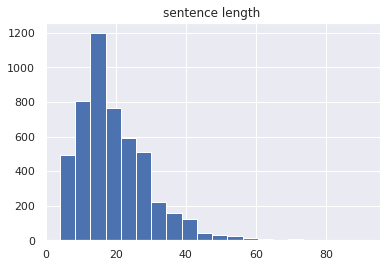

In [ ]:
train_dataset = ABSADataset(merged_train_list, tokenizer, add_prefix_space=False)
lengths, hist_obj = ABSADataset.length_dist(train_dataset, 20)

In [ ]:
np.histogram(lengths, bins=20)

(array([266, 414, 452, 444, 373, 218, 131,  87,  66,  14,  11,   9,   7,
          4,   1,   0,   1,   0,   0,   2]),
 array([ 4.  ,  8.25, 12.5 , 16.75, 21.  , 25.25, 29.5 , 33.75, 38.  ,
        42.25, 46.5 , 50.75, 55.  , 59.25, 63.5 , 67.75, 72.  , 76.25,
        80.5 , 84.75, 89.  ]))

## Effect on max length
Here, we check how cutting length of sentences affect performance

In [ ]:
from collections import defaultdict
import gc

sentences = []
for batch in valid_dataloader:
    sentences += batch[0].cpu().numpy().tolist()

results = defaultdict(list)
pre_trained_model_name = 'roberta-base'
tokenizer = transformers.RobertaTokenizer.from_pretrained(pre_trained_model_name)


for MAX_LENGTH in [None, 60, 50, 40, 30]:
    train_dataset = ABSADataset(rest_train_list, tokenizer, add_prefix_space=True, max_sen_length=MAX_LENGTH)
    valid_dataset = ABSADataset(rest_valid_list, tokenizer, add_prefix_space=True)
    train_dataloader = DataLoader(train_dataset, collate_fn=collate, batch_size=25)
    valid_dataloader = DataLoader(valid_dataset, collate_fn=collate, batch_size=16)

    for i in range(4):
        def define_model(NParams):
            set_seed(i)
            encoder_model = transformers.RobertaModel.from_pretrained(pre_trained_model_name)
            return SimpleModel(NParams, encoder_model, None, tokenizer, rest_valid_list)
        
        best_model, best_trainer, best_score, ave_score, metric_hist = choose_best(
                    define_model, train_dataloader, valid_dataloader,
                    None, num_runs=1, es_metric='f1', eval_score='f1', 
                    hp_sets=hp_set, collect_metrics=['f1', 'train_loss', 'val_loss', 'acc', 'acc_mask'],
                    #trainer_args={'max_epochs': 1}
                    earstop_args={'mode':'max', 'patience': 2}
                    )
        print(MAX_LENGTH, best_score)
        results[MAX_LENGTH].append(best_score)
        

rm: cannot remove 'lightning_logs/': No such file or directory
====== HYPER PARAMETERS ======
cls_dropout 0.0
fine_tune True
num_classes 18
sh_total_steps 2000
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/data_loading.py:106: UserWarning: The dataloader, val dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  f"The dataloader, {name}, does not have many workers which may be a bottleneck."


Aspect Sentiment Evaluation

	ALL	 TP: 4;	FP: 187;	FN: 20
		(m avg): precision: 2.09;	recall: 16.67;	f1: 3.72 (micro)
		(M avg): precision: 0.98;	recall: 7.14;	f1: 1.72 (Macro)

	positive: 	TP: 4;	FP: 98;	FN: 10;	precision: 3.92;	recall: 28.57;	f1: 6.90;	102
	negative: 	TP: 0;	FP: 18;	FN: 3;	precision: 0.00;	recall: 0.00;	f1: 0.00;	18
	neutral: 	TP: 0;	FP: 11;	FN: 6;	precision: 0.00;	recall: 0.00;	f1: 0.00;	11
	conflict: 	TP: 0;	FP: 60;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	60


/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/data_loading.py:106: UserWarning: The dataloader, train dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  f"The dataloader, {name}, does not have many workers which may be a bottleneck."


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 209;	FP: 367;	FN: 451
		(m avg): precision: 36.28;	recall: 31.67;	f1: 33.82 (micro)
		(M avg): precision: 9.07;	recall: 14.51;	f1: 11.16 (Macro)

	positive: 	TP: 209;	FP: 367;	FN: 151;	precision: 36.28;	recall: 58.06;	f1: 44.66;	576
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 346;	FP: 330;	FN: 314
		(m avg): precision: 51.18;	recall: 52.42;	f1: 51.80 (micro)
		(M avg): precision: 29.65;	recall: 28.01;	f1: 25.48 (Macro)

	positive: 	TP: 303;	FP: 280;	FN: 57;	precision: 51.97;	recall: 84.17;	f1: 64.26;	583
	negative: 	TP: 41;	FP: 39;	FN: 115;	precision: 51.25;	recall: 26.28;	f1: 34.75;	80
	neutral: 	TP: 2;	FP: 11;	FN: 123;	precision: 15.38;	recall: 1.60;	f1: 2.90;	13
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 409;	FP: 271;	FN: 251
		(m avg): precision: 60.15;	recall: 61.97;	f1: 61.04 (micro)
		(M avg): precision: 37.70;	recall: 39.66;	f1: 37.31 (Macro)

	positive: 	TP: 292;	FP: 142;	FN: 68;	precision: 67.28;	recall: 81.11;	f1: 73.55;	434
	negative: 	TP: 101;	FP: 95;	FN: 55;	precision: 51.53;	recall: 64.74;	f1: 57.39;	196
	neutral: 	TP: 16;	FP: 34;	FN: 109;	precision: 32.00;	recall: 12.80;	f1: 18.29;	50
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 439;	FP: 246;	FN: 221
		(m avg): precision: 64.09;	recall: 66.52;	f1: 65.28 (micro)
		(M avg): precision: 44.13;	recall: 46.92;	f1: 45.09 (Macro)

	positive: 	TP: 279;	FP: 104;	FN: 81;	precision: 72.85;	recall: 77.50;	f1: 75.10;	383
	negative: 	TP: 112;	FP: 91;	FN: 44;	precision: 55.17;	recall: 71.79;	f1: 62.40;	203
	neutral: 	TP: 48;	FP: 51;	FN: 77;	precision: 48.48;	recall: 38.40;	f1: 42.86;	99
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 442;	FP: 272;	FN: 218
		(m avg): precision: 61.90;	recall: 66.97;	f1: 64.34 (micro)
		(M avg): precision: 42.63;	recall: 45.77;	f1: 43.99 (Macro)

	positive: 	TP: 297;	FP: 144;	FN: 63;	precision: 67.35;	recall: 82.50;	f1: 74.16;	441
	negative: 	TP: 97;	FP: 60;	FN: 59;	precision: 61.78;	recall: 62.18;	f1: 61.98;	157
	neutral: 	TP: 48;	FP: 68;	FN: 77;	precision: 41.38;	recall: 38.40;	f1: 39.83;	116
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 453;	FP: 284;	FN: 207
		(m avg): precision: 61.47;	recall: 68.64;	f1: 64.85 (micro)
		(M avg): precision: 42.99;	recall: 49.11;	f1: 45.68 (Macro)

	positive: 	TP: 288;	FP: 120;	FN: 72;	precision: 70.59;	recall: 80.00;	f1: 75.00;	408
	negative: 	TP: 98;	FP: 59;	FN: 58;	precision: 62.42;	recall: 62.82;	f1: 62.62;	157
	neutral: 	TP: 67;	FP: 105;	FN: 58;	precision: 38.95;	recall: 53.60;	f1: 45.12;	172
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
None tensor(64.8533)
====== HYPER PARAMETERS ======
cls_dropout 0.0
fine_tune True
num_classes 18
sh_total_steps 2000
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 1;	FP: 290;	FN: 23
		(m avg): precision: 0.34;	recall: 4.17;	f1: 0.63 (micro)
		(M avg): precision: 0.32;	recall: 25.00;	f1: 0.62 (Macro)

	positive: 	TP: 0;	FP: 8;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	8
	negative: 	TP: 0;	FP: 203;	FN: 3;	precision: 0.00;	recall: 0.00;	f1: 0.00;	203
	neutral: 	TP: 0;	FP: 1;	FN: 6;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
	conflict: 	TP: 1;	FP: 78;	FN: 0;	precision: 1.27;	recall: 100.00;	f1: 2.50;	79


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 93;	FP: 119;	FN: 567
		(m avg): precision: 43.87;	recall: 14.09;	f1: 21.33 (micro)
		(M avg): precision: 10.97;	recall: 6.46;	f1: 8.13 (Macro)

	positive: 	TP: 93;	FP: 119;	FN: 267;	precision: 43.87;	recall: 25.83;	f1: 32.52;	212
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 305;	FP: 366;	FN: 355
		(m avg): precision: 45.45;	recall: 46.21;	f1: 45.83 (micro)
		(M avg): precision: 11.36;	recall: 21.18;	f1: 14.79 (Macro)

	positive: 	TP: 305;	FP: 366;	FN: 55;	precision: 45.45;	recall: 84.72;	f1: 59.17;	671
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 309;	FP: 340;	FN: 351
		(m avg): precision: 47.61;	recall: 46.82;	f1: 47.21 (micro)
		(M avg): precision: 39.27;	recall: 22.03;	f1: 16.98 (Macro)

	positive: 	TP: 304;	FP: 335;	FN: 56;	precision: 47.57;	recall: 84.44;	f1: 60.86;	639
	negative: 	TP: 2;	FP: 1;	FN: 154;	precision: 66.67;	recall: 1.28;	f1: 2.52;	3
	neutral: 	TP: 3;	FP: 4;	FN: 122;	precision: 42.86;	recall: 2.40;	f1: 4.55;	7
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 418;	FP: 260;	FN: 242
		(m avg): precision: 61.65;	recall: 63.33;	f1: 62.48 (micro)
		(M avg): precision: 40.29;	recall: 41.78;	f1: 40.35 (Macro)

	positive: 	TP: 289;	FP: 138;	FN: 71;	precision: 67.68;	recall: 80.28;	f1: 73.44;	427
	negative: 	TP: 103;	FP: 75;	FN: 53;	precision: 57.87;	recall: 66.03;	f1: 61.68;	178
	neutral: 	TP: 26;	FP: 47;	FN: 99;	precision: 35.62;	recall: 20.80;	f1: 26.26;	73
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 428;	FP: 300;	FN: 232
		(m avg): precision: 58.79;	recall: 64.85;	f1: 61.67 (micro)
		(M avg): precision: 39.92;	recall: 43.35;	f1: 41.31 (Macro)

	positive: 	TP: 295;	FP: 168;	FN: 65;	precision: 63.71;	recall: 81.94;	f1: 71.69;	463
	negative: 	TP: 94;	FP: 63;	FN: 62;	precision: 59.87;	recall: 60.26;	f1: 60.06;	157
	neutral: 	TP: 39;	FP: 69;	FN: 86;	precision: 36.11;	recall: 31.20;	f1: 33.48;	108
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 440;	FP: 251;	FN: 220
		(m avg): precision: 63.68;	recall: 66.67;	f1: 65.14 (micro)
		(M avg): precision: 44.67;	recall: 47.46;	f1: 45.88 (Macro)

	positive: 	TP: 281;	FP: 109;	FN: 79;	precision: 72.05;	recall: 78.06;	f1: 74.93;	390
	negative: 	TP: 97;	FP: 48;	FN: 59;	precision: 66.90;	recall: 62.18;	f1: 64.45;	145
	neutral: 	TP: 62;	FP: 94;	FN: 63;	precision: 39.74;	recall: 49.60;	f1: 44.13;	156
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 445;	FP: 283;	FN: 215
		(m avg): precision: 61.13;	recall: 67.42;	f1: 64.12 (micro)
		(M avg): precision: 43.20;	recall: 45.17;	f1: 43.68 (Macro)

	positive: 	TP: 308;	FP: 173;	FN: 52;	precision: 64.03;	recall: 85.56;	f1: 73.25;	481
	negative: 	TP: 91;	FP: 42;	FN: 65;	precision: 68.42;	recall: 58.33;	f1: 62.98;	133
	neutral: 	TP: 46;	FP: 68;	FN: 79;	precision: 40.35;	recall: 36.80;	f1: 38.49;	114
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 442;	FP: 233;	FN: 218
		(m avg): precision: 65.48;	recall: 66.97;	f1: 66.22 (micro)
		(M avg): precision: 46.70;	recall: 46.10;	f1: 46.08 (Macro)

	positive: 	TP: 296;	FP: 133;	FN: 64;	precision: 69.00;	recall: 82.22;	f1: 75.03;	429
	negative: 	TP: 92;	FP: 35;	FN: 64;	precision: 72.44;	recall: 58.97;	f1: 65.02;	127
	neutral: 	TP: 54;	FP: 65;	FN: 71;	precision: 45.38;	recall: 43.20;	f1: 44.26;	119
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 435;	FP: 243;	FN: 225
		(m avg): precision: 64.16;	recall: 65.91;	f1: 65.02 (micro)
		(M avg): precision: 46.70;	recall: 49.68;	f1: 47.22 (Macro)

	positive: 	TP: 256;	FP: 69;	FN: 104;	precision: 78.77;	recall: 71.11;	f1: 74.74;	325
	negative: 	TP: 98;	FP: 42;	FN: 58;	precision: 70.00;	recall: 62.82;	f1: 66.22;	140
	neutral: 	TP: 81;	FP: 132;	FN: 44;	precision: 38.03;	recall: 64.80;	f1: 47.93;	213
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 432;	FP: 239;	FN: 228
		(m avg): precision: 64.38;	recall: 65.45;	f1: 64.91 (micro)
		(M avg): precision: 45.31;	recall: 45.99;	f1: 45.53 (Macro)

	positive: 	TP: 280;	FP: 117;	FN: 80;	precision: 70.53;	recall: 77.78;	f1: 73.98;	397
	negative: 	TP: 97;	FP: 41;	FN: 59;	precision: 70.29;	recall: 62.18;	f1: 65.99;	138
	neutral: 	TP: 55;	FP: 81;	FN: 70;	precision: 40.44;	recall: 44.00;	f1: 42.15;	136
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
None tensor(64.9136)
====== HYPER PARAMETERS ======
cls_dropout 0.0
fine_tune True
num_classes 18
sh_total_steps 2000
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 1;	FP: 201;	FN: 23
		(m avg): precision: 0.50;	recall: 4.17;	f1: 0.88 (micro)
		(M avg): precision: 0.24;	recall: 8.33;	f1: 0.46 (Macro)

	positive: 	TP: 0;	FP: 81;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	81
	negative: 	TP: 1;	FP: 105;	FN: 2;	precision: 0.94;	recall: 33.33;	f1: 1.83;	106
	neutral: 	TP: 0;	FP: 2;	FN: 6;	precision: 0.00;	recall: 0.00;	f1: 0.00;	2
	conflict: 	TP: 0;	FP: 13;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	13


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 195;	FP: 311;	FN: 465
		(m avg): precision: 38.54;	recall: 29.55;	f1: 33.45 (micro)
		(M avg): precision: 9.63;	recall: 13.54;	f1: 11.26 (Macro)

	positive: 	TP: 195;	FP: 311;	FN: 165;	precision: 38.54;	recall: 54.17;	f1: 45.03;	506
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 345;	FP: 306;	FN: 315
		(m avg): precision: 53.00;	recall: 52.27;	f1: 52.63 (micro)
		(M avg): precision: 38.11;	recall: 28.56;	f1: 27.71 (Macro)

	positive: 	TP: 297;	FP: 274;	FN: 63;	precision: 52.01;	recall: 82.50;	f1: 63.80;	571
	negative: 	TP: 42;	FP: 19;	FN: 114;	precision: 68.85;	recall: 26.92;	f1: 38.71;	61
	neutral: 	TP: 6;	FP: 13;	FN: 119;	precision: 31.58;	recall: 4.80;	f1: 8.33;	19
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 419;	FP: 252;	FN: 241
		(m avg): precision: 62.44;	recall: 63.48;	f1: 62.96 (micro)
		(M avg): precision: 41.54;	recall: 42.26;	f1: 40.80 (Macro)

	positive: 	TP: 285;	FP: 137;	FN: 75;	precision: 67.54;	recall: 79.17;	f1: 72.89;	422
	negative: 	TP: 109;	FP: 78;	FN: 47;	precision: 58.29;	recall: 69.87;	f1: 63.56;	187
	neutral: 	TP: 25;	FP: 37;	FN: 100;	precision: 40.32;	recall: 20.00;	f1: 26.74;	62
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 448;	FP: 267;	FN: 212
		(m avg): precision: 62.66;	recall: 67.88;	f1: 65.16 (micro)
		(M avg): precision: 43.56;	recall: 46.42;	f1: 44.71 (Macro)

	positive: 	TP: 300;	FP: 149;	FN: 60;	precision: 66.82;	recall: 83.33;	f1: 74.17;	449
	negative: 	TP: 101;	FP: 57;	FN: 55;	precision: 63.92;	recall: 64.74;	f1: 64.33;	158
	neutral: 	TP: 47;	FP: 61;	FN: 78;	precision: 43.52;	recall: 37.60;	f1: 40.34;	108
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 455;	FP: 234;	FN: 205
		(m avg): precision: 66.04;	recall: 68.94;	f1: 67.46 (micro)
		(M avg): precision: 46.68;	recall: 47.36;	f1: 46.58 (Macro)

	positive: 	TP: 302;	FP: 136;	FN: 58;	precision: 68.95;	recall: 83.89;	f1: 75.69;	438
	negative: 	TP: 106;	FP: 53;	FN: 50;	precision: 66.67;	recall: 67.95;	f1: 67.30;	159
	neutral: 	TP: 47;	FP: 45;	FN: 78;	precision: 51.09;	recall: 37.60;	f1: 43.32;	92
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 440;	FP: 234;	FN: 220
		(m avg): precision: 65.28;	recall: 66.67;	f1: 65.97 (micro)
		(M avg): precision: 46.34;	recall: 44.78;	f1: 44.82 (Macro)

	positive: 	TP: 300;	FP: 151;	FN: 60;	precision: 66.52;	recall: 83.33;	f1: 73.98;	451
	negative: 	TP: 102;	FP: 41;	FN: 54;	precision: 71.33;	recall: 65.38;	f1: 68.23;	143
	neutral: 	TP: 38;	FP: 42;	FN: 87;	precision: 47.50;	recall: 30.40;	f1: 37.07;	80
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 461;	FP: 267;	FN: 199
		(m avg): precision: 63.32;	recall: 69.85;	f1: 66.43 (micro)
		(M avg): precision: 44.78;	recall: 52.03;	f1: 47.84 (Macro)

	positive: 	TP: 273;	FP: 91;	FN: 87;	precision: 75.00;	recall: 75.83;	f1: 75.41;	364
	negative: 	TP: 114;	FP: 62;	FN: 42;	precision: 64.77;	recall: 73.08;	f1: 68.67;	176
	neutral: 	TP: 74;	FP: 114;	FN: 51;	precision: 39.36;	recall: 59.20;	f1: 47.28;	188
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
None tensor(66.4265)
====== HYPER PARAMETERS ======
cls_dropout 0.0
fine_tune True
num_classes 18
sh_total_steps 2000
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 2;	FP: 388;	FN: 22
		(m avg): precision: 0.51;	recall: 8.33;	f1: 0.97 (micro)
		(M avg): precision: 0.20;	recall: 8.33;	f1: 0.39 (Macro)

	positive: 	TP: 0;	FP: 14;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	14
	negative: 	TP: 0;	FP: 68;	FN: 3;	precision: 0.00;	recall: 0.00;	f1: 0.00;	68
	neutral: 	TP: 2;	FP: 249;	FN: 4;	precision: 0.80;	recall: 33.33;	f1: 1.56;	251
	conflict: 	TP: 0;	FP: 57;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	57


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 218;	FP: 406;	FN: 442
		(m avg): precision: 34.94;	recall: 33.03;	f1: 33.96 (micro)
		(M avg): precision: 8.73;	recall: 15.14;	f1: 11.08 (Macro)

	positive: 	TP: 218;	FP: 406;	FN: 142;	precision: 34.94;	recall: 60.56;	f1: 44.31;	624
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 300;	FP: 368;	FN: 360
		(m avg): precision: 44.91;	recall: 45.45;	f1: 45.18 (micro)
		(M avg): precision: 11.24;	recall: 20.83;	f1: 14.61 (Macro)

	positive: 	TP: 300;	FP: 367;	FN: 60;	precision: 44.98;	recall: 83.33;	f1: 58.42;	667
	negative: 	TP: 0;	FP: 1;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 404;	FP: 253;	FN: 256
		(m avg): precision: 61.49;	recall: 61.21;	f1: 61.35 (micro)
		(M avg): precision: 38.30;	recall: 38.18;	f1: 36.18 (Macro)

	positive: 	TP: 296;	FP: 169;	FN: 64;	precision: 63.66;	recall: 82.22;	f1: 71.76;	465
	negative: 	TP: 100;	FP: 64;	FN: 56;	precision: 60.98;	recall: 64.10;	f1: 62.50;	164
	neutral: 	TP: 8;	FP: 20;	FN: 117;	precision: 28.57;	recall: 6.40;	f1: 10.46;	28
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 438;	FP: 250;	FN: 222
		(m avg): precision: 63.66;	recall: 66.36;	f1: 64.99 (micro)
		(M avg): precision: 43.09;	recall: 46.00;	f1: 43.73 (Macro)

	positive: 	TP: 283;	FP: 105;	FN: 77;	precision: 72.94;	recall: 78.61;	f1: 75.67;	388
	negative: 	TP: 117;	FP: 99;	FN: 39;	precision: 54.17;	recall: 75.00;	f1: 62.90;	216
	neutral: 	TP: 38;	FP: 46;	FN: 87;	precision: 45.24;	recall: 30.40;	f1: 36.36;	84
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 437;	FP: 228;	FN: 223
		(m avg): precision: 65.71;	recall: 66.21;	f1: 65.96 (micro)
		(M avg): precision: 46.20;	recall: 46.15;	f1: 46.05 (Macro)

	positive: 	TP: 287;	FP: 118;	FN: 73;	precision: 70.86;	recall: 79.72;	f1: 75.03;	405
	negative: 	TP: 95;	FP: 43;	FN: 61;	precision: 68.84;	recall: 60.90;	f1: 64.63;	138
	neutral: 	TP: 55;	FP: 67;	FN: 70;	precision: 45.08;	recall: 44.00;	f1: 44.53;	122
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 447;	FP: 249;	FN: 213
		(m avg): precision: 64.22;	recall: 67.73;	f1: 65.93 (micro)
		(M avg): precision: 45.69;	recall: 46.90;	f1: 46.05 (Macro)

	positive: 	TP: 296;	FP: 142;	FN: 64;	precision: 67.58;	recall: 82.22;	f1: 74.19;	438
	negative: 	TP: 97;	FP: 42;	FN: 59;	precision: 69.78;	recall: 62.18;	f1: 65.76;	139
	neutral: 	TP: 54;	FP: 65;	FN: 71;	precision: 45.38;	recall: 43.20;	f1: 44.26;	119
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 452;	FP: 257;	FN: 208
		(m avg): precision: 63.75;	recall: 68.48;	f1: 66.03 (micro)
		(M avg): precision: 46.59;	recall: 48.10;	f1: 46.83 (Macro)

	positive: 	TP: 296;	FP: 145;	FN: 64;	precision: 67.12;	recall: 82.22;	f1: 73.91;	441
	negative: 	TP: 92;	FP: 30;	FN: 64;	precision: 75.41;	recall: 58.97;	f1: 66.19;	122
	neutral: 	TP: 64;	FP: 82;	FN: 61;	precision: 43.84;	recall: 51.20;	f1: 47.23;	146
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 439;	FP: 241;	FN: 221
		(m avg): precision: 64.56;	recall: 66.52;	f1: 65.52 (micro)
		(M avg): precision: 46.87;	recall: 50.83;	f1: 47.92 (Macro)

	positive: 	TP: 250;	FP: 62;	FN: 110;	precision: 80.13;	recall: 69.44;	f1: 74.40;	312
	negative: 	TP: 109;	FP: 48;	FN: 47;	precision: 69.43;	recall: 69.87;	f1: 69.65;	157
	neutral: 	TP: 80;	FP: 131;	FN: 45;	precision: 37.91;	recall: 64.00;	f1: 47.62;	211
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 433;	FP: 229;	FN: 227
		(m avg): precision: 65.41;	recall: 65.61;	f1: 65.51 (micro)
		(M avg): precision: 49.24;	recall: 49.96;	f1: 47.98 (Macro)

	positive: 	TP: 252;	FP: 55;	FN: 108;	precision: 82.08;	recall: 70.00;	f1: 75.56;	307
	negative: 	TP: 94;	FP: 27;	FN: 62;	precision: 77.69;	recall: 60.26;	f1: 67.87;	121
	neutral: 	TP: 87;	FP: 147;	FN: 38;	precision: 37.18;	recall: 69.60;	f1: 48.47;	234
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
None tensor(65.5068)
====== HYPER PARAMETERS ======
cls_dropout 0.0
fine_tune True
num_classes 18
sh_total_steps 2000
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 4;	FP: 187;	FN: 20
		(m avg): precision: 2.09;	recall: 16.67;	f1: 3.72 (micro)
		(M avg): precision: 0.98;	recall: 7.14;	f1: 1.72 (Macro)

	positive: 	TP: 4;	FP: 98;	FN: 10;	precision: 3.92;	recall: 28.57;	f1: 6.90;	102
	negative: 	TP: 0;	FP: 18;	FN: 3;	precision: 0.00;	recall: 0.00;	f1: 0.00;	18
	neutral: 	TP: 0;	FP: 11;	FN: 6;	precision: 0.00;	recall: 0.00;	f1: 0.00;	11
	conflict: 	TP: 0;	FP: 60;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	60


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 215;	FP: 383;	FN: 445
		(m avg): precision: 35.95;	recall: 32.58;	f1: 34.18 (micro)
		(M avg): precision: 8.99;	recall: 14.93;	f1: 11.22 (Macro)

	positive: 	TP: 215;	FP: 383;	FN: 145;	precision: 35.95;	recall: 59.72;	f1: 44.89;	598
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 345;	FP: 316;	FN: 315
		(m avg): precision: 52.19;	recall: 52.27;	f1: 52.23 (micro)
		(M avg): precision: 31.04;	recall: 27.89;	f1: 25.70 (Macro)

	positive: 	TP: 303;	FP: 265;	FN: 57;	precision: 53.35;	recall: 84.17;	f1: 65.30;	568
	negative: 	TP: 39;	FP: 40;	FN: 117;	precision: 49.37;	recall: 25.00;	f1: 33.19;	79
	neutral: 	TP: 3;	FP: 11;	FN: 122;	precision: 21.43;	recall: 2.40;	f1: 4.32;	14
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 434;	FP: 261;	FN: 226
		(m avg): precision: 62.45;	recall: 65.76;	f1: 64.06 (micro)
		(M avg): precision: 42.81;	recall: 43.16;	f1: 41.15 (Macro)

	positive: 	TP: 302;	FP: 147;	FN: 58;	precision: 67.26;	recall: 83.89;	f1: 74.66;	449
	negative: 	TP: 106;	FP: 87;	FN: 50;	precision: 54.92;	recall: 67.95;	f1: 60.74;	193
	neutral: 	TP: 26;	FP: 27;	FN: 99;	precision: 49.06;	recall: 20.80;	f1: 29.21;	53
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 424;	FP: 280;	FN: 236
		(m avg): precision: 60.23;	recall: 64.24;	f1: 62.17 (micro)
		(M avg): precision: 43.46;	recall: 41.67;	f1: 41.45 (Macro)

	positive: 	TP: 306;	FP: 195;	FN: 54;	precision: 61.08;	recall: 85.00;	f1: 71.08;	501
	negative: 	TP: 80;	FP: 35;	FN: 76;	precision: 69.57;	recall: 51.28;	f1: 59.04;	115
	neutral: 	TP: 38;	FP: 50;	FN: 87;	precision: 43.18;	recall: 30.40;	f1: 35.68;	88
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 455;	FP: 281;	FN: 205
		(m avg): precision: 61.82;	recall: 68.94;	f1: 65.19 (micro)
		(M avg): precision: 42.13;	recall: 49.11;	f1: 45.16 (Macro)

	positive: 	TP: 284;	FP: 116;	FN: 76;	precision: 71.00;	recall: 78.89;	f1: 74.74;	400
	negative: 	TP: 121;	FP: 93;	FN: 35;	precision: 56.54;	recall: 77.56;	f1: 65.41;	214
	neutral: 	TP: 50;	FP: 72;	FN: 75;	precision: 40.98;	recall: 40.00;	f1: 40.49;	122
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 454;	FP: 262;	FN: 206
		(m avg): precision: 63.41;	recall: 68.79;	f1: 65.99 (micro)
		(M avg): precision: 43.84;	recall: 48.62;	f1: 46.09 (Macro)

	positive: 	TP: 292;	FP: 116;	FN: 68;	precision: 71.57;	recall: 81.11;	f1: 76.04;	408
	negative: 	TP: 102;	FP: 63;	FN: 54;	precision: 61.82;	recall: 65.38;	f1: 63.55;	165
	neutral: 	TP: 60;	FP: 83;	FN: 65;	precision: 41.96;	recall: 48.00;	f1: 44.78;	143
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 442;	FP: 202;	FN: 218
		(m avg): precision: 68.63;	recall: 66.97;	f1: 67.79 (micro)
		(M avg): precision: 47.55;	recall: 46.58;	f1: 46.98 (Macro)

	positive: 	TP: 289;	FP: 98;	FN: 71;	precision: 74.68;	recall: 80.28;	f1: 77.38;	387
	negative: 	TP: 103;	FP: 44;	FN: 53;	precision: 70.07;	recall: 66.03;	f1: 67.99;	147
	neutral: 	TP: 50;	FP: 60;	FN: 75;	precision: 45.45;	recall: 40.00;	f1: 42.55;	110
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 439;	FP: 203;	FN: 221
		(m avg): precision: 68.38;	recall: 66.52;	f1: 67.43 (micro)
		(M avg): precision: 47.66;	recall: 46.92;	f1: 47.23 (Macro)

	positive: 	TP: 283;	FP: 89;	FN: 77;	precision: 76.08;	recall: 78.61;	f1: 77.32;	372
	negative: 	TP: 99;	FP: 41;	FN: 57;	precision: 70.71;	recall: 63.46;	f1: 66.89;	140
	neutral: 	TP: 57;	FP: 73;	FN: 68;	precision: 43.85;	recall: 45.60;	f1: 44.71;	130
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 450;	FP: 238;	FN: 210
		(m avg): precision: 65.41;	recall: 68.18;	f1: 66.77 (micro)
		(M avg): precision: 46.47;	recall: 47.53;	f1: 46.73 (Macro)

	positive: 	TP: 297;	FP: 122;	FN: 63;	precision: 70.88;	recall: 82.50;	f1: 76.25;	419
	negative: 	TP: 93;	FP: 37;	FN: 63;	precision: 71.54;	recall: 59.62;	f1: 65.03;	130
	neutral: 	TP: 60;	FP: 78;	FN: 65;	precision: 43.48;	recall: 48.00;	f1: 45.63;	138
	conflict: 	TP: 0;	FP: 1;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
60 tensor(66.7656)
====== HYPER PARAMETERS ======
cls_dropout 0.0
fine_tune True
num_classes 18
sh_total_steps 2000
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 1;	FP: 290;	FN: 23
		(m avg): precision: 0.34;	recall: 4.17;	f1: 0.63 (micro)
		(M avg): precision: 0.32;	recall: 25.00;	f1: 0.62 (Macro)

	positive: 	TP: 0;	FP: 8;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	8
	negative: 	TP: 0;	FP: 203;	FN: 3;	precision: 0.00;	recall: 0.00;	f1: 0.00;	203
	neutral: 	TP: 0;	FP: 1;	FN: 6;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
	conflict: 	TP: 1;	FP: 78;	FN: 0;	precision: 1.27;	recall: 100.00;	f1: 2.50;	79


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 68;	FP: 58;	FN: 592
		(m avg): precision: 53.97;	recall: 10.30;	f1: 17.30 (micro)
		(M avg): precision: 13.49;	recall: 4.72;	f1: 7.00 (Macro)

	positive: 	TP: 68;	FP: 58;	FN: 292;	precision: 53.97;	recall: 18.89;	f1: 27.98;	126
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 300;	FP: 370;	FN: 360
		(m avg): precision: 44.78;	recall: 45.45;	f1: 45.11 (micro)
		(M avg): precision: 11.19;	recall: 20.83;	f1: 14.56 (Macro)

	positive: 	TP: 300;	FP: 370;	FN: 60;	precision: 44.78;	recall: 83.33;	f1: 58.25;	670
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 314;	FP: 366;	FN: 346
		(m avg): precision: 46.18;	recall: 47.58;	f1: 46.87 (micro)
		(M avg): precision: 18.73;	recall: 22.07;	f1: 15.86 (Macro)

	positive: 	TP: 312;	FP: 361;	FN: 48;	precision: 46.36;	recall: 86.67;	f1: 60.41;	673
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 2;	FP: 5;	FN: 123;	precision: 28.57;	recall: 1.60;	f1: 3.03;	7
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 397;	FP: 282;	FN: 263
		(m avg): precision: 58.47;	recall: 60.15;	f1: 59.30 (micro)
		(M avg): precision: 40.87;	recall: 38.77;	f1: 38.95 (Macro)

	positive: 	TP: 289;	FP: 185;	FN: 71;	precision: 60.97;	recall: 80.28;	f1: 69.30;	474
	negative: 	TP: 73;	FP: 41;	FN: 83;	precision: 64.04;	recall: 46.79;	f1: 54.07;	114
	neutral: 	TP: 35;	FP: 56;	FN: 90;	precision: 38.46;	recall: 28.00;	f1: 32.41;	91
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 432;	FP: 270;	FN: 228
		(m avg): precision: 61.54;	recall: 65.45;	f1: 63.44 (micro)
		(M avg): precision: 43.11;	recall: 43.50;	f1: 42.75 (Macro)

	positive: 	TP: 300;	FP: 170;	FN: 60;	precision: 63.83;	recall: 83.33;	f1: 72.29;	470
	negative: 	TP: 94;	FP: 43;	FN: 62;	precision: 68.61;	recall: 60.26;	f1: 64.16;	137
	neutral: 	TP: 38;	FP: 57;	FN: 87;	precision: 40.00;	recall: 30.40;	f1: 34.55;	95
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 449;	FP: 281;	FN: 211
		(m avg): precision: 61.51;	recall: 68.03;	f1: 64.60 (micro)
		(M avg): precision: 43.01;	recall: 47.18;	f1: 44.88 (Macro)

	positive: 	TP: 296;	FP: 152;	FN: 64;	precision: 66.07;	recall: 82.22;	f1: 73.27;	448
	negative: 	TP: 100;	FP: 59;	FN: 56;	precision: 62.89;	recall: 64.10;	f1: 63.49;	159
	neutral: 	TP: 53;	FP: 70;	FN: 72;	precision: 43.09;	recall: 42.40;	f1: 42.74;	123
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 435;	FP: 246;	FN: 225
		(m avg): precision: 63.88;	recall: 65.91;	f1: 64.88 (micro)
		(M avg): precision: 45.56;	recall: 47.76;	f1: 46.36 (Macro)

	positive: 	TP: 271;	FP: 105;	FN: 89;	precision: 72.07;	recall: 75.28;	f1: 73.64;	376
	negative: 	TP: 97;	FP: 42;	FN: 59;	precision: 69.78;	recall: 62.18;	f1: 65.76;	139
	neutral: 	TP: 67;	FP: 99;	FN: 58;	precision: 40.36;	recall: 53.60;	f1: 46.05;	166
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 422;	FP: 254;	FN: 238
		(m avg): precision: 62.43;	recall: 63.94;	f1: 63.17 (micro)
		(M avg): precision: 43.42;	recall: 41.02;	f1: 41.27 (Macro)

	positive: 	TP: 307;	FP: 166;	FN: 53;	precision: 64.90;	recall: 85.28;	f1: 73.71;	473
	negative: 	TP: 83;	FP: 31;	FN: 73;	precision: 72.81;	recall: 53.21;	f1: 61.48;	114
	neutral: 	TP: 32;	FP: 57;	FN: 93;	precision: 35.96;	recall: 25.60;	f1: 29.91;	89
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 425;	FP: 256;	FN: 235
		(m avg): precision: 62.41;	recall: 64.39;	f1: 63.39 (micro)
		(M avg): precision: 46.59;	recall: 49.81;	f1: 46.73 (Macro)

	positive: 	TP: 240;	FP: 68;	FN: 120;	precision: 77.92;	recall: 66.67;	f1: 71.86;	308
	negative: 	TP: 97;	FP: 39;	FN: 59;	precision: 71.32;	recall: 62.18;	f1: 66.44;	136
	neutral: 	TP: 88;	FP: 149;	FN: 37;	precision: 37.13;	recall: 70.40;	f1: 48.62;	237
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
60 tensor(63.3855)
====== HYPER PARAMETERS ======
cls_dropout 0.0
fine_tune True
num_classes 18
sh_total_steps 2000
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 1;	FP: 201;	FN: 23
		(m avg): precision: 0.50;	recall: 4.17;	f1: 0.88 (micro)
		(M avg): precision: 0.24;	recall: 8.33;	f1: 0.46 (Macro)

	positive: 	TP: 0;	FP: 81;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	81
	negative: 	TP: 1;	FP: 105;	FN: 2;	precision: 0.94;	recall: 33.33;	f1: 1.83;	106
	neutral: 	TP: 0;	FP: 2;	FN: 6;	precision: 0.00;	recall: 0.00;	f1: 0.00;	2
	conflict: 	TP: 0;	FP: 13;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	13


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 199;	FP: 309;	FN: 461
		(m avg): precision: 39.17;	recall: 30.15;	f1: 34.08 (micro)
		(M avg): precision: 9.79;	recall: 13.82;	f1: 11.46 (Macro)

	positive: 	TP: 199;	FP: 309;	FN: 161;	precision: 39.17;	recall: 55.28;	f1: 45.85;	508
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 322;	FP: 321;	FN: 338
		(m avg): precision: 50.08;	recall: 48.79;	f1: 49.42 (micro)
		(M avg): precision: 33.67;	recall: 24.44;	f1: 21.70 (Macro)

	positive: 	TP: 300;	FP: 302;	FN: 60;	precision: 49.83;	recall: 83.33;	f1: 62.37;	602
	negative: 	TP: 20;	FP: 10;	FN: 136;	precision: 66.67;	recall: 12.82;	f1: 21.51;	30
	neutral: 	TP: 2;	FP: 9;	FN: 123;	precision: 18.18;	recall: 1.60;	f1: 2.94;	11
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 425;	FP: 272;	FN: 235
		(m avg): precision: 60.98;	recall: 64.39;	f1: 62.64 (micro)
		(M avg): precision: 40.85;	recall: 42.68;	f1: 40.56 (Macro)

	positive: 	TP: 291;	FP: 156;	FN: 69;	precision: 65.10;	recall: 80.83;	f1: 72.12;	447
	negative: 	TP: 109;	FP: 79;	FN: 47;	precision: 57.98;	recall: 69.87;	f1: 63.37;	188
	neutral: 	TP: 25;	FP: 37;	FN: 100;	precision: 40.32;	recall: 20.00;	f1: 26.74;	62
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 443;	FP: 281;	FN: 217
		(m avg): precision: 61.19;	recall: 67.12;	f1: 64.02 (micro)
		(M avg): precision: 42.17;	recall: 46.62;	f1: 44.13 (Macro)

	positive: 	TP: 289;	FP: 145;	FN: 71;	precision: 66.59;	recall: 80.28;	f1: 72.80;	434
	negative: 	TP: 107;	FP: 71;	FN: 49;	precision: 60.11;	recall: 68.59;	f1: 64.07;	178
	neutral: 	TP: 47;	FP: 65;	FN: 78;	precision: 41.96;	recall: 37.60;	f1: 39.66;	112
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 437;	FP: 237;	FN: 223
		(m avg): precision: 64.84;	recall: 66.21;	f1: 65.52 (micro)
		(M avg): precision: 45.37;	recall: 44.68;	f1: 44.66 (Macro)

	positive: 	TP: 298;	FP: 139;	FN: 62;	precision: 68.19;	recall: 82.78;	f1: 74.78;	437
	negative: 	TP: 96;	FP: 39;	FN: 60;	precision: 71.11;	recall: 61.54;	f1: 65.98;	135
	neutral: 	TP: 43;	FP: 59;	FN: 82;	precision: 42.16;	recall: 34.40;	f1: 37.89;	102
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 449;	FP: 254;	FN: 211
		(m avg): precision: 63.87;	recall: 68.03;	f1: 65.88 (micro)
		(M avg): precision: 44.38;	recall: 48.92;	f1: 46.53 (Macro)

	positive: 	TP: 279;	FP: 112;	FN: 81;	precision: 71.36;	recall: 77.50;	f1: 74.30;	391
	negative: 	TP: 112;	FP: 67;	FN: 44;	precision: 62.57;	recall: 71.79;	f1: 66.87;	179
	neutral: 	TP: 58;	FP: 75;	FN: 67;	precision: 43.61;	recall: 46.40;	f1: 44.96;	133
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 449;	FP: 259;	FN: 211
		(m avg): precision: 63.42;	recall: 68.03;	f1: 65.64 (micro)
		(M avg): precision: 45.05;	recall: 49.71;	f1: 46.98 (Macro)

	positive: 	TP: 276;	FP: 101;	FN: 84;	precision: 73.21;	recall: 76.67;	f1: 74.90;	377
	negative: 	TP: 102;	FP: 49;	FN: 54;	precision: 67.55;	recall: 65.38;	f1: 66.45;	151
	neutral: 	TP: 71;	FP: 109;	FN: 54;	precision: 39.44;	recall: 56.80;	f1: 46.56;	180
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 448;	FP: 218;	FN: 212
		(m avg): precision: 67.27;	recall: 67.88;	f1: 67.57 (micro)
		(M avg): precision: 47.37;	recall: 48.91;	f1: 48.04 (Macro)

	positive: 	TP: 280;	FP: 91;	FN: 80;	precision: 75.47;	recall: 77.78;	f1: 76.61;	371
	negative: 	TP: 104;	FP: 43;	FN: 52;	precision: 70.75;	recall: 66.67;	f1: 68.65;	147
	neutral: 	TP: 64;	FP: 84;	FN: 61;	precision: 43.24;	recall: 51.20;	f1: 46.89;	148
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 442;	FP: 256;	FN: 218
		(m avg): precision: 63.32;	recall: 66.97;	f1: 65.10 (micro)
		(M avg): precision: 55.63;	recall: 48.51;	f1: 49.18 (Macro)

	positive: 	TP: 298;	FP: 129;	FN: 62;	precision: 69.79;	recall: 82.78;	f1: 75.73;	427
	negative: 	TP: 81;	FP: 29;	FN: 75;	precision: 73.64;	recall: 51.92;	f1: 60.90;	110
	neutral: 	TP: 61;	FP: 95;	FN: 64;	precision: 39.10;	recall: 48.80;	f1: 43.42;	156
	conflict: 	TP: 2;	FP: 3;	FN: 17;	precision: 40.00;	recall: 10.53;	f1: 16.67;	5


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 446;	FP: 248;	FN: 214
		(m avg): precision: 64.27;	recall: 67.58;	f1: 65.88 (micro)
		(M avg): precision: 57.93;	recall: 51.04;	f1: 51.02 (Macro)

	positive: 	TP: 278;	FP: 98;	FN: 82;	precision: 73.94;	recall: 77.22;	f1: 75.54;	376
	negative: 	TP: 103;	FP: 44;	FN: 53;	precision: 70.07;	recall: 66.03;	f1: 67.99;	147
	neutral: 	TP: 63;	FP: 104;	FN: 62;	precision: 37.72;	recall: 50.40;	f1: 43.15;	167
	conflict: 	TP: 2;	FP: 2;	FN: 17;	precision: 50.00;	recall: 10.53;	f1: 17.39;	4
60 tensor(65.8789)
====== HYPER PARAMETERS ======
cls_dropout 0.0
fine_tune True
num_classes 18
sh_total_steps 2000
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 2;	FP: 388;	FN: 22
		(m avg): precision: 0.51;	recall: 8.33;	f1: 0.97 (micro)
		(M avg): precision: 0.20;	recall: 8.33;	f1: 0.39 (Macro)

	positive: 	TP: 0;	FP: 14;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	14
	negative: 	TP: 0;	FP: 68;	FN: 3;	precision: 0.00;	recall: 0.00;	f1: 0.00;	68
	neutral: 	TP: 2;	FP: 249;	FN: 4;	precision: 0.80;	recall: 33.33;	f1: 1.56;	251
	conflict: 	TP: 0;	FP: 57;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	57


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 216;	FP: 396;	FN: 444
		(m avg): precision: 35.29;	recall: 32.73;	f1: 33.96 (micro)
		(M avg): precision: 8.82;	recall: 15.00;	f1: 11.11 (Macro)

	positive: 	TP: 216;	FP: 396;	FN: 144;	precision: 35.29;	recall: 60.00;	f1: 44.44;	612
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 301;	FP: 352;	FN: 359
		(m avg): precision: 46.09;	recall: 45.61;	f1: 45.85 (micro)
		(M avg): precision: 11.52;	recall: 20.90;	f1: 14.86 (Macro)

	positive: 	TP: 301;	FP: 352;	FN: 59;	precision: 46.09;	recall: 83.61;	f1: 59.43;	653
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 397;	FP: 287;	FN: 263
		(m avg): precision: 58.04;	recall: 60.15;	f1: 59.08 (micro)
		(M avg): precision: 33.77;	recall: 36.17;	f1: 33.58 (Macro)

	positive: 	TP: 304;	FP: 207;	FN: 56;	precision: 59.49;	recall: 84.44;	f1: 69.80;	511
	negative: 	TP: 89;	FP: 55;	FN: 67;	precision: 61.81;	recall: 57.05;	f1: 59.33;	144
	neutral: 	TP: 4;	FP: 25;	FN: 121;	precision: 13.79;	recall: 3.20;	f1: 5.19;	29
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 430;	FP: 255;	FN: 230
		(m avg): precision: 62.77;	recall: 65.15;	f1: 63.94 (micro)
		(M avg): precision: 42.08;	recall: 44.57;	f1: 42.31 (Macro)

	positive: 	TP: 282;	FP: 113;	FN: 78;	precision: 71.39;	recall: 78.33;	f1: 74.70;	395
	negative: 	TP: 116;	FP: 100;	FN: 40;	precision: 53.70;	recall: 74.36;	f1: 62.37;	216
	neutral: 	TP: 32;	FP: 42;	FN: 93;	precision: 43.24;	recall: 25.60;	f1: 32.16;	74
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 442;	FP: 267;	FN: 218
		(m avg): precision: 62.34;	recall: 66.97;	f1: 64.57 (micro)
		(M avg): precision: 42.80;	recall: 45.95;	f1: 44.16 (Macro)

	positive: 	TP: 295;	FP: 137;	FN: 65;	precision: 68.29;	recall: 81.94;	f1: 74.49;	432
	negative: 	TP: 99;	FP: 68;	FN: 57;	precision: 59.28;	recall: 63.46;	f1: 61.30;	167
	neutral: 	TP: 48;	FP: 62;	FN: 77;	precision: 43.64;	recall: 38.40;	f1: 40.85;	110
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 441;	FP: 252;	FN: 219
		(m avg): precision: 63.64;	recall: 66.82;	f1: 65.19 (micro)
		(M avg): precision: 45.58;	recall: 45.00;	f1: 44.73 (Macro)

	positive: 	TP: 302;	FP: 161;	FN: 58;	precision: 65.23;	recall: 83.89;	f1: 73.39;	463
	negative: 	TP: 95;	FP: 35;	FN: 61;	precision: 73.08;	recall: 60.90;	f1: 66.43;	130
	neutral: 	TP: 44;	FP: 56;	FN: 81;	precision: 44.00;	recall: 35.20;	f1: 39.11;	100
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 452;	FP: 254;	FN: 208
		(m avg): precision: 64.02;	recall: 68.48;	f1: 66.18 (micro)
		(M avg): precision: 44.08;	recall: 48.83;	f1: 46.30 (Macro)

	positive: 	TP: 288;	FP: 99;	FN: 72;	precision: 74.42;	recall: 80.00;	f1: 77.11;	387
	negative: 	TP: 100;	FP: 68;	FN: 56;	precision: 59.52;	recall: 64.10;	f1: 61.73;	168
	neutral: 	TP: 64;	FP: 87;	FN: 61;	precision: 42.38;	recall: 51.20;	f1: 46.38;	151
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 443;	FP: 240;	FN: 217
		(m avg): precision: 64.86;	recall: 67.12;	f1: 65.97 (micro)
		(M avg): precision: 44.76;	recall: 47.47;	f1: 46.05 (Macro)

	positive: 	TP: 284;	FP: 105;	FN: 76;	precision: 73.01;	recall: 78.89;	f1: 75.83;	389
	negative: 	TP: 102;	FP: 70;	FN: 54;	precision: 59.30;	recall: 65.38;	f1: 62.20;	172
	neutral: 	TP: 57;	FP: 65;	FN: 68;	precision: 46.72;	recall: 45.60;	f1: 46.15;	122
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 460;	FP: 266;	FN: 200
		(m avg): precision: 63.36;	recall: 69.70;	f1: 66.38 (micro)
		(M avg): precision: 43.95;	recall: 49.42;	f1: 46.44 (Macro)

	positive: 	TP: 296;	FP: 110;	FN: 64;	precision: 72.91;	recall: 82.22;	f1: 77.28;	406
	negative: 	TP: 99;	FP: 60;	FN: 57;	precision: 62.26;	recall: 63.46;	f1: 62.86;	159
	neutral: 	TP: 65;	FP: 95;	FN: 60;	precision: 40.62;	recall: 52.00;	f1: 45.61;	160
	conflict: 	TP: 0;	FP: 1;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 457;	FP: 193;	FN: 203
		(m avg): precision: 70.31;	recall: 69.24;	f1: 69.77 (micro)
		(M avg): precision: 49.81;	recall: 49.80;	f1: 49.57 (Macro)

	positive: 	TP: 290;	FP: 78;	FN: 70;	precision: 78.80;	recall: 80.56;	f1: 79.67;	368
	negative: 	TP: 94;	FP: 37;	FN: 62;	precision: 71.76;	recall: 60.26;	f1: 65.51;	131
	neutral: 	TP: 73;	FP: 77;	FN: 52;	precision: 48.67;	recall: 58.40;	f1: 53.09;	150
	conflict: 	TP: 0;	FP: 1;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 434;	FP: 211;	FN: 226
		(m avg): precision: 67.29;	recall: 65.76;	f1: 66.51 (micro)
		(M avg): precision: 48.19;	recall: 47.88;	f1: 47.45 (Macro)

	positive: 	TP: 271;	FP: 76;	FN: 89;	precision: 78.10;	recall: 75.28;	f1: 76.66;	347
	negative: 	TP: 89;	FP: 34;	FN: 67;	precision: 72.36;	recall: 57.05;	f1: 63.80;	123
	neutral: 	TP: 74;	FP: 101;	FN: 51;	precision: 42.29;	recall: 59.20;	f1: 49.33;	175
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 433;	FP: 233;	FN: 227
		(m avg): precision: 65.02;	recall: 65.61;	f1: 65.31 (micro)
		(M avg): precision: 58.71;	recall: 47.94;	f1: 49.23 (Macro)

	positive: 	TP: 305;	FP: 118;	FN: 55;	precision: 72.10;	recall: 84.72;	f1: 77.91;	423
	negative: 	TP: 55;	FP: 7;	FN: 101;	precision: 88.71;	recall: 35.26;	f1: 50.46;	62
	neutral: 	TP: 70;	FP: 102;	FN: 55;	precision: 40.70;	recall: 56.00;	f1: 47.14;	172
	conflict: 	TP: 3;	FP: 6;	FN: 16;	precision: 33.33;	recall: 15.79;	f1: 21.43;	9
60 tensor(65.3092)
====== HYPER PARAMETERS ======
cls_dropout 0.0
fine_tune True
num_classes 18
sh_total_steps 2000
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 4;	FP: 187;	FN: 20
		(m avg): precision: 2.09;	recall: 16.67;	f1: 3.72 (micro)
		(M avg): precision: 0.98;	recall: 7.14;	f1: 1.72 (Macro)

	positive: 	TP: 4;	FP: 98;	FN: 10;	precision: 3.92;	recall: 28.57;	f1: 6.90;	102
	negative: 	TP: 0;	FP: 18;	FN: 3;	precision: 0.00;	recall: 0.00;	f1: 0.00;	18
	neutral: 	TP: 0;	FP: 11;	FN: 6;	precision: 0.00;	recall: 0.00;	f1: 0.00;	11
	conflict: 	TP: 0;	FP: 60;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	60


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 224;	FP: 405;	FN: 436
		(m avg): precision: 35.61;	recall: 33.94;	f1: 34.76 (micro)
		(M avg): precision: 8.90;	recall: 15.56;	f1: 11.32 (Macro)

	positive: 	TP: 224;	FP: 405;	FN: 136;	precision: 35.61;	recall: 62.22;	f1: 45.30;	629
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 342;	FP: 338;	FN: 318
		(m avg): precision: 50.29;	recall: 51.82;	f1: 51.04 (micro)
		(M avg): precision: 29.63;	recall: 27.19;	f1: 24.23 (Macro)

	positive: 	TP: 305;	FP: 288;	FN: 55;	precision: 51.43;	recall: 84.72;	f1: 64.01;	593
	negative: 	TP: 35;	FP: 43;	FN: 121;	precision: 44.87;	recall: 22.44;	f1: 29.91;	78
	neutral: 	TP: 2;	FP: 7;	FN: 123;	precision: 22.22;	recall: 1.60;	f1: 2.99;	9
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 428;	FP: 251;	FN: 232
		(m avg): precision: 63.03;	recall: 64.85;	f1: 63.93 (micro)
		(M avg): precision: 43.93;	recall: 42.32;	f1: 40.44 (Macro)

	positive: 	TP: 298;	FP: 154;	FN: 62;	precision: 65.93;	recall: 82.78;	f1: 73.40;	452
	negative: 	TP: 110;	FP: 78;	FN: 46;	precision: 58.51;	recall: 70.51;	f1: 63.95;	188
	neutral: 	TP: 20;	FP: 19;	FN: 105;	precision: 51.28;	recall: 16.00;	f1: 24.39;	39
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 437;	FP: 229;	FN: 223
		(m avg): precision: 65.62;	recall: 66.21;	f1: 65.91 (micro)
		(M avg): precision: 45.55;	recall: 45.03;	f1: 44.41 (Macro)

	positive: 	TP: 292;	FP: 121;	FN: 68;	precision: 70.70;	recall: 81.11;	f1: 75.55;	413
	negative: 	TP: 107;	FP: 73;	FN: 49;	precision: 59.44;	recall: 68.59;	f1: 63.69;	180
	neutral: 	TP: 38;	FP: 35;	FN: 87;	precision: 52.05;	recall: 30.40;	f1: 38.38;	73
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 456;	FP: 261;	FN: 204
		(m avg): precision: 63.60;	recall: 69.09;	f1: 66.23 (micro)
		(M avg): precision: 44.48;	recall: 48.23;	f1: 45.87 (Macro)

	positive: 	TP: 295;	FP: 134;	FN: 65;	precision: 68.76;	recall: 81.94;	f1: 74.78;	429
	negative: 	TP: 112;	FP: 79;	FN: 44;	precision: 58.64;	recall: 71.79;	f1: 64.55;	191
	neutral: 	TP: 49;	FP: 48;	FN: 76;	precision: 50.52;	recall: 39.20;	f1: 44.14;	97
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 430;	FP: 259;	FN: 230
		(m avg): precision: 62.41;	recall: 65.15;	f1: 63.75 (micro)
		(M avg): precision: 43.92;	recall: 45.50;	f1: 44.58 (Macro)

	positive: 	TP: 281;	FP: 138;	FN: 79;	precision: 67.06;	recall: 78.06;	f1: 72.14;	419
	negative: 	TP: 96;	FP: 49;	FN: 60;	precision: 66.21;	recall: 61.54;	f1: 63.79;	145
	neutral: 	TP: 53;	FP: 72;	FN: 72;	precision: 42.40;	recall: 42.40;	f1: 42.40;	125
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 435;	FP: 267;	FN: 225
		(m avg): precision: 61.97;	recall: 65.91;	f1: 63.88 (micro)
		(M avg): precision: 43.41;	recall: 45.20;	f1: 44.09 (Macro)

	positive: 	TP: 290;	FP: 150;	FN: 70;	precision: 65.91;	recall: 80.56;	f1: 72.50;	440
	negative: 	TP: 99;	FP: 45;	FN: 57;	precision: 68.75;	recall: 63.46;	f1: 66.00;	144
	neutral: 	TP: 46;	FP: 72;	FN: 79;	precision: 38.98;	recall: 36.80;	f1: 37.86;	118
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
50 tensor(63.8767)
====== HYPER PARAMETERS ======
cls_dropout 0.0
fine_tune True
num_classes 18
sh_total_steps 2000
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 1;	FP: 290;	FN: 23
		(m avg): precision: 0.34;	recall: 4.17;	f1: 0.63 (micro)
		(M avg): precision: 0.32;	recall: 25.00;	f1: 0.62 (Macro)

	positive: 	TP: 0;	FP: 8;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	8
	negative: 	TP: 0;	FP: 203;	FN: 3;	precision: 0.00;	recall: 0.00;	f1: 0.00;	203
	neutral: 	TP: 0;	FP: 1;	FN: 6;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
	conflict: 	TP: 1;	FP: 78;	FN: 0;	precision: 1.27;	recall: 100.00;	f1: 2.50;	79


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 95;	FP: 140;	FN: 565
		(m avg): precision: 40.43;	recall: 14.39;	f1: 21.23 (micro)
		(M avg): precision: 10.11;	recall: 6.60;	f1: 7.98 (Macro)

	positive: 	TP: 95;	FP: 140;	FN: 265;	precision: 40.43;	recall: 26.39;	f1: 31.93;	235
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 305;	FP: 371;	FN: 355
		(m avg): precision: 45.12;	recall: 46.21;	f1: 45.66 (micro)
		(M avg): precision: 11.28;	recall: 21.18;	f1: 14.72 (Macro)

	positive: 	TP: 305;	FP: 371;	FN: 55;	precision: 45.12;	recall: 84.72;	f1: 58.88;	676
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 312;	FP: 348;	FN: 348
		(m avg): precision: 47.27;	recall: 47.27;	f1: 47.27 (micro)
		(M avg): precision: 20.23;	recall: 22.32;	f1: 17.06 (Macro)

	positive: 	TP: 307;	FP: 338;	FN: 53;	precision: 47.60;	recall: 85.28;	f1: 61.09;	645
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 5;	FP: 10;	FN: 120;	precision: 33.33;	recall: 4.00;	f1: 7.14;	15
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 395;	FP: 269;	FN: 265
		(m avg): precision: 59.49;	recall: 59.85;	f1: 59.67 (micro)
		(M avg): precision: 41.11;	recall: 37.99;	f1: 38.45 (Macro)

	positive: 	TP: 291;	FP: 182;	FN: 69;	precision: 61.52;	recall: 80.83;	f1: 69.87;	473
	negative: 	TP: 76;	FP: 39;	FN: 80;	precision: 66.09;	recall: 48.72;	f1: 56.09;	115
	neutral: 	TP: 28;	FP: 48;	FN: 97;	precision: 36.84;	recall: 22.40;	f1: 27.86;	76
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 424;	FP: 266;	FN: 236
		(m avg): precision: 61.45;	recall: 64.24;	f1: 62.81 (micro)
		(M avg): precision: 43.03;	recall: 43.01;	f1: 42.60 (Macro)

	positive: 	TP: 293;	FP: 160;	FN: 67;	precision: 64.68;	recall: 81.39;	f1: 72.08;	453
	negative: 	TP: 89;	FP: 43;	FN: 67;	precision: 67.42;	recall: 57.05;	f1: 61.81;	132
	neutral: 	TP: 42;	FP: 63;	FN: 83;	precision: 40.00;	recall: 33.60;	f1: 36.52;	105
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 434;	FP: 297;	FN: 226
		(m avg): precision: 59.37;	recall: 65.76;	f1: 62.40 (micro)
		(M avg): precision: 40.78;	recall: 45.91;	f1: 43.17 (Macro)

	positive: 	TP: 284;	FP: 140;	FN: 76;	precision: 66.98;	recall: 78.89;	f1: 72.45;	424
	negative: 	TP: 96;	FP: 70;	FN: 60;	precision: 57.83;	recall: 61.54;	f1: 59.63;	166
	neutral: 	TP: 54;	FP: 87;	FN: 71;	precision: 38.30;	recall: 43.20;	f1: 40.60;	141
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 431;	FP: 247;	FN: 229
		(m avg): precision: 63.57;	recall: 65.30;	f1: 64.42 (micro)
		(M avg): precision: 44.32;	recall: 44.06;	f1: 43.87 (Macro)

	positive: 	TP: 296;	FP: 140;	FN: 64;	precision: 67.89;	recall: 82.22;	f1: 74.37;	436
	negative: 	TP: 88;	FP: 44;	FN: 68;	precision: 66.67;	recall: 56.41;	f1: 61.11;	132
	neutral: 	TP: 47;	FP: 63;	FN: 78;	precision: 42.73;	recall: 37.60;	f1: 40.00;	110
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 431;	FP: 279;	FN: 229
		(m avg): precision: 60.70;	recall: 65.30;	f1: 62.92 (micro)
		(M avg): precision: 42.67;	recall: 47.90;	f1: 44.79 (Macro)

	positive: 	TP: 262;	FP: 90;	FN: 98;	precision: 74.43;	recall: 72.78;	f1: 73.60;	352
	negative: 	TP: 103;	FP: 64;	FN: 53;	precision: 61.68;	recall: 66.03;	f1: 63.78;	167
	neutral: 	TP: 66;	FP: 125;	FN: 59;	precision: 34.55;	recall: 52.80;	f1: 41.77;	191
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 451;	FP: 233;	FN: 209
		(m avg): precision: 65.94;	recall: 68.33;	f1: 67.11 (micro)
		(M avg): precision: 46.90;	recall: 48.80;	f1: 47.62 (Macro)

	positive: 	TP: 287;	FP: 107;	FN: 73;	precision: 72.84;	recall: 79.72;	f1: 76.13;	394
	negative: 	TP: 99;	FP: 38;	FN: 57;	precision: 72.26;	recall: 63.46;	f1: 67.58;	137
	neutral: 	TP: 65;	FP: 88;	FN: 60;	precision: 42.48;	recall: 52.00;	f1: 46.76;	153
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 448;	FP: 239;	FN: 212
		(m avg): precision: 65.21;	recall: 67.88;	f1: 66.52 (micro)
		(M avg): precision: 46.68;	recall: 47.95;	f1: 46.93 (Macro)

	positive: 	TP: 291;	FP: 116;	FN: 69;	precision: 71.50;	recall: 80.83;	f1: 75.88;	407
	negative: 	TP: 92;	FP: 34;	FN: 64;	precision: 73.02;	recall: 58.97;	f1: 65.25;	126
	neutral: 	TP: 65;	FP: 89;	FN: 60;	precision: 42.21;	recall: 52.00;	f1: 46.59;	154
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 438;	FP: 224;	FN: 222
		(m avg): precision: 66.16;	recall: 66.36;	f1: 66.26 (micro)
		(M avg): precision: 47.88;	recall: 46.43;	f1: 46.33 (Macro)

	positive: 	TP: 291;	FP: 108;	FN: 69;	precision: 72.93;	recall: 80.83;	f1: 76.68;	399
	negative: 	TP: 80;	FP: 25;	FN: 76;	precision: 76.19;	recall: 51.28;	f1: 61.30;	105
	neutral: 	TP: 67;	FP: 91;	FN: 58;	precision: 42.41;	recall: 53.60;	f1: 47.35;	158
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
50 tensor(66.2632)
====== HYPER PARAMETERS ======
cls_dropout 0.0
fine_tune True
num_classes 18
sh_total_steps 2000
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 1;	FP: 201;	FN: 23
		(m avg): precision: 0.50;	recall: 4.17;	f1: 0.88 (micro)
		(M avg): precision: 0.24;	recall: 8.33;	f1: 0.46 (Macro)

	positive: 	TP: 0;	FP: 81;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	81
	negative: 	TP: 1;	FP: 105;	FN: 2;	precision: 0.94;	recall: 33.33;	f1: 1.83;	106
	neutral: 	TP: 0;	FP: 2;	FN: 6;	precision: 0.00;	recall: 0.00;	f1: 0.00;	2
	conflict: 	TP: 0;	FP: 13;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	13


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 210;	FP: 354;	FN: 450
		(m avg): precision: 37.23;	recall: 31.82;	f1: 34.31 (micro)
		(M avg): precision: 9.31;	recall: 14.58;	f1: 11.36 (Macro)

	positive: 	TP: 210;	FP: 354;	FN: 150;	precision: 37.23;	recall: 58.33;	f1: 45.45;	564
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 330;	FP: 329;	FN: 330
		(m avg): precision: 50.08;	recall: 50.00;	f1: 50.04 (micro)
		(M avg): precision: 29.39;	recall: 25.86;	f1: 23.32 (Macro)

	positive: 	TP: 298;	FP: 297;	FN: 62;	precision: 50.08;	recall: 82.78;	f1: 62.41;	595
	negative: 	TP: 31;	FP: 24;	FN: 125;	precision: 56.36;	recall: 19.87;	f1: 29.38;	55
	neutral: 	TP: 1;	FP: 8;	FN: 124;	precision: 11.11;	recall: 0.80;	f1: 1.49;	9
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 414;	FP: 238;	FN: 246
		(m avg): precision: 63.50;	recall: 62.73;	f1: 63.11 (micro)
		(M avg): precision: 42.08;	recall: 40.35;	f1: 39.91 (Macro)

	positive: 	TP: 295;	FP: 150;	FN: 65;	precision: 66.29;	recall: 81.94;	f1: 73.29;	445
	negative: 	TP: 99;	FP: 55;	FN: 57;	precision: 64.29;	recall: 63.46;	f1: 63.87;	154
	neutral: 	TP: 20;	FP: 33;	FN: 105;	precision: 37.74;	recall: 16.00;	f1: 22.47;	53
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 438;	FP: 263;	FN: 222
		(m avg): precision: 62.48;	recall: 66.36;	f1: 64.36 (micro)
		(M avg): precision: 43.63;	recall: 44.21;	f1: 43.01 (Macro)

	positive: 	TP: 301;	FP: 165;	FN: 59;	precision: 64.59;	recall: 83.61;	f1: 72.88;	466
	negative: 	TP: 103;	FP: 58;	FN: 53;	precision: 63.98;	recall: 66.03;	f1: 64.98;	161
	neutral: 	TP: 34;	FP: 40;	FN: 91;	precision: 45.95;	recall: 27.20;	f1: 34.17;	74
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 445;	FP: 292;	FN: 215
		(m avg): precision: 60.38;	recall: 67.42;	f1: 63.71 (micro)
		(M avg): precision: 41.92;	recall: 45.05;	f1: 43.03 (Macro)

	positive: 	TP: 308;	FP: 174;	FN: 52;	precision: 63.90;	recall: 85.56;	f1: 73.16;	482
	negative: 	TP: 94;	FP: 53;	FN: 62;	precision: 63.95;	recall: 60.26;	f1: 62.05;	147
	neutral: 	TP: 43;	FP: 65;	FN: 82;	precision: 39.81;	recall: 34.40;	f1: 36.91;	108
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 455;	FP: 265;	FN: 205
		(m avg): precision: 63.19;	recall: 68.94;	f1: 65.94 (micro)
		(M avg): precision: 44.50;	recall: 50.22;	f1: 46.96 (Macro)

	positive: 	TP: 281;	FP: 101;	FN: 79;	precision: 73.56;	recall: 78.06;	f1: 75.74;	382
	negative: 	TP: 103;	FP: 56;	FN: 53;	precision: 64.78;	recall: 66.03;	f1: 65.40;	159
	neutral: 	TP: 71;	FP: 108;	FN: 54;	precision: 39.66;	recall: 56.80;	f1: 46.71;	179
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 438;	FP: 220;	FN: 222
		(m avg): precision: 66.57;	recall: 66.36;	f1: 66.46 (micro)
		(M avg): precision: 47.68;	recall: 46.33;	f1: 46.57 (Macro)

	positive: 	TP: 289;	FP: 107;	FN: 71;	precision: 72.98;	recall: 80.28;	f1: 76.46;	396
	negative: 	TP: 89;	FP: 28;	FN: 67;	precision: 76.07;	recall: 57.05;	f1: 65.20;	117
	neutral: 	TP: 60;	FP: 84;	FN: 65;	precision: 41.67;	recall: 48.00;	f1: 44.61;	144
	conflict: 	TP: 0;	FP: 1;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 441;	FP: 215;	FN: 219
		(m avg): precision: 67.23;	recall: 66.82;	f1: 67.02 (micro)
		(M avg): precision: 46.88;	recall: 46.17;	f1: 46.38 (Macro)

	positive: 	TP: 293;	FP: 101;	FN: 67;	precision: 74.37;	recall: 81.39;	f1: 77.72;	394
	negative: 	TP: 95;	FP: 38;	FN: 61;	precision: 71.43;	recall: 60.90;	f1: 65.74;	133
	neutral: 	TP: 53;	FP: 74;	FN: 72;	precision: 41.73;	recall: 42.40;	f1: 42.06;	127
	conflict: 	TP: 0;	FP: 2;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	2


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 438;	FP: 206;	FN: 222
		(m avg): precision: 68.01;	recall: 66.36;	f1: 67.18 (micro)
		(M avg): precision: 52.00;	recall: 48.20;	f1: 49.39 (Macro)

	positive: 	TP: 282;	FP: 90;	FN: 78;	precision: 75.81;	recall: 78.33;	f1: 77.05;	372
	negative: 	TP: 93;	FP: 35;	FN: 63;	precision: 72.66;	recall: 59.62;	f1: 65.49;	128
	neutral: 	TP: 62;	FP: 75;	FN: 63;	precision: 45.26;	recall: 49.60;	f1: 47.33;	137
	conflict: 	TP: 1;	FP: 6;	FN: 18;	precision: 14.29;	recall: 5.26;	f1: 7.69;	7


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 445;	FP: 219;	FN: 215
		(m avg): precision: 67.02;	recall: 67.42;	f1: 67.22 (micro)
		(M avg): precision: 54.13;	recall: 48.00;	f1: 48.88 (Macro)

	positive: 	TP: 297;	FP: 100;	FN: 63;	precision: 74.81;	recall: 82.50;	f1: 78.47;	397
	negative: 	TP: 84;	FP: 28;	FN: 72;	precision: 75.00;	recall: 53.85;	f1: 62.69;	112
	neutral: 	TP: 63;	FP: 88;	FN: 62;	precision: 41.72;	recall: 50.40;	f1: 45.65;	151
	conflict: 	TP: 1;	FP: 3;	FN: 18;	precision: 25.00;	recall: 5.26;	f1: 8.70;	4


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 452;	FP: 216;	FN: 208
		(m avg): precision: 67.66;	recall: 68.48;	f1: 68.07 (micro)
		(M avg): precision: 55.51;	recall: 49.60;	f1: 49.86 (Macro)

	positive: 	TP: 297;	FP: 90;	FN: 63;	precision: 76.74;	recall: 82.50;	f1: 79.52;	387
	negative: 	TP: 79;	FP: 23;	FN: 77;	precision: 77.45;	recall: 50.64;	f1: 61.24;	102
	neutral: 	TP: 75;	FP: 100;	FN: 50;	precision: 42.86;	recall: 60.00;	f1: 50.00;	175
	conflict: 	TP: 1;	FP: 3;	FN: 18;	precision: 25.00;	recall: 5.26;	f1: 8.70;	4


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 440;	FP: 223;	FN: 220
		(m avg): precision: 66.37;	recall: 66.67;	f1: 66.52 (micro)
		(M avg): precision: 55.48;	recall: 47.52;	f1: 49.50 (Macro)

	positive: 	TP: 301;	FP: 119;	FN: 59;	precision: 71.67;	recall: 83.61;	f1: 77.18;	420
	negative: 	TP: 86;	FP: 28;	FN: 70;	precision: 75.44;	recall: 55.13;	f1: 63.70;	114
	neutral: 	TP: 51;	FP: 72;	FN: 74;	precision: 41.46;	recall: 40.80;	f1: 41.13;	123
	conflict: 	TP: 2;	FP: 4;	FN: 17;	precision: 33.33;	recall: 10.53;	f1: 16.00;	6


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 458;	FP: 204;	FN: 202
		(m avg): precision: 69.18;	recall: 69.39;	f1: 69.29 (micro)
		(M avg): precision: 54.70;	recall: 49.54;	f1: 50.41 (Macro)

	positive: 	TP: 300;	FP: 98;	FN: 60;	precision: 75.38;	recall: 83.33;	f1: 79.16;	398
	negative: 	TP: 101;	FP: 43;	FN: 55;	precision: 70.14;	recall: 64.74;	f1: 67.33;	144
	neutral: 	TP: 56;	FP: 60;	FN: 69;	precision: 48.28;	recall: 44.80;	f1: 46.47;	116
	conflict: 	TP: 1;	FP: 3;	FN: 18;	precision: 25.00;	recall: 5.26;	f1: 8.70;	4


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 467;	FP: 228;	FN: 193
		(m avg): precision: 67.19;	recall: 70.76;	f1: 68.93 (micro)
		(M avg): precision: 57.49;	recall: 53.41;	f1: 53.83 (Macro)

	positive: 	TP: 300;	FP: 102;	FN: 60;	precision: 74.63;	recall: 83.33;	f1: 78.74;	402
	negative: 	TP: 105;	FP: 54;	FN: 51;	precision: 66.04;	recall: 67.31;	f1: 66.67;	159
	neutral: 	TP: 59;	FP: 68;	FN: 66;	precision: 46.46;	recall: 47.20;	f1: 46.83;	127
	conflict: 	TP: 3;	FP: 4;	FN: 16;	precision: 42.86;	recall: 15.79;	f1: 23.08;	7


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 447;	FP: 210;	FN: 213
		(m avg): precision: 68.04;	recall: 67.73;	f1: 67.88 (micro)
		(M avg): precision: 57.19;	recall: 52.34;	f1: 53.65 (Macro)

	positive: 	TP: 276;	FP: 90;	FN: 84;	precision: 75.41;	recall: 76.67;	f1: 76.03;	366
	negative: 	TP: 110;	FP: 52;	FN: 46;	precision: 67.90;	recall: 70.51;	f1: 69.18;	162
	neutral: 	TP: 58;	FP: 63;	FN: 67;	precision: 47.93;	recall: 46.40;	f1: 47.15;	121
	conflict: 	TP: 3;	FP: 5;	FN: 16;	precision: 37.50;	recall: 15.79;	f1: 22.22;	8
50 tensor(67.8815)
====== HYPER PARAMETERS ======
cls_dropout 0.0
fine_tune True
num_classes 18
sh_total_steps 2000
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 2;	FP: 388;	FN: 22
		(m avg): precision: 0.51;	recall: 8.33;	f1: 0.97 (micro)
		(M avg): precision: 0.20;	recall: 8.33;	f1: 0.39 (Macro)

	positive: 	TP: 0;	FP: 14;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	14
	negative: 	TP: 0;	FP: 68;	FN: 3;	precision: 0.00;	recall: 0.00;	f1: 0.00;	68
	neutral: 	TP: 2;	FP: 249;	FN: 4;	precision: 0.80;	recall: 33.33;	f1: 1.56;	251
	conflict: 	TP: 0;	FP: 57;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	57


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 231;	FP: 404;	FN: 429
		(m avg): precision: 36.38;	recall: 35.00;	f1: 35.68 (micro)
		(M avg): precision: 9.09;	recall: 16.04;	f1: 11.61 (Macro)

	positive: 	TP: 231;	FP: 404;	FN: 129;	precision: 36.38;	recall: 64.17;	f1: 46.43;	635
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 313;	FP: 346;	FN: 347
		(m avg): precision: 47.50;	recall: 47.42;	f1: 47.46 (micro)
		(M avg): precision: 39.34;	recall: 22.40;	f1: 17.30 (Macro)

	positive: 	TP: 307;	FP: 341;	FN: 53;	precision: 47.38;	recall: 85.28;	f1: 60.91;	648
	negative: 	TP: 3;	FP: 2;	FN: 153;	precision: 60.00;	recall: 1.92;	f1: 3.73;	5
	neutral: 	TP: 3;	FP: 3;	FN: 122;	precision: 50.00;	recall: 2.40;	f1: 4.58;	6
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 412;	FP: 242;	FN: 248
		(m avg): precision: 63.00;	recall: 62.42;	f1: 62.71 (micro)
		(M avg): precision: 40.85;	recall: 40.55;	f1: 39.35 (Macro)

	positive: 	TP: 288;	FP: 145;	FN: 72;	precision: 66.51;	recall: 80.00;	f1: 72.64;	433
	negative: 	TP: 107;	FP: 65;	FN: 49;	precision: 62.21;	recall: 68.59;	f1: 65.24;	172
	neutral: 	TP: 17;	FP: 32;	FN: 108;	precision: 34.69;	recall: 13.60;	f1: 19.54;	49
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 437;	FP: 294;	FN: 223
		(m avg): precision: 59.78;	recall: 66.21;	f1: 62.83 (micro)
		(M avg): precision: 40.83;	recall: 44.63;	f1: 42.16 (Macro)

	positive: 	TP: 295;	FP: 171;	FN: 65;	precision: 63.30;	recall: 81.94;	f1: 71.43;	466
	negative: 	TP: 107;	FP: 68;	FN: 49;	precision: 61.14;	recall: 68.59;	f1: 64.65;	175
	neutral: 	TP: 35;	FP: 55;	FN: 90;	precision: 38.89;	recall: 28.00;	f1: 32.56;	90
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 440;	FP: 276;	FN: 220
		(m avg): precision: 61.45;	recall: 66.67;	f1: 63.95 (micro)
		(M avg): precision: 44.27;	recall: 45.18;	f1: 44.03 (Macro)

	positive: 	TP: 303;	FP: 161;	FN: 57;	precision: 65.30;	recall: 84.17;	f1: 73.54;	464
	negative: 	TP: 82;	FP: 32;	FN: 74;	precision: 71.93;	recall: 52.56;	f1: 60.74;	114
	neutral: 	TP: 55;	FP: 83;	FN: 70;	precision: 39.86;	recall: 44.00;	f1: 41.83;	138
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 447;	FP: 281;	FN: 213
		(m avg): precision: 61.40;	recall: 67.73;	f1: 64.41 (micro)
		(M avg): precision: 44.32;	recall: 46.28;	f1: 44.59 (Macro)

	positive: 	TP: 305;	FP: 160;	FN: 55;	precision: 65.59;	recall: 84.72;	f1: 73.94;	465
	negative: 	TP: 83;	FP: 33;	FN: 73;	precision: 71.55;	recall: 53.21;	f1: 61.03;	116
	neutral: 	TP: 59;	FP: 88;	FN: 66;	precision: 40.14;	recall: 47.20;	f1: 43.38;	147
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 446;	FP: 281;	FN: 214
		(m avg): precision: 61.35;	recall: 67.58;	f1: 64.31 (micro)
		(M avg): precision: 43.23;	recall: 46.66;	f1: 44.68 (Macro)

	positive: 	TP: 296;	FP: 154;	FN: 64;	precision: 65.78;	recall: 82.22;	f1: 73.09;	450
	negative: 	TP: 98;	FP: 46;	FN: 58;	precision: 68.06;	recall: 62.82;	f1: 65.33;	144
	neutral: 	TP: 52;	FP: 81;	FN: 73;	precision: 39.10;	recall: 41.60;	f1: 40.31;	133
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 450;	FP: 211;	FN: 210
		(m avg): precision: 68.08;	recall: 68.18;	f1: 68.13 (micro)
		(M avg): precision: 47.22;	recall: 49.38;	f1: 48.22 (Macro)

	positive: 	TP: 277;	FP: 74;	FN: 83;	precision: 78.92;	recall: 76.94;	f1: 77.92;	351
	negative: 	TP: 112;	FP: 53;	FN: 44;	precision: 67.88;	recall: 71.79;	f1: 69.78;	165
	neutral: 	TP: 61;	FP: 84;	FN: 64;	precision: 42.07;	recall: 48.80;	f1: 45.19;	145
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 446;	FP: 216;	FN: 214
		(m avg): precision: 67.37;	recall: 67.58;	f1: 67.47 (micro)
		(M avg): precision: 47.91;	recall: 47.43;	f1: 47.42 (Macro)

	positive: 	TP: 291;	FP: 104;	FN: 69;	precision: 73.67;	recall: 80.83;	f1: 77.09;	395
	negative: 	TP: 95;	FP: 32;	FN: 61;	precision: 74.80;	recall: 60.90;	f1: 67.14;	127
	neutral: 	TP: 60;	FP: 79;	FN: 65;	precision: 43.17;	recall: 48.00;	f1: 45.45;	139
	conflict: 	TP: 0;	FP: 1;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 432;	FP: 212;	FN: 228
		(m avg): precision: 67.08;	recall: 65.45;	f1: 66.26 (micro)
		(M avg): precision: 53.45;	recall: 45.41;	f1: 47.69 (Macro)

	positive: 	TP: 296;	FP: 126;	FN: 64;	precision: 70.14;	recall: 82.22;	f1: 75.70;	422
	negative: 	TP: 87;	FP: 24;	FN: 69;	precision: 78.38;	recall: 55.77;	f1: 65.17;	111
	neutral: 	TP: 48;	FP: 58;	FN: 77;	precision: 45.28;	recall: 38.40;	f1: 41.56;	106
	conflict: 	TP: 1;	FP: 4;	FN: 18;	precision: 20.00;	recall: 5.26;	f1: 8.33;	5
50 tensor(66.2577)
====== HYPER PARAMETERS ======
cls_dropout 0.0
fine_tune True
num_classes 18
sh_total_steps 2000
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 4;	FP: 187;	FN: 20
		(m avg): precision: 2.09;	recall: 16.67;	f1: 3.72 (micro)
		(M avg): precision: 0.98;	recall: 7.14;	f1: 1.72 (Macro)

	positive: 	TP: 4;	FP: 98;	FN: 10;	precision: 3.92;	recall: 28.57;	f1: 6.90;	102
	negative: 	TP: 0;	FP: 18;	FN: 3;	precision: 0.00;	recall: 0.00;	f1: 0.00;	18
	neutral: 	TP: 0;	FP: 11;	FN: 6;	precision: 0.00;	recall: 0.00;	f1: 0.00;	11
	conflict: 	TP: 0;	FP: 60;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	60


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 229;	FP: 396;	FN: 431
		(m avg): precision: 36.64;	recall: 34.70;	f1: 35.64 (micro)
		(M avg): precision: 9.16;	recall: 15.90;	f1: 11.62 (Macro)

	positive: 	TP: 229;	FP: 396;	FN: 131;	precision: 36.64;	recall: 63.61;	f1: 46.50;	625
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 356;	FP: 317;	FN: 304
		(m avg): precision: 52.90;	recall: 53.94;	f1: 53.41 (micro)
		(M avg): precision: 35.31;	recall: 30.20;	f1: 28.27 (Macro)

	positive: 	TP: 297;	FP: 271;	FN: 63;	precision: 52.29;	recall: 82.50;	f1: 64.01;	568
	negative: 	TP: 56;	FP: 39;	FN: 100;	precision: 58.95;	recall: 35.90;	f1: 44.62;	95
	neutral: 	TP: 3;	FP: 7;	FN: 122;	precision: 30.00;	recall: 2.40;	f1: 4.44;	10
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 412;	FP: 246;	FN: 248
		(m avg): precision: 62.61;	recall: 62.42;	f1: 62.52 (micro)
		(M avg): precision: 41.63;	recall: 40.39;	f1: 37.89 (Macro)

	positive: 	TP: 288;	FP: 132;	FN: 72;	precision: 68.57;	recall: 80.00;	f1: 73.85;	420
	negative: 	TP: 111;	FP: 98;	FN: 45;	precision: 53.11;	recall: 71.15;	f1: 60.82;	209
	neutral: 	TP: 13;	FP: 16;	FN: 112;	precision: 44.83;	recall: 10.40;	f1: 16.88;	29
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 442;	FP: 278;	FN: 218
		(m avg): precision: 61.39;	recall: 66.97;	f1: 64.06 (micro)
		(M avg): precision: 41.90;	recall: 46.68;	f1: 43.39 (Macro)

	positive: 	TP: 283;	FP: 126;	FN: 77;	precision: 69.19;	recall: 78.61;	f1: 73.60;	409
	negative: 	TP: 120;	FP: 104;	FN: 36;	precision: 53.57;	recall: 76.92;	f1: 63.16;	224
	neutral: 	TP: 39;	FP: 48;	FN: 86;	precision: 44.83;	recall: 31.20;	f1: 36.79;	87
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 451;	FP: 258;	FN: 209
		(m avg): precision: 63.61;	recall: 68.33;	f1: 65.89 (micro)
		(M avg): precision: 43.41;	recall: 47.95;	f1: 45.24 (Macro)

	positive: 	TP: 288;	FP: 114;	FN: 72;	precision: 71.64;	recall: 80.00;	f1: 75.59;	402
	negative: 	TP: 117;	FP: 87;	FN: 39;	precision: 57.35;	recall: 75.00;	f1: 65.00;	204
	neutral: 	TP: 46;	FP: 57;	FN: 79;	precision: 44.66;	recall: 36.80;	f1: 40.35;	103
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 454;	FP: 244;	FN: 206
		(m avg): precision: 65.04;	recall: 68.79;	f1: 66.86 (micro)
		(M avg): precision: 44.48;	recall: 48.69;	f1: 46.48 (Macro)

	positive: 	TP: 290;	FP: 97;	FN: 70;	precision: 74.94;	recall: 80.56;	f1: 77.64;	387
	negative: 	TP: 107;	FP: 70;	FN: 49;	precision: 60.45;	recall: 68.59;	f1: 64.26;	177
	neutral: 	TP: 57;	FP: 77;	FN: 68;	precision: 42.54;	recall: 45.60;	f1: 44.02;	134
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 462;	FP: 252;	FN: 198
		(m avg): precision: 64.71;	recall: 70.00;	f1: 67.25 (micro)
		(M avg): precision: 44.61;	recall: 48.38;	f1: 46.34 (Macro)

	positive: 	TP: 307;	FP: 121;	FN: 53;	precision: 71.73;	recall: 85.28;	f1: 77.92;	428
	negative: 	TP: 99;	FP: 55;	FN: 57;	precision: 64.29;	recall: 63.46;	f1: 63.87;	154
	neutral: 	TP: 56;	FP: 76;	FN: 69;	precision: 42.42;	recall: 44.80;	f1: 43.58;	132
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 450;	FP: 288;	FN: 210
		(m avg): precision: 60.98;	recall: 68.18;	f1: 64.38 (micro)
		(M avg): precision: 42.03;	recall: 45.80;	f1: 43.56 (Macro)

	positive: 	TP: 309;	FP: 162;	FN: 51;	precision: 65.61;	recall: 85.83;	f1: 74.37;	471
	negative: 	TP: 97;	FP: 51;	FN: 59;	precision: 65.54;	recall: 62.18;	f1: 63.82;	148
	neutral: 	TP: 44;	FP: 75;	FN: 81;	precision: 36.97;	recall: 35.20;	f1: 36.07;	119
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 436;	FP: 212;	FN: 224
		(m avg): precision: 67.28;	recall: 66.06;	f1: 66.67 (micro)
		(M avg): precision: 48.33;	recall: 45.15;	f1: 46.24 (Macro)

	positive: 	TP: 295;	FP: 120;	FN: 65;	precision: 71.08;	recall: 81.94;	f1: 76.13;	415
	negative: 	TP: 89;	FP: 26;	FN: 67;	precision: 77.39;	recall: 57.05;	f1: 65.68;	115
	neutral: 	TP: 52;	FP: 64;	FN: 73;	precision: 44.83;	recall: 41.60;	f1: 43.15;	116
	conflict: 	TP: 0;	FP: 2;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	2
40 tensor(66.6667)
====== HYPER PARAMETERS ======
cls_dropout 0.0
fine_tune True
num_classes 18
sh_total_steps 2000
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 1;	FP: 290;	FN: 23
		(m avg): precision: 0.34;	recall: 4.17;	f1: 0.63 (micro)
		(M avg): precision: 0.32;	recall: 25.00;	f1: 0.62 (Macro)

	positive: 	TP: 0;	FP: 8;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	8
	negative: 	TP: 0;	FP: 203;	FN: 3;	precision: 0.00;	recall: 0.00;	f1: 0.00;	203
	neutral: 	TP: 0;	FP: 1;	FN: 6;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
	conflict: 	TP: 1;	FP: 78;	FN: 0;	precision: 1.27;	recall: 100.00;	f1: 2.50;	79


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 126;	FP: 171;	FN: 534
		(m avg): precision: 42.42;	recall: 19.09;	f1: 26.33 (micro)
		(M avg): precision: 10.61;	recall: 8.75;	f1: 9.59 (Macro)

	positive: 	TP: 126;	FP: 171;	FN: 234;	precision: 42.42;	recall: 35.00;	f1: 38.36;	297
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 295;	FP: 331;	FN: 365
		(m avg): precision: 47.12;	recall: 44.70;	f1: 45.88 (micro)
		(M avg): precision: 11.80;	recall: 20.49;	f1: 14.97 (Macro)

	positive: 	TP: 295;	FP: 330;	FN: 65;	precision: 47.20;	recall: 81.94;	f1: 59.90;	625
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 1;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 317;	FP: 340;	FN: 343
		(m avg): precision: 48.25;	recall: 48.03;	f1: 48.14 (micro)
		(M avg): precision: 20.83;	recall: 23.58;	f1: 19.28 (Macro)

	positive: 	TP: 305;	FP: 317;	FN: 55;	precision: 49.04;	recall: 84.72;	f1: 62.12;	622
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 12;	FP: 23;	FN: 113;	precision: 34.29;	recall: 9.60;	f1: 15.00;	35
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 416;	FP: 258;	FN: 244
		(m avg): precision: 61.72;	recall: 63.03;	f1: 62.37 (micro)
		(M avg): precision: 42.17;	recall: 40.98;	f1: 40.80 (Macro)

	positive: 	TP: 296;	FP: 163;	FN: 64;	precision: 64.49;	recall: 82.22;	f1: 72.28;	459
	negative: 	TP: 90;	FP: 48;	FN: 66;	precision: 65.22;	recall: 57.69;	f1: 61.22;	138
	neutral: 	TP: 30;	FP: 47;	FN: 95;	precision: 38.96;	recall: 24.00;	f1: 29.70;	77
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 436;	FP: 286;	FN: 224
		(m avg): precision: 60.39;	recall: 66.06;	f1: 63.10 (micro)
		(M avg): precision: 40.79;	recall: 44.73;	f1: 42.12 (Macro)

	positive: 	TP: 293;	FP: 146;	FN: 67;	precision: 66.74;	recall: 81.39;	f1: 73.34;	439
	negative: 	TP: 106;	FP: 89;	FN: 50;	precision: 54.36;	recall: 67.95;	f1: 60.40;	195
	neutral: 	TP: 37;	FP: 51;	FN: 88;	precision: 42.05;	recall: 29.60;	f1: 34.74;	88
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 435;	FP: 278;	FN: 225
		(m avg): precision: 61.01;	recall: 65.91;	f1: 63.36 (micro)
		(M avg): precision: 42.17;	recall: 44.87;	f1: 43.30 (Macro)

	positive: 	TP: 295;	FP: 150;	FN: 65;	precision: 66.29;	recall: 81.94;	f1: 73.29;	445
	negative: 	TP: 91;	FP: 56;	FN: 65;	precision: 61.90;	recall: 58.33;	f1: 60.07;	147
	neutral: 	TP: 49;	FP: 72;	FN: 76;	precision: 40.50;	recall: 39.20;	f1: 39.84;	121
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 438;	FP: 258;	FN: 222
		(m avg): precision: 62.93;	recall: 66.36;	f1: 64.60 (micro)
		(M avg): precision: 43.94;	recall: 48.87;	f1: 45.94 (Macro)

	positive: 	TP: 265;	FP: 75;	FN: 95;	precision: 77.94;	recall: 73.61;	f1: 75.71;	340
	negative: 	TP: 104;	FP: 69;	FN: 52;	precision: 60.12;	recall: 66.67;	f1: 63.22;	173
	neutral: 	TP: 69;	FP: 114;	FN: 56;	precision: 37.70;	recall: 55.20;	f1: 44.81;	183
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 448;	FP: 228;	FN: 212
		(m avg): precision: 66.27;	recall: 67.88;	f1: 67.07 (micro)
		(M avg): precision: 46.88;	recall: 48.92;	f1: 47.61 (Macro)

	positive: 	TP: 283;	FP: 94;	FN: 77;	precision: 75.07;	recall: 78.61;	f1: 76.80;	377
	negative: 	TP: 94;	FP: 43;	FN: 62;	precision: 68.61;	recall: 60.26;	f1: 64.16;	137
	neutral: 	TP: 71;	FP: 91;	FN: 54;	precision: 43.83;	recall: 56.80;	f1: 49.48;	162
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 442;	FP: 203;	FN: 218
		(m avg): precision: 68.53;	recall: 66.97;	f1: 67.74 (micro)
		(M avg): precision: 49.53;	recall: 49.45;	f1: 48.86 (Macro)

	positive: 	TP: 270;	FP: 74;	FN: 90;	precision: 78.49;	recall: 75.00;	f1: 76.70;	344
	negative: 	TP: 93;	FP: 31;	FN: 63;	precision: 75.00;	recall: 59.62;	f1: 66.43;	124
	neutral: 	TP: 79;	FP: 98;	FN: 46;	precision: 44.63;	recall: 63.20;	f1: 52.32;	177
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 422;	FP: 259;	FN: 238
		(m avg): precision: 61.97;	recall: 63.94;	f1: 62.94 (micro)
		(M avg): precision: 46.09;	recall: 42.62;	f1: 42.70 (Macro)

	positive: 	TP: 299;	FP: 146;	FN: 61;	precision: 67.19;	recall: 83.06;	f1: 74.29;	445
	negative: 	TP: 69;	FP: 16;	FN: 87;	precision: 81.18;	recall: 44.23;	f1: 57.26;	85
	neutral: 	TP: 54;	FP: 96;	FN: 71;	precision: 36.00;	recall: 43.20;	f1: 39.27;	150
	conflict: 	TP: 0;	FP: 1;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 427;	FP: 244;	FN: 233
		(m avg): precision: 63.64;	recall: 64.70;	f1: 64.16 (micro)
		(M avg): precision: 56.65;	recall: 45.13;	f1: 46.44 (Macro)

	positive: 	TP: 296;	FP: 138;	FN: 64;	precision: 68.20;	recall: 82.22;	f1: 74.56;	434
	negative: 	TP: 69;	FP: 12;	FN: 87;	precision: 85.19;	recall: 44.23;	f1: 58.23;	81
	neutral: 	TP: 61;	FP: 92;	FN: 64;	precision: 39.87;	recall: 48.80;	f1: 43.88;	153
	conflict: 	TP: 1;	FP: 2;	FN: 18;	precision: 33.33;	recall: 5.26;	f1: 9.09;	3
40 tensor(64.1623)
====== HYPER PARAMETERS ======
cls_dropout 0.0
fine_tune True
num_classes 18
sh_total_steps 2000
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 1;	FP: 201;	FN: 23
		(m avg): precision: 0.50;	recall: 4.17;	f1: 0.88 (micro)
		(M avg): precision: 0.24;	recall: 8.33;	f1: 0.46 (Macro)

	positive: 	TP: 0;	FP: 81;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	81
	negative: 	TP: 1;	FP: 105;	FN: 2;	precision: 0.94;	recall: 33.33;	f1: 1.83;	106
	neutral: 	TP: 0;	FP: 2;	FN: 6;	precision: 0.00;	recall: 0.00;	f1: 0.00;	2
	conflict: 	TP: 0;	FP: 13;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	13


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 219;	FP: 393;	FN: 441
		(m avg): precision: 35.78;	recall: 33.18;	f1: 34.43 (micro)
		(M avg): precision: 8.95;	recall: 15.21;	f1: 11.27 (Macro)

	positive: 	TP: 219;	FP: 393;	FN: 141;	precision: 35.78;	recall: 60.83;	f1: 45.06;	612
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 320;	FP: 327;	FN: 340
		(m avg): precision: 49.46;	recall: 48.48;	f1: 48.97 (micro)
		(M avg): precision: 34.82;	recall: 24.61;	f1: 22.28 (Macro)

	positive: 	TP: 295;	FP: 306;	FN: 65;	precision: 49.08;	recall: 81.94;	f1: 61.39;	601
	negative: 	TP: 22;	FP: 10;	FN: 134;	precision: 68.75;	recall: 14.10;	f1: 23.40;	32
	neutral: 	TP: 3;	FP: 11;	FN: 122;	precision: 21.43;	recall: 2.40;	f1: 4.32;	14
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 429;	FP: 253;	FN: 231
		(m avg): precision: 62.90;	recall: 65.00;	f1: 63.93 (micro)
		(M avg): precision: 43.36;	recall: 42.67;	f1: 41.81 (Macro)

	positive: 	TP: 299;	FP: 163;	FN: 61;	precision: 64.72;	recall: 83.06;	f1: 72.75;	462
	negative: 	TP: 103;	FP: 55;	FN: 53;	precision: 65.19;	recall: 66.03;	f1: 65.61;	158
	neutral: 	TP: 27;	FP: 35;	FN: 98;	precision: 43.55;	recall: 21.60;	f1: 28.88;	62
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 456;	FP: 261;	FN: 204
		(m avg): precision: 63.60;	recall: 69.09;	f1: 66.23 (micro)
		(M avg): precision: 44.89;	recall: 46.79;	f1: 45.35 (Macro)

	positive: 	TP: 310;	FP: 157;	FN: 50;	precision: 66.38;	recall: 86.11;	f1: 74.97;	467
	negative: 	TP: 99;	FP: 54;	FN: 57;	precision: 64.71;	recall: 63.46;	f1: 64.08;	153
	neutral: 	TP: 47;	FP: 50;	FN: 78;	precision: 48.45;	recall: 37.60;	f1: 42.34;	97
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 453;	FP: 280;	FN: 207
		(m avg): precision: 61.80;	recall: 68.64;	f1: 65.04 (micro)
		(M avg): precision: 43.17;	recall: 46.34;	f1: 44.36 (Macro)

	positive: 	TP: 311;	FP: 157;	FN: 49;	precision: 66.45;	recall: 86.39;	f1: 75.12;	468
	negative: 	TP: 92;	FP: 45;	FN: 64;	precision: 67.15;	recall: 58.97;	f1: 62.80;	137
	neutral: 	TP: 50;	FP: 78;	FN: 75;	precision: 39.06;	recall: 40.00;	f1: 39.53;	128
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 440;	FP: 279;	FN: 220
		(m avg): precision: 61.20;	recall: 66.67;	f1: 63.81 (micro)
		(M avg): precision: 43.49;	recall: 46.55;	f1: 44.57 (Macro)

	positive: 	TP: 291;	FP: 140;	FN: 69;	precision: 67.52;	recall: 80.83;	f1: 73.58;	431
	negative: 	TP: 87;	FP: 42;	FN: 69;	precision: 67.44;	recall: 55.77;	f1: 61.05;	129
	neutral: 	TP: 62;	FP: 97;	FN: 63;	precision: 38.99;	recall: 49.60;	f1: 43.66;	159
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
40 tensor(63.8144)
====== HYPER PARAMETERS ======
cls_dropout 0.0
fine_tune True
num_classes 18
sh_total_steps 2000
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 2;	FP: 388;	FN: 22
		(m avg): precision: 0.51;	recall: 8.33;	f1: 0.97 (micro)
		(M avg): precision: 0.20;	recall: 8.33;	f1: 0.39 (Macro)

	positive: 	TP: 0;	FP: 14;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	14
	negative: 	TP: 0;	FP: 68;	FN: 3;	precision: 0.00;	recall: 0.00;	f1: 0.00;	68
	neutral: 	TP: 2;	FP: 249;	FN: 4;	precision: 0.80;	recall: 33.33;	f1: 1.56;	251
	conflict: 	TP: 0;	FP: 57;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	57


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 239;	FP: 437;	FN: 421
		(m avg): precision: 35.36;	recall: 36.21;	f1: 35.78 (micro)
		(M avg): precision: 8.84;	recall: 16.60;	f1: 11.53 (Macro)

	positive: 	TP: 239;	FP: 437;	FN: 121;	precision: 35.36;	recall: 66.39;	f1: 46.14;	676
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 306;	FP: 350;	FN: 354
		(m avg): precision: 46.65;	recall: 46.36;	f1: 46.50 (micro)
		(M avg): precision: 53.26;	recall: 21.69;	f1: 16.35 (Macro)

	positive: 	TP: 302;	FP: 349;	FN: 58;	precision: 46.39;	recall: 83.89;	f1: 59.74;	651
	negative: 	TP: 2;	FP: 1;	FN: 154;	precision: 66.67;	recall: 1.28;	f1: 2.52;	3
	neutral: 	TP: 2;	FP: 0;	FN: 123;	precision: 100.00;	recall: 1.60;	f1: 3.15;	2
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 418;	FP: 282;	FN: 242
		(m avg): precision: 59.71;	recall: 63.33;	f1: 61.47 (micro)
		(M avg): precision: 38.33;	recall: 40.87;	f1: 38.08 (Macro)

	positive: 	TP: 295;	FP: 161;	FN: 65;	precision: 64.69;	recall: 81.94;	f1: 72.30;	456
	negative: 	TP: 106;	FP: 88;	FN: 50;	precision: 54.64;	recall: 67.95;	f1: 60.57;	194
	neutral: 	TP: 17;	FP: 33;	FN: 108;	precision: 34.00;	recall: 13.60;	f1: 19.43;	50
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 432;	FP: 256;	FN: 228
		(m avg): precision: 62.79;	recall: 65.45;	f1: 64.09 (micro)
		(M avg): precision: 43.88;	recall: 43.43;	f1: 42.77 (Macro)

	positive: 	TP: 299;	FP: 162;	FN: 61;	precision: 64.86;	recall: 83.06;	f1: 72.84;	461
	negative: 	TP: 99;	FP: 54;	FN: 57;	precision: 64.71;	recall: 63.46;	f1: 64.08;	153
	neutral: 	TP: 34;	FP: 40;	FN: 91;	precision: 45.95;	recall: 27.20;	f1: 34.17;	74
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 448;	FP: 286;	FN: 212
		(m avg): precision: 61.04;	recall: 67.88;	f1: 64.28 (micro)
		(M avg): precision: 41.98;	recall: 48.02;	f1: 44.72 (Macro)

	positive: 	TP: 285;	FP: 131;	FN: 75;	precision: 68.51;	recall: 79.17;	f1: 73.45;	416
	negative: 	TP: 110;	FP: 83;	FN: 46;	precision: 56.99;	recall: 70.51;	f1: 63.04;	193
	neutral: 	TP: 53;	FP: 72;	FN: 72;	precision: 42.40;	recall: 42.40;	f1: 42.40;	125
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 459;	FP: 271;	FN: 201
		(m avg): precision: 62.88;	recall: 69.55;	f1: 66.04 (micro)
		(M avg): precision: 43.22;	recall: 49.74;	f1: 46.23 (Macro)

	positive: 	TP: 289;	FP: 108;	FN: 71;	precision: 72.80;	recall: 80.28;	f1: 76.35;	397
	negative: 	TP: 109;	FP: 78;	FN: 47;	precision: 58.29;	recall: 69.87;	f1: 63.56;	187
	neutral: 	TP: 61;	FP: 85;	FN: 64;	precision: 41.78;	recall: 48.80;	f1: 45.02;	146
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 454;	FP: 222;	FN: 206
		(m avg): precision: 67.16;	recall: 68.79;	f1: 67.96 (micro)
		(M avg): precision: 46.60;	recall: 49.52;	f1: 48.01 (Macro)

	positive: 	TP: 283;	FP: 89;	FN: 77;	precision: 76.08;	recall: 78.61;	f1: 77.32;	372
	negative: 	TP: 109;	FP: 63;	FN: 47;	precision: 63.37;	recall: 69.87;	f1: 66.46;	172
	neutral: 	TP: 62;	FP: 70;	FN: 63;	precision: 46.97;	recall: 49.60;	f1: 48.25;	132
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 442;	FP: 236;	FN: 218
		(m avg): precision: 65.19;	recall: 66.97;	f1: 66.07 (micro)
		(M avg): precision: 46.16;	recall: 45.75;	f1: 45.57 (Macro)

	positive: 	TP: 299;	FP: 126;	FN: 61;	precision: 70.35;	recall: 83.06;	f1: 76.18;	425
	negative: 	TP: 91;	FP: 31;	FN: 65;	precision: 74.59;	recall: 58.33;	f1: 65.47;	122
	neutral: 	TP: 52;	FP: 79;	FN: 73;	precision: 39.69;	recall: 41.60;	f1: 40.62;	131
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 428;	FP: 241;	FN: 232
		(m avg): precision: 63.98;	recall: 64.85;	f1: 64.41 (micro)
		(M avg): precision: 47.11;	recall: 42.07;	f1: 43.14 (Macro)

	positive: 	TP: 310;	FP: 163;	FN: 50;	precision: 65.54;	recall: 86.11;	f1: 74.43;	473
	negative: 	TP: 77;	FP: 18;	FN: 79;	precision: 81.05;	recall: 49.36;	f1: 61.35;	95
	neutral: 	TP: 41;	FP: 57;	FN: 84;	precision: 41.84;	recall: 32.80;	f1: 36.77;	98
	conflict: 	TP: 0;	FP: 3;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	3
40 tensor(64.4093)
====== HYPER PARAMETERS ======
cls_dropout 0.0
fine_tune True
num_classes 18
sh_total_steps 2000
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 4;	FP: 187;	FN: 20
		(m avg): precision: 2.09;	recall: 16.67;	f1: 3.72 (micro)
		(M avg): precision: 0.98;	recall: 7.14;	f1: 1.72 (Macro)

	positive: 	TP: 4;	FP: 98;	FN: 10;	precision: 3.92;	recall: 28.57;	f1: 6.90;	102
	negative: 	TP: 0;	FP: 18;	FN: 3;	precision: 0.00;	recall: 0.00;	f1: 0.00;	18
	neutral: 	TP: 0;	FP: 11;	FN: 6;	precision: 0.00;	recall: 0.00;	f1: 0.00;	11
	conflict: 	TP: 0;	FP: 60;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	60


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 246;	FP: 458;	FN: 414
		(m avg): precision: 34.94;	recall: 37.27;	f1: 36.07 (micro)
		(M avg): precision: 8.74;	recall: 17.08;	f1: 11.56 (Macro)

	positive: 	TP: 246;	FP: 458;	FN: 114;	precision: 34.94;	recall: 68.33;	f1: 46.24;	704
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 388;	FP: 270;	FN: 272
		(m avg): precision: 58.97;	recall: 58.79;	f1: 58.88 (micro)
		(M avg): precision: 33.99;	recall: 35.87;	f1: 33.13 (Macro)

	positive: 	TP: 291;	FP: 186;	FN: 69;	precision: 61.01;	recall: 80.83;	f1: 69.53;	477
	negative: 	TP: 94;	FP: 70;	FN: 62;	precision: 57.32;	recall: 60.26;	f1: 58.75;	164
	neutral: 	TP: 3;	FP: 14;	FN: 122;	precision: 17.65;	recall: 2.40;	f1: 4.23;	17
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 425;	FP: 263;	FN: 235
		(m avg): precision: 61.77;	recall: 64.39;	f1: 63.06 (micro)
		(M avg): precision: 41.29;	recall: 42.43;	f1: 39.74 (Macro)

	positive: 	TP: 292;	FP: 132;	FN: 68;	precision: 68.87;	recall: 81.11;	f1: 74.49;	424
	negative: 	TP: 112;	FP: 105;	FN: 44;	precision: 51.61;	recall: 71.79;	f1: 60.05;	217
	neutral: 	TP: 21;	FP: 26;	FN: 104;	precision: 44.68;	recall: 16.80;	f1: 24.42;	47
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 443;	FP: 278;	FN: 217
		(m avg): precision: 61.44;	recall: 67.12;	f1: 64.16 (micro)
		(M avg): precision: 42.80;	recall: 45.16;	f1: 43.40 (Macro)

	positive: 	TP: 302;	FP: 167;	FN: 58;	precision: 64.39;	recall: 83.89;	f1: 72.86;	469
	negative: 	TP: 101;	FP: 61;	FN: 55;	precision: 62.35;	recall: 64.74;	f1: 63.52;	162
	neutral: 	TP: 40;	FP: 50;	FN: 85;	precision: 44.44;	recall: 32.00;	f1: 37.21;	90
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 440;	FP: 268;	FN: 220
		(m avg): precision: 62.15;	recall: 66.67;	f1: 64.33 (micro)
		(M avg): precision: 43.52;	recall: 45.28;	f1: 44.10 (Macro)

	positive: 	TP: 298;	FP: 155;	FN: 62;	precision: 65.78;	recall: 82.78;	f1: 73.31;	453
	negative: 	TP: 96;	FP: 46;	FN: 60;	precision: 67.61;	recall: 61.54;	f1: 64.43;	142
	neutral: 	TP: 46;	FP: 67;	FN: 79;	precision: 40.71;	recall: 36.80;	f1: 38.66;	113
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 447;	FP: 262;	FN: 213
		(m avg): precision: 63.05;	recall: 67.73;	f1: 65.30 (micro)
		(M avg): precision: 44.36;	recall: 46.74;	f1: 45.33 (Macro)

	positive: 	TP: 296;	FP: 147;	FN: 64;	precision: 66.82;	recall: 82.22;	f1: 73.72;	443
	negative: 	TP: 101;	FP: 47;	FN: 55;	precision: 68.24;	recall: 64.74;	f1: 66.45;	148
	neutral: 	TP: 50;	FP: 68;	FN: 75;	precision: 42.37;	recall: 40.00;	f1: 41.15;	118
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 461;	FP: 231;	FN: 199
		(m avg): precision: 66.62;	recall: 69.85;	f1: 68.20 (micro)
		(M avg): precision: 46.15;	recall: 48.93;	f1: 47.35 (Macro)

	positive: 	TP: 297;	FP: 113;	FN: 63;	precision: 72.44;	recall: 82.50;	f1: 77.14;	410
	negative: 	TP: 113;	FP: 61;	FN: 43;	precision: 64.94;	recall: 72.44;	f1: 68.48;	174
	neutral: 	TP: 51;	FP: 57;	FN: 74;	precision: 47.22;	recall: 40.80;	f1: 43.78;	108
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 448;	FP: 246;	FN: 212
		(m avg): precision: 64.55;	recall: 67.88;	f1: 66.17 (micro)
		(M avg): precision: 53.96;	recall: 47.38;	f1: 47.79 (Macro)

	positive: 	TP: 303;	FP: 141;	FN: 57;	precision: 68.24;	recall: 84.17;	f1: 75.37;	444
	negative: 	TP: 95;	FP: 39;	FN: 61;	precision: 70.90;	recall: 60.90;	f1: 65.52;	134
	neutral: 	TP: 49;	FP: 64;	FN: 76;	precision: 43.36;	recall: 39.20;	f1: 41.18;	113
	conflict: 	TP: 1;	FP: 2;	FN: 18;	precision: 33.33;	recall: 5.26;	f1: 9.09;	3


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 438;	FP: 249;	FN: 222
		(m avg): precision: 63.76;	recall: 66.36;	f1: 65.03 (micro)
		(M avg): precision: 45.25;	recall: 44.88;	f1: 44.57 (Macro)

	positive: 	TP: 298;	FP: 153;	FN: 62;	precision: 66.08;	recall: 82.78;	f1: 73.49;	451
	negative: 	TP: 96;	FP: 46;	FN: 60;	precision: 67.61;	recall: 61.54;	f1: 64.43;	142
	neutral: 	TP: 44;	FP: 49;	FN: 81;	precision: 47.31;	recall: 35.20;	f1: 40.37;	93
	conflict: 	TP: 0;	FP: 1;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
30 tensor(65.0334)
====== HYPER PARAMETERS ======
cls_dropout 0.0
fine_tune True
num_classes 18
sh_total_steps 2000
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 1;	FP: 290;	FN: 23
		(m avg): precision: 0.34;	recall: 4.17;	f1: 0.63 (micro)
		(M avg): precision: 0.32;	recall: 25.00;	f1: 0.62 (Macro)

	positive: 	TP: 0;	FP: 8;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	8
	negative: 	TP: 0;	FP: 203;	FN: 3;	precision: 0.00;	recall: 0.00;	f1: 0.00;	203
	neutral: 	TP: 0;	FP: 1;	FN: 6;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
	conflict: 	TP: 1;	FP: 78;	FN: 0;	precision: 1.27;	recall: 100.00;	f1: 2.50;	79


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 190;	FP: 373;	FN: 470
		(m avg): precision: 33.75;	recall: 28.79;	f1: 31.07 (micro)
		(M avg): precision: 8.44;	recall: 13.19;	f1: 10.29 (Macro)

	positive: 	TP: 190;	FP: 373;	FN: 170;	precision: 33.75;	recall: 52.78;	f1: 41.17;	563
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 302;	FP: 379;	FN: 358
		(m avg): precision: 44.35;	recall: 45.76;	f1: 45.04 (micro)
		(M avg): precision: 11.10;	recall: 20.97;	f1: 14.52 (Macro)

	positive: 	TP: 302;	FP: 378;	FN: 58;	precision: 44.41;	recall: 83.89;	f1: 58.08;	680
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 1;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 329;	FP: 334;	FN: 331
		(m avg): precision: 49.62;	recall: 49.85;	f1: 49.74 (micro)
		(M avg): precision: 39.46;	recall: 25.90;	f1: 23.59 (Macro)

	positive: 	TP: 302;	FP: 299;	FN: 58;	precision: 50.25;	recall: 83.89;	f1: 62.85;	601
	negative: 	TP: 12;	FP: 4;	FN: 144;	precision: 75.00;	recall: 7.69;	f1: 13.95;	16
	neutral: 	TP: 15;	FP: 31;	FN: 110;	precision: 32.61;	recall: 12.00;	f1: 17.54;	46
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 414;	FP: 267;	FN: 246
		(m avg): precision: 60.79;	recall: 62.73;	f1: 61.74 (micro)
		(M avg): precision: 40.47;	recall: 40.72;	f1: 39.92 (Macro)

	positive: 	TP: 294;	FP: 160;	FN: 66;	precision: 64.76;	recall: 81.67;	f1: 72.24;	454
	negative: 	TP: 93;	FP: 58;	FN: 63;	precision: 61.59;	recall: 59.62;	f1: 60.59;	151
	neutral: 	TP: 27;	FP: 49;	FN: 98;	precision: 35.53;	recall: 21.60;	f1: 26.87;	76
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 448;	FP: 284;	FN: 212
		(m avg): precision: 61.20;	recall: 67.88;	f1: 64.37 (micro)
		(M avg): precision: 43.15;	recall: 47.00;	f1: 44.81 (Macro)

	positive: 	TP: 298;	FP: 157;	FN: 62;	precision: 65.49;	recall: 82.78;	f1: 73.13;	455
	negative: 	TP: 93;	FP: 54;	FN: 63;	precision: 63.27;	recall: 59.62;	f1: 61.39;	147
	neutral: 	TP: 57;	FP: 73;	FN: 68;	precision: 43.85;	recall: 45.60;	f1: 44.71;	130
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 439;	FP: 275;	FN: 221
		(m avg): precision: 61.48;	recall: 66.52;	f1: 63.90 (micro)
		(M avg): precision: 42.98;	recall: 44.49;	f1: 43.28 (Macro)

	positive: 	TP: 304;	FP: 166;	FN: 56;	precision: 64.68;	recall: 84.44;	f1: 73.25;	470
	negative: 	TP: 91;	FP: 50;	FN: 65;	precision: 64.54;	recall: 58.33;	f1: 61.28;	141
	neutral: 	TP: 44;	FP: 59;	FN: 81;	precision: 42.72;	recall: 35.20;	f1: 38.60;	103
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 436;	FP: 241;	FN: 224
		(m avg): precision: 64.40;	recall: 66.06;	f1: 65.22 (micro)
		(M avg): precision: 44.99;	recall: 46.53;	f1: 45.70 (Macro)

	positive: 	TP: 282;	FP: 117;	FN: 78;	precision: 70.68;	recall: 78.33;	f1: 74.31;	399
	negative: 	TP: 97;	FP: 52;	FN: 59;	precision: 65.10;	recall: 62.18;	f1: 63.61;	149
	neutral: 	TP: 57;	FP: 72;	FN: 68;	precision: 44.19;	recall: 45.60;	f1: 44.88;	129
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 452;	FP: 237;	FN: 208
		(m avg): precision: 65.60;	recall: 68.48;	f1: 67.01 (micro)
		(M avg): precision: 45.96;	recall: 49.89;	f1: 47.73 (Macro)

	positive: 	TP: 278;	FP: 89;	FN: 82;	precision: 75.75;	recall: 77.22;	f1: 76.48;	367
	negative: 	TP: 106;	FP: 55;	FN: 50;	precision: 65.84;	recall: 67.95;	f1: 66.88;	161
	neutral: 	TP: 68;	FP: 93;	FN: 57;	precision: 42.24;	recall: 54.40;	f1: 47.55;	161
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 458;	FP: 249;	FN: 202
		(m avg): precision: 64.78;	recall: 69.39;	f1: 67.01 (micro)
		(M avg): precision: 45.78;	recall: 48.80;	f1: 47.08 (Macro)

	positive: 	TP: 298;	FP: 125;	FN: 62;	precision: 70.45;	recall: 82.78;	f1: 76.12;	423
	negative: 	TP: 98;	FP: 44;	FN: 58;	precision: 69.01;	recall: 62.82;	f1: 65.77;	142
	neutral: 	TP: 62;	FP: 80;	FN: 63;	precision: 43.66;	recall: 49.60;	f1: 46.44;	142
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 440;	FP: 222;	FN: 220
		(m avg): precision: 66.47;	recall: 66.67;	f1: 66.57 (micro)
		(M avg): precision: 48.89;	recall: 46.76;	f1: 46.32 (Macro)

	positive: 	TP: 294;	FP: 100;	FN: 66;	precision: 74.62;	recall: 81.67;	f1: 77.98;	394
	negative: 	TP: 72;	FP: 19;	FN: 84;	precision: 79.12;	recall: 46.15;	f1: 58.30;	91
	neutral: 	TP: 74;	FP: 103;	FN: 51;	precision: 41.81;	recall: 59.20;	f1: 49.01;	177
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
30 tensor(66.5658)
====== HYPER PARAMETERS ======
cls_dropout 0.0
fine_tune True
num_classes 18
sh_total_steps 2000
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 1;	FP: 201;	FN: 23
		(m avg): precision: 0.50;	recall: 4.17;	f1: 0.88 (micro)
		(M avg): precision: 0.24;	recall: 8.33;	f1: 0.46 (Macro)

	positive: 	TP: 0;	FP: 81;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	81
	negative: 	TP: 1;	FP: 105;	FN: 2;	precision: 0.94;	recall: 33.33;	f1: 1.83;	106
	neutral: 	TP: 0;	FP: 2;	FN: 6;	precision: 0.00;	recall: 0.00;	f1: 0.00;	2
	conflict: 	TP: 0;	FP: 13;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	13


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 228;	FP: 387;	FN: 432
		(m avg): precision: 37.07;	recall: 34.55;	f1: 35.76 (micro)
		(M avg): precision: 9.27;	recall: 15.83;	f1: 11.69 (Macro)

	positive: 	TP: 228;	FP: 387;	FN: 132;	precision: 37.07;	recall: 63.33;	f1: 46.77;	615
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 375;	FP: 252;	FN: 285
		(m avg): precision: 59.81;	recall: 56.82;	f1: 58.28 (micro)
		(M avg): precision: 40.79;	recall: 34.60;	f1: 34.99 (Macro)

	positive: 	TP: 286;	FP: 192;	FN: 74;	precision: 59.83;	recall: 79.44;	f1: 68.26;	478
	negative: 	TP: 77;	FP: 40;	FN: 79;	precision: 65.81;	recall: 49.36;	f1: 56.41;	117
	neutral: 	TP: 12;	FP: 20;	FN: 113;	precision: 37.50;	recall: 9.60;	f1: 15.29;	32
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 425;	FP: 236;	FN: 235
		(m avg): precision: 64.30;	recall: 64.39;	f1: 64.35 (micro)
		(M avg): precision: 43.98;	recall: 43.32;	f1: 43.40 (Macro)

	positive: 	TP: 290;	FP: 129;	FN: 70;	precision: 69.21;	recall: 80.56;	f1: 74.45;	419
	negative: 	TP: 96;	FP: 45;	FN: 60;	precision: 68.09;	recall: 61.54;	f1: 64.65;	141
	neutral: 	TP: 39;	FP: 62;	FN: 86;	precision: 38.61;	recall: 31.20;	f1: 34.51;	101
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 448;	FP: 288;	FN: 212
		(m avg): precision: 60.87;	recall: 67.88;	f1: 64.18 (micro)
		(M avg): precision: 42.15;	recall: 45.47;	f1: 43.30 (Macro)

	positive: 	TP: 307;	FP: 174;	FN: 53;	precision: 63.83;	recall: 85.28;	f1: 73.01;	481
	negative: 	TP: 102;	FP: 54;	FN: 54;	precision: 65.38;	recall: 65.38;	f1: 65.38;	156
	neutral: 	TP: 39;	FP: 60;	FN: 86;	precision: 39.39;	recall: 31.20;	f1: 34.82;	99
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 430;	FP: 244;	FN: 230
		(m avg): precision: 63.80;	recall: 65.15;	f1: 64.47 (micro)
		(M avg): precision: 44.05;	recall: 47.01;	f1: 45.43 (Macro)

	positive: 	TP: 267;	FP: 90;	FN: 93;	precision: 74.79;	recall: 74.17;	f1: 74.48;	357
	negative: 	TP: 104;	FP: 65;	FN: 52;	precision: 61.54;	recall: 66.67;	f1: 64.00;	169
	neutral: 	TP: 59;	FP: 89;	FN: 66;	precision: 39.86;	recall: 47.20;	f1: 43.22;	148
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 453;	FP: 236;	FN: 207
		(m avg): precision: 65.75;	recall: 68.64;	f1: 67.16 (micro)
		(M avg): precision: 46.83;	recall: 48.66;	f1: 47.43 (Macro)

	positive: 	TP: 292;	FP: 107;	FN: 68;	precision: 73.18;	recall: 81.11;	f1: 76.94;	399
	negative: 	TP: 96;	FP: 36;	FN: 60;	precision: 72.73;	recall: 61.54;	f1: 66.67;	132
	neutral: 	TP: 65;	FP: 92;	FN: 60;	precision: 41.40;	recall: 52.00;	f1: 46.10;	157
	conflict: 	TP: 0;	FP: 1;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 461;	FP: 239;	FN: 199
		(m avg): precision: 65.86;	recall: 69.85;	f1: 67.79 (micro)
		(M avg): precision: 46.99;	recall: 49.97;	f1: 48.29 (Macro)

	positive: 	TP: 293;	FP: 117;	FN: 67;	precision: 71.46;	recall: 81.39;	f1: 76.10;	410
	negative: 	TP: 100;	FP: 43;	FN: 56;	precision: 69.93;	recall: 64.10;	f1: 66.89;	143
	neutral: 	TP: 68;	FP: 78;	FN: 57;	precision: 46.58;	recall: 54.40;	f1: 50.18;	146
	conflict: 	TP: 0;	FP: 1;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 428;	FP: 250;	FN: 232
		(m avg): precision: 63.13;	recall: 64.85;	f1: 63.98 (micro)
		(M avg): precision: 70.31;	recall: 49.71;	f1: 48.66 (Macro)

	positive: 	TP: 253;	FP: 75;	FN: 107;	precision: 77.13;	recall: 70.28;	f1: 73.55;	328
	negative: 	TP: 100;	FP: 49;	FN: 56;	precision: 67.11;	recall: 64.10;	f1: 65.57;	149
	neutral: 	TP: 74;	FP: 126;	FN: 51;	precision: 37.00;	recall: 59.20;	f1: 45.54;	200
	conflict: 	TP: 1;	FP: 0;	FN: 18;	precision: 100.00;	recall: 5.26;	f1: 10.00;	1


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 440;	FP: 194;	FN: 220
		(m avg): precision: 69.40;	recall: 66.67;	f1: 68.01 (micro)
		(M avg): precision: 56.32;	recall: 48.67;	f1: 50.64 (Macro)

	positive: 	TP: 280;	FP: 95;	FN: 80;	precision: 74.67;	recall: 77.78;	f1: 76.19;	375
	negative: 	TP: 98;	FP: 26;	FN: 58;	precision: 79.03;	recall: 62.82;	f1: 70.00;	124
	neutral: 	TP: 61;	FP: 70;	FN: 64;	precision: 46.56;	recall: 48.80;	f1: 47.66;	131
	conflict: 	TP: 1;	FP: 3;	FN: 18;	precision: 25.00;	recall: 5.26;	f1: 8.70;	4


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 454;	FP: 247;	FN: 206
		(m avg): precision: 64.76;	recall: 68.79;	f1: 66.72 (micro)
		(M avg): precision: 55.33;	recall: 49.59;	f1: 50.09 (Macro)

	positive: 	TP: 309;	FP: 132;	FN: 51;	precision: 70.07;	recall: 85.83;	f1: 77.15;	441
	negative: 	TP: 78;	FP: 27;	FN: 78;	precision: 74.29;	recall: 50.00;	f1: 59.77;	105
	neutral: 	TP: 65;	FP: 84;	FN: 60;	precision: 43.62;	recall: 52.00;	f1: 47.45;	149
	conflict: 	TP: 2;	FP: 4;	FN: 17;	precision: 33.33;	recall: 10.53;	f1: 16.00;	6


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 429;	FP: 246;	FN: 231
		(m avg): precision: 63.56;	recall: 65.00;	f1: 64.27 (micro)
		(M avg): precision: 53.23;	recall: 45.77;	f1: 47.29 (Macro)

	positive: 	TP: 303;	FP: 146;	FN: 57;	precision: 67.48;	recall: 84.17;	f1: 74.91;	449
	negative: 	TP: 68;	FP: 13;	FN: 88;	precision: 83.95;	recall: 43.59;	f1: 57.38;	81
	neutral: 	TP: 56;	FP: 79;	FN: 69;	precision: 41.48;	recall: 44.80;	f1: 43.08;	135
	conflict: 	TP: 2;	FP: 8;	FN: 17;	precision: 20.00;	recall: 10.53;	f1: 13.79;	10
30 tensor(64.2697)
====== HYPER PARAMETERS ======
cls_dropout 0.0
fine_tune True
num_classes 18
sh_total_steps 2000
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 2;	FP: 388;	FN: 22
		(m avg): precision: 0.51;	recall: 8.33;	f1: 0.97 (micro)
		(M avg): precision: 0.20;	recall: 8.33;	f1: 0.39 (Macro)

	positive: 	TP: 0;	FP: 14;	FN: 14;	precision: 0.00;	recall: 0.00;	f1: 0.00;	14
	negative: 	TP: 0;	FP: 68;	FN: 3;	precision: 0.00;	recall: 0.00;	f1: 0.00;	68
	neutral: 	TP: 2;	FP: 249;	FN: 4;	precision: 0.80;	recall: 33.33;	f1: 1.56;	251
	conflict: 	TP: 0;	FP: 57;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	57


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 236;	FP: 434;	FN: 424
		(m avg): precision: 35.22;	recall: 35.76;	f1: 35.49 (micro)
		(M avg): precision: 8.81;	recall: 16.39;	f1: 11.46 (Macro)

	positive: 	TP: 236;	FP: 434;	FN: 124;	precision: 35.22;	recall: 65.56;	f1: 45.83;	670
	negative: 	TP: 0;	FP: 0;	FN: 156;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 0;	FN: 125;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 330;	FP: 316;	FN: 330
		(m avg): precision: 51.08;	recall: 50.00;	f1: 50.54 (micro)
		(M avg): precision: 38.08;	recall: 26.06;	f1: 24.33 (Macro)

	positive: 	TP: 298;	FP: 288;	FN: 62;	precision: 50.85;	recall: 82.78;	f1: 63.00;	586
	negative: 	TP: 26;	FP: 21;	FN: 130;	precision: 55.32;	recall: 16.67;	f1: 25.62;	47
	neutral: 	TP: 6;	FP: 7;	FN: 119;	precision: 46.15;	recall: 4.80;	f1: 8.70;	13
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 418;	FP: 244;	FN: 242
		(m avg): precision: 63.14;	recall: 63.33;	f1: 63.24 (micro)
		(M avg): precision: 41.68;	recall: 40.95;	f1: 39.65 (Macro)

	positive: 	TP: 295;	FP: 144;	FN: 65;	precision: 67.20;	recall: 81.94;	f1: 73.84;	439
	negative: 	TP: 104;	FP: 72;	FN: 52;	precision: 59.09;	recall: 66.67;	f1: 62.65;	176
	neutral: 	TP: 19;	FP: 28;	FN: 106;	precision: 40.43;	recall: 15.20;	f1: 22.09;	47
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 430;	FP: 278;	FN: 230
		(m avg): precision: 60.73;	recall: 65.15;	f1: 62.87 (micro)
		(M avg): precision: 42.17;	recall: 43.53;	f1: 42.45 (Macro)

	positive: 	TP: 297;	FP: 166;	FN: 63;	precision: 64.15;	recall: 82.50;	f1: 72.17;	463
	negative: 	TP: 93;	FP: 47;	FN: 63;	precision: 66.43;	recall: 59.62;	f1: 62.84;	140
	neutral: 	TP: 40;	FP: 65;	FN: 85;	precision: 38.10;	recall: 32.00;	f1: 34.78;	105
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 449;	FP: 293;	FN: 211
		(m avg): precision: 60.51;	recall: 68.03;	f1: 64.05 (micro)
		(M avg): precision: 42.28;	recall: 47.19;	f1: 44.39 (Macro)

	positive: 	TP: 299;	FP: 148;	FN: 61;	precision: 66.89;	recall: 83.06;	f1: 74.10;	447
	negative: 	TP: 90;	FP: 54;	FN: 66;	precision: 62.50;	recall: 57.69;	f1: 60.00;	144
	neutral: 	TP: 60;	FP: 91;	FN: 65;	precision: 39.74;	recall: 48.00;	f1: 43.48;	151
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 453;	FP: 256;	FN: 207
		(m avg): precision: 63.89;	recall: 68.64;	f1: 66.18 (micro)
		(M avg): precision: 44.93;	recall: 46.68;	f1: 45.44 (Macro)

	positive: 	TP: 306;	FP: 151;	FN: 54;	precision: 66.96;	recall: 85.00;	f1: 74.91;	457
	negative: 	TP: 100;	FP: 48;	FN: 56;	precision: 67.57;	recall: 64.10;	f1: 65.79;	148
	neutral: 	TP: 47;	FP: 57;	FN: 78;	precision: 45.19;	recall: 37.60;	f1: 41.05;	104
	conflict: 	TP: 0;	FP: 0;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 441;	FP: 281;	FN: 219
		(m avg): precision: 61.08;	recall: 66.82;	f1: 63.82 (micro)
		(M avg): precision: 43.45;	recall: 48.58;	f1: 45.63 (Macro)

	positive: 	TP: 273;	FP: 118;	FN: 87;	precision: 69.82;	recall: 75.83;	f1: 72.70;	391
	negative: 	TP: 100;	FP: 52;	FN: 56;	precision: 65.79;	recall: 64.10;	f1: 64.94;	152
	neutral: 	TP: 68;	FP: 110;	FN: 57;	precision: 38.20;	recall: 54.40;	f1: 44.88;	178
	conflict: 	TP: 0;	FP: 1;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 452;	FP: 251;	FN: 208
		(m avg): precision: 64.30;	recall: 68.48;	f1: 66.32 (micro)
		(M avg): precision: 45.05;	recall: 48.10;	f1: 46.47 (Macro)

	positive: 	TP: 292;	FP: 122;	FN: 68;	precision: 70.53;	recall: 81.11;	f1: 75.45;	414
	negative: 	TP: 105;	FP: 48;	FN: 51;	precision: 68.63;	recall: 67.31;	f1: 67.96;	153
	neutral: 	TP: 55;	FP: 79;	FN: 70;	precision: 41.04;	recall: 44.00;	f1: 42.47;	134
	conflict: 	TP: 0;	FP: 2;	FN: 19;	precision: 0.00;	recall: 0.00;	f1: 0.00;	2


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 471;	FP: 253;	FN: 189
		(m avg): precision: 65.06;	recall: 71.36;	f1: 68.06 (micro)
		(M avg): precision: 57.58;	recall: 53.34;	f1: 52.06 (Macro)

	positive: 	TP: 296;	FP: 108;	FN: 64;	precision: 73.27;	recall: 82.22;	f1: 77.49;	404
	negative: 	TP: 112;	FP: 70;	FN: 44;	precision: 61.54;	recall: 71.79;	f1: 66.27;	182
	neutral: 	TP: 61;	FP: 73;	FN: 64;	precision: 45.52;	recall: 48.80;	f1: 47.10;	134
	conflict: 	TP: 2;	FP: 2;	FN: 17;	precision: 50.00;	recall: 10.53;	f1: 17.39;	4


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 455;	FP: 247;	FN: 205
		(m avg): precision: 64.81;	recall: 68.94;	f1: 66.81 (micro)
		(M avg): precision: 54.18;	recall: 51.25;	f1: 51.77 (Macro)

	positive: 	TP: 303;	FP: 133;	FN: 57;	precision: 69.50;	recall: 84.17;	f1: 76.13;	436
	negative: 	TP: 89;	FP: 35;	FN: 67;	precision: 71.77;	recall: 57.05;	f1: 63.57;	124
	neutral: 	TP: 60;	FP: 72;	FN: 65;	precision: 45.45;	recall: 48.00;	f1: 46.69;	132
	conflict: 	TP: 3;	FP: 7;	FN: 16;	precision: 30.00;	recall: 15.79;	f1: 20.69;	10


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 454;	FP: 244;	FN: 206
		(m avg): precision: 65.04;	recall: 68.79;	f1: 66.86 (micro)
		(M avg): precision: 55.11;	recall: 51.30;	f1: 51.03 (Macro)

	positive: 	TP: 295;	FP: 108;	FN: 65;	precision: 73.20;	recall: 81.94;	f1: 77.33;	403
	negative: 	TP: 81;	FP: 24;	FN: 75;	precision: 77.14;	recall: 51.92;	f1: 62.07;	105
	neutral: 	TP: 76;	FP: 107;	FN: 49;	precision: 41.53;	recall: 60.80;	f1: 49.35;	183
	conflict: 	TP: 2;	FP: 5;	FN: 17;	precision: 28.57;	recall: 10.53;	f1: 15.38;	7
30 tensor(66.8630)


In [ ]:
!rm -R lightning_logs/

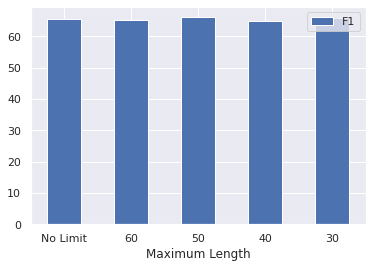

In [ ]:
import seaborn as sns
sns.set()
vals = []
for k in results:
    #results[k] = [r.item() for r in results[k]]
    vals.append(np.mean(results[k]))
df = pd.DataFrame({'Maximum Length':['No Limit', '60', '50', '40', '30'], 'F1':vals})
ax = df.plot.bar(x='Maximum Length', y='F1', rot=0)

## BERT vs RoBERTa
Here, we compare BERT and RoBERTa as encoders in  E2E-ABSA model. We use accuracy realted only to tokens from {'B', 'I', 'E', 'S'} - we called it masked accuracy 'acc_mask'.

In [ ]:
pre_trained_model_name = 'bert-base-cased'
tokenizer = transformers.BertTokenizer.from_pretrained(pre_trained_model_name)
weights = None

train_dataset = ABSADataset(laptop_train_list, tokenizer)
valid_dataset = ABSADataset(laptop_valid_list, tokenizer)
train_dataloader = DataLoader(train_dataset, collate_fn=collate, batch_size=25)
valid_dataloader = DataLoader(valid_dataset, collate_fn=collate, batch_size=16)


bert_acc = []
for i in range(10):
    encoder_model = transformers.BertModel.from_pretrained(pre_trained_model_name)
    model = SimpleModel(NParams, encoder_model, weights, calc_f1=False)
    trainer = pl.Trainer(gpus=-1, callbacks=[EarlyStopping(monitor='acc_mask', mode='max', patience=2)])
    trainer.fit(model, train_dataloader, valid_dataloader)

    bert_acc.append(trainer.callback_metrics['acc_mask'].item())

    del trainer
    del model
    gc.collect()


pre_trained_model_name = 'roberta-base'
tokenizer = transformers.RobertaTokenizer.from_pretrained(pre_trained_model_name)

collate = PadCollator(tokenizer.pad_token_id, ABSADataset.tag_to_id['[PAD]'], tokenizer)
train_dataset = ABSADataset(laptop_train_list, tokenizer, add_prefix_space=True)
valid_dataset = ABSADataset(laptop_valid_list, tokenizer, add_prefix_space=True)
train_dataloader = DataLoader(train_dataset, collate_fn=collate, batch_size=25)
valid_dataloader = DataLoader(valid_dataset, collate_fn=collate, batch_size=16)

roberta_acc = []
for i in range(10):
    encoder_model = transformers.RobertaModel.from_pretrained(pre_trained_model_name, config=config)
    model = SimpleModel(NParams, encoder_model, weights, calc_f1=False)
    trainer = pl.Trainer(gpus=-1, callbacks=[EarlyStopping(monitor='acc_mask', mode='max', patience=2)])
    trainer.fit(model, train_dataloader, valid_dataloader)

    roberta_acc.append(trainer.callback_metrics['acc_mask'])

    del trainer
    del model
    gc.collect()

Some weights of the model checkpoint at bert-base-cased were not used when initializing BertModel: ['cls.predictions.transform.dense.bias', 'cls.seq_relationship.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | N

Validation sanity check: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/data_loading.py:106: UserWarning: The dataloader, val dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  f"The dataloader, {name}, does not have many workers which may be a bottleneck."
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/data_loading.py:106: UserWarning: The dataloader, train dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  f"The dataloader, {name}, does not have many workers which may be a bottleneck."


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Some weights of the model checkpoint at bert-base-cased were not used when initializing BertModel: ['cls.predictions.transform.dense.bias', 'cls.seq_relationship.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | N

Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Some weights of the model checkpoint at bert-base-cased were not used when initializing BertModel: ['cls.predictions.transform.dense.bias', 'cls.seq_relationship.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | N

Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Some weights of the model checkpoint at bert-base-cased were not used when initializing BertModel: ['cls.predictions.transform.dense.bias', 'cls.seq_relationship.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | N

Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Some weights of the model checkpoint at bert-base-cased were not used when initializing BertModel: ['cls.predictions.transform.dense.bias', 'cls.seq_relationship.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | N

Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Some weights of the model checkpoint at bert-base-cased were not used when initializing BertModel: ['cls.predictions.transform.dense.bias', 'cls.seq_relationship.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | N

Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Some weights of the model checkpoint at bert-base-cased were not used when initializing BertModel: ['cls.predictions.transform.dense.bias', 'cls.seq_relationship.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | N

Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Some weights of the model checkpoint at bert-base-cased were not used when initializing BertModel: ['cls.predictions.transform.dense.bias', 'cls.seq_relationship.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | N

Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Some weights of the model checkpoint at bert-base-cased were not used when initializing BertModel: ['cls.predictions.transform.dense.bias', 'cls.seq_relationship.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | N

Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Some weights of the model checkpoint at bert-base-cased were not used when initializing BertModel: ['cls.predictions.transform.dense.bias', 'cls.seq_relationship.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | N

Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type             | Params
---------------------------------------------
0 | encoder | RobertaModel     | 124 M 
1 | seq     | Seque

Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

In [ ]:
print('BERT', np.mean(bert_acc))
print('RoBERTa', np.mean([r.item() for r in roberta_acc]))

BERT 0.527278733253479
RoBERTa 0.6302804231643677


# Baseline with TF-IDF

In [ ]:
class MultiTaskLossWrapper(nn.Module):
    '''
    This is impelementation of multi task loss with learnable weights from https://arxiv.org/pdf/1705.07115.pdf
    The code from https://towardsdatascience.com/multi-task-learning-with-pytorch-and-fastai-6d10dc7ce855
    remade by me to be more flexible.
    '''
    def __init__(self, losses, fixed=False):
        super().__init__()
        self.losses = losses
        self.log_vars = nn.Parameter(torch.zeros((len(losses))))
        if fixed:
            self.log_vars.requires_grad = False

    def forward(self, preds_list, target_list):
        total_loss = 0
        for i, loss in enumerate(self.losses):
            precision = torch.exp(-self.log_vars[i])
            total_loss += precision*loss(preds_list[i], target_list[i]) + self.log_vars[i]

        return total_loss

class SimpleModel(pl.LightningModule, BaseClass):
    def __init__(self, NParams, encoder, loss_weights=None, tokenizer=None, ds_for_f1=None):
        super().__init__()
        BaseClass.__init__(self)
        self.NParams = NParams
        self.encoder = encoder 
        self.tokenizer = tokenizer
        self.ds_for_f1 = ds_for_f1
        self.fine_tune(NParams.fine_tune)

        input_dim = encoder.config.hidden_size

        self.seq = nn.Sequential(
            nn.Linear(input_dim, NParams.num_classes)
        )
        self.tfidf_reg = nn.Sequential(
            nn.Linear(input_dim, input_dim),
            nn.ReLU(),
            nn.Dropout(NParams.tfidf_dropout),
            nn.Linear(input_dim, 4)
        )
        self.predictions = []

        # Despite we initialize multi task wrapper, we set it fixed for reported experiments 
        # since after some test it didn't increase performance
        self.mt_loss = MultiTaskLossWrapper([nn.CrossEntropyLoss(weight=loss_weights), 
                                             nn.MSELoss() # Loss for extra task of TF predictions
                                             ], 
                                            fixed=(not NParams.multi_task_wrapper))

    def fine_tune(self, requires_grad):
        for param in self.encoder.parameters():
            param.requires_grad = requires_grad

    def layers(self, text_tokens, attention_mask):
        input = self.encoder(text_tokens, attention_mask=attention_mask)[0]
        cls_token = input[:, 0, :]

        return self.seq(input), self.tfidf_reg(cls_token)

    def forward(self, text_tokens, attention_mask):
        return self.layers(text_tokens, attention_mask)

    def training_step(self, batch, batch_idx):
        text_tokens, attention_mask, target_sequence, _, tfidf_scores = batch
        preds, tfidf_preds = self.layers(text_tokens, attention_mask)
        preds = torch.swapaxes(preds, 1, 2)
        
        loss = self.mt_loss([preds, tfidf_preds], [target_sequence, tfidf_scores])
        
        # Logging to TensorBoard by default
        self.log('train_loss', loss, on_epoch=True, prog_bar=True, logger=True)
        # Ouput weights of multi loss wrapper
        #self.log('w1', self.mt_loss.log_vars[0], on_epoch=True, prog_bar=True, logger=True)
        #self.log('w2', self.mt_loss.log_vars[1], on_epoch=True, prog_bar=True, logger=True)
        return loss

    def validation_step(self, batch, batch_idx):
        text_tokens, attention_mask, target_sequence, target_mask, tfidf_scores = batch
        preds, tfidf_preds = self.forward(text_tokens, attention_mask)
        self.collect_for_f1(text_tokens, torch.argmax(preds, dim=2))

        acc = accuracy_logits(target_sequence, torch.argmax(preds, dim=2))
        # Accuracy only for aspect classes
        acc_mask = accuracy_logits(target_sequence[target_mask == 1], torch.argmax(preds, dim=2)[target_mask == 1])

        preds = torch.swapaxes(preds, 1, 2)
        loss = self.mt_loss([preds, tfidf_preds], [target_sequence, tfidf_scores])

        self.log('acc', acc,  on_epoch=True, prog_bar=True, logger=True)
        self.log('acc_mask', acc_mask,  on_epoch=True, prog_bar=True, logger=True)
        self.log('val_loss', loss, on_epoch=True, prog_bar=True, logger=True)
        
        return loss

    def validation_epoch_end(self, outs):
        loss = torch.stack(outs).mean()
        self.log_f1()
        self.reset_f1_data()

    def configure_optimizers(self):        
        if self.NParams.fine_tune:
            optimizer = transformers.AdamW(self.parameters(), 
                  lr = 2e-5, 
                  eps = 1e-8 
                )
            # Create the learning rate scheduler.
            scheduler = transformers.get_linear_schedule_with_warmup(optimizer, 
                                                num_warmup_steps = 0, # Default value in run_glue.py in huginface library
                                                num_training_steps = self.NParams.sh_total_steps)
        else:
            optimizer = torch.optim.Adam(self.parameters())
            scheduler = ReduceLROnPlateau(optimizer)
                
        lr_schedulers = {'scheduler': scheduler, 'monitor': 'val_loss'}
        return [optimizer] #, [lr_schedulers]

    def test_step(self, batch, batch_idx):
        text_tokens, attention_mask, _, _,_ = batch
        preds, _ = self.forward(text_tokens, attention_mask)
        preds = torch.argmax(preds, dim=2).cpu().numpy().tolist()
        self.predictions += preds
        return None

class PadCollator:
    '''
    Collator for loader which produces padded tensors
    '''

    def __init__(self, sent_pad_token_id, target_pad_id, tokenizer, with_categories=False):
        self.sent_pad_token_id = sent_pad_token_id
        self.target_pad_id = target_pad_id
        self.tokenizer = tokenizer
        self.with_categories = with_categories
    
    def __call__(self, batch):
        sentences = [torch.tensor(b[0]) for b in batch]
        target_sequence = [torch.tensor(b[1]) for b in batch]
        target_mask = [torch.tensor(b[2]) for b in batch]
        if batch[0][3] is None:
            tfidf_scores = None
        else:
            tfidf_scores = torch.stack([torch.tensor(b[3]) for b in batch])

        text_tokens = torch.nn.utils.rnn.pad_sequence(sentences, batch_first=True, padding_value=self.sent_pad_token_id)
        target_sequence = torch.nn.utils.rnn.pad_sequence(target_sequence, batch_first=True, padding_value=self.target_pad_id)
        target_mask = torch.nn.utils.rnn.pad_sequence(target_mask, batch_first=True, padding_value=self.target_pad_id)
        attention_mask = (text_tokens != self.sent_pad_token_id).float()

        if self.with_categories:
            categories = torch.stack([torch.tensor(b[3]) for b in batch]).float()
            return text_tokens, attention_mask, target_sequence, target_mask, categories

        return text_tokens, attention_mask, target_sequence, target_mask, tfidf_scores

set_seed()
pre_trained_model_name = 'roberta-base'
config = transformers.RobertaConfig.from_pretrained(pre_trained_model_name)
tokenizer = transformers.RobertaTokenizer.from_pretrained(pre_trained_model_name)
encoder_model = transformers.RobertaModel.from_pretrained(pre_trained_model_name, config=config)

collate = PadCollator(tokenizer.pad_token_id, ABSADataset.tag_to_id['[PAD]'], tokenizer)
org_ds_dict = { 'train': merged_train_list, 'valid': merged_valid_list}

train_dataset = ABSA_TFIDF(org_ds_dict['train'], tokenizer, 
                           add_prefix_space=True, 
                           shuffle_aspect=True)
valid_dataset = ABSA_TFIDF(org_ds_dict['valid'], tokenizer, add_prefix_space=True)

train_dataloader = DataLoader(train_dataset, collate_fn=collate, batch_size=25, shuffle=True)
valid_dataloader = DataLoader(valid_dataset, collate_fn=collate, batch_size=16)

classes_to_increase = [train_dataset.class_to_id[cls] for cls in [cls for cls in train_dataset.token_classes if 'conflict' in cls]]
classes_to_increase = None
weights = None 


# Training 10 times with different seed with the best hyper-parameters
for i in range(10):
    hp_set = []
    def define_model(NParams):
        set_seed(i)
        encoder_model = transformers.RobertaModel.from_pretrained(pre_trained_model_name, config=config)
        return SimpleModel(NParams, encoder_model, weights, tokenizer, org_ds_dict['valid'])

    class NParams:
        multi_task_wrapper = False
        fine_tune = True
        num_classes = len(train_dataset.token_classes)
        tfidf_dropout = 0.1 # Changing TF task dropout

        sh_total_steps = len(train_dataloader) * 10 

    hp_set.append(NParams)

    best_model, best_trainer, best_score, ave_score, metric_hist = choose_best(
                    define_model, train_dataloader, valid_dataloader,
                    None, num_runs=1, es_metric='macro_f1', eval_score='macro_f1', 
                    hp_sets=hp_set, collect_metrics=['macro_f1', 'train_loss', 'val_loss', 'acc', 'acc_mask'],
                    #trainer_args={'max_epochs': 12},
                    #trainer_args={'accumulate_grad_batches':10},
                    earstop_args={'mode':'max', 'patience': 10}
                    )


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


rm: cannot remove 'lightning_logs/': No such file or directory
====== HYPER PARAMETERS ======
fine_tune True
multi_task_wrapper False
num_classes 18
sh_total_steps 2000
tfidf_dropout 0.1
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type                 | Params
---------------------------------------------------
0 | encoder   | RobertaModel         | 124 M 
1

Validation sanity check: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/data_loading.py:106: UserWarning: The dataloader, val dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  f"The dataloader, {name}, does not have many workers which may be a bottleneck."


Aspect Sentiment Evaluation

	ALL	 TP: 1;	FP: 237;	FN: 20
		(m avg): precision: 0.42;	recall: 4.76;	f1: 0.77 (micro)
		(M avg): precision: 0.21;	recall: 2.78;	f1: 0.39 (Macro)

	positive: 	TP: 1;	FP: 119;	FN: 8;	precision: 0.83;	recall: 11.11;	f1: 1.55;	120
	negative: 	TP: 0;	FP: 10;	FN: 11;	precision: 0.00;	recall: 0.00;	f1: 0.00;	10
	neutral: 	TP: 0;	FP: 31;	FN: 0;	precision: 0.00;	recall: 0.00;	f1: 0.00;	31
	conflict: 	TP: 0;	FP: 77;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	77
Aspect Extraction Evaluation
	Aspects	 TP: 4;	FP: 233;	FN: 17
		precision: 1.69;	recall: 19.05;	f1: 3.10


/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/data_loading.py:106: UserWarning: The dataloader, train dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  f"The dataloader, {name}, does not have many workers which may be a bottleneck."


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 521;	FP: 462;	FN: 564
		(m avg): precision: 53.00;	recall: 48.02;	f1: 50.39 (micro)
		(M avg): precision: 26.73;	recall: 29.02;	f1: 27.42 (Macro)

	positive: 	TP: 385;	FP: 348;	FN: 157;	precision: 52.52;	recall: 71.03;	f1: 60.39;	733
	negative: 	TP: 136;	FP: 114;	FN: 166;	precision: 54.40;	recall: 45.03;	f1: 49.28;	250
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 736;	FP: 246;	FN: 345
		precision: 74.95;	recall: 68.09;	f1: 71.35


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 654;	FP: 457;	FN: 431
		(m avg): precision: 58.87;	recall: 60.28;	f1: 59.56 (micro)
		(M avg): precision: 40.81;	recall: 41.84;	f1: 40.11 (Macro)

	positive: 	TP: 384;	FP: 155;	FN: 158;	precision: 71.24;	recall: 70.85;	f1: 71.05;	539
	negative: 	TP: 216;	FP: 233;	FN: 86;	precision: 48.11;	recall: 71.52;	f1: 57.52;	449
	neutral: 	TP: 54;	FP: 69;	FN: 162;	precision: 43.90;	recall: 25.00;	f1: 31.86;	123
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 865;	FP: 243;	FN: 216
		precision: 78.07;	recall: 80.02;	f1: 79.03


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 631;	FP: 364;	FN: 454
		(m avg): precision: 63.42;	recall: 58.16;	f1: 60.67 (micro)
		(M avg): precision: 43.87;	recall: 40.31;	f1: 41.08 (Macro)

	positive: 	TP: 374;	FP: 143;	FN: 168;	precision: 72.34;	recall: 69.00;	f1: 70.63;	517
	negative: 	TP: 203;	FP: 161;	FN: 99;	precision: 55.77;	recall: 67.22;	f1: 60.96;	364
	neutral: 	TP: 54;	FP: 60;	FN: 162;	precision: 47.37;	recall: 25.00;	f1: 32.73;	114
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 814;	FP: 178;	FN: 267
		precision: 82.06;	recall: 75.30;	f1: 78.53


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 665;	FP: 434;	FN: 420
		(m avg): precision: 60.51;	recall: 61.29;	f1: 60.90 (micro)
		(M avg): precision: 41.77;	recall: 41.22;	f1: 40.10 (Macro)

	positive: 	TP: 416;	FP: 237;	FN: 126;	precision: 63.71;	recall: 76.75;	f1: 69.62;	653
	negative: 	TP: 206;	FP: 143;	FN: 96;	precision: 59.03;	recall: 68.21;	f1: 63.29;	349
	neutral: 	TP: 43;	FP: 54;	FN: 173;	precision: 44.33;	recall: 19.91;	f1: 27.48;	97
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 865;	FP: 229;	FN: 216
		precision: 79.07;	recall: 80.02;	f1: 79.54


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 720;	FP: 420;	FN: 365
		(m avg): precision: 63.16;	recall: 66.36;	f1: 64.72 (micro)
		(M avg): precision: 45.02;	recall: 46.76;	f1: 45.42 (Macro)

	positive: 	TP: 424;	FP: 207;	FN: 118;	precision: 67.19;	recall: 78.23;	f1: 72.29;	631
	negative: 	TP: 214;	FP: 137;	FN: 88;	precision: 60.97;	recall: 70.86;	f1: 65.54;	351
	neutral: 	TP: 82;	FP: 76;	FN: 134;	precision: 51.90;	recall: 37.96;	f1: 43.85;	158
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 902;	FP: 236;	FN: 179
		precision: 79.26;	recall: 83.44;	f1: 81.30


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 708;	FP: 473;	FN: 377
		(m avg): precision: 59.95;	recall: 65.25;	f1: 62.49 (micro)
		(M avg): precision: 42.02;	recall: 45.10;	f1: 42.68 (Macro)

	positive: 	TP: 426;	FP: 232;	FN: 116;	precision: 64.74;	recall: 78.60;	f1: 71.00;	658
	negative: 	TP: 218;	FP: 167;	FN: 84;	precision: 56.62;	recall: 72.19;	f1: 63.46;	385
	neutral: 	TP: 64;	FP: 73;	FN: 152;	precision: 46.72;	recall: 29.63;	f1: 36.26;	137
	conflict: 	TP: 0;	FP: 1;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 267;	FN: 170
		precision: 77.33;	recall: 84.27;	f1: 80.66


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 696;	FP: 450;	FN: 389
		(m avg): precision: 60.73;	recall: 64.15;	f1: 62.39 (micro)
		(M avg): precision: 48.41;	recall: 45.23;	f1: 45.29 (Macro)

	positive: 	TP: 433;	FP: 272;	FN: 109;	precision: 61.42;	recall: 79.89;	f1: 69.45;	705
	negative: 	TP: 184;	FP: 89;	FN: 118;	precision: 67.40;	recall: 60.93;	f1: 64.00;	273
	neutral: 	TP: 78;	FP: 84;	FN: 138;	precision: 48.15;	recall: 36.11;	f1: 41.27;	162
	conflict: 	TP: 1;	FP: 5;	FN: 24;	precision: 16.67;	recall: 4.00;	f1: 6.45;	6
Aspect Extraction Evaluation
	Aspects	 TP: 907;	FP: 233;	FN: 174
		precision: 79.56;	recall: 83.90;	f1: 81.67


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 714;	FP: 407;	FN: 371
		(m avg): precision: 63.69;	recall: 65.81;	f1: 64.73 (micro)
		(M avg): precision: 54.78;	recall: 50.54;	f1: 50.99 (Macro)

	positive: 	TP: 405;	FP: 169;	FN: 137;	precision: 70.56;	recall: 74.72;	f1: 72.58;	574
	negative: 	TP: 199;	FP: 122;	FN: 103;	precision: 61.99;	recall: 65.89;	f1: 63.88;	321
	neutral: 	TP: 107;	FP: 111;	FN: 109;	precision: 49.08;	recall: 49.54;	f1: 49.31;	218
	conflict: 	TP: 3;	FP: 5;	FN: 22;	precision: 37.50;	recall: 12.00;	f1: 18.18;	8
Aspect Extraction Evaluation
	Aspects	 TP: 896;	FP: 218;	FN: 185
		precision: 80.43;	recall: 82.89;	f1: 81.64


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 722;	FP: 442;	FN: 363
		(m avg): precision: 62.03;	recall: 66.54;	f1: 64.21 (micro)
		(M avg): precision: 60.68;	recall: 51.93;	f1: 52.29 (Macro)

	positive: 	TP: 411;	FP: 181;	FN: 131;	precision: 69.43;	recall: 75.83;	f1: 72.49;	592
	negative: 	TP: 199;	FP: 106;	FN: 103;	precision: 65.25;	recall: 65.89;	f1: 65.57;	305
	neutral: 	TP: 108;	FP: 153;	FN: 108;	precision: 41.38;	recall: 50.00;	f1: 45.28;	261
	conflict: 	TP: 4;	FP: 2;	FN: 21;	precision: 66.67;	recall: 16.00;	f1: 25.81;	6
Aspect Extraction Evaluation
	Aspects	 TP: 918;	FP: 243;	FN: 163
		precision: 79.07;	recall: 84.92;	f1: 81.89


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 733;	FP: 375;	FN: 352
		(m avg): precision: 66.16;	recall: 67.56;	f1: 66.85 (micro)
		(M avg): precision: 60.29;	recall: 53.41;	f1: 54.59 (Macro)

	positive: 	TP: 408;	FP: 162;	FN: 134;	precision: 71.58;	recall: 75.28;	f1: 73.38;	570
	negative: 	TP: 199;	FP: 87;	FN: 103;	precision: 69.58;	recall: 65.89;	f1: 67.69;	286
	neutral: 	TP: 122;	FP: 122;	FN: 94;	precision: 50.00;	recall: 56.48;	f1: 53.04;	244
	conflict: 	TP: 4;	FP: 4;	FN: 21;	precision: 50.00;	recall: 16.00;	f1: 24.24;	8
Aspect Extraction Evaluation
	Aspects	 TP: 903;	FP: 202;	FN: 178
		precision: 81.72;	recall: 83.53;	f1: 82.62


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 747;	FP: 401;	FN: 338
		(m avg): precision: 65.07;	recall: 68.85;	f1: 66.91 (micro)
		(M avg): precision: 57.46;	recall: 58.84;	f1: 58.00 (Macro)

	positive: 	TP: 422;	FP: 187;	FN: 120;	precision: 69.29;	recall: 77.86;	f1: 73.33;	609
	negative: 	TP: 215;	FP: 111;	FN: 87;	precision: 65.95;	recall: 71.19;	f1: 68.47;	326
	neutral: 	TP: 100;	FP: 89;	FN: 116;	precision: 52.91;	recall: 46.30;	f1: 49.38;	189
	conflict: 	TP: 10;	FP: 14;	FN: 15;	precision: 41.67;	recall: 40.00;	f1: 40.82;	24
Aspect Extraction Evaluation
	Aspects	 TP: 920;	FP: 222;	FN: 161
		precision: 80.56;	recall: 85.11;	f1: 82.77


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 725;	FP: 386;	FN: 360
		(m avg): precision: 65.26;	recall: 66.82;	f1: 66.03 (micro)
		(M avg): precision: 55.14;	recall: 50.92;	f1: 51.02 (Macro)

	positive: 	TP: 406;	FP: 154;	FN: 136;	precision: 72.50;	recall: 74.91;	f1: 73.68;	560
	negative: 	TP: 197;	FP: 100;	FN: 105;	precision: 66.33;	recall: 65.23;	f1: 65.78;	297
	neutral: 	TP: 120;	FP: 128;	FN: 96;	precision: 48.39;	recall: 55.56;	f1: 51.72;	248
	conflict: 	TP: 2;	FP: 4;	FN: 23;	precision: 33.33;	recall: 8.00;	f1: 12.90;	6
Aspect Extraction Evaluation
	Aspects	 TP: 908;	FP: 198;	FN: 173
		precision: 82.10;	recall: 84.00;	f1: 83.04


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 731;	FP: 428;	FN: 354
		(m avg): precision: 63.07;	recall: 67.37;	f1: 65.15 (micro)
		(M avg): precision: 54.15;	recall: 53.88;	f1: 53.61 (Macro)

	positive: 	TP: 431;	FP: 208;	FN: 111;	precision: 67.45;	recall: 79.52;	f1: 72.99;	639
	negative: 	TP: 183;	FP: 83;	FN: 119;	precision: 68.80;	recall: 60.60;	f1: 64.44;	266
	neutral: 	TP: 111;	FP: 125;	FN: 105;	precision: 47.03;	recall: 51.39;	f1: 49.12;	236
	conflict: 	TP: 6;	FP: 12;	FN: 19;	precision: 33.33;	recall: 24.00;	f1: 27.91;	18
Aspect Extraction Evaluation
	Aspects	 TP: 928;	FP: 226;	FN: 153
		precision: 80.42;	recall: 85.85;	f1: 83.04


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 716;	FP: 403;	FN: 369
		(m avg): precision: 63.99;	recall: 65.99;	f1: 64.97 (micro)
		(M avg): precision: 56.24;	recall: 50.31;	f1: 51.75 (Macro)

	positive: 	TP: 431;	FP: 214;	FN: 111;	precision: 66.82;	recall: 79.52;	f1: 72.62;	645
	negative: 	TP: 185;	FP: 77;	FN: 117;	precision: 70.61;	recall: 61.26;	f1: 65.60;	262
	neutral: 	TP: 96;	FP: 106;	FN: 120;	precision: 47.52;	recall: 44.44;	f1: 45.93;	202
	conflict: 	TP: 4;	FP: 6;	FN: 21;	precision: 40.00;	recall: 16.00;	f1: 22.86;	10
Aspect Extraction Evaluation
	Aspects	 TP: 913;	FP: 202;	FN: 168
		precision: 81.88;	recall: 84.46;	f1: 83.15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 728;	FP: 384;	FN: 357
		(m avg): precision: 65.47;	recall: 67.10;	f1: 66.27 (micro)
		(M avg): precision: 53.91;	recall: 51.76;	f1: 52.03 (Macro)

	positive: 	TP: 414;	FP: 157;	FN: 128;	precision: 72.50;	recall: 76.38;	f1: 74.39;	571
	negative: 	TP: 192;	FP: 95;	FN: 110;	precision: 66.90;	recall: 63.58;	f1: 65.20;	287
	neutral: 	TP: 119;	FP: 124;	FN: 97;	precision: 48.97;	recall: 55.09;	f1: 51.85;	243
	conflict: 	TP: 3;	FP: 8;	FN: 22;	precision: 27.27;	recall: 12.00;	f1: 16.67;	11
Aspect Extraction Evaluation
	Aspects	 TP: 904;	FP: 203;	FN: 177
		precision: 81.66;	recall: 83.63;	f1: 82.63


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 745;	FP: 407;	FN: 340
		(m avg): precision: 64.67;	recall: 68.66;	f1: 66.61 (micro)
		(M avg): precision: 54.51;	recall: 56.61;	f1: 55.30 (Macro)

	positive: 	TP: 396;	FP: 145;	FN: 146;	precision: 73.20;	recall: 73.06;	f1: 73.13;	541
	negative: 	TP: 223;	FP: 125;	FN: 79;	precision: 64.08;	recall: 73.84;	f1: 68.62;	348
	neutral: 	TP: 120;	FP: 124;	FN: 96;	precision: 49.18;	recall: 55.56;	f1: 52.17;	244
	conflict: 	TP: 6;	FP: 13;	FN: 19;	precision: 31.58;	recall: 24.00;	f1: 27.27;	19
Aspect Extraction Evaluation
	Aspects	 TP: 929;	FP: 219;	FN: 152
		precision: 80.92;	recall: 85.94;	f1: 83.36


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 701;	FP: 383;	FN: 384
		(m avg): precision: 64.67;	recall: 64.61;	f1: 64.64 (micro)
		(M avg): precision: 59.13;	recall: 48.93;	f1: 50.99 (Macro)

	positive: 	TP: 414;	FP: 195;	FN: 128;	precision: 67.98;	recall: 76.38;	f1: 71.94;	609
	negative: 	TP: 183;	FP: 85;	FN: 119;	precision: 68.28;	recall: 60.60;	f1: 64.21;	268
	neutral: 	TP: 101;	FP: 100;	FN: 115;	precision: 50.25;	recall: 46.76;	f1: 48.44;	201
	conflict: 	TP: 3;	FP: 3;	FN: 22;	precision: 50.00;	recall: 12.00;	f1: 19.35;	6
Aspect Extraction Evaluation
	Aspects	 TP: 881;	FP: 194;	FN: 200
		precision: 81.95;	recall: 81.50;	f1: 81.73


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 732;	FP: 427;	FN: 353
		(m avg): precision: 63.16;	recall: 67.47;	f1: 65.24 (micro)
		(M avg): precision: 53.54;	recall: 55.33;	f1: 54.32 (Macro)

	positive: 	TP: 414;	FP: 177;	FN: 128;	precision: 70.05;	recall: 76.38;	f1: 73.08;	591
	negative: 	TP: 205;	FP: 111;	FN: 97;	precision: 64.87;	recall: 67.88;	f1: 66.34;	316
	neutral: 	TP: 106;	FP: 125;	FN: 110;	precision: 45.89;	recall: 49.07;	f1: 47.43;	231
	conflict: 	TP: 7;	FP: 14;	FN: 18;	precision: 33.33;	recall: 28.00;	f1: 30.43;	21
Aspect Extraction Evaluation
	Aspects	 TP: 920;	FP: 233;	FN: 161
		precision: 79.79;	recall: 85.11;	f1: 82.36


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 738;	FP: 398;	FN: 347
		(m avg): precision: 64.96;	recall: 68.02;	f1: 66.46 (micro)
		(M avg): precision: 54.76;	recall: 55.62;	f1: 55.04 (Macro)

	positive: 	TP: 417;	FP: 174;	FN: 125;	precision: 70.56;	recall: 76.94;	f1: 73.61;	591
	negative: 	TP: 211;	FP: 124;	FN: 91;	precision: 62.99;	recall: 69.87;	f1: 66.25;	335
	neutral: 	TP: 103;	FP: 84;	FN: 113;	precision: 55.08;	recall: 47.69;	f1: 51.12;	187
	conflict: 	TP: 7;	FP: 16;	FN: 18;	precision: 30.43;	recall: 28.00;	f1: 29.17;	23
Aspect Extraction Evaluation
	Aspects	 TP: 918;	FP: 213;	FN: 163
		precision: 81.17;	recall: 84.92;	f1: 83.00


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 725;	FP: 377;	FN: 360
		(m avg): precision: 65.79;	recall: 66.82;	f1: 66.30 (micro)
		(M avg): precision: 56.26;	recall: 55.89;	f1: 55.87 (Macro)

	positive: 	TP: 401;	FP: 136;	FN: 141;	precision: 74.67;	recall: 73.99;	f1: 74.33;	537
	negative: 	TP: 191;	FP: 97;	FN: 111;	precision: 66.32;	recall: 63.25;	f1: 64.75;	288
	neutral: 	TP: 126;	FP: 131;	FN: 90;	precision: 49.03;	recall: 58.33;	f1: 53.28;	257
	conflict: 	TP: 7;	FP: 13;	FN: 18;	precision: 35.00;	recall: 28.00;	f1: 31.11;	20
Aspect Extraction Evaluation
	Aspects	 TP: 908;	FP: 188;	FN: 173
		precision: 82.85;	recall: 84.00;	f1: 83.42


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 748;	FP: 409;	FN: 337
		(m avg): precision: 64.65;	recall: 68.94;	f1: 66.73 (micro)
		(M avg): precision: 55.54;	recall: 58.59;	f1: 56.47 (Macro)

	positive: 	TP: 399;	FP: 126;	FN: 143;	precision: 76.00;	recall: 73.62;	f1: 74.79;	525
	negative: 	TP: 194;	FP: 98;	FN: 108;	precision: 66.44;	recall: 64.24;	f1: 65.32;	292
	neutral: 	TP: 148;	FP: 171;	FN: 68;	precision: 46.39;	recall: 68.52;	f1: 55.33;	319
	conflict: 	TP: 7;	FP: 14;	FN: 18;	precision: 33.33;	recall: 28.00;	f1: 30.43;	21
Aspect Extraction Evaluation
	Aspects	 TP: 926;	FP: 226;	FN: 155
		precision: 80.38;	recall: 85.66;	f1: 82.94
====== HYPER PARAMETERS ======
fine_tune True
multi_task_wrapper False
num_classes 18
sh_total_steps 2000
tfidf_dropout 0.1
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type                 | Params
---------------------------------------------------
0 | encoder   | RobertaModel         | 124 M 
1

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 1;	FP: 381;	FN: 20
		(m avg): precision: 0.26;	recall: 4.76;	f1: 0.50 (micro)
		(M avg): precision: 0.08;	recall: 2.27;	f1: 0.16 (Macro)

	positive: 	TP: 0;	FP: 6;	FN: 9;	precision: 0.00;	recall: 0.00;	f1: 0.00;	6
	negative: 	TP: 1;	FP: 298;	FN: 10;	precision: 0.33;	recall: 9.09;	f1: 0.65;	299
	neutral: 	TP: 0;	FP: 0;	FN: 0;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 77;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	77
Aspect Extraction Evaluation
	Aspects	 TP: 4;	FP: 356;	FN: 17
		precision: 1.11;	recall: 19.05;	f1: 2.10


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 323;	FP: 542;	FN: 762
		(m avg): precision: 37.34;	recall: 29.77;	f1: 33.13 (micro)
		(M avg): precision: 18.07;	recall: 15.49;	f1: 13.58 (Macro)

	positive: 	TP: 307;	FP: 512;	FN: 235;	precision: 37.48;	recall: 56.64;	f1: 45.11;	819
	negative: 	TP: 16;	FP: 30;	FN: 286;	precision: 34.78;	recall: 5.30;	f1: 9.20;	46
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 537;	FP: 327;	FN: 544
		precision: 62.15;	recall: 49.68;	f1: 55.22


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 624;	FP: 479;	FN: 461
		(m avg): precision: 56.57;	recall: 57.51;	f1: 57.04 (micro)
		(M avg): precision: 37.55;	recall: 36.27;	f1: 33.12 (Macro)

	positive: 	TP: 426;	FP: 334;	FN: 116;	precision: 56.05;	recall: 78.60;	f1: 65.44;	760
	negative: 	TP: 191;	FP: 132;	FN: 111;	precision: 59.13;	recall: 63.25;	f1: 61.12;	323
	neutral: 	TP: 7;	FP: 13;	FN: 209;	precision: 35.00;	recall: 3.24;	f1: 5.93;	20
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 856;	FP: 245;	FN: 225
		precision: 77.75;	recall: 79.19;	f1: 78.46


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 652;	FP: 407;	FN: 433
		(m avg): precision: 61.57;	recall: 60.09;	f1: 60.82 (micro)
		(M avg): precision: 43.07;	recall: 40.00;	f1: 39.74 (Macro)

	positive: 	TP: 419;	FP: 224;	FN: 123;	precision: 65.16;	recall: 77.31;	f1: 70.72;	643
	negative: 	TP: 191;	FP: 140;	FN: 111;	precision: 57.70;	recall: 63.25;	f1: 60.35;	331
	neutral: 	TP: 42;	FP: 43;	FN: 174;	precision: 49.41;	recall: 19.44;	f1: 27.91;	85
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 844;	FP: 212;	FN: 237
		precision: 79.92;	recall: 78.08;	f1: 78.99


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 712;	FP: 466;	FN: 373
		(m avg): precision: 60.44;	recall: 65.62;	f1: 62.93 (micro)
		(M avg): precision: 42.48;	recall: 44.73;	f1: 42.18 (Macro)

	positive: 	TP: 437;	FP: 234;	FN: 105;	precision: 65.13;	recall: 80.63;	f1: 72.05;	671
	negative: 	TP: 220;	FP: 175;	FN: 82;	precision: 55.70;	recall: 72.85;	f1: 63.13;	395
	neutral: 	TP: 55;	FP: 57;	FN: 161;	precision: 49.11;	recall: 25.46;	f1: 33.54;	112
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 265;	FN: 170
		precision: 77.47;	recall: 84.27;	f1: 80.73


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 717;	FP: 415;	FN: 368
		(m avg): precision: 63.34;	recall: 66.08;	f1: 64.68 (micro)
		(M avg): precision: 44.71;	recall: 46.10;	f1: 45.13 (Macro)

	positive: 	TP: 437;	FP: 210;	FN: 105;	precision: 67.54;	recall: 80.63;	f1: 73.51;	647
	negative: 	TP: 196;	FP: 115;	FN: 106;	precision: 63.02;	recall: 64.90;	f1: 63.95;	311
	neutral: 	TP: 84;	FP: 90;	FN: 132;	precision: 48.28;	recall: 38.89;	f1: 43.08;	174
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 218;	FN: 170
		precision: 80.69;	recall: 84.27;	f1: 82.44


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 712;	FP: 397;	FN: 373
		(m avg): precision: 64.20;	recall: 65.62;	f1: 64.90 (micro)
		(M avg): precision: 45.05;	recall: 47.43;	f1: 46.17 (Macro)

	positive: 	TP: 404;	FP: 140;	FN: 138;	precision: 74.26;	recall: 74.54;	f1: 74.40;	544
	negative: 	TP: 208;	FP: 137;	FN: 94;	precision: 60.29;	recall: 68.87;	f1: 64.30;	345
	neutral: 	TP: 100;	FP: 119;	FN: 116;	precision: 45.66;	recall: 46.30;	f1: 45.98;	219
	conflict: 	TP: 0;	FP: 1;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
Aspect Extraction Evaluation
	Aspects	 TP: 901;	FP: 204;	FN: 180
		precision: 81.54;	recall: 83.35;	f1: 82.43


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 736;	FP: 463;	FN: 349
		(m avg): precision: 61.38;	recall: 67.83;	f1: 64.45 (micro)
		(M avg): precision: 43.69;	recall: 48.58;	f1: 45.92 (Macro)

	positive: 	TP: 425;	FP: 212;	FN: 117;	precision: 66.72;	recall: 78.41;	f1: 72.09;	637
	negative: 	TP: 213;	FP: 138;	FN: 89;	precision: 60.68;	recall: 70.53;	f1: 65.24;	351
	neutral: 	TP: 98;	FP: 109;	FN: 118;	precision: 47.34;	recall: 45.37;	f1: 46.34;	207
	conflict: 	TP: 0;	FP: 4;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	4
Aspect Extraction Evaluation
	Aspects	 TP: 924;	FP: 272;	FN: 157
		precision: 77.26;	recall: 85.48;	f1: 81.16


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 723;	FP: 393;	FN: 362
		(m avg): precision: 64.78;	recall: 66.64;	f1: 65.70 (micro)
		(M avg): precision: 54.94;	recall: 52.35;	f1: 52.81 (Macro)

	positive: 	TP: 408;	FP: 162;	FN: 134;	precision: 71.58;	recall: 75.28;	f1: 73.38;	570
	negative: 	TP: 196;	FP: 91;	FN: 106;	precision: 68.29;	recall: 64.90;	f1: 66.55;	287
	neutral: 	TP: 115;	FP: 132;	FN: 101;	precision: 46.56;	recall: 53.24;	f1: 49.68;	247
	conflict: 	TP: 4;	FP: 8;	FN: 21;	precision: 33.33;	recall: 16.00;	f1: 21.62;	12
Aspect Extraction Evaluation
	Aspects	 TP: 907;	FP: 207;	FN: 174
		precision: 81.42;	recall: 83.90;	f1: 82.64


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 748;	FP: 445;	FN: 337
		(m avg): precision: 62.70;	recall: 68.94;	f1: 65.67 (micro)
		(M avg): precision: 69.69;	recall: 52.34;	f1: 51.04 (Macro)

	positive: 	TP: 421;	FP: 184;	FN: 121;	precision: 69.59;	recall: 77.68;	f1: 73.41;	605
	negative: 	TP: 203;	FP: 125;	FN: 99;	precision: 61.89;	recall: 67.22;	f1: 64.44;	328
	neutral: 	TP: 122;	FP: 136;	FN: 94;	precision: 47.29;	recall: 56.48;	f1: 51.48;	258
	conflict: 	TP: 2;	FP: 0;	FN: 23;	precision: 100.00;	recall: 8.00;	f1: 14.81;	2
Aspect Extraction Evaluation
	Aspects	 TP: 935;	FP: 254;	FN: 146
		precision: 78.64;	recall: 86.49;	f1: 82.38


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 721;	FP: 445;	FN: 364
		(m avg): precision: 61.84;	recall: 66.45;	f1: 64.06 (micro)
		(M avg): precision: 55.19;	recall: 51.24;	f1: 50.88 (Macro)

	positive: 	TP: 408;	FP: 196;	FN: 134;	precision: 67.55;	recall: 75.28;	f1: 71.20;	604
	negative: 	TP: 196;	FP: 98;	FN: 106;	precision: 66.67;	recall: 64.90;	f1: 65.77;	294
	neutral: 	TP: 114;	FP: 147;	FN: 102;	precision: 43.68;	recall: 52.78;	f1: 47.80;	261
	conflict: 	TP: 3;	FP: 4;	FN: 22;	precision: 42.86;	recall: 12.00;	f1: 18.75;	7
Aspect Extraction Evaluation
	Aspects	 TP: 922;	FP: 239;	FN: 159
		precision: 79.41;	recall: 85.29;	f1: 82.25


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 734;	FP: 406;	FN: 351
		(m avg): precision: 64.39;	recall: 67.65;	f1: 65.98 (micro)
		(M avg): precision: 56.09;	recall: 55.29;	f1: 55.38 (Macro)

	positive: 	TP: 434;	FP: 190;	FN: 108;	precision: 69.55;	recall: 80.07;	f1: 74.44;	624
	negative: 	TP: 198;	FP: 117;	FN: 104;	precision: 62.86;	recall: 65.56;	f1: 64.18;	315
	neutral: 	TP: 94;	FP: 87;	FN: 122;	precision: 51.93;	recall: 43.52;	f1: 47.36;	181
	conflict: 	TP: 8;	FP: 12;	FN: 17;	precision: 40.00;	recall: 32.00;	f1: 35.56;	20
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 226;	FN: 170
		precision: 80.12;	recall: 84.27;	f1: 82.15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 722;	FP: 415;	FN: 363
		(m avg): precision: 63.50;	recall: 66.54;	f1: 64.99 (micro)
		(M avg): precision: 61.09;	recall: 56.98;	f1: 56.92 (Macro)

	positive: 	TP: 378;	FP: 113;	FN: 164;	precision: 76.99;	recall: 69.74;	f1: 73.18;	491
	negative: 	TP: 196;	FP: 90;	FN: 106;	precision: 68.53;	recall: 64.90;	f1: 66.67;	286
	neutral: 	TP: 141;	FP: 207;	FN: 75;	precision: 40.52;	recall: 65.28;	f1: 50.00;	348
	conflict: 	TP: 7;	FP: 5;	FN: 18;	precision: 58.33;	recall: 28.00;	f1: 37.84;	12
Aspect Extraction Evaluation
	Aspects	 TP: 926;	FP: 204;	FN: 155
		precision: 81.95;	recall: 85.66;	f1: 83.76


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 739;	FP: 412;	FN: 346
		(m avg): precision: 64.21;	recall: 68.11;	f1: 66.10 (micro)
		(M avg): precision: 54.38;	recall: 54.23;	f1: 53.82 (Macro)

	positive: 	TP: 424;	FP: 163;	FN: 118;	precision: 72.23;	recall: 78.23;	f1: 75.11;	587
	negative: 	TP: 215;	FP: 145;	FN: 87;	precision: 59.72;	recall: 71.19;	f1: 64.95;	360
	neutral: 	TP: 94;	FP: 93;	FN: 122;	precision: 50.27;	recall: 43.52;	f1: 46.65;	187
	conflict: 	TP: 6;	FP: 11;	FN: 19;	precision: 35.29;	recall: 24.00;	f1: 28.57;	17
Aspect Extraction Evaluation
	Aspects	 TP: 919;	FP: 228;	FN: 162
		precision: 80.12;	recall: 85.01;	f1: 82.50


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 730;	FP: 426;	FN: 355
		(m avg): precision: 63.15;	recall: 67.28;	f1: 65.15 (micro)
		(M avg): precision: 56.00;	recall: 51.44;	f1: 51.86 (Macro)

	positive: 	TP: 428;	FP: 203;	FN: 114;	precision: 67.83;	recall: 78.97;	f1: 72.98;	631
	negative: 	TP: 206;	FP: 122;	FN: 96;	precision: 62.80;	recall: 68.21;	f1: 65.40;	328
	neutral: 	TP: 92;	FP: 96;	FN: 124;	precision: 48.94;	recall: 42.59;	f1: 45.54;	188
	conflict: 	TP: 4;	FP: 5;	FN: 21;	precision: 44.44;	recall: 16.00;	f1: 23.53;	9
Aspect Extraction Evaluation
	Aspects	 TP: 930;	FP: 223;	FN: 151
		precision: 80.66;	recall: 86.03;	f1: 83.26


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 730;	FP: 424;	FN: 355
		(m avg): precision: 63.26;	recall: 67.28;	f1: 65.21 (micro)
		(M avg): precision: 51.79;	recall: 50.88;	f1: 50.16 (Macro)

	positive: 	TP: 415;	FP: 188;	FN: 127;	precision: 68.82;	recall: 76.57;	f1: 72.49;	603
	negative: 	TP: 197;	FP: 109;	FN: 105;	precision: 64.38;	recall: 65.23;	f1: 64.80;	306
	neutral: 	TP: 116;	FP: 121;	FN: 100;	precision: 48.95;	recall: 53.70;	f1: 51.21;	237
	conflict: 	TP: 2;	FP: 6;	FN: 23;	precision: 25.00;	recall: 8.00;	f1: 12.12;	8
Aspect Extraction Evaluation
	Aspects	 TP: 921;	FP: 228;	FN: 160
		precision: 80.16;	recall: 85.20;	f1: 82.60


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 735;	FP: 407;	FN: 350
		(m avg): precision: 64.36;	recall: 67.74;	f1: 66.01 (micro)
		(M avg): precision: 54.35;	recall: 54.55;	f1: 54.21 (Macro)

	positive: 	TP: 419;	FP: 164;	FN: 123;	precision: 71.87;	recall: 77.31;	f1: 74.49;	583
	negative: 	TP: 202;	FP: 124;	FN: 100;	precision: 61.96;	recall: 66.89;	f1: 64.33;	326
	neutral: 	TP: 108;	FP: 107;	FN: 108;	precision: 50.23;	recall: 50.00;	f1: 50.12;	215
	conflict: 	TP: 6;	FP: 12;	FN: 19;	precision: 33.33;	recall: 24.00;	f1: 27.91;	18
Aspect Extraction Evaluation
	Aspects	 TP: 925;	FP: 214;	FN: 156
		precision: 81.21;	recall: 85.57;	f1: 83.33


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 746;	FP: 437;	FN: 339
		(m avg): precision: 63.06;	recall: 68.76;	f1: 65.78 (micro)
		(M avg): precision: 53.11;	recall: 55.80;	f1: 54.21 (Macro)

	positive: 	TP: 417;	FP: 169;	FN: 125;	precision: 71.16;	recall: 76.94;	f1: 73.94;	586
	negative: 	TP: 207;	FP: 136;	FN: 95;	precision: 60.35;	recall: 68.54;	f1: 64.19;	343
	neutral: 	TP: 116;	FP: 119;	FN: 100;	precision: 49.36;	recall: 53.70;	f1: 51.44;	235
	conflict: 	TP: 6;	FP: 13;	FN: 19;	precision: 31.58;	recall: 24.00;	f1: 27.27;	19
Aspect Extraction Evaluation
	Aspects	 TP: 936;	FP: 243;	FN: 145
		precision: 79.39;	recall: 86.59;	f1: 82.83


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 728;	FP: 425;	FN: 357
		(m avg): precision: 63.14;	recall: 67.10;	f1: 65.06 (micro)
		(M avg): precision: 58.85;	recall: 53.35;	f1: 54.47 (Macro)

	positive: 	TP: 434;	FP: 208;	FN: 108;	precision: 67.60;	recall: 80.07;	f1: 73.31;	642
	negative: 	TP: 182;	FP: 108;	FN: 120;	precision: 62.76;	recall: 60.26;	f1: 61.49;	290
	neutral: 	TP: 106;	FP: 104;	FN: 110;	precision: 50.48;	recall: 49.07;	f1: 49.77;	210
	conflict: 	TP: 6;	FP: 5;	FN: 19;	precision: 54.55;	recall: 24.00;	f1: 33.33;	11
Aspect Extraction Evaluation
	Aspects	 TP: 919;	FP: 232;	FN: 162
		precision: 79.84;	recall: 85.01;	f1: 82.35


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 737;	FP: 389;	FN: 348
		(m avg): precision: 65.45;	recall: 67.93;	f1: 66.67 (micro)
		(M avg): precision: 56.96;	recall: 56.55;	f1: 56.59 (Macro)

	positive: 	TP: 419;	FP: 170;	FN: 123;	precision: 71.14;	recall: 77.31;	f1: 74.09;	589
	negative: 	TP: 202;	FP: 122;	FN: 100;	precision: 62.35;	recall: 66.89;	f1: 64.54;	324
	neutral: 	TP: 108;	FP: 84;	FN: 108;	precision: 56.25;	recall: 50.00;	f1: 52.94;	192
	conflict: 	TP: 8;	FP: 13;	FN: 17;	precision: 38.10;	recall: 32.00;	f1: 34.78;	21
Aspect Extraction Evaluation
	Aspects	 TP: 907;	FP: 215;	FN: 174
		precision: 80.84;	recall: 83.90;	f1: 82.34


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 733;	FP: 387;	FN: 352
		(m avg): precision: 65.45;	recall: 67.56;	f1: 66.49 (micro)
		(M avg): precision: 59.42;	recall: 56.41;	f1: 57.29 (Macro)

	positive: 	TP: 411;	FP: 154;	FN: 131;	precision: 72.74;	recall: 75.83;	f1: 74.25;	565
	negative: 	TP: 209;	FP: 138;	FN: 93;	precision: 60.23;	recall: 69.21;	f1: 64.41;	347
	neutral: 	TP: 105;	FP: 87;	FN: 111;	precision: 54.69;	recall: 48.61;	f1: 51.47;	192
	conflict: 	TP: 8;	FP: 8;	FN: 17;	precision: 50.00;	recall: 32.00;	f1: 39.02;	16
Aspect Extraction Evaluation
	Aspects	 TP: 917;	FP: 199;	FN: 164
		precision: 82.17;	recall: 84.83;	f1: 83.48


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 761;	FP: 388;	FN: 324
		(m avg): precision: 66.23;	recall: 70.14;	f1: 68.13 (micro)
		(M avg): precision: 59.41;	recall: 56.27;	f1: 56.87 (Macro)

	positive: 	TP: 437;	FP: 179;	FN: 105;	precision: 70.94;	recall: 80.63;	f1: 75.47;	616
	negative: 	TP: 203;	FP: 112;	FN: 99;	precision: 64.44;	recall: 67.22;	f1: 65.80;	315
	neutral: 	TP: 115;	FP: 90;	FN: 101;	precision: 56.10;	recall: 53.24;	f1: 54.63;	205
	conflict: 	TP: 6;	FP: 7;	FN: 19;	precision: 46.15;	recall: 24.00;	f1: 31.58;	13
Aspect Extraction Evaluation
	Aspects	 TP: 934;	FP: 213;	FN: 147
		precision: 81.43;	recall: 86.40;	f1: 83.84


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 743;	FP: 392;	FN: 342
		(m avg): precision: 65.46;	recall: 68.48;	f1: 66.94 (micro)
		(M avg): precision: 55.81;	recall: 53.95;	f1: 54.27 (Macro)

	positive: 	TP: 432;	FP: 170;	FN: 110;	precision: 71.76;	recall: 79.70;	f1: 75.52;	602
	negative: 	TP: 194;	FP: 101;	FN: 108;	precision: 65.76;	recall: 64.24;	f1: 64.99;	295
	neutral: 	TP: 112;	FP: 112;	FN: 104;	precision: 50.00;	recall: 51.85;	f1: 50.91;	224
	conflict: 	TP: 5;	FP: 9;	FN: 20;	precision: 35.71;	recall: 20.00;	f1: 25.64;	14
Aspect Extraction Evaluation
	Aspects	 TP: 918;	FP: 214;	FN: 163
		precision: 81.10;	recall: 84.92;	f1: 82.96


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 736;	FP: 362;	FN: 349
		(m avg): precision: 67.03;	recall: 67.83;	f1: 67.43 (micro)
		(M avg): precision: 55.84;	recall: 52.70;	f1: 53.54 (Macro)

	positive: 	TP: 427;	FP: 165;	FN: 115;	precision: 72.13;	recall: 78.78;	f1: 75.31;	592
	negative: 	TP: 218;	FP: 122;	FN: 84;	precision: 64.12;	recall: 72.19;	f1: 67.91;	340
	neutral: 	TP: 86;	FP: 63;	FN: 130;	precision: 57.72;	recall: 39.81;	f1: 47.12;	149
	conflict: 	TP: 5;	FP: 12;	FN: 20;	precision: 29.41;	recall: 20.00;	f1: 23.81;	17
Aspect Extraction Evaluation
	Aspects	 TP: 916;	FP: 180;	FN: 165
		precision: 83.58;	recall: 84.74;	f1: 84.15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 732;	FP: 381;	FN: 353
		(m avg): precision: 65.77;	recall: 67.47;	f1: 66.61 (micro)
		(M avg): precision: 58.00;	recall: 52.25;	f1: 53.41 (Macro)

	positive: 	TP: 424;	FP: 164;	FN: 118;	precision: 72.11;	recall: 78.23;	f1: 75.04;	588
	negative: 	TP: 197;	FP: 112;	FN: 105;	precision: 63.75;	recall: 65.23;	f1: 64.48;	309
	neutral: 	TP: 107;	FP: 100;	FN: 109;	precision: 51.69;	recall: 49.54;	f1: 50.59;	207
	conflict: 	TP: 4;	FP: 5;	FN: 21;	precision: 44.44;	recall: 16.00;	f1: 23.53;	9
Aspect Extraction Evaluation
	Aspects	 TP: 905;	FP: 206;	FN: 176
		precision: 81.46;	recall: 83.72;	f1: 82.57


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 720;	FP: 387;	FN: 365
		(m avg): precision: 65.04;	recall: 66.36;	f1: 65.69 (micro)
		(M avg): precision: 56.76;	recall: 53.68;	f1: 54.29 (Macro)

	positive: 	TP: 401;	FP: 154;	FN: 141;	precision: 72.25;	recall: 73.99;	f1: 73.11;	555
	negative: 	TP: 187;	FP: 85;	FN: 115;	precision: 68.75;	recall: 61.92;	f1: 65.16;	272
	neutral: 	TP: 127;	FP: 140;	FN: 89;	precision: 47.57;	recall: 58.80;	f1: 52.59;	267
	conflict: 	TP: 5;	FP: 8;	FN: 20;	precision: 38.46;	recall: 20.00;	f1: 26.32;	13
Aspect Extraction Evaluation
	Aspects	 TP: 905;	FP: 198;	FN: 176
		precision: 82.05;	recall: 83.72;	f1: 82.88


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 749;	FP: 425;	FN: 336
		(m avg): precision: 63.80;	recall: 69.03;	f1: 66.31 (micro)
		(M avg): precision: 56.84;	recall: 55.60;	f1: 55.43 (Macro)

	positive: 	TP: 431;	FP: 200;	FN: 111;	precision: 68.30;	recall: 79.52;	f1: 73.49;	631
	negative: 	TP: 194;	FP: 105;	FN: 108;	precision: 64.88;	recall: 64.24;	f1: 64.56;	299
	neutral: 	TP: 118;	FP: 112;	FN: 98;	precision: 51.30;	recall: 54.63;	f1: 52.91;	230
	conflict: 	TP: 6;	FP: 8;	FN: 19;	precision: 42.86;	recall: 24.00;	f1: 30.77;	14
Aspect Extraction Evaluation
	Aspects	 TP: 930;	FP: 240;	FN: 151
		precision: 79.49;	recall: 86.03;	f1: 82.63


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 720;	FP: 352;	FN: 365
		(m avg): precision: 67.16;	recall: 66.36;	f1: 66.76 (micro)
		(M avg): precision: 60.24;	recall: 53.08;	f1: 55.03 (Macro)

	positive: 	TP: 401;	FP: 126;	FN: 141;	precision: 76.09;	recall: 73.99;	f1: 75.02;	527
	negative: 	TP: 205;	FP: 118;	FN: 97;	precision: 63.47;	recall: 67.88;	f1: 65.60;	323
	neutral: 	TP: 109;	FP: 103;	FN: 107;	precision: 51.42;	recall: 50.46;	f1: 50.93;	212
	conflict: 	TP: 5;	FP: 5;	FN: 20;	precision: 50.00;	recall: 20.00;	f1: 28.57;	10
Aspect Extraction Evaluation
	Aspects	 TP: 890;	FP: 177;	FN: 191
		precision: 83.41;	recall: 82.33;	f1: 82.87


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 751;	FP: 389;	FN: 334
		(m avg): precision: 65.88;	recall: 69.22;	f1: 67.51 (micro)
		(M avg): precision: 57.72;	recall: 58.06;	f1: 57.65 (Macro)

	positive: 	TP: 421;	FP: 147;	FN: 121;	precision: 74.12;	recall: 77.68;	f1: 75.86;	568
	negative: 	TP: 201;	FP: 106;	FN: 101;	precision: 65.47;	recall: 66.56;	f1: 66.01;	307
	neutral: 	TP: 121;	FP: 125;	FN: 95;	precision: 49.19;	recall: 56.02;	f1: 52.38;	246
	conflict: 	TP: 8;	FP: 11;	FN: 17;	precision: 42.11;	recall: 32.00;	f1: 36.36;	19
Aspect Extraction Evaluation
	Aspects	 TP: 925;	FP: 210;	FN: 156
		precision: 81.50;	recall: 85.57;	f1: 83.48


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 757;	FP: 397;	FN: 328
		(m avg): precision: 65.60;	recall: 69.77;	f1: 67.62 (micro)
		(M avg): precision: 54.20;	recall: 55.14;	f1: 54.44 (Macro)

	positive: 	TP: 432;	FP: 166;	FN: 110;	precision: 72.24;	recall: 79.70;	f1: 75.79;	598
	negative: 	TP: 207;	FP: 119;	FN: 95;	precision: 63.50;	recall: 68.54;	f1: 65.92;	326
	neutral: 	TP: 113;	FP: 99;	FN: 103;	precision: 53.30;	recall: 52.31;	f1: 52.80;	212
	conflict: 	TP: 5;	FP: 13;	FN: 20;	precision: 27.78;	recall: 20.00;	f1: 23.26;	18
Aspect Extraction Evaluation
	Aspects	 TP: 935;	FP: 216;	FN: 146
		precision: 81.23;	recall: 86.49;	f1: 83.78


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 753;	FP: 408;	FN: 332
		(m avg): precision: 64.86;	recall: 69.40;	f1: 67.05 (micro)
		(M avg): precision: 56.40;	recall: 56.78;	f1: 56.28 (Macro)

	positive: 	TP: 432;	FP: 178;	FN: 110;	precision: 70.82;	recall: 79.70;	f1: 75.00;	610
	negative: 	TP: 197;	FP: 103;	FN: 105;	precision: 65.67;	recall: 65.23;	f1: 65.45;	300
	neutral: 	TP: 117;	FP: 116;	FN: 99;	precision: 50.21;	recall: 54.17;	f1: 52.12;	233
	conflict: 	TP: 7;	FP: 11;	FN: 18;	precision: 38.89;	recall: 28.00;	f1: 32.56;	18
Aspect Extraction Evaluation
	Aspects	 TP: 935;	FP: 223;	FN: 146
		precision: 80.74;	recall: 86.49;	f1: 83.52


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 733;	FP: 379;	FN: 352
		(m avg): precision: 65.92;	recall: 67.56;	f1: 66.73 (micro)
		(M avg): precision: 55.92;	recall: 55.26;	f1: 55.49 (Macro)

	positive: 	TP: 422;	FP: 166;	FN: 120;	precision: 71.77;	recall: 77.86;	f1: 74.69;	588
	negative: 	TP: 194;	FP: 99;	FN: 108;	precision: 66.21;	recall: 64.24;	f1: 65.21;	293
	neutral: 	TP: 110;	FP: 100;	FN: 106;	precision: 52.38;	recall: 50.93;	f1: 51.64;	210
	conflict: 	TP: 7;	FP: 14;	FN: 18;	precision: 33.33;	recall: 28.00;	f1: 30.43;	21
Aspect Extraction Evaluation
	Aspects	 TP: 925;	FP: 183;	FN: 156
		precision: 83.48;	recall: 85.57;	f1: 84.51


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 728;	FP: 413;	FN: 357
		(m avg): precision: 63.80;	recall: 67.10;	f1: 65.41 (micro)
		(M avg): precision: 53.05;	recall: 52.48;	f1: 52.34 (Macro)

	positive: 	TP: 421;	FP: 175;	FN: 121;	precision: 70.64;	recall: 77.68;	f1: 73.99;	596
	negative: 	TP: 209;	FP: 126;	FN: 93;	precision: 62.39;	recall: 69.21;	f1: 65.62;	335
	neutral: 	TP: 93;	FP: 101;	FN: 123;	precision: 47.94;	recall: 43.06;	f1: 45.37;	194
	conflict: 	TP: 5;	FP: 11;	FN: 20;	precision: 31.25;	recall: 20.00;	f1: 24.39;	16
Aspect Extraction Evaluation
	Aspects	 TP: 922;	FP: 218;	FN: 159
		precision: 80.88;	recall: 85.29;	f1: 83.03


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 721;	FP: 351;	FN: 364
		(m avg): precision: 67.26;	recall: 66.45;	f1: 66.85 (micro)
		(M avg): precision: 60.74;	recall: 54.09;	f1: 56.04 (Macro)

	positive: 	TP: 418;	FP: 150;	FN: 124;	precision: 73.59;	recall: 77.12;	f1: 75.32;	568
	negative: 	TP: 169;	FP: 56;	FN: 133;	precision: 75.11;	recall: 55.96;	f1: 64.14;	225
	neutral: 	TP: 128;	FP: 138;	FN: 88;	precision: 48.12;	recall: 59.26;	f1: 53.11;	266
	conflict: 	TP: 6;	FP: 7;	FN: 19;	precision: 46.15;	recall: 24.00;	f1: 31.58;	13
Aspect Extraction Evaluation
	Aspects	 TP: 903;	FP: 163;	FN: 178
		precision: 84.71;	recall: 83.53;	f1: 84.12


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 725;	FP: 367;	FN: 360
		(m avg): precision: 66.39;	recall: 66.82;	f1: 66.61 (micro)
		(M avg): precision: 59.98;	recall: 52.42;	f1: 53.93 (Macro)

	positive: 	TP: 416;	FP: 147;	FN: 126;	precision: 73.89;	recall: 76.75;	f1: 75.29;	563
	negative: 	TP: 184;	FP: 93;	FN: 118;	precision: 66.43;	recall: 60.93;	f1: 63.56;	277
	neutral: 	TP: 121;	FP: 123;	FN: 95;	precision: 49.59;	recall: 56.02;	f1: 52.61;	244
	conflict: 	TP: 4;	FP: 4;	FN: 21;	precision: 50.00;	recall: 16.00;	f1: 24.24;	8
Aspect Extraction Evaluation
	Aspects	 TP: 903;	FP: 184;	FN: 178
		precision: 83.07;	recall: 83.53;	f1: 83.30


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 751;	FP: 397;	FN: 334
		(m avg): precision: 65.42;	recall: 69.22;	f1: 67.26 (micro)
		(M avg): precision: 57.83;	recall: 59.94;	f1: 58.47 (Macro)

	positive: 	TP: 412;	FP: 141;	FN: 130;	precision: 74.50;	recall: 76.01;	f1: 75.25;	553
	negative: 	TP: 190;	FP: 87;	FN: 112;	precision: 68.59;	recall: 62.91;	f1: 65.63;	277
	neutral: 	TP: 140;	FP: 156;	FN: 76;	precision: 47.30;	recall: 64.81;	f1: 54.69;	296
	conflict: 	TP: 9;	FP: 13;	FN: 16;	precision: 40.91;	recall: 36.00;	f1: 38.30;	22
Aspect Extraction Evaluation
	Aspects	 TP: 934;	FP: 208;	FN: 147
		precision: 81.79;	recall: 86.40;	f1: 84.03


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 728;	FP: 367;	FN: 357
		(m avg): precision: 66.48;	recall: 67.10;	f1: 66.79 (micro)
		(M avg): precision: 58.11;	recall: 58.28;	f1: 58.04 (Macro)

	positive: 	TP: 389;	FP: 119;	FN: 153;	precision: 76.57;	recall: 71.77;	f1: 74.10;	508
	negative: 	TP: 208;	FP: 102;	FN: 94;	precision: 67.10;	recall: 68.87;	f1: 67.97;	310
	neutral: 	TP: 122;	FP: 133;	FN: 94;	precision: 47.84;	recall: 56.48;	f1: 51.80;	255
	conflict: 	TP: 9;	FP: 13;	FN: 16;	precision: 40.91;	recall: 36.00;	f1: 38.30;	22
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 179;	FN: 170
		precision: 83.58;	recall: 84.27;	f1: 83.92


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 718;	FP: 362;	FN: 367
		(m avg): precision: 66.48;	recall: 66.18;	f1: 66.33 (micro)
		(M avg): precision: 54.04;	recall: 48.88;	f1: 50.10 (Macro)

	positive: 	TP: 420;	FP: 172;	FN: 122;	precision: 70.95;	recall: 77.49;	f1: 74.07;	592
	negative: 	TP: 205;	FP: 110;	FN: 97;	precision: 65.08;	recall: 67.88;	f1: 66.45;	315
	neutral: 	TP: 91;	FP: 74;	FN: 125;	precision: 55.15;	recall: 42.13;	f1: 47.77;	165
	conflict: 	TP: 2;	FP: 6;	FN: 23;	precision: 25.00;	recall: 8.00;	f1: 12.12;	8
Aspect Extraction Evaluation
	Aspects	 TP: 897;	FP: 180;	FN: 184
		precision: 83.29;	recall: 82.98;	f1: 83.13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 740;	FP: 410;	FN: 345
		(m avg): precision: 64.35;	recall: 68.20;	f1: 66.22 (micro)
		(M avg): precision: 55.85;	recall: 54.66;	f1: 54.64 (Macro)

	positive: 	TP: 420;	FP: 174;	FN: 122;	precision: 70.71;	recall: 77.49;	f1: 73.94;	594
	negative: 	TP: 214;	FP: 126;	FN: 88;	precision: 62.94;	recall: 70.86;	f1: 66.67;	340
	neutral: 	TP: 100;	FP: 101;	FN: 116;	precision: 49.75;	recall: 46.30;	f1: 47.96;	201
	conflict: 	TP: 6;	FP: 9;	FN: 19;	precision: 40.00;	recall: 24.00;	f1: 30.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 930;	FP: 218;	FN: 151
		precision: 81.01;	recall: 86.03;	f1: 83.45


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 726;	FP: 396;	FN: 359
		(m avg): precision: 64.71;	recall: 66.91;	f1: 65.79 (micro)
		(M avg): precision: 57.52;	recall: 55.25;	f1: 56.05 (Macro)

	positive: 	TP: 425;	FP: 185;	FN: 117;	precision: 69.67;	recall: 78.41;	f1: 73.78;	610
	negative: 	TP: 190;	FP: 93;	FN: 112;	precision: 67.14;	recall: 62.91;	f1: 64.96;	283
	neutral: 	TP: 103;	FP: 108;	FN: 113;	precision: 48.82;	recall: 47.69;	f1: 48.24;	211
	conflict: 	TP: 8;	FP: 10;	FN: 17;	precision: 44.44;	recall: 32.00;	f1: 37.21;	18
Aspect Extraction Evaluation
	Aspects	 TP: 910;	FP: 210;	FN: 171
		precision: 81.25;	recall: 84.18;	f1: 82.69


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 722;	FP: 409;	FN: 363
		(m avg): precision: 63.84;	recall: 66.54;	f1: 65.16 (micro)
		(M avg): precision: 54.79;	recall: 50.72;	f1: 50.31 (Macro)

	positive: 	TP: 413;	FP: 159;	FN: 129;	precision: 72.20;	recall: 76.20;	f1: 74.15;	572
	negative: 	TP: 178;	FP: 73;	FN: 124;	precision: 70.92;	recall: 58.94;	f1: 64.38;	251
	neutral: 	TP: 129;	FP: 173;	FN: 87;	precision: 42.72;	recall: 59.72;	f1: 49.81;	302
	conflict: 	TP: 2;	FP: 4;	FN: 23;	precision: 33.33;	recall: 8.00;	f1: 12.90;	6
Aspect Extraction Evaluation
	Aspects	 TP: 933;	FP: 193;	FN: 148
		precision: 82.86;	recall: 86.31;	f1: 84.55


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 727;	FP: 416;	FN: 358
		(m avg): precision: 63.60;	recall: 67.00;	f1: 65.26 (micro)
		(M avg): precision: 56.30;	recall: 53.39;	f1: 53.63 (Macro)

	positive: 	TP: 420;	FP: 175;	FN: 122;	precision: 70.59;	recall: 77.49;	f1: 73.88;	595
	negative: 	TP: 180;	FP: 85;	FN: 122;	precision: 67.92;	recall: 59.60;	f1: 63.49;	265
	neutral: 	TP: 122;	FP: 149;	FN: 94;	precision: 45.02;	recall: 56.48;	f1: 50.10;	271
	conflict: 	TP: 5;	FP: 7;	FN: 20;	precision: 41.67;	recall: 20.00;	f1: 27.03;	12
Aspect Extraction Evaluation
	Aspects	 TP: 931;	FP: 207;	FN: 150
		precision: 81.81;	recall: 86.12;	f1: 83.91


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 724;	FP: 369;	FN: 361
		(m avg): precision: 66.24;	recall: 66.73;	f1: 66.48 (micro)
		(M avg): precision: 60.38;	recall: 54.19;	f1: 56.39 (Macro)

	positive: 	TP: 435;	FP: 198;	FN: 107;	precision: 68.72;	recall: 80.26;	f1: 74.04;	633
	negative: 	TP: 194;	FP: 91;	FN: 108;	precision: 68.07;	recall: 64.24;	f1: 66.10;	285
	neutral: 	TP: 87;	FP: 72;	FN: 129;	precision: 54.72;	recall: 40.28;	f1: 46.40;	159
	conflict: 	TP: 8;	FP: 8;	FN: 17;	precision: 50.00;	recall: 32.00;	f1: 39.02;	16
Aspect Extraction Evaluation
	Aspects	 TP: 913;	FP: 179;	FN: 168
		precision: 83.61;	recall: 84.46;	f1: 84.03


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 708;	FP: 372;	FN: 377
		(m avg): precision: 65.56;	recall: 65.25;	f1: 65.40 (micro)
		(M avg): precision: 55.43;	recall: 52.68;	f1: 53.25 (Macro)

	positive: 	TP: 402;	FP: 117;	FN: 140;	precision: 77.46;	recall: 74.17;	f1: 75.78;	519
	negative: 	TP: 173;	FP: 74;	FN: 129;	precision: 70.04;	recall: 57.28;	f1: 63.02;	247
	neutral: 	TP: 128;	FP: 170;	FN: 88;	precision: 42.95;	recall: 59.26;	f1: 49.81;	298
	conflict: 	TP: 5;	FP: 11;	FN: 20;	precision: 31.25;	recall: 20.00;	f1: 24.39;	16
Aspect Extraction Evaluation
	Aspects	 TP: 904;	FP: 174;	FN: 177
		precision: 83.86;	recall: 83.63;	f1: 83.74


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 746;	FP: 380;	FN: 339
		(m avg): precision: 66.25;	recall: 68.76;	f1: 67.48 (micro)
		(M avg): precision: 55.85;	recall: 57.73;	f1: 56.62 (Macro)

	positive: 	TP: 423;	FP: 147;	FN: 119;	precision: 74.21;	recall: 78.04;	f1: 76.08;	570
	negative: 	TP: 216;	FP: 129;	FN: 86;	precision: 62.61;	recall: 71.52;	f1: 66.77;	345
	neutral: 	TP: 98;	FP: 86;	FN: 118;	precision: 53.26;	recall: 45.37;	f1: 49.00;	184
	conflict: 	TP: 9;	FP: 18;	FN: 16;	precision: 33.33;	recall: 36.00;	f1: 34.62;	27
Aspect Extraction Evaluation
	Aspects	 TP: 924;	FP: 200;	FN: 157
		precision: 82.21;	recall: 85.48;	f1: 83.81


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 728;	FP: 377;	FN: 357
		(m avg): precision: 65.88;	recall: 67.10;	f1: 66.48 (micro)
		(M avg): precision: 58.60;	recall: 53.03;	f1: 54.53 (Macro)

	positive: 	TP: 417;	FP: 170;	FN: 125;	precision: 71.04;	recall: 76.94;	f1: 73.87;	587
	negative: 	TP: 201;	FP: 105;	FN: 101;	precision: 65.69;	recall: 66.56;	f1: 66.12;	306
	neutral: 	TP: 105;	FP: 96;	FN: 111;	precision: 52.24;	recall: 48.61;	f1: 50.36;	201
	conflict: 	TP: 5;	FP: 6;	FN: 20;	precision: 45.45;	recall: 20.00;	f1: 27.78;	11
Aspect Extraction Evaluation
	Aspects	 TP: 920;	FP: 184;	FN: 161
		precision: 83.33;	recall: 85.11;	f1: 84.21
====== HYPER PARAMETERS ======
fine_tune True
multi_task_wrapper False
num_classes 18
sh_total_steps 2000
tfidf_dropout 0.1
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type                 | Params
---------------------------------------------------
0 | encoder   | RobertaModel         | 124 M 
1

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 1;	FP: 263;	FN: 20
		(m avg): precision: 0.38;	recall: 4.76;	f1: 0.70 (micro)
		(M avg): precision: 0.16;	recall: 2.27;	f1: 0.30 (Macro)

	positive: 	TP: 0;	FP: 102;	FN: 9;	precision: 0.00;	recall: 0.00;	f1: 0.00;	102
	negative: 	TP: 1;	FP: 154;	FN: 10;	precision: 0.65;	recall: 9.09;	f1: 1.20;	155
	neutral: 	TP: 0;	FP: 0;	FN: 0;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 7;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	7
Aspect Extraction Evaluation
	Aspects	 TP: 2;	FP: 260;	FN: 19
		precision: 0.76;	recall: 9.52;	f1: 1.41


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 509;	FP: 477;	FN: 576
		(m avg): precision: 51.62;	recall: 46.91;	f1: 49.15 (micro)
		(M avg): precision: 38.08;	recall: 28.90;	f1: 27.19 (Macro)

	positive: 	TP: 362;	FP: 330;	FN: 180;	precision: 52.31;	recall: 66.79;	f1: 58.67;	692
	negative: 	TP: 146;	FP: 146;	FN: 156;	precision: 50.00;	recall: 48.34;	f1: 49.16;	292
	neutral: 	TP: 1;	FP: 1;	FN: 215;	precision: 50.00;	recall: 0.46;	f1: 0.92;	2
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 693;	FP: 292;	FN: 388
		precision: 70.36;	recall: 64.11;	f1: 67.09


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 643;	FP: 413;	FN: 442
		(m avg): precision: 60.89;	recall: 59.26;	f1: 60.07 (micro)
		(M avg): precision: 41.29;	recall: 38.69;	f1: 37.77 (Macro)

	positive: 	TP: 420;	FP: 252;	FN: 122;	precision: 62.50;	recall: 77.49;	f1: 69.19;	672
	negative: 	TP: 197;	FP: 124;	FN: 105;	precision: 61.37;	recall: 65.23;	f1: 63.24;	321
	neutral: 	TP: 26;	FP: 37;	FN: 190;	precision: 41.27;	recall: 12.04;	f1: 18.64;	63
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 833;	FP: 220;	FN: 248
		precision: 79.11;	recall: 77.06;	f1: 78.07


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 662;	FP: 402;	FN: 423
		(m avg): precision: 62.22;	recall: 61.01;	f1: 61.61 (micro)
		(M avg): precision: 43.23;	recall: 41.90;	f1: 41.87 (Macro)

	positive: 	TP: 404;	FP: 204;	FN: 138;	precision: 66.45;	recall: 74.54;	f1: 70.26;	608
	negative: 	TP: 200;	FP: 129;	FN: 102;	precision: 60.79;	recall: 66.23;	f1: 63.39;	329
	neutral: 	TP: 58;	FP: 69;	FN: 158;	precision: 45.67;	recall: 26.85;	f1: 33.82;	127
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 845;	FP: 214;	FN: 236
		precision: 79.79;	recall: 78.17;	f1: 78.97


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 699;	FP: 446;	FN: 386
		(m avg): precision: 61.05;	recall: 64.42;	f1: 62.69 (micro)
		(M avg): precision: 43.05;	recall: 46.25;	f1: 44.59 (Macro)

	positive: 	TP: 404;	FP: 194;	FN: 138;	precision: 67.56;	recall: 74.54;	f1: 70.88;	598
	negative: 	TP: 198;	FP: 119;	FN: 104;	precision: 62.46;	recall: 65.56;	f1: 63.97;	317
	neutral: 	TP: 97;	FP: 133;	FN: 119;	precision: 42.17;	recall: 44.91;	f1: 43.50;	230
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 892;	FP: 249;	FN: 189
		precision: 78.18;	recall: 82.52;	f1: 80.29


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 681;	FP: 335;	FN: 404
		(m avg): precision: 67.03;	recall: 62.76;	f1: 64.83 (micro)
		(M avg): precision: 48.10;	recall: 43.82;	f1: 45.25 (Macro)

	positive: 	TP: 409;	FP: 176;	FN: 133;	precision: 69.91;	recall: 75.46;	f1: 72.58;	585
	negative: 	TP: 198;	FP: 102;	FN: 104;	precision: 66.00;	recall: 65.56;	f1: 65.78;	300
	neutral: 	TP: 74;	FP: 57;	FN: 142;	precision: 56.49;	recall: 34.26;	f1: 42.65;	131
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 849;	FP: 163;	FN: 232
		precision: 83.89;	recall: 78.54;	f1: 81.13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 696;	FP: 398;	FN: 389
		(m avg): precision: 63.62;	recall: 64.15;	f1: 63.88 (micro)
		(M avg): precision: 45.54;	recall: 44.38;	f1: 44.57 (Macro)

	positive: 	TP: 433;	FP: 228;	FN: 109;	precision: 65.51;	recall: 79.89;	f1: 71.99;	661
	negative: 	TP: 183;	FP: 75;	FN: 119;	precision: 70.93;	recall: 60.60;	f1: 65.36;	258
	neutral: 	TP: 80;	FP: 95;	FN: 136;	precision: 45.71;	recall: 37.04;	f1: 40.92;	175
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 885;	FP: 205;	FN: 196
		precision: 81.19;	recall: 81.87;	f1: 81.53


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 731;	FP: 419;	FN: 354
		(m avg): precision: 63.57;	recall: 67.37;	f1: 65.41 (micro)
		(M avg): precision: 58.00;	recall: 48.87;	f1: 48.36 (Macro)

	positive: 	TP: 429;	FP: 212;	FN: 113;	precision: 66.93;	recall: 79.15;	f1: 72.53;	641
	negative: 	TP: 205;	FP: 110;	FN: 97;	precision: 65.08;	recall: 67.88;	f1: 66.45;	315
	neutral: 	TP: 96;	FP: 96;	FN: 120;	precision: 50.00;	recall: 44.44;	f1: 47.06;	192
	conflict: 	TP: 1;	FP: 1;	FN: 24;	precision: 50.00;	recall: 4.00;	f1: 7.41;	2
Aspect Extraction Evaluation
	Aspects	 TP: 914;	FP: 233;	FN: 167
		precision: 79.69;	recall: 84.55;	f1: 82.05


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 746;	FP: 461;	FN: 339
		(m avg): precision: 61.81;	recall: 68.76;	f1: 65.10 (micro)
		(M avg): precision: 57.00;	recall: 50.70;	f1: 48.74 (Macro)

	positive: 	TP: 429;	FP: 223;	FN: 113;	precision: 65.80;	recall: 79.15;	f1: 71.86;	652
	negative: 	TP: 202;	FP: 103;	FN: 100;	precision: 66.23;	recall: 66.89;	f1: 66.56;	305
	neutral: 	TP: 114;	FP: 134;	FN: 102;	precision: 45.97;	recall: 52.78;	f1: 49.14;	248
	conflict: 	TP: 1;	FP: 1;	FN: 24;	precision: 50.00;	recall: 4.00;	f1: 7.41;	2
Aspect Extraction Evaluation
	Aspects	 TP: 936;	FP: 267;	FN: 145
		precision: 77.81;	recall: 86.59;	f1: 81.96


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 730;	FP: 412;	FN: 355
		(m avg): precision: 63.92;	recall: 67.28;	f1: 65.56 (micro)
		(M avg): precision: 53.50;	recall: 53.71;	f1: 52.76 (Macro)

	positive: 	TP: 385;	FP: 131;	FN: 157;	precision: 74.61;	recall: 71.03;	f1: 72.78;	516
	negative: 	TP: 228;	FP: 154;	FN: 74;	precision: 59.69;	recall: 75.50;	f1: 66.67;	382
	neutral: 	TP: 113;	FP: 118;	FN: 103;	precision: 48.92;	recall: 52.31;	f1: 50.56;	231
	conflict: 	TP: 4;	FP: 9;	FN: 21;	precision: 30.77;	recall: 16.00;	f1: 21.05;	13
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 228;	FN: 170
		precision: 79.98;	recall: 84.27;	f1: 82.07


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 735;	FP: 447;	FN: 350
		(m avg): precision: 62.18;	recall: 67.74;	f1: 64.84 (micro)
		(M avg): precision: 53.42;	recall: 52.01;	f1: 51.38 (Macro)

	positive: 	TP: 422;	FP: 202;	FN: 120;	precision: 67.63;	recall: 77.86;	f1: 72.38;	624
	negative: 	TP: 219;	FP: 148;	FN: 83;	precision: 59.67;	recall: 72.52;	f1: 65.47;	367
	neutral: 	TP: 90;	FP: 90;	FN: 126;	precision: 50.00;	recall: 41.67;	f1: 45.45;	180
	conflict: 	TP: 4;	FP: 7;	FN: 21;	precision: 36.36;	recall: 16.00;	f1: 22.22;	11
Aspect Extraction Evaluation
	Aspects	 TP: 929;	FP: 246;	FN: 152
		precision: 79.06;	recall: 85.94;	f1: 82.36


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 717;	FP: 399;	FN: 368
		(m avg): precision: 64.25;	recall: 66.08;	f1: 65.15 (micro)
		(M avg): precision: 64.10;	recall: 50.98;	f1: 51.72 (Macro)

	positive: 	TP: 397;	FP: 140;	FN: 145;	precision: 73.93;	recall: 73.25;	f1: 73.59;	537
	negative: 	TP: 213;	FP: 146;	FN: 89;	precision: 59.33;	recall: 70.53;	f1: 64.45;	359
	neutral: 	TP: 104;	FP: 112;	FN: 112;	precision: 48.15;	recall: 48.15;	f1: 48.15;	216
	conflict: 	TP: 3;	FP: 1;	FN: 22;	precision: 75.00;	recall: 12.00;	f1: 20.69;	4
Aspect Extraction Evaluation
	Aspects	 TP: 908;	FP: 204;	FN: 173
		precision: 81.65;	recall: 84.00;	f1: 82.81


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 716;	FP: 383;	FN: 369
		(m avg): precision: 65.15;	recall: 65.99;	f1: 65.57 (micro)
		(M avg): precision: 54.36;	recall: 51.47;	f1: 52.44 (Macro)

	positive: 	TP: 417;	FP: 178;	FN: 125;	precision: 70.08;	recall: 76.94;	f1: 73.35;	595
	negative: 	TP: 206;	FP: 107;	FN: 96;	precision: 65.81;	recall: 68.21;	f1: 66.99;	313
	neutral: 	TP: 88;	FP: 87;	FN: 128;	precision: 50.29;	recall: 40.74;	f1: 45.01;	175
	conflict: 	TP: 5;	FP: 11;	FN: 20;	precision: 31.25;	recall: 20.00;	f1: 24.39;	16
Aspect Extraction Evaluation
	Aspects	 TP: 893;	FP: 203;	FN: 188
		precision: 81.48;	recall: 82.61;	f1: 82.04


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 711;	FP: 393;	FN: 374
		(m avg): precision: 64.40;	recall: 65.53;	f1: 64.96 (micro)
		(M avg): precision: 53.98;	recall: 51.71;	f1: 52.55 (Macro)

	positive: 	TP: 409;	FP: 189;	FN: 133;	precision: 68.39;	recall: 75.46;	f1: 71.75;	598
	negative: 	TP: 198;	FP: 96;	FN: 104;	precision: 67.35;	recall: 65.56;	f1: 66.44;	294
	neutral: 	TP: 99;	FP: 96;	FN: 117;	precision: 50.77;	recall: 45.83;	f1: 48.18;	195
	conflict: 	TP: 5;	FP: 12;	FN: 20;	precision: 29.41;	recall: 20.00;	f1: 23.81;	17
Aspect Extraction Evaluation
	Aspects	 TP: 888;	FP: 211;	FN: 193
		precision: 80.80;	recall: 82.15;	f1: 81.47


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 745;	FP: 383;	FN: 340
		(m avg): precision: 66.05;	recall: 68.66;	f1: 67.33 (micro)
		(M avg): precision: 60.96;	recall: 55.28;	f1: 56.58 (Macro)

	positive: 	TP: 427;	FP: 170;	FN: 115;	precision: 71.52;	recall: 78.78;	f1: 74.98;	597
	negative: 	TP: 198;	FP: 96;	FN: 104;	precision: 67.35;	recall: 65.56;	f1: 66.44;	294
	neutral: 	TP: 114;	FP: 112;	FN: 102;	precision: 50.44;	recall: 52.78;	f1: 51.58;	226
	conflict: 	TP: 6;	FP: 5;	FN: 19;	precision: 54.55;	recall: 24.00;	f1: 33.33;	11
Aspect Extraction Evaluation
	Aspects	 TP: 916;	FP: 208;	FN: 165
		precision: 81.49;	recall: 84.74;	f1: 83.08


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 754;	FP: 415;	FN: 331
		(m avg): precision: 64.50;	recall: 69.49;	f1: 66.90 (micro)
		(M avg): precision: 58.18;	recall: 58.70;	f1: 58.13 (Macro)

	positive: 	TP: 431;	FP: 182;	FN: 111;	precision: 70.31;	recall: 79.52;	f1: 74.63;	613
	negative: 	TP: 198;	FP: 98;	FN: 104;	precision: 66.89;	recall: 65.56;	f1: 66.22;	296
	neutral: 	TP: 116;	FP: 125;	FN: 100;	precision: 48.13;	recall: 53.70;	f1: 50.77;	241
	conflict: 	TP: 9;	FP: 10;	FN: 16;	precision: 47.37;	recall: 36.00;	f1: 40.91;	19
Aspect Extraction Evaluation
	Aspects	 TP: 935;	FP: 230;	FN: 146
		precision: 80.26;	recall: 86.49;	f1: 83.26


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 743;	FP: 420;	FN: 342
		(m avg): precision: 63.89;	recall: 68.48;	f1: 66.10 (micro)
		(M avg): precision: 53.14;	recall: 51.98;	f1: 51.32 (Macro)

	positive: 	TP: 432;	FP: 207;	FN: 110;	precision: 67.61;	recall: 79.70;	f1: 73.16;	639
	negative: 	TP: 227;	FP: 149;	FN: 75;	precision: 60.37;	recall: 75.17;	f1: 66.96;	376
	neutral: 	TP: 80;	FP: 51;	FN: 136;	precision: 61.07;	recall: 37.04;	f1: 46.11;	131
	conflict: 	TP: 4;	FP: 13;	FN: 21;	precision: 23.53;	recall: 16.00;	f1: 19.05;	17
Aspect Extraction Evaluation
	Aspects	 TP: 930;	FP: 232;	FN: 151
		precision: 80.03;	recall: 86.03;	f1: 82.92


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 746;	FP: 388;	FN: 339
		(m avg): precision: 65.78;	recall: 68.76;	f1: 67.24 (micro)
		(M avg): precision: 58.33;	recall: 54.74;	f1: 55.26 (Macro)

	positive: 	TP: 420;	FP: 156;	FN: 122;	precision: 72.92;	recall: 77.49;	f1: 75.13;	576
	negative: 	TP: 206;	FP: 108;	FN: 96;	precision: 65.61;	recall: 68.21;	f1: 66.88;	314
	neutral: 	TP: 115;	FP: 118;	FN: 101;	precision: 49.36;	recall: 53.24;	f1: 51.22;	233
	conflict: 	TP: 5;	FP: 6;	FN: 20;	precision: 45.45;	recall: 20.00;	f1: 27.78;	11
Aspect Extraction Evaluation
	Aspects	 TP: 924;	FP: 207;	FN: 157
		precision: 81.70;	recall: 85.48;	f1: 83.54


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 746;	FP: 432;	FN: 339
		(m avg): precision: 63.33;	recall: 68.76;	f1: 65.93 (micro)
		(M avg): precision: 51.75;	recall: 55.17;	f1: 53.36 (Macro)

	positive: 	TP: 425;	FP: 179;	FN: 117;	precision: 70.36;	recall: 78.41;	f1: 74.17;	604
	negative: 	TP: 209;	FP: 125;	FN: 93;	precision: 62.57;	recall: 69.21;	f1: 65.72;	334
	neutral: 	TP: 106;	FP: 110;	FN: 110;	precision: 49.07;	recall: 49.07;	f1: 49.07;	216
	conflict: 	TP: 6;	FP: 18;	FN: 19;	precision: 25.00;	recall: 24.00;	f1: 24.49;	24
Aspect Extraction Evaluation
	Aspects	 TP: 929;	FP: 247;	FN: 152
		precision: 79.00;	recall: 85.94;	f1: 82.32


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 759;	FP: 491;	FN: 326
		(m avg): precision: 60.72;	recall: 69.95;	f1: 65.01 (micro)
		(M avg): precision: 51.39;	recall: 53.71;	f1: 51.54 (Macro)

	positive: 	TP: 438;	FP: 231;	FN: 104;	precision: 65.47;	recall: 80.81;	f1: 72.34;	669
	negative: 	TP: 218;	FP: 156;	FN: 84;	precision: 58.29;	recall: 72.19;	f1: 64.50;	374
	neutral: 	TP: 99;	FP: 95;	FN: 117;	precision: 51.03;	recall: 45.83;	f1: 48.29;	194
	conflict: 	TP: 4;	FP: 9;	FN: 21;	precision: 30.77;	recall: 16.00;	f1: 21.05;	13
Aspect Extraction Evaluation
	Aspects	 TP: 949;	FP: 298;	FN: 132
		precision: 76.10;	recall: 87.79;	f1: 81.53


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 726;	FP: 412;	FN: 359
		(m avg): precision: 63.80;	recall: 66.91;	f1: 65.32 (micro)
		(M avg): precision: 52.26;	recall: 50.36;	f1: 50.56 (Macro)

	positive: 	TP: 428;	FP: 202;	FN: 114;	precision: 67.94;	recall: 78.97;	f1: 73.04;	630
	negative: 	TP: 198;	FP: 113;	FN: 104;	precision: 63.67;	recall: 65.56;	f1: 64.60;	311
	neutral: 	TP: 97;	FP: 88;	FN: 119;	precision: 52.43;	recall: 44.91;	f1: 48.38;	185
	conflict: 	TP: 3;	FP: 9;	FN: 22;	precision: 25.00;	recall: 12.00;	f1: 16.22;	12
Aspect Extraction Evaluation
	Aspects	 TP: 922;	FP: 212;	FN: 159
		precision: 81.31;	recall: 85.29;	f1: 83.25


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 734;	FP: 399;	FN: 351
		(m avg): precision: 64.78;	recall: 67.65;	f1: 66.19 (micro)
		(M avg): precision: 57.34;	recall: 54.26;	f1: 54.89 (Macro)

	positive: 	TP: 421;	FP: 158;	FN: 121;	precision: 72.71;	recall: 77.68;	f1: 75.11;	579
	negative: 	TP: 203;	FP: 118;	FN: 99;	precision: 63.24;	recall: 67.22;	f1: 65.17;	321
	neutral: 	TP: 104;	FP: 116;	FN: 112;	precision: 47.27;	recall: 48.15;	f1: 47.71;	220
	conflict: 	TP: 6;	FP: 7;	FN: 19;	precision: 46.15;	recall: 24.00;	f1: 31.58;	13
Aspect Extraction Evaluation
	Aspects	 TP: 915;	FP: 216;	FN: 166
		precision: 80.90;	recall: 84.64;	f1: 82.73


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 739;	FP: 370;	FN: 346
		(m avg): precision: 66.64;	recall: 68.11;	f1: 67.37 (micro)
		(M avg): precision: 61.19;	recall: 56.04;	f1: 57.58 (Macro)

	positive: 	TP: 415;	FP: 156;	FN: 127;	precision: 72.68;	recall: 76.57;	f1: 74.57;	571
	negative: 	TP: 206;	FP: 109;	FN: 96;	precision: 65.40;	recall: 68.21;	f1: 66.77;	315
	neutral: 	TP: 111;	FP: 99;	FN: 105;	precision: 52.86;	recall: 51.39;	f1: 52.11;	210
	conflict: 	TP: 7;	FP: 6;	FN: 18;	precision: 53.85;	recall: 28.00;	f1: 36.84;	13
Aspect Extraction Evaluation
	Aspects	 TP: 907;	FP: 200;	FN: 174
		precision: 81.93;	recall: 83.90;	f1: 82.91


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 706;	FP: 386;	FN: 379
		(m avg): precision: 64.65;	recall: 65.07;	f1: 64.86 (micro)
		(M avg): precision: 58.23;	recall: 52.97;	f1: 54.33 (Macro)

	positive: 	TP: 399;	FP: 145;	FN: 143;	precision: 73.35;	recall: 73.62;	f1: 73.48;	544
	negative: 	TP: 217;	FP: 170;	FN: 85;	precision: 56.07;	recall: 71.85;	f1: 62.99;	387
	neutral: 	TP: 83;	FP: 63;	FN: 133;	precision: 56.85;	recall: 38.43;	f1: 45.86;	146
	conflict: 	TP: 7;	FP: 8;	FN: 18;	precision: 46.67;	recall: 28.00;	f1: 35.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 889;	FP: 200;	FN: 192
		precision: 81.63;	recall: 82.24;	f1: 81.94


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 742;	FP: 401;	FN: 343
		(m avg): precision: 64.92;	recall: 68.39;	f1: 66.61 (micro)
		(M avg): precision: 56.93;	recall: 52.35;	f1: 53.16 (Macro)

	positive: 	TP: 443;	FP: 206;	FN: 99;	precision: 68.26;	recall: 81.73;	f1: 74.39;	649
	negative: 	TP: 189;	FP: 84;	FN: 113;	precision: 69.23;	recall: 62.58;	f1: 65.74;	273
	neutral: 	TP: 106;	FP: 105;	FN: 110;	precision: 50.24;	recall: 49.07;	f1: 49.65;	211
	conflict: 	TP: 4;	FP: 6;	FN: 21;	precision: 40.00;	recall: 16.00;	f1: 22.86;	10
Aspect Extraction Evaluation
	Aspects	 TP: 918;	FP: 219;	FN: 163
		precision: 80.74;	recall: 84.92;	f1: 82.78


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 713;	FP: 349;	FN: 372
		(m avg): precision: 67.14;	recall: 65.71;	f1: 66.42 (micro)
		(M avg): precision: 55.27;	recall: 49.58;	f1: 50.93 (Macro)

	positive: 	TP: 403;	FP: 142;	FN: 139;	precision: 73.94;	recall: 74.35;	f1: 74.15;	545
	negative: 	TP: 202;	FP: 114;	FN: 100;	precision: 63.92;	recall: 66.89;	f1: 65.37;	316
	neutral: 	TP: 106;	FP: 88;	FN: 110;	precision: 54.64;	recall: 49.07;	f1: 51.71;	194
	conflict: 	TP: 2;	FP: 5;	FN: 23;	precision: 28.57;	recall: 8.00;	f1: 12.50;	7
Aspect Extraction Evaluation
	Aspects	 TP: 880;	FP: 178;	FN: 201
		precision: 83.18;	recall: 81.41;	f1: 82.28
====== HYPER PARAMETERS ======
fine_tune True
multi_task_wrapper False
num_classes 18
sh_total_steps 2000
tfidf_dropout 0.1
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type                 | Params
---------------------------------------------------
0 | encoder   | RobertaModel         | 124 M 
1

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 522;	FN: 21
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 19;	FN: 9;	precision: 0.00;	recall: 0.00;	f1: 0.00;	19
	negative: 	TP: 0;	FP: 77;	FN: 11;	precision: 0.00;	recall: 0.00;	f1: 0.00;	77
	neutral: 	TP: 0;	FP: 243;	FN: 0;	precision: 0.00;	recall: 0.00;	f1: 0.00;	243
	conflict: 	TP: 0;	FP: 183;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	183
Aspect Extraction Evaluation
	Aspects	 TP: 7;	FP: 498;	FN: 14
		precision: 1.39;	recall: 33.33;	f1: 2.66


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 458;	FP: 435;	FN: 627
		(m avg): precision: 51.29;	recall: 42.21;	f1: 46.31 (micro)
		(M avg): precision: 27.47;	recall: 24.24;	f1: 24.01 (Macro)

	positive: 	TP: 373;	FP: 379;	FN: 169;	precision: 49.60;	recall: 68.82;	f1: 57.65;	752
	negative: 	TP: 85;	FP: 56;	FN: 217;	precision: 60.28;	recall: 28.15;	f1: 38.37;	141
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 683;	FP: 208;	FN: 398
		precision: 76.66;	recall: 63.18;	f1: 69.27


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 642;	FP: 467;	FN: 443
		(m avg): precision: 57.89;	recall: 59.17;	f1: 58.52 (micro)
		(M avg): precision: 42.33;	recall: 38.35;	f1: 35.47 (Macro)

	positive: 	TP: 419;	FP: 283;	FN: 123;	precision: 59.69;	recall: 77.31;	f1: 67.36;	702
	negative: 	TP: 206;	FP: 170;	FN: 96;	precision: 54.79;	recall: 68.21;	f1: 60.77;	376
	neutral: 	TP: 17;	FP: 14;	FN: 199;	precision: 54.84;	recall: 7.87;	f1: 13.77;	31
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 840;	FP: 266;	FN: 241
		precision: 75.95;	recall: 77.71;	f1: 76.82


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 679;	FP: 396;	FN: 406
		(m avg): precision: 63.16;	recall: 62.58;	f1: 62.87 (micro)
		(M avg): precision: 43.85;	recall: 42.56;	f1: 41.44 (Macro)

	positive: 	TP: 412;	FP: 186;	FN: 130;	precision: 68.90;	recall: 76.01;	f1: 72.28;	598
	negative: 	TP: 223;	FP: 164;	FN: 79;	precision: 57.62;	recall: 73.84;	f1: 64.73;	387
	neutral: 	TP: 44;	FP: 46;	FN: 172;	precision: 48.89;	recall: 20.37;	f1: 28.76;	90
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 877;	FP: 196;	FN: 204
		precision: 81.73;	recall: 81.13;	f1: 81.43


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 687;	FP: 385;	FN: 398
		(m avg): precision: 64.09;	recall: 63.32;	f1: 63.70 (micro)
		(M avg): precision: 45.27;	recall: 46.15;	f1: 45.66 (Macro)

	positive: 	TP: 385;	FP: 137;	FN: 157;	precision: 73.75;	recall: 71.03;	f1: 72.37;	522
	negative: 	TP: 199;	FP: 105;	FN: 103;	precision: 65.46;	recall: 65.89;	f1: 65.68;	304
	neutral: 	TP: 103;	FP: 143;	FN: 113;	precision: 41.87;	recall: 47.69;	f1: 44.59;	246
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 869;	FP: 196;	FN: 212
		precision: 81.60;	recall: 80.39;	f1: 80.99


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 706;	FP: 444;	FN: 379
		(m avg): precision: 61.39;	recall: 65.07;	f1: 63.18 (micro)
		(M avg): precision: 43.69;	recall: 46.31;	f1: 44.65 (Macro)

	positive: 	TP: 429;	FP: 192;	FN: 113;	precision: 69.08;	recall: 79.15;	f1: 73.77;	621
	negative: 	TP: 168;	FP: 87;	FN: 134;	precision: 65.88;	recall: 55.63;	f1: 60.32;	255
	neutral: 	TP: 109;	FP: 165;	FN: 107;	precision: 39.78;	recall: 50.46;	f1: 44.49;	274
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 908;	FP: 238;	FN: 173
		precision: 79.23;	recall: 84.00;	f1: 81.54


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 704;	FP: 404;	FN: 381
		(m avg): precision: 63.54;	recall: 64.88;	f1: 64.20 (micro)
		(M avg): precision: 45.35;	recall: 45.80;	f1: 45.40 (Macro)

	positive: 	TP: 425;	FP: 205;	FN: 117;	precision: 67.46;	recall: 78.41;	f1: 72.53;	630
	negative: 	TP: 185;	FP: 80;	FN: 117;	precision: 69.81;	recall: 61.26;	f1: 65.26;	265
	neutral: 	TP: 94;	FP: 119;	FN: 122;	precision: 44.13;	recall: 43.52;	f1: 43.82;	213
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 892;	FP: 211;	FN: 189
		precision: 80.87;	recall: 82.52;	f1: 81.68


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 716;	FP: 427;	FN: 369
		(m avg): precision: 62.64;	recall: 65.99;	f1: 64.27 (micro)
		(M avg): precision: 45.57;	recall: 45.71;	f1: 45.13 (Macro)

	positive: 	TP: 450;	FP: 253;	FN: 92;	precision: 64.01;	recall: 83.03;	f1: 72.29;	703
	negative: 	TP: 177;	FP: 70;	FN: 125;	precision: 71.66;	recall: 58.61;	f1: 64.48;	247
	neutral: 	TP: 89;	FP: 102;	FN: 127;	precision: 46.60;	recall: 41.20;	f1: 43.73;	191
	conflict: 	TP: 0;	FP: 2;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	2
Aspect Extraction Evaluation
	Aspects	 TP: 921;	FP: 217;	FN: 160
		precision: 80.93;	recall: 85.20;	f1: 83.01


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 751;	FP: 439;	FN: 334
		(m avg): precision: 63.11;	recall: 69.22;	f1: 66.02 (micro)
		(M avg): precision: 54.47;	recall: 53.10;	f1: 51.97 (Macro)

	positive: 	TP: 426;	FP: 184;	FN: 116;	precision: 69.84;	recall: 78.60;	f1: 73.96;	610
	negative: 	TP: 207;	FP: 106;	FN: 95;	precision: 66.13;	recall: 68.54;	f1: 67.32;	313
	neutral: 	TP: 115;	FP: 144;	FN: 101;	precision: 44.40;	recall: 53.24;	f1: 48.42;	259
	conflict: 	TP: 3;	FP: 5;	FN: 22;	precision: 37.50;	recall: 12.00;	f1: 18.18;	8
Aspect Extraction Evaluation
	Aspects	 TP: 934;	FP: 251;	FN: 147
		precision: 78.82;	recall: 86.40;	f1: 82.44


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 727;	FP: 381;	FN: 358
		(m avg): precision: 65.61;	recall: 67.00;	f1: 66.30 (micro)
		(M avg): precision: 52.19;	recall: 51.70;	f1: 51.68 (Macro)

	positive: 	TP: 408;	FP: 149;	FN: 134;	precision: 73.25;	recall: 75.28;	f1: 74.25;	557
	negative: 	TP: 203;	FP: 108;	FN: 99;	precision: 65.27;	recall: 67.22;	f1: 66.23;	311
	neutral: 	TP: 113;	FP: 112;	FN: 103;	precision: 50.22;	recall: 52.31;	f1: 51.25;	225
	conflict: 	TP: 3;	FP: 12;	FN: 22;	precision: 20.00;	recall: 12.00;	f1: 15.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 898;	FP: 201;	FN: 183
		precision: 81.71;	recall: 83.07;	f1: 82.39


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 748;	FP: 443;	FN: 337
		(m avg): precision: 62.80;	recall: 68.94;	f1: 65.73 (micro)
		(M avg): precision: 51.70;	recall: 54.41;	f1: 52.55 (Macro)

	positive: 	TP: 413;	FP: 167;	FN: 129;	precision: 71.21;	recall: 76.20;	f1: 73.62;	580
	negative: 	TP: 211;	FP: 127;	FN: 91;	precision: 62.43;	recall: 69.87;	f1: 65.94;	338
	neutral: 	TP: 120;	FP: 138;	FN: 96;	precision: 46.51;	recall: 55.56;	f1: 50.63;	258
	conflict: 	TP: 4;	FP: 11;	FN: 21;	precision: 26.67;	recall: 16.00;	f1: 20.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 939;	FP: 249;	FN: 142
		precision: 79.04;	recall: 86.86;	f1: 82.77


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 744;	FP: 413;	FN: 341
		(m avg): precision: 64.30;	recall: 68.57;	f1: 66.37 (micro)
		(M avg): precision: 52.61;	recall: 53.83;	f1: 52.40 (Macro)

	positive: 	TP: 409;	FP: 150;	FN: 133;	precision: 73.17;	recall: 75.46;	f1: 74.30;	559
	negative: 	TP: 196;	FP: 88;	FN: 106;	precision: 69.01;	recall: 64.90;	f1: 66.89;	284
	neutral: 	TP: 136;	FP: 165;	FN: 80;	precision: 45.18;	recall: 62.96;	f1: 52.61;	301
	conflict: 	TP: 3;	FP: 10;	FN: 22;	precision: 23.08;	recall: 12.00;	f1: 15.79;	13
Aspect Extraction Evaluation
	Aspects	 TP: 928;	FP: 224;	FN: 153
		precision: 80.56;	recall: 85.85;	f1: 83.12


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 737;	FP: 396;	FN: 348
		(m avg): precision: 65.05;	recall: 67.93;	f1: 66.46 (micro)
		(M avg): precision: 52.28;	recall: 53.31;	f1: 52.61 (Macro)

	positive: 	TP: 419;	FP: 162;	FN: 123;	precision: 72.12;	recall: 77.31;	f1: 74.62;	581
	negative: 	TP: 193;	FP: 86;	FN: 109;	precision: 69.18;	recall: 63.91;	f1: 66.44;	279
	neutral: 	TP: 121;	FP: 132;	FN: 95;	precision: 47.83;	recall: 56.02;	f1: 51.60;	253
	conflict: 	TP: 4;	FP: 16;	FN: 21;	precision: 20.00;	recall: 16.00;	f1: 17.78;	20
Aspect Extraction Evaluation
	Aspects	 TP: 918;	FP: 213;	FN: 163
		precision: 81.17;	recall: 84.92;	f1: 83.00


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 762;	FP: 409;	FN: 323
		(m avg): precision: 65.07;	recall: 70.23;	f1: 67.55 (micro)
		(M avg): precision: 55.98;	recall: 55.86;	f1: 55.41 (Macro)

	positive: 	TP: 438;	FP: 198;	FN: 104;	precision: 68.87;	recall: 80.81;	f1: 74.36;	636
	negative: 	TP: 217;	FP: 116;	FN: 85;	precision: 65.17;	recall: 71.85;	f1: 68.35;	333
	neutral: 	TP: 101;	FP: 84;	FN: 115;	precision: 54.59;	recall: 46.76;	f1: 50.37;	185
	conflict: 	TP: 6;	FP: 11;	FN: 19;	precision: 35.29;	recall: 24.00;	f1: 28.57;	17
Aspect Extraction Evaluation
	Aspects	 TP: 937;	FP: 231;	FN: 144
		precision: 80.22;	recall: 86.68;	f1: 83.33


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 738;	FP: 419;	FN: 347
		(m avg): precision: 63.79;	recall: 68.02;	f1: 65.83 (micro)
		(M avg): precision: 55.85;	recall: 55.70;	f1: 54.87 (Macro)

	positive: 	TP: 421;	FP: 194;	FN: 121;	precision: 68.46;	recall: 77.68;	f1: 72.77;	615
	negative: 	TP: 227;	FP: 154;	FN: 75;	precision: 59.58;	recall: 75.17;	f1: 66.47;	381
	neutral: 	TP: 82;	FP: 57;	FN: 134;	precision: 58.99;	recall: 37.96;	f1: 46.20;	139
	conflict: 	TP: 8;	FP: 14;	FN: 17;	precision: 36.36;	recall: 32.00;	f1: 34.04;	22
Aspect Extraction Evaluation
	Aspects	 TP: 917;	FP: 234;	FN: 164
		precision: 79.67;	recall: 84.83;	f1: 82.17


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 741;	FP: 371;	FN: 344
		(m avg): precision: 66.64;	recall: 68.29;	f1: 67.46 (micro)
		(M avg): precision: 56.86;	recall: 54.07;	f1: 54.84 (Macro)

	positive: 	TP: 427;	FP: 159;	FN: 115;	precision: 72.87;	recall: 78.78;	f1: 75.71;	586
	negative: 	TP: 194;	FP: 86;	FN: 108;	precision: 69.29;	recall: 64.24;	f1: 66.67;	280
	neutral: 	TP: 115;	FP: 117;	FN: 101;	precision: 49.57;	recall: 53.24;	f1: 51.34;	232
	conflict: 	TP: 5;	FP: 9;	FN: 20;	precision: 35.71;	recall: 20.00;	f1: 25.64;	14
Aspect Extraction Evaluation
	Aspects	 TP: 916;	FP: 189;	FN: 165
		precision: 82.90;	recall: 84.74;	f1: 83.81


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 744;	FP: 459;	FN: 341
		(m avg): precision: 61.85;	recall: 68.57;	f1: 65.03 (micro)
		(M avg): precision: 50.99;	recall: 54.34;	f1: 52.40 (Macro)

	positive: 	TP: 430;	FP: 203;	FN: 112;	precision: 67.93;	recall: 79.34;	f1: 73.19;	633
	negative: 	TP: 190;	FP: 106;	FN: 112;	precision: 64.19;	recall: 62.91;	f1: 63.55;	296
	neutral: 	TP: 119;	FP: 135;	FN: 97;	precision: 46.85;	recall: 55.09;	f1: 50.64;	254
	conflict: 	TP: 5;	FP: 15;	FN: 20;	precision: 25.00;	recall: 20.00;	f1: 22.22;	20
Aspect Extraction Evaluation
	Aspects	 TP: 938;	FP: 258;	FN: 143
		precision: 78.43;	recall: 86.77;	f1: 82.39


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 752;	FP: 417;	FN: 333
		(m avg): precision: 64.33;	recall: 69.31;	f1: 66.73 (micro)
		(M avg): precision: 54.81;	recall: 59.37;	f1: 56.33 (Macro)

	positive: 	TP: 442;	FP: 216;	FN: 100;	precision: 67.17;	recall: 81.55;	f1: 73.67;	658
	negative: 	TP: 201;	FP: 98;	FN: 101;	precision: 67.22;	recall: 66.56;	f1: 66.89;	299
	neutral: 	TP: 98;	FP: 75;	FN: 118;	precision: 56.65;	recall: 45.37;	f1: 50.39;	173
	conflict: 	TP: 11;	FP: 28;	FN: 14;	precision: 28.21;	recall: 44.00;	f1: 34.37;	39
Aspect Extraction Evaluation
	Aspects	 TP: 934;	FP: 231;	FN: 147
		precision: 80.17;	recall: 86.40;	f1: 83.17


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 739;	FP: 368;	FN: 346
		(m avg): precision: 66.76;	recall: 68.11;	f1: 67.43 (micro)
		(M avg): precision: 52.89;	recall: 52.43;	f1: 52.45 (Macro)

	positive: 	TP: 418;	FP: 143;	FN: 124;	precision: 74.51;	recall: 77.12;	f1: 75.79;	561
	negative: 	TP: 202;	FP: 117;	FN: 100;	precision: 63.32;	recall: 66.89;	f1: 65.06;	319
	neutral: 	TP: 116;	FP: 95;	FN: 100;	precision: 54.98;	recall: 53.70;	f1: 54.33;	211
	conflict: 	TP: 3;	FP: 13;	FN: 22;	precision: 18.75;	recall: 12.00;	f1: 14.63;	16
Aspect Extraction Evaluation
	Aspects	 TP: 913;	FP: 188;	FN: 168
		precision: 82.92;	recall: 84.46;	f1: 83.68


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 724;	FP: 370;	FN: 361
		(m avg): precision: 66.18;	recall: 66.73;	f1: 66.45 (micro)
		(M avg): precision: 53.62;	recall: 50.16;	f1: 51.27 (Macro)

	positive: 	TP: 437;	FP: 181;	FN: 105;	precision: 70.71;	recall: 80.63;	f1: 75.34;	618
	negative: 	TP: 178;	FP: 81;	FN: 124;	precision: 68.73;	recall: 58.94;	f1: 63.46;	259
	neutral: 	TP: 106;	FP: 98;	FN: 110;	precision: 51.96;	recall: 49.07;	f1: 50.48;	204
	conflict: 	TP: 3;	FP: 10;	FN: 22;	precision: 23.08;	recall: 12.00;	f1: 15.79;	13
Aspect Extraction Evaluation
	Aspects	 TP: 908;	FP: 184;	FN: 173
		precision: 83.15;	recall: 84.00;	f1: 83.57


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 743;	FP: 436;	FN: 342
		(m avg): precision: 63.02;	recall: 68.48;	f1: 65.64 (micro)
		(M avg): precision: 52.66;	recall: 52.69;	f1: 52.22 (Macro)

	positive: 	TP: 451;	FP: 234;	FN: 91;	precision: 65.84;	recall: 83.21;	f1: 73.51;	685
	negative: 	TP: 192;	FP: 88;	FN: 110;	precision: 68.57;	recall: 63.58;	f1: 65.98;	280
	neutral: 	TP: 95;	FP: 101;	FN: 121;	precision: 48.47;	recall: 43.98;	f1: 46.12;	196
	conflict: 	TP: 5;	FP: 13;	FN: 20;	precision: 27.78;	recall: 20.00;	f1: 23.26;	18
Aspect Extraction Evaluation
	Aspects	 TP: 934;	FP: 240;	FN: 147
		precision: 79.56;	recall: 86.40;	f1: 82.84


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 765;	FP: 426;	FN: 320
		(m avg): precision: 64.23;	recall: 70.51;	f1: 67.22 (micro)
		(M avg): precision: 53.07;	recall: 54.38;	f1: 52.83 (Macro)

	positive: 	TP: 427;	FP: 176;	FN: 115;	precision: 70.81;	recall: 78.78;	f1: 74.59;	603
	negative: 	TP: 215;	FP: 133;	FN: 87;	precision: 61.78;	recall: 71.19;	f1: 66.15;	348
	neutral: 	TP: 120;	FP: 109;	FN: 96;	precision: 52.40;	recall: 55.56;	f1: 53.93;	229
	conflict: 	TP: 3;	FP: 8;	FN: 22;	precision: 27.27;	recall: 12.00;	f1: 16.67;	11
Aspect Extraction Evaluation
	Aspects	 TP: 948;	FP: 237;	FN: 133
		precision: 80.00;	recall: 87.70;	f1: 83.67


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 681;	FP: 410;	FN: 404
		(m avg): precision: 62.42;	recall: 62.76;	f1: 62.59 (micro)
		(M avg): precision: 44.85;	recall: 44.45;	f1: 44.46 (Macro)

	positive: 	TP: 408;	FP: 202;	FN: 134;	precision: 66.89;	recall: 75.28;	f1: 70.83;	610
	negative: 	TP: 181;	FP: 73;	FN: 121;	precision: 71.26;	recall: 59.93;	f1: 65.11;	254
	neutral: 	TP: 92;	FP: 131;	FN: 124;	precision: 41.26;	recall: 42.59;	f1: 41.91;	223
	conflict: 	TP: 0;	FP: 4;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	4
Aspect Extraction Evaluation
	Aspects	 TP: 901;	FP: 187;	FN: 180
		precision: 82.81;	recall: 83.35;	f1: 83.08


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 725;	FP: 429;	FN: 360
		(m avg): precision: 62.82;	recall: 66.82;	f1: 64.76 (micro)
		(M avg): precision: 53.49;	recall: 53.35;	f1: 53.09 (Macro)

	positive: 	TP: 420;	FP: 188;	FN: 122;	precision: 69.08;	recall: 77.49;	f1: 73.04;	608
	negative: 	TP: 201;	FP: 109;	FN: 101;	precision: 64.84;	recall: 66.56;	f1: 65.69;	310
	neutral: 	TP: 98;	FP: 121;	FN: 118;	precision: 44.75;	recall: 45.37;	f1: 45.06;	219
	conflict: 	TP: 6;	FP: 11;	FN: 19;	precision: 35.29;	recall: 24.00;	f1: 28.57;	17
Aspect Extraction Evaluation
	Aspects	 TP: 930;	FP: 217;	FN: 151
		precision: 81.08;	recall: 86.03;	f1: 83.48


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 727;	FP: 382;	FN: 358
		(m avg): precision: 65.55;	recall: 67.00;	f1: 66.27 (micro)
		(M avg): precision: 54.15;	recall: 53.78;	f1: 53.75 (Macro)

	positive: 	TP: 405;	FP: 143;	FN: 137;	precision: 73.91;	recall: 74.72;	f1: 74.31;	548
	negative: 	TP: 200;	FP: 97;	FN: 102;	precision: 67.34;	recall: 66.23;	f1: 66.78;	297
	neutral: 	TP: 117;	FP: 129;	FN: 99;	precision: 47.56;	recall: 54.17;	f1: 50.65;	246
	conflict: 	TP: 5;	FP: 13;	FN: 20;	precision: 27.78;	recall: 20.00;	f1: 23.26;	18
Aspect Extraction Evaluation
	Aspects	 TP: 920;	FP: 184;	FN: 161
		precision: 83.33;	recall: 85.11;	f1: 84.21


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 734;	FP: 391;	FN: 351
		(m avg): precision: 65.24;	recall: 67.65;	f1: 66.43 (micro)
		(M avg): precision: 55.98;	recall: 56.32;	f1: 56.07 (Macro)

	positive: 	TP: 423;	FP: 176;	FN: 119;	precision: 70.62;	recall: 78.04;	f1: 74.15;	599
	negative: 	TP: 190;	FP: 93;	FN: 112;	precision: 67.14;	recall: 62.91;	f1: 64.96;	283
	neutral: 	TP: 113;	FP: 107;	FN: 103;	precision: 51.36;	recall: 52.31;	f1: 51.83;	220
	conflict: 	TP: 8;	FP: 15;	FN: 17;	precision: 34.78;	recall: 32.00;	f1: 33.33;	23
Aspect Extraction Evaluation
	Aspects	 TP: 917;	FP: 201;	FN: 164
		precision: 82.02;	recall: 84.83;	f1: 83.40


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 718;	FP: 362;	FN: 367
		(m avg): precision: 66.48;	recall: 66.18;	f1: 66.33 (micro)
		(M avg): precision: 56.42;	recall: 51.17;	f1: 52.37 (Macro)

	positive: 	TP: 403;	FP: 145;	FN: 139;	precision: 73.54;	recall: 74.35;	f1: 73.94;	548
	negative: 	TP: 225;	FP: 156;	FN: 77;	precision: 59.06;	recall: 74.50;	f1: 65.89;	381
	neutral: 	TP: 86;	FP: 52;	FN: 130;	precision: 62.32;	recall: 39.81;	f1: 48.59;	138
	conflict: 	TP: 4;	FP: 9;	FN: 21;	precision: 30.77;	recall: 16.00;	f1: 21.05;	13
Aspect Extraction Evaluation
	Aspects	 TP: 904;	FP: 171;	FN: 177
		precision: 84.09;	recall: 83.63;	f1: 83.86


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 731;	FP: 408;	FN: 354
		(m avg): precision: 64.18;	recall: 67.37;	f1: 65.74 (micro)
		(M avg): precision: 54.01;	recall: 51.27;	f1: 51.83 (Macro)

	positive: 	TP: 443;	FP: 209;	FN: 99;	precision: 67.94;	recall: 81.73;	f1: 74.20;	652
	negative: 	TP: 183;	FP: 85;	FN: 119;	precision: 68.28;	recall: 60.60;	f1: 64.21;	268
	neutral: 	TP: 101;	FP: 105;	FN: 115;	precision: 49.03;	recall: 46.76;	f1: 47.87;	206
	conflict: 	TP: 4;	FP: 9;	FN: 21;	precision: 30.77;	recall: 16.00;	f1: 21.05;	13
Aspect Extraction Evaluation
	Aspects	 TP: 923;	FP: 210;	FN: 158
		precision: 81.47;	recall: 85.38;	f1: 83.38
====== HYPER PARAMETERS ======
fine_tune True
multi_task_wrapper False
num_classes 18
sh_total_steps 2000
tfidf_dropout 0.1
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type                 | Params
---------------------------------------------------
0 | encoder   | RobertaModel         | 124 M 
1

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 264;	FN: 21
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 23;	FN: 9;	precision: 0.00;	recall: 0.00;	f1: 0.00;	23
	negative: 	TP: 0;	FP: 53;	FN: 11;	precision: 0.00;	recall: 0.00;	f1: 0.00;	53
	neutral: 	TP: 0;	FP: 22;	FN: 0;	precision: 0.00;	recall: 0.00;	f1: 0.00;	22
	conflict: 	TP: 0;	FP: 166;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	166
Aspect Extraction Evaluation
	Aspects	 TP: 4;	FP: 257;	FN: 17
		precision: 1.53;	recall: 19.05;	f1: 2.84


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 455;	FP: 505;	FN: 630
		(m avg): precision: 47.40;	recall: 41.94;	f1: 44.50 (micro)
		(M avg): precision: 22.72;	recall: 25.53;	f1: 24.01 (Macro)

	positive: 	TP: 331;	FP: 318;	FN: 211;	precision: 51.00;	recall: 61.07;	f1: 55.58;	649
	negative: 	TP: 124;	FP: 187;	FN: 178;	precision: 39.87;	recall: 41.06;	f1: 40.46;	311
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 639;	FP: 321;	FN: 442
		precision: 66.56;	recall: 59.11;	f1: 62.62


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 662;	FP: 508;	FN: 423
		(m avg): precision: 56.58;	recall: 61.01;	f1: 58.71 (micro)
		(M avg): precision: 39.19;	recall: 39.13;	f1: 35.19 (Macro)

	positive: 	TP: 440;	FP: 336;	FN: 102;	precision: 56.70;	recall: 81.18;	f1: 66.77;	776
	negative: 	TP: 208;	FP: 153;	FN: 94;	precision: 57.62;	recall: 68.87;	f1: 62.75;	361
	neutral: 	TP: 14;	FP: 19;	FN: 202;	precision: 42.42;	recall: 6.48;	f1: 11.24;	33
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 883;	FP: 284;	FN: 198
		precision: 75.66;	recall: 81.68;	f1: 78.56


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 698;	FP: 446;	FN: 387
		(m avg): precision: 61.01;	recall: 64.33;	f1: 62.63 (micro)
		(M avg): precision: 42.64;	recall: 44.86;	f1: 43.58 (Macro)

	positive: 	TP: 427;	FP: 217;	FN: 115;	precision: 66.30;	recall: 78.78;	f1: 72.01;	644
	negative: 	TP: 188;	FP: 120;	FN: 114;	precision: 61.04;	recall: 62.25;	f1: 61.64;	308
	neutral: 	TP: 83;	FP: 109;	FN: 133;	precision: 43.23;	recall: 38.43;	f1: 40.69;	192
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 891;	FP: 250;	FN: 190
		precision: 78.09;	recall: 82.42;	f1: 80.20


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 699;	FP: 455;	FN: 386
		(m avg): precision: 60.57;	recall: 64.42;	f1: 62.44 (micro)
		(M avg): precision: 43.01;	recall: 43.78;	f1: 42.61 (Macro)

	positive: 	TP: 440;	FP: 276;	FN: 102;	precision: 61.45;	recall: 81.18;	f1: 69.95;	716
	negative: 	TP: 197;	FP: 103;	FN: 105;	precision: 65.67;	recall: 65.23;	f1: 65.45;	300
	neutral: 	TP: 62;	FP: 76;	FN: 154;	precision: 44.93;	recall: 28.70;	f1: 35.03;	138
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 907;	FP: 244;	FN: 174
		precision: 78.80;	recall: 83.90;	f1: 81.27


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 706;	FP: 436;	FN: 379
		(m avg): precision: 61.82;	recall: 65.07;	f1: 63.40 (micro)
		(M avg): precision: 43.36;	recall: 45.59;	f1: 44.34 (Macro)

	positive: 	TP: 428;	FP: 212;	FN: 114;	precision: 66.87;	recall: 78.97;	f1: 72.42;	640
	negative: 	TP: 192;	FP: 110;	FN: 110;	precision: 63.58;	recall: 63.58;	f1: 63.58;	302
	neutral: 	TP: 86;	FP: 114;	FN: 130;	precision: 43.00;	recall: 39.81;	f1: 41.35;	200
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 906;	FP: 231;	FN: 175
		precision: 79.68;	recall: 83.81;	f1: 81.70


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 709;	FP: 409;	FN: 376
		(m avg): precision: 63.42;	recall: 65.35;	f1: 64.37 (micro)
		(M avg): precision: 50.02;	recall: 47.06;	f1: 47.10 (Macro)

	positive: 	TP: 425;	FP: 198;	FN: 117;	precision: 68.22;	recall: 78.41;	f1: 72.96;	623
	negative: 	TP: 191;	FP: 97;	FN: 111;	precision: 66.32;	recall: 63.25;	f1: 64.75;	288
	neutral: 	TP: 92;	FP: 110;	FN: 124;	precision: 45.54;	recall: 42.59;	f1: 44.02;	202
	conflict: 	TP: 1;	FP: 4;	FN: 24;	precision: 20.00;	recall: 4.00;	f1: 6.67;	5
Aspect Extraction Evaluation
	Aspects	 TP: 900;	FP: 215;	FN: 181
		precision: 80.72;	recall: 83.26;	f1: 81.97


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 712;	FP: 417;	FN: 373
		(m avg): precision: 63.06;	recall: 65.62;	f1: 64.32 (micro)
		(M avg): precision: 53.36;	recall: 46.35;	f1: 46.57 (Macro)

	positive: 	TP: 445;	FP: 227;	FN: 97;	precision: 66.22;	recall: 82.10;	f1: 73.31;	672
	negative: 	TP: 181;	FP: 105;	FN: 121;	precision: 63.29;	recall: 59.93;	f1: 61.56;	286
	neutral: 	TP: 85;	FP: 83;	FN: 131;	precision: 50.60;	recall: 39.35;	f1: 44.27;	168
	conflict: 	TP: 1;	FP: 2;	FN: 24;	precision: 33.33;	recall: 4.00;	f1: 7.14;	3
Aspect Extraction Evaluation
	Aspects	 TP: 906;	FP: 220;	FN: 175
		precision: 80.46;	recall: 83.81;	f1: 82.10


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 699;	FP: 376;	FN: 386
		(m avg): precision: 65.02;	recall: 64.42;	f1: 64.72 (micro)
		(M avg): precision: 51.07;	recall: 47.47;	f1: 48.65 (Macro)

	positive: 	TP: 419;	FP: 174;	FN: 123;	precision: 70.66;	recall: 77.31;	f1: 73.83;	593
	negative: 	TP: 183;	FP: 105;	FN: 119;	precision: 63.54;	recall: 60.60;	f1: 62.03;	288
	neutral: 	TP: 95;	FP: 88;	FN: 121;	precision: 51.91;	recall: 43.98;	f1: 47.62;	183
	conflict: 	TP: 2;	FP: 9;	FN: 23;	precision: 18.18;	recall: 8.00;	f1: 11.11;	11
Aspect Extraction Evaluation
	Aspects	 TP: 872;	FP: 198;	FN: 209
		precision: 81.50;	recall: 80.67;	f1: 81.08


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 732;	FP: 454;	FN: 353
		(m avg): precision: 61.72;	recall: 67.47;	f1: 64.46 (micro)
		(M avg): precision: 53.52;	recall: 53.28;	f1: 51.33 (Macro)

	positive: 	TP: 388;	FP: 135;	FN: 154;	precision: 74.19;	recall: 71.59;	f1: 72.86;	523
	negative: 	TP: 215;	FP: 148;	FN: 87;	precision: 59.23;	recall: 71.19;	f1: 64.66;	363
	neutral: 	TP: 126;	FP: 166;	FN: 90;	precision: 43.15;	recall: 58.33;	f1: 49.61;	292
	conflict: 	TP: 3;	FP: 5;	FN: 22;	precision: 37.50;	recall: 12.00;	f1: 18.18;	8
Aspect Extraction Evaluation
	Aspects	 TP: 926;	FP: 256;	FN: 155
		precision: 78.34;	recall: 85.66;	f1: 81.84


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 702;	FP: 404;	FN: 383
		(m avg): precision: 63.47;	recall: 64.70;	f1: 64.08 (micro)
		(M avg): precision: 55.51;	recall: 48.44;	f1: 49.24 (Macro)

	positive: 	TP: 410;	FP: 189;	FN: 132;	precision: 68.45;	recall: 75.65;	f1: 71.87;	599
	negative: 	TP: 183;	FP: 96;	FN: 119;	precision: 65.59;	recall: 60.60;	f1: 62.99;	279
	neutral: 	TP: 107;	FP: 116;	FN: 109;	precision: 47.98;	recall: 49.54;	f1: 48.75;	223
	conflict: 	TP: 2;	FP: 3;	FN: 23;	precision: 40.00;	recall: 8.00;	f1: 13.33;	5
Aspect Extraction Evaluation
	Aspects	 TP: 889;	FP: 213;	FN: 192
		precision: 80.67;	recall: 82.24;	f1: 81.45


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 730;	FP: 398;	FN: 355
		(m avg): precision: 64.72;	recall: 67.28;	f1: 65.97 (micro)
		(M avg): precision: 56.56;	recall: 55.21;	f1: 55.27 (Macro)

	positive: 	TP: 404;	FP: 151;	FN: 138;	precision: 72.79;	recall: 74.54;	f1: 73.66;	555
	negative: 	TP: 196;	FP: 102;	FN: 106;	precision: 65.77;	recall: 64.90;	f1: 65.33;	298
	neutral: 	TP: 124;	FP: 136;	FN: 92;	precision: 47.69;	recall: 57.41;	f1: 52.10;	260
	conflict: 	TP: 6;	FP: 9;	FN: 19;	precision: 40.00;	recall: 24.00;	f1: 30.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 212;	FN: 170
		precision: 81.12;	recall: 84.27;	f1: 82.67


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 727;	FP: 429;	FN: 358
		(m avg): precision: 62.89;	recall: 67.00;	f1: 64.88 (micro)
		(M avg): precision: 54.20;	recall: 51.29;	f1: 51.57 (Macro)

	positive: 	TP: 428;	FP: 212;	FN: 114;	precision: 66.87;	recall: 78.97;	f1: 72.42;	640
	negative: 	TP: 200;	FP: 116;	FN: 102;	precision: 63.29;	recall: 66.23;	f1: 64.72;	316
	neutral: 	TP: 95;	FP: 94;	FN: 121;	precision: 50.26;	recall: 43.98;	f1: 46.91;	189
	conflict: 	TP: 4;	FP: 7;	FN: 21;	precision: 36.36;	recall: 16.00;	f1: 22.22;	11
Aspect Extraction Evaluation
	Aspects	 TP: 916;	FP: 234;	FN: 165
		precision: 79.65;	recall: 84.74;	f1: 82.12


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 731;	FP: 385;	FN: 354
		(m avg): precision: 65.50;	recall: 67.37;	f1: 66.42 (micro)
		(M avg): precision: 55.33;	recall: 52.27;	f1: 52.91 (Macro)

	positive: 	TP: 415;	FP: 167;	FN: 127;	precision: 71.31;	recall: 76.57;	f1: 73.84;	582
	negative: 	TP: 212;	FP: 122;	FN: 90;	precision: 63.47;	recall: 70.20;	f1: 66.67;	334
	neutral: 	TP: 100;	FP: 88;	FN: 116;	precision: 53.19;	recall: 46.30;	f1: 49.50;	188
	conflict: 	TP: 4;	FP: 8;	FN: 21;	precision: 33.33;	recall: 16.00;	f1: 21.62;	12
Aspect Extraction Evaluation
	Aspects	 TP: 908;	FP: 206;	FN: 173
		precision: 81.51;	recall: 84.00;	f1: 82.73


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 738;	FP: 375;	FN: 347
		(m avg): precision: 66.31;	recall: 68.02;	f1: 67.15 (micro)
		(M avg): precision: 61.73;	recall: 55.29;	f1: 57.34 (Macro)

	positive: 	TP: 427;	FP: 198;	FN: 115;	precision: 68.32;	recall: 78.78;	f1: 73.18;	625
	negative: 	TP: 200;	FP: 80;	FN: 102;	precision: 71.43;	recall: 66.23;	f1: 68.73;	280
	neutral: 	TP: 104;	FP: 91;	FN: 112;	precision: 53.33;	recall: 48.15;	f1: 50.61;	195
	conflict: 	TP: 7;	FP: 6;	FN: 18;	precision: 53.85;	recall: 28.00;	f1: 36.84;	13
Aspect Extraction Evaluation
	Aspects	 TP: 904;	FP: 206;	FN: 177
		precision: 81.44;	recall: 83.63;	f1: 82.52


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 696;	FP: 381;	FN: 389
		(m avg): precision: 64.62;	recall: 64.15;	f1: 64.38 (micro)
		(M avg): precision: 53.84;	recall: 50.11;	f1: 50.93 (Macro)

	positive: 	TP: 376;	FP: 139;	FN: 166;	precision: 73.01;	recall: 69.37;	f1: 71.14;	515
	negative: 	TP: 210;	FP: 132;	FN: 92;	precision: 61.40;	recall: 69.54;	f1: 65.22;	342
	neutral: 	TP: 107;	FP: 103;	FN: 109;	precision: 50.95;	recall: 49.54;	f1: 50.23;	210
	conflict: 	TP: 3;	FP: 7;	FN: 22;	precision: 30.00;	recall: 12.00;	f1: 17.14;	10
Aspect Extraction Evaluation
	Aspects	 TP: 875;	FP: 199;	FN: 206
		precision: 81.47;	recall: 80.94;	f1: 81.21


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 716;	FP: 392;	FN: 369
		(m avg): precision: 64.62;	recall: 65.99;	f1: 65.30 (micro)
		(M avg): precision: 54.60;	recall: 53.18;	f1: 53.65 (Macro)

	positive: 	TP: 433;	FP: 197;	FN: 109;	precision: 68.73;	recall: 79.89;	f1: 73.89;	630
	negative: 	TP: 174;	FP: 85;	FN: 128;	precision: 67.18;	recall: 57.62;	f1: 62.03;	259
	neutral: 	TP: 102;	FP: 94;	FN: 114;	precision: 52.04;	recall: 47.22;	f1: 49.51;	196
	conflict: 	TP: 7;	FP: 16;	FN: 18;	precision: 30.43;	recall: 28.00;	f1: 29.17;	23
Aspect Extraction Evaluation
	Aspects	 TP: 906;	FP: 198;	FN: 175
		precision: 82.07;	recall: 83.81;	f1: 82.93


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 721;	FP: 401;	FN: 364
		(m avg): precision: 64.26;	recall: 66.45;	f1: 65.34 (micro)
		(M avg): precision: 55.36;	recall: 53.76;	f1: 54.12 (Macro)

	positive: 	TP: 417;	FP: 177;	FN: 125;	precision: 70.20;	recall: 76.94;	f1: 73.42;	594
	negative: 	TP: 181;	FP: 83;	FN: 121;	precision: 68.56;	recall: 59.93;	f1: 63.96;	264
	neutral: 	TP: 117;	FP: 130;	FN: 99;	precision: 47.37;	recall: 54.17;	f1: 50.54;	247
	conflict: 	TP: 6;	FP: 11;	FN: 19;	precision: 35.29;	recall: 24.00;	f1: 28.57;	17
Aspect Extraction Evaluation
	Aspects	 TP: 904;	FP: 215;	FN: 177
		precision: 80.79;	recall: 83.63;	f1: 82.18


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 734;	FP: 370;	FN: 351
		(m avg): precision: 66.49;	recall: 67.65;	f1: 67.06 (micro)
		(M avg): precision: 57.40;	recall: 55.44;	f1: 56.18 (Macro)

	positive: 	TP: 421;	FP: 153;	FN: 121;	precision: 73.34;	recall: 77.68;	f1: 75.45;	574
	negative: 	TP: 194;	FP: 100;	FN: 108;	precision: 65.99;	recall: 64.24;	f1: 65.10;	294
	neutral: 	TP: 112;	FP: 106;	FN: 104;	precision: 51.38;	recall: 51.85;	f1: 51.61;	218
	conflict: 	TP: 7;	FP: 11;	FN: 18;	precision: 38.89;	recall: 28.00;	f1: 32.56;	18
Aspect Extraction Evaluation
	Aspects	 TP: 914;	FP: 186;	FN: 167
		precision: 83.09;	recall: 84.55;	f1: 83.81


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 734;	FP: 393;	FN: 351
		(m avg): precision: 65.13;	recall: 67.65;	f1: 66.37 (micro)
		(M avg): precision: 53.78;	recall: 53.40;	f1: 53.42 (Macro)

	positive: 	TP: 423;	FP: 181;	FN: 119;	precision: 70.03;	recall: 78.04;	f1: 73.82;	604
	negative: 	TP: 198;	FP: 96;	FN: 104;	precision: 67.35;	recall: 65.56;	f1: 66.44;	294
	neutral: 	TP: 108;	FP: 102;	FN: 108;	precision: 51.43;	recall: 50.00;	f1: 50.70;	210
	conflict: 	TP: 5;	FP: 14;	FN: 20;	precision: 26.32;	recall: 20.00;	f1: 22.73;	19
Aspect Extraction Evaluation
	Aspects	 TP: 910;	FP: 214;	FN: 171
		precision: 80.96;	recall: 84.18;	f1: 82.54


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 761;	FP: 433;	FN: 324
		(m avg): precision: 63.74;	recall: 70.14;	f1: 66.78 (micro)
		(M avg): precision: 53.75;	recall: 58.11;	f1: 55.73 (Macro)

	positive: 	TP: 420;	FP: 155;	FN: 122;	precision: 73.04;	recall: 77.49;	f1: 75.20;	575
	negative: 	TP: 210;	FP: 138;	FN: 92;	precision: 60.34;	recall: 69.54;	f1: 64.62;	348
	neutral: 	TP: 124;	FP: 125;	FN: 92;	precision: 49.80;	recall: 57.41;	f1: 53.33;	249
	conflict: 	TP: 7;	FP: 15;	FN: 18;	precision: 31.82;	recall: 28.00;	f1: 29.79;	22
Aspect Extraction Evaluation
	Aspects	 TP: 944;	FP: 246;	FN: 137
		precision: 79.33;	recall: 87.33;	f1: 83.14


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 738;	FP: 392;	FN: 347
		(m avg): precision: 65.31;	recall: 68.02;	f1: 66.64 (micro)
		(M avg): precision: 58.54;	recall: 55.70;	f1: 56.01 (Macro)

	positive: 	TP: 416;	FP: 148;	FN: 126;	precision: 73.76;	recall: 76.75;	f1: 75.23;	564
	negative: 	TP: 184;	FP: 93;	FN: 118;	precision: 66.43;	recall: 60.93;	f1: 63.56;	277
	neutral: 	TP: 132;	FP: 144;	FN: 84;	precision: 47.83;	recall: 61.11;	f1: 53.66;	276
	conflict: 	TP: 6;	FP: 7;	FN: 19;	precision: 46.15;	recall: 24.00;	f1: 31.58;	13
Aspect Extraction Evaluation
	Aspects	 TP: 917;	FP: 208;	FN: 164
		precision: 81.51;	recall: 84.83;	f1: 83.14


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 739;	FP: 378;	FN: 346
		(m avg): precision: 66.16;	recall: 68.11;	f1: 67.12 (micro)
		(M avg): precision: 60.32;	recall: 57.29;	f1: 58.22 (Macro)

	positive: 	TP: 416;	FP: 164;	FN: 126;	precision: 71.72;	recall: 76.75;	f1: 74.15;	580
	negative: 	TP: 193;	FP: 87;	FN: 109;	precision: 68.93;	recall: 63.91;	f1: 66.32;	280
	neutral: 	TP: 122;	FP: 119;	FN: 94;	precision: 50.62;	recall: 56.48;	f1: 53.39;	241
	conflict: 	TP: 8;	FP: 8;	FN: 17;	precision: 50.00;	recall: 32.00;	f1: 39.02;	16
Aspect Extraction Evaluation
	Aspects	 TP: 917;	FP: 197;	FN: 164
		precision: 82.32;	recall: 84.83;	f1: 83.55


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 733;	FP: 417;	FN: 352
		(m avg): precision: 63.74;	recall: 67.56;	f1: 65.59 (micro)
		(M avg): precision: 55.15;	recall: 56.14;	f1: 55.44 (Macro)

	positive: 	TP: 406;	FP: 167;	FN: 136;	precision: 70.86;	recall: 74.91;	f1: 72.83;	573
	negative: 	TP: 201;	FP: 123;	FN: 101;	precision: 62.04;	recall: 66.56;	f1: 64.22;	324
	neutral: 	TP: 119;	FP: 115;	FN: 97;	precision: 50.85;	recall: 55.09;	f1: 52.89;	234
	conflict: 	TP: 7;	FP: 12;	FN: 18;	precision: 36.84;	recall: 28.00;	f1: 31.82;	19
Aspect Extraction Evaluation
	Aspects	 TP: 925;	FP: 223;	FN: 156
		precision: 80.57;	recall: 85.57;	f1: 83.00


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 729;	FP: 378;	FN: 356
		(m avg): precision: 65.85;	recall: 67.19;	f1: 66.51 (micro)
		(M avg): precision: 57.00;	recall: 54.61;	f1: 55.51 (Macro)

	positive: 	TP: 426;	FP: 171;	FN: 116;	precision: 71.36;	recall: 78.60;	f1: 74.80;	597
	negative: 	TP: 191;	FP: 87;	FN: 111;	precision: 68.71;	recall: 63.25;	f1: 65.86;	278
	neutral: 	TP: 105;	FP: 109;	FN: 111;	precision: 49.07;	recall: 48.61;	f1: 48.84;	214
	conflict: 	TP: 7;	FP: 11;	FN: 18;	precision: 38.89;	recall: 28.00;	f1: 32.56;	18
Aspect Extraction Evaluation
	Aspects	 TP: 914;	FP: 186;	FN: 167
		precision: 83.09;	recall: 84.55;	f1: 83.81


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 753;	FP: 444;	FN: 332
		(m avg): precision: 62.91;	recall: 69.40;	f1: 65.99 (micro)
		(M avg): precision: 54.56;	recall: 55.73;	f1: 54.21 (Macro)

	positive: 	TP: 416;	FP: 164;	FN: 126;	precision: 71.72;	recall: 76.75;	f1: 74.15;	580
	negative: 	TP: 209;	FP: 135;	FN: 93;	precision: 60.76;	recall: 69.21;	f1: 64.71;	344
	neutral: 	TP: 123;	FP: 137;	FN: 93;	precision: 47.31;	recall: 56.94;	f1: 51.68;	260
	conflict: 	TP: 5;	FP: 8;	FN: 20;	precision: 38.46;	recall: 20.00;	f1: 26.32;	13
Aspect Extraction Evaluation
	Aspects	 TP: 945;	FP: 247;	FN: 136
		precision: 79.28;	recall: 87.42;	f1: 83.15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 731;	FP: 418;	FN: 354
		(m avg): precision: 63.62;	recall: 67.37;	f1: 65.44 (micro)
		(M avg): precision: 55.25;	recall: 54.60;	f1: 54.46 (Macro)

	positive: 	TP: 422;	FP: 165;	FN: 120;	precision: 71.89;	recall: 77.86;	f1: 74.76;	587
	negative: 	TP: 207;	FP: 144;	FN: 95;	precision: 58.97;	recall: 68.54;	f1: 63.40;	351
	neutral: 	TP: 95;	FP: 99;	FN: 121;	precision: 48.97;	recall: 43.98;	f1: 46.34;	194
	conflict: 	TP: 7;	FP: 10;	FN: 18;	precision: 41.18;	recall: 28.00;	f1: 33.33;	17
Aspect Extraction Evaluation
	Aspects	 TP: 931;	FP: 214;	FN: 150
		precision: 81.31;	recall: 86.12;	f1: 83.65


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 726;	FP: 397;	FN: 359
		(m avg): precision: 64.65;	recall: 66.91;	f1: 65.76 (micro)
		(M avg): precision: 57.22;	recall: 54.20;	f1: 54.87 (Macro)

	positive: 	TP: 418;	FP: 165;	FN: 124;	precision: 71.70;	recall: 77.12;	f1: 74.31;	583
	negative: 	TP: 183;	FP: 86;	FN: 119;	precision: 68.03;	recall: 60.60;	f1: 64.10;	269
	neutral: 	TP: 119;	FP: 138;	FN: 97;	precision: 46.30;	recall: 55.09;	f1: 50.32;	257
	conflict: 	TP: 6;	FP: 8;	FN: 19;	precision: 42.86;	recall: 24.00;	f1: 30.77;	14
Aspect Extraction Evaluation
	Aspects	 TP: 912;	FP: 206;	FN: 169
		precision: 81.57;	recall: 84.37;	f1: 82.95


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 734;	FP: 396;	FN: 351
		(m avg): precision: 64.96;	recall: 67.65;	f1: 66.28 (micro)
		(M avg): precision: 56.59;	recall: 53.15;	f1: 54.03 (Macro)

	positive: 	TP: 430;	FP: 194;	FN: 112;	precision: 68.91;	recall: 79.34;	f1: 73.76;	624
	negative: 	TP: 191;	FP: 96;	FN: 111;	precision: 66.55;	recall: 63.25;	f1: 64.86;	287
	neutral: 	TP: 108;	FP: 98;	FN: 108;	precision: 52.43;	recall: 50.00;	f1: 51.18;	206
	conflict: 	TP: 5;	FP: 8;	FN: 20;	precision: 38.46;	recall: 20.00;	f1: 26.32;	13
Aspect Extraction Evaluation
	Aspects	 TP: 923;	FP: 204;	FN: 158
		precision: 81.90;	recall: 85.38;	f1: 83.61


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 731;	FP: 388;	FN: 354
		(m avg): precision: 65.33;	recall: 67.37;	f1: 66.33 (micro)
		(M avg): precision: 53.86;	recall: 54.02;	f1: 53.80 (Macro)

	positive: 	TP: 434;	FP: 170;	FN: 108;	precision: 71.85;	recall: 80.07;	f1: 75.74;	604
	negative: 	TP: 199;	FP: 110;	FN: 103;	precision: 64.40;	recall: 65.89;	f1: 65.14;	309
	neutral: 	TP: 91;	FP: 91;	FN: 125;	precision: 50.00;	recall: 42.13;	f1: 45.73;	182
	conflict: 	TP: 7;	FP: 17;	FN: 18;	precision: 29.17;	recall: 28.00;	f1: 28.57;	24
Aspect Extraction Evaluation
	Aspects	 TP: 929;	FP: 185;	FN: 152
		precision: 83.39;	recall: 85.94;	f1: 84.65


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 708;	FP: 354;	FN: 377
		(m avg): precision: 66.67;	recall: 65.25;	f1: 65.95 (micro)
		(M avg): precision: 55.74;	recall: 51.89;	f1: 53.40 (Macro)

	positive: 	TP: 409;	FP: 141;	FN: 133;	precision: 74.36;	recall: 75.46;	f1: 74.91;	550
	negative: 	TP: 182;	FP: 80;	FN: 120;	precision: 69.47;	recall: 60.26;	f1: 64.54;	262
	neutral: 	TP: 112;	FP: 122;	FN: 104;	precision: 47.86;	recall: 51.85;	f1: 49.78;	234
	conflict: 	TP: 5;	FP: 11;	FN: 20;	precision: 31.25;	recall: 20.00;	f1: 24.39;	16
Aspect Extraction Evaluation
	Aspects	 TP: 903;	FP: 156;	FN: 178
		precision: 85.27;	recall: 83.53;	f1: 84.39


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 731;	FP: 379;	FN: 354
		(m avg): precision: 65.86;	recall: 67.37;	f1: 66.61 (micro)
		(M avg): precision: 54.17;	recall: 52.90;	f1: 53.04 (Macro)

	positive: 	TP: 414;	FP: 135;	FN: 128;	precision: 75.41;	recall: 76.38;	f1: 75.89;	549
	negative: 	TP: 195;	FP: 109;	FN: 107;	precision: 64.14;	recall: 64.57;	f1: 64.36;	304
	neutral: 	TP: 118;	FP: 125;	FN: 98;	precision: 48.56;	recall: 54.63;	f1: 51.42;	243
	conflict: 	TP: 4;	FP: 10;	FN: 21;	precision: 28.57;	recall: 16.00;	f1: 20.51;	14
Aspect Extraction Evaluation
	Aspects	 TP: 921;	FP: 184;	FN: 160
		precision: 83.35;	recall: 85.20;	f1: 84.26


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 730;	FP: 401;	FN: 355
		(m avg): precision: 64.54;	recall: 67.28;	f1: 65.88 (micro)
		(M avg): precision: 56.52;	recall: 56.86;	f1: 56.25 (Macro)

	positive: 	TP: 411;	FP: 134;	FN: 131;	precision: 75.41;	recall: 75.83;	f1: 75.62;	545
	negative: 	TP: 185;	FP: 89;	FN: 117;	precision: 67.52;	recall: 61.26;	f1: 64.24;	274
	neutral: 	TP: 126;	FP: 166;	FN: 90;	precision: 43.15;	recall: 58.33;	f1: 49.61;	292
	conflict: 	TP: 8;	FP: 12;	FN: 17;	precision: 40.00;	recall: 32.00;	f1: 35.56;	20
Aspect Extraction Evaluation
	Aspects	 TP: 933;	FP: 193;	FN: 148
		precision: 82.86;	recall: 86.31;	f1: 84.55
====== HYPER PARAMETERS ======
fine_tune True
multi_task_wrapper False
num_classes 18
sh_total_steps 2000
tfidf_dropout 0.1
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type                 | Params
---------------------------------------------------
0 | encoder   | RobertaModel         | 124 M 
1

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 2;	FP: 352;	FN: 19
		(m avg): precision: 0.56;	recall: 9.52;	f1: 1.07 (micro)
		(M avg): precision: 0.22;	recall: 5.56;	f1: 0.41 (Macro)

	positive: 	TP: 2;	FP: 230;	FN: 7;	precision: 0.86;	recall: 22.22;	f1: 1.66;	232
	negative: 	TP: 0;	FP: 40;	FN: 11;	precision: 0.00;	recall: 0.00;	f1: 0.00;	40
	neutral: 	TP: 0;	FP: 75;	FN: 0;	precision: 0.00;	recall: 0.00;	f1: 0.00;	75
	conflict: 	TP: 0;	FP: 7;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	7
Aspect Extraction Evaluation
	Aspects	 TP: 3;	FP: 349;	FN: 18
		precision: 0.85;	recall: 14.29;	f1: 1.61


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 494;	FP: 550;	FN: 591
		(m avg): precision: 47.32;	recall: 45.53;	f1: 46.41 (micro)
		(M avg): precision: 24.63;	recall: 27.33;	f1: 25.24 (Macro)

	positive: 	TP: 370;	FP: 439;	FN: 172;	precision: 45.74;	recall: 68.27;	f1: 54.77;	809
	negative: 	TP: 124;	FP: 111;	FN: 178;	precision: 52.77;	recall: 41.06;	f1: 46.18;	235
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 744;	FP: 300;	FN: 337
		precision: 71.26;	recall: 68.83;	f1: 70.02


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 631;	FP: 410;	FN: 454
		(m avg): precision: 60.61;	recall: 58.16;	f1: 59.36 (micro)
		(M avg): precision: 40.27;	recall: 37.59;	f1: 35.85 (Macro)

	positive: 	TP: 413;	FP: 245;	FN: 129;	precision: 62.77;	recall: 76.20;	f1: 68.83;	658
	negative: 	TP: 203;	FP: 142;	FN: 99;	precision: 58.84;	recall: 67.22;	f1: 62.75;	345
	neutral: 	TP: 15;	FP: 23;	FN: 201;	precision: 39.47;	recall: 6.94;	f1: 11.81;	38
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 834;	FP: 206;	FN: 247
		precision: 80.19;	recall: 77.15;	f1: 78.64


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 713;	FP: 492;	FN: 372
		(m avg): precision: 59.17;	recall: 65.71;	f1: 62.27 (micro)
		(M avg): precision: 41.91;	recall: 45.94;	f1: 42.97 (Macro)

	positive: 	TP: 419;	FP: 234;	FN: 123;	precision: 64.17;	recall: 77.31;	f1: 70.13;	653
	negative: 	TP: 225;	FP: 185;	FN: 77;	precision: 54.88;	recall: 74.50;	f1: 63.20;	410
	neutral: 	TP: 69;	FP: 73;	FN: 147;	precision: 48.59;	recall: 31.94;	f1: 38.55;	142
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 910;	FP: 292;	FN: 171
		precision: 75.71;	recall: 84.18;	f1: 79.72


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 687;	FP: 416;	FN: 398
		(m avg): precision: 62.28;	recall: 63.32;	f1: 62.80 (micro)
		(M avg): precision: 43.80;	recall: 43.76;	f1: 43.11 (Macro)

	positive: 	TP: 416;	FP: 215;	FN: 126;	precision: 65.93;	recall: 76.75;	f1: 70.93;	631
	negative: 	TP: 206;	FP: 131;	FN: 96;	precision: 61.13;	recall: 68.21;	f1: 64.48;	337
	neutral: 	TP: 65;	FP: 70;	FN: 151;	precision: 48.15;	recall: 30.09;	f1: 37.04;	135
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 878;	FP: 222;	FN: 203
		precision: 79.82;	recall: 81.22;	f1: 80.51


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 732;	FP: 447;	FN: 353
		(m avg): precision: 62.09;	recall: 67.47;	f1: 64.66 (micro)
		(M avg): precision: 44.39;	recall: 49.93;	f1: 46.88 (Macro)

	positive: 	TP: 406;	FP: 168;	FN: 136;	precision: 70.73;	recall: 74.91;	f1: 72.76;	574
	negative: 	TP: 198;	FP: 121;	FN: 104;	precision: 62.07;	recall: 65.56;	f1: 63.77;	319
	neutral: 	TP: 128;	FP: 158;	FN: 88;	precision: 44.76;	recall: 59.26;	f1: 51.00;	286
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 917;	FP: 257;	FN: 164
		precision: 78.11;	recall: 84.83;	f1: 81.33


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 713;	FP: 381;	FN: 372
		(m avg): precision: 65.17;	recall: 65.71;	f1: 65.44 (micro)
		(M avg): precision: 46.03;	recall: 46.93;	f1: 46.45 (Macro)

	positive: 	TP: 417;	FP: 169;	FN: 125;	precision: 71.16;	recall: 76.94;	f1: 73.94;	586
	negative: 	TP: 199;	FP: 102;	FN: 103;	precision: 66.11;	recall: 65.89;	f1: 66.00;	301
	neutral: 	TP: 97;	FP: 110;	FN: 119;	precision: 46.86;	recall: 44.91;	f1: 45.86;	207
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 899;	FP: 193;	FN: 182
		precision: 82.33;	recall: 83.16;	f1: 82.74


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 729;	FP: 429;	FN: 356
		(m avg): precision: 62.95;	recall: 67.19;	f1: 65.00 (micro)
		(M avg): precision: 44.68;	recall: 48.71;	f1: 46.60 (Macro)

	positive: 	TP: 412;	FP: 184;	FN: 130;	precision: 69.13;	recall: 76.01;	f1: 72.41;	596
	negative: 	TP: 212;	FP: 126;	FN: 90;	precision: 62.72;	recall: 70.20;	f1: 66.25;	338
	neutral: 	TP: 105;	FP: 119;	FN: 111;	precision: 46.87;	recall: 48.61;	f1: 47.73;	224
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 918;	FP: 236;	FN: 163
		precision: 79.55;	recall: 84.92;	f1: 82.15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 705;	FP: 428;	FN: 380
		(m avg): precision: 62.22;	recall: 64.98;	f1: 63.57 (micro)
		(M avg): precision: 44.27;	recall: 45.64;	f1: 44.77 (Macro)

	positive: 	TP: 428;	FP: 223;	FN: 114;	precision: 65.75;	recall: 78.97;	f1: 71.75;	651
	negative: 	TP: 187;	FP: 93;	FN: 115;	precision: 66.79;	recall: 61.92;	f1: 64.26;	280
	neutral: 	TP: 90;	FP: 112;	FN: 126;	precision: 44.55;	recall: 41.67;	f1: 43.06;	202
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 907;	FP: 224;	FN: 174
		precision: 80.19;	recall: 83.90;	f1: 82.01


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 729;	FP: 380;	FN: 356
		(m avg): precision: 65.73;	recall: 67.19;	f1: 66.45 (micro)
		(M avg): precision: 47.16;	recall: 49.05;	f1: 47.97 (Macro)

	positive: 	TP: 418;	FP: 158;	FN: 124;	precision: 72.57;	recall: 77.12;	f1: 74.78;	576
	negative: 	TP: 189;	FP: 88;	FN: 113;	precision: 68.23;	recall: 62.58;	f1: 65.28;	277
	neutral: 	TP: 122;	FP: 133;	FN: 94;	precision: 47.84;	recall: 56.48;	f1: 51.80;	255
	conflict: 	TP: 0;	FP: 1;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
Aspect Extraction Evaluation
	Aspects	 TP: 906;	FP: 200;	FN: 175
		precision: 81.92;	recall: 83.81;	f1: 82.85


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 724;	FP: 394;	FN: 361
		(m avg): precision: 64.76;	recall: 66.73;	f1: 65.73 (micro)
		(M avg): precision: 51.42;	recall: 49.68;	f1: 49.17 (Macro)

	positive: 	TP: 409;	FP: 164;	FN: 133;	precision: 71.38;	recall: 75.46;	f1: 73.36;	573
	negative: 	TP: 198;	FP: 104;	FN: 104;	precision: 65.56;	recall: 65.56;	f1: 65.56;	302
	neutral: 	TP: 116;	FP: 122;	FN: 100;	precision: 48.74;	recall: 53.70;	f1: 51.10;	238
	conflict: 	TP: 1;	FP: 4;	FN: 24;	precision: 20.00;	recall: 4.00;	f1: 6.67;	5
Aspect Extraction Evaluation
	Aspects	 TP: 910;	FP: 204;	FN: 171
		precision: 81.69;	recall: 84.18;	f1: 82.92


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 738;	FP: 377;	FN: 347
		(m avg): precision: 66.19;	recall: 68.02;	f1: 67.09 (micro)
		(M avg): precision: 56.97;	recall: 54.75;	f1: 55.46 (Macro)

	positive: 	TP: 423;	FP: 164;	FN: 119;	precision: 72.06;	recall: 78.04;	f1: 74.93;	587
	negative: 	TP: 198;	FP: 100;	FN: 104;	precision: 66.44;	recall: 65.56;	f1: 66.00;	298
	neutral: 	TP: 111;	FP: 103;	FN: 105;	precision: 51.87;	recall: 51.39;	f1: 51.63;	214
	conflict: 	TP: 6;	FP: 10;	FN: 19;	precision: 37.50;	recall: 24.00;	f1: 29.27;	16
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 201;	FN: 170
		precision: 81.92;	recall: 84.27;	f1: 83.08


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 761;	FP: 443;	FN: 324
		(m avg): precision: 63.21;	recall: 70.14;	f1: 66.49 (micro)
		(M avg): precision: 54.53;	recall: 58.86;	f1: 56.56 (Macro)

	positive: 	TP: 437;	FP: 199;	FN: 105;	precision: 68.71;	recall: 80.63;	f1: 74.19;	636
	negative: 	TP: 205;	FP: 115;	FN: 97;	precision: 64.06;	recall: 67.88;	f1: 65.92;	320
	neutral: 	TP: 110;	FP: 113;	FN: 106;	precision: 49.33;	recall: 50.93;	f1: 50.11;	223
	conflict: 	TP: 9;	FP: 16;	FN: 16;	precision: 36.00;	recall: 36.00;	f1: 36.00;	25
Aspect Extraction Evaluation
	Aspects	 TP: 939;	FP: 260;	FN: 142
		precision: 78.32;	recall: 86.86;	f1: 82.37


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 756;	FP: 395;	FN: 329
		(m avg): precision: 65.68;	recall: 69.68;	f1: 67.62 (micro)
		(M avg): precision: 58.51;	recall: 58.41;	f1: 58.15 (Macro)

	positive: 	TP: 422;	FP: 168;	FN: 120;	precision: 71.53;	recall: 77.86;	f1: 74.56;	590
	negative: 	TP: 206;	FP: 110;	FN: 96;	precision: 65.19;	recall: 68.21;	f1: 66.67;	316
	neutral: 	TP: 120;	FP: 107;	FN: 96;	precision: 52.86;	recall: 55.56;	f1: 54.18;	227
	conflict: 	TP: 8;	FP: 10;	FN: 17;	precision: 44.44;	recall: 32.00;	f1: 37.21;	18
Aspect Extraction Evaluation
	Aspects	 TP: 926;	FP: 222;	FN: 155
		precision: 80.66;	recall: 85.66;	f1: 83.09


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 738;	FP: 385;	FN: 347
		(m avg): precision: 65.72;	recall: 68.02;	f1: 66.85 (micro)
		(M avg): precision: 58.04;	recall: 59.88;	f1: 58.68 (Macro)

	positive: 	TP: 402;	FP: 128;	FN: 140;	precision: 75.85;	recall: 74.17;	f1: 75.00;	530
	negative: 	TP: 194;	FP: 90;	FN: 108;	precision: 68.31;	recall: 64.24;	f1: 66.21;	284
	neutral: 	TP: 132;	FP: 153;	FN: 84;	precision: 46.32;	recall: 61.11;	f1: 52.69;	285
	conflict: 	TP: 10;	FP: 14;	FN: 15;	precision: 41.67;	recall: 40.00;	f1: 40.82;	24
Aspect Extraction Evaluation
	Aspects	 TP: 913;	FP: 205;	FN: 168
		precision: 81.66;	recall: 84.46;	f1: 83.04


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 765;	FP: 448;	FN: 320
		(m avg): precision: 63.07;	recall: 70.51;	f1: 66.58 (micro)
		(M avg): precision: 55.48;	recall: 59.04;	f1: 56.89 (Macro)

	positive: 	TP: 432;	FP: 206;	FN: 110;	precision: 67.71;	recall: 79.70;	f1: 73.22;	638
	negative: 	TP: 224;	FP: 143;	FN: 78;	precision: 61.04;	recall: 74.17;	f1: 66.97;	367
	neutral: 	TP: 100;	FP: 85;	FN: 116;	precision: 54.05;	recall: 46.30;	f1: 49.88;	185
	conflict: 	TP: 9;	FP: 14;	FN: 16;	precision: 39.13;	recall: 36.00;	f1: 37.50;	23
Aspect Extraction Evaluation
	Aspects	 TP: 943;	FP: 267;	FN: 138
		precision: 77.93;	recall: 87.23;	f1: 82.32


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 749;	FP: 406;	FN: 336
		(m avg): precision: 64.85;	recall: 69.03;	f1: 66.87 (micro)
		(M avg): precision: 59.25;	recall: 56.68;	f1: 57.12 (Macro)

	positive: 	TP: 423;	FP: 187;	FN: 119;	precision: 69.34;	recall: 78.04;	f1: 73.44;	610
	negative: 	TP: 205;	FP: 101;	FN: 97;	precision: 66.99;	recall: 67.88;	f1: 67.43;	306
	neutral: 	TP: 114;	FP: 111;	FN: 102;	precision: 50.67;	recall: 52.78;	f1: 51.70;	225
	conflict: 	TP: 7;	FP: 7;	FN: 18;	precision: 50.00;	recall: 28.00;	f1: 35.90;	14
Aspect Extraction Evaluation
	Aspects	 TP: 927;	FP: 225;	FN: 154
		precision: 80.47;	recall: 85.75;	f1: 83.03


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 746;	FP: 358;	FN: 339
		(m avg): precision: 67.57;	recall: 68.76;	f1: 68.16 (micro)
		(M avg): precision: 62.86;	recall: 60.44;	f1: 61.41 (Macro)

	positive: 	TP: 420;	FP: 165;	FN: 122;	precision: 71.79;	recall: 77.49;	f1: 74.53;	585
	negative: 	TP: 194;	FP: 77;	FN: 108;	precision: 71.59;	recall: 64.24;	f1: 67.71;	271
	neutral: 	TP: 121;	FP: 107;	FN: 95;	precision: 53.07;	recall: 56.02;	f1: 54.50;	228
	conflict: 	TP: 11;	FP: 9;	FN: 14;	precision: 55.00;	recall: 44.00;	f1: 48.89;	20
Aspect Extraction Evaluation
	Aspects	 TP: 901;	FP: 200;	FN: 180
		precision: 81.83;	recall: 83.35;	f1: 82.58


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 761;	FP: 416;	FN: 324
		(m avg): precision: 64.66;	recall: 70.14;	f1: 67.29 (micro)
		(M avg): precision: 59.20;	recall: 64.27;	f1: 61.58 (Macro)

	positive: 	TP: 403;	FP: 155;	FN: 139;	precision: 72.22;	recall: 74.35;	f1: 73.27;	558
	negative: 	TP: 220;	FP: 137;	FN: 82;	precision: 61.62;	recall: 72.85;	f1: 66.77;	357
	neutral: 	TP: 125;	FP: 111;	FN: 91;	precision: 52.97;	recall: 57.87;	f1: 55.31;	236
	conflict: 	TP: 13;	FP: 13;	FN: 12;	precision: 50.00;	recall: 52.00;	f1: 50.98;	26
Aspect Extraction Evaluation
	Aspects	 TP: 931;	FP: 241;	FN: 150
		precision: 79.44;	recall: 86.12;	f1: 82.65


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 731;	FP: 388;	FN: 354
		(m avg): precision: 65.33;	recall: 67.37;	f1: 66.33 (micro)
		(M avg): precision: 57.31;	recall: 52.62;	f1: 53.86 (Macro)

	positive: 	TP: 424;	FP: 193;	FN: 118;	precision: 68.72;	recall: 78.23;	f1: 73.17;	617
	negative: 	TP: 209;	FP: 97;	FN: 93;	precision: 68.30;	recall: 69.21;	f1: 68.75;	306
	neutral: 	TP: 93;	FP: 91;	FN: 123;	precision: 50.54;	recall: 43.06;	f1: 46.50;	184
	conflict: 	TP: 5;	FP: 7;	FN: 20;	precision: 41.67;	recall: 20.00;	f1: 27.03;	12
Aspect Extraction Evaluation
	Aspects	 TP: 914;	FP: 202;	FN: 167
		precision: 81.90;	recall: 84.55;	f1: 83.20


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 760;	FP: 383;	FN: 325
		(m avg): precision: 66.49;	recall: 70.05;	f1: 68.22 (micro)
		(M avg): precision: 61.41;	recall: 58.22;	f1: 59.08 (Macro)

	positive: 	TP: 429;	FP: 182;	FN: 113;	precision: 70.21;	recall: 79.15;	f1: 74.41;	611
	negative: 	TP: 211;	FP: 97;	FN: 91;	precision: 68.51;	recall: 69.87;	f1: 69.18;	308
	neutral: 	TP: 112;	FP: 97;	FN: 104;	precision: 53.59;	recall: 51.85;	f1: 52.71;	209
	conflict: 	TP: 8;	FP: 7;	FN: 17;	precision: 53.33;	recall: 32.00;	f1: 40.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 937;	FP: 204;	FN: 144
		precision: 82.12;	recall: 86.68;	f1: 84.34


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 733;	FP: 377;	FN: 352
		(m avg): precision: 66.04;	recall: 67.56;	f1: 66.79 (micro)
		(M avg): precision: 61.45;	recall: 57.52;	f1: 58.96 (Macro)

	positive: 	TP: 421;	FP: 185;	FN: 121;	precision: 69.47;	recall: 77.68;	f1: 73.34;	606
	negative: 	TP: 208;	FP: 105;	FN: 94;	precision: 66.45;	recall: 68.87;	f1: 67.64;	313
	neutral: 	TP: 94;	FP: 79;	FN: 122;	precision: 54.34;	recall: 43.52;	f1: 48.33;	173
	conflict: 	TP: 10;	FP: 8;	FN: 15;	precision: 55.56;	recall: 40.00;	f1: 46.51;	18
Aspect Extraction Evaluation
	Aspects	 TP: 913;	FP: 194;	FN: 168
		precision: 82.48;	recall: 84.46;	f1: 83.46


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 750;	FP: 430;	FN: 335
		(m avg): precision: 63.56;	recall: 69.12;	f1: 66.23 (micro)
		(M avg): precision: 55.77;	recall: 51.30;	f1: 51.02 (Macro)

	positive: 	TP: 443;	FP: 224;	FN: 99;	precision: 66.42;	recall: 81.73;	f1: 73.28;	667
	negative: 	TP: 222;	FP: 142;	FN: 80;	precision: 60.99;	recall: 73.51;	f1: 66.67;	364
	neutral: 	TP: 82;	FP: 59;	FN: 134;	precision: 58.16;	recall: 37.96;	f1: 45.94;	141
	conflict: 	TP: 3;	FP: 5;	FN: 22;	precision: 37.50;	recall: 12.00;	f1: 18.18;	8
Aspect Extraction Evaluation
	Aspects	 TP: 937;	FP: 238;	FN: 144
		precision: 79.74;	recall: 86.68;	f1: 83.07


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 739;	FP: 385;	FN: 346
		(m avg): precision: 65.75;	recall: 68.11;	f1: 66.91 (micro)
		(M avg): precision: 64.02;	recall: 54.45;	f1: 56.62 (Macro)

	positive: 	TP: 429;	FP: 193;	FN: 113;	precision: 68.97;	recall: 79.15;	f1: 73.71;	622
	negative: 	TP: 198;	FP: 85;	FN: 104;	precision: 69.96;	recall: 65.56;	f1: 67.69;	283
	neutral: 	TP: 106;	FP: 104;	FN: 110;	precision: 50.48;	recall: 49.07;	f1: 49.77;	210
	conflict: 	TP: 6;	FP: 3;	FN: 19;	precision: 66.67;	recall: 24.00;	f1: 35.29;	9
Aspect Extraction Evaluation
	Aspects	 TP: 912;	FP: 206;	FN: 169
		precision: 81.57;	recall: 84.37;	f1: 82.95


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 726;	FP: 374;	FN: 359
		(m avg): precision: 66.00;	recall: 66.91;	f1: 66.45 (micro)
		(M avg): precision: 60.88;	recall: 55.26;	f1: 57.29 (Macro)

	positive: 	TP: 424;	FP: 185;	FN: 118;	precision: 69.62;	recall: 78.23;	f1: 73.68;	609
	negative: 	TP: 192;	FP: 86;	FN: 110;	precision: 69.06;	recall: 63.58;	f1: 66.21;	278
	neutral: 	TP: 102;	FP: 96;	FN: 114;	precision: 51.52;	recall: 47.22;	f1: 49.28;	198
	conflict: 	TP: 8;	FP: 7;	FN: 17;	precision: 53.33;	recall: 32.00;	f1: 40.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 903;	FP: 193;	FN: 178
		precision: 82.39;	recall: 83.53;	f1: 82.96


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 745;	FP: 371;	FN: 340
		(m avg): precision: 66.76;	recall: 68.66;	f1: 67.70 (micro)
		(M avg): precision: 60.41;	recall: 55.69;	f1: 56.83 (Macro)

	positive: 	TP: 423;	FP: 152;	FN: 119;	precision: 73.57;	recall: 78.04;	f1: 75.74;	575
	negative: 	TP: 194;	FP: 91;	FN: 108;	precision: 68.07;	recall: 64.24;	f1: 66.10;	285
	neutral: 	TP: 122;	FP: 122;	FN: 94;	precision: 50.00;	recall: 56.48;	f1: 53.04;	244
	conflict: 	TP: 6;	FP: 6;	FN: 19;	precision: 50.00;	recall: 24.00;	f1: 32.43;	12
Aspect Extraction Evaluation
	Aspects	 TP: 909;	FP: 203;	FN: 172
		precision: 81.74;	recall: 84.09;	f1: 82.90


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 748;	FP: 377;	FN: 337
		(m avg): precision: 66.49;	recall: 68.94;	f1: 67.69 (micro)
		(M avg): precision: 56.49;	recall: 54.15;	f1: 54.53 (Macro)

	positive: 	TP: 419;	FP: 167;	FN: 123;	precision: 71.50;	recall: 77.31;	f1: 74.29;	586
	negative: 	TP: 206;	FP: 99;	FN: 96;	precision: 67.54;	recall: 68.21;	f1: 67.87;	305
	neutral: 	TP: 119;	FP: 103;	FN: 97;	precision: 53.60;	recall: 55.09;	f1: 54.34;	222
	conflict: 	TP: 4;	FP: 8;	FN: 21;	precision: 33.33;	recall: 16.00;	f1: 21.62;	12
Aspect Extraction Evaluation
	Aspects	 TP: 913;	FP: 209;	FN: 168
		precision: 81.37;	recall: 84.46;	f1: 82.89


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 738;	FP: 366;	FN: 347
		(m avg): precision: 66.85;	recall: 68.02;	f1: 67.43 (micro)
		(M avg): precision: 57.56;	recall: 57.44;	f1: 57.47 (Macro)

	positive: 	TP: 421;	FP: 158;	FN: 121;	precision: 72.71;	recall: 77.68;	f1: 75.11;	579
	negative: 	TP: 201;	FP: 86;	FN: 101;	precision: 70.03;	recall: 66.56;	f1: 68.25;	287
	neutral: 	TP: 107;	FP: 107;	FN: 109;	precision: 50.00;	recall: 49.54;	f1: 49.77;	214
	conflict: 	TP: 9;	FP: 15;	FN: 16;	precision: 37.50;	recall: 36.00;	f1: 36.73;	24
Aspect Extraction Evaluation
	Aspects	 TP: 905;	FP: 197;	FN: 176
		precision: 82.12;	recall: 83.72;	f1: 82.91


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 744;	FP: 439;	FN: 341
		(m avg): precision: 62.89;	recall: 68.57;	f1: 65.61 (micro)
		(M avg): precision: 54.88;	recall: 56.29;	f1: 55.11 (Macro)

	positive: 	TP: 449;	FP: 251;	FN: 93;	precision: 64.14;	recall: 82.84;	f1: 72.30;	700
	negative: 	TP: 198;	FP: 89;	FN: 104;	precision: 68.99;	recall: 65.56;	f1: 67.23;	287
	neutral: 	TP: 88;	FP: 82;	FN: 128;	precision: 51.76;	recall: 40.74;	f1: 45.60;	170
	conflict: 	TP: 9;	FP: 17;	FN: 16;	precision: 34.62;	recall: 36.00;	f1: 35.29;	26
Aspect Extraction Evaluation
	Aspects	 TP: 942;	FP: 239;	FN: 139
		precision: 79.76;	recall: 87.14;	f1: 83.29
====== HYPER PARAMETERS ======
fine_tune True
multi_task_wrapper False
num_classes 18
sh_total_steps 2000
tfidf_dropout 0.1
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type                 | Params
---------------------------------------------------
0 | encoder   | RobertaModel         | 124 M 
1

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 3;	FP: 418;	FN: 18
		(m avg): precision: 0.71;	recall: 14.29;	f1: 1.36 (micro)
		(M avg): precision: 0.27;	recall: 8.33;	f1: 0.51 (Macro)

	positive: 	TP: 3;	FP: 280;	FN: 6;	precision: 1.06;	recall: 33.33;	f1: 2.05;	283
	negative: 	TP: 0;	FP: 38;	FN: 11;	precision: 0.00;	recall: 0.00;	f1: 0.00;	38
	neutral: 	TP: 0;	FP: 100;	FN: 0;	precision: 0.00;	recall: 0.00;	f1: 0.00;	100
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 7;	FP: 407;	FN: 14
		precision: 1.69;	recall: 33.33;	f1: 3.22


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 375;	FP: 453;	FN: 710
		(m avg): precision: 45.29;	recall: 34.56;	f1: 39.21 (micro)
		(M avg): precision: 24.83;	recall: 19.75;	f1: 20.26 (Macro)

	positive: 	TP: 308;	FP: 400;	FN: 234;	precision: 43.50;	recall: 56.83;	f1: 49.28;	708
	negative: 	TP: 67;	FP: 53;	FN: 235;	precision: 55.83;	recall: 22.19;	f1: 31.75;	120
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 551;	FP: 276;	FN: 530
		precision: 66.63;	recall: 50.97;	f1: 57.76


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 635;	FP: 476;	FN: 450
		(m avg): precision: 57.16;	recall: 58.53;	f1: 57.83 (micro)
		(M avg): precision: 43.12;	recall: 37.64;	f1: 33.88 (Macro)

	positive: 	TP: 417;	FP: 261;	FN: 125;	precision: 61.50;	recall: 76.94;	f1: 68.36;	678
	negative: 	TP: 207;	FP: 208;	FN: 95;	precision: 49.88;	recall: 68.54;	f1: 57.74;	415
	neutral: 	TP: 11;	FP: 7;	FN: 205;	precision: 61.11;	recall: 5.09;	f1: 9.40;	18
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 840;	FP: 269;	FN: 241
		precision: 75.74;	recall: 77.71;	f1: 76.71


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 702;	FP: 455;	FN: 383
		(m avg): precision: 60.67;	recall: 64.70;	f1: 62.62 (micro)
		(M avg): precision: 42.88;	recall: 45.01;	f1: 43.70 (Macro)

	positive: 	TP: 434;	FP: 240;	FN: 108;	precision: 64.39;	recall: 80.07;	f1: 71.38;	674
	negative: 	TP: 183;	FP: 103;	FN: 119;	precision: 63.99;	recall: 60.60;	f1: 62.24;	286
	neutral: 	TP: 85;	FP: 112;	FN: 131;	precision: 43.15;	recall: 39.35;	f1: 41.16;	197
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 890;	FP: 263;	FN: 191
		precision: 77.19;	recall: 82.33;	f1: 79.68


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 690;	FP: 421;	FN: 395
		(m avg): precision: 62.11;	recall: 63.59;	f1: 62.84 (micro)
		(M avg): precision: 44.46;	recall: 46.57;	f1: 45.30 (Macro)

	positive: 	TP: 392;	FP: 163;	FN: 150;	precision: 70.63;	recall: 72.32;	f1: 71.47;	555
	negative: 	TP: 182;	FP: 96;	FN: 120;	precision: 65.47;	recall: 60.26;	f1: 62.76;	278
	neutral: 	TP: 116;	FP: 162;	FN: 100;	precision: 41.73;	recall: 53.70;	f1: 46.96;	278
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 874;	FP: 232;	FN: 207
		precision: 79.02;	recall: 80.85;	f1: 79.93


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 708;	FP: 480;	FN: 377
		(m avg): precision: 59.60;	recall: 65.25;	f1: 62.30 (micro)
		(M avg): precision: 42.11;	recall: 46.11;	f1: 43.86 (Macro)

	positive: 	TP: 422;	FP: 230;	FN: 120;	precision: 64.72;	recall: 77.86;	f1: 70.69;	652
	negative: 	TP: 196;	FP: 146;	FN: 106;	precision: 57.31;	recall: 64.90;	f1: 60.87;	342
	neutral: 	TP: 90;	FP: 104;	FN: 126;	precision: 46.39;	recall: 41.67;	f1: 43.90;	194
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 898;	FP: 285;	FN: 183
		precision: 75.91;	recall: 83.07;	f1: 79.33


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 728;	FP: 434;	FN: 357
		(m avg): precision: 62.65;	recall: 67.10;	f1: 64.80 (micro)
		(M avg): precision: 44.82;	recall: 49.07;	f1: 46.68 (Macro)

	positive: 	TP: 416;	FP: 173;	FN: 126;	precision: 70.63;	recall: 76.75;	f1: 73.56;	589
	negative: 	TP: 189;	FP: 101;	FN: 113;	precision: 65.17;	recall: 62.58;	f1: 63.85;	290
	neutral: 	TP: 123;	FP: 160;	FN: 93;	precision: 43.46;	recall: 56.94;	f1: 49.30;	283
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 917;	FP: 241;	FN: 164
		precision: 79.19;	recall: 84.83;	f1: 81.91


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 714;	FP: 381;	FN: 371
		(m avg): precision: 65.21;	recall: 65.81;	f1: 65.50 (micro)
		(M avg): precision: 46.69;	recall: 46.99;	f1: 46.73 (Macro)

	positive: 	TP: 425;	FP: 184;	FN: 117;	precision: 69.79;	recall: 78.41;	f1: 73.85;	609
	negative: 	TP: 184;	FP: 87;	FN: 118;	precision: 67.90;	recall: 60.93;	f1: 64.22;	271
	neutral: 	TP: 105;	FP: 109;	FN: 111;	precision: 49.07;	recall: 48.61;	f1: 48.84;	214
	conflict: 	TP: 0;	FP: 1;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
Aspect Extraction Evaluation
	Aspects	 TP: 890;	FP: 202;	FN: 191
		precision: 81.50;	recall: 82.33;	f1: 81.91


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 650;	FP: 459;	FN: 435
		(m avg): precision: 58.61;	recall: 59.91;	f1: 59.25 (micro)
		(M avg): precision: 41.63;	recall: 38.82;	f1: 38.53 (Macro)

	positive: 	TP: 444;	FP: 326;	FN: 98;	precision: 57.66;	recall: 81.92;	f1: 67.68;	770
	negative: 	TP: 167;	FP: 72;	FN: 135;	precision: 69.87;	recall: 55.30;	f1: 61.74;	239
	neutral: 	TP: 39;	FP: 61;	FN: 177;	precision: 39.00;	recall: 18.06;	f1: 24.68;	100
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 894;	FP: 213;	FN: 187
		precision: 80.76;	recall: 82.70;	f1: 81.72


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 751;	FP: 451;	FN: 334
		(m avg): precision: 62.48;	recall: 69.22;	f1: 65.68 (micro)
		(M avg): precision: 49.84;	recall: 50.33;	f1: 48.53 (Macro)

	positive: 	TP: 446;	FP: 221;	FN: 96;	precision: 66.87;	recall: 82.29;	f1: 73.78;	667
	negative: 	TP: 195;	FP: 99;	FN: 107;	precision: 66.33;	recall: 64.57;	f1: 65.44;	294
	neutral: 	TP: 109;	FP: 127;	FN: 107;	precision: 46.19;	recall: 50.46;	f1: 48.23;	236
	conflict: 	TP: 1;	FP: 4;	FN: 24;	precision: 20.00;	recall: 4.00;	f1: 6.67;	5
Aspect Extraction Evaluation
	Aspects	 TP: 941;	FP: 257;	FN: 140
		precision: 78.55;	recall: 87.05;	f1: 82.58


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 722;	FP: 406;	FN: 363
		(m avg): precision: 64.01;	recall: 66.54;	f1: 65.25 (micro)
		(M avg): precision: 54.07;	recall: 51.82;	f1: 51.58 (Macro)

	positive: 	TP: 399;	FP: 146;	FN: 143;	precision: 73.21;	recall: 73.62;	f1: 73.41;	545
	negative: 	TP: 201;	FP: 115;	FN: 101;	precision: 63.61;	recall: 66.56;	f1: 65.05;	316
	neutral: 	TP: 119;	FP: 139;	FN: 97;	precision: 46.12;	recall: 55.09;	f1: 50.21;	258
	conflict: 	TP: 3;	FP: 6;	FN: 22;	precision: 33.33;	recall: 12.00;	f1: 17.65;	9
Aspect Extraction Evaluation
	Aspects	 TP: 903;	FP: 222;	FN: 178
		precision: 80.27;	recall: 83.53;	f1: 81.87


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 721;	FP: 405;	FN: 364
		(m avg): precision: 64.03;	recall: 66.45;	f1: 65.22 (micro)
		(M avg): precision: 51.50;	recall: 50.30;	f1: 50.38 (Macro)

	positive: 	TP: 420;	FP: 176;	FN: 122;	precision: 70.47;	recall: 77.49;	f1: 73.81;	596
	negative: 	TP: 199;	FP: 121;	FN: 103;	precision: 62.19;	recall: 65.89;	f1: 63.99;	320
	neutral: 	TP: 99;	FP: 98;	FN: 117;	precision: 50.25;	recall: 45.83;	f1: 47.94;	197
	conflict: 	TP: 3;	FP: 10;	FN: 22;	precision: 23.08;	recall: 12.00;	f1: 15.79;	13
Aspect Extraction Evaluation
	Aspects	 TP: 898;	FP: 224;	FN: 183
		precision: 80.04;	recall: 83.07;	f1: 81.53


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 734;	FP: 402;	FN: 351
		(m avg): precision: 64.61;	recall: 67.65;	f1: 66.10 (micro)
		(M avg): precision: 55.54;	recall: 55.18;	f1: 55.17 (Macro)

	positive: 	TP: 428;	FP: 188;	FN: 114;	precision: 69.48;	recall: 78.97;	f1: 73.92;	616
	negative: 	TP: 187;	FP: 93;	FN: 115;	precision: 66.79;	recall: 61.92;	f1: 64.26;	280
	neutral: 	TP: 112;	FP: 108;	FN: 104;	precision: 50.91;	recall: 51.85;	f1: 51.38;	220
	conflict: 	TP: 7;	FP: 13;	FN: 18;	precision: 35.00;	recall: 28.00;	f1: 31.11;	20
Aspect Extraction Evaluation
	Aspects	 TP: 905;	FP: 229;	FN: 176
		precision: 79.81;	recall: 83.72;	f1: 81.72


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 754;	FP: 448;	FN: 331
		(m avg): precision: 62.73;	recall: 69.49;	f1: 65.94 (micro)
		(M avg): precision: 56.26;	recall: 57.79;	f1: 56.63 (Macro)

	positive: 	TP: 429;	FP: 204;	FN: 113;	precision: 67.77;	recall: 79.15;	f1: 73.02;	633
	negative: 	TP: 203;	FP: 119;	FN: 99;	precision: 63.04;	recall: 67.22;	f1: 65.06;	322
	neutral: 	TP: 114;	FP: 115;	FN: 102;	precision: 49.78;	recall: 52.78;	f1: 51.24;	229
	conflict: 	TP: 8;	FP: 10;	FN: 17;	precision: 44.44;	recall: 32.00;	f1: 37.21;	18
Aspect Extraction Evaluation
	Aspects	 TP: 943;	FP: 258;	FN: 138
		precision: 78.52;	recall: 87.23;	f1: 82.65


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 731;	FP: 421;	FN: 354
		(m avg): precision: 63.45;	recall: 67.37;	f1: 65.36 (micro)
		(M avg): precision: 64.61;	recall: 51.47;	f1: 52.11 (Macro)

	positive: 	TP: 428;	FP: 206;	FN: 114;	precision: 67.51;	recall: 78.97;	f1: 72.79;	634
	negative: 	TP: 182;	FP: 85;	FN: 120;	precision: 68.16;	recall: 60.26;	f1: 63.97;	267
	neutral: 	TP: 118;	FP: 129;	FN: 98;	precision: 47.77;	recall: 54.63;	f1: 50.97;	247
	conflict: 	TP: 3;	FP: 1;	FN: 22;	precision: 75.00;	recall: 12.00;	f1: 20.69;	4
Aspect Extraction Evaluation
	Aspects	 TP: 912;	FP: 236;	FN: 169
		precision: 79.44;	recall: 84.37;	f1: 81.83


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 749;	FP: 385;	FN: 336
		(m avg): precision: 66.05;	recall: 69.03;	f1: 67.51 (micro)
		(M avg): precision: 55.68;	recall: 57.23;	f1: 56.36 (Macro)

	positive: 	TP: 431;	FP: 180;	FN: 111;	precision: 70.54;	recall: 79.52;	f1: 74.76;	611
	negative: 	TP: 198;	FP: 86;	FN: 104;	precision: 69.72;	recall: 65.56;	f1: 67.58;	284
	neutral: 	TP: 112;	FP: 100;	FN: 104;	precision: 52.83;	recall: 51.85;	f1: 52.34;	212
	conflict: 	TP: 8;	FP: 19;	FN: 17;	precision: 29.63;	recall: 32.00;	f1: 30.77;	27
Aspect Extraction Evaluation
	Aspects	 TP: 919;	FP: 212;	FN: 162
		precision: 81.26;	recall: 85.01;	f1: 83.09


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 739;	FP: 374;	FN: 346
		(m avg): precision: 66.40;	recall: 68.11;	f1: 67.24 (micro)
		(M avg): precision: 57.90;	recall: 53.78;	f1: 54.80 (Macro)

	positive: 	TP: 432;	FP: 157;	FN: 110;	precision: 73.34;	recall: 79.70;	f1: 76.39;	589
	negative: 	TP: 185;	FP: 91;	FN: 117;	precision: 67.03;	recall: 61.26;	f1: 64.01;	276
	neutral: 	TP: 117;	FP: 119;	FN: 99;	precision: 49.58;	recall: 54.17;	f1: 51.77;	236
	conflict: 	TP: 5;	FP: 7;	FN: 20;	precision: 41.67;	recall: 20.00;	f1: 27.03;	12
Aspect Extraction Evaluation
	Aspects	 TP: 905;	FP: 205;	FN: 176
		precision: 81.53;	recall: 83.72;	f1: 82.61


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 719;	FP: 377;	FN: 366
		(m avg): precision: 65.60;	recall: 66.27;	f1: 65.93 (micro)
		(M avg): precision: 54.74;	recall: 52.19;	f1: 52.80 (Macro)

	positive: 	TP: 408;	FP: 142;	FN: 134;	precision: 74.18;	recall: 75.28;	f1: 74.73;	550
	negative: 	TP: 187;	FP: 98;	FN: 115;	precision: 65.61;	recall: 61.92;	f1: 63.71;	285
	neutral: 	TP: 120;	FP: 128;	FN: 96;	precision: 48.39;	recall: 55.56;	f1: 51.72;	248
	conflict: 	TP: 4;	FP: 9;	FN: 21;	precision: 30.77;	recall: 16.00;	f1: 21.05;	13
Aspect Extraction Evaluation
	Aspects	 TP: 896;	FP: 197;	FN: 185
		precision: 81.98;	recall: 82.89;	f1: 82.43


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 734;	FP: 405;	FN: 351
		(m avg): precision: 64.44;	recall: 67.65;	f1: 66.01 (micro)
		(M avg): precision: 54.18;	recall: 53.03;	f1: 52.93 (Macro)

	positive: 	TP: 418;	FP: 174;	FN: 124;	precision: 70.61;	recall: 77.12;	f1: 73.72;	592
	negative: 	TP: 193;	FP: 96;	FN: 109;	precision: 66.78;	recall: 63.91;	f1: 65.31;	289
	neutral: 	TP: 119;	FP: 126;	FN: 97;	precision: 48.57;	recall: 55.09;	f1: 51.63;	245
	conflict: 	TP: 4;	FP: 9;	FN: 21;	precision: 30.77;	recall: 16.00;	f1: 21.05;	13
Aspect Extraction Evaluation
	Aspects	 TP: 906;	FP: 228;	FN: 175
		precision: 79.89;	recall: 83.81;	f1: 81.81


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 737;	FP: 393;	FN: 348
		(m avg): precision: 65.22;	recall: 67.93;	f1: 66.55 (micro)
		(M avg): precision: 58.37;	recall: 56.99;	f1: 57.11 (Macro)

	positive: 	TP: 424;	FP: 162;	FN: 118;	precision: 72.35;	recall: 78.23;	f1: 75.18;	586
	negative: 	TP: 178;	FP: 77;	FN: 124;	precision: 69.80;	recall: 58.94;	f1: 63.91;	255
	neutral: 	TP: 127;	FP: 144;	FN: 89;	precision: 46.86;	recall: 58.80;	f1: 52.16;	271
	conflict: 	TP: 8;	FP: 10;	FN: 17;	precision: 44.44;	recall: 32.00;	f1: 37.21;	18
Aspect Extraction Evaluation
	Aspects	 TP: 912;	FP: 210;	FN: 169
		precision: 81.28;	recall: 84.37;	f1: 82.80


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 741;	FP: 384;	FN: 344
		(m avg): precision: 65.87;	recall: 68.29;	f1: 67.06 (micro)
		(M avg): precision: 71.84;	recall: 53.13;	f1: 54.84 (Macro)

	positive: 	TP: 423;	FP: 167;	FN: 119;	precision: 71.69;	recall: 78.04;	f1: 74.73;	590
	negative: 	TP: 204;	FP: 110;	FN: 98;	precision: 64.97;	recall: 67.55;	f1: 66.23;	314
	neutral: 	TP: 110;	FP: 107;	FN: 106;	precision: 50.69;	recall: 50.93;	f1: 50.81;	217
	conflict: 	TP: 4;	FP: 0;	FN: 21;	precision: 100.00;	recall: 16.00;	f1: 27.59;	4
Aspect Extraction Evaluation
	Aspects	 TP: 908;	FP: 214;	FN: 173
		precision: 80.93;	recall: 84.00;	f1: 82.43


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 724;	FP: 384;	FN: 361
		(m avg): precision: 65.34;	recall: 66.73;	f1: 66.03 (micro)
		(M avg): precision: 53.13;	recall: 50.99;	f1: 51.47 (Macro)

	positive: 	TP: 417;	FP: 165;	FN: 125;	precision: 71.65;	recall: 76.94;	f1: 74.20;	582
	negative: 	TP: 195;	FP: 101;	FN: 107;	precision: 65.88;	recall: 64.57;	f1: 65.22;	296
	neutral: 	TP: 109;	FP: 109;	FN: 107;	precision: 50.00;	recall: 50.46;	f1: 50.23;	218
	conflict: 	TP: 3;	FP: 9;	FN: 22;	precision: 25.00;	recall: 12.00;	f1: 16.22;	12
Aspect Extraction Evaluation
	Aspects	 TP: 901;	FP: 205;	FN: 180
		precision: 81.46;	recall: 83.35;	f1: 82.40


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 700;	FP: 357;	FN: 385
		(m avg): precision: 66.23;	recall: 64.52;	f1: 65.36 (micro)
		(M avg): precision: 56.49;	recall: 49.33;	f1: 51.18 (Macro)

	positive: 	TP: 410;	FP: 141;	FN: 132;	precision: 74.41;	recall: 75.65;	f1: 75.02;	551
	negative: 	TP: 176;	FP: 89;	FN: 126;	precision: 66.42;	recall: 58.28;	f1: 62.08;	265
	neutral: 	TP: 111;	FP: 122;	FN: 105;	precision: 47.64;	recall: 51.39;	f1: 49.44;	233
	conflict: 	TP: 3;	FP: 5;	FN: 22;	precision: 37.50;	recall: 12.00;	f1: 18.18;	8
Aspect Extraction Evaluation
	Aspects	 TP: 873;	FP: 181;	FN: 208
		precision: 82.83;	recall: 80.76;	f1: 81.78


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 753;	FP: 423;	FN: 332
		(m avg): precision: 64.03;	recall: 69.40;	f1: 66.61 (micro)
		(M avg): precision: 57.00;	recall: 56.20;	f1: 55.06 (Macro)

	positive: 	TP: 422;	FP: 157;	FN: 120;	precision: 72.88;	recall: 77.86;	f1: 75.29;	579
	negative: 	TP: 182;	FP: 85;	FN: 120;	precision: 68.16;	recall: 60.26;	f1: 63.97;	267
	neutral: 	TP: 144;	FP: 174;	FN: 72;	precision: 45.28;	recall: 66.67;	f1: 53.93;	318
	conflict: 	TP: 5;	FP: 7;	FN: 20;	precision: 41.67;	recall: 20.00;	f1: 27.03;	12
Aspect Extraction Evaluation
	Aspects	 TP: 940;	FP: 233;	FN: 141
		precision: 80.14;	recall: 86.96;	f1: 83.41


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 738;	FP: 382;	FN: 347
		(m avg): precision: 65.89;	recall: 68.02;	f1: 66.94 (micro)
		(M avg): precision: 54.07;	recall: 53.44;	f1: 53.40 (Macro)

	positive: 	TP: 414;	FP: 151;	FN: 128;	precision: 73.27;	recall: 76.38;	f1: 74.80;	565
	negative: 	TP: 203;	FP: 106;	FN: 99;	precision: 65.70;	recall: 67.22;	f1: 66.45;	309
	neutral: 	TP: 117;	FP: 114;	FN: 99;	precision: 50.65;	recall: 54.17;	f1: 52.35;	231
	conflict: 	TP: 4;	FP: 11;	FN: 21;	precision: 26.67;	recall: 16.00;	f1: 20.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 912;	FP: 205;	FN: 169
		precision: 81.65;	recall: 84.37;	f1: 82.98


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 714;	FP: 381;	FN: 371
		(m avg): precision: 65.21;	recall: 65.81;	f1: 65.50 (micro)
		(M avg): precision: 57.68;	recall: 54.90;	f1: 55.99 (Macro)

	positive: 	TP: 411;	FP: 157;	FN: 131;	precision: 72.36;	recall: 75.83;	f1: 74.05;	568
	negative: 	TP: 188;	FP: 91;	FN: 114;	precision: 67.38;	recall: 62.25;	f1: 64.72;	279
	neutral: 	TP: 107;	FP: 123;	FN: 109;	precision: 46.52;	recall: 49.54;	f1: 47.98;	230
	conflict: 	TP: 8;	FP: 10;	FN: 17;	precision: 44.44;	recall: 32.00;	f1: 37.21;	18
Aspect Extraction Evaluation
	Aspects	 TP: 888;	FP: 203;	FN: 193
		precision: 81.39;	recall: 82.15;	f1: 81.77


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 730;	FP: 363;	FN: 355
		(m avg): precision: 66.79;	recall: 67.28;	f1: 67.03 (micro)
		(M avg): precision: 57.16;	recall: 55.45;	f1: 56.08 (Macro)

	positive: 	TP: 418;	FP: 163;	FN: 124;	precision: 71.94;	recall: 77.12;	f1: 74.44;	581
	negative: 	TP: 186;	FP: 69;	FN: 116;	precision: 72.94;	recall: 61.59;	f1: 66.79;	255
	neutral: 	TP: 119;	FP: 117;	FN: 97;	precision: 50.42;	recall: 55.09;	f1: 52.65;	236
	conflict: 	TP: 7;	FP: 14;	FN: 18;	precision: 33.33;	recall: 28.00;	f1: 30.43;	21
Aspect Extraction Evaluation
	Aspects	 TP: 910;	FP: 176;	FN: 171
		precision: 83.79;	recall: 84.18;	f1: 83.99


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 735;	FP: 402;	FN: 350
		(m avg): precision: 64.64;	recall: 67.74;	f1: 66.16 (micro)
		(M avg): precision: 55.15;	recall: 55.08;	f1: 54.75 (Macro)

	positive: 	TP: 419;	FP: 153;	FN: 123;	precision: 73.25;	recall: 77.31;	f1: 75.22;	572
	negative: 	TP: 186;	FP: 110;	FN: 116;	precision: 62.84;	recall: 61.59;	f1: 62.21;	296
	neutral: 	TP: 124;	FP: 128;	FN: 92;	precision: 49.21;	recall: 57.41;	f1: 52.99;	252
	conflict: 	TP: 6;	FP: 11;	FN: 19;	precision: 35.29;	recall: 24.00;	f1: 28.57;	17
Aspect Extraction Evaluation
	Aspects	 TP: 915;	FP: 216;	FN: 166
		precision: 80.90;	recall: 84.64;	f1: 82.73


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 735;	FP: 415;	FN: 350
		(m avg): precision: 63.91;	recall: 67.74;	f1: 65.77 (micro)
		(M avg): precision: 57.48;	recall: 53.66;	f1: 53.67 (Macro)

	positive: 	TP: 414;	FP: 182;	FN: 128;	precision: 69.46;	recall: 76.38;	f1: 72.76;	596
	negative: 	TP: 186;	FP: 91;	FN: 116;	precision: 67.15;	recall: 61.59;	f1: 64.25;	277
	neutral: 	TP: 131;	FP: 137;	FN: 85;	precision: 48.88;	recall: 60.65;	f1: 54.13;	268
	conflict: 	TP: 4;	FP: 5;	FN: 21;	precision: 44.44;	recall: 16.00;	f1: 23.53;	9
Aspect Extraction Evaluation
	Aspects	 TP: 909;	FP: 235;	FN: 172
		precision: 79.46;	recall: 84.09;	f1: 81.71


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 721;	FP: 390;	FN: 364
		(m avg): precision: 64.90;	recall: 66.45;	f1: 65.66 (micro)
		(M avg): precision: 57.71;	recall: 55.67;	f1: 55.78 (Macro)

	positive: 	TP: 408;	FP: 142;	FN: 134;	precision: 74.18;	recall: 75.28;	f1: 74.73;	550
	negative: 	TP: 169;	FP: 71;	FN: 133;	precision: 70.42;	recall: 55.96;	f1: 62.36;	240
	neutral: 	TP: 137;	FP: 167;	FN: 79;	precision: 45.07;	recall: 63.43;	f1: 52.69;	304
	conflict: 	TP: 7;	FP: 10;	FN: 18;	precision: 41.18;	recall: 28.00;	f1: 33.33;	17
Aspect Extraction Evaluation
	Aspects	 TP: 913;	FP: 195;	FN: 168
		precision: 82.40;	recall: 84.46;	f1: 83.42
====== HYPER PARAMETERS ======
fine_tune True
multi_task_wrapper False
num_classes 18
sh_total_steps 2000
tfidf_dropout 0.1
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type                 | Params
---------------------------------------------------
0 | encoder   | RobertaModel         | 124 M 
1

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 5;	FN: 21
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 3;	FN: 9;	precision: 0.00;	recall: 0.00;	f1: 0.00;	3
	negative: 	TP: 0;	FP: 0;	FN: 11;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	neutral: 	TP: 0;	FP: 2;	FN: 0;	precision: 0.00;	recall: 0.00;	f1: 0.00;	2
	conflict: 	TP: 0;	FP: 0;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 0;	FP: 5;	FN: 21
		precision: 0.00;	recall: 0.00;	f1: 0.00


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 387;	FP: 591;	FN: 698
		(m avg): precision: 39.57;	recall: 35.67;	f1: 37.52 (micro)
		(M avg): precision: 23.35;	recall: 18.91;	f1: 16.29 (Macro)

	positive: 	TP: 358;	FP: 567;	FN: 184;	precision: 38.70;	recall: 66.05;	f1: 48.81;	925
	negative: 	TP: 29;	FP: 24;	FN: 273;	precision: 54.72;	recall: 9.60;	f1: 16.34;	53
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 647;	FP: 331;	FN: 434
		precision: 66.16;	recall: 59.85;	f1: 62.85


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 586;	FP: 378;	FN: 499
		(m avg): precision: 60.79;	recall: 54.01;	f1: 57.20 (micro)
		(M avg): precision: 35.14;	recall: 33.80;	f1: 32.37 (Macro)

	positive: 	TP: 403;	FP: 253;	FN: 139;	precision: 61.43;	recall: 74.35;	f1: 67.28;	656
	negative: 	TP: 181;	FP: 116;	FN: 121;	precision: 60.94;	recall: 59.93;	f1: 60.43;	297
	neutral: 	TP: 2;	FP: 9;	FN: 214;	precision: 18.18;	recall: 0.93;	f1: 1.76;	11
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 767;	FP: 195;	FN: 314
		precision: 79.73;	recall: 70.95;	f1: 75.09


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 715;	FP: 492;	FN: 370
		(m avg): precision: 59.24;	recall: 65.90;	f1: 62.39 (micro)
		(M avg): precision: 41.79;	recall: 46.62;	f1: 43.94 (Macro)

	positive: 	TP: 422;	FP: 239;	FN: 120;	precision: 63.84;	recall: 77.86;	f1: 70.16;	661
	negative: 	TP: 205;	FP: 142;	FN: 97;	precision: 59.08;	recall: 67.88;	f1: 63.17;	347
	neutral: 	TP: 88;	FP: 111;	FN: 128;	precision: 44.22;	recall: 40.74;	f1: 42.41;	199
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 899;	FP: 302;	FN: 182
		precision: 74.85;	recall: 83.16;	f1: 78.79


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 720;	FP: 449;	FN: 365
		(m avg): precision: 61.59;	recall: 66.36;	f1: 63.89 (micro)
		(M avg): precision: 43.98;	recall: 46.73;	f1: 45.12 (Macro)

	positive: 	TP: 433;	FP: 238;	FN: 109;	precision: 64.53;	recall: 79.89;	f1: 71.39;	671
	negative: 	TP: 196;	FP: 108;	FN: 106;	precision: 64.47;	recall: 64.90;	f1: 64.69;	304
	neutral: 	TP: 91;	FP: 103;	FN: 125;	precision: 46.91;	recall: 42.13;	f1: 44.39;	194
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 909;	FP: 256;	FN: 172
		precision: 78.03;	recall: 84.09;	f1: 80.94


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 720;	FP: 406;	FN: 365
		(m avg): precision: 63.94;	recall: 66.36;	f1: 65.13 (micro)
		(M avg): precision: 45.56;	recall: 46.90;	f1: 46.07 (Macro)

	positive: 	TP: 432;	FP: 204;	FN: 110;	precision: 67.92;	recall: 79.70;	f1: 73.34;	636
	negative: 	TP: 193;	FP: 107;	FN: 109;	precision: 64.33;	recall: 63.91;	f1: 64.12;	300
	neutral: 	TP: 95;	FP: 95;	FN: 121;	precision: 50.00;	recall: 43.98;	f1: 46.80;	190
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 892;	FP: 230;	FN: 189
		precision: 79.50;	recall: 82.52;	f1: 80.98


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 708;	FP: 428;	FN: 377
		(m avg): precision: 62.32;	recall: 65.25;	f1: 63.76 (micro)
		(M avg): precision: 69.79;	recall: 47.06;	f1: 47.09 (Macro)

	positive: 	TP: 429;	FP: 222;	FN: 113;	precision: 65.90;	recall: 79.15;	f1: 71.92;	651
	negative: 	TP: 179;	FP: 78;	FN: 123;	precision: 69.65;	recall: 59.27;	f1: 64.04;	257
	neutral: 	TP: 99;	FP: 128;	FN: 117;	precision: 43.61;	recall: 45.83;	f1: 44.70;	227
	conflict: 	TP: 1;	FP: 0;	FN: 24;	precision: 100.00;	recall: 4.00;	f1: 7.69;	1
Aspect Extraction Evaluation
	Aspects	 TP: 899;	FP: 232;	FN: 182
		precision: 79.49;	recall: 83.16;	f1: 81.28


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 712;	FP: 372;	FN: 373
		(m avg): precision: 65.68;	recall: 65.62;	f1: 65.65 (micro)
		(M avg): precision: 47.39;	recall: 49.05;	f1: 47.86 (Macro)

	positive: 	TP: 393;	FP: 126;	FN: 149;	precision: 75.72;	recall: 72.51;	f1: 74.08;	519
	negative: 	TP: 182;	FP: 90;	FN: 120;	precision: 66.91;	recall: 60.26;	f1: 63.41;	272
	neutral: 	TP: 137;	FP: 155;	FN: 79;	precision: 46.92;	recall: 63.43;	f1: 53.94;	292
	conflict: 	TP: 0;	FP: 1;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
Aspect Extraction Evaluation
	Aspects	 TP: 885;	FP: 193;	FN: 196
		precision: 82.10;	recall: 81.87;	f1: 81.98


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 758;	FP: 463;	FN: 327
		(m avg): precision: 62.08;	recall: 69.86;	f1: 65.74 (micro)
		(M avg): precision: 54.80;	recall: 55.40;	f1: 53.52 (Macro)

	positive: 	TP: 421;	FP: 194;	FN: 121;	precision: 68.46;	recall: 77.68;	f1: 72.77;	615
	negative: 	TP: 199;	FP: 121;	FN: 103;	precision: 62.19;	recall: 65.89;	f1: 63.99;	320
	neutral: 	TP: 134;	FP: 142;	FN: 82;	precision: 48.55;	recall: 62.04;	f1: 54.47;	276
	conflict: 	TP: 4;	FP: 6;	FN: 21;	precision: 40.00;	recall: 16.00;	f1: 22.86;	10
Aspect Extraction Evaluation
	Aspects	 TP: 939;	FP: 275;	FN: 142
		precision: 77.35;	recall: 86.86;	f1: 81.83


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 720;	FP: 399;	FN: 365
		(m avg): precision: 64.34;	recall: 66.36;	f1: 65.34 (micro)
		(M avg): precision: 54.17;	recall: 52.93;	f1: 53.22 (Macro)

	positive: 	TP: 407;	FP: 171;	FN: 135;	precision: 70.42;	recall: 75.09;	f1: 72.68;	578
	negative: 	TP: 197;	FP: 104;	FN: 105;	precision: 65.45;	recall: 65.23;	f1: 65.34;	301
	neutral: 	TP: 111;	FP: 113;	FN: 105;	precision: 49.55;	recall: 51.39;	f1: 50.45;	224
	conflict: 	TP: 5;	FP: 11;	FN: 20;	precision: 31.25;	recall: 20.00;	f1: 24.39;	16
Aspect Extraction Evaluation
	Aspects	 TP: 895;	FP: 221;	FN: 186
		precision: 80.20;	recall: 82.79;	f1: 81.47


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 753;	FP: 408;	FN: 332
		(m avg): precision: 64.86;	recall: 69.40;	f1: 67.05 (micro)
		(M avg): precision: 56.39;	recall: 52.66;	f1: 52.73 (Macro)

	positive: 	TP: 436;	FP: 204;	FN: 106;	precision: 68.12;	recall: 80.44;	f1: 73.77;	640
	negative: 	TP: 206;	FP: 109;	FN: 96;	precision: 65.40;	recall: 68.21;	f1: 66.77;	315
	neutral: 	TP: 108;	FP: 90;	FN: 108;	precision: 54.55;	recall: 50.00;	f1: 52.17;	198
	conflict: 	TP: 3;	FP: 5;	FN: 22;	precision: 37.50;	recall: 12.00;	f1: 18.18;	8
Aspect Extraction Evaluation
	Aspects	 TP: 921;	FP: 235;	FN: 160
		precision: 79.67;	recall: 85.20;	f1: 82.34


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 749;	FP: 426;	FN: 336
		(m avg): precision: 63.74;	recall: 69.03;	f1: 66.28 (micro)
		(M avg): precision: 56.71;	recall: 53.40;	f1: 53.52 (Macro)

	positive: 	TP: 440;	FP: 227;	FN: 102;	precision: 65.97;	recall: 81.18;	f1: 72.79;	667
	negative: 	TP: 188;	FP: 84;	FN: 114;	precision: 69.12;	recall: 62.25;	f1: 65.51;	272
	neutral: 	TP: 117;	FP: 109;	FN: 99;	precision: 51.77;	recall: 54.17;	f1: 52.94;	226
	conflict: 	TP: 4;	FP: 6;	FN: 21;	precision: 40.00;	recall: 16.00;	f1: 22.86;	10
Aspect Extraction Evaluation
	Aspects	 TP: 929;	FP: 241;	FN: 152
		precision: 79.40;	recall: 85.94;	f1: 82.54


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 707;	FP: 335;	FN: 378
		(m avg): precision: 67.85;	recall: 65.16;	f1: 66.48 (micro)
		(M avg): precision: 57.42;	recall: 55.58;	f1: 56.43 (Macro)

	positive: 	TP: 401;	FP: 136;	FN: 141;	precision: 74.67;	recall: 73.99;	f1: 74.33;	537
	negative: 	TP: 191;	FP: 80;	FN: 111;	precision: 70.48;	recall: 63.25;	f1: 66.67;	271
	neutral: 	TP: 106;	FP: 101;	FN: 110;	precision: 51.21;	recall: 49.07;	f1: 50.12;	207
	conflict: 	TP: 9;	FP: 18;	FN: 16;	precision: 33.33;	recall: 36.00;	f1: 34.62;	27
Aspect Extraction Evaluation
	Aspects	 TP: 875;	FP: 162;	FN: 206
		precision: 84.38;	recall: 80.94;	f1: 82.63


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 748;	FP: 383;	FN: 337
		(m avg): precision: 66.14;	recall: 68.94;	f1: 67.51 (micro)
		(M avg): precision: 56.57;	recall: 55.46;	f1: 55.76 (Macro)

	positive: 	TP: 445;	FP: 187;	FN: 97;	precision: 70.41;	recall: 82.10;	f1: 75.81;	632
	negative: 	TP: 192;	FP: 90;	FN: 110;	precision: 68.09;	recall: 63.58;	f1: 65.75;	282
	neutral: 	TP: 104;	FP: 93;	FN: 112;	precision: 52.79;	recall: 48.15;	f1: 50.36;	197
	conflict: 	TP: 7;	FP: 13;	FN: 18;	precision: 35.00;	recall: 28.00;	f1: 31.11;	20
Aspect Extraction Evaluation
	Aspects	 TP: 925;	FP: 201;	FN: 156
		precision: 82.15;	recall: 85.57;	f1: 83.82


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 726;	FP: 373;	FN: 359
		(m avg): precision: 66.06;	recall: 66.91;	f1: 66.48 (micro)
		(M avg): precision: 55.97;	recall: 54.81;	f1: 55.19 (Macro)

	positive: 	TP: 428;	FP: 175;	FN: 114;	precision: 70.98;	recall: 78.97;	f1: 74.76;	603
	negative: 	TP: 197;	FP: 101;	FN: 105;	precision: 66.11;	recall: 65.23;	f1: 65.67;	298
	neutral: 	TP: 93;	FP: 81;	FN: 123;	precision: 53.45;	recall: 43.06;	f1: 47.69;	174
	conflict: 	TP: 8;	FP: 16;	FN: 17;	precision: 33.33;	recall: 32.00;	f1: 32.65;	24
Aspect Extraction Evaluation
	Aspects	 TP: 913;	FP: 182;	FN: 168
		precision: 83.38;	recall: 84.46;	f1: 83.92


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 741;	FP: 443;	FN: 344
		(m avg): precision: 62.58;	recall: 68.29;	f1: 65.32 (micro)
		(M avg): precision: 53.69;	recall: 59.10;	f1: 56.13 (Macro)

	positive: 	TP: 421;	FP: 193;	FN: 121;	precision: 68.57;	recall: 77.68;	f1: 72.84;	614
	negative: 	TP: 188;	FP: 99;	FN: 114;	precision: 65.51;	recall: 62.25;	f1: 63.84;	287
	neutral: 	TP: 122;	FP: 130;	FN: 94;	precision: 48.41;	recall: 56.48;	f1: 52.14;	252
	conflict: 	TP: 10;	FP: 21;	FN: 15;	precision: 32.26;	recall: 40.00;	f1: 35.71;	31
Aspect Extraction Evaluation
	Aspects	 TP: 927;	FP: 250;	FN: 154
		precision: 78.76;	recall: 85.75;	f1: 82.11


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 745;	FP: 374;	FN: 340
		(m avg): precision: 66.58;	recall: 68.66;	f1: 67.60 (micro)
		(M avg): precision: 56.63;	recall: 55.35;	f1: 55.76 (Macro)

	positive: 	TP: 425;	FP: 168;	FN: 117;	precision: 71.67;	recall: 78.41;	f1: 74.89;	593
	negative: 	TP: 200;	FP: 101;	FN: 102;	precision: 66.45;	recall: 66.23;	f1: 66.33;	301
	neutral: 	TP: 114;	FP: 93;	FN: 102;	precision: 55.07;	recall: 52.78;	f1: 53.90;	207
	conflict: 	TP: 6;	FP: 12;	FN: 19;	precision: 33.33;	recall: 24.00;	f1: 27.91;	18
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 202;	FN: 170
		precision: 81.85;	recall: 84.27;	f1: 83.04


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 741;	FP: 392;	FN: 344
		(m avg): precision: 65.40;	recall: 68.29;	f1: 66.82 (micro)
		(M avg): precision: 55.33;	recall: 54.47;	f1: 54.61 (Macro)

	positive: 	TP: 431;	FP: 171;	FN: 111;	precision: 71.59;	recall: 79.52;	f1: 75.35;	602
	negative: 	TP: 200;	FP: 120;	FN: 102;	precision: 62.50;	recall: 66.23;	f1: 64.31;	320
	neutral: 	TP: 104;	FP: 89;	FN: 112;	precision: 53.89;	recall: 48.15;	f1: 50.86;	193
	conflict: 	TP: 6;	FP: 12;	FN: 19;	precision: 33.33;	recall: 24.00;	f1: 27.91;	18
Aspect Extraction Evaluation
	Aspects	 TP: 915;	FP: 214;	FN: 166
		precision: 81.05;	recall: 84.64;	f1: 82.81


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 724;	FP: 386;	FN: 361
		(m avg): precision: 65.23;	recall: 66.73;	f1: 65.97 (micro)
		(M avg): precision: 55.86;	recall: 53.60;	f1: 54.39 (Macro)

	positive: 	TP: 421;	FP: 176;	FN: 121;	precision: 70.52;	recall: 77.68;	f1: 73.92;	597
	negative: 	TP: 188;	FP: 91;	FN: 114;	precision: 67.38;	recall: 62.25;	f1: 64.72;	279
	neutral: 	TP: 109;	FP: 108;	FN: 107;	precision: 50.23;	recall: 50.46;	f1: 50.35;	217
	conflict: 	TP: 6;	FP: 11;	FN: 19;	precision: 35.29;	recall: 24.00;	f1: 28.57;	17
Aspect Extraction Evaluation
	Aspects	 TP: 911;	FP: 193;	FN: 170
		precision: 82.52;	recall: 84.27;	f1: 83.39


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 746;	FP: 415;	FN: 339
		(m avg): precision: 64.25;	recall: 68.76;	f1: 66.43 (micro)
		(M avg): precision: 55.57;	recall: 59.86;	f1: 57.27 (Macro)

	positive: 	TP: 442;	FP: 204;	FN: 100;	precision: 68.42;	recall: 81.55;	f1: 74.41;	646
	negative: 	TP: 192;	FP: 98;	FN: 110;	precision: 66.21;	recall: 63.58;	f1: 64.86;	290
	neutral: 	TP: 100;	FP: 91;	FN: 116;	precision: 52.36;	recall: 46.30;	f1: 49.14;	191
	conflict: 	TP: 12;	FP: 22;	FN: 13;	precision: 35.29;	recall: 48.00;	f1: 40.68;	34
Aspect Extraction Evaluation
	Aspects	 TP: 939;	FP: 218;	FN: 142
		precision: 81.16;	recall: 86.86;	f1: 83.91


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 746;	FP: 397;	FN: 339
		(m avg): precision: 65.27;	recall: 68.76;	f1: 66.97 (micro)
		(M avg): precision: 55.05;	recall: 56.68;	f1: 55.80 (Macro)

	positive: 	TP: 418;	FP: 161;	FN: 124;	precision: 72.19;	recall: 77.12;	f1: 74.58;	579
	negative: 	TP: 205;	FP: 111;	FN: 97;	precision: 64.87;	recall: 67.88;	f1: 66.34;	316
	neutral: 	TP: 116;	FP: 110;	FN: 100;	precision: 51.33;	recall: 53.70;	f1: 52.49;	226
	conflict: 	TP: 7;	FP: 15;	FN: 18;	precision: 31.82;	recall: 28.00;	f1: 29.79;	22
Aspect Extraction Evaluation
	Aspects	 TP: 927;	FP: 212;	FN: 154
		precision: 81.39;	recall: 85.75;	f1: 83.51


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 734;	FP: 417;	FN: 351
		(m avg): precision: 63.77;	recall: 67.65;	f1: 65.65 (micro)
		(M avg): precision: 53.79;	recall: 53.12;	f1: 53.05 (Macro)

	positive: 	TP: 429;	FP: 197;	FN: 113;	precision: 68.53;	recall: 79.15;	f1: 73.46;	626
	negative: 	TP: 194;	FP: 106;	FN: 108;	precision: 64.67;	recall: 64.24;	f1: 64.45;	300
	neutral: 	TP: 106;	FP: 103;	FN: 110;	precision: 50.72;	recall: 49.07;	f1: 49.88;	209
	conflict: 	TP: 5;	FP: 11;	FN: 20;	precision: 31.25;	recall: 20.00;	f1: 24.39;	16
Aspect Extraction Evaluation
	Aspects	 TP: 926;	FP: 220;	FN: 155
		precision: 80.80;	recall: 85.66;	f1: 83.16


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 749;	FP: 370;	FN: 336
		(m avg): precision: 66.93;	recall: 69.03;	f1: 67.97 (micro)
		(M avg): precision: 62.41;	recall: 58.12;	f1: 59.63 (Macro)

	positive: 	TP: 430;	FP: 178;	FN: 112;	precision: 70.72;	recall: 79.34;	f1: 74.78;	608
	negative: 	TP: 200;	FP: 92;	FN: 102;	precision: 68.49;	recall: 66.23;	f1: 67.34;	292
	neutral: 	TP: 110;	FP: 93;	FN: 106;	precision: 54.19;	recall: 50.93;	f1: 52.51;	203
	conflict: 	TP: 9;	FP: 7;	FN: 16;	precision: 56.25;	recall: 36.00;	f1: 43.90;	16
Aspect Extraction Evaluation
	Aspects	 TP: 918;	FP: 197;	FN: 163
		precision: 82.33;	recall: 84.92;	f1: 83.61


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 738;	FP: 367;	FN: 347
		(m avg): precision: 66.79;	recall: 68.02;	f1: 67.40 (micro)
		(M avg): precision: 58.38;	recall: 54.88;	f1: 55.96 (Macro)

	positive: 	TP: 431;	FP: 165;	FN: 111;	precision: 72.32;	recall: 79.52;	f1: 75.75;	596
	negative: 	TP: 177;	FP: 80;	FN: 125;	precision: 68.87;	recall: 58.61;	f1: 63.33;	257
	neutral: 	TP: 124;	FP: 113;	FN: 92;	precision: 52.32;	recall: 57.41;	f1: 54.75;	237
	conflict: 	TP: 6;	FP: 9;	FN: 19;	precision: 40.00;	recall: 24.00;	f1: 30.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 921;	FP: 180;	FN: 160
		precision: 83.65;	recall: 85.20;	f1: 84.42


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 741;	FP: 437;	FN: 344
		(m avg): precision: 62.90;	recall: 68.29;	f1: 65.49 (micro)
		(M avg): precision: 53.23;	recall: 58.97;	f1: 55.64 (Macro)

	positive: 	TP: 428;	FP: 198;	FN: 114;	precision: 68.37;	recall: 78.97;	f1: 73.29;	626
	negative: 	TP: 204;	FP: 120;	FN: 98;	precision: 62.96;	recall: 67.55;	f1: 65.18;	324
	neutral: 	TP: 98;	FP: 94;	FN: 118;	precision: 51.04;	recall: 45.37;	f1: 48.04;	192
	conflict: 	TP: 11;	FP: 25;	FN: 14;	precision: 30.56;	recall: 44.00;	f1: 36.07;	36
Aspect Extraction Evaluation
	Aspects	 TP: 930;	FP: 243;	FN: 151
		precision: 79.28;	recall: 86.03;	f1: 82.52


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 702;	FP: 374;	FN: 383
		(m avg): precision: 65.24;	recall: 64.70;	f1: 64.97 (micro)
		(M avg): precision: 57.43;	recall: 49.84;	f1: 52.22 (Macro)

	positive: 	TP: 429;	FP: 180;	FN: 113;	precision: 70.44;	recall: 79.15;	f1: 74.54;	609
	negative: 	TP: 181;	FP: 88;	FN: 121;	precision: 67.29;	recall: 59.93;	f1: 63.40;	269
	neutral: 	TP: 87;	FP: 100;	FN: 129;	precision: 46.52;	recall: 40.28;	f1: 43.18;	187
	conflict: 	TP: 5;	FP: 6;	FN: 20;	precision: 45.45;	recall: 20.00;	f1: 27.78;	11
Aspect Extraction Evaluation
	Aspects	 TP: 897;	FP: 175;	FN: 184
		precision: 83.68;	recall: 82.98;	f1: 83.33


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 723;	FP: 417;	FN: 362
		(m avg): precision: 63.42;	recall: 66.64;	f1: 64.99 (micro)
		(M avg): precision: 54.54;	recall: 54.30;	f1: 54.22 (Macro)

	positive: 	TP: 421;	FP: 196;	FN: 121;	precision: 68.23;	recall: 77.68;	f1: 72.65;	617
	negative: 	TP: 190;	FP: 90;	FN: 112;	precision: 67.86;	recall: 62.91;	f1: 65.29;	280
	neutral: 	TP: 105;	FP: 118;	FN: 111;	precision: 47.09;	recall: 48.61;	f1: 47.84;	223
	conflict: 	TP: 7;	FP: 13;	FN: 18;	precision: 35.00;	recall: 28.00;	f1: 31.11;	20
Aspect Extraction Evaluation
	Aspects	 TP: 933;	FP: 204;	FN: 148
		precision: 82.06;	recall: 86.31;	f1: 84.13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 759;	FP: 413;	FN: 326
		(m avg): precision: 64.76;	recall: 69.95;	f1: 67.26 (micro)
		(M avg): precision: 56.70;	recall: 55.87;	f1: 54.63 (Macro)

	positive: 	TP: 416;	FP: 144;	FN: 126;	precision: 74.29;	recall: 76.75;	f1: 75.50;	560
	negative: 	TP: 199;	FP: 104;	FN: 103;	precision: 65.68;	recall: 65.89;	f1: 65.79;	303
	neutral: 	TP: 140;	FP: 159;	FN: 76;	precision: 46.82;	recall: 64.81;	f1: 54.37;	299
	conflict: 	TP: 4;	FP: 6;	FN: 21;	precision: 40.00;	recall: 16.00;	f1: 22.86;	10
Aspect Extraction Evaluation
	Aspects	 TP: 943;	FP: 224;	FN: 138
		precision: 80.81;	recall: 87.23;	f1: 83.90


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 733;	FP: 413;	FN: 352
		(m avg): precision: 63.96;	recall: 67.56;	f1: 65.71 (micro)
		(M avg): precision: 52.15;	recall: 49.48;	f1: 49.52 (Macro)

	positive: 	TP: 440;	FP: 213;	FN: 102;	precision: 67.38;	recall: 81.18;	f1: 73.64;	653
	negative: 	TP: 197;	FP: 97;	FN: 105;	precision: 67.01;	recall: 65.23;	f1: 66.11;	294
	neutral: 	TP: 94;	FP: 97;	FN: 122;	precision: 49.21;	recall: 43.52;	f1: 46.19;	191
	conflict: 	TP: 2;	FP: 6;	FN: 23;	precision: 25.00;	recall: 8.00;	f1: 12.12;	8
Aspect Extraction Evaluation
	Aspects	 TP: 934;	FP: 207;	FN: 147
		precision: 81.86;	recall: 86.40;	f1: 84.07


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 746;	FP: 408;	FN: 339
		(m avg): precision: 64.64;	recall: 68.76;	f1: 66.64 (micro)
		(M avg): precision: 56.40;	recall: 57.40;	f1: 56.26 (Macro)

	positive: 	TP: 419;	FP: 154;	FN: 123;	precision: 73.12;	recall: 77.31;	f1: 75.16;	573
	negative: 	TP: 181;	FP: 79;	FN: 121;	precision: 69.62;	recall: 59.93;	f1: 64.41;	260
	neutral: 	TP: 139;	FP: 163;	FN: 77;	precision: 46.03;	recall: 64.35;	f1: 53.67;	302
	conflict: 	TP: 7;	FP: 12;	FN: 18;	precision: 36.84;	recall: 28.00;	f1: 31.82;	19
Aspect Extraction Evaluation
	Aspects	 TP: 930;	FP: 217;	FN: 151
		precision: 81.08;	recall: 86.03;	f1: 83.48


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 745;	FP: 368;	FN: 340
		(m avg): precision: 66.94;	recall: 68.66;	f1: 67.79 (micro)
		(M avg): precision: 60.59;	recall: 60.68;	f1: 60.18 (Macro)

	positive: 	TP: 404;	FP: 124;	FN: 138;	precision: 76.52;	recall: 74.54;	f1: 75.51;	528
	negative: 	TP: 190;	FP: 81;	FN: 112;	precision: 70.11;	recall: 62.91;	f1: 66.32;	271
	neutral: 	TP: 141;	FP: 152;	FN: 75;	precision: 48.12;	recall: 65.28;	f1: 55.40;	293
	conflict: 	TP: 10;	FP: 11;	FN: 15;	precision: 47.62;	recall: 40.00;	f1: 43.48;	21
Aspect Extraction Evaluation
	Aspects	 TP: 922;	FP: 185;	FN: 159
		precision: 83.29;	recall: 85.29;	f1: 84.28


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 766;	FP: 402;	FN: 319
		(m avg): precision: 65.58;	recall: 70.60;	f1: 68.00 (micro)
		(M avg): precision: 57.66;	recall: 59.90;	f1: 58.67 (Macro)

	positive: 	TP: 428;	FP: 173;	FN: 114;	precision: 71.21;	recall: 78.97;	f1: 74.89;	601
	negative: 	TP: 210;	FP: 110;	FN: 92;	precision: 65.62;	recall: 69.54;	f1: 67.52;	320
	neutral: 	TP: 119;	FP: 106;	FN: 97;	precision: 52.89;	recall: 55.09;	f1: 53.97;	225
	conflict: 	TP: 9;	FP: 13;	FN: 16;	precision: 40.91;	recall: 36.00;	f1: 38.30;	22
Aspect Extraction Evaluation
	Aspects	 TP: 937;	FP: 225;	FN: 144
		precision: 80.64;	recall: 86.68;	f1: 83.55


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 738;	FP: 378;	FN: 347
		(m avg): precision: 66.13;	recall: 68.02;	f1: 67.06 (micro)
		(M avg): precision: 59.20;	recall: 58.01;	f1: 58.35 (Macro)

	positive: 	TP: 434;	FP: 189;	FN: 108;	precision: 69.66;	recall: 80.07;	f1: 74.51;	623
	negative: 	TP: 183;	FP: 67;	FN: 119;	precision: 73.20;	recall: 60.60;	f1: 66.30;	250
	neutral: 	TP: 111;	FP: 109;	FN: 105;	precision: 50.45;	recall: 51.39;	f1: 50.92;	220
	conflict: 	TP: 10;	FP: 13;	FN: 15;	precision: 43.48;	recall: 40.00;	f1: 41.67;	23
Aspect Extraction Evaluation
	Aspects	 TP: 912;	FP: 198;	FN: 169
		precision: 82.16;	recall: 84.37;	f1: 83.25


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 746;	FP: 377;	FN: 339
		(m avg): precision: 66.43;	recall: 68.76;	f1: 67.57 (micro)
		(M avg): precision: 56.84;	recall: 59.20;	f1: 57.65 (Macro)

	positive: 	TP: 443;	FP: 179;	FN: 99;	precision: 71.22;	recall: 81.73;	f1: 76.12;	622
	negative: 	TP: 183;	FP: 77;	FN: 119;	precision: 70.38;	recall: 60.60;	f1: 65.12;	260
	neutral: 	TP: 109;	FP: 99;	FN: 107;	precision: 52.40;	recall: 50.46;	f1: 51.42;	208
	conflict: 	TP: 11;	FP: 22;	FN: 14;	precision: 33.33;	recall: 44.00;	f1: 37.93;	33
Aspect Extraction Evaluation
	Aspects	 TP: 917;	FP: 199;	FN: 164
		precision: 82.17;	recall: 84.83;	f1: 83.48


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 737;	FP: 379;	FN: 348
		(m avg): precision: 66.04;	recall: 67.93;	f1: 66.97 (micro)
		(M avg): precision: 58.91;	recall: 54.41;	f1: 55.39 (Macro)

	positive: 	TP: 414;	FP: 160;	FN: 128;	precision: 72.13;	recall: 76.38;	f1: 74.19;	574
	negative: 	TP: 197;	FP: 103;	FN: 105;	precision: 65.67;	recall: 65.23;	f1: 65.45;	300
	neutral: 	TP: 121;	FP: 110;	FN: 95;	precision: 52.38;	recall: 56.02;	f1: 54.14;	231
	conflict: 	TP: 5;	FP: 6;	FN: 20;	precision: 45.45;	recall: 20.00;	f1: 27.78;	11
Aspect Extraction Evaluation
	Aspects	 TP: 917;	FP: 193;	FN: 164
		precision: 82.61;	recall: 84.83;	f1: 83.71


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 761;	FP: 420;	FN: 324
		(m avg): precision: 64.44;	recall: 70.14;	f1: 67.17 (micro)
		(M avg): precision: 56.64;	recall: 62.10;	f1: 59.19 (Macro)

	positive: 	TP: 414;	FP: 153;	FN: 128;	precision: 73.02;	recall: 76.38;	f1: 74.66;	567
	negative: 	TP: 209;	FP: 114;	FN: 93;	precision: 64.71;	recall: 69.21;	f1: 66.88;	323
	neutral: 	TP: 127;	FP: 137;	FN: 89;	precision: 48.11;	recall: 58.80;	f1: 52.92;	264
	conflict: 	TP: 11;	FP: 16;	FN: 14;	precision: 40.74;	recall: 44.00;	f1: 42.31;	27
Aspect Extraction Evaluation
	Aspects	 TP: 944;	FP: 232;	FN: 137
		precision: 80.27;	recall: 87.33;	f1: 83.65


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 695;	FP: 339;	FN: 390
		(m avg): precision: 67.21;	recall: 64.06;	f1: 65.60 (micro)
		(M avg): precision: 57.81;	recall: 50.63;	f1: 53.55 (Macro)

	positive: 	TP: 422;	FP: 181;	FN: 120;	precision: 69.98;	recall: 77.86;	f1: 73.71;	603
	negative: 	TP: 174;	FP: 66;	FN: 128;	precision: 72.50;	recall: 57.62;	f1: 64.21;	240
	neutral: 	TP: 93;	FP: 81;	FN: 123;	precision: 53.45;	recall: 43.06;	f1: 47.69;	174
	conflict: 	TP: 6;	FP: 11;	FN: 19;	precision: 35.29;	recall: 24.00;	f1: 28.57;	17
Aspect Extraction Evaluation
	Aspects	 TP: 880;	FP: 148;	FN: 201
		precision: 85.60;	recall: 81.41;	f1: 83.45


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 731;	FP: 350;	FN: 354
		(m avg): precision: 67.62;	recall: 67.37;	f1: 67.50 (micro)
		(M avg): precision: 60.97;	recall: 56.84;	f1: 58.18 (Macro)

	positive: 	TP: 425;	FP: 167;	FN: 117;	precision: 71.79;	recall: 78.41;	f1: 74.96;	592
	negative: 	TP: 213;	FP: 116;	FN: 89;	precision: 64.74;	recall: 70.53;	f1: 67.51;	329
	neutral: 	TP: 83;	FP: 56;	FN: 133;	precision: 59.71;	recall: 38.43;	f1: 46.76;	139
	conflict: 	TP: 10;	FP: 11;	FN: 15;	precision: 47.62;	recall: 40.00;	f1: 43.48;	21
Aspect Extraction Evaluation
	Aspects	 TP: 906;	FP: 170;	FN: 175
		precision: 84.20;	recall: 83.81;	f1: 84.01


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 719;	FP: 371;	FN: 366
		(m avg): precision: 65.96;	recall: 66.27;	f1: 66.11 (micro)
		(M avg): precision: 57.40;	recall: 50.84;	f1: 52.69 (Macro)

	positive: 	TP: 426;	FP: 181;	FN: 116;	precision: 70.18;	recall: 78.60;	f1: 74.15;	607
	negative: 	TP: 190;	FP: 97;	FN: 112;	precision: 66.20;	recall: 62.91;	f1: 64.52;	287
	neutral: 	TP: 99;	FP: 87;	FN: 117;	precision: 53.23;	recall: 45.83;	f1: 49.25;	186
	conflict: 	TP: 4;	FP: 6;	FN: 21;	precision: 40.00;	recall: 16.00;	f1: 22.86;	10
Aspect Extraction Evaluation
	Aspects	 TP: 904;	FP: 182;	FN: 177
		precision: 83.24;	recall: 83.63;	f1: 83.43


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 755;	FP: 428;	FN: 330
		(m avg): precision: 63.82;	recall: 69.59;	f1: 66.58 (micro)
		(M avg): precision: 55.69;	recall: 55.46;	f1: 55.04 (Macro)

	positive: 	TP: 441;	FP: 214;	FN: 101;	precision: 67.33;	recall: 81.37;	f1: 73.68;	655
	negative: 	TP: 198;	FP: 103;	FN: 104;	precision: 65.78;	recall: 65.56;	f1: 65.67;	301
	neutral: 	TP: 110;	FP: 101;	FN: 106;	precision: 52.13;	recall: 50.93;	f1: 51.52;	211
	conflict: 	TP: 6;	FP: 10;	FN: 19;	precision: 37.50;	recall: 24.00;	f1: 29.27;	16
Aspect Extraction Evaluation
	Aspects	 TP: 940;	FP: 240;	FN: 141
		precision: 79.66;	recall: 86.96;	f1: 83.15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 746;	FP: 374;	FN: 339
		(m avg): precision: 66.61;	recall: 68.76;	f1: 67.66 (micro)
		(M avg): precision: 60.31;	recall: 57.48;	f1: 57.94 (Macro)

	positive: 	TP: 407;	FP: 126;	FN: 135;	precision: 76.36;	recall: 75.09;	f1: 75.72;	533
	negative: 	TP: 204;	FP: 96;	FN: 98;	precision: 68.00;	recall: 67.55;	f1: 67.77;	300
	neutral: 	TP: 128;	FP: 145;	FN: 88;	precision: 46.89;	recall: 59.26;	f1: 52.35;	273
	conflict: 	TP: 7;	FP: 7;	FN: 18;	precision: 50.00;	recall: 28.00;	f1: 35.90;	14
Aspect Extraction Evaluation
	Aspects	 TP: 924;	FP: 191;	FN: 157
		precision: 82.87;	recall: 85.48;	f1: 84.15
====== HYPER PARAMETERS ======
fine_tune True
multi_task_wrapper False
num_classes 18
sh_total_steps 2000
tfidf_dropout 0.1
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type                 | Params
---------------------------------------------------
0 | encoder   | RobertaModel         | 124 M 
1

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 289;	FN: 21
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 115;	FN: 9;	precision: 0.00;	recall: 0.00;	f1: 0.00;	115
	negative: 	TP: 0;	FP: 12;	FN: 11;	precision: 0.00;	recall: 0.00;	f1: 0.00;	12
	neutral: 	TP: 0;	FP: 47;	FN: 0;	precision: 0.00;	recall: 0.00;	f1: 0.00;	47
	conflict: 	TP: 0;	FP: 115;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	115
Aspect Extraction Evaluation
	Aspects	 TP: 0;	FP: 286;	FN: 21
		precision: 0.00;	recall: 0.00;	f1: 0.00


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 330;	FP: 520;	FN: 755
		(m avg): precision: 38.82;	recall: 30.41;	f1: 34.11 (micro)
		(M avg): precision: 25.46;	recall: 16.28;	f1: 15.35 (Macro)

	positive: 	TP: 301;	FP: 504;	FN: 241;	precision: 37.39;	recall: 55.54;	f1: 44.69;	805
	negative: 	TP: 29;	FP: 16;	FN: 273;	precision: 64.44;	recall: 9.60;	f1: 16.71;	45
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 563;	FP: 286;	FN: 518
		precision: 66.31;	recall: 52.08;	f1: 58.34


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 648;	FP: 465;	FN: 437
		(m avg): precision: 58.22;	recall: 59.72;	f1: 58.96 (micro)
		(M avg): precision: 36.53;	recall: 38.31;	f1: 35.19 (Macro)

	positive: 	TP: 431;	FP: 265;	FN: 111;	precision: 61.93;	recall: 79.52;	f1: 69.63;	696
	negative: 	TP: 203;	FP: 166;	FN: 99;	precision: 55.01;	recall: 67.22;	f1: 60.51;	369
	neutral: 	TP: 14;	FP: 34;	FN: 202;	precision: 29.17;	recall: 6.48;	f1: 10.61;	48
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 859;	FP: 251;	FN: 222
		precision: 77.39;	recall: 79.46;	f1: 78.41


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 687;	FP: 417;	FN: 398
		(m avg): precision: 62.23;	recall: 63.32;	f1: 62.77 (micro)
		(M avg): precision: 43.56;	recall: 43.40;	f1: 42.95 (Macro)

	positive: 	TP: 425;	FP: 230;	FN: 117;	precision: 64.89;	recall: 78.41;	f1: 71.01;	655
	negative: 	TP: 198;	FP: 107;	FN: 104;	precision: 64.92;	recall: 65.56;	f1: 65.24;	305
	neutral: 	TP: 64;	FP: 80;	FN: 152;	precision: 44.44;	recall: 29.63;	f1: 35.56;	144
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 876;	FP: 224;	FN: 205
		precision: 79.64;	recall: 81.04;	f1: 80.33


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 668;	FP: 407;	FN: 417
		(m avg): precision: 62.14;	recall: 61.57;	f1: 61.85 (micro)
		(M avg): precision: 42.63;	recall: 40.95;	f1: 40.68 (Macro)

	positive: 	TP: 431;	FP: 240;	FN: 111;	precision: 64.23;	recall: 79.52;	f1: 71.06;	671
	negative: 	TP: 193;	FP: 105;	FN: 109;	precision: 64.77;	recall: 63.91;	f1: 64.33;	298
	neutral: 	TP: 44;	FP: 62;	FN: 172;	precision: 41.51;	recall: 20.37;	f1: 27.33;	106
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 872;	FP: 199;	FN: 209
		precision: 81.42;	recall: 80.67;	f1: 81.04


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 716;	FP: 388;	FN: 369
		(m avg): precision: 64.86;	recall: 65.99;	f1: 65.42 (micro)
		(M avg): precision: 46.01;	recall: 47.60;	f1: 46.78 (Macro)

	positive: 	TP: 411;	FP: 168;	FN: 131;	precision: 70.98;	recall: 75.83;	f1: 73.33;	579
	negative: 	TP: 202;	FP: 105;	FN: 100;	precision: 65.80;	recall: 66.89;	f1: 66.34;	307
	neutral: 	TP: 103;	FP: 115;	FN: 113;	precision: 47.25;	recall: 47.69;	f1: 47.47;	218
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 889;	FP: 210;	FN: 192
		precision: 80.89;	recall: 82.24;	f1: 81.56


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 696;	FP: 410;	FN: 389
		(m avg): precision: 62.93;	recall: 64.15;	f1: 63.53 (micro)
		(M avg): precision: 45.21;	recall: 45.90;	f1: 45.37 (Macro)

	positive: 	TP: 413;	FP: 198;	FN: 129;	precision: 67.59;	recall: 76.20;	f1: 71.64;	611
	negative: 	TP: 179;	FP: 79;	FN: 123;	precision: 69.38;	recall: 59.27;	f1: 63.93;	258
	neutral: 	TP: 104;	FP: 133;	FN: 112;	precision: 43.88;	recall: 48.15;	f1: 45.92;	237
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 888;	FP: 215;	FN: 193
		precision: 80.51;	recall: 82.15;	f1: 81.32


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 729;	FP: 429;	FN: 356
		(m avg): precision: 62.95;	recall: 67.19;	f1: 65.00 (micro)
		(M avg): precision: 54.44;	recall: 51.26;	f1: 51.09 (Macro)

	positive: 	TP: 422;	FP: 193;	FN: 120;	precision: 68.62;	recall: 77.86;	f1: 72.95;	615
	negative: 	TP: 194;	FP: 100;	FN: 108;	precision: 65.99;	recall: 64.24;	f1: 65.10;	294
	neutral: 	TP: 110;	FP: 131;	FN: 106;	precision: 45.64;	recall: 50.93;	f1: 48.14;	241
	conflict: 	TP: 3;	FP: 5;	FN: 22;	precision: 37.50;	recall: 12.00;	f1: 18.18;	8
Aspect Extraction Evaluation
	Aspects	 TP: 923;	FP: 232;	FN: 158
		precision: 79.91;	recall: 85.38;	f1: 82.56


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 718;	FP: 374;	FN: 367
		(m avg): precision: 65.75;	recall: 66.18;	f1: 65.96 (micro)
		(M avg): precision: 52.55;	recall: 49.86;	f1: 49.55 (Macro)

	positive: 	TP: 406;	FP: 141;	FN: 136;	precision: 74.22;	recall: 74.91;	f1: 74.56;	547
	negative: 	TP: 178;	FP: 82;	FN: 124;	precision: 68.46;	recall: 58.94;	f1: 63.35;	260
	neutral: 	TP: 133;	FP: 147;	FN: 83;	precision: 47.50;	recall: 61.57;	f1: 53.63;	280
	conflict: 	TP: 1;	FP: 4;	FN: 24;	precision: 20.00;	recall: 4.00;	f1: 6.67;	5
Aspect Extraction Evaluation
	Aspects	 TP: 898;	FP: 188;	FN: 183
		precision: 82.69;	recall: 83.07;	f1: 82.88


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 704;	FP: 376;	FN: 381
		(m avg): precision: 65.19;	recall: 64.88;	f1: 65.03 (micro)
		(M avg): precision: 53.02;	recall: 49.00;	f1: 49.89 (Macro)

	positive: 	TP: 402;	FP: 160;	FN: 140;	precision: 71.53;	recall: 74.17;	f1: 72.83;	562
	negative: 	TP: 190;	FP: 96;	FN: 112;	precision: 66.43;	recall: 62.91;	f1: 64.63;	286
	neutral: 	TP: 110;	FP: 114;	FN: 106;	precision: 49.11;	recall: 50.93;	f1: 50.00;	224
	conflict: 	TP: 2;	FP: 6;	FN: 23;	precision: 25.00;	recall: 8.00;	f1: 12.12;	8
Aspect Extraction Evaluation
	Aspects	 TP: 881;	FP: 192;	FN: 200
		precision: 82.11;	recall: 81.50;	f1: 81.80


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 759;	FP: 460;	FN: 326
		(m avg): precision: 62.26;	recall: 69.95;	f1: 65.89 (micro)
		(M avg): precision: 56.37;	recall: 55.84;	f1: 54.59 (Macro)

	positive: 	TP: 430;	FP: 208;	FN: 112;	precision: 67.40;	recall: 79.34;	f1: 72.88;	638
	negative: 	TP: 197;	FP: 105;	FN: 105;	precision: 65.23;	recall: 65.23;	f1: 65.23;	302
	neutral: 	TP: 127;	FP: 141;	FN: 89;	precision: 47.39;	recall: 58.80;	f1: 52.48;	268
	conflict: 	TP: 5;	FP: 6;	FN: 20;	precision: 45.45;	recall: 20.00;	f1: 27.78;	11
Aspect Extraction Evaluation
	Aspects	 TP: 942;	FP: 271;	FN: 139
		precision: 77.66;	recall: 87.14;	f1: 82.13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 757;	FP: 449;	FN: 328
		(m avg): precision: 62.77;	recall: 69.77;	f1: 66.08 (micro)
		(M avg): precision: 53.87;	recall: 57.88;	f1: 55.71 (Macro)

	positive: 	TP: 434;	FP: 208;	FN: 108;	precision: 67.60;	recall: 80.07;	f1: 73.31;	642
	negative: 	TP: 200;	FP: 102;	FN: 102;	precision: 66.23;	recall: 66.23;	f1: 66.23;	302
	neutral: 	TP: 115;	FP: 123;	FN: 101;	precision: 48.32;	recall: 53.24;	f1: 50.66;	238
	conflict: 	TP: 8;	FP: 16;	FN: 17;	precision: 33.33;	recall: 32.00;	f1: 32.65;	24
Aspect Extraction Evaluation
	Aspects	 TP: 941;	FP: 260;	FN: 140
		precision: 78.35;	recall: 87.05;	f1: 82.47


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 717;	FP: 383;	FN: 368
		(m avg): precision: 65.18;	recall: 66.08;	f1: 65.63 (micro)
		(M avg): precision: 58.90;	recall: 52.01;	f1: 54.06 (Macro)

	positive: 	TP: 425;	FP: 207;	FN: 117;	precision: 67.25;	recall: 78.41;	f1: 72.40;	632
	negative: 	TP: 203;	FP: 104;	FN: 99;	precision: 66.12;	recall: 67.22;	f1: 66.67;	307
	neutral: 	TP: 83;	FP: 65;	FN: 133;	precision: 56.08;	recall: 38.43;	f1: 45.60;	148
	conflict: 	TP: 6;	FP: 7;	FN: 19;	precision: 46.15;	recall: 24.00;	f1: 31.58;	13
Aspect Extraction Evaluation
	Aspects	 TP: 902;	FP: 194;	FN: 179
		precision: 82.30;	recall: 83.44;	f1: 82.87


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 732;	FP: 360;	FN: 353
		(m avg): precision: 67.03;	recall: 67.47;	f1: 67.25 (micro)
		(M avg): precision: 60.38;	recall: 58.89;	f1: 59.45 (Macro)

	positive: 	TP: 410;	FP: 161;	FN: 132;	precision: 71.80;	recall: 75.65;	f1: 73.67;	571
	negative: 	TP: 186;	FP: 74;	FN: 116;	precision: 71.54;	recall: 61.59;	f1: 66.19;	260
	neutral: 	TP: 126;	FP: 113;	FN: 90;	precision: 52.72;	recall: 58.33;	f1: 55.38;	239
	conflict: 	TP: 10;	FP: 12;	FN: 15;	precision: 45.45;	recall: 40.00;	f1: 42.55;	22
Aspect Extraction Evaluation
	Aspects	 TP: 894;	FP: 191;	FN: 187
		precision: 82.40;	recall: 82.70;	f1: 82.55


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 768;	FP: 424;	FN: 317
		(m avg): precision: 64.43;	recall: 70.78;	f1: 67.46 (micro)
		(M avg): precision: 56.26;	recall: 58.71;	f1: 57.10 (Macro)

	positive: 	TP: 423;	FP: 172;	FN: 119;	precision: 71.09;	recall: 78.04;	f1: 74.41;	595
	negative: 	TP: 210;	FP: 110;	FN: 92;	precision: 65.62;	recall: 69.54;	f1: 67.52;	320
	neutral: 	TP: 128;	FP: 131;	FN: 88;	precision: 49.42;	recall: 59.26;	f1: 53.89;	259
	conflict: 	TP: 7;	FP: 11;	FN: 18;	precision: 38.89;	recall: 28.00;	f1: 32.56;	18
Aspect Extraction Evaluation
	Aspects	 TP: 945;	FP: 243;	FN: 136
		precision: 79.55;	recall: 87.42;	f1: 83.30


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 698;	FP: 370;	FN: 387
		(m avg): precision: 65.36;	recall: 64.33;	f1: 64.84 (micro)
		(M avg): precision: 55.02;	recall: 49.29;	f1: 50.88 (Macro)

	positive: 	TP: 401;	FP: 156;	FN: 141;	precision: 71.99;	recall: 73.99;	f1: 72.98;	557
	negative: 	TP: 189;	FP: 92;	FN: 113;	precision: 67.26;	recall: 62.58;	f1: 64.84;	281
	neutral: 	TP: 105;	FP: 116;	FN: 111;	precision: 47.51;	recall: 48.61;	f1: 48.05;	221
	conflict: 	TP: 3;	FP: 6;	FN: 22;	precision: 33.33;	recall: 12.00;	f1: 17.65;	9
Aspect Extraction Evaluation
	Aspects	 TP: 874;	FP: 188;	FN: 207
		precision: 82.30;	recall: 80.85;	f1: 81.57


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 745;	FP: 454;	FN: 340
		(m avg): precision: 62.14;	recall: 68.66;	f1: 65.24 (micro)
		(M avg): precision: 53.59;	recall: 54.82;	f1: 53.49 (Macro)

	positive: 	TP: 419;	FP: 193;	FN: 123;	precision: 68.46;	recall: 77.31;	f1: 72.62;	612
	negative: 	TP: 202;	FP: 116;	FN: 100;	precision: 63.52;	recall: 66.89;	f1: 65.16;	318
	neutral: 	TP: 119;	FP: 136;	FN: 97;	precision: 46.67;	recall: 55.09;	f1: 50.53;	255
	conflict: 	TP: 5;	FP: 9;	FN: 20;	precision: 35.71;	recall: 20.00;	f1: 25.64;	14
Aspect Extraction Evaluation
	Aspects	 TP: 934;	FP: 260;	FN: 147
		precision: 78.22;	recall: 86.40;	f1: 82.11


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 751;	FP: 403;	FN: 334
		(m avg): precision: 65.08;	recall: 69.22;	f1: 67.08 (micro)
		(M avg): precision: 57.44;	recall: 54.56;	f1: 53.60 (Macro)

	positive: 	TP: 403;	FP: 137;	FN: 139;	precision: 74.63;	recall: 74.35;	f1: 74.49;	540
	negative: 	TP: 211;	FP: 123;	FN: 91;	precision: 63.17;	recall: 69.87;	f1: 66.35;	334
	neutral: 	TP: 134;	FP: 139;	FN: 82;	precision: 49.08;	recall: 62.04;	f1: 54.81;	273
	conflict: 	TP: 3;	FP: 4;	FN: 22;	precision: 42.86;	recall: 12.00;	f1: 18.75;	7
Aspect Extraction Evaluation
	Aspects	 TP: 928;	FP: 223;	FN: 153
		precision: 80.63;	recall: 85.85;	f1: 83.15


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 745;	FP: 474;	FN: 340
		(m avg): precision: 61.12;	recall: 68.66;	f1: 64.67 (micro)
		(M avg): precision: 51.98;	recall: 58.68;	f1: 55.05 (Macro)

	positive: 	TP: 428;	FP: 214;	FN: 114;	precision: 66.67;	recall: 78.97;	f1: 72.30;	642
	negative: 	TP: 200;	FP: 114;	FN: 102;	precision: 63.69;	recall: 66.23;	f1: 64.94;	314
	neutral: 	TP: 107;	FP: 124;	FN: 109;	precision: 46.32;	recall: 49.54;	f1: 47.87;	231
	conflict: 	TP: 10;	FP: 22;	FN: 15;	precision: 31.25;	recall: 40.00;	f1: 35.09;	32
Aspect Extraction Evaluation
	Aspects	 TP: 947;	FP: 268;	FN: 134
		precision: 77.94;	recall: 87.60;	f1: 82.49


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 743;	FP: 401;	FN: 342
		(m avg): precision: 64.95;	recall: 68.48;	f1: 66.67 (micro)
		(M avg): precision: 54.82;	recall: 54.47;	f1: 54.25 (Macro)

	positive: 	TP: 424;	FP: 177;	FN: 118;	precision: 70.55;	recall: 78.23;	f1: 74.19;	601
	negative: 	TP: 195;	FP: 94;	FN: 107;	precision: 67.47;	recall: 64.57;	f1: 65.99;	289
	neutral: 	TP: 119;	FP: 119;	FN: 97;	precision: 50.00;	recall: 55.09;	f1: 52.42;	238
	conflict: 	TP: 5;	FP: 11;	FN: 20;	precision: 31.25;	recall: 20.00;	f1: 24.39;	16
Aspect Extraction Evaluation
	Aspects	 TP: 925;	FP: 212;	FN: 156
		precision: 81.35;	recall: 85.57;	f1: 83.41


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 740;	FP: 431;	FN: 345
		(m avg): precision: 63.19;	recall: 68.20;	f1: 65.60 (micro)
		(M avg): precision: 55.50;	recall: 53.62;	f1: 53.51 (Macro)

	positive: 	TP: 426;	FP: 196;	FN: 116;	precision: 68.49;	recall: 78.60;	f1: 73.20;	622
	negative: 	TP: 206;	FP: 114;	FN: 96;	precision: 64.37;	recall: 68.21;	f1: 66.24;	320
	neutral: 	TP: 103;	FP: 114;	FN: 113;	precision: 47.47;	recall: 47.69;	f1: 47.58;	217
	conflict: 	TP: 5;	FP: 7;	FN: 20;	precision: 41.67;	recall: 20.00;	f1: 27.03;	12
Aspect Extraction Evaluation
	Aspects	 TP: 931;	FP: 237;	FN: 150
		precision: 79.71;	recall: 86.12;	f1: 82.79


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 725;	FP: 398;	FN: 360
		(m avg): precision: 64.56;	recall: 66.82;	f1: 65.67 (micro)
		(M avg): precision: 57.75;	recall: 55.45;	f1: 55.95 (Macro)

	positive: 	TP: 405;	FP: 149;	FN: 137;	precision: 73.10;	recall: 74.72;	f1: 73.91;	554
	negative: 	TP: 196;	FP: 110;	FN: 106;	precision: 64.05;	recall: 64.90;	f1: 64.47;	306
	neutral: 	TP: 117;	FP: 131;	FN: 99;	precision: 47.18;	recall: 54.17;	f1: 50.43;	248
	conflict: 	TP: 7;	FP: 8;	FN: 18;	precision: 46.67;	recall: 28.00;	f1: 35.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 908;	FP: 211;	FN: 173
		precision: 81.14;	recall: 84.00;	f1: 82.55


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 726;	FP: 383;	FN: 359
		(m avg): precision: 65.46;	recall: 66.91;	f1: 66.18 (micro)
		(M avg): precision: 59.14;	recall: 61.51;	f1: 60.13 (Macro)

	positive: 	TP: 401;	FP: 151;	FN: 141;	precision: 72.64;	recall: 73.99;	f1: 73.31;	552
	negative: 	TP: 185;	FP: 86;	FN: 117;	precision: 68.27;	recall: 61.26;	f1: 64.57;	271
	neutral: 	TP: 127;	FP: 131;	FN: 89;	precision: 49.22;	recall: 58.80;	f1: 53.59;	258
	conflict: 	TP: 13;	FP: 15;	FN: 12;	precision: 46.43;	recall: 52.00;	f1: 49.06;	28
Aspect Extraction Evaluation
	Aspects	 TP: 904;	FP: 199;	FN: 177
		precision: 81.96;	recall: 83.63;	f1: 82.78


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 723;	FP: 384;	FN: 362
		(m avg): precision: 65.31;	recall: 66.64;	f1: 65.97 (micro)
		(M avg): precision: 55.47;	recall: 59.73;	f1: 57.11 (Macro)

	positive: 	TP: 399;	FP: 148;	FN: 143;	precision: 72.94;	recall: 73.62;	f1: 73.28;	547
	negative: 	TP: 206;	FP: 121;	FN: 96;	precision: 63.00;	recall: 68.21;	f1: 65.50;	327
	neutral: 	TP: 106;	FP: 89;	FN: 110;	precision: 54.36;	recall: 49.07;	f1: 51.58;	195
	conflict: 	TP: 12;	FP: 26;	FN: 13;	precision: 31.58;	recall: 48.00;	f1: 38.10;	38
Aspect Extraction Evaluation
	Aspects	 TP: 907;	FP: 195;	FN: 174
		precision: 82.30;	recall: 83.90;	f1: 83.10


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 741;	FP: 397;	FN: 344
		(m avg): precision: 65.11;	recall: 68.29;	f1: 66.67 (micro)
		(M avg): precision: 57.44;	recall: 53.74;	f1: 54.52 (Macro)

	positive: 	TP: 434;	FP: 191;	FN: 108;	precision: 69.44;	recall: 80.07;	f1: 74.38;	625
	negative: 	TP: 189;	FP: 90;	FN: 113;	precision: 67.74;	recall: 62.58;	f1: 65.06;	279
	neutral: 	TP: 113;	FP: 109;	FN: 103;	precision: 50.90;	recall: 52.31;	f1: 51.60;	222
	conflict: 	TP: 5;	FP: 7;	FN: 20;	precision: 41.67;	recall: 20.00;	f1: 27.03;	12
Aspect Extraction Evaluation
	Aspects	 TP: 918;	FP: 215;	FN: 163
		precision: 81.02;	recall: 84.92;	f1: 82.93


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 719;	FP: 363;	FN: 366
		(m avg): precision: 66.45;	recall: 66.27;	f1: 66.36 (micro)
		(M avg): precision: 59.08;	recall: 51.06;	f1: 53.21 (Macro)

	positive: 	TP: 418;	FP: 177;	FN: 124;	precision: 70.25;	recall: 77.12;	f1: 73.53;	595
	negative: 	TP: 200;	FP: 105;	FN: 102;	precision: 65.57;	recall: 66.23;	f1: 65.90;	305
	neutral: 	TP: 97;	FP: 76;	FN: 119;	precision: 56.07;	recall: 44.91;	f1: 49.87;	173
	conflict: 	TP: 4;	FP: 5;	FN: 21;	precision: 44.44;	recall: 16.00;	f1: 23.53;	9
Aspect Extraction Evaluation
	Aspects	 TP: 894;	FP: 186;	FN: 187
		precision: 82.78;	recall: 82.70;	f1: 82.74


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 740;	FP: 410;	FN: 345
		(m avg): precision: 64.35;	recall: 68.20;	f1: 66.22 (micro)
		(M avg): precision: 52.95;	recall: 52.59;	f1: 52.36 (Macro)

	positive: 	TP: 430;	FP: 193;	FN: 112;	precision: 69.02;	recall: 79.34;	f1: 73.82;	623
	negative: 	TP: 202;	FP: 120;	FN: 100;	precision: 62.73;	recall: 66.89;	f1: 64.74;	322
	neutral: 	TP: 104;	FP: 85;	FN: 112;	precision: 55.03;	recall: 48.15;	f1: 51.36;	189
	conflict: 	TP: 4;	FP: 12;	FN: 21;	precision: 25.00;	recall: 16.00;	f1: 19.51;	16
Aspect Extraction Evaluation
	Aspects	 TP: 925;	FP: 223;	FN: 156
		precision: 80.57;	recall: 85.57;	f1: 83.00


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 743;	FP: 424;	FN: 342
		(m avg): precision: 63.67;	recall: 68.48;	f1: 65.99 (micro)
		(M avg): precision: 50.77;	recall: 51.49;	f1: 50.79 (Macro)

	positive: 	TP: 441;	FP: 213;	FN: 101;	precision: 67.43;	recall: 81.37;	f1: 73.75;	654
	negative: 	TP: 196;	FP: 106;	FN: 106;	precision: 64.90;	recall: 64.90;	f1: 64.90;	302
	neutral: 	TP: 103;	FP: 91;	FN: 113;	precision: 53.09;	recall: 47.69;	f1: 50.24;	194
	conflict: 	TP: 3;	FP: 14;	FN: 22;	precision: 17.65;	recall: 12.00;	f1: 14.29;	17
Aspect Extraction Evaluation
	Aspects	 TP: 943;	FP: 221;	FN: 138
		precision: 81.01;	recall: 87.23;	f1: 84.01


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 753;	FP: 445;	FN: 332
		(m avg): precision: 62.85;	recall: 69.40;	f1: 65.97 (micro)
		(M avg): precision: 53.10;	recall: 56.24;	f1: 54.38 (Macro)

	positive: 	TP: 426;	FP: 181;	FN: 116;	precision: 70.18;	recall: 78.60;	f1: 74.15;	607
	negative: 	TP: 199;	FP: 116;	FN: 103;	precision: 63.17;	recall: 65.89;	f1: 64.51;	315
	neutral: 	TP: 122;	FP: 135;	FN: 94;	precision: 47.47;	recall: 56.48;	f1: 51.59;	257
	conflict: 	TP: 6;	FP: 13;	FN: 19;	precision: 31.58;	recall: 24.00;	f1: 27.27;	19
Aspect Extraction Evaluation
	Aspects	 TP: 953;	FP: 242;	FN: 128
		precision: 79.75;	recall: 88.16;	f1: 83.74


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 740;	FP: 384;	FN: 345
		(m avg): precision: 65.84;	recall: 68.20;	f1: 67.00 (micro)
		(M avg): precision: 56.89;	recall: 54.10;	f1: 54.73 (Macro)

	positive: 	TP: 423;	FP: 162;	FN: 119;	precision: 72.31;	recall: 78.04;	f1: 75.07;	585
	negative: 	TP: 198;	FP: 115;	FN: 104;	precision: 63.26;	recall: 65.56;	f1: 64.39;	313
	neutral: 	TP: 114;	FP: 99;	FN: 102;	precision: 53.52;	recall: 52.78;	f1: 53.15;	213
	conflict: 	TP: 5;	FP: 8;	FN: 20;	precision: 38.46;	recall: 20.00;	f1: 26.32;	13
Aspect Extraction Evaluation
	Aspects	 TP: 923;	FP: 196;	FN: 158
		precision: 82.48;	recall: 85.38;	f1: 83.91


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 710;	FP: 374;	FN: 375
		(m avg): precision: 65.50;	recall: 65.44;	f1: 65.47 (micro)
		(M avg): precision: 59.10;	recall: 53.95;	f1: 55.52 (Macro)

	positive: 	TP: 393;	FP: 130;	FN: 149;	precision: 75.14;	recall: 72.51;	f1: 73.80;	523
	negative: 	TP: 214;	FP: 150;	FN: 88;	precision: 58.79;	recall: 70.86;	f1: 64.26;	364
	neutral: 	TP: 96;	FP: 87;	FN: 120;	precision: 52.46;	recall: 44.44;	f1: 48.12;	183
	conflict: 	TP: 7;	FP: 7;	FN: 18;	precision: 50.00;	recall: 28.00;	f1: 35.90;	14
Aspect Extraction Evaluation
	Aspects	 TP: 891;	FP: 188;	FN: 190
		precision: 82.58;	recall: 82.42;	f1: 82.50


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 718;	FP: 341;	FN: 367
		(m avg): precision: 67.80;	recall: 66.18;	f1: 66.98 (micro)
		(M avg): precision: 55.82;	recall: 50.59;	f1: 51.71 (Macro)

	positive: 	TP: 401;	FP: 127;	FN: 141;	precision: 75.95;	recall: 73.99;	f1: 74.95;	528
	negative: 	TP: 193;	FP: 93;	FN: 109;	precision: 67.48;	recall: 63.91;	f1: 65.65;	286
	neutral: 	TP: 122;	FP: 116;	FN: 94;	precision: 51.26;	recall: 56.48;	f1: 53.74;	238
	conflict: 	TP: 2;	FP: 5;	FN: 23;	precision: 28.57;	recall: 8.00;	f1: 12.50;	7
Aspect Extraction Evaluation
	Aspects	 TP: 885;	FP: 171;	FN: 196
		precision: 83.81;	recall: 81.87;	f1: 82.83


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 697;	FP: 423;	FN: 388
		(m avg): precision: 62.23;	recall: 64.24;	f1: 63.22 (micro)
		(M avg): precision: 55.99;	recall: 56.55;	f1: 55.87 (Macro)

	positive: 	TP: 384;	FP: 139;	FN: 158;	precision: 73.42;	recall: 70.85;	f1: 72.11;	523
	negative: 	TP: 216;	FP: 179;	FN: 86;	precision: 54.68;	recall: 71.52;	f1: 61.98;	395
	neutral: 	TP: 86;	FP: 93;	FN: 130;	precision: 48.04;	recall: 39.81;	f1: 43.54;	179
	conflict: 	TP: 11;	FP: 12;	FN: 14;	precision: 47.83;	recall: 44.00;	f1: 45.83;	23
Aspect Extraction Evaluation
	Aspects	 TP: 904;	FP: 212;	FN: 177
		precision: 81.00;	recall: 83.63;	f1: 82.29
====== HYPER PARAMETERS ======
fine_tune True
multi_task_wrapper False
num_classes 18
sh_total_steps 2000
tfidf_dropout 0.1
====== =============== ======


Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.dense.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type                 | Params
---------------------------------------------------
0 | encoder   | RobertaModel         | 124 M 
1

Validation sanity check: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 0;	FP: 172;	FN: 21
		(m avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (micro)
		(M avg): precision: 0.00;	recall: 0.00;	f1: 0.00 (Macro)

	positive: 	TP: 0;	FP: 1;	FN: 9;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
	negative: 	TP: 0;	FP: 93;	FN: 11;	precision: 0.00;	recall: 0.00;	f1: 0.00;	93
	neutral: 	TP: 0;	FP: 48;	FN: 0;	precision: 0.00;	recall: 0.00;	f1: 0.00;	48
	conflict: 	TP: 0;	FP: 30;	FN: 1;	precision: 0.00;	recall: 0.00;	f1: 0.00;	30
Aspect Extraction Evaluation
	Aspects	 TP: 1;	FP: 170;	FN: 20
		precision: 0.58;	recall: 4.76;	f1: 1.04


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 431;	FP: 651;	FN: 654
		(m avg): precision: 39.83;	recall: 39.72;	f1: 39.78 (micro)
		(M avg): precision: 18.16;	recall: 23.11;	f1: 20.23 (Macro)

	positive: 	TP: 343;	FP: 424;	FN: 199;	precision: 44.72;	recall: 63.28;	f1: 52.41;	767
	negative: 	TP: 88;	FP: 227;	FN: 214;	precision: 27.94;	recall: 29.14;	f1: 28.53;	315
	neutral: 	TP: 0;	FP: 0;	FN: 216;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 739;	FP: 342;	FN: 342
		precision: 68.36;	recall: 68.36;	f1: 68.36


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 658;	FP: 423;	FN: 427
		(m avg): precision: 60.87;	recall: 60.65;	f1: 60.76 (micro)
		(M avg): precision: 42.87;	recall: 40.62;	f1: 39.47 (Macro)

	positive: 	TP: 411;	FP: 230;	FN: 131;	precision: 64.12;	recall: 75.83;	f1: 69.48;	641
	negative: 	TP: 210;	FP: 156;	FN: 92;	precision: 57.38;	recall: 69.54;	f1: 62.87;	366
	neutral: 	TP: 37;	FP: 37;	FN: 179;	precision: 50.00;	recall: 17.13;	f1: 25.52;	74
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 839;	FP: 240;	FN: 242
		precision: 77.76;	recall: 77.61;	f1: 77.69


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 692;	FP: 454;	FN: 393
		(m avg): precision: 60.38;	recall: 63.78;	f1: 62.03 (micro)
		(M avg): precision: 41.87;	recall: 43.63;	f1: 41.82 (Macro)

	positive: 	TP: 421;	FP: 242;	FN: 121;	precision: 63.50;	recall: 77.68;	f1: 69.88;	663
	negative: 	TP: 217;	FP: 142;	FN: 85;	precision: 60.45;	recall: 71.85;	f1: 65.66;	359
	neutral: 	TP: 54;	FP: 70;	FN: 162;	precision: 43.55;	recall: 25.00;	f1: 31.76;	124
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 881;	FP: 262;	FN: 200
		precision: 77.08;	recall: 81.50;	f1: 79.23


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 732;	FP: 470;	FN: 353
		(m avg): precision: 60.90;	recall: 67.47;	f1: 64.01 (micro)
		(M avg): precision: 42.77;	recall: 47.39;	f1: 44.72 (Macro)

	positive: 	TP: 434;	FP: 231;	FN: 108;	precision: 65.26;	recall: 80.07;	f1: 71.91;	665
	negative: 	TP: 216;	FP: 138;	FN: 86;	precision: 61.02;	recall: 71.52;	f1: 65.85;	354
	neutral: 	TP: 82;	FP: 101;	FN: 134;	precision: 44.81;	recall: 37.96;	f1: 41.10;	183
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 915;	FP: 283;	FN: 166
		precision: 76.38;	recall: 84.64;	f1: 80.30


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 712;	FP: 410;	FN: 373
		(m avg): precision: 63.46;	recall: 65.62;	f1: 64.52 (micro)
		(M avg): precision: 44.45;	recall: 46.76;	f1: 45.56 (Macro)

	positive: 	TP: 416;	FP: 174;	FN: 126;	precision: 70.51;	recall: 76.75;	f1: 73.50;	590
	negative: 	TP: 203;	FP: 113;	FN: 99;	precision: 64.24;	recall: 67.22;	f1: 65.70;	316
	neutral: 	TP: 93;	FP: 123;	FN: 123;	precision: 43.06;	recall: 43.06;	f1: 43.06;	216
	conflict: 	TP: 0;	FP: 0;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	0
Aspect Extraction Evaluation
	Aspects	 TP: 881;	FP: 237;	FN: 200
		precision: 78.80;	recall: 81.50;	f1: 80.13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 727;	FP: 432;	FN: 358
		(m avg): precision: 62.73;	recall: 67.00;	f1: 64.80 (micro)
		(M avg): precision: 43.67;	recall: 46.69;	f1: 44.97 (Macro)

	positive: 	TP: 439;	FP: 209;	FN: 103;	precision: 67.75;	recall: 81.00;	f1: 73.78;	648
	negative: 	TP: 209;	FP: 114;	FN: 93;	precision: 64.71;	recall: 69.21;	f1: 66.88;	323
	neutral: 	TP: 79;	FP: 108;	FN: 137;	precision: 42.25;	recall: 36.57;	f1: 39.21;	187
	conflict: 	TP: 0;	FP: 1;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
Aspect Extraction Evaluation
	Aspects	 TP: 925;	FP: 228;	FN: 156
		precision: 80.23;	recall: 85.57;	f1: 82.81


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 705;	FP: 412;	FN: 380
		(m avg): precision: 63.12;	recall: 64.98;	f1: 64.03 (micro)
		(M avg): precision: 45.80;	recall: 46.64;	f1: 45.71 (Macro)

	positive: 	TP: 424;	FP: 188;	FN: 118;	precision: 69.28;	recall: 78.23;	f1: 73.48;	612
	negative: 	TP: 165;	FP: 66;	FN: 137;	precision: 71.43;	recall: 54.64;	f1: 61.91;	231
	neutral: 	TP: 116;	FP: 157;	FN: 100;	precision: 42.49;	recall: 53.70;	f1: 47.44;	273
	conflict: 	TP: 0;	FP: 1;	FN: 25;	precision: 0.00;	recall: 0.00;	f1: 0.00;	1
Aspect Extraction Evaluation
	Aspects	 TP: 901;	FP: 209;	FN: 180
		precision: 81.17;	recall: 83.35;	f1: 82.25


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 749;	FP: 456;	FN: 336
		(m avg): precision: 62.16;	recall: 69.03;	f1: 65.41 (micro)
		(M avg): precision: 59.11;	recall: 52.04;	f1: 51.37 (Macro)

	positive: 	TP: 436;	FP: 217;	FN: 106;	precision: 66.77;	recall: 80.44;	f1: 72.97;	653
	negative: 	TP: 211;	FP: 124;	FN: 91;	precision: 62.99;	recall: 69.87;	f1: 66.25;	335
	neutral: 	TP: 99;	FP: 113;	FN: 117;	precision: 46.70;	recall: 45.83;	f1: 46.26;	212
	conflict: 	TP: 3;	FP: 2;	FN: 22;	precision: 60.00;	recall: 12.00;	f1: 20.00;	5
Aspect Extraction Evaluation
	Aspects	 TP: 934;	FP: 266;	FN: 147
		precision: 77.83;	recall: 86.40;	f1: 81.89


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 712;	FP: 377;	FN: 373
		(m avg): precision: 65.38;	recall: 65.62;	f1: 65.50 (micro)
		(M avg): precision: 60.53;	recall: 54.59;	f1: 55.90 (Macro)

	positive: 	TP: 382;	FP: 123;	FN: 160;	precision: 75.64;	recall: 70.48;	f1: 72.97;	505
	negative: 	TP: 198;	FP: 107;	FN: 104;	precision: 64.92;	recall: 65.56;	f1: 65.24;	305
	neutral: 	TP: 126;	FP: 142;	FN: 90;	precision: 47.01;	recall: 58.33;	f1: 52.07;	268
	conflict: 	TP: 6;	FP: 5;	FN: 19;	precision: 54.55;	recall: 24.00;	f1: 33.33;	11
Aspect Extraction Evaluation
	Aspects	 TP: 887;	FP: 193;	FN: 194
		precision: 82.13;	recall: 82.05;	f1: 82.09


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 714;	FP: 418;	FN: 371
		(m avg): precision: 63.07;	recall: 65.81;	f1: 64.41 (micro)
		(M avg): precision: 57.44;	recall: 56.49;	f1: 56.75 (Macro)

	positive: 	TP: 431;	FP: 205;	FN: 111;	precision: 67.77;	recall: 79.52;	f1: 73.17;	636
	negative: 	TP: 178;	FP: 92;	FN: 124;	precision: 65.93;	recall: 58.94;	f1: 62.24;	270
	neutral: 	TP: 94;	FP: 110;	FN: 122;	precision: 46.08;	recall: 43.52;	f1: 44.76;	204
	conflict: 	TP: 11;	FP: 11;	FN: 14;	precision: 50.00;	recall: 44.00;	f1: 46.81;	22
Aspect Extraction Evaluation
	Aspects	 TP: 906;	FP: 221;	FN: 175
		precision: 80.39;	recall: 83.81;	f1: 82.07


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 747;	FP: 391;	FN: 338
		(m avg): precision: 65.64;	recall: 68.85;	f1: 67.21 (micro)
		(M avg): precision: 64.56;	recall: 57.33;	f1: 58.49 (Macro)

	positive: 	TP: 414;	FP: 147;	FN: 128;	precision: 73.80;	recall: 76.38;	f1: 75.07;	561
	negative: 	TP: 197;	FP: 94;	FN: 105;	precision: 67.70;	recall: 65.23;	f1: 66.44;	291
	neutral: 	TP: 129;	FP: 147;	FN: 87;	precision: 46.74;	recall: 59.72;	f1: 52.44;	276
	conflict: 	TP: 7;	FP: 3;	FN: 18;	precision: 70.00;	recall: 28.00;	f1: 40.00;	10
Aspect Extraction Evaluation
	Aspects	 TP: 919;	FP: 212;	FN: 162
		precision: 81.26;	recall: 85.01;	f1: 83.09


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 742;	FP: 432;	FN: 343
		(m avg): precision: 63.20;	recall: 68.39;	f1: 65.69 (micro)
		(M avg): precision: 57.22;	recall: 49.90;	f1: 48.54 (Macro)

	positive: 	TP: 433;	FP: 192;	FN: 109;	precision: 69.28;	recall: 79.89;	f1: 74.21;	625
	negative: 	TP: 204;	FP: 121;	FN: 98;	precision: 62.77;	recall: 67.55;	f1: 65.07;	325
	neutral: 	TP: 104;	FP: 118;	FN: 112;	precision: 46.85;	recall: 48.15;	f1: 47.49;	222
	conflict: 	TP: 1;	FP: 1;	FN: 24;	precision: 50.00;	recall: 4.00;	f1: 7.41;	2
Aspect Extraction Evaluation
	Aspects	 TP: 935;	FP: 229;	FN: 146
		precision: 80.33;	recall: 86.49;	f1: 83.30


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 749;	FP: 369;	FN: 336
		(m avg): precision: 66.99;	recall: 69.03;	f1: 68.00 (micro)
		(M avg): precision: 61.13;	recall: 57.66;	f1: 58.69 (Macro)

	positive: 	TP: 424;	FP: 145;	FN: 118;	precision: 74.52;	recall: 78.23;	f1: 76.33;	569
	negative: 	TP: 200;	FP: 99;	FN: 102;	precision: 66.89;	recall: 66.23;	f1: 66.56;	299
	neutral: 	TP: 117;	FP: 118;	FN: 99;	precision: 49.79;	recall: 54.17;	f1: 51.88;	235
	conflict: 	TP: 8;	FP: 7;	FN: 17;	precision: 53.33;	recall: 32.00;	f1: 40.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 919;	FP: 192;	FN: 162
		precision: 82.72;	recall: 85.01;	f1: 83.85


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 769;	FP: 450;	FN: 316
		(m avg): precision: 63.08;	recall: 70.88;	f1: 66.75 (micro)
		(M avg): precision: 59.58;	recall: 59.00;	f1: 58.19 (Macro)

	positive: 	TP: 437;	FP: 202;	FN: 105;	precision: 68.39;	recall: 80.63;	f1: 74.01;	639
	negative: 	TP: 202;	FP: 110;	FN: 100;	precision: 64.74;	recall: 66.89;	f1: 65.80;	312
	neutral: 	TP: 122;	FP: 132;	FN: 94;	precision: 48.03;	recall: 56.48;	f1: 51.91;	254
	conflict: 	TP: 8;	FP: 6;	FN: 17;	precision: 57.14;	recall: 32.00;	f1: 41.03;	14
Aspect Extraction Evaluation
	Aspects	 TP: 949;	FP: 264;	FN: 132
		precision: 78.24;	recall: 87.79;	f1: 82.74


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 737;	FP: 367;	FN: 348
		(m avg): precision: 66.76;	recall: 67.93;	f1: 67.34 (micro)
		(M avg): precision: 60.84;	recall: 56.94;	f1: 57.96 (Macro)

	positive: 	TP: 404;	FP: 144;	FN: 138;	precision: 73.72;	recall: 74.54;	f1: 74.13;	548
	negative: 	TP: 195;	FP: 85;	FN: 107;	precision: 69.64;	recall: 64.57;	f1: 67.01;	280
	neutral: 	TP: 131;	FP: 131;	FN: 85;	precision: 50.00;	recall: 60.65;	f1: 54.81;	262
	conflict: 	TP: 7;	FP: 7;	FN: 18;	precision: 50.00;	recall: 28.00;	f1: 35.90;	14
Aspect Extraction Evaluation
	Aspects	 TP: 907;	FP: 191;	FN: 174
		precision: 82.60;	recall: 83.90;	f1: 83.25


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 755;	FP: 416;	FN: 330
		(m avg): precision: 64.47;	recall: 69.59;	f1: 66.93 (micro)
		(M avg): precision: 57.09;	recall: 56.16;	f1: 55.84 (Macro)

	positive: 	TP: 431;	FP: 182;	FN: 111;	precision: 70.31;	recall: 79.52;	f1: 74.63;	613
	negative: 	TP: 198;	FP: 101;	FN: 104;	precision: 66.22;	recall: 65.56;	f1: 65.89;	299
	neutral: 	TP: 120;	FP: 125;	FN: 96;	precision: 48.98;	recall: 55.56;	f1: 52.06;	245
	conflict: 	TP: 6;	FP: 8;	FN: 19;	precision: 42.86;	recall: 24.00;	f1: 30.77;	14
Aspect Extraction Evaluation
	Aspects	 TP: 934;	FP: 232;	FN: 147
		precision: 80.10;	recall: 86.40;	f1: 83.13


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 720;	FP: 434;	FN: 365
		(m avg): precision: 62.39;	recall: 66.36;	f1: 64.31 (micro)
		(M avg): precision: 52.70;	recall: 51.86;	f1: 51.03 (Macro)

	positive: 	TP: 429;	FP: 177;	FN: 113;	precision: 70.79;	recall: 79.15;	f1: 74.74;	606
	negative: 	TP: 156;	FP: 61;	FN: 146;	precision: 71.89;	recall: 51.66;	f1: 60.12;	217
	neutral: 	TP: 131;	FP: 185;	FN: 85;	precision: 41.46;	recall: 60.65;	f1: 49.25;	316
	conflict: 	TP: 4;	FP: 11;	FN: 21;	precision: 26.67;	recall: 16.00;	f1: 20.00;	15
Aspect Extraction Evaluation
	Aspects	 TP: 934;	FP: 216;	FN: 147
		precision: 81.22;	recall: 86.40;	f1: 83.73


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 735;	FP: 400;	FN: 350
		(m avg): precision: 64.76;	recall: 67.74;	f1: 66.22 (micro)
		(M avg): precision: 54.51;	recall: 58.52;	f1: 56.30 (Macro)

	positive: 	TP: 417;	FP: 160;	FN: 125;	precision: 72.27;	recall: 76.94;	f1: 74.53;	577
	negative: 	TP: 193;	FP: 98;	FN: 109;	precision: 66.32;	recall: 63.91;	f1: 65.09;	291
	neutral: 	TP: 115;	FP: 119;	FN: 101;	precision: 49.15;	recall: 53.24;	f1: 51.11;	234
	conflict: 	TP: 10;	FP: 23;	FN: 15;	precision: 30.30;	recall: 40.00;	f1: 34.48;	33
Aspect Extraction Evaluation
	Aspects	 TP: 921;	FP: 208;	FN: 160
		precision: 81.58;	recall: 85.20;	f1: 83.35


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 728;	FP: 459;	FN: 357
		(m avg): precision: 61.33;	recall: 67.10;	f1: 64.08 (micro)
		(M avg): precision: 48.74;	recall: 51.64;	f1: 49.64 (Macro)

	positive: 	TP: 404;	FP: 153;	FN: 138;	precision: 72.53;	recall: 74.54;	f1: 73.52;	557
	negative: 	TP: 217;	FP: 137;	FN: 85;	precision: 61.30;	recall: 71.85;	f1: 66.16;	354
	neutral: 	TP: 104;	FP: 158;	FN: 112;	precision: 39.69;	recall: 48.15;	f1: 43.51;	262
	conflict: 	TP: 3;	FP: 11;	FN: 22;	precision: 21.43;	recall: 12.00;	f1: 15.38;	14
Aspect Extraction Evaluation
	Aspects	 TP: 927;	FP: 252;	FN: 154
		precision: 78.63;	recall: 85.75;	f1: 82.04


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 742;	FP: 413;	FN: 343
		(m avg): precision: 64.24;	recall: 68.39;	f1: 66.25 (micro)
		(M avg): precision: 52.04;	recall: 51.26;	f1: 50.46 (Macro)

	positive: 	TP: 428;	FP: 171;	FN: 114;	precision: 71.45;	recall: 78.97;	f1: 75.02;	599
	negative: 	TP: 200;	FP: 104;	FN: 102;	precision: 65.79;	recall: 66.23;	f1: 66.01;	304
	neutral: 	TP: 112;	FP: 132;	FN: 104;	precision: 45.90;	recall: 51.85;	f1: 48.70;	244
	conflict: 	TP: 2;	FP: 6;	FN: 23;	precision: 25.00;	recall: 8.00;	f1: 12.12;	8
Aspect Extraction Evaluation
	Aspects	 TP: 933;	FP: 217;	FN: 148
		precision: 81.13;	recall: 86.31;	f1: 83.64


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 739;	FP: 407;	FN: 346
		(m avg): precision: 64.49;	recall: 68.11;	f1: 66.25 (micro)
		(M avg): precision: 53.36;	recall: 52.98;	f1: 52.31 (Macro)

	positive: 	TP: 411;	FP: 164;	FN: 131;	precision: 71.48;	recall: 75.83;	f1: 73.59;	575
	negative: 	TP: 200;	FP: 101;	FN: 102;	precision: 66.45;	recall: 66.23;	f1: 66.33;	301
	neutral: 	TP: 125;	FP: 134;	FN: 91;	precision: 48.26;	recall: 57.87;	f1: 52.63;	259
	conflict: 	TP: 3;	FP: 8;	FN: 22;	precision: 27.27;	recall: 12.00;	f1: 16.67;	11
Aspect Extraction Evaluation
	Aspects	 TP: 925;	FP: 215;	FN: 156
		precision: 81.14;	recall: 85.57;	f1: 83.30


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 762;	FP: 433;	FN: 323
		(m avg): precision: 63.77;	recall: 70.23;	f1: 66.84 (micro)
		(M avg): precision: 53.81;	recall: 57.43;	f1: 55.46 (Macro)

	positive: 	TP: 431;	FP: 178;	FN: 111;	precision: 70.77;	recall: 79.52;	f1: 74.89;	609
	negative: 	TP: 211;	FP: 132;	FN: 91;	precision: 61.52;	recall: 69.87;	f1: 65.43;	343
	neutral: 	TP: 113;	FP: 108;	FN: 103;	precision: 51.13;	recall: 52.31;	f1: 51.72;	221
	conflict: 	TP: 7;	FP: 15;	FN: 18;	precision: 31.82;	recall: 28.00;	f1: 29.79;	22
Aspect Extraction Evaluation
	Aspects	 TP: 944;	FP: 246;	FN: 137
		precision: 79.33;	recall: 87.33;	f1: 83.14


Validating: 0it [00:00, ?it/s]

Aspect Sentiment Evaluation

	ALL	 TP: 752;	FP: 410;	FN: 333
		(m avg): precision: 64.72;	recall: 69.31;	f1: 66.93 (micro)
		(M avg): precision: 51.19;	recall: 52.03;	f1: 51.02 (Macro)

	positive: 	TP: 434;	FP: 182;	FN: 108;	precision: 70.45;	recall: 80.07;	f1: 74.96;	616
	negative: 	TP: 199;	FP: 100;	FN: 103;	precision: 66.56;	recall: 65.89;	f1: 66.22;	299
	neutral: 	TP: 117;	FP: 119;	FN: 99;	precision: 49.58;	recall: 54.17;	f1: 51.77;	236
	conflict: 	TP: 2;	FP: 9;	FN: 23;	precision: 18.18;	recall: 8.00;	f1: 11.11;	11
Aspect Extraction Evaluation
	Aspects	 TP: 933;	FP: 221;	FN: 148
		precision: 80.85;	recall: 86.31;	f1: 83.49


In [ ]:
# Save best
last_saved = f"{main_path}BEST-MODEL-61.ckpt"
torch.save(best_model.state_dict(), last_saved)

# Conflict F1 Histogram

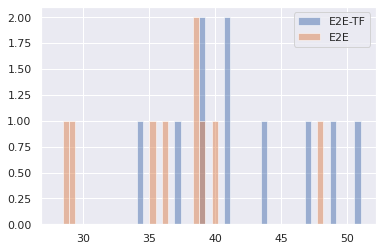

In [ ]:
from matplotlib import pyplot
import seaborn as sns
sns.set()

x = [40.82, 39.02, 40.91, 34.37, 39.02, 50.98, 37.21, 43.9, 49.06, 46.81]
y = [48.15, 38.46, 36.36, 29.17, 35.29, 28.57, 40, 39.02, 38.6]

bins = np.linspace(28, 51, 50)

pyplot.hist(x, bins, alpha=0.5, label='E2E-TF')
pyplot.hist(y, bins, alpha=0.5, label='E2E')
pyplot.legend(loc='upper right')
pyplot.show()

In [ ]:
print('E2E-TF: mean - %s, std - %s' % (np.mean(x), np.std(x)))
print('E2E: mean - %s, std - %s' % (np.mean(y), np.std(y)))

E2E-TF: mean - 42.21, std - 5.0822376961334665
E2E: mean - 37.06888888888889, std - 5.555370663590013


# Tensorboard

In [ ]:
!mv /content/baseline-linear-f1-59.ckpt /content/drive/MyDrive/Sapienza/NLP_2/baseline-linear-f1-59.ckpt

In [ ]:
%load_ext tensorboard
%tensorboard --logdir lightning_logs/